In [1]:
from collections import defaultdict
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pickle as pkl
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
import torch
from torch.utils.data import TensorDataset, DataLoader
from tqdm import tqdm

In [2]:
import sys
sys.path.append("..")

In [3]:
%load_ext autoreload
%autoreload 2
from common.utility import to_categorical, torch_device
from notebook_utils.generate_gaussian import generate_gaussian
from notebook_utils.eigan import Encoder, Discriminator
from notebook_utils.federated import federated
from notebook_utils.eigan_training import distributed, centralized
from notebook_utils.utility import class_plot, to_numpy
import notebook_utils.metrics as metrics

In [4]:
device='gpu'
device = torch_device(device=device)
device

device(type='cuda')

# Training

In [7]:
MAX = 2048
history = {}
NUM_TRIALS = 10
VAR1 = 1
VAR2 = 1
NUM_NODES = 2
PHI=1
BATCHSIZE=512

phi = 1.0
delta = 2

2 NODE DATA
@node 0, X: (2460, 2), y_1: (2460, 1), y2: (2460, 1)
@node 1, X: (2360, 2), y_1: (2360, 1), y2: (2360, 1)
@node 0: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1968, 2) (492, 2) (1968, 1) (492, 1) (1968, 1) (492, 1)
@node 0: class weights => w1, w2 [array([3.10410095, 1.47526237])] [array([1.9408284 , 2.06289308])]
@node 0: tensor sizes => torch.Size([1968, 2]) (492, 2) torch.Size([1968, 2]) (492, 2) torch.Size([1968, 2]) (492, 2)
@node 1: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1888, 2) (472, 2) (1888, 1) (472, 1) (1888, 1) (472, 1)
@node 1: class weights => w1, w2 [array([3.10410095, 1.47526237]), array([1.87487587, 2.1430193 ])] [array([1.9408284 , 2.06289308]), array([1.5488105 , 2.82212257])]
@node 1: tensor sizes => torch.Size([1888, 2]) (472, 2) torch.Size([1888, 2]) (472, 2) torch.Size([1888, 2]) (472, 2)
--------------------------------------------------------------------------------
EIGAN Training w/ phi=1.0 and delta=2
-----

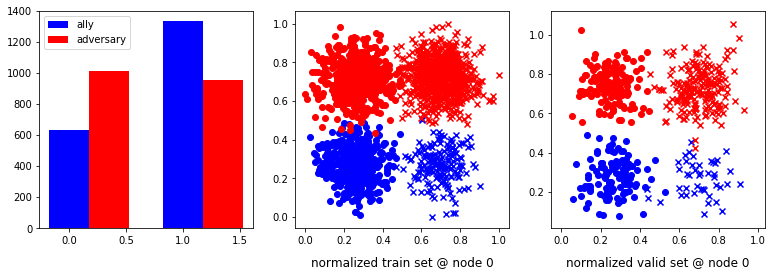

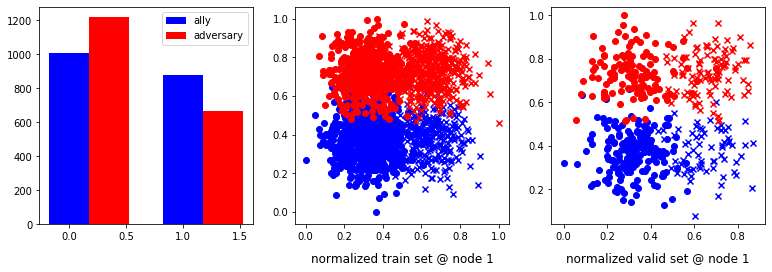

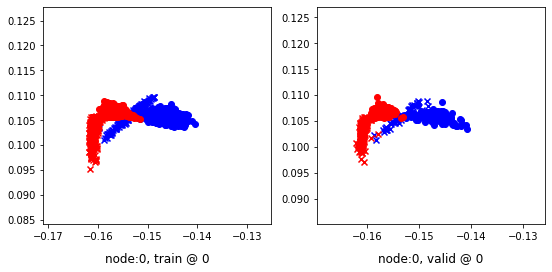

0 	 1 	 0.65267950 	 0.65151912 	 0.99814522 	 0.99974865 	 1.03869152 	 1.04137671


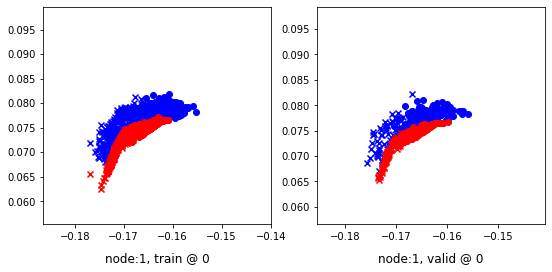

Aggregating on epoch: 2...
Aggregating on epoch: 4...
Aggregating on epoch: 6...
Aggregating on epoch: 8...
Aggregating on epoch: 10...
Aggregating on epoch: 12...
Aggregating on epoch: 14...
Aggregating on epoch: 16...
Aggregating on epoch: 18...
Aggregating on epoch: 20...
20 	 0 	 0.65265393 	 0.66498262 	 0.91487998 	 0.92607784 	 0.95572722 	 0.95424241


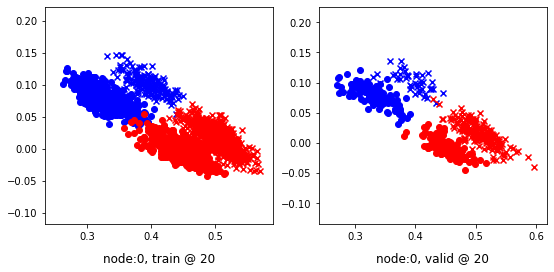

20 	 1 	 0.69855618 	 0.69649678 	 0.94324452 	 0.94253170 	 0.93825614 	 0.93918210


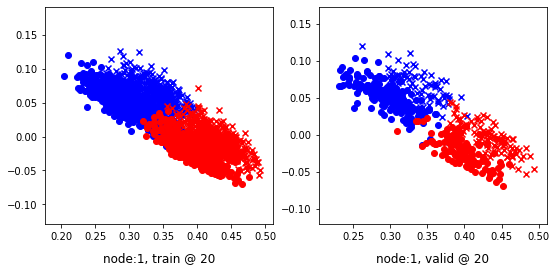

Aggregating on epoch: 22...
Aggregating on epoch: 24...
Aggregating on epoch: 26...
Aggregating on epoch: 28...
Aggregating on epoch: 30...
Aggregating on epoch: 32...
Aggregating on epoch: 34...
Aggregating on epoch: 36...
Aggregating on epoch: 38...
Aggregating on epoch: 40...
40 	 0 	 0.17403713 	 0.15208566 	 0.41231424 	 0.38871562 	 0.93310052 	 0.92977715


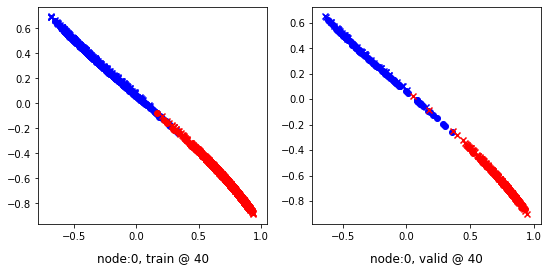

40 	 1 	 0.19158277 	 0.15028155 	 0.40388963 	 0.38717484 	 0.91131109 	 0.93004048


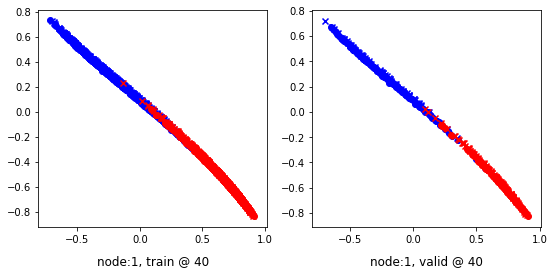

Aggregating on epoch: 42...
Aggregating on epoch: 44...
Aggregating on epoch: 46...
Aggregating on epoch: 48...
Aggregating on epoch: 50...
Aggregating on epoch: 52...
Aggregating on epoch: 54...
Aggregating on epoch: 56...
Aggregating on epoch: 58...
Aggregating on epoch: 60...
60 	 0 	 -0.13084292 	 -0.12750015 	 0.09049096 	 0.09245405 	 0.91481125 	 0.91310138


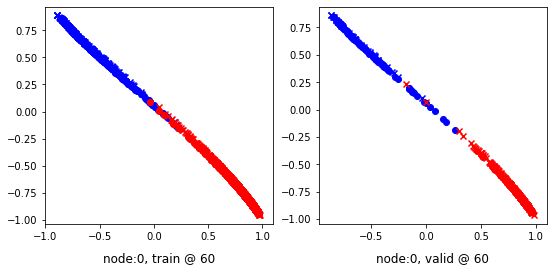

60 	 1 	 -0.02950715 	 -0.10327180 	 0.22657239 	 0.12933193 	 0.95150280 	 0.92575091


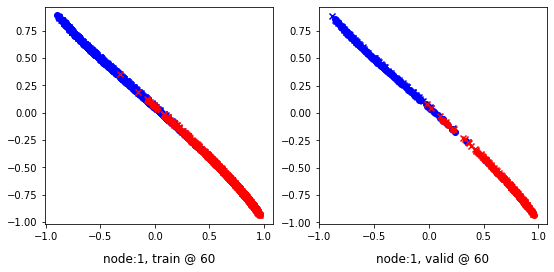

Aggregating on epoch: 62...
Aggregating on epoch: 64...
Aggregating on epoch: 66...
Aggregating on epoch: 68...
Aggregating on epoch: 70...
Aggregating on epoch: 72...
Aggregating on epoch: 74...
Aggregating on epoch: 76...
Aggregating on epoch: 78...
Aggregating on epoch: 80...
80 	 0 	 -0.16882354 	 -0.17732382 	 0.03471191 	 0.03529400 	 0.89776045 	 0.90576500


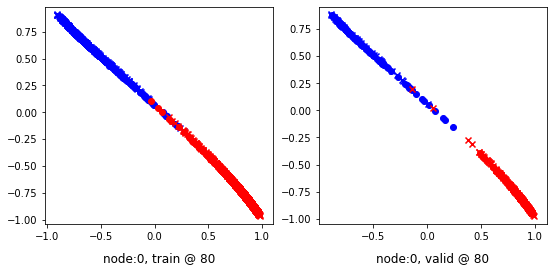

80 	 1 	 -0.06976487 	 -0.11159513 	 0.16502322 	 0.11712118 	 0.92976946 	 0.92186350


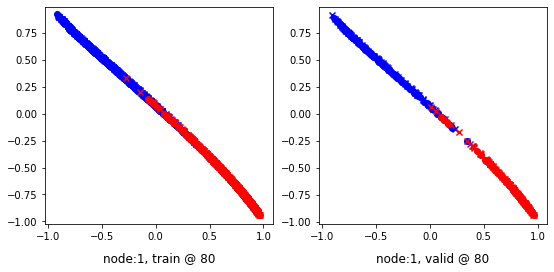

Aggregating on epoch: 82...
Aggregating on epoch: 84...
Aggregating on epoch: 86...
Aggregating on epoch: 88...
Aggregating on epoch: 90...
Aggregating on epoch: 92...
Aggregating on epoch: 94...
Aggregating on epoch: 96...
Aggregating on epoch: 98...
Aggregating on epoch: 100...
100 	 0 	 -0.17988309 	 -0.18423823 	 0.01552710 	 0.02752403 	 0.89158612 	 0.90490943


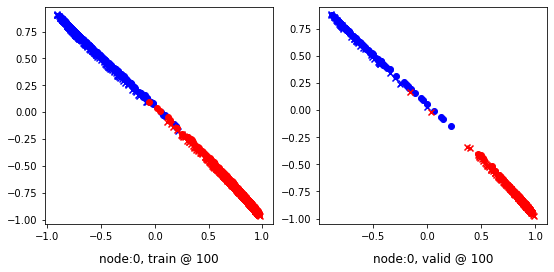

100 	 1 	 -0.05793819 	 -0.11528871 	 0.16801238 	 0.11226638 	 0.92832601 	 0.92070228


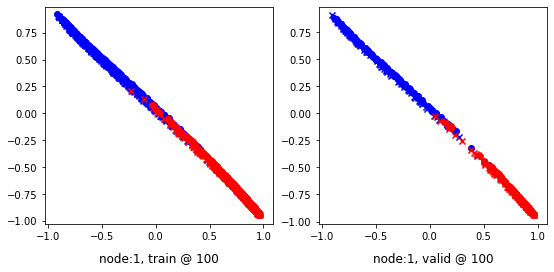

Aggregating on epoch: 102...
Aggregating on epoch: 104...
Aggregating on epoch: 106...
Aggregating on epoch: 108...
Aggregating on epoch: 110...
Aggregating on epoch: 112...
Aggregating on epoch: 114...
Aggregating on epoch: 116...
Aggregating on epoch: 118...
Aggregating on epoch: 120...
120 	 0 	 -0.17662975 	 -0.18548088 	 0.01143911 	 0.02625842 	 0.88034087 	 0.90488648


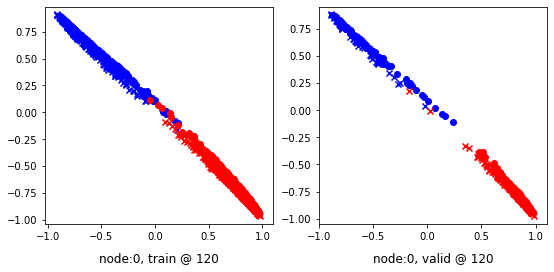

120 	 1 	 -0.09871723 	 -0.11589828 	 0.13656874 	 0.11097237 	 0.92892128 	 0.92001784


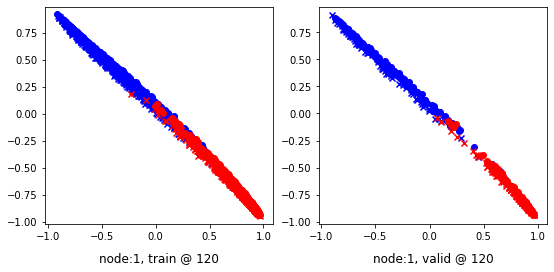

Aggregating on epoch: 122...
Aggregating on epoch: 124...
Aggregating on epoch: 126...
Aggregating on epoch: 128...
Aggregating on epoch: 130...
Aggregating on epoch: 132...
Aggregating on epoch: 134...
Aggregating on epoch: 136...
Aggregating on epoch: 138...
Aggregating on epoch: 140...
140 	 0 	 -0.17808554 	 -0.18482088 	 0.02031169 	 0.02616037 	 0.89254767 	 0.90412843


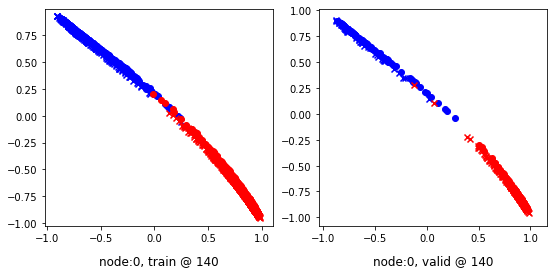

140 	 1 	 -0.04469503 	 -0.11625430 	 0.16398239 	 0.10985354 	 0.90677786 	 0.91925502


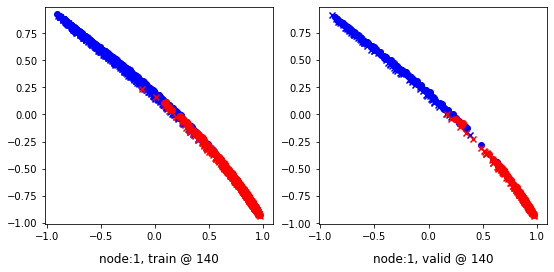

Aggregating on epoch: 142...
Aggregating on epoch: 144...
Aggregating on epoch: 146...
Aggregating on epoch: 148...
Aggregating on epoch: 150...
Aggregating on epoch: 152...
Aggregating on epoch: 154...
Aggregating on epoch: 156...
Aggregating on epoch: 158...
Aggregating on epoch: 160...
160 	 0 	 -0.18605985 	 -0.18515292 	 0.00984607 	 0.02548167 	 0.88904697 	 0.90378177


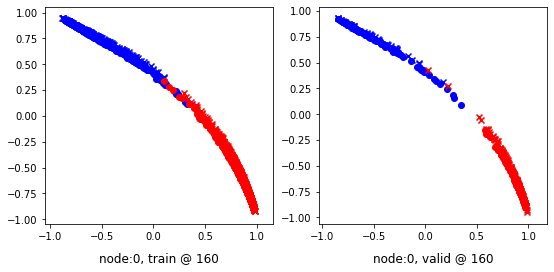

160 	 1 	 -0.10371724 	 -0.11736824 	 0.12541154 	 0.10915933 	 0.92802066 	 0.91967475


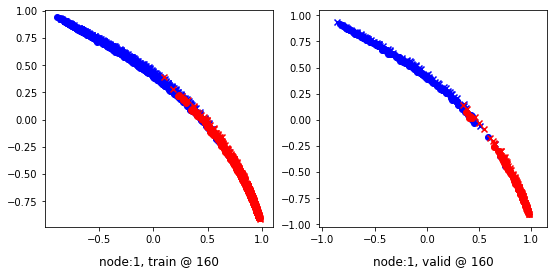

Aggregating on epoch: 162...
Aggregating on epoch: 164...
Aggregating on epoch: 166...
Aggregating on epoch: 168...
Aggregating on epoch: 170...
Aggregating on epoch: 172...
Aggregating on epoch: 174...
Aggregating on epoch: 176...
Aggregating on epoch: 178...
Aggregating on epoch: 180...
180 	 0 	 -0.14901778 	 -0.18684803 	 0.00914629 	 0.02189346 	 0.85224384 	 0.90188867


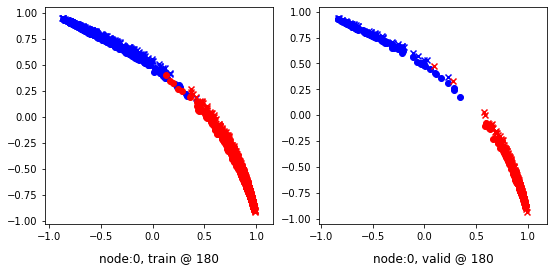

180 	 1 	 -0.09004912 	 -0.11486052 	 0.15672608 	 0.10778178 	 0.93895793 	 0.91578948


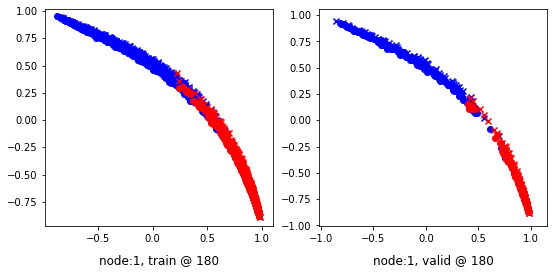

Aggregating on epoch: 182...
Aggregating on epoch: 184...
Aggregating on epoch: 186...
Aggregating on epoch: 188...
Aggregating on epoch: 190...
Aggregating on epoch: 192...
Aggregating on epoch: 194...
Aggregating on epoch: 196...
Aggregating on epoch: 198...
Aggregating on epoch: 200...
200 	 0 	 -0.18139735 	 -0.18705590 	 0.02433717 	 0.02272467 	 0.89856988 	 0.90292776


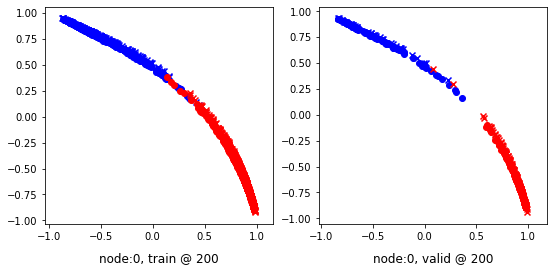

200 	 1 	 -0.09848674 	 -0.11548106 	 0.12972260 	 0.10622295 	 0.92219710 	 0.91485119


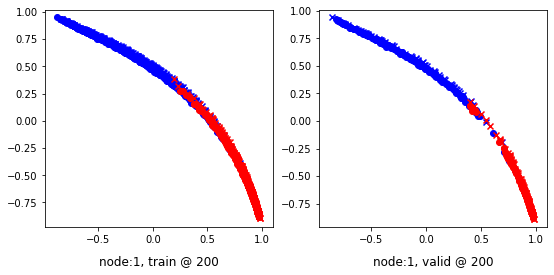

Aggregating on epoch: 202...
Aggregating on epoch: 204...
Aggregating on epoch: 206...
Aggregating on epoch: 208...
Aggregating on epoch: 210...
Aggregating on epoch: 212...
Aggregating on epoch: 214...
Aggregating on epoch: 216...
Aggregating on epoch: 218...
Aggregating on epoch: 220...
220 	 0 	 -0.21189921 	 -0.18673137 	 0.00564039 	 0.02379295 	 0.91126770 	 0.90367150


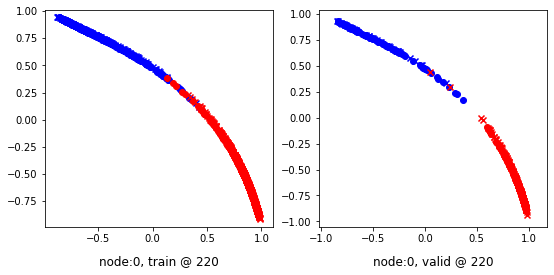

220 	 1 	 -0.08771865 	 -0.11691736 	 0.15666020 	 0.10651769 	 0.93749273 	 0.91658223


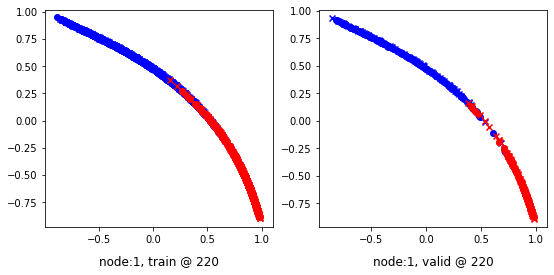

Aggregating on epoch: 222...
Aggregating on epoch: 224...
Aggregating on epoch: 226...
Aggregating on epoch: 228...
Aggregating on epoch: 230...
Aggregating on epoch: 232...
Aggregating on epoch: 234...
Aggregating on epoch: 236...
Aggregating on epoch: 238...
Aggregating on epoch: 240...
240 	 0 	 -0.19255577 	 -0.18643577 	 0.01341980 	 0.02439545 	 0.90020609 	 0.90397841


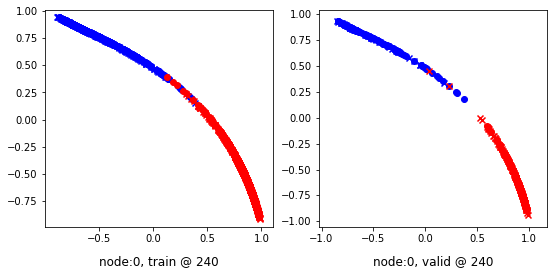

240 	 1 	 -0.07437813 	 -0.11817389 	 0.17744403 	 0.10679317 	 0.94431084 	 0.91811424


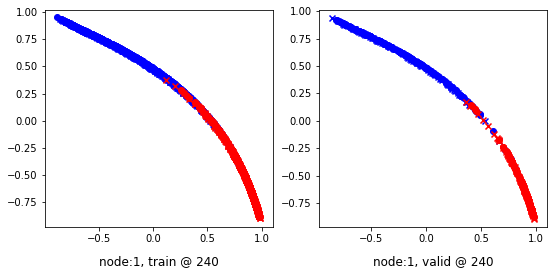

Aggregating on epoch: 242...
Aggregating on epoch: 244...
Aggregating on epoch: 246...
Aggregating on epoch: 248...
Aggregating on epoch: 250...
Aggregating on epoch: 252...
Aggregating on epoch: 254...
Aggregating on epoch: 256...
Aggregating on epoch: 258...
Aggregating on epoch: 260...
260 	 0 	 -0.19704734 	 -0.18714418 	 0.01229763 	 0.02390634 	 0.90292203 	 0.90419769


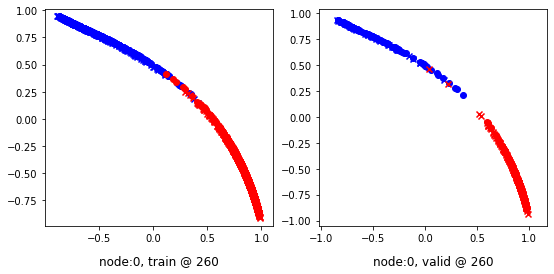

260 	 1 	 -0.02168426 	 -0.11903562 	 0.20812416 	 0.10625957 	 0.92111224 	 0.91844237


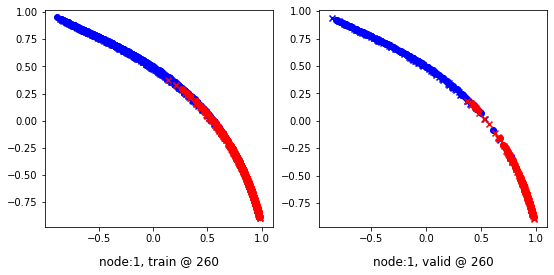

Aggregating on epoch: 262...
Aggregating on epoch: 264...
Aggregating on epoch: 266...
Aggregating on epoch: 268...
Aggregating on epoch: 270...
Aggregating on epoch: 272...
Aggregating on epoch: 274...
Aggregating on epoch: 276...
Aggregating on epoch: 278...
Aggregating on epoch: 280...
280 	 0 	 -0.16120866 	 -0.18691200 	 0.01352638 	 0.02384342 	 0.86773258 	 0.90390259


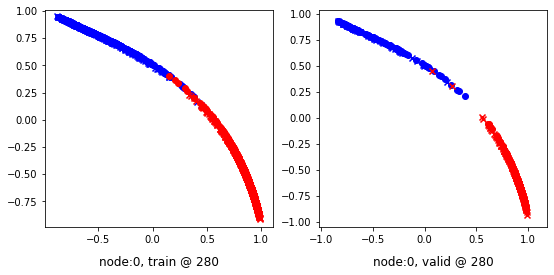

280 	 1 	 -0.00621077 	 -0.11974876 	 0.19122471 	 0.10523356 	 0.89422435 	 0.91812950


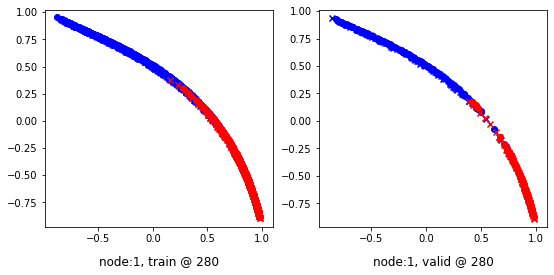

Aggregating on epoch: 282...
Aggregating on epoch: 284...
Aggregating on epoch: 286...
Aggregating on epoch: 288...
Aggregating on epoch: 290...
Aggregating on epoch: 292...
Aggregating on epoch: 294...
Aggregating on epoch: 296...
Aggregating on epoch: 298...
Aggregating on epoch: 300...
300 	 0 	 -0.20507523 	 -0.18766932 	 0.01028003 	 0.02306558 	 0.90915906 	 0.90388209


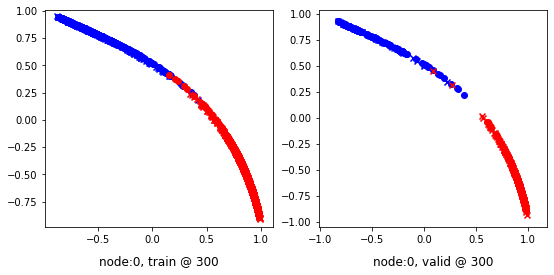

300 	 1 	 -0.07509603 	 -0.11984956 	 0.13605522 	 0.10471118 	 0.90570670 	 0.91770792


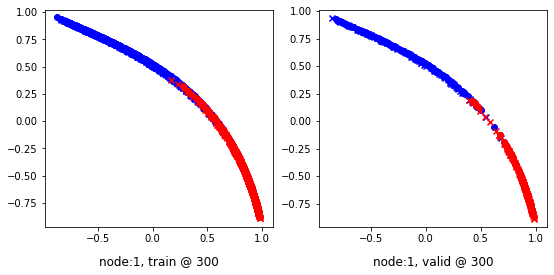

Aggregating on epoch: 302...
Aggregating on epoch: 304...
Aggregating on epoch: 306...
Aggregating on epoch: 308...
Aggregating on epoch: 310...
Aggregating on epoch: 312...
Aggregating on epoch: 314...
Aggregating on epoch: 316...
Aggregating on epoch: 318...
Aggregating on epoch: 320...
320 	 0 	 -0.16260910 	 -0.18799691 	 0.01538029 	 0.02295854 	 0.87191892 	 0.90410262


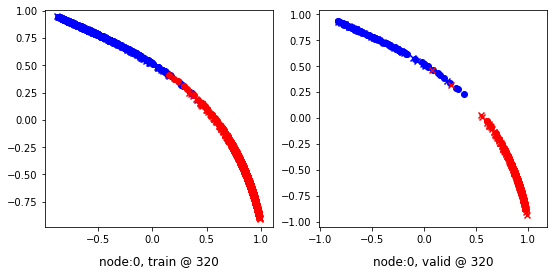

320 	 1 	 -0.02631296 	 -0.11964170 	 0.15926728 	 0.10478904 	 0.88549930 	 0.91757792


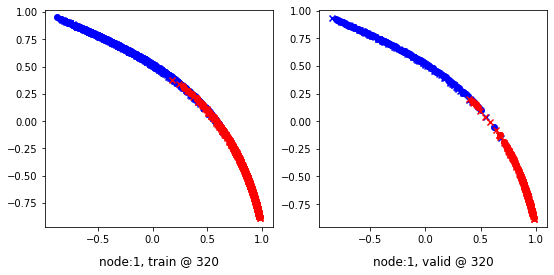

Aggregating on epoch: 322...
Aggregating on epoch: 324...
Aggregating on epoch: 326...
Aggregating on epoch: 328...
Aggregating on epoch: 330...
Aggregating on epoch: 332...
Aggregating on epoch: 334...
Aggregating on epoch: 336...
Aggregating on epoch: 338...
Aggregating on epoch: 340...
340 	 0 	 -0.19823687 	 -0.18664241 	 0.01650178 	 0.02424693 	 0.90662521 	 0.90403652


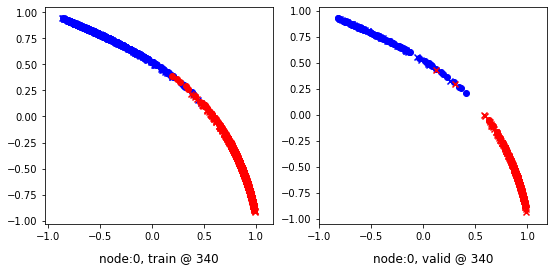

340 	 1 	 -0.08553578 	 -0.11958301 	 0.10966685 	 0.10473400 	 0.88814461 	 0.91746420


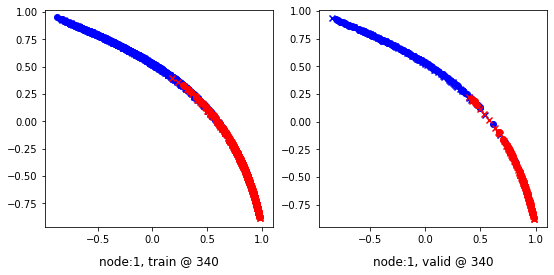

Aggregating on epoch: 342...
Aggregating on epoch: 344...
Aggregating on epoch: 346...
Aggregating on epoch: 348...
Aggregating on epoch: 350...
Aggregating on epoch: 352...
Aggregating on epoch: 354...
Aggregating on epoch: 356...
Aggregating on epoch: 358...
Aggregating on epoch: 360...
360 	 0 	 -0.16921082 	 -0.18810901 	 0.02371027 	 0.02298572 	 0.88597691 	 0.90424192


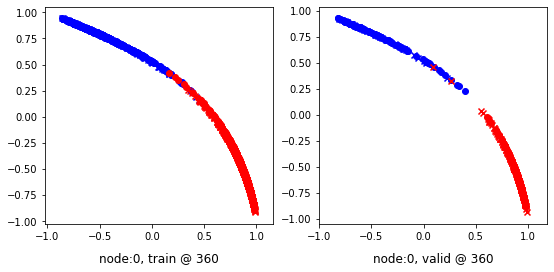

360 	 1 	 -0.07411550 	 -0.11911664 	 0.16298266 	 0.10581138 	 0.93084675 	 0.91807520


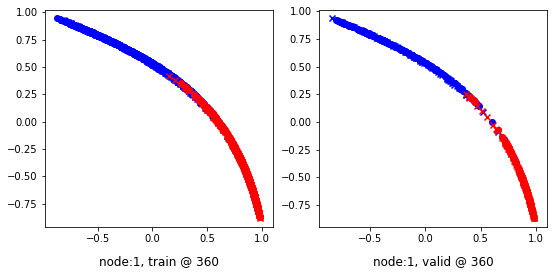

Aggregating on epoch: 362...
Aggregating on epoch: 364...
Aggregating on epoch: 366...
Aggregating on epoch: 368...
Aggregating on epoch: 370...
Aggregating on epoch: 372...
Aggregating on epoch: 374...
Aggregating on epoch: 376...
Aggregating on epoch: 378...
Aggregating on epoch: 380...
380 	 0 	 -0.19060405 	 -0.18812592 	 0.02499034 	 0.02301263 	 0.90821820 	 0.90428573


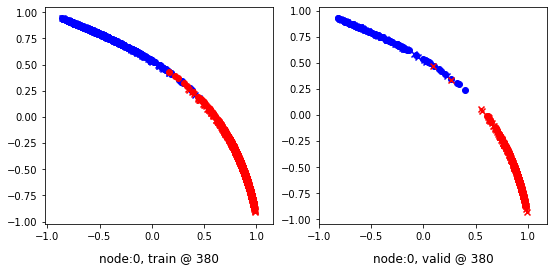

380 	 1 	 -0.09869656 	 -0.11863659 	 0.14493228 	 0.10617985 	 0.93736261 	 0.91796362


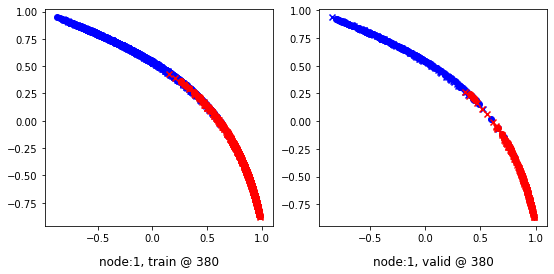

Aggregating on epoch: 382...
Aggregating on epoch: 384...
Aggregating on epoch: 386...
Aggregating on epoch: 388...
Aggregating on epoch: 390...
Aggregating on epoch: 392...
Aggregating on epoch: 394...
Aggregating on epoch: 396...
Aggregating on epoch: 398...
Aggregating on epoch: 400...
400 	 0 	 -0.21227248 	 -0.18702763 	 0.01092128 	 0.02387243 	 0.91550446 	 0.90404725


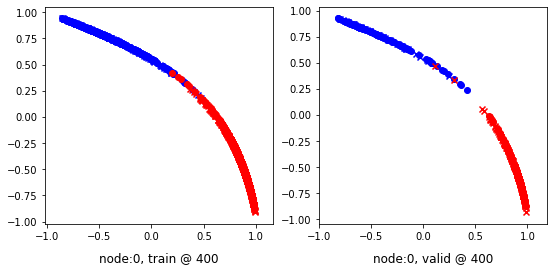

400 	 1 	 -0.04752441 	 -0.11885087 	 0.16000867 	 0.10621984 	 0.90291739 	 0.91821790


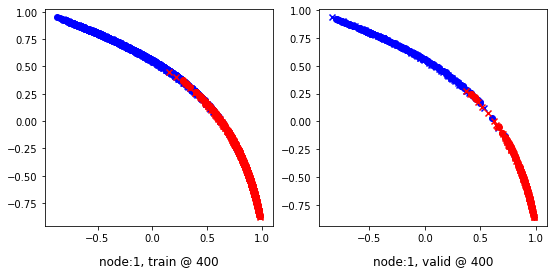

Aggregating on epoch: 402...
Aggregating on epoch: 404...
Aggregating on epoch: 406...
Aggregating on epoch: 408...
Aggregating on epoch: 410...
Aggregating on epoch: 412...
Aggregating on epoch: 414...
Aggregating on epoch: 416...
Aggregating on epoch: 418...
Aggregating on epoch: 420...
420 	 0 	 -0.20815754 	 -0.18731120 	 0.01471369 	 0.02364739 	 0.91580147 	 0.90410578


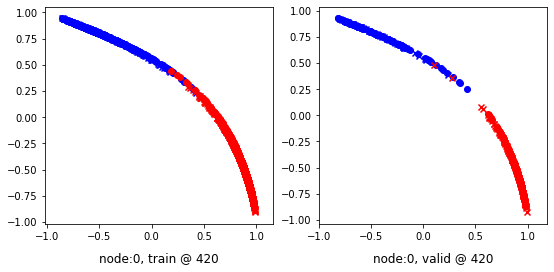

420 	 1 	 -0.09377632 	 -0.11899483 	 0.13328567 	 0.10581142 	 0.92213756 	 0.91795343


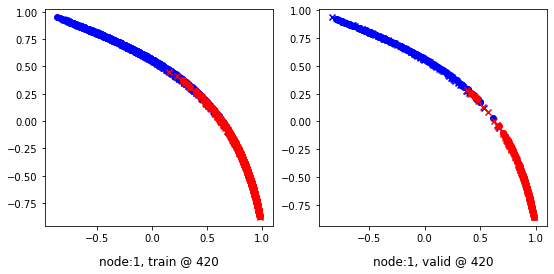

Aggregating on epoch: 422...
Aggregating on epoch: 424...
Aggregating on epoch: 426...
Aggregating on epoch: 428...
Aggregating on epoch: 430...
Aggregating on epoch: 432...
Aggregating on epoch: 434...
Aggregating on epoch: 436...
Aggregating on epoch: 438...
Aggregating on epoch: 440...
440 	 0 	 -0.21003377 	 -0.18630204 	 0.01651488 	 0.02445951 	 0.92095470 	 0.90390873


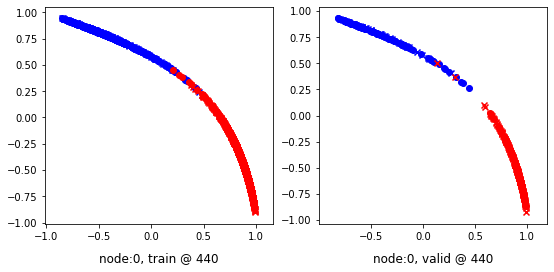

440 	 1 	 -0.07259870 	 -0.11858064 	 0.17607990 	 0.10660702 	 0.94207317 	 0.91833484


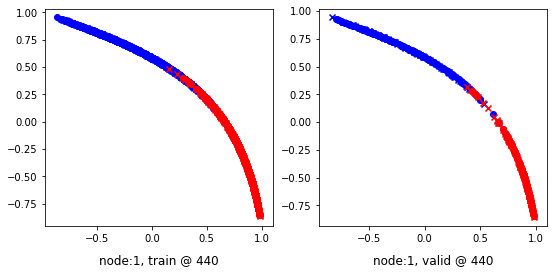

Aggregating on epoch: 442...
Aggregating on epoch: 444...
Aggregating on epoch: 446...
Aggregating on epoch: 448...
Aggregating on epoch: 450...
Aggregating on epoch: 452...
Aggregating on epoch: 454...
Aggregating on epoch: 456...
Aggregating on epoch: 458...
Aggregating on epoch: 460...
460 	 0 	 -0.19547473 	 -0.18653208 	 0.01775094 	 0.02397883 	 0.90777731 	 0.90365809


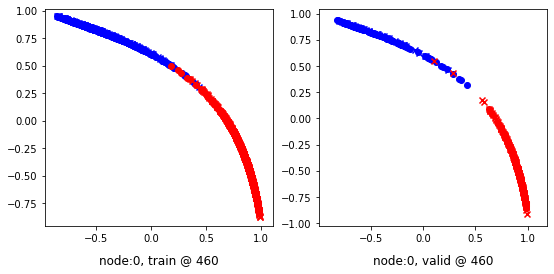

460 	 1 	 -0.02499817 	 -0.11874524 	 0.17627810 	 0.10645071 	 0.89398110 	 0.91834313


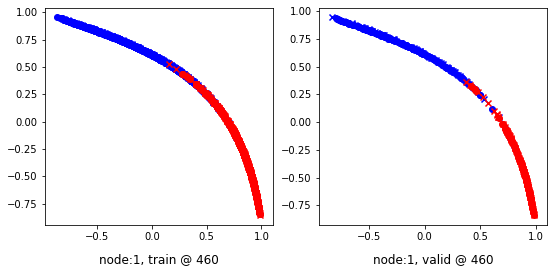

Aggregating on epoch: 462...
Aggregating on epoch: 464...
Aggregating on epoch: 466...
Aggregating on epoch: 468...
Aggregating on epoch: 470...
Aggregating on epoch: 472...
Aggregating on epoch: 474...
Aggregating on epoch: 476...
Aggregating on epoch: 478...
Aggregating on epoch: 480...
480 	 0 	 -0.18336816 	 -0.18623503 	 0.01190881 	 0.02446555 	 0.88705373 	 0.90384775


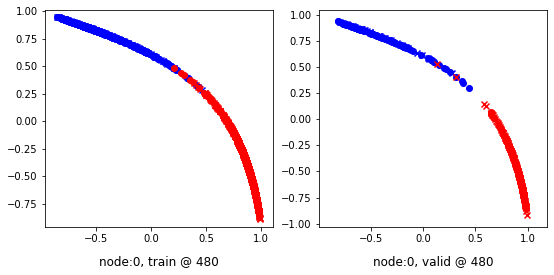

480 	 1 	 -0.05985078 	 -0.11901740 	 0.16507460 	 0.10596796 	 0.91576213 	 0.91813254


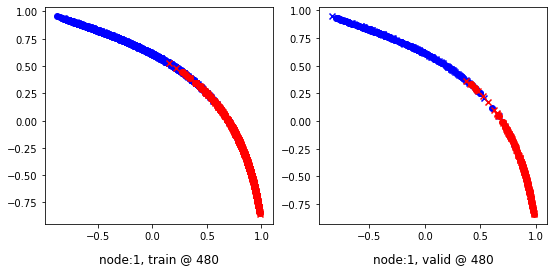

Aggregating on epoch: 482...
Aggregating on epoch: 484...
Aggregating on epoch: 486...
Aggregating on epoch: 488...
Aggregating on epoch: 490...
Aggregating on epoch: 492...
Aggregating on epoch: 494...
Aggregating on epoch: 496...
Aggregating on epoch: 498...
Aggregating on epoch: 500...
500 	 0 	 -0.17747331 	 -0.18511811 	 0.01854117 	 0.02513584 	 0.88795358 	 0.90340114


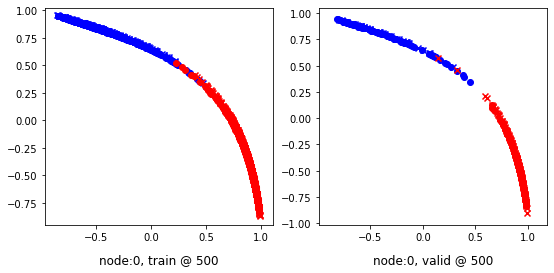

500 	 1 	 -0.09257056 	 -0.11875512 	 0.12923034 	 0.10652559 	 0.91563928 	 0.91842788


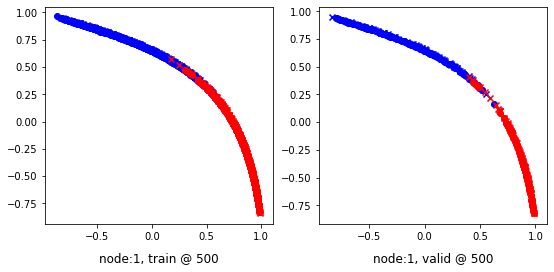

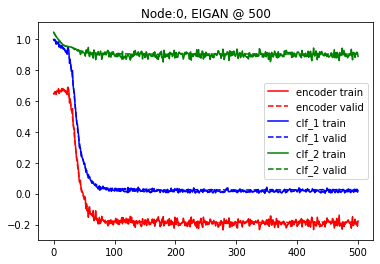

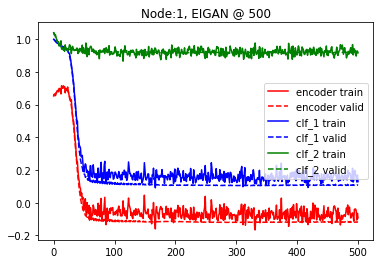

  0%|          | 1/501 [00:00<01:26,  5.77it/s]

epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.76185310 	 0.75716221 	 1.07753670 	 1.07729888 	 1.00895786 	 1.01328385


100%|██████████| 501/501 [01:24<00:00,  5.93it/s]


500 	 -0.12438212 	 -0.12046902 	 0.09332012 	 0.08756305 	 0.91114056 	 0.90117925


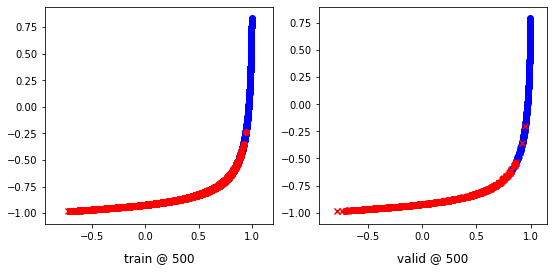

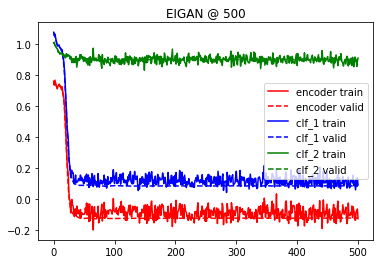

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.089997 	 1.089881 	 0.5747
200 	 0.497217 	 0.478868 	 0.9751
400 	 0.148457 	 0.114694 	 0.9834
600 	 0.124280 	 0.086834 	 0.9834
800 	 0.119444 	 0.081329 	 0.9844
1000 	 0.116703 	 0.079814 	 0.9824
Accuracy: 0.9823651452282157
Error Rate: 0.017634854771784232
F1 Score: 0.9846153846153846
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9813278008298755
Error Rate: 0.01867219917012448
F1 Score: 0.9836363636363635
SVM
--------------------------------------------------------------------------------
Accuracy: 0.983402489626556
Error Rate: 0.0

@node 2: tensor sizes => torch.Size([997, 2]) (250, 2) torch.Size([997, 2]) (250, 2) torch.Size([997, 2]) (250, 2)
--------------------------------------------------------------------------------
EIGAN Training w/ phi=1.0 and delta=2
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.72708094 	 0.72846752 	 1.02999330 	 1.02923954 	 0.99619657 	 0.99391919


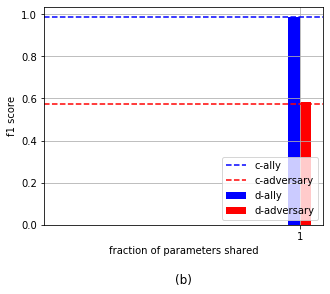

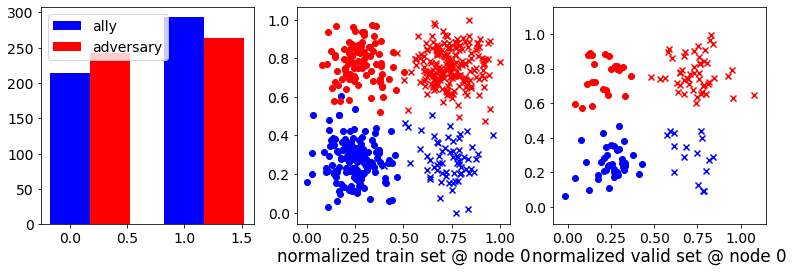

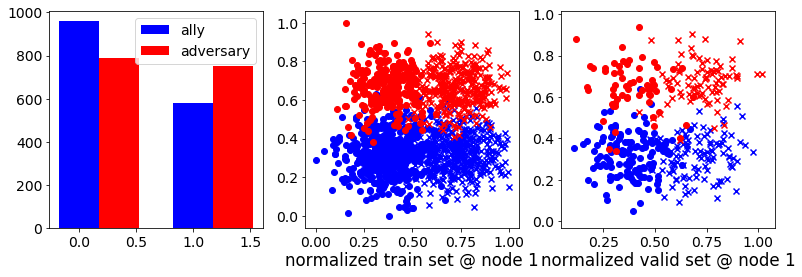

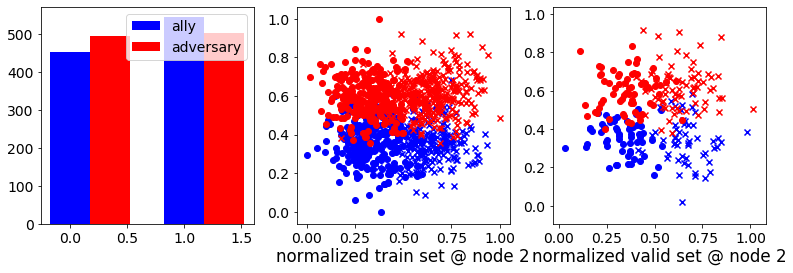

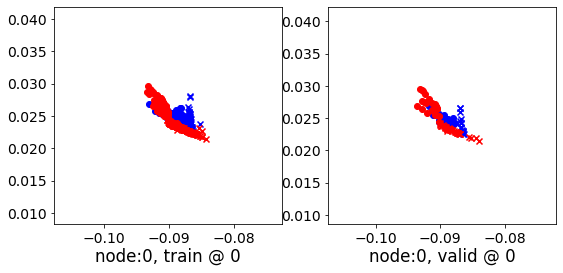

0 	 1 	 0.75323606 	 0.75999367 	 1.11551845 	 1.10875487 	 1.05558908 	 1.04190838


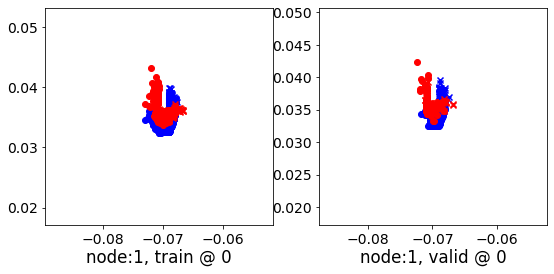

0 	 2 	 0.65291977 	 0.65464556 	 1.02070057 	 1.02068067 	 1.06101692 	 1.05918229


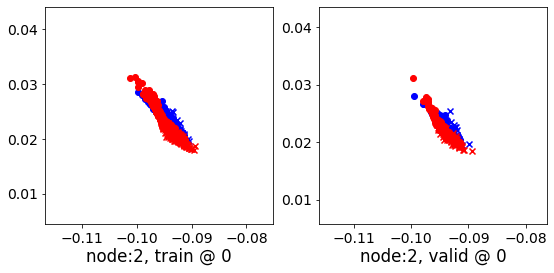

Aggregating on epoch: 2...
Aggregating on epoch: 4...
Aggregating on epoch: 6...
Aggregating on epoch: 8...
Aggregating on epoch: 10...
Aggregating on epoch: 12...
Aggregating on epoch: 14...
Aggregating on epoch: 16...
Aggregating on epoch: 18...
Aggregating on epoch: 20...
20 	 0 	 0.73037273 	 0.73075742 	 0.99902111 	 0.99869406 	 0.96189171 	 0.96108383


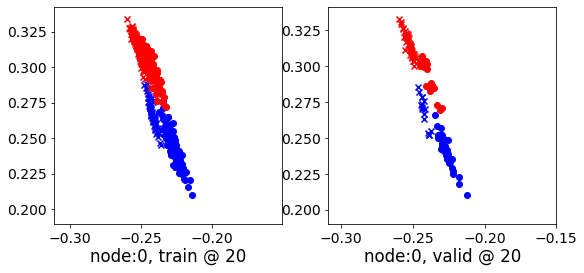

20 	 1 	 0.65211797 	 0.69384456 	 0.91139442 	 0.95821619 	 0.95257044 	 0.95751882


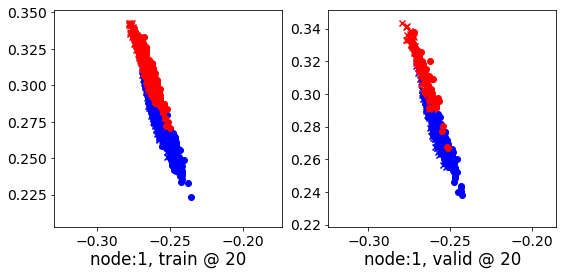

20 	 2 	 0.66818315 	 0.66824824 	 0.98066020 	 0.97959405 	 1.00598156 	 1.00449300


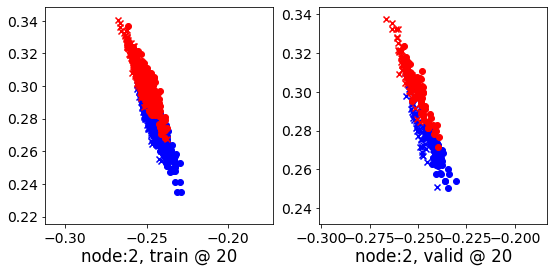

Aggregating on epoch: 22...
Aggregating on epoch: 24...
Aggregating on epoch: 26...
Aggregating on epoch: 28...
Aggregating on epoch: 30...
Aggregating on epoch: 32...
Aggregating on epoch: 34...
Aggregating on epoch: 36...
Aggregating on epoch: 38...
Aggregating on epoch: 40...
40 	 0 	 0.71055990 	 0.71025902 	 0.97217607 	 0.97201610 	 0.95487660 	 0.95490426


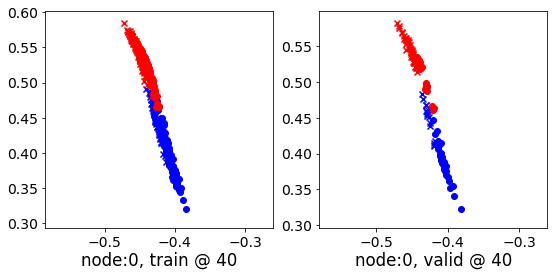

40 	 1 	 0.57967043 	 0.68028963 	 0.84236211 	 0.94199204 	 0.95598298 	 0.95484960


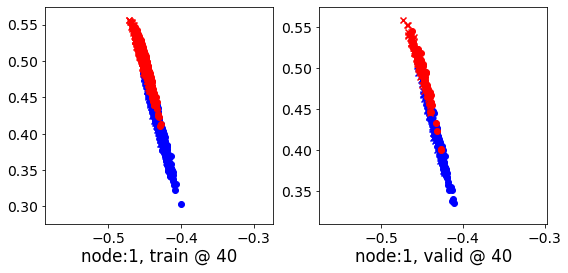

40 	 2 	 0.68824792 	 0.68196875 	 0.95552021 	 0.94876927 	 0.96046489 	 0.95994771


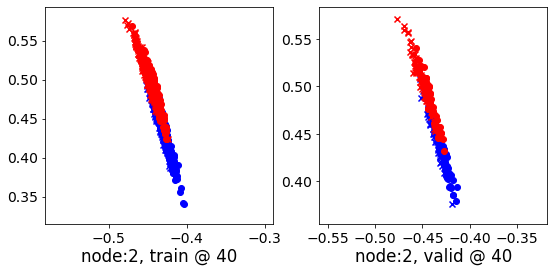

Aggregating on epoch: 42...
Aggregating on epoch: 44...
Aggregating on epoch: 46...
Aggregating on epoch: 48...
Aggregating on epoch: 50...
Aggregating on epoch: 52...
Aggregating on epoch: 54...
Aggregating on epoch: 56...
Aggregating on epoch: 58...
Aggregating on epoch: 60...
60 	 0 	 0.69657010 	 0.69740254 	 0.95449382 	 0.95483583 	 0.95134079 	 0.95058048


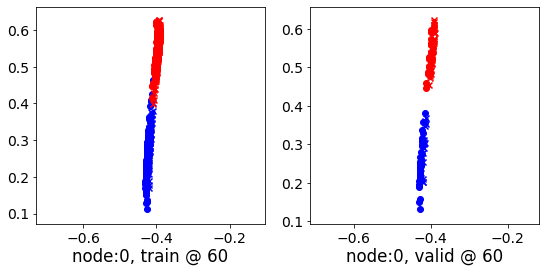

60 	 1 	 0.48680466 	 0.64456773 	 0.74248362 	 0.90627688 	 0.95423174 	 0.95485634


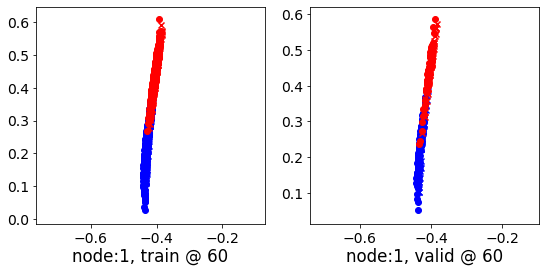

60 	 2 	 0.67095619 	 0.66940099 	 0.93151730 	 0.93081295 	 0.95443743 	 0.95455915


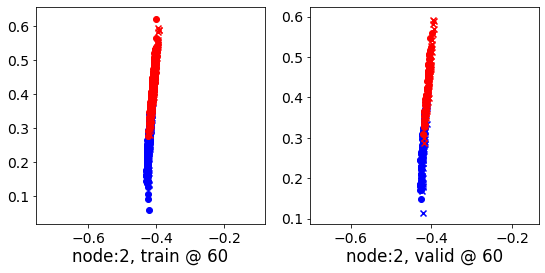

Aggregating on epoch: 62...
Aggregating on epoch: 64...
Aggregating on epoch: 66...
Aggregating on epoch: 68...
Aggregating on epoch: 70...
Aggregating on epoch: 72...
Aggregating on epoch: 74...
Aggregating on epoch: 76...
Aggregating on epoch: 78...
Aggregating on epoch: 80...
80 	 0 	 0.68294752 	 0.68657815 	 0.92646319 	 0.92508435 	 0.93720502 	 0.93165338


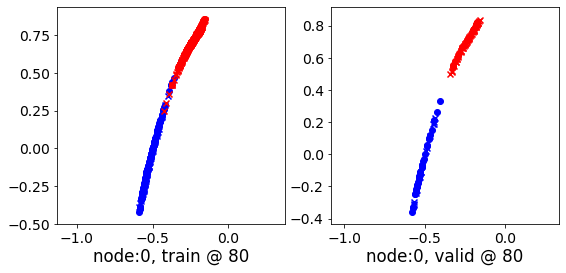

80 	 1 	 0.30026877 	 0.24729121 	 0.52048010 	 0.50796479 	 0.91767389 	 0.95382077


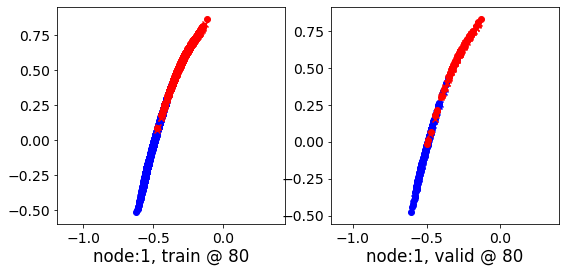

80 	 2 	 0.49482626 	 0.48176789 	 0.75122887 	 0.74401742 	 0.95526528 	 0.95539671


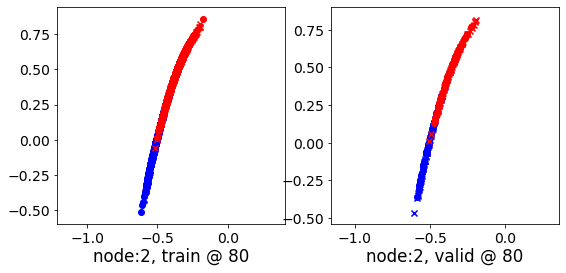

Aggregating on epoch: 82...
Aggregating on epoch: 84...
Aggregating on epoch: 86...
Aggregating on epoch: 88...
Aggregating on epoch: 90...
Aggregating on epoch: 92...
Aggregating on epoch: 94...
Aggregating on epoch: 96...
Aggregating on epoch: 98...
Aggregating on epoch: 100...
100 	 0 	 0.63264465 	 0.63841593 	 0.84180266 	 0.83583391 	 0.90350151 	 0.89056516


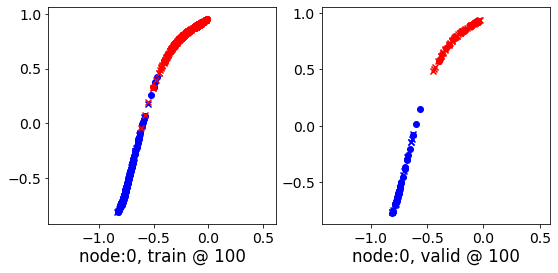

100 	 1 	 -0.18265945 	 -0.03339987 	 0.03528581 	 0.22381277 	 0.91253728 	 0.95035982


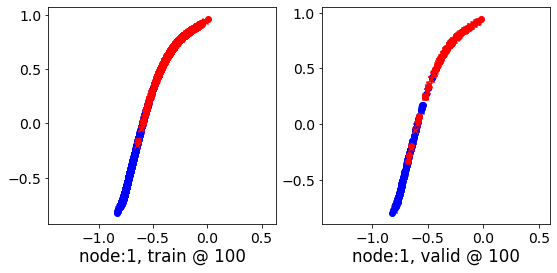

100 	 2 	 0.15644130 	 0.13156331 	 0.42083937 	 0.39334583 	 0.95565617 	 0.95492971


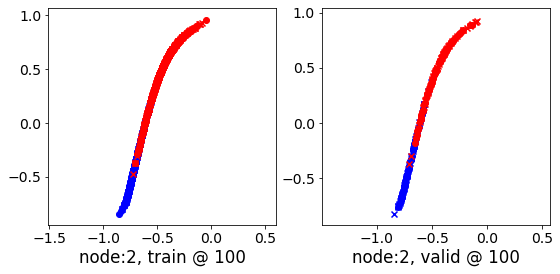

Aggregating on epoch: 102...
Aggregating on epoch: 104...
Aggregating on epoch: 106...
Aggregating on epoch: 108...
Aggregating on epoch: 110...
Aggregating on epoch: 112...
Aggregating on epoch: 114...
Aggregating on epoch: 116...
Aggregating on epoch: 118...
Aggregating on epoch: 120...
120 	 0 	 0.52356499 	 0.52959651 	 0.70542526 	 0.69380730 	 0.87782145 	 0.85735798


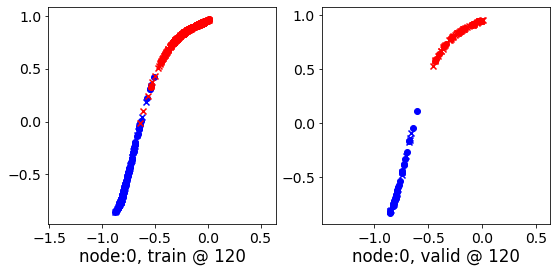

120 	 1 	 0.43286186 	 -0.02584729 	 0.61856335 	 0.22997048 	 0.98421544 	 0.94896495


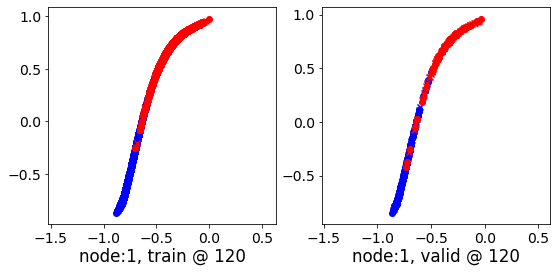

120 	 2 	 0.07543683 	 0.05646998 	 0.33048487 	 0.31778574 	 0.95519239 	 0.95446295


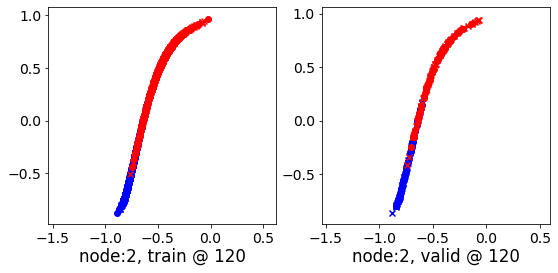

Aggregating on epoch: 122...
Aggregating on epoch: 124...
Aggregating on epoch: 126...
Aggregating on epoch: 128...
Aggregating on epoch: 130...
Aggregating on epoch: 132...
Aggregating on epoch: 134...
Aggregating on epoch: 136...
Aggregating on epoch: 138...
Aggregating on epoch: 140...
140 	 0 	 0.35245085 	 0.35606450 	 0.52231646 	 0.50713748 	 0.86684006 	 0.84422016


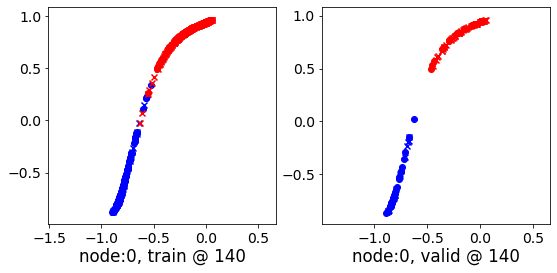

140 	 1 	 0.26964286 	 -0.03853498 	 0.43232217 	 0.21370937 	 0.92075872 	 0.94539154


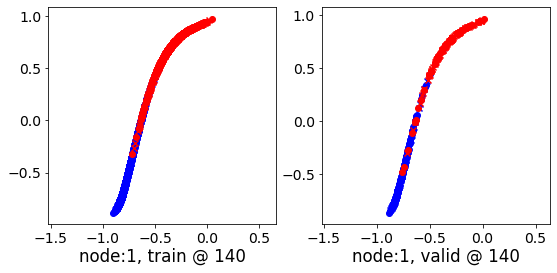

140 	 2 	 0.07706541 	 0.04958940 	 0.33097202 	 0.31081033 	 0.95479000 	 0.95436811


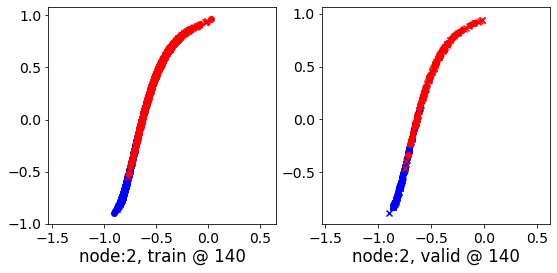

Aggregating on epoch: 142...
Aggregating on epoch: 144...
Aggregating on epoch: 146...
Aggregating on epoch: 148...
Aggregating on epoch: 150...
Aggregating on epoch: 152...
Aggregating on epoch: 154...
Aggregating on epoch: 156...
Aggregating on epoch: 158...
Aggregating on epoch: 160...
160 	 0 	 0.16564897 	 0.16814584 	 0.33228016 	 0.31580645 	 0.86286271 	 0.84080780


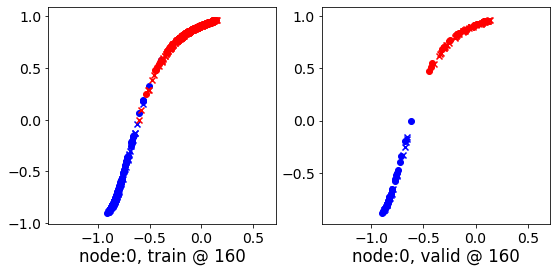

160 	 1 	 -0.16094938 	 -0.04475544 	 0.02033533 	 0.20746221 	 0.87413520 	 0.94536483


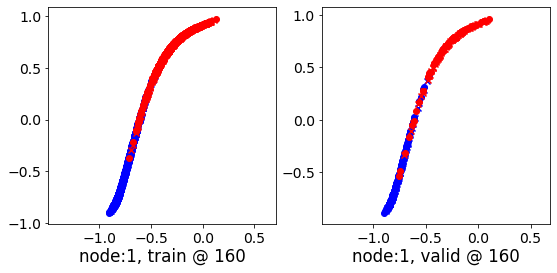

160 	 2 	 0.03900942 	 0.04961094 	 0.29594728 	 0.31025288 	 0.95431745 	 0.95378911


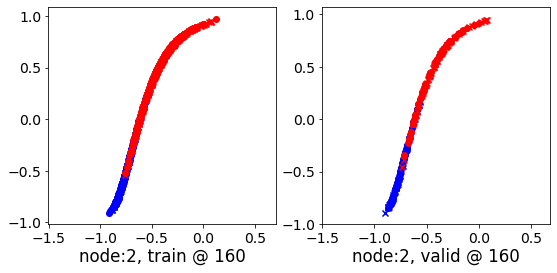

Aggregating on epoch: 162...
Aggregating on epoch: 164...
Aggregating on epoch: 166...
Aggregating on epoch: 168...
Aggregating on epoch: 170...
Aggregating on epoch: 172...
Aggregating on epoch: 174...
Aggregating on epoch: 176...
Aggregating on epoch: 178...
Aggregating on epoch: 180...
180 	 0 	 0.02950983 	 0.03155512 	 0.19580096 	 0.17891461 	 0.86174333 	 0.84050667


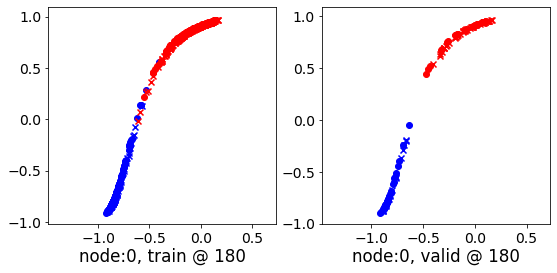

180 	 1 	 -0.26315945 	 -0.03914306 	 0.01755921 	 0.21184108 	 0.97396988 	 0.94413131


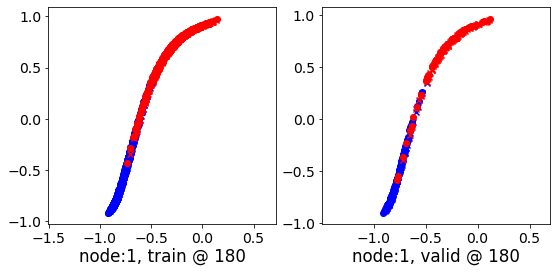

180 	 2 	 0.03930405 	 0.04789165 	 0.29907256 	 0.30780622 	 0.95442039 	 0.95306176


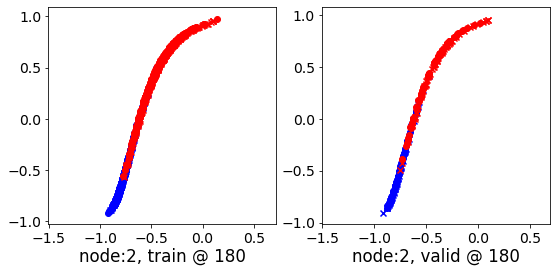

Aggregating on epoch: 182...
Aggregating on epoch: 184...
Aggregating on epoch: 186...
Aggregating on epoch: 188...
Aggregating on epoch: 190...
Aggregating on epoch: 192...
Aggregating on epoch: 194...
Aggregating on epoch: 196...
Aggregating on epoch: 198...
Aggregating on epoch: 200...
200 	 0 	 -0.04704162 	 -0.04338613 	 0.11962111 	 0.10291132 	 0.86102176 	 0.83944464


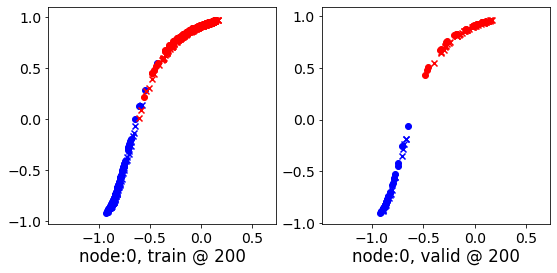

200 	 1 	 0.04235581 	 -0.04048702 	 0.29304567 	 0.21015635 	 0.97162259 	 0.94379056


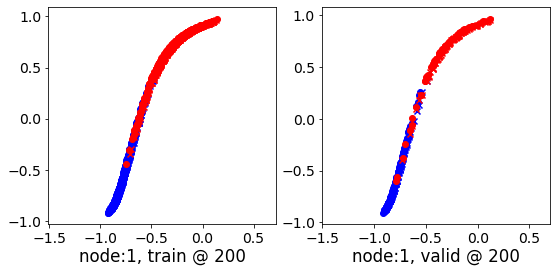

200 	 2 	 0.05572593 	 0.04855797 	 0.31503686 	 0.30752060 	 0.95307106 	 0.95210981


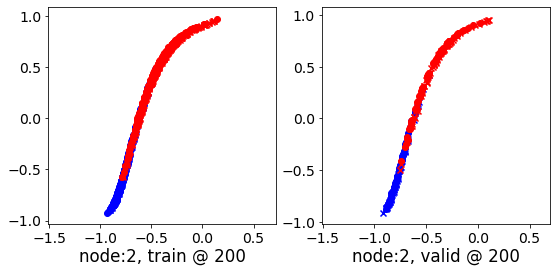

Aggregating on epoch: 202...
Aggregating on epoch: 204...
Aggregating on epoch: 206...
Aggregating on epoch: 208...
Aggregating on epoch: 210...
Aggregating on epoch: 212...
Aggregating on epoch: 214...
Aggregating on epoch: 216...
Aggregating on epoch: 218...
Aggregating on epoch: 220...
220 	 0 	 -0.08219209 	 -0.08016715 	 0.08322457 	 0.06579252 	 0.86107290 	 0.83910686


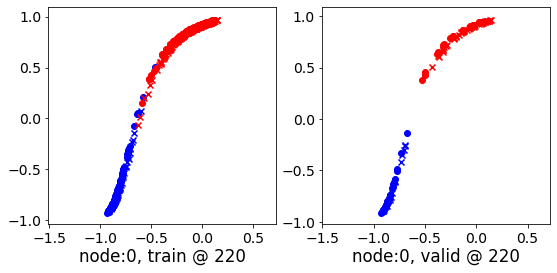

220 	 1 	 0.80565417 	 -0.03521122 	 0.91136688 	 0.21359049 	 0.88366872 	 0.94194889


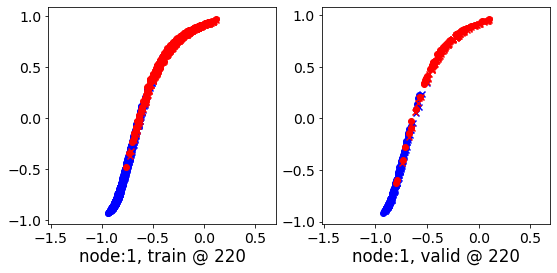

220 	 2 	 0.08750793 	 0.05182326 	 0.34752205 	 0.30993283 	 0.95346653 	 0.95125675


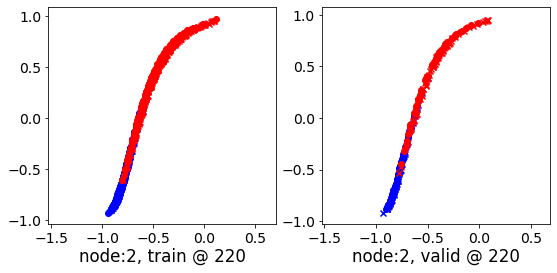

Aggregating on epoch: 222...
Aggregating on epoch: 224...
Aggregating on epoch: 226...
Aggregating on epoch: 228...
Aggregating on epoch: 230...
Aggregating on epoch: 232...
Aggregating on epoch: 234...
Aggregating on epoch: 236...
Aggregating on epoch: 238...
Aggregating on epoch: 240...
240 	 0 	 -0.10329805 	 -0.10144934 	 0.06487296 	 0.04435548 	 0.86123365 	 0.83895200


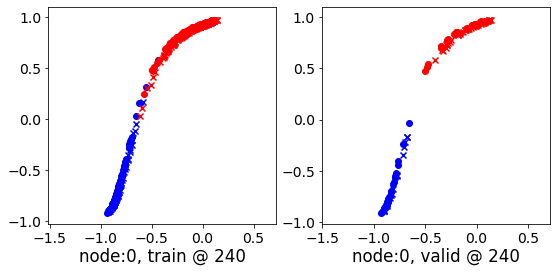

240 	 1 	 -0.40338480 	 -0.04418734 	 0.00819087 	 0.20584664 	 1.10508955 	 0.94318116


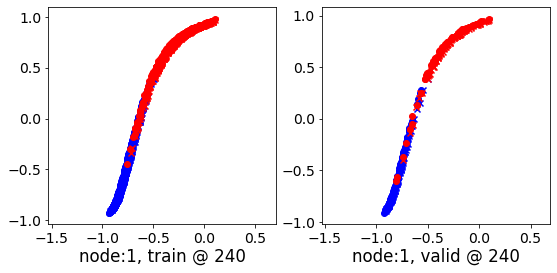

240 	 2 	 0.09974173 	 0.04878497 	 0.35552678 	 0.30593079 	 0.95042700 	 0.95029300


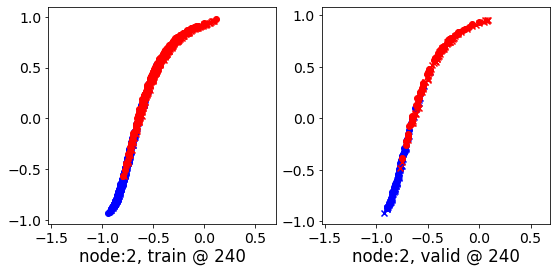

Aggregating on epoch: 242...
Aggregating on epoch: 244...
Aggregating on epoch: 246...
Aggregating on epoch: 248...
Aggregating on epoch: 250...
Aggregating on epoch: 252...
Aggregating on epoch: 254...
Aggregating on epoch: 256...
Aggregating on epoch: 258...
Aggregating on epoch: 260...
260 	 0 	 -0.11257161 	 -0.11319537 	 0.05509419 	 0.03293078 	 0.86168122 	 0.83927333


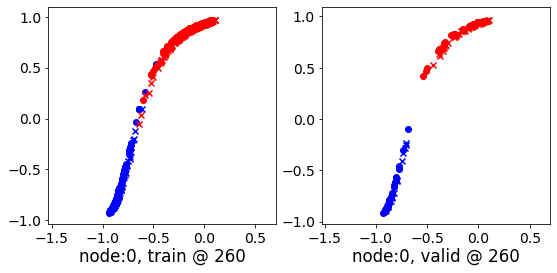

260 	 1 	 -0.21833232 	 -0.04112948 	 0.01911483 	 0.20885341 	 0.93184799 	 0.94313008


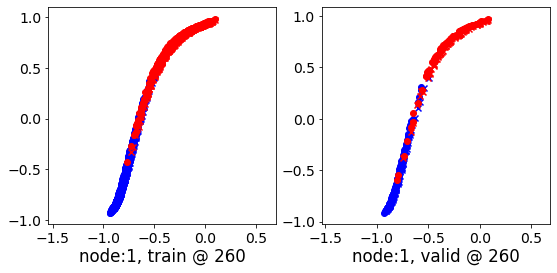

260 	 2 	 0.03378636 	 0.04925010 	 0.29384476 	 0.30547896 	 0.95280689 	 0.94937605


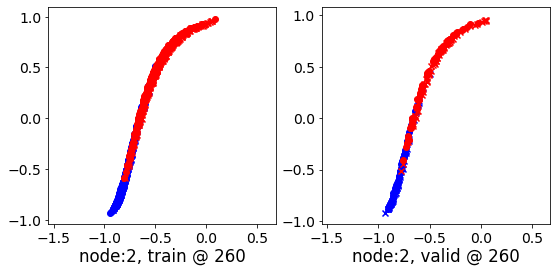

Aggregating on epoch: 262...
Aggregating on epoch: 264...
Aggregating on epoch: 266...
Aggregating on epoch: 268...
Aggregating on epoch: 270...
Aggregating on epoch: 272...
Aggregating on epoch: 274...
Aggregating on epoch: 276...
Aggregating on epoch: 278...
Aggregating on epoch: 280...
280 	 0 	 -0.11791350 	 -0.12049828 	 0.05004012 	 0.02576179 	 0.86195958 	 0.83940727


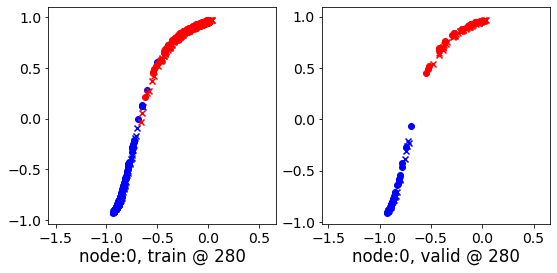

280 	 1 	 -0.17873588 	 -0.03682342 	 0.01932277 	 0.21707299 	 0.89119142 	 0.94704360


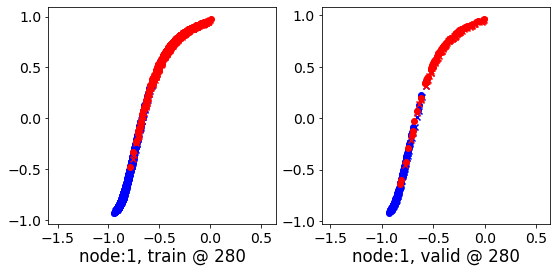

280 	 2 	 0.12909496 	 0.05249935 	 0.38706130 	 0.30891609 	 0.95044667 	 0.94956392


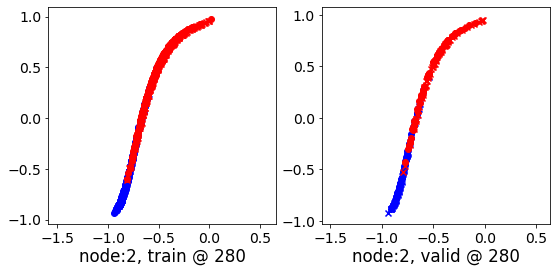

Aggregating on epoch: 282...
Aggregating on epoch: 284...
Aggregating on epoch: 286...
Aggregating on epoch: 288...
Aggregating on epoch: 290...
Aggregating on epoch: 292...
Aggregating on epoch: 294...
Aggregating on epoch: 296...
Aggregating on epoch: 298...
Aggregating on epoch: 300...
300 	 0 	 -0.12087359 	 -0.12516215 	 0.04670225 	 0.02075365 	 0.86143655 	 0.83906299


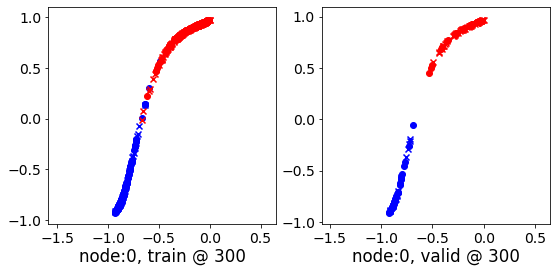

300 	 1 	 -0.22263175 	 -0.02877435 	 0.04077366 	 0.22081032 	 0.95510751 	 0.94273186


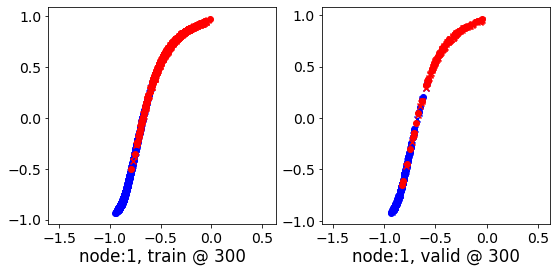

300 	 2 	 0.06053257 	 0.04745975 	 0.31603262 	 0.30502400 	 0.94922191 	 0.95071143


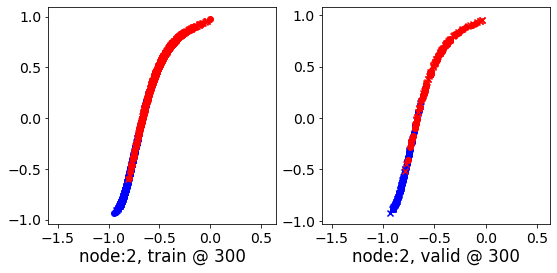

Aggregating on epoch: 302...
Aggregating on epoch: 304...
Aggregating on epoch: 306...
Aggregating on epoch: 308...
Aggregating on epoch: 310...
Aggregating on epoch: 312...
Aggregating on epoch: 314...
Aggregating on epoch: 316...
Aggregating on epoch: 318...
Aggregating on epoch: 320...
320 	 0 	 -0.12255640 	 -0.12950493 	 0.04528143 	 0.01715158 	 0.86158454 	 0.83980370


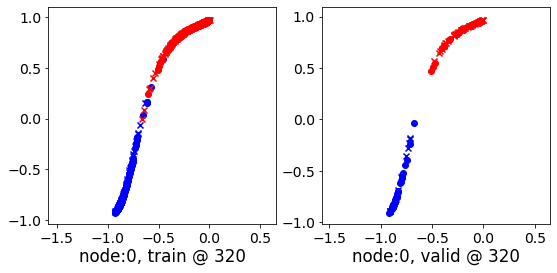

320 	 1 	 -0.11298326 	 -0.04165140 	 0.15705279 	 0.20865265 	 0.96964449 	 0.94345123


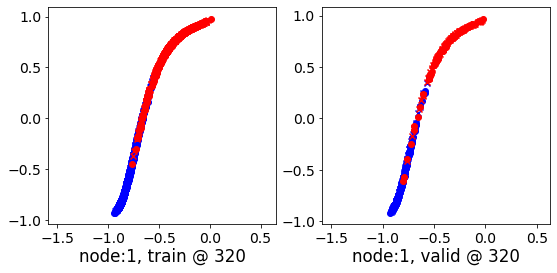

320 	 2 	 0.10392180 	 0.04640862 	 0.36060128 	 0.30462161 	 0.94998878 	 0.95136017


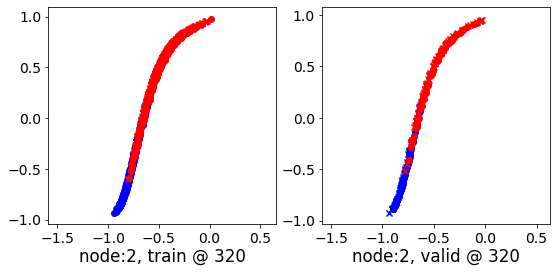

Aggregating on epoch: 322...
Aggregating on epoch: 324...
Aggregating on epoch: 326...
Aggregating on epoch: 328...
Aggregating on epoch: 330...
Aggregating on epoch: 332...
Aggregating on epoch: 334...
Aggregating on epoch: 336...
Aggregating on epoch: 338...
Aggregating on epoch: 340...
340 	 0 	 -0.12197071 	 -0.12940030 	 0.04296304 	 0.01594522 	 0.86095870 	 0.83849269


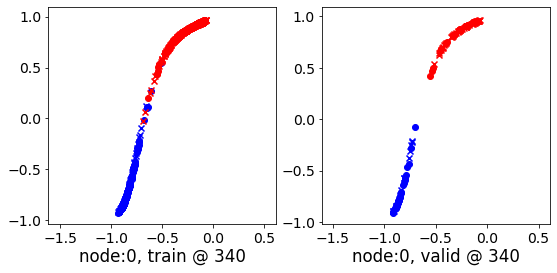

340 	 1 	 -0.16563390 	 -0.03928140 	 0.08053879 	 0.21085933 	 0.93887180 	 0.94328791


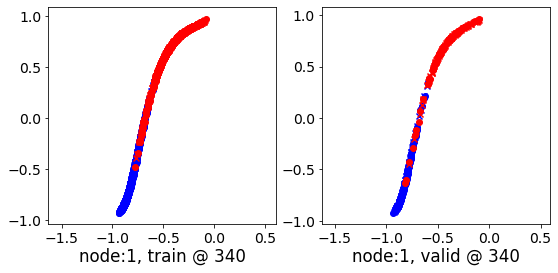

340 	 2 	 0.06875059 	 0.04697892 	 0.32719570 	 0.30535641 	 0.95184141 	 0.95152467


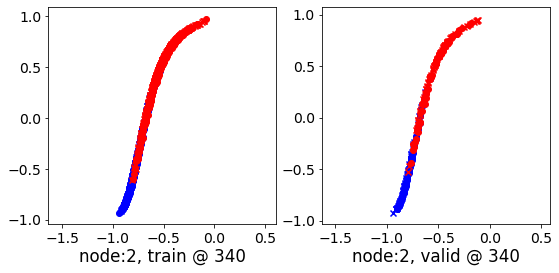

Aggregating on epoch: 342...
Aggregating on epoch: 344...
Aggregating on epoch: 346...
Aggregating on epoch: 348...
Aggregating on epoch: 350...
Aggregating on epoch: 352...
Aggregating on epoch: 354...
Aggregating on epoch: 356...
Aggregating on epoch: 358...
Aggregating on epoch: 360...
360 	 0 	 -0.12360569 	 -0.13286594 	 0.04190554 	 0.01331005 	 0.86111856 	 0.83932316


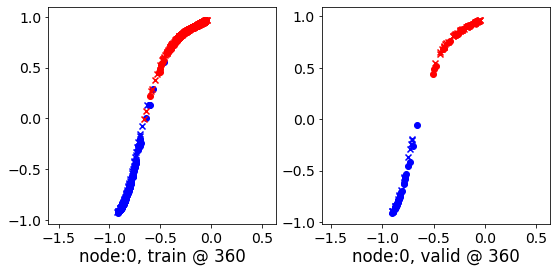

360 	 1 	 -0.22524182 	 -0.03890008 	 0.00686238 	 0.21118408 	 0.92513007 	 0.94323134


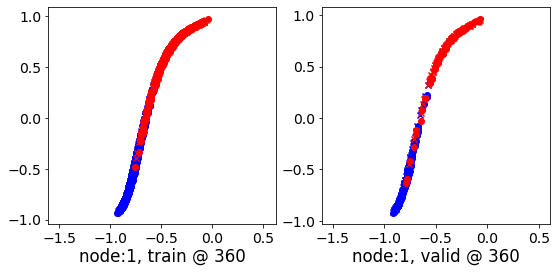

360 	 2 	 0.07696798 	 0.04516557 	 0.33236381 	 0.30406532 	 0.95026356 	 0.95204693


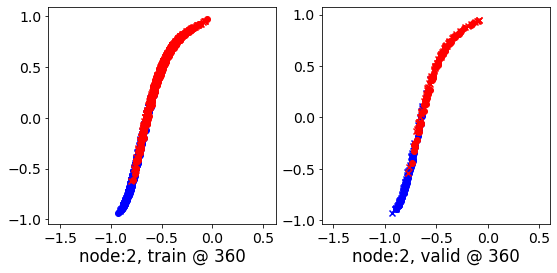

Aggregating on epoch: 362...
Aggregating on epoch: 364...
Aggregating on epoch: 366...
Aggregating on epoch: 368...
Aggregating on epoch: 370...
Aggregating on epoch: 372...
Aggregating on epoch: 374...
Aggregating on epoch: 376...
Aggregating on epoch: 378...
Aggregating on epoch: 380...
380 	 0 	 -0.12429751 	 -0.13450159 	 0.04070064 	 0.01222472 	 0.86157793 	 0.83987349


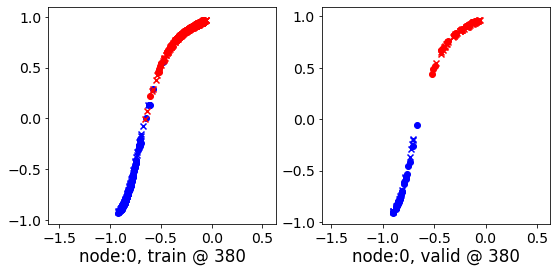

380 	 1 	 -0.29796287 	 -0.02753322 	 0.02489753 	 0.22303064 	 1.01556385 	 0.94371104


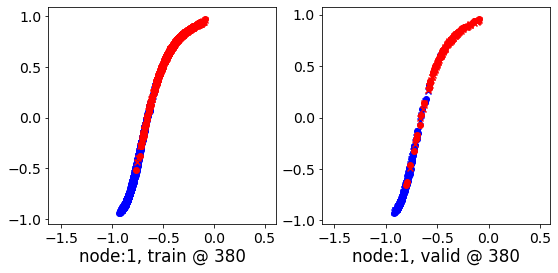

380 	 2 	 0.04945487 	 0.04583192 	 0.30231136 	 0.30492115 	 0.94834971 	 0.95223641


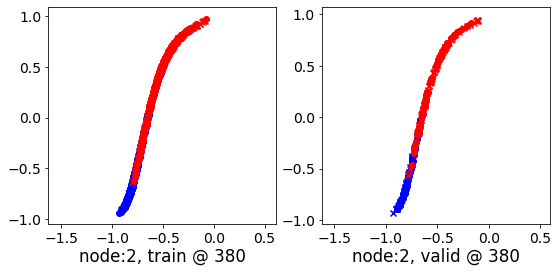

Aggregating on epoch: 382...
Aggregating on epoch: 384...
Aggregating on epoch: 386...
Aggregating on epoch: 388...
Aggregating on epoch: 390...
Aggregating on epoch: 392...
Aggregating on epoch: 394...
Aggregating on epoch: 396...
Aggregating on epoch: 398...
Aggregating on epoch: 400...
400 	 0 	 -0.12389252 	 -0.13611251 	 0.04145534 	 0.01151382 	 0.86228698 	 0.84077352


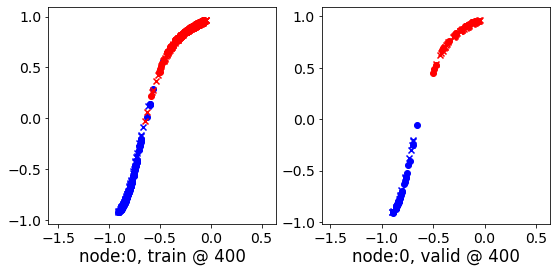

400 	 1 	 0.35277417 	 -0.04088537 	 0.48952633 	 0.21224321 	 0.83644867 	 0.94627577


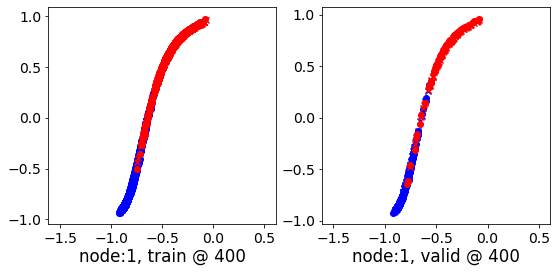

400 	 2 	 0.08821818 	 0.04486033 	 0.34477708 	 0.30502972 	 0.94944710 	 0.95331657


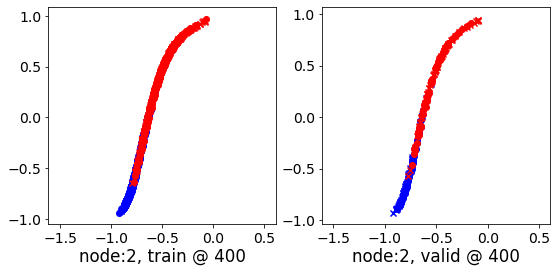

Aggregating on epoch: 402...
Aggregating on epoch: 404...
Aggregating on epoch: 406...
Aggregating on epoch: 408...
Aggregating on epoch: 410...
Aggregating on epoch: 412...
Aggregating on epoch: 414...
Aggregating on epoch: 416...
Aggregating on epoch: 418...
Aggregating on epoch: 420...
420 	 0 	 -0.12422024 	 -0.13859031 	 0.04170815 	 0.01039585 	 0.86270946 	 0.84213334


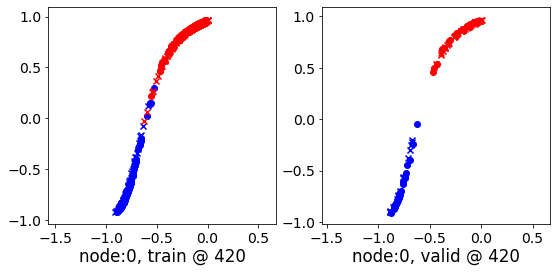

420 	 1 	 0.23629758 	 -0.02905129 	 0.45038110 	 0.22176428 	 0.94014949 	 0.94396275


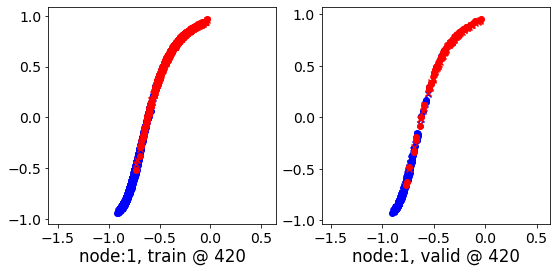

420 	 2 	 0.08869329 	 0.04288578 	 0.33778304 	 0.30354720 	 0.94480276 	 0.95380861


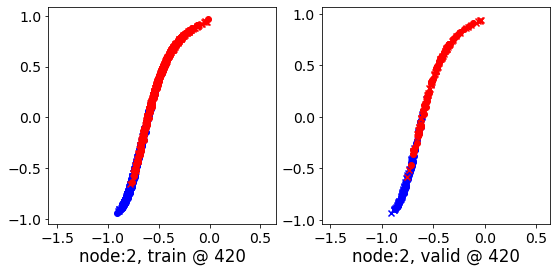

Aggregating on epoch: 422...
Aggregating on epoch: 424...
Aggregating on epoch: 426...
Aggregating on epoch: 428...
Aggregating on epoch: 430...
Aggregating on epoch: 432...
Aggregating on epoch: 434...
Aggregating on epoch: 436...
Aggregating on epoch: 438...
Aggregating on epoch: 440...
440 	 0 	 -0.12489477 	 -0.13790892 	 0.04050960 	 0.01001305 	 0.86181778 	 0.84106916


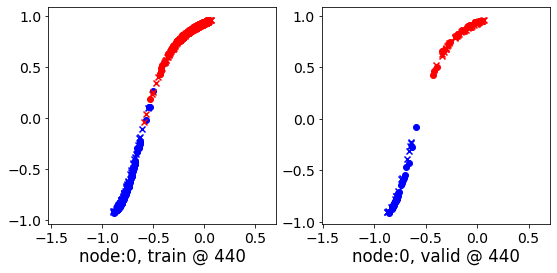

440 	 1 	 -0.03173877 	 -0.04188797 	 0.15559952 	 0.20863774 	 0.88772136 	 0.94367290


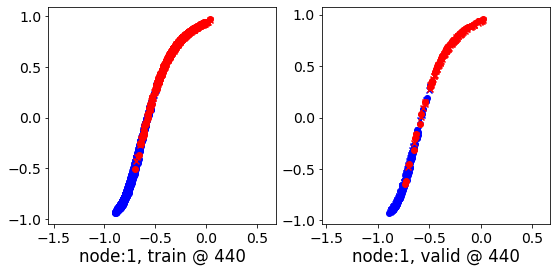

440 	 2 	 0.06354401 	 0.04231739 	 0.32249761 	 0.30342090 	 0.95105124 	 0.95425069


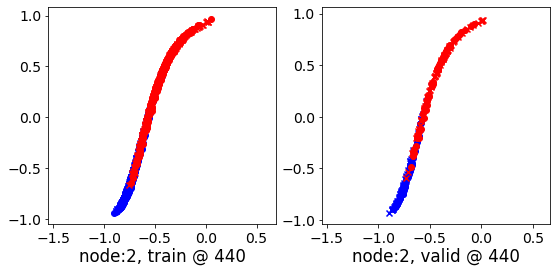

Aggregating on epoch: 442...
Aggregating on epoch: 444...
Aggregating on epoch: 446...
Aggregating on epoch: 448...
Aggregating on epoch: 450...
Aggregating on epoch: 452...
Aggregating on epoch: 454...
Aggregating on epoch: 456...
Aggregating on epoch: 458...
Aggregating on epoch: 460...
460 	 0 	 -0.12312980 	 -0.14079142 	 0.04355940 	 0.00930726 	 0.86283815 	 0.84324586


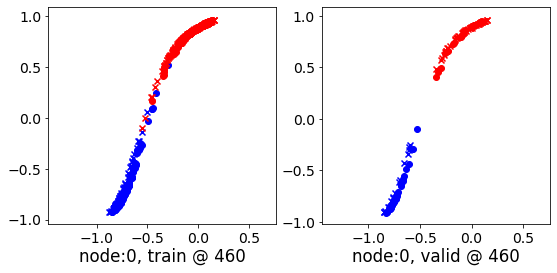

460 	 1 	 0.12364247 	 -0.03946202 	 0.42211780 	 0.21161933 	 1.00056505 	 0.94422853


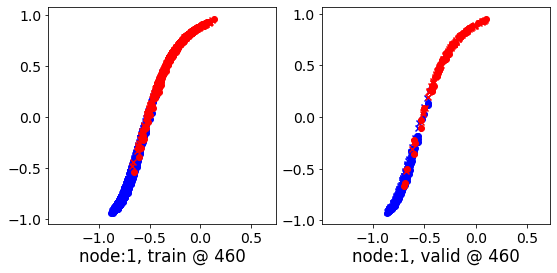

460 	 2 	 0.05689314 	 0.04107422 	 0.30860955 	 0.30309421 	 0.94966418 	 0.95516717


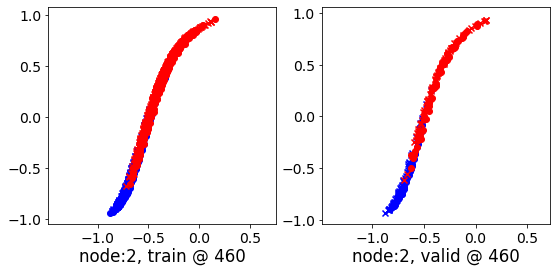

Aggregating on epoch: 462...
Aggregating on epoch: 464...
Aggregating on epoch: 466...
Aggregating on epoch: 468...
Aggregating on epoch: 470...
Aggregating on epoch: 472...
Aggregating on epoch: 474...
Aggregating on epoch: 476...
Aggregating on epoch: 478...
Aggregating on epoch: 480...
480 	 0 	 -0.12758805 	 -0.13895039 	 0.03936774 	 0.00925382 	 0.86100370 	 0.84135139


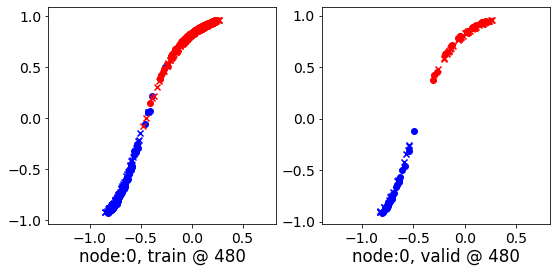

480 	 1 	 -0.24694188 	 -0.05109306 	 0.00818335 	 0.19948392 	 0.94818395 	 0.94372416


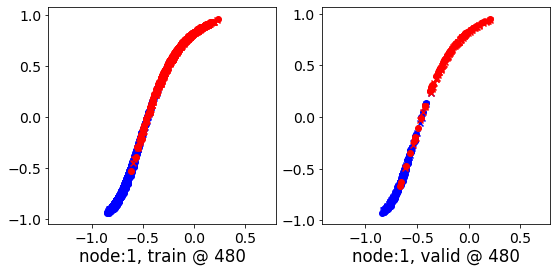

480 	 2 	 0.09160134 	 0.04298893 	 0.33665729 	 0.30358753 	 0.94560003 	 0.95374578


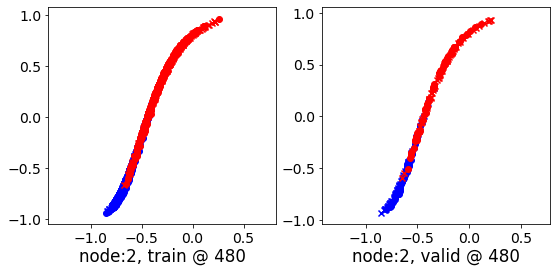

Aggregating on epoch: 482...
Aggregating on epoch: 484...
Aggregating on epoch: 486...
Aggregating on epoch: 488...
Aggregating on epoch: 490...
Aggregating on epoch: 492...
Aggregating on epoch: 494...
Aggregating on epoch: 496...
Aggregating on epoch: 498...
Aggregating on epoch: 500...
500 	 0 	 -0.12288262 	 -0.14014867 	 0.04201464 	 0.00943980 	 0.86159742 	 0.84273565


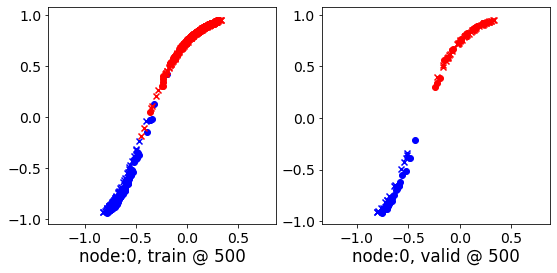

500 	 1 	 -0.14529817 	 -0.04719520 	 0.18509553 	 0.20431060 	 1.02492392 	 0.94465297


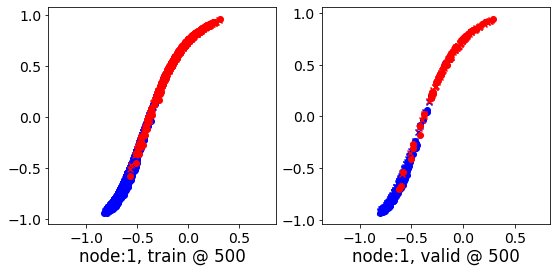

500 	 2 	 0.15391418 	 0.04075211 	 0.41405535 	 0.30333030 	 0.95428759 	 0.95572537


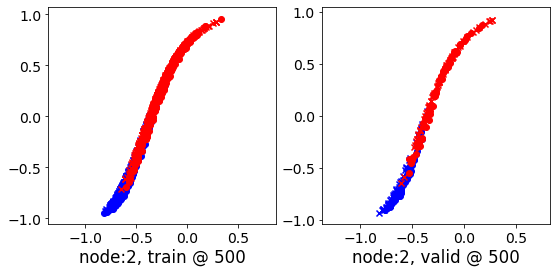

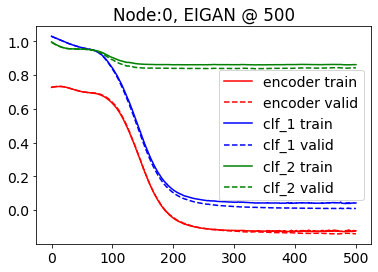

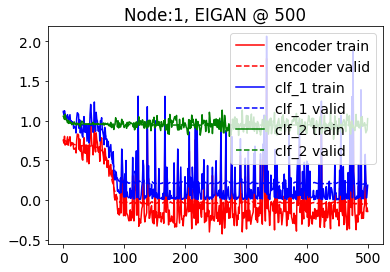

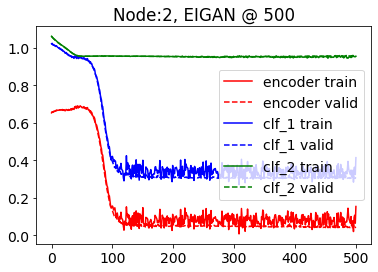

  0%|          | 1/501 [00:00<01:23,  5.97it/s]

epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70886242 	 0.70150995 	 1.03019547 	 1.02276778 	 1.01493049 	 1.01440501


100%|██████████| 501/501 [01:04<00:00,  7.74it/s]


500 	 -0.03450517 	 -0.03987382 	 0.21075463 	 0.20614441 	 0.93843311 	 0.93916541


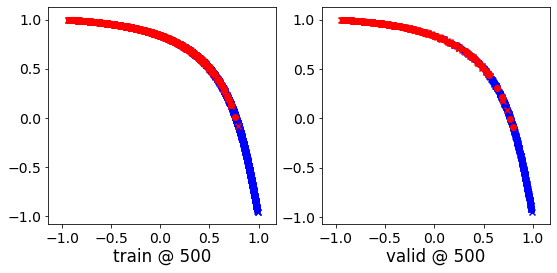

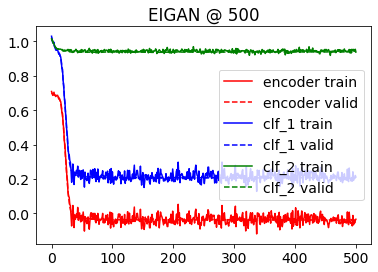

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.075198 	 1.074893 	 0.5334
200 	 0.532367 	 0.522582 	 0.9240
400 	 0.228303 	 0.220826 	 0.9345
600 	 0.213038 	 0.208293 	 0.9318
800 	 0.212042 	 0.208069 	 0.9318
1000 	 0.211894 	 0.208084 	 0.9318
Accuracy: 0.9318479685452162
Error Rate: 0.06815203145478375
F1 Score: 0.9252873563218391
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9318479685452162
Error Rate: 0.06815203145478375
F1 Score: 0.9244186046511629
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9357798165137615
Error Rate: 0.0

@node 3: tensor sizes => torch.Size([566, 2]) (142, 2) torch.Size([566, 2]) (142, 2) torch.Size([566, 2]) (142, 2)
--------------------------------------------------------------------------------
EIGAN Training w/ phi=1.0 and delta=2
--------------------------------------------------------------------------------
epoch 	 node 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0 	 0.65844619 	 0.66004252 	 1.01740110 	 1.01381636 	 1.05215561 	 1.04692101


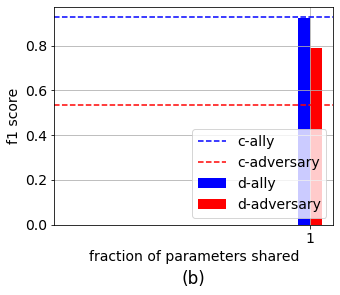

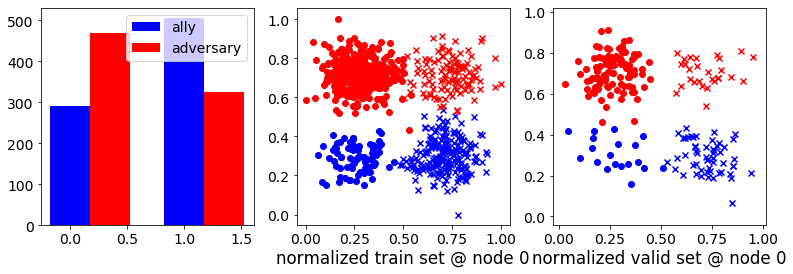

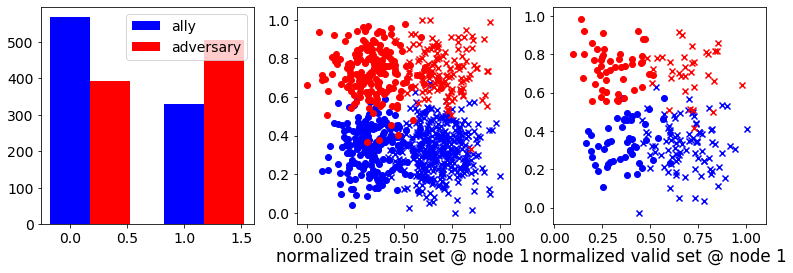

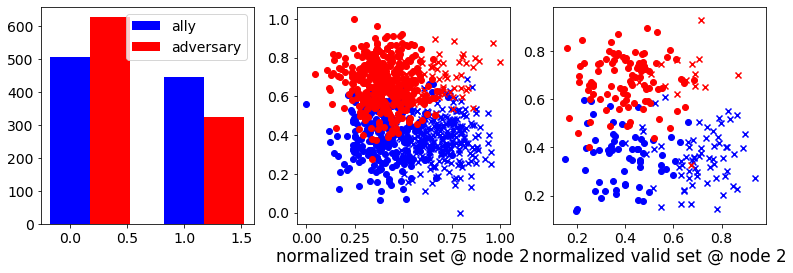

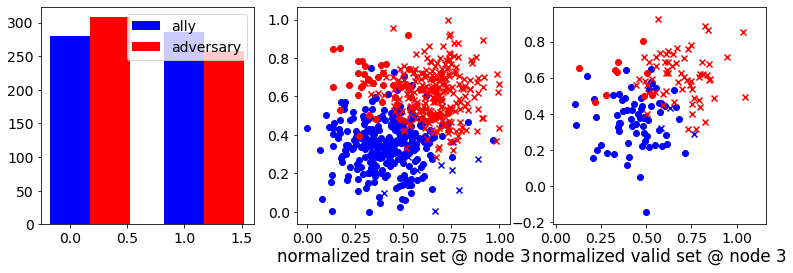

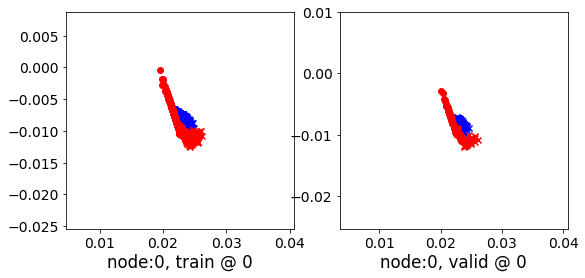

0 	 1 	 0.71211112 	 0.71604669 	 1.04654956 	 1.04900146 	 1.02777529 	 1.02610195


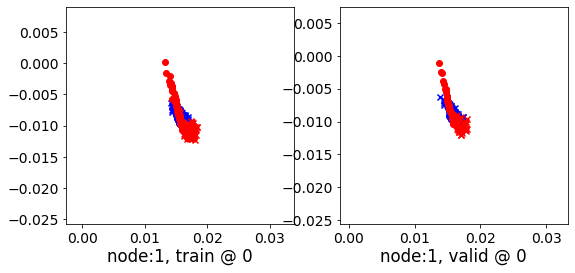

0 	 2 	 0.63817215 	 0.65074074 	 1.02843666 	 1.02689517 	 1.08349562 	 1.06930161


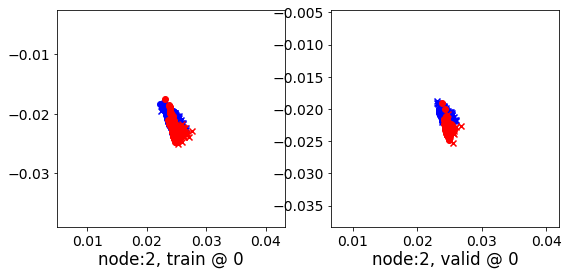

0 	 3 	 0.73514050 	 0.70444965 	 1.03181732 	 1.01774359 	 0.98991573 	 1.00644112


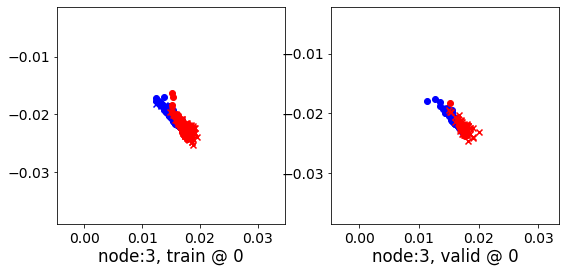

Aggregating on epoch: 2...
Aggregating on epoch: 4...
Aggregating on epoch: 6...
Aggregating on epoch: 8...
Aggregating on epoch: 10...
Aggregating on epoch: 12...
Aggregating on epoch: 14...
Aggregating on epoch: 16...
Aggregating on epoch: 18...
Aggregating on epoch: 20...
20 	 0 	 0.65426916 	 0.65706062 	 0.97398072 	 0.97208786 	 1.01292241 	 1.00817442


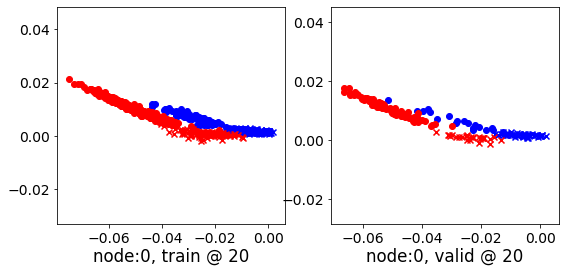

20 	 1 	 0.70172632 	 0.70317245 	 0.97026747 	 0.97134298 	 0.96182531 	 0.96131772


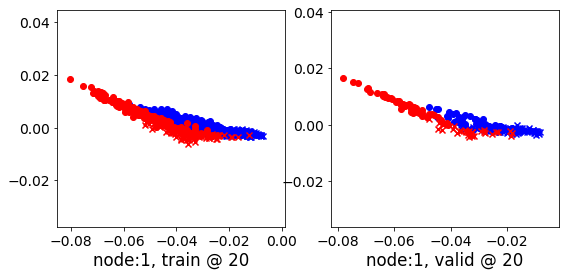

20 	 2 	 0.68399537 	 0.68442863 	 0.98078144 	 0.97986794 	 0.98996329 	 0.98858649


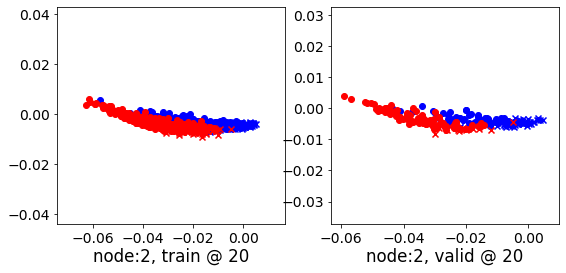

20 	 3 	 0.68947452 	 0.68314505 	 0.97230375 	 0.96920753 	 0.97608280 	 0.97920966


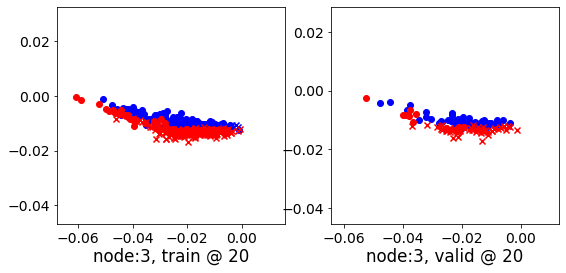

Aggregating on epoch: 22...
Aggregating on epoch: 24...
Aggregating on epoch: 26...
Aggregating on epoch: 28...
Aggregating on epoch: 30...
Aggregating on epoch: 32...
Aggregating on epoch: 34...
Aggregating on epoch: 36...
Aggregating on epoch: 38...
Aggregating on epoch: 40...
40 	 0 	 0.66878021 	 0.66824192 	 0.95098662 	 0.94615090 	 0.97548008 	 0.97105616


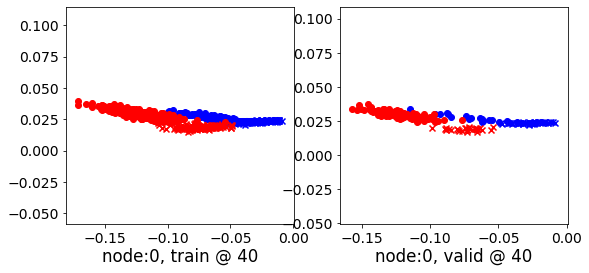

40 	 1 	 0.67819715 	 0.68628472 	 0.94531566 	 0.94444865 	 0.96032798 	 0.95131111


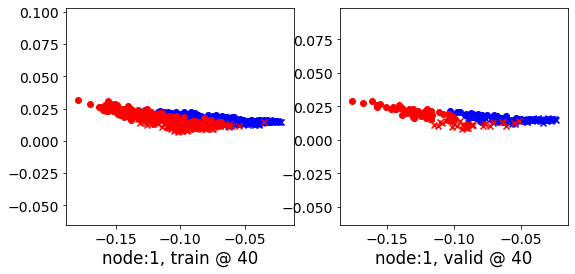

40 	 2 	 0.70577520 	 0.70459121 	 0.95777828 	 0.95617688 	 0.94519633 	 0.94473284


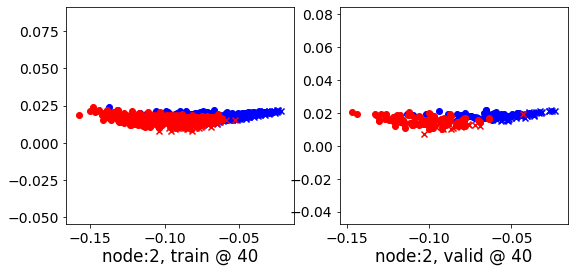

40 	 3 	 0.69718957 	 0.68950754 	 0.96064985 	 0.95501095 	 0.95661616 	 0.95865059


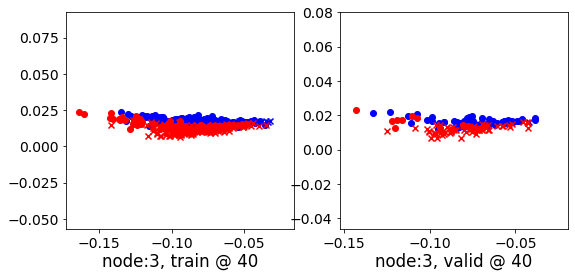

Aggregating on epoch: 42...
Aggregating on epoch: 44...
Aggregating on epoch: 46...
Aggregating on epoch: 48...
Aggregating on epoch: 50...
Aggregating on epoch: 52...
Aggregating on epoch: 54...
Aggregating on epoch: 56...
Aggregating on epoch: 58...
Aggregating on epoch: 60...
60 	 0 	 0.70050198 	 0.68039262 	 0.96231335 	 0.93568474 	 0.95522684 	 0.94843930


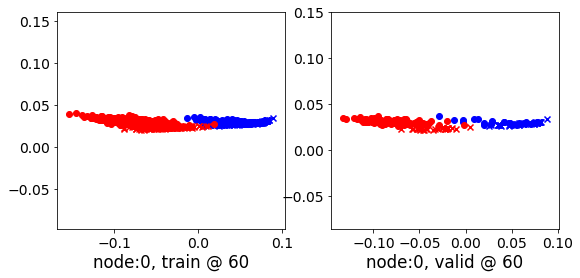

60 	 1 	 0.65992546 	 0.67696333 	 0.91124618 	 0.93372053 	 0.94491941 	 0.94990438


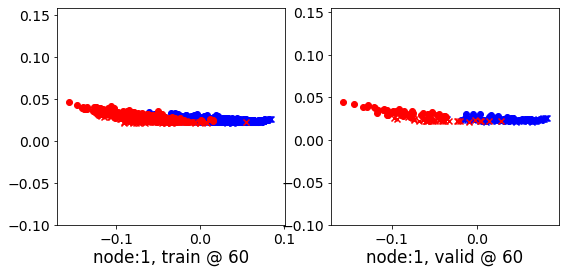

60 	 2 	 0.69438934 	 0.71018344 	 0.95196301 	 0.95321238 	 0.95079070 	 0.93617612


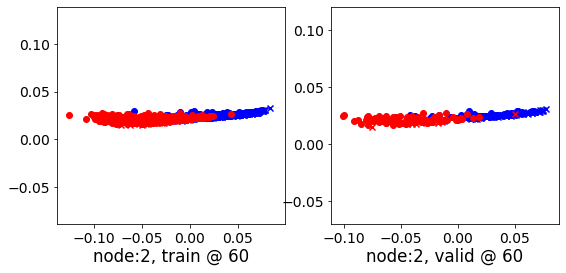

60 	 3 	 0.69880408 	 0.69398147 	 0.95452559 	 0.95459002 	 0.94887584 	 0.95375574


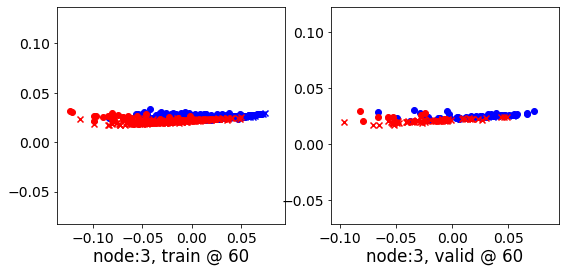

Aggregating on epoch: 62...
Aggregating on epoch: 64...
Aggregating on epoch: 66...
Aggregating on epoch: 68...
Aggregating on epoch: 70...
Aggregating on epoch: 72...
Aggregating on epoch: 74...
Aggregating on epoch: 76...
Aggregating on epoch: 78...
Aggregating on epoch: 80...
80 	 0 	 0.64251637 	 0.63115644 	 0.88241857 	 0.86977047 	 0.93554461 	 0.93176121


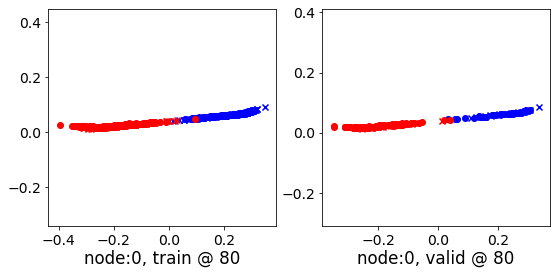

80 	 1 	 0.58149332 	 0.59399706 	 0.83148760 	 0.84125394 	 0.94632691 	 0.94040406


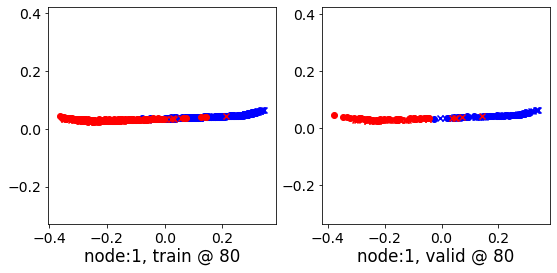

80 	 2 	 0.69324225 	 0.70010775 	 0.94366354 	 0.93918729 	 0.94399995 	 0.93222672


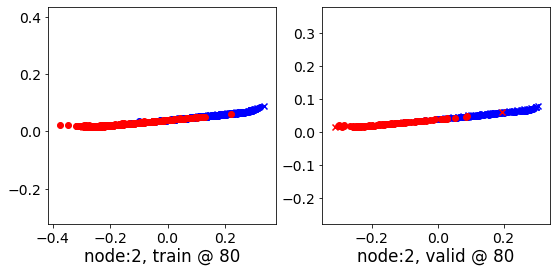

80 	 3 	 0.67895049 	 0.68526077 	 0.93641037 	 0.94026250 	 0.95098734 	 0.94814891


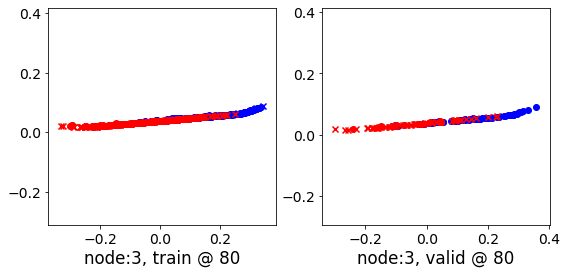

Aggregating on epoch: 82...
Aggregating on epoch: 84...
Aggregating on epoch: 86...
Aggregating on epoch: 88...
Aggregating on epoch: 90...
Aggregating on epoch: 92...
Aggregating on epoch: 94...
Aggregating on epoch: 96...
Aggregating on epoch: 98...
Aggregating on epoch: 100...
100 	 0 	 0.33266068 	 0.32819232 	 0.49846122 	 0.49207148 	 0.86390179 	 0.85702634


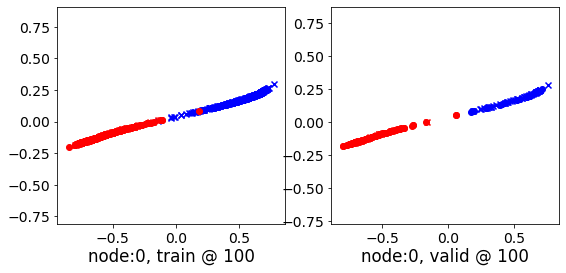

100 	 1 	 0.21038687 	 0.21550721 	 0.41422021 	 0.43927813 	 0.90166521 	 0.91691810


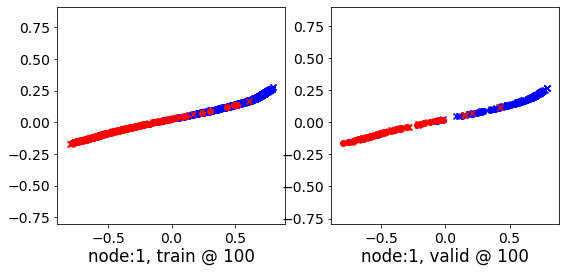

100 	 2 	 0.60618728 	 0.56705534 	 0.80706489 	 0.77349293 	 0.89689851 	 0.89958477


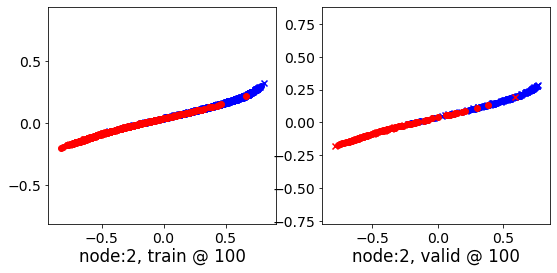

100 	 3 	 0.54687530 	 0.58842891 	 0.75742114 	 0.78146535 	 0.90565628 	 0.88618362


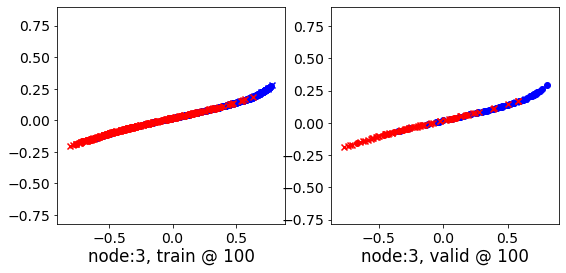

Aggregating on epoch: 102...
Aggregating on epoch: 104...
Aggregating on epoch: 106...
Aggregating on epoch: 108...
Aggregating on epoch: 110...
Aggregating on epoch: 112...
Aggregating on epoch: 114...
Aggregating on epoch: 116...
Aggregating on epoch: 118...
Aggregating on epoch: 120...
120 	 0 	 0.04831731 	 0.03624886 	 0.14984208 	 0.14451170 	 0.79841202 	 0.80141002


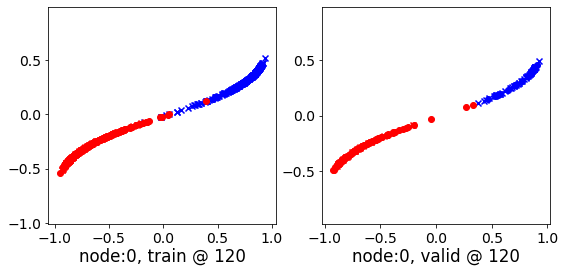

120 	 1 	 -0.05366053 	 -0.01866618 	 0.18746312 	 0.21106657 	 0.93499082 	 0.92287993


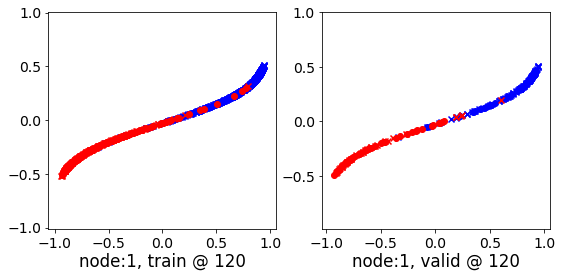

120 	 2 	 0.33730388 	 0.27315295 	 0.52963173 	 0.43779439 	 0.88733029 	 0.85778862


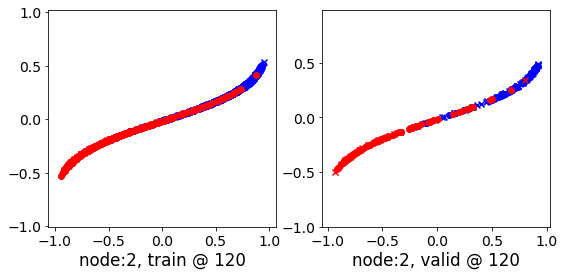

120 	 3 	 0.56538934 	 0.50310946 	 0.57485038 	 0.54307288 	 0.70188826 	 0.73311061


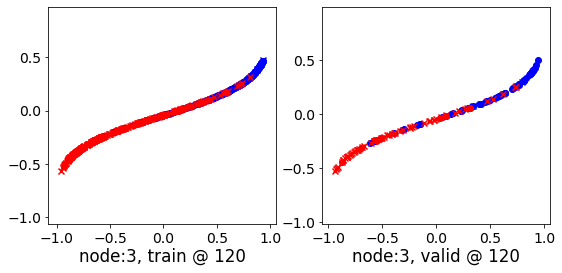

Aggregating on epoch: 122...
Aggregating on epoch: 124...
Aggregating on epoch: 126...
Aggregating on epoch: 128...
Aggregating on epoch: 130...
Aggregating on epoch: 132...
Aggregating on epoch: 134...
Aggregating on epoch: 136...
Aggregating on epoch: 138...
Aggregating on epoch: 140...
140 	 0 	 -0.03876886 	 -0.03630400 	 0.06518181 	 0.07521819 	 0.80046779 	 0.80466938


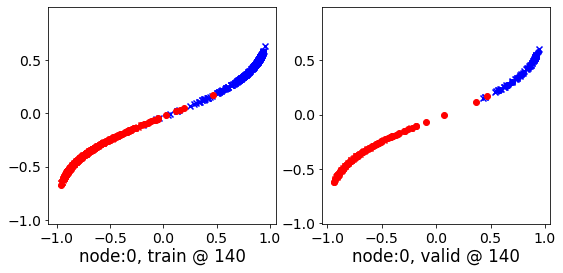

140 	 1 	 -0.03720067 	 -0.04004942 	 0.20676817 	 0.19555844 	 0.94104415 	 0.92875504


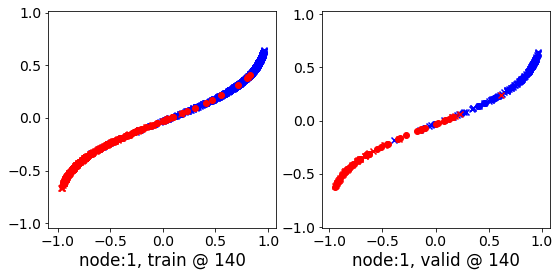

140 	 2 	 0.25070590 	 0.16642958 	 0.43255815 	 0.33961254 	 0.87430412 	 0.86633015


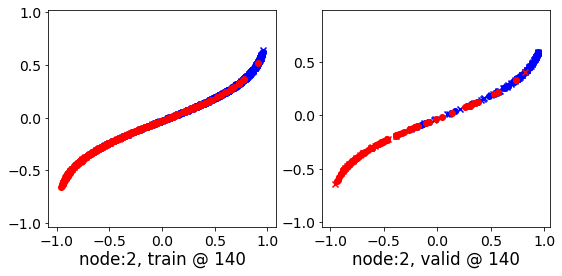

140 	 3 	 0.41469243 	 0.54181719 	 0.37815380 	 0.51947159 	 0.65835673 	 0.67080158


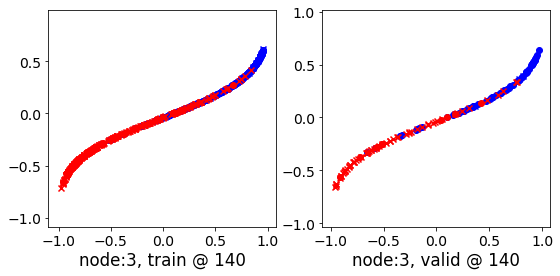

Aggregating on epoch: 142...
Aggregating on epoch: 144...
Aggregating on epoch: 146...
Aggregating on epoch: 148...
Aggregating on epoch: 150...
Aggregating on epoch: 152...
Aggregating on epoch: 154...
Aggregating on epoch: 156...
Aggregating on epoch: 158...
Aggregating on epoch: 160...
160 	 0 	 -0.04522799 	 -0.04169296 	 0.03129825 	 0.05792863 	 0.77260101 	 0.79276878


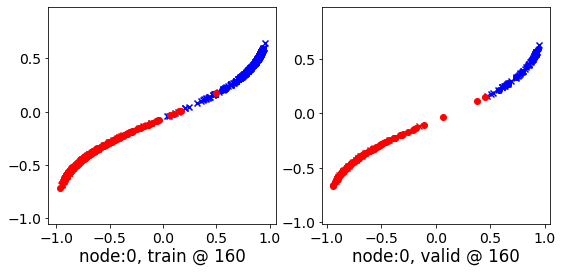

160 	 1 	 -0.03673348 	 -0.04606925 	 0.20738986 	 0.18580116 	 0.93911147 	 0.92501760


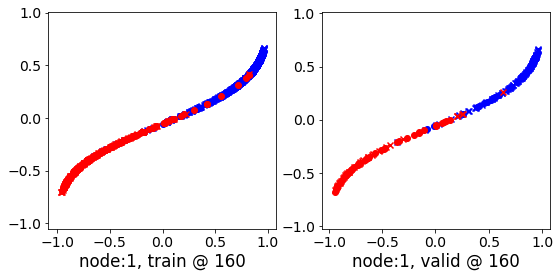

160 	 2 	 0.21118566 	 0.14934397 	 0.38250577 	 0.31535047 	 0.86396098 	 0.85915369


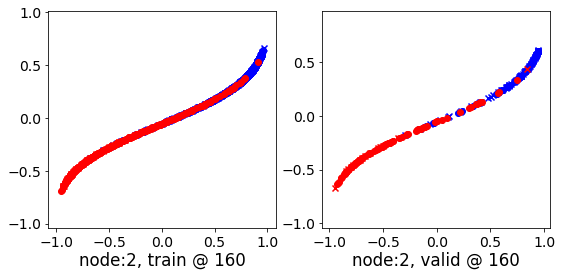

160 	 3 	 0.53724611 	 0.53936368 	 0.39249852 	 0.52935934 	 0.55078727 	 0.68314284


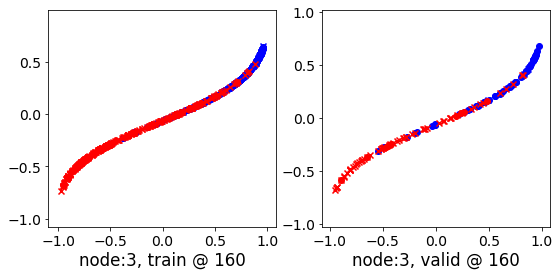

Aggregating on epoch: 162...
Aggregating on epoch: 164...
Aggregating on epoch: 166...
Aggregating on epoch: 168...
Aggregating on epoch: 170...
Aggregating on epoch: 172...
Aggregating on epoch: 174...
Aggregating on epoch: 176...
Aggregating on epoch: 178...
Aggregating on epoch: 180...
180 	 0 	 -0.04880617 	 -0.04398810 	 0.04428297 	 0.05336643 	 0.79073346 	 0.79050171


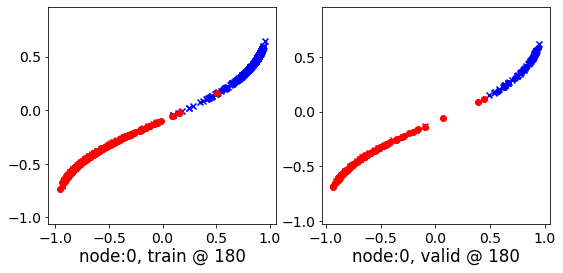

180 	 1 	 -0.05530821 	 -0.04755224 	 0.18855505 	 0.18275844 	 0.93709993 	 0.92345786


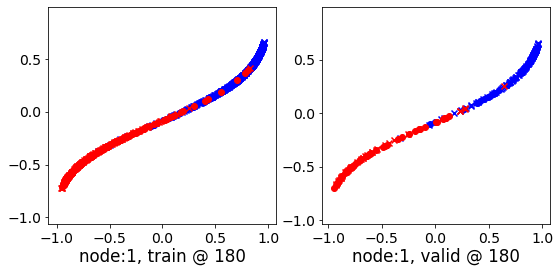

180 	 2 	 0.16788483 	 0.14273506 	 0.35989404 	 0.30456960 	 0.88622278 	 0.85498172


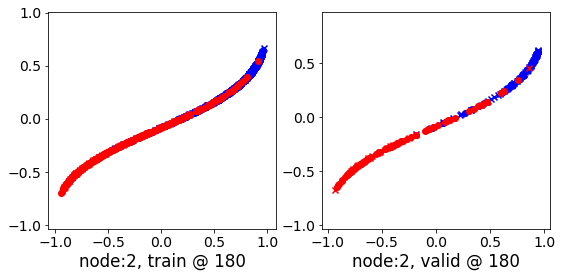

180 	 3 	 0.42479569 	 0.53786236 	 0.46337283 	 0.53388751 	 0.73175329 	 0.68917233


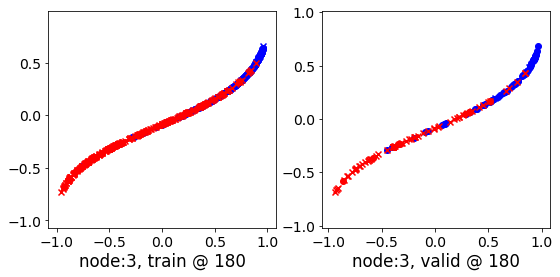

Aggregating on epoch: 182...
Aggregating on epoch: 184...
Aggregating on epoch: 186...
Aggregating on epoch: 188...
Aggregating on epoch: 190...
Aggregating on epoch: 192...
Aggregating on epoch: 194...
Aggregating on epoch: 196...
Aggregating on epoch: 198...
Aggregating on epoch: 200...
200 	 0 	 -0.06333159 	 -0.04722932 	 0.02300566 	 0.05187198 	 0.78435093 	 0.79224849


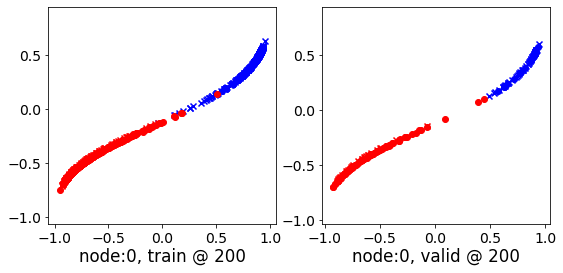

200 	 1 	 -0.03082611 	 -0.04978520 	 0.18714386 	 0.18096048 	 0.91083688 	 0.92389286


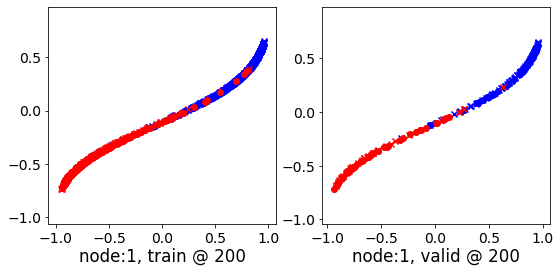

200 	 2 	 0.23824787 	 0.13757247 	 0.38981363 	 0.29915953 	 0.85336202 	 0.85473424


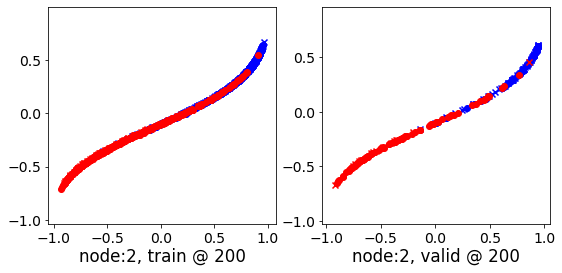

200 	 3 	 0.56932294 	 0.53510231 	 0.65682971 	 0.53122473 	 0.79140079 	 0.68926960


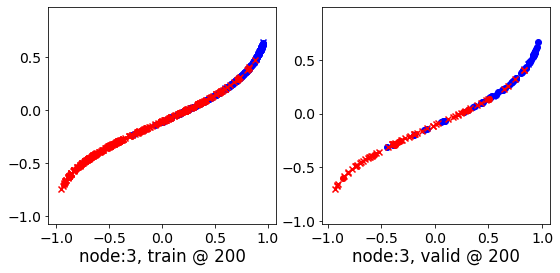

Aggregating on epoch: 202...
Aggregating on epoch: 204...
Aggregating on epoch: 206...
Aggregating on epoch: 208...
Aggregating on epoch: 210...
Aggregating on epoch: 212...
Aggregating on epoch: 214...
Aggregating on epoch: 216...
Aggregating on epoch: 218...
Aggregating on epoch: 220...
220 	 0 	 -0.07831497 	 -0.05164288 	 0.01943442 	 0.05080219 	 0.79401672 	 0.79559225


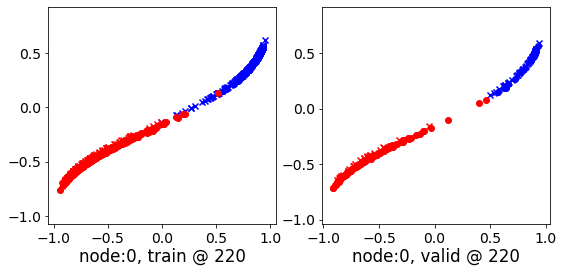

220 	 1 	 -0.06571558 	 -0.05045640 	 0.18151511 	 0.18089300 	 0.94073611 	 0.92449659


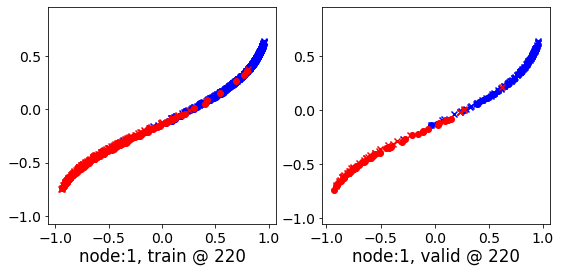

220 	 2 	 0.20161685 	 0.13570091 	 0.38015771 	 0.29723409 	 0.87343073 	 0.85468036


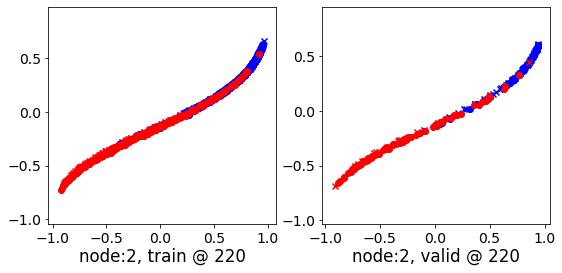

220 	 3 	 0.53806520 	 0.53525662 	 0.38206214 	 0.53049845 	 0.53801137 	 0.68838900


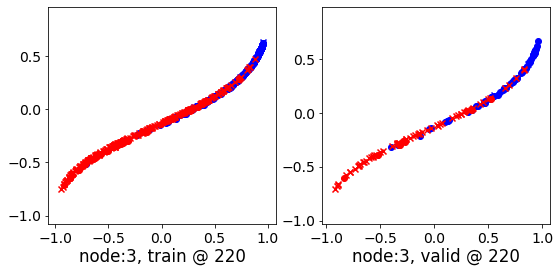

Aggregating on epoch: 222...
Aggregating on epoch: 224...
Aggregating on epoch: 226...
Aggregating on epoch: 228...
Aggregating on epoch: 230...
Aggregating on epoch: 232...
Aggregating on epoch: 234...
Aggregating on epoch: 236...
Aggregating on epoch: 238...
Aggregating on epoch: 240...
240 	 0 	 -0.05373891 	 -0.05414588 	 0.01956099 	 0.05212855 	 0.76458973 	 0.79942161


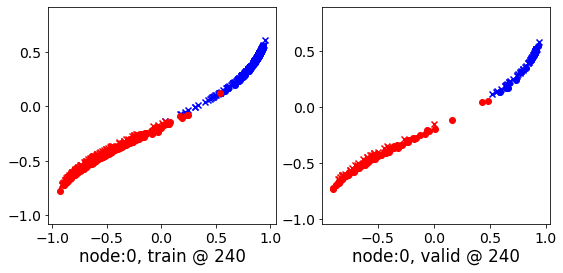

240 	 1 	 -0.12880960 	 -0.05055986 	 0.11466992 	 0.18105163 	 0.93805403 	 0.92475867


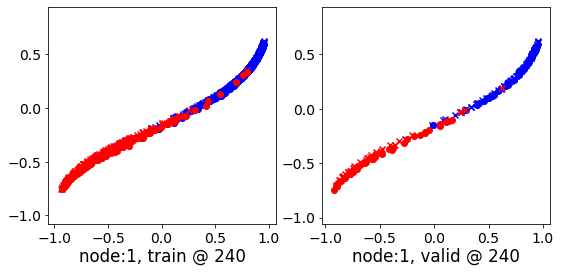

240 	 2 	 0.19981983 	 0.13461289 	 0.34358263 	 0.29613653 	 0.83736914 	 0.85467082


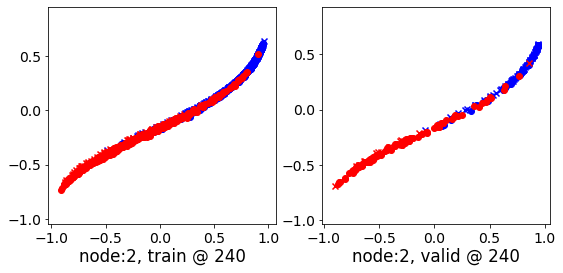

240 	 3 	 0.57377851 	 0.53517252 	 0.43037039 	 0.52949941 	 0.55199045 	 0.68747407


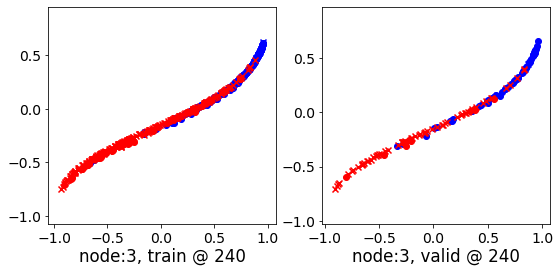

Aggregating on epoch: 242...
Aggregating on epoch: 244...
Aggregating on epoch: 246...
Aggregating on epoch: 248...
Aggregating on epoch: 250...
Aggregating on epoch: 252...
Aggregating on epoch: 254...
Aggregating on epoch: 256...
Aggregating on epoch: 258...
Aggregating on epoch: 260...
260 	 0 	 -0.10185809 	 -0.05713667 	 0.02043835 	 0.05058471 	 0.81713772 	 0.80086857


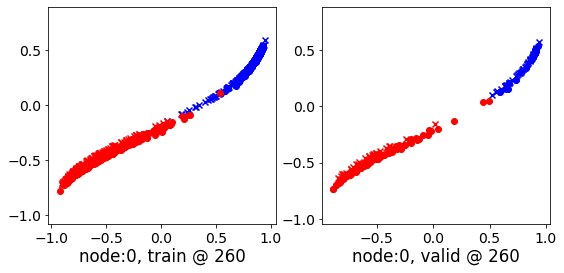

260 	 1 	 -0.08628173 	 -0.05153592 	 0.13234253 	 0.18034838 	 0.91171312 	 0.92503148


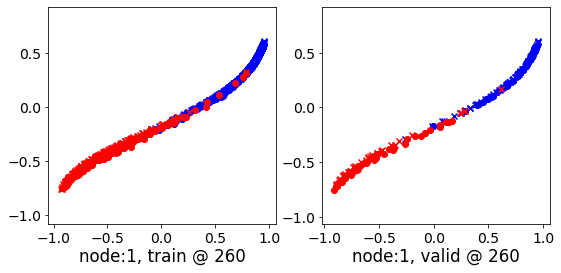

260 	 2 	 0.18654874 	 0.13387623 	 0.38431111 	 0.29596272 	 0.88970006 	 0.85523367


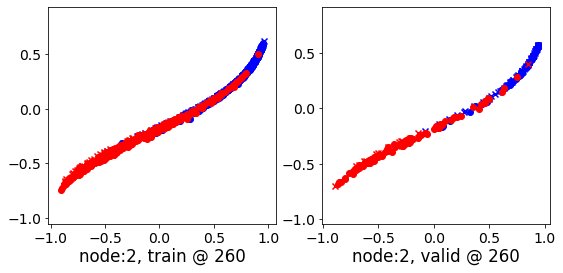

260 	 3 	 0.41045007 	 0.53491539 	 0.32991645 	 0.52943218 	 0.61303967 	 0.68766397


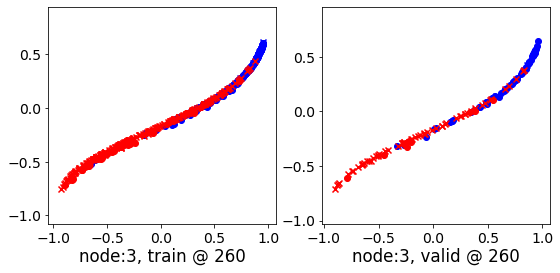

Aggregating on epoch: 262...
Aggregating on epoch: 264...
Aggregating on epoch: 266...
Aggregating on epoch: 268...
Aggregating on epoch: 270...
Aggregating on epoch: 272...
Aggregating on epoch: 274...
Aggregating on epoch: 276...
Aggregating on epoch: 278...
Aggregating on epoch: 280...
280 	 0 	 -0.04498573 	 -0.05623775 	 0.03208867 	 0.05307985 	 0.77001274 	 0.80246478


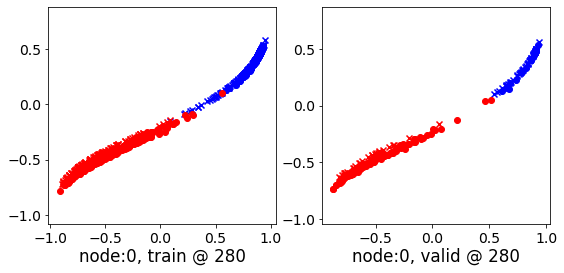

280 	 1 	 -0.08272222 	 -0.05160506 	 0.14749636 	 0.18043284 	 0.92288983 	 0.92518508


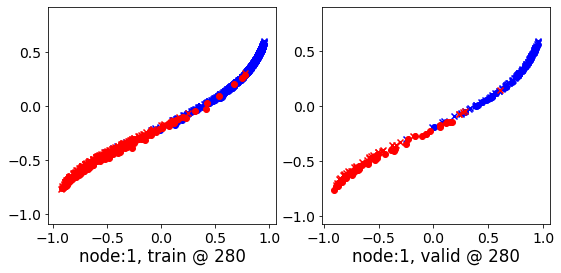

280 	 2 	 0.21287730 	 0.13365814 	 0.37032032 	 0.29606709 	 0.85418922 	 0.85555613


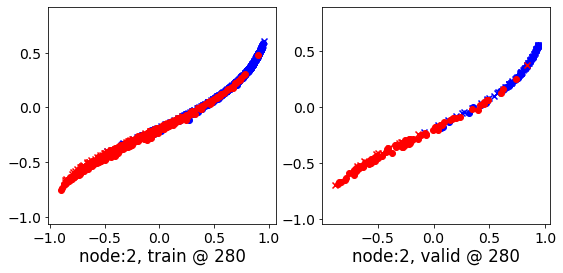

280 	 3 	 0.54096919 	 0.53288674 	 0.54359573 	 0.52690345 	 0.69867432 	 0.68716389


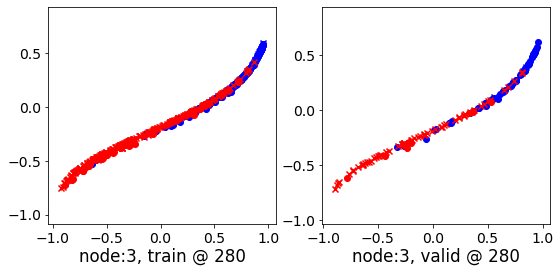

Aggregating on epoch: 282...
Aggregating on epoch: 284...
Aggregating on epoch: 286...
Aggregating on epoch: 288...
Aggregating on epoch: 290...
Aggregating on epoch: 292...
Aggregating on epoch: 294...
Aggregating on epoch: 296...
Aggregating on epoch: 298...
Aggregating on epoch: 300...
300 	 0 	 -0.03059885 	 -0.05798828 	 0.03415272 	 0.04881669 	 0.75927913 	 0.79995215


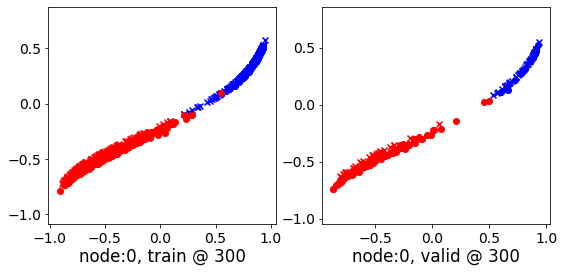

300 	 1 	 -0.03755972 	 -0.05303124 	 0.19224907 	 0.17886987 	 0.92292696 	 0.92504829


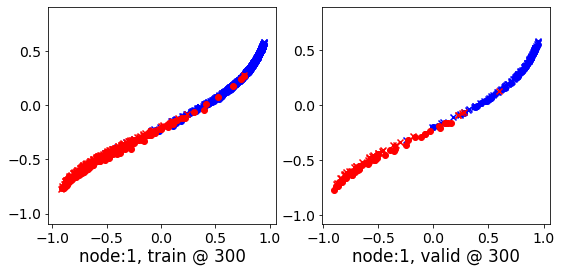

300 	 2 	 0.22167209 	 0.13207430 	 0.39981559 	 0.29436481 	 0.87782705 	 0.85543770


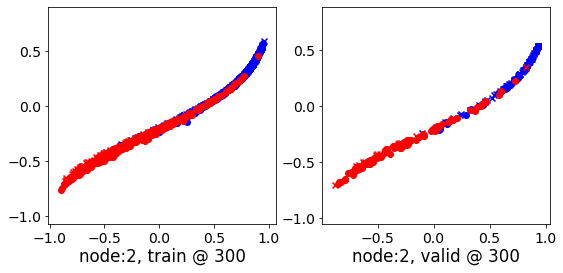

300 	 3 	 0.44472545 	 0.53103995 	 0.39687100 	 0.52544242 	 0.64606899 	 0.68754965


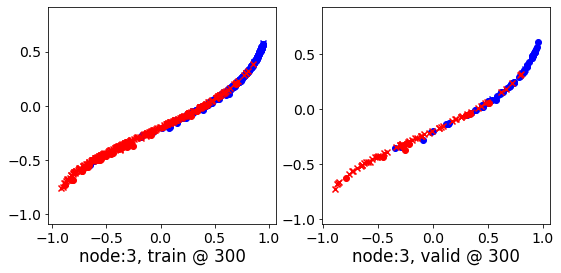

Aggregating on epoch: 302...
Aggregating on epoch: 304...
Aggregating on epoch: 306...
Aggregating on epoch: 308...
Aggregating on epoch: 310...
Aggregating on epoch: 312...
Aggregating on epoch: 314...
Aggregating on epoch: 316...
Aggregating on epoch: 318...
Aggregating on epoch: 320...
320 	 0 	 -0.04115593 	 -0.05849811 	 0.01863694 	 0.04685954 	 0.75418752 	 0.79850483


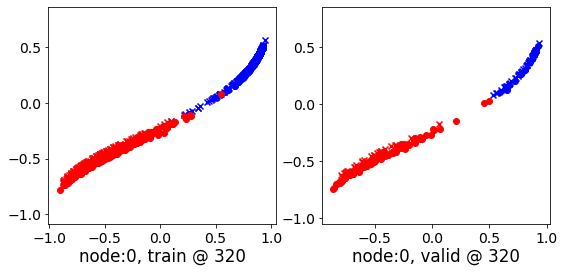

320 	 1 	 -0.08321798 	 -0.05389141 	 0.14108546 	 0.17781372 	 0.91793394 	 0.92485231


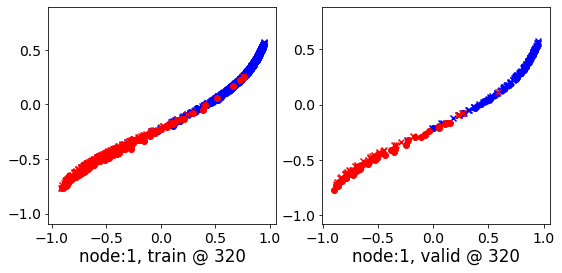

320 	 2 	 0.20839116 	 0.13257873 	 0.38397434 	 0.29438734 	 0.86853445 	 0.85495579


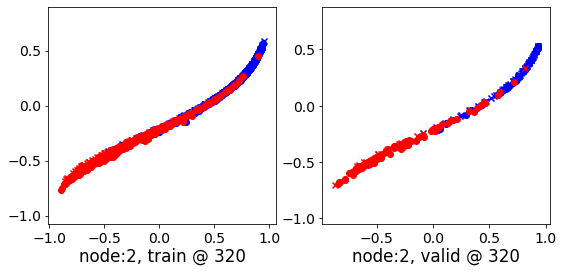

320 	 3 	 0.44238123 	 0.52992046 	 0.28415886 	 0.52181596 	 0.53567791 	 0.68504268


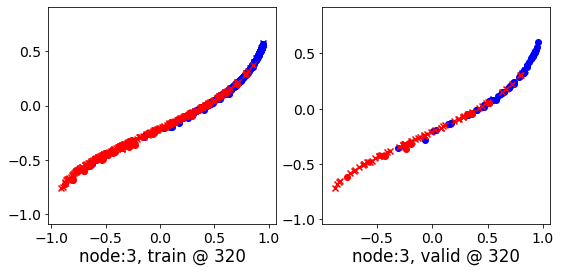

Aggregating on epoch: 322...
Aggregating on epoch: 324...
Aggregating on epoch: 326...
Aggregating on epoch: 328...
Aggregating on epoch: 330...
Aggregating on epoch: 332...
Aggregating on epoch: 334...
Aggregating on epoch: 336...
Aggregating on epoch: 338...
Aggregating on epoch: 340...
340 	 0 	 -0.00035982 	 -0.05696054 	 0.04594582 	 0.04836433 	 0.73979908 	 0.79847205


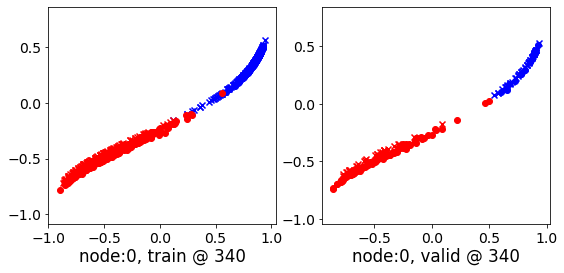

340 	 1 	 -0.06134006 	 -0.05244961 	 0.18559563 	 0.17879197 	 0.94010806 	 0.92438877


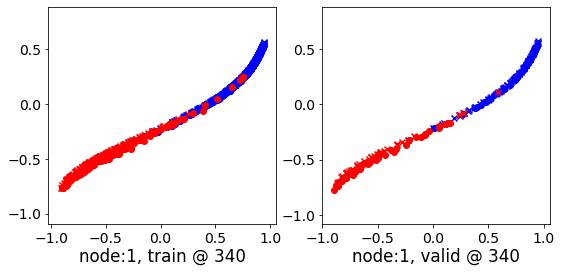

340 	 2 	 0.27426508 	 0.13243192 	 0.40062463 	 0.29361719 	 0.82531095 	 0.85433245


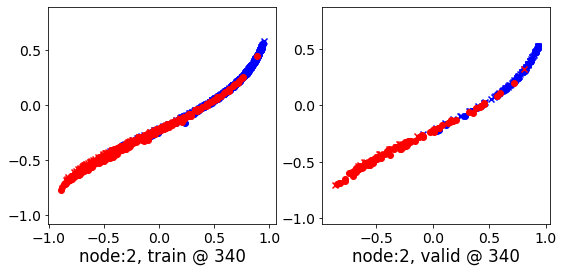

340 	 3 	 0.45763811 	 0.53122890 	 0.38827384 	 0.52317286 	 0.62589121 	 0.68509114


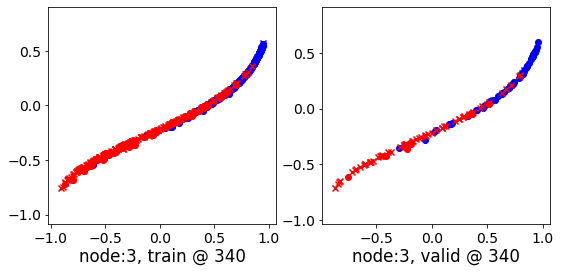

Aggregating on epoch: 342...
Aggregating on epoch: 344...
Aggregating on epoch: 346...
Aggregating on epoch: 348...
Aggregating on epoch: 350...
Aggregating on epoch: 352...
Aggregating on epoch: 354...
Aggregating on epoch: 356...
Aggregating on epoch: 358...
Aggregating on epoch: 360...
360 	 0 	 -0.11604920 	 -0.05623231 	 0.01031021 	 0.04846224 	 0.82051069 	 0.79784173


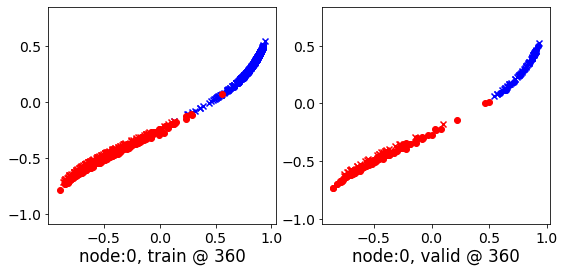

360 	 1 	 -0.07323556 	 -0.05390848 	 0.17400193 	 0.17720042 	 0.94153124 	 0.92425609


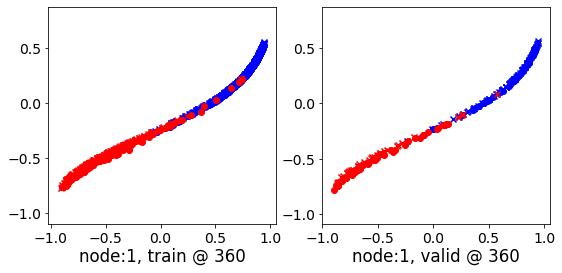

360 	 2 	 0.19486499 	 0.13248152 	 0.33647740 	 0.29316473 	 0.83838999 	 0.85383040


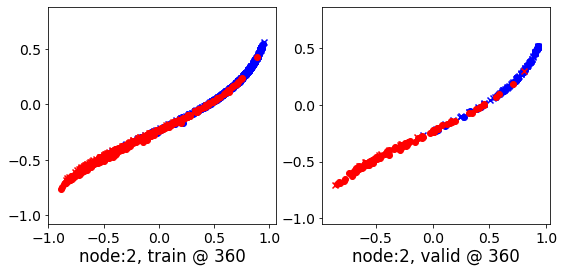

360 	 3 	 0.60234106 	 0.53126228 	 0.69924492 	 0.52498776 	 0.79178733 	 0.68687266


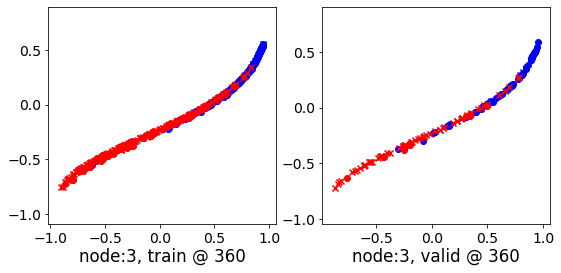

Aggregating on epoch: 362...
Aggregating on epoch: 364...
Aggregating on epoch: 366...
Aggregating on epoch: 368...
Aggregating on epoch: 370...
Aggregating on epoch: 372...
Aggregating on epoch: 374...
Aggregating on epoch: 376...
Aggregating on epoch: 378...
Aggregating on epoch: 380...
380 	 0 	 -0.06183510 	 -0.05502131 	 0.01909523 	 0.04835299 	 0.77369291 	 0.79652148


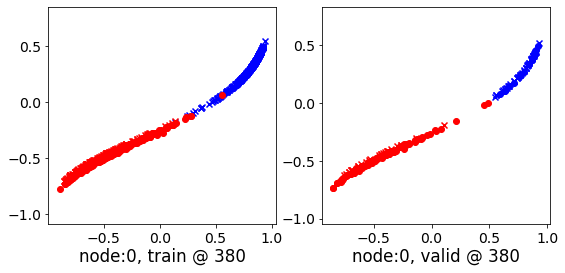

380 	 1 	 -0.07770605 	 -0.05535518 	 0.14214016 	 0.17542090 	 0.91275895 	 0.92392325


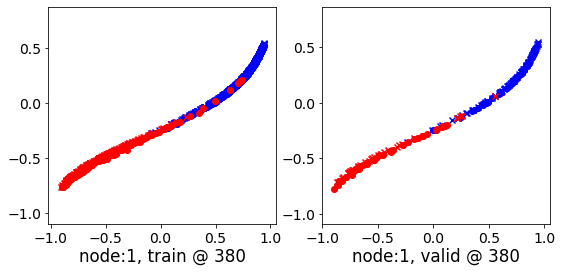

380 	 2 	 0.23232174 	 0.13240224 	 0.38661596 	 0.29261416 	 0.84751815 	 0.85335910


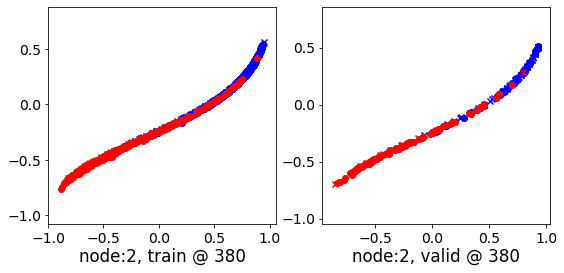

380 	 3 	 0.32959291 	 0.53057337 	 0.39116761 	 0.52244568 	 0.75504810 	 0.68501949


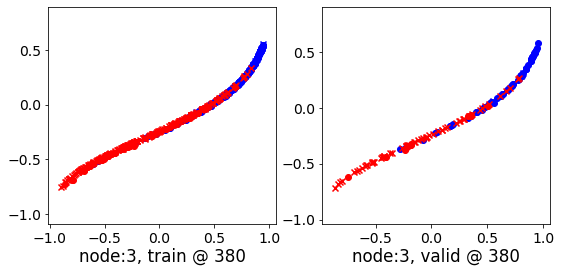

Aggregating on epoch: 382...
Aggregating on epoch: 384...
Aggregating on epoch: 386...
Aggregating on epoch: 388...
Aggregating on epoch: 390...
Aggregating on epoch: 392...
Aggregating on epoch: 394...
Aggregating on epoch: 396...
Aggregating on epoch: 398...
Aggregating on epoch: 400...
400 	 0 	 -0.02569081 	 -0.05371462 	 0.03587840 	 0.04921122 	 0.75404775 	 0.79607302


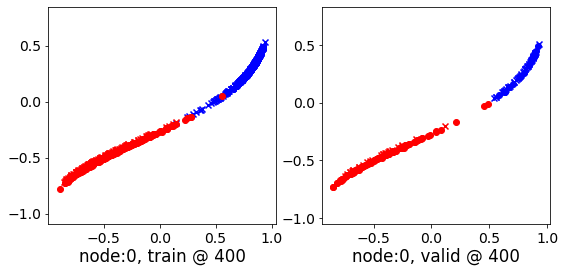

400 	 1 	 -0.07447878 	 -0.05563118 	 0.16856349 	 0.17479275 	 0.93519861 	 0.92357111


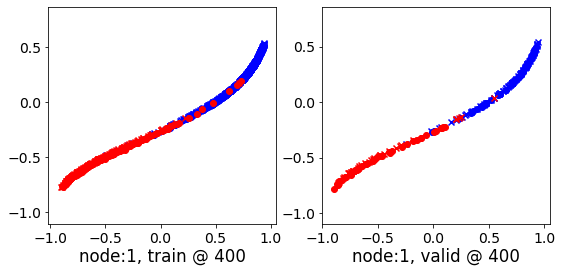

400 	 2 	 0.24265623 	 0.13315642 	 0.39234197 	 0.29287493 	 0.84310001 	 0.85286570


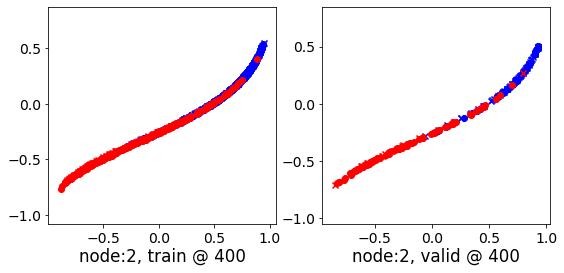

400 	 3 	 0.36004576 	 0.52941895 	 0.43053973 	 0.52156687 	 0.76402789 	 0.68529510


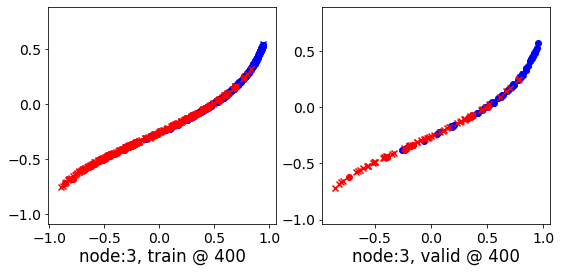

Aggregating on epoch: 402...
Aggregating on epoch: 404...
Aggregating on epoch: 406...
Aggregating on epoch: 408...
Aggregating on epoch: 410...
Aggregating on epoch: 412...
Aggregating on epoch: 414...
Aggregating on epoch: 416...
Aggregating on epoch: 418...
Aggregating on epoch: 420...
420 	 0 	 -0.05941405 	 -0.05233883 	 0.04546054 	 0.05148615 	 0.79807776 	 0.79697216


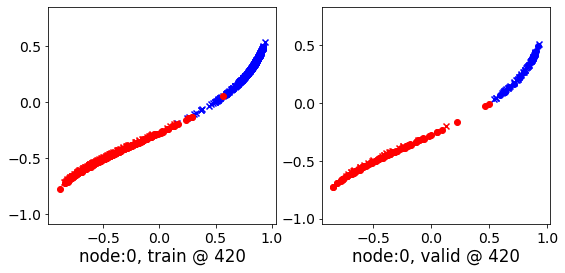

420 	 1 	 -0.07061523 	 -0.05447276 	 0.15444106 	 0.17599116 	 0.92123693 	 0.92361110


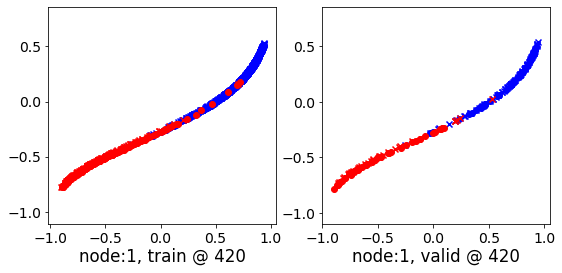

420 	 2 	 0.19677365 	 0.13374129 	 0.38408774 	 0.29388383 	 0.88473260 	 0.85328972


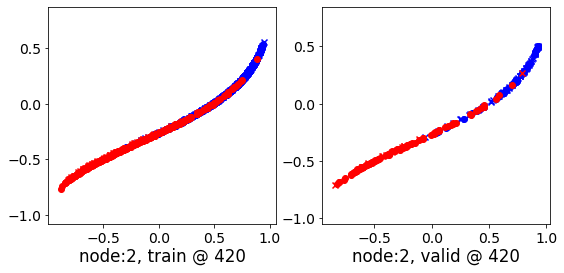

420 	 3 	 0.55308932 	 0.53075594 	 0.61590338 	 0.52285999 	 0.75647724 	 0.68525124


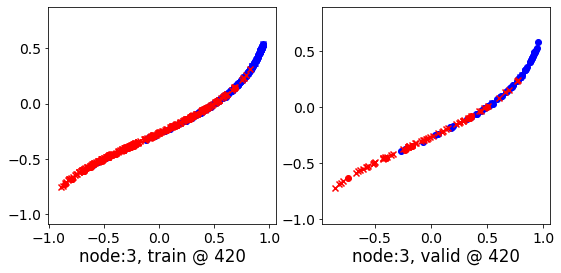

Aggregating on epoch: 422...
Aggregating on epoch: 424...
Aggregating on epoch: 426...
Aggregating on epoch: 428...
Aggregating on epoch: 430...
Aggregating on epoch: 432...
Aggregating on epoch: 434...
Aggregating on epoch: 436...
Aggregating on epoch: 438...
Aggregating on epoch: 440...
440 	 0 	 -0.09055053 	 -0.05341201 	 0.03915571 	 0.04973914 	 0.82334423 	 0.79629833


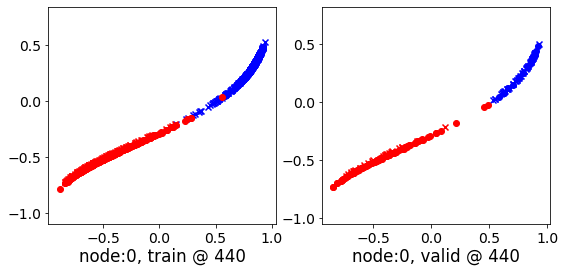

440 	 1 	 -0.08392704 	 -0.05507469 	 0.11792798 	 0.17490470 	 0.90067220 	 0.92312658


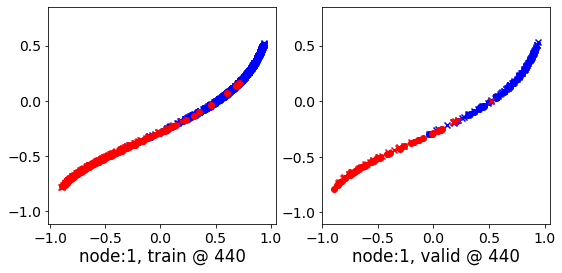

440 	 2 	 0.20804927 	 0.13343987 	 0.35501164 	 0.29323158 	 0.83891183 	 0.85293889


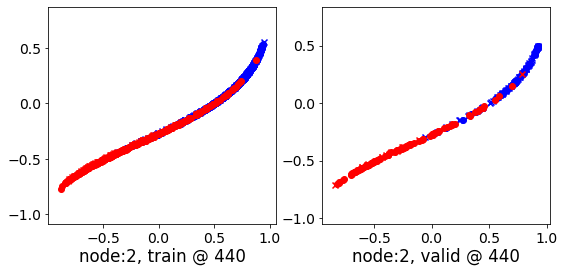

440 	 3 	 0.40598875 	 0.53131759 	 0.37305963 	 0.52232444 	 0.66043305 	 0.68415403


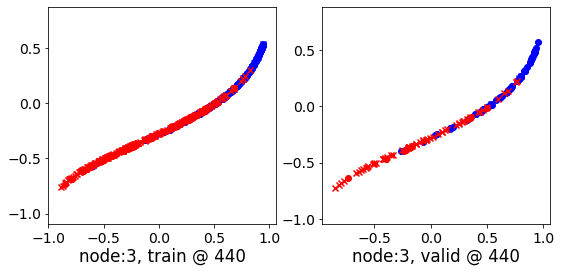

Aggregating on epoch: 442...
Aggregating on epoch: 444...
Aggregating on epoch: 446...
Aggregating on epoch: 448...
Aggregating on epoch: 450...
Aggregating on epoch: 452...
Aggregating on epoch: 454...
Aggregating on epoch: 456...
Aggregating on epoch: 458...
Aggregating on epoch: 460...
460 	 0 	 -0.01219875 	 -0.05128476 	 0.01706974 	 0.05235412 	 0.72308415 	 0.79678607


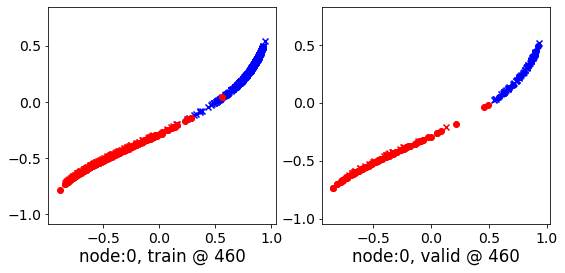

460 	 1 	 -0.04244462 	 -0.05046745 	 0.17426726 	 0.17859833 	 0.92353243 	 0.92221296


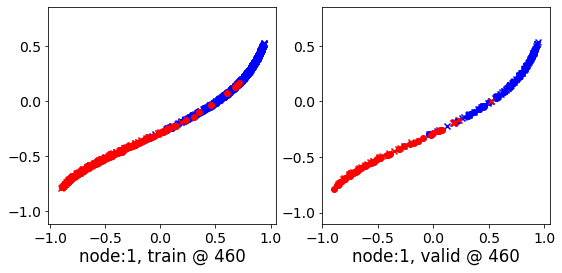

460 	 2 	 0.24161655 	 0.13389963 	 0.38376483 	 0.29378229 	 0.83951128 	 0.85302985


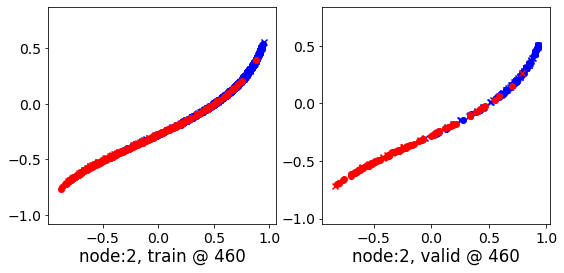

460 	 3 	 0.40445465 	 0.53316724 	 0.56483567 	 0.52664495 	 0.85332781 	 0.68662488


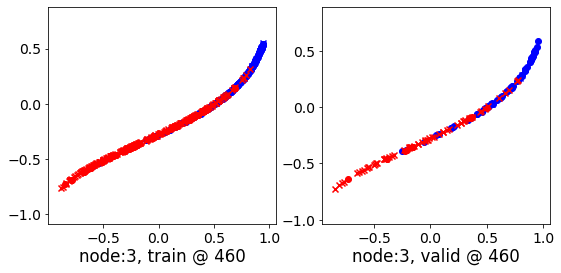

Aggregating on epoch: 462...
Aggregating on epoch: 464...
Aggregating on epoch: 466...
Aggregating on epoch: 468...
Aggregating on epoch: 470...
Aggregating on epoch: 472...
Aggregating on epoch: 474...
Aggregating on epoch: 476...
Aggregating on epoch: 478...
Aggregating on epoch: 480...
480 	 0 	 -0.04946990 	 -0.05265259 	 0.03173513 	 0.05143822 	 0.77453369 	 0.79723799


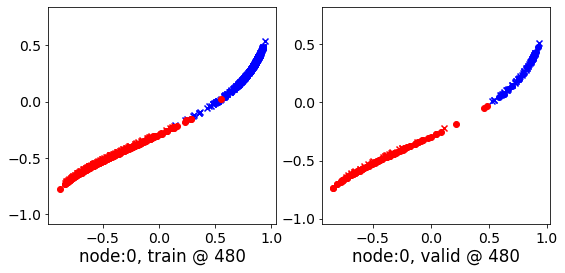

480 	 1 	 -0.06096053 	 -0.05305308 	 0.16093419 	 0.17636055 	 0.92332733 	 0.92256081


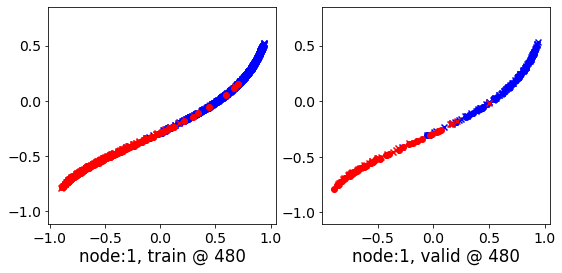

480 	 2 	 0.18110117 	 0.13370109 	 0.37845099 	 0.29414010 	 0.89266831 	 0.85358620


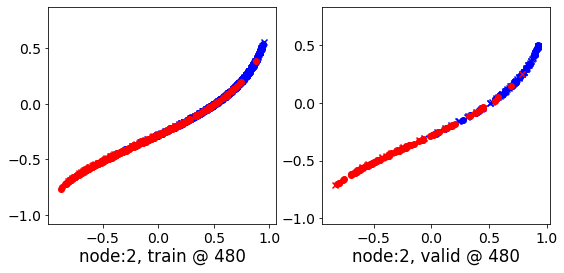

480 	 3 	 0.58735281 	 0.52873737 	 0.72577751 	 0.52001709 	 0.83319956 	 0.68442690


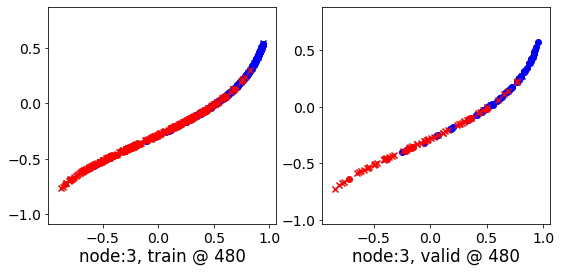

Aggregating on epoch: 482...
Aggregating on epoch: 484...
Aggregating on epoch: 486...
Aggregating on epoch: 488...
Aggregating on epoch: 490...
Aggregating on epoch: 492...
Aggregating on epoch: 494...
Aggregating on epoch: 496...
Aggregating on epoch: 498...
Aggregating on epoch: 500...
500 	 0 	 -0.14887300 	 -0.05155031 	 0.01274990 	 0.05236520 	 0.85483700 	 0.79706270


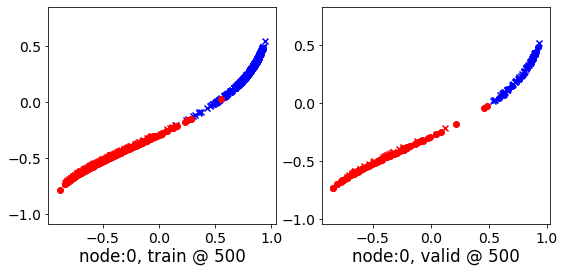

500 	 1 	 -0.02282839 	 -0.04997662 	 0.19702441 	 0.17873618 	 0.91729796 	 0.92185998


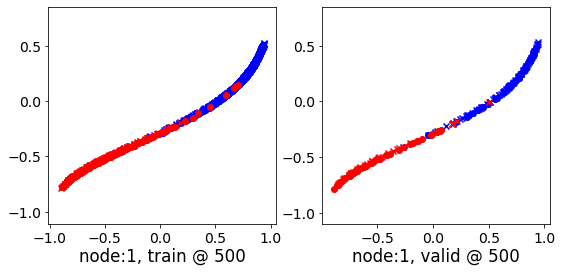

500 	 2 	 0.21168786 	 0.13401094 	 0.40367618 	 0.29435584 	 0.88443893 	 0.85349208


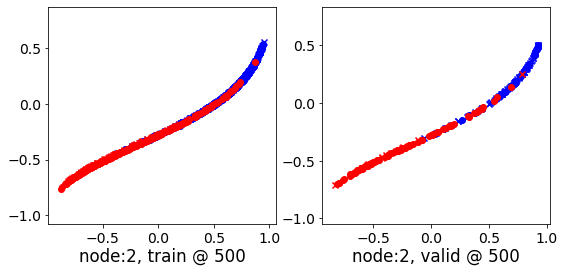

500 	 3 	 0.44449064 	 0.53007179 	 0.36902371 	 0.52319437 	 0.61800879 	 0.68626976


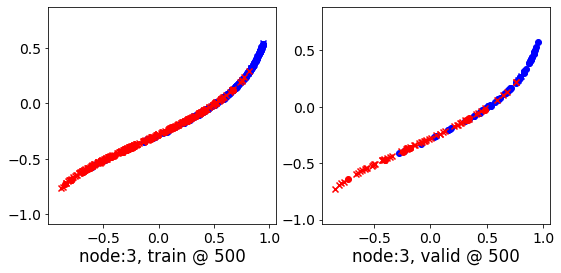

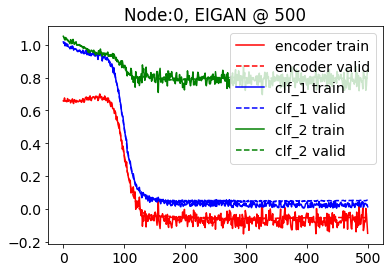

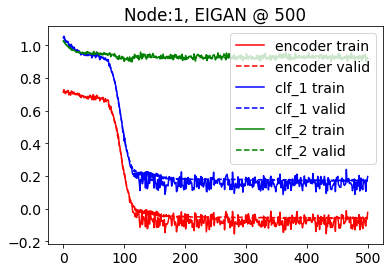

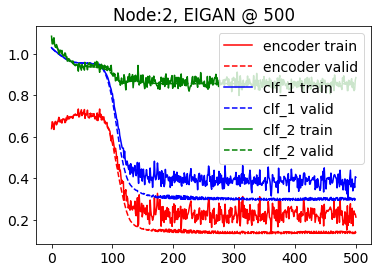

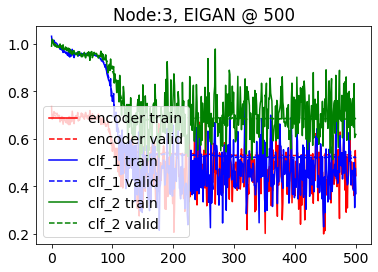

  0%|          | 1/501 [00:00<00:54,  9.13it/s]

epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.77574468 	 0.78614509 	 1.09784377 	 1.10682988 	 1.01581156 	 1.01383197


100%|██████████| 501/501 [01:11<00:00,  6.97it/s]


500 	 -0.08045506 	 0.02318433 	 0.17930052 	 0.26595536 	 0.95327717 	 0.93591821


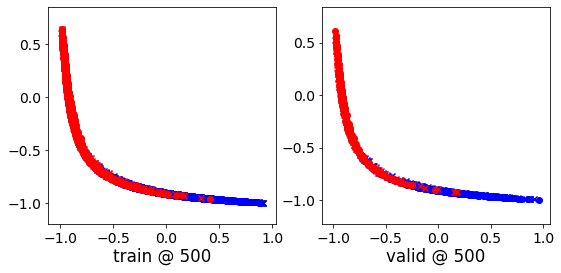

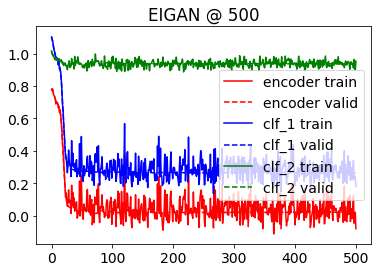

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.083891 	 1.083888 	 0.5124
200 	 0.541925 	 0.533363 	 0.9117
400 	 0.287807 	 0.271909 	 0.9229
600 	 0.280609 	 0.262692 	 0.9241
800 	 0.280275 	 0.262078 	 0.9241
1000 	 0.280157 	 0.261909 	 0.9229
Accuracy: 0.9228855721393034
Error Rate: 0.07711442786069651
F1 Score: 0.918848167539267
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9253731343283582
Error Rate: 0.07462686567164178
F1 Score: 0.9204244031830239
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9241293532338308
Error Rate: 0.07

@node 2: tensor sizes => torch.Size([676, 2]) (170, 2) torch.Size([676, 2]) (170, 2) torch.Size([676, 2]) (170, 2)
@node 3: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(555, 2) (139, 2) (555, 1) (139, 1) (555, 1) (139, 1)
@node 3: class weights => w1, w2 [array([1.22693267, 5.40659341]), array([1.13559322, 8.375     ]), array([2.08641975, 1.92045455]), array([2.26530612, 1.79032258])] [array([2.87719298, 1.53271028]), array([2.61038961, 1.62096774]), array([2.42293907, 1.70277078]), array([1.63235294, 2.58139535])]
@node 3: tensor sizes => torch.Size([555, 2]) (139, 2) torch.Size([555, 2]) (139, 2) torch.Size([555, 2]) (139, 2)
@node 4: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(515, 2) (129, 2) (515, 1) (129, 1) (515, 1) (129, 1)
@node 4: class weights => w1, w2 [array([1.22693267, 5.40659341]), array([1.13559322, 8.375     ]), array([2.08641975, 1.92045455]), array([2.26530612, 1.79032258]), array([2.06      , 1.94339623])] [array([2.87719298, 1.53

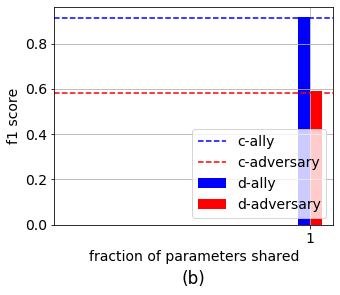

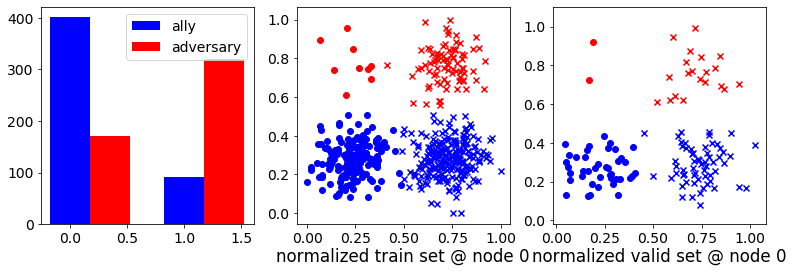

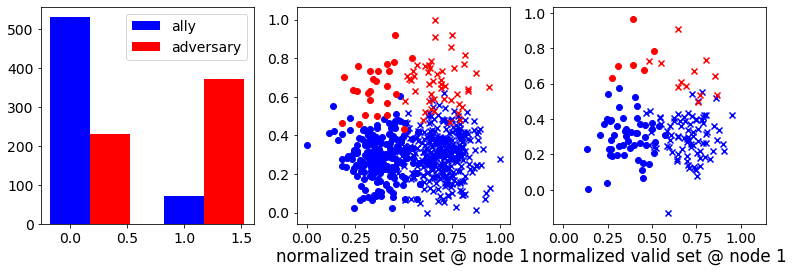

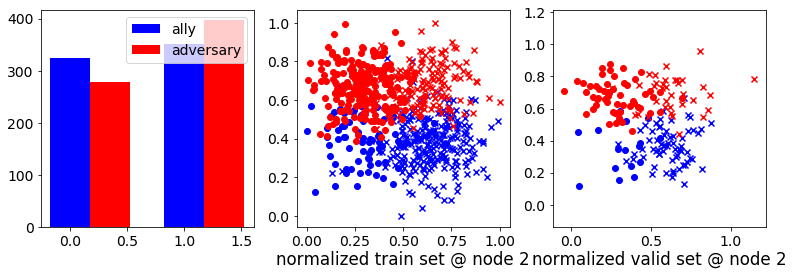

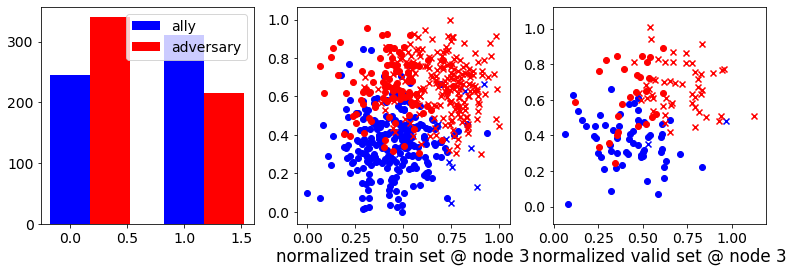

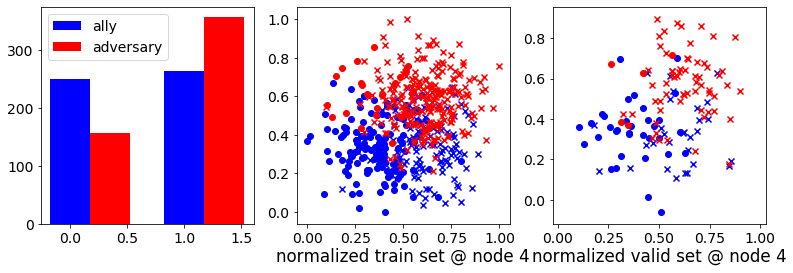

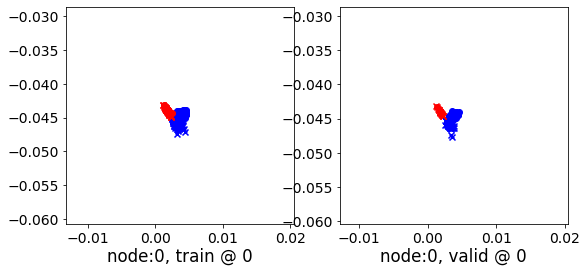

0 	 1 	 0.66195464 	 0.71105897 	 1.01242590 	 1.05792844 	 1.04374778 	 1.04001665


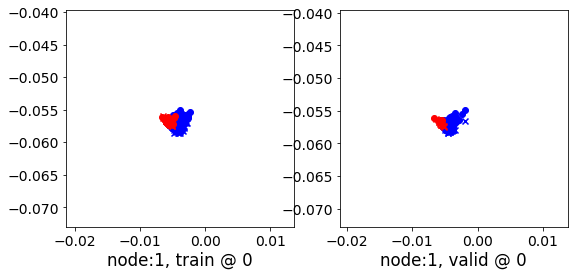

0 	 2 	 0.72754323 	 0.72629464 	 1.07086110 	 1.07349908 	 1.03663445 	 1.04035163


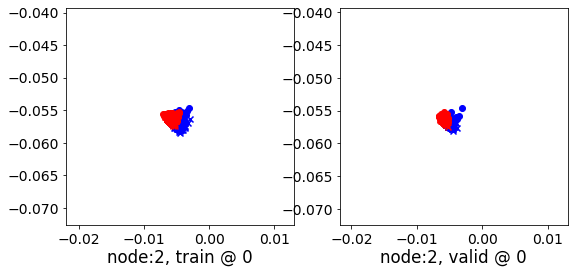

0 	 3 	 0.79692918 	 0.75165308 	 1.09520829 	 1.06259120 	 0.99162507 	 1.00408530


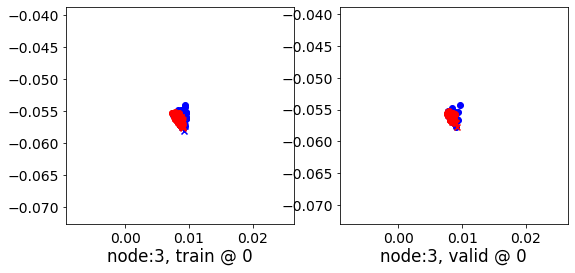

0 	 4 	 0.63534689 	 0.66412866 	 1.01483226 	 1.02369201 	 1.07271528 	 1.05271053


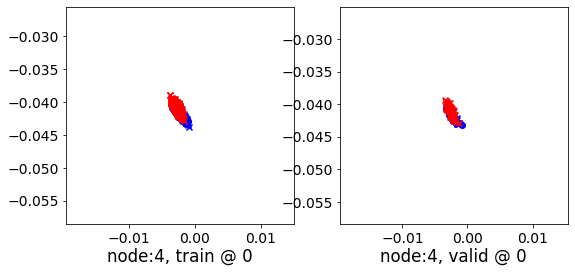

Aggregating on epoch: 2...
Aggregating on epoch: 4...
Aggregating on epoch: 6...
Aggregating on epoch: 8...
Aggregating on epoch: 10...
Aggregating on epoch: 12...
Aggregating on epoch: 14...
Aggregating on epoch: 16...
Aggregating on epoch: 18...
Aggregating on epoch: 20...
20 	 0 	 0.66502500 	 0.65476292 	 0.99412221 	 0.98338860 	 1.02230966 	 1.02177286


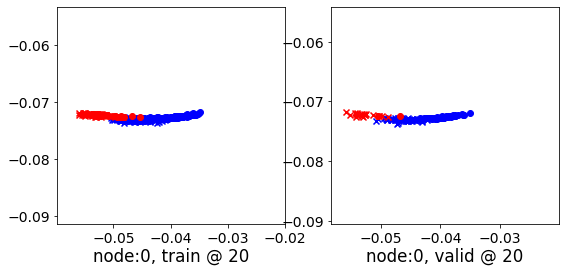

20 	 1 	 0.75125217 	 0.70114803 	 1.03592360 	 1.00558448 	 0.97794300 	 0.99758363


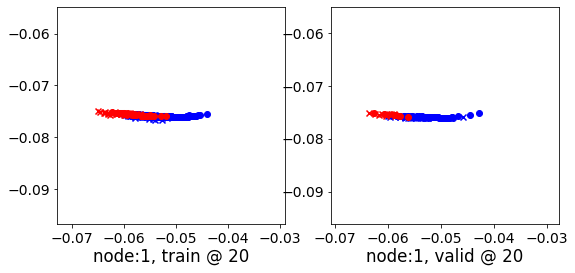

20 	 2 	 0.72459745 	 0.72739846 	 1.02080894 	 1.01971471 	 0.98946971 	 0.98546344


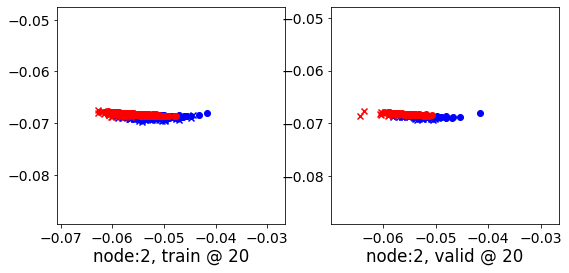

20 	 3 	 0.75414544 	 0.74271977 	 1.00332558 	 1.00084746 	 0.94234836 	 0.95127487


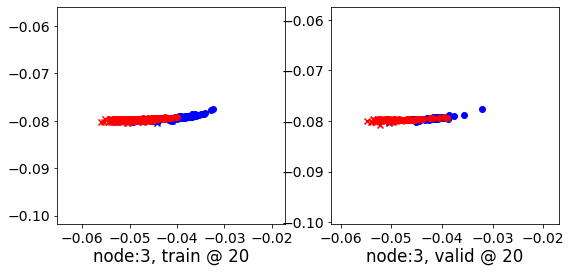

20 	 4 	 0.62823749 	 0.65892828 	 0.96694106 	 0.97744823 	 1.03186297 	 1.01166713


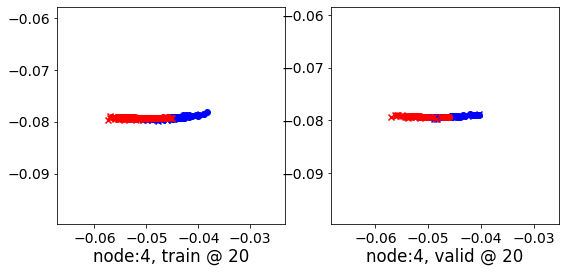

Aggregating on epoch: 22...
Aggregating on epoch: 24...
Aggregating on epoch: 26...
Aggregating on epoch: 28...
Aggregating on epoch: 30...
Aggregating on epoch: 32...
Aggregating on epoch: 34...
Aggregating on epoch: 36...
Aggregating on epoch: 38...
Aggregating on epoch: 40...
40 	 0 	 0.67650980 	 0.66631025 	 0.96133685 	 0.95122671 	 0.97806835 	 0.97806364


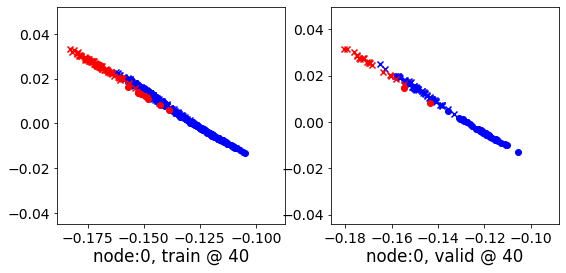

40 	 1 	 0.67321551 	 0.68356049 	 0.95656538 	 0.95110750 	 0.97670877 	 0.96069419


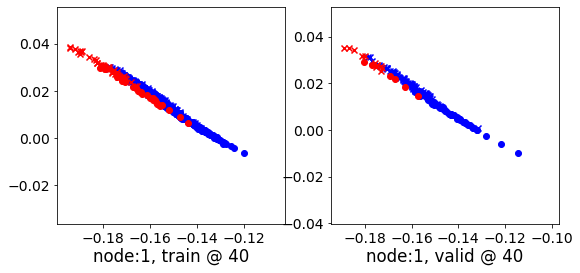

40 	 2 	 0.70997858 	 0.70817643 	 0.97391099 	 0.97262484 	 0.95735407 	 0.95759559


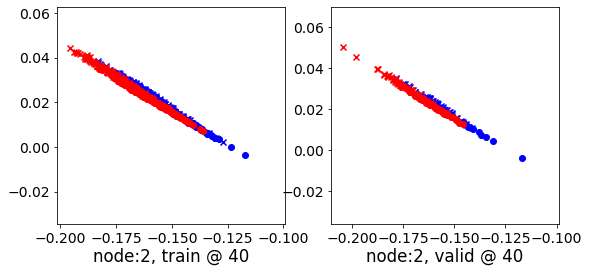

40 	 3 	 0.67689246 	 0.71036017 	 0.94479084 	 0.96034163 	 0.96111202 	 0.94312865


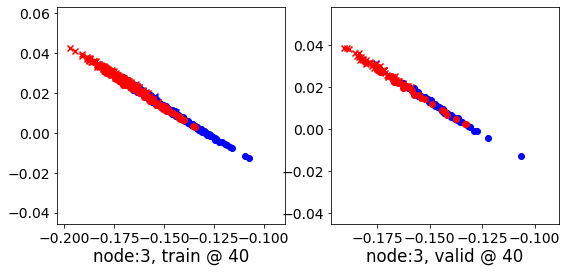

40 	 4 	 0.42327714 	 0.67091084 	 0.94452083 	 0.96070391 	 1.21450818 	 0.98294026


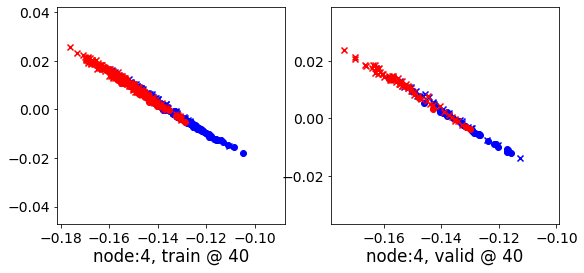

Aggregating on epoch: 42...
Aggregating on epoch: 44...
Aggregating on epoch: 46...
Aggregating on epoch: 48...
Aggregating on epoch: 50...
Aggregating on epoch: 52...
Aggregating on epoch: 54...
Aggregating on epoch: 56...
Aggregating on epoch: 58...
Aggregating on epoch: 60...
60 	 0 	 0.67377228 	 0.66288227 	 0.92907917 	 0.91919661 	 0.94864351 	 0.94946152


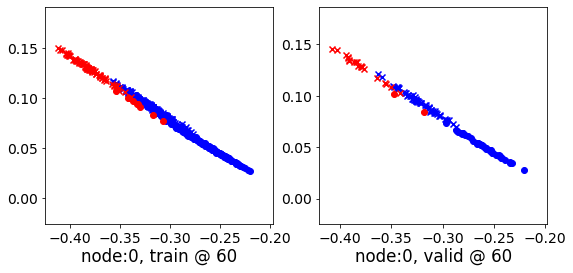

60 	 1 	 0.51131743 	 0.63992757 	 0.72909743 	 0.88989329 	 0.91127777 	 0.94311291


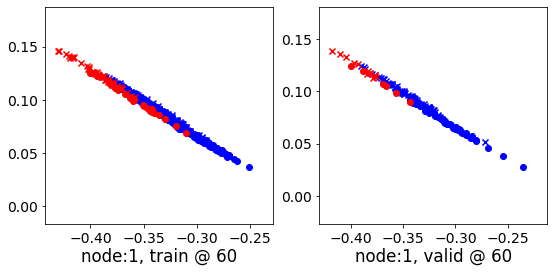

60 	 2 	 0.69773823 	 0.69728535 	 0.95241582 	 0.95325392 	 0.94788915 	 0.94911575


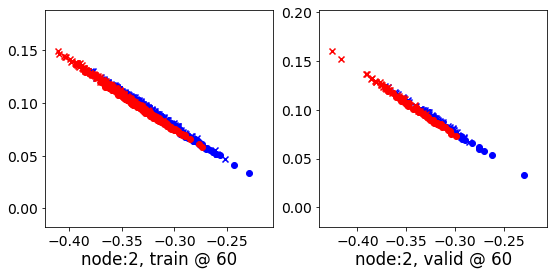

60 	 3 	 0.76316571 	 0.70161349 	 0.97904426 	 0.94793308 	 0.90919638 	 0.93946677


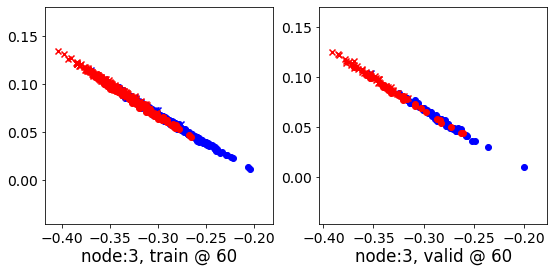

60 	 4 	 0.45796514 	 0.69216740 	 0.94782561 	 0.95435411 	 1.18319988 	 0.95533389


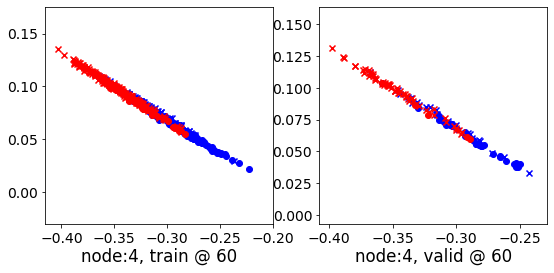

Aggregating on epoch: 62...
Aggregating on epoch: 64...
Aggregating on epoch: 66...
Aggregating on epoch: 68...
Aggregating on epoch: 70...
Aggregating on epoch: 72...
Aggregating on epoch: 74...
Aggregating on epoch: 76...
Aggregating on epoch: 78...
Aggregating on epoch: 80...
80 	 0 	 0.65391201 	 0.64168006 	 0.89921188 	 0.88855976 	 0.93869698 	 0.94002688


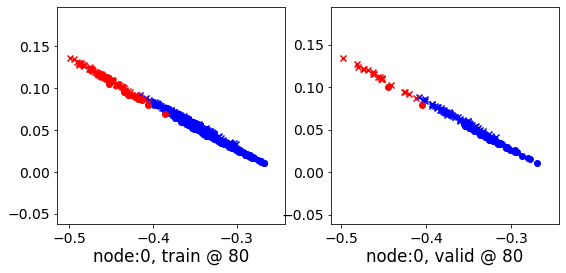

80 	 1 	 0.66341710 	 0.60536015 	 0.92100537 	 0.85351837 	 0.95106149 	 0.94130540


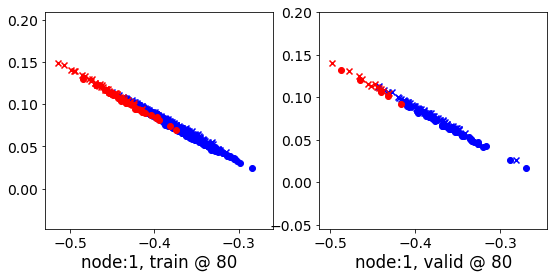

80 	 2 	 0.70851594 	 0.69327283 	 0.95347995 	 0.94927442 	 0.93838459 	 0.94914877


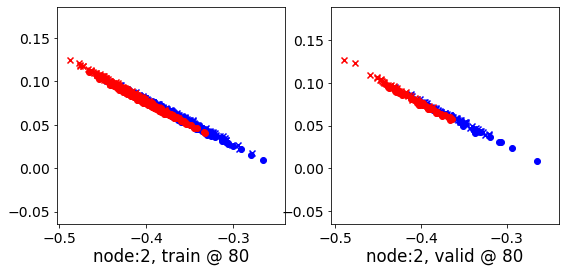

80 	 3 	 0.79508054 	 0.70214570 	 0.97446793 	 0.94201159 	 0.87260205 	 0.93301308


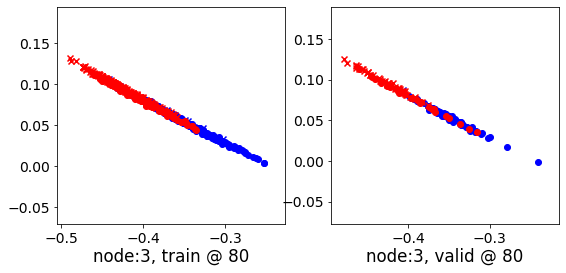

80 	 4 	 0.91572392 	 0.71479374 	 0.92593449 	 0.95242935 	 0.70369005 	 0.93078279


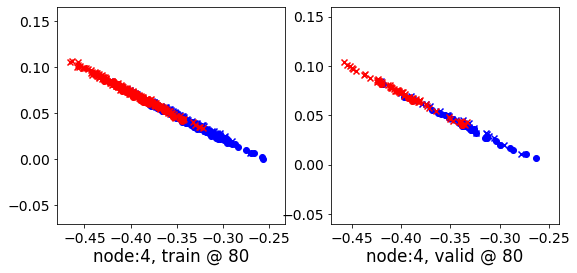

Aggregating on epoch: 82...
Aggregating on epoch: 84...
Aggregating on epoch: 86...
Aggregating on epoch: 88...
Aggregating on epoch: 90...
Aggregating on epoch: 92...
Aggregating on epoch: 94...
Aggregating on epoch: 96...
Aggregating on epoch: 98...
Aggregating on epoch: 100...
100 	 0 	 0.62735158 	 0.61402816 	 0.87212956 	 0.86096823 	 0.93889672 	 0.94008726


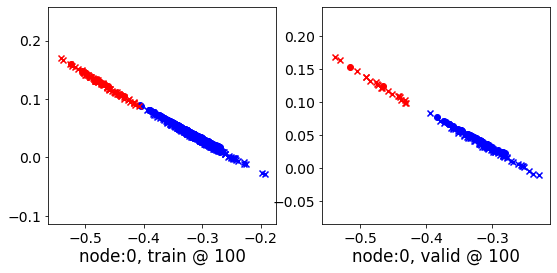

100 	 1 	 0.81087399 	 0.59328753 	 1.05910230 	 0.84441382 	 0.94165653 	 0.94427347


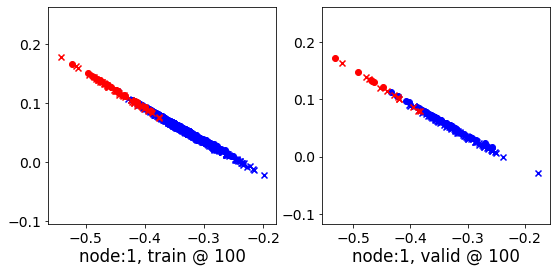

100 	 2 	 0.67605495 	 0.66715157 	 0.91850001 	 0.92605448 	 0.93694395 	 0.95205009


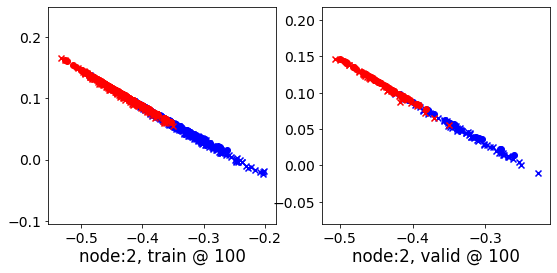

100 	 3 	 0.76781845 	 0.69371384 	 0.95645958 	 0.93019074 	 0.88185775 	 0.92962408


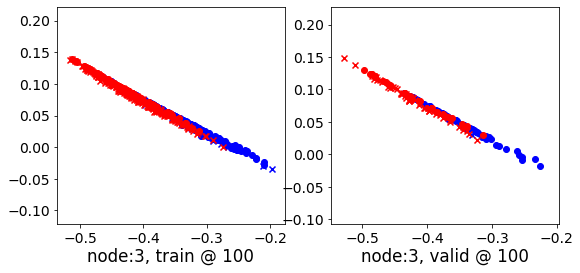

100 	 4 	 1.02273548 	 0.72209853 	 0.93358517 	 0.95205790 	 0.60547525 	 0.92310655


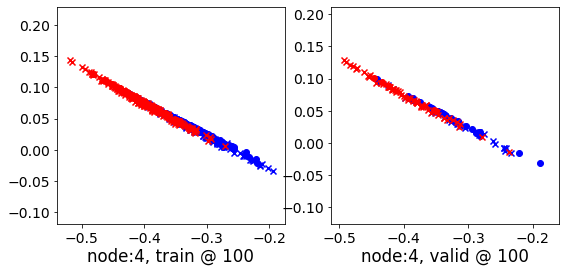

Aggregating on epoch: 102...
Aggregating on epoch: 104...
Aggregating on epoch: 106...
Aggregating on epoch: 108...
Aggregating on epoch: 110...
Aggregating on epoch: 112...
Aggregating on epoch: 114...
Aggregating on epoch: 116...
Aggregating on epoch: 118...
Aggregating on epoch: 120...
120 	 0 	 0.58904421 	 0.57511634 	 0.83340788 	 0.82198930 	 0.93907100 	 0.94002014


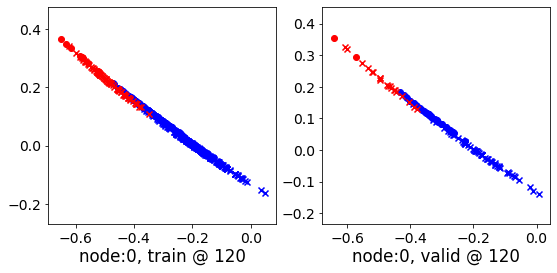

120 	 1 	 0.55038714 	 0.58750886 	 0.80754912 	 0.83606428 	 0.95077896 	 0.94170260


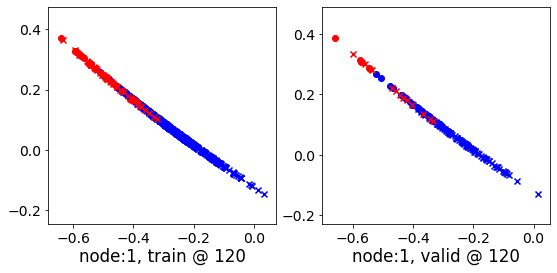

120 	 2 	 0.56582242 	 0.56510949 	 0.80248594 	 0.80663759 	 0.93429309 	 0.93467528


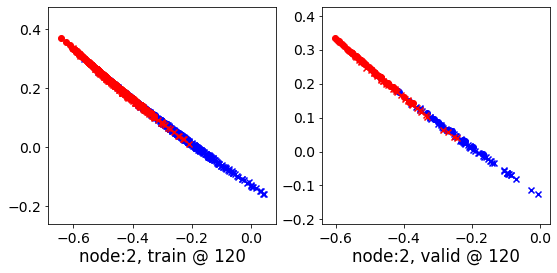

120 	 3 	 0.57402074 	 0.65777439 	 0.85577393 	 0.89991283 	 0.97767019 	 0.93528563


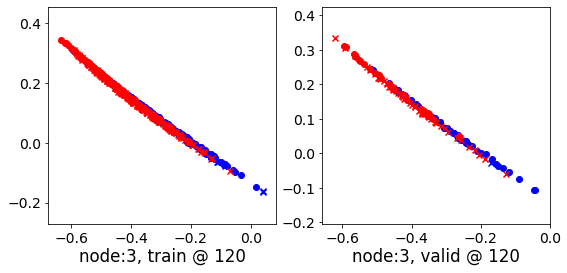

120 	 4 	 0.67122680 	 0.71472156 	 0.91031241 	 0.94720942 	 0.93348062 	 0.92563504


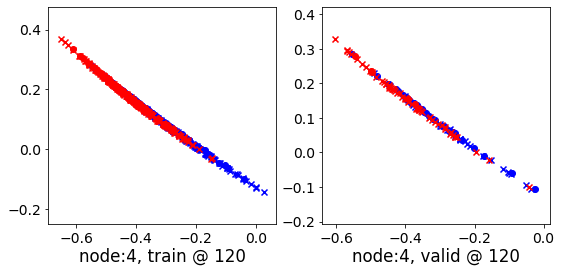

Aggregating on epoch: 122...
Aggregating on epoch: 124...
Aggregating on epoch: 126...
Aggregating on epoch: 128...
Aggregating on epoch: 130...
Aggregating on epoch: 132...
Aggregating on epoch: 134...
Aggregating on epoch: 136...
Aggregating on epoch: 138...
Aggregating on epoch: 140...
140 	 0 	 0.48779762 	 0.46904355 	 0.72344130 	 0.71039915 	 0.93290502 	 0.93450278


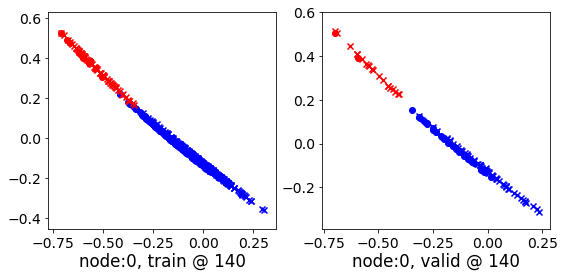

140 	 1 	 0.42271572 	 0.53719097 	 0.69142318 	 0.77198666 	 0.96317452 	 0.92794287


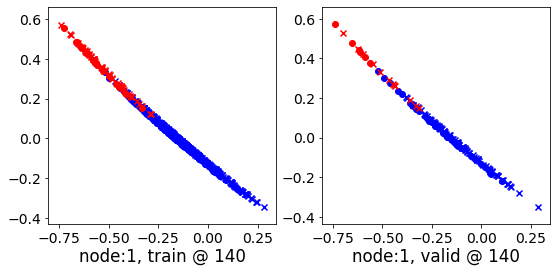

140 	 2 	 0.45427668 	 0.41256642 	 0.58658385 	 0.56273311 	 0.82930326 	 0.84331387


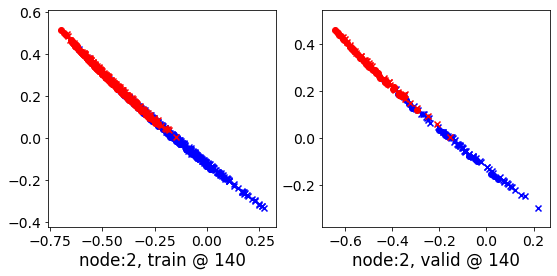

140 	 3 	 0.45922279 	 0.56286216 	 0.70396674 	 0.76903081 	 0.93967474 	 0.89931583


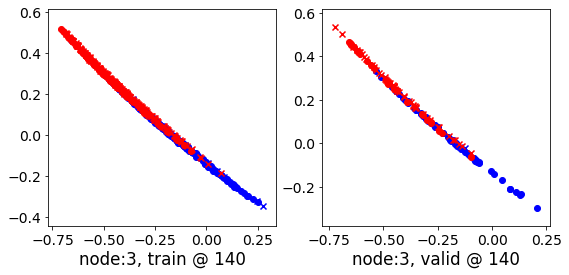

140 	 4 	 0.63040930 	 0.67925298 	 0.85612011 	 0.91064519 	 0.92086017 	 0.92453939


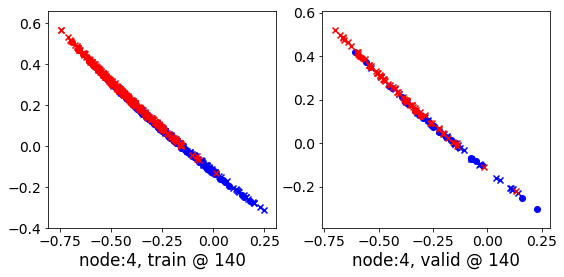

Aggregating on epoch: 142...
Aggregating on epoch: 144...
Aggregating on epoch: 146...
Aggregating on epoch: 148...
Aggregating on epoch: 150...
Aggregating on epoch: 152...
Aggregating on epoch: 154...
Aggregating on epoch: 156...
Aggregating on epoch: 158...
Aggregating on epoch: 160...
160 	 0 	 0.26117218 	 0.23426694 	 0.49920407 	 0.48530108 	 0.93979675 	 0.94418132


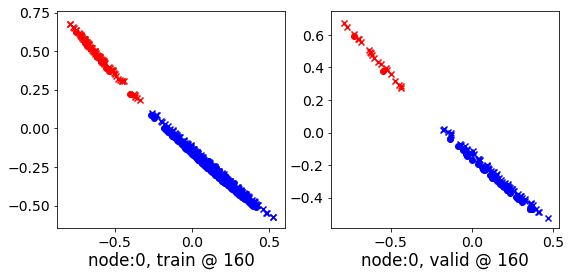

160 	 1 	 0.26831251 	 0.30841303 	 0.50765234 	 0.56442541 	 0.93592215 	 0.94915956


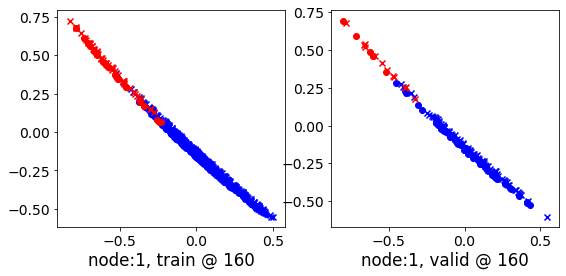

160 	 2 	 0.21395937 	 0.17481151 	 0.39211458 	 0.34826145 	 0.87769163 	 0.86659712


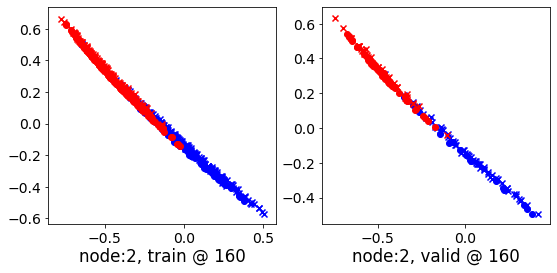

160 	 3 	 0.44934070 	 0.46711200 	 0.56499052 	 0.55028331 	 0.80837601 	 0.77631849


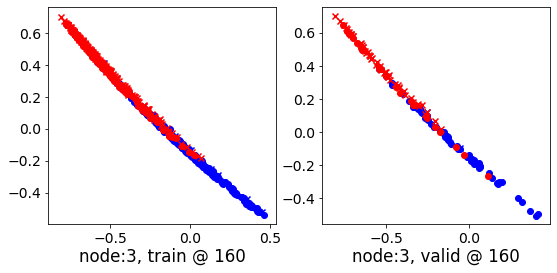

160 	 4 	 0.71890110 	 0.60004050 	 0.60026526 	 0.81051815 	 0.58277631 	 0.90362483


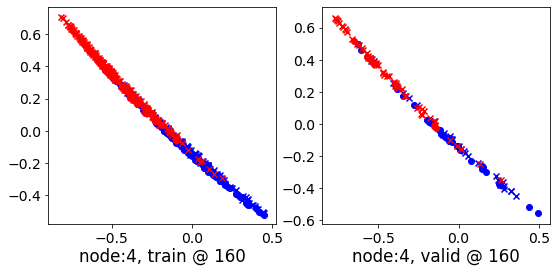

Aggregating on epoch: 162...
Aggregating on epoch: 164...
Aggregating on epoch: 166...
Aggregating on epoch: 168...
Aggregating on epoch: 170...
Aggregating on epoch: 172...
Aggregating on epoch: 174...
Aggregating on epoch: 176...
Aggregating on epoch: 178...
Aggregating on epoch: 180...
180 	 0 	 0.05807635 	 0.03633916 	 0.28034228 	 0.26870424 	 0.92403477 	 0.92551225


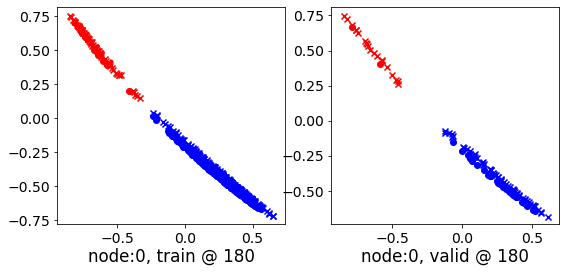

180 	 1 	 0.02025494 	 0.02992609 	 0.25534490 	 0.28163901 	 0.92126274 	 0.94486010


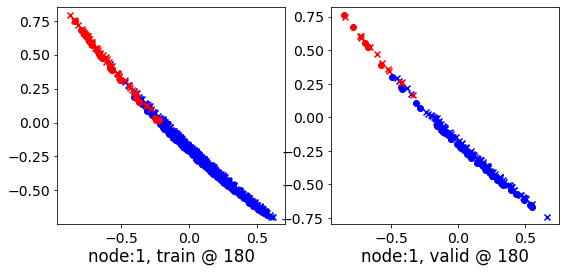

180 	 2 	 0.26527289 	 0.10748005 	 0.37733176 	 0.27758884 	 0.84216797 	 0.86325598


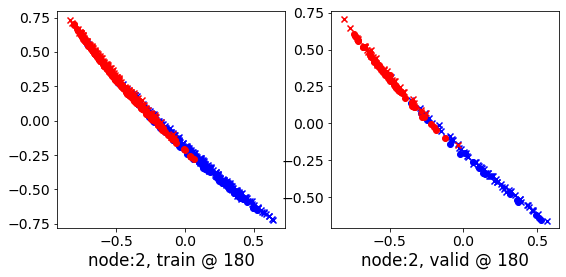

180 	 3 	 0.46931601 	 0.50559485 	 0.69785905 	 0.51373053 	 0.91991764 	 0.70128286


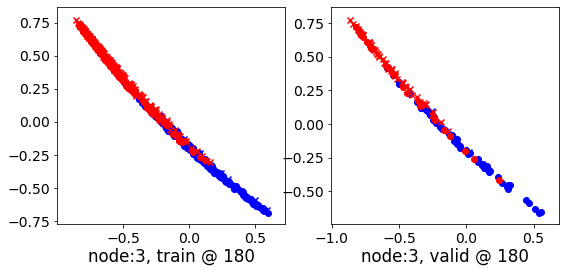

180 	 4 	 0.02301475 	 0.51022941 	 0.47206315 	 0.70494431 	 1.14029431 	 0.88786209


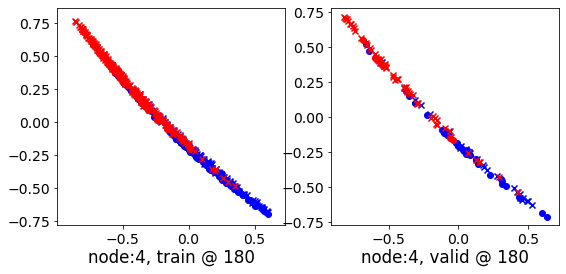

Aggregating on epoch: 182...
Aggregating on epoch: 184...
Aggregating on epoch: 186...
Aggregating on epoch: 188...
Aggregating on epoch: 190...
Aggregating on epoch: 192...
Aggregating on epoch: 194...
Aggregating on epoch: 196...
Aggregating on epoch: 198...
Aggregating on epoch: 200...
200 	 0 	 -0.06125511 	 -0.07876785 	 0.14985867 	 0.13954960 	 0.91121989 	 0.91146463


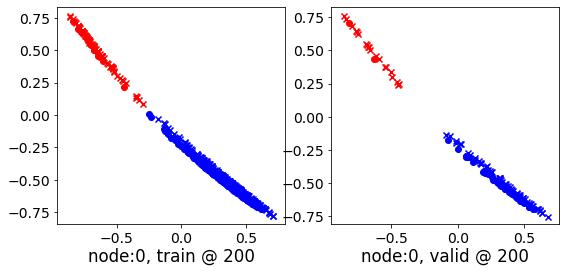

200 	 1 	 -0.11874266 	 -0.08481516 	 0.12611794 	 0.16835807 	 0.93876326 	 0.94632041


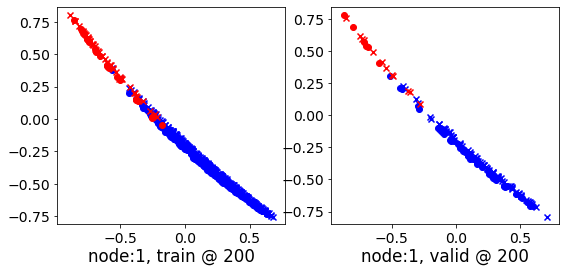

200 	 2 	 0.13479796 	 0.09753042 	 0.30747807 	 0.24797171 	 0.85961074 	 0.84358847


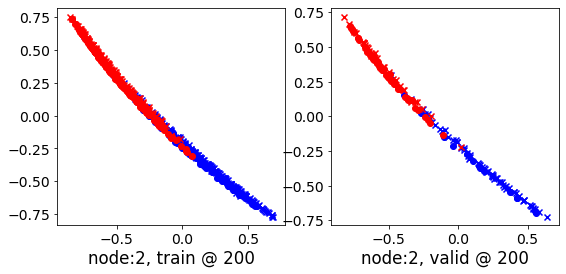

200 	 3 	 0.50370675 	 0.50800800 	 0.64337659 	 0.54475087 	 0.84473741 	 0.72989005


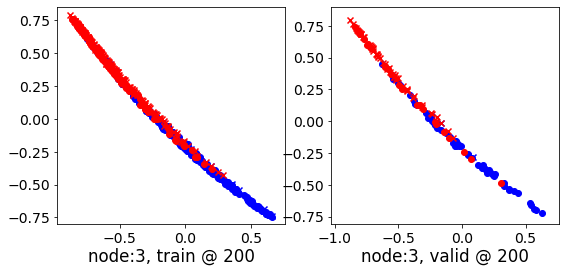

200 	 4 	 0.54914629 	 0.50463212 	 1.25235236 	 0.67904484 	 1.40545130 	 0.86755991


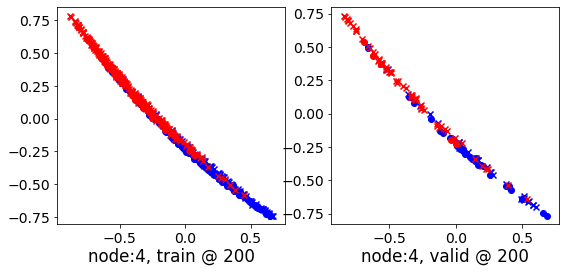

Aggregating on epoch: 202...
Aggregating on epoch: 204...
Aggregating on epoch: 206...
Aggregating on epoch: 208...
Aggregating on epoch: 210...
Aggregating on epoch: 212...
Aggregating on epoch: 214...
Aggregating on epoch: 216...
Aggregating on epoch: 218...
Aggregating on epoch: 220...
220 	 0 	 -0.10201847 	 -0.12344145 	 0.09367636 	 0.08439923 	 0.89987838 	 0.90098786


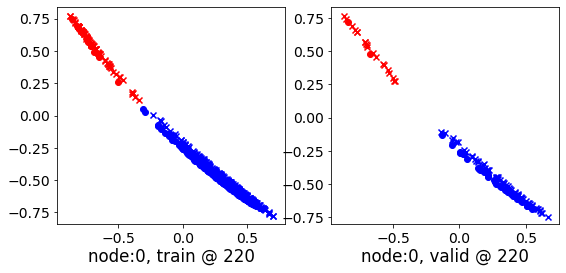

220 	 1 	 -0.13654488 	 -0.10570039 	 0.09209258 	 0.14785258 	 0.92407668 	 0.94670016


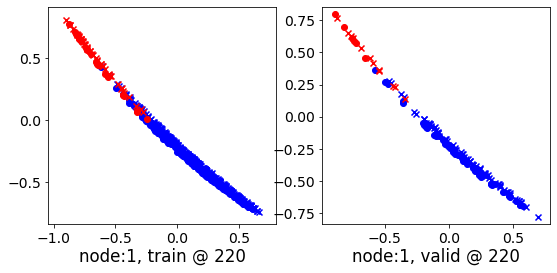

220 	 2 	 0.15892583 	 0.10448188 	 0.34137720 	 0.25730515 	 0.89153689 	 0.84597045


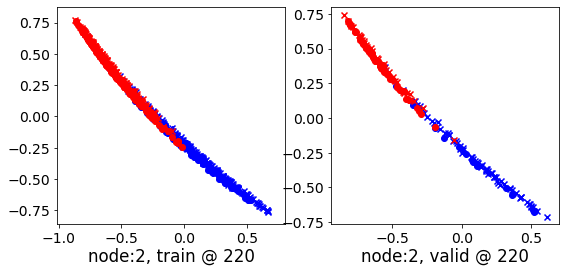

220 	 3 	 0.32426569 	 0.49929512 	 0.42105892 	 0.54167020 	 0.79147577 	 0.73552227


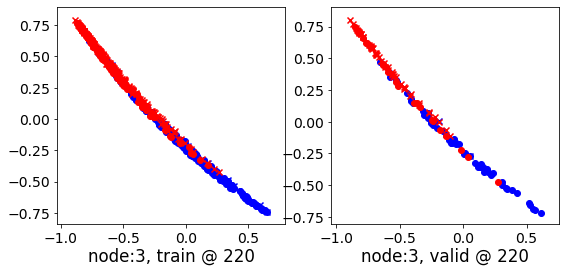

220 	 4 	 0.15946487 	 0.50219131 	 0.17959628 	 0.67378676 	 0.70971060 	 0.86474264


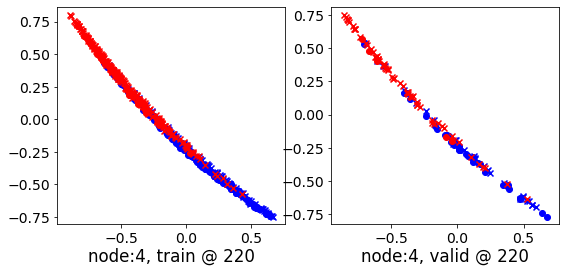

Aggregating on epoch: 222...
Aggregating on epoch: 224...
Aggregating on epoch: 226...
Aggregating on epoch: 228...
Aggregating on epoch: 230...
Aggregating on epoch: 232...
Aggregating on epoch: 234...
Aggregating on epoch: 236...
Aggregating on epoch: 238...
Aggregating on epoch: 240...
240 	 0 	 -0.11893498 	 -0.14249378 	 0.06569083 	 0.05702204 	 0.89105648 	 0.89266300


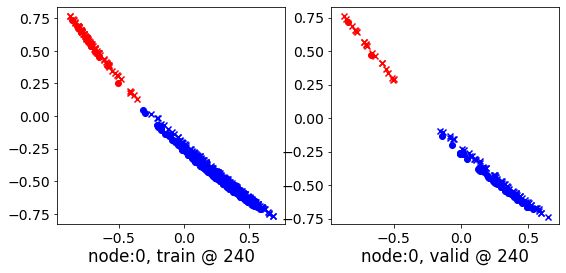

240 	 1 	 -0.09277643 	 -0.12004936 	 0.15870641 	 0.13259172 	 0.97103095 	 0.94578826


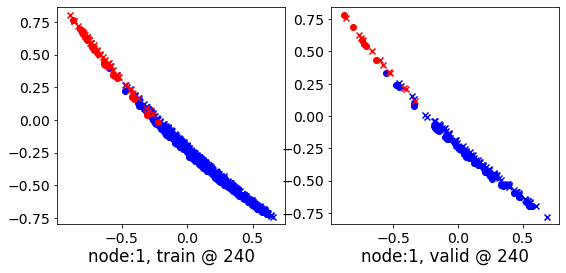

240 	 2 	 0.20727196 	 0.10159215 	 0.34398061 	 0.26015916 	 0.83352107 	 0.85171419


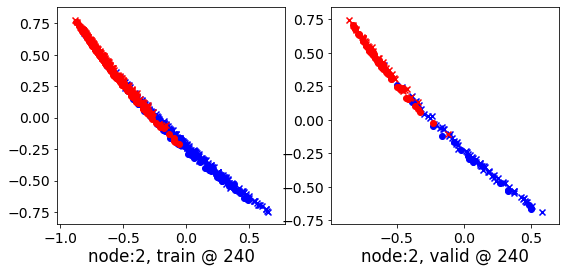

240 	 3 	 0.45982409 	 0.49316388 	 0.52995300 	 0.53339398 	 0.76579028 	 0.73337728


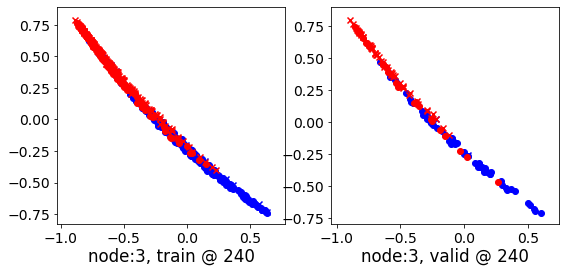

240 	 4 	 0.02992606 	 0.50429130 	 0.64433396 	 0.66622108 	 1.30381179 	 0.85507697


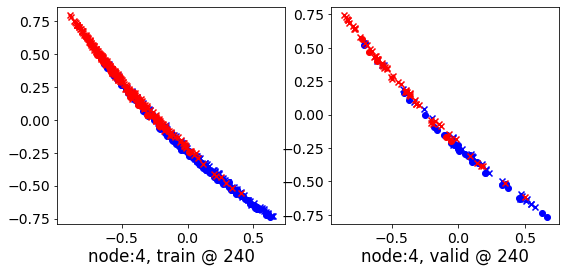

Aggregating on epoch: 242...
Aggregating on epoch: 244...
Aggregating on epoch: 246...
Aggregating on epoch: 248...
Aggregating on epoch: 250...
Aggregating on epoch: 252...
Aggregating on epoch: 254...
Aggregating on epoch: 256...
Aggregating on epoch: 258...
Aggregating on epoch: 260...
260 	 0 	 -0.12880045 	 -0.15275106 	 0.05014176 	 0.04143455 	 0.88502628 	 0.88733280


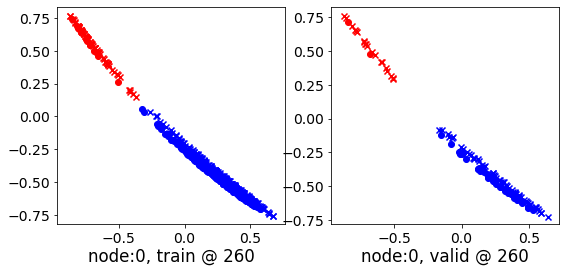

260 	 1 	 -0.04709129 	 -0.12277867 	 0.19125359 	 0.13000922 	 0.95736003 	 0.94593507


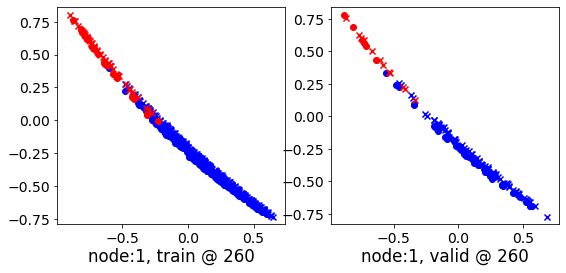

260 	 2 	 0.26270938 	 0.09473315 	 0.39389813 	 0.25130853 	 0.83060527 	 0.84972256


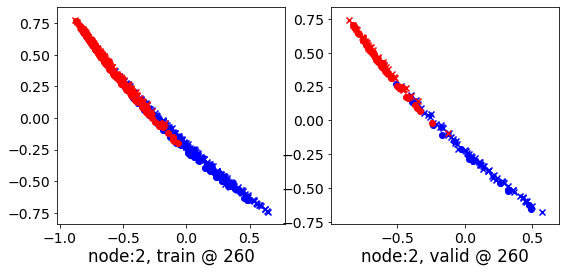

260 	 3 	 0.47730273 	 0.49519169 	 0.60394078 	 0.52982819 	 0.82190579 	 0.72778368


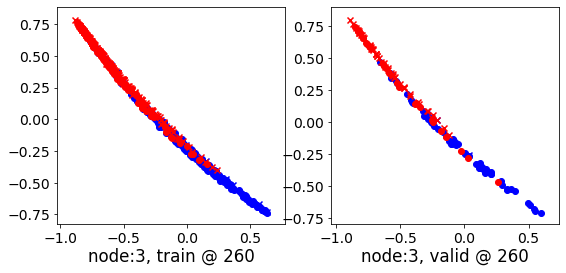

260 	 4 	 0.50549728 	 0.51033324 	 0.57843232 	 0.66922283 	 0.79286504 	 0.85203677


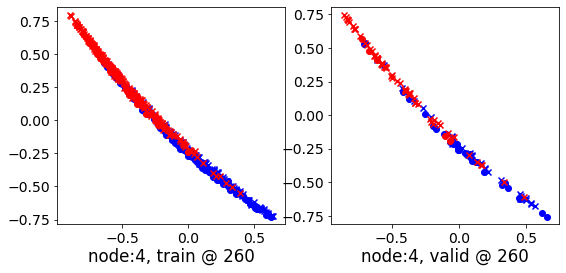

Aggregating on epoch: 262...
Aggregating on epoch: 264...
Aggregating on epoch: 266...
Aggregating on epoch: 268...
Aggregating on epoch: 270...
Aggregating on epoch: 272...
Aggregating on epoch: 274...
Aggregating on epoch: 276...
Aggregating on epoch: 278...
Aggregating on epoch: 280...
280 	 0 	 -0.14072166 	 -0.16221224 	 0.03876518 	 0.03035100 	 0.88055956 	 0.88571042


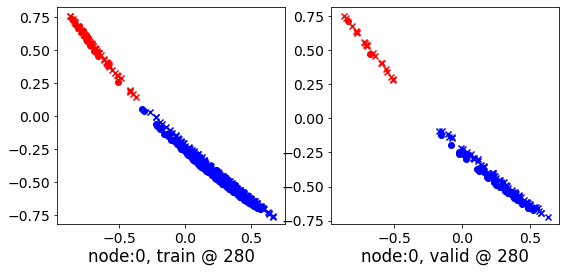

280 	 1 	 -0.07285485 	 -0.12656289 	 0.15468201 	 0.12683666 	 0.92637879 	 0.94654673


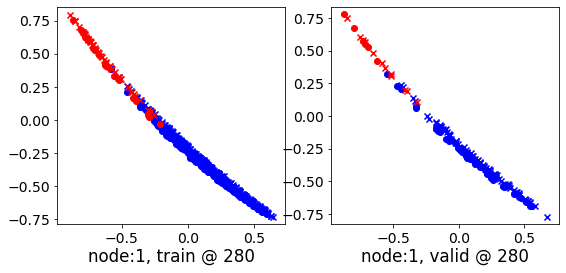

280 	 2 	 0.20231789 	 0.09457259 	 0.38196540 	 0.24768470 	 0.87190330 	 0.84625930


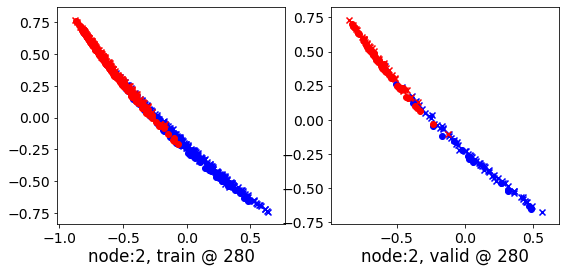

280 	 3 	 0.31537303 	 0.50065434 	 0.39470246 	 0.53508532 	 0.77356505 	 0.72757816


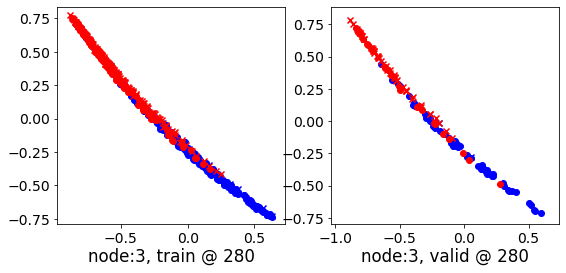

280 	 4 	 0.28840697 	 0.51314563 	 0.25028306 	 0.67471617 	 0.65471220 	 0.85471773


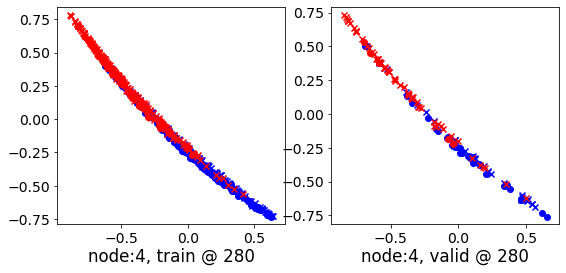

Aggregating on epoch: 282...
Aggregating on epoch: 284...
Aggregating on epoch: 286...
Aggregating on epoch: 288...
Aggregating on epoch: 290...
Aggregating on epoch: 292...
Aggregating on epoch: 294...
Aggregating on epoch: 296...
Aggregating on epoch: 298...
Aggregating on epoch: 300...
300 	 0 	 -0.14811292 	 -0.16849858 	 0.03181555 	 0.02390396 	 0.87867934 	 0.88554972


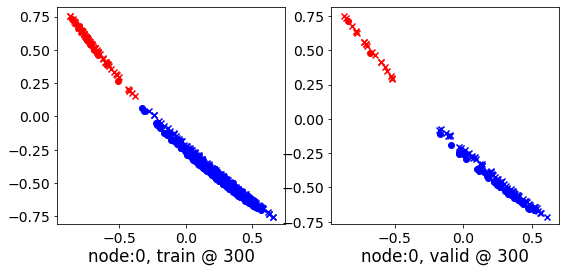

300 	 1 	 -0.13729882 	 -0.12839851 	 0.12306796 	 0.12473641 	 0.96065080 	 0.94628209


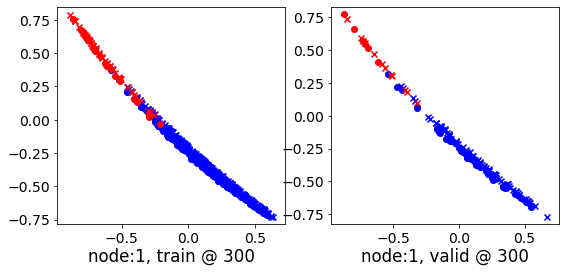

300 	 2 	 0.16384593 	 0.09389535 	 0.34305912 	 0.24824038 	 0.87440944 	 0.84749222


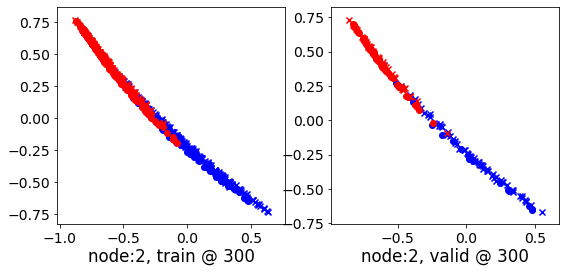

300 	 3 	 0.59600848 	 0.50022388 	 0.68830448 	 0.53298968 	 0.78594494 	 0.72591299


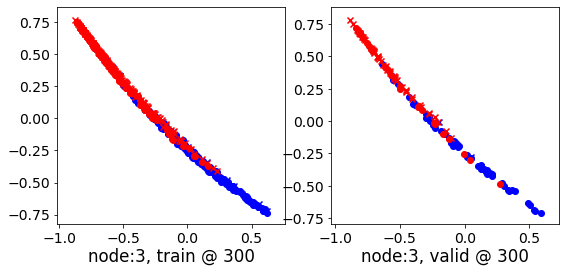

300 	 4 	 0.34807631 	 0.52368307 	 0.27252796 	 0.68072569 	 0.62244463 	 0.85018981


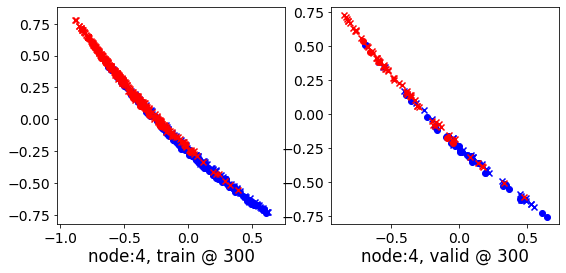

Aggregating on epoch: 302...
Aggregating on epoch: 304...
Aggregating on epoch: 306...
Aggregating on epoch: 308...
Aggregating on epoch: 310...
Aggregating on epoch: 312...
Aggregating on epoch: 314...
Aggregating on epoch: 316...
Aggregating on epoch: 318...
Aggregating on epoch: 320...
320 	 0 	 -0.15432659 	 -0.17404914 	 0.02713199 	 0.01955337 	 0.87886995 	 0.88674968


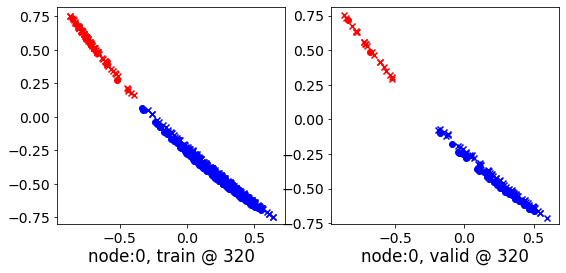

320 	 1 	 -0.22771622 	 -0.12897325 	 0.05462789 	 0.12435318 	 0.97156453 	 0.94647360


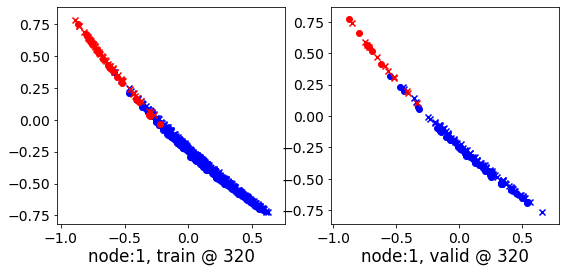

320 	 2 	 0.26327485 	 0.09486090 	 0.38272139 	 0.24965076 	 0.81165898 	 0.84793705


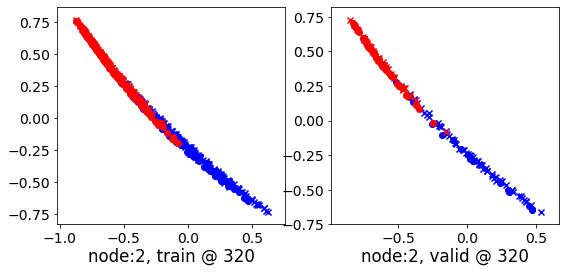

320 	 3 	 0.31576210 	 0.50573540 	 0.52015293 	 0.53748947 	 0.89796644 	 0.72490126


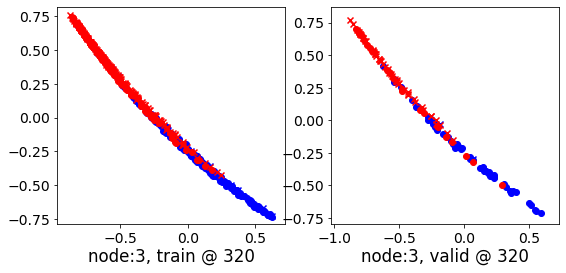

320 	 4 	 0.85633886 	 0.53072464 	 0.61159879 	 0.68381369 	 0.47119403 	 0.84623623


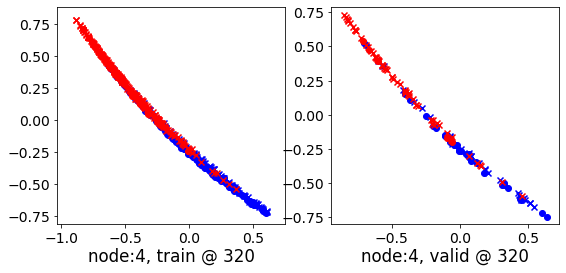

Aggregating on epoch: 322...
Aggregating on epoch: 324...
Aggregating on epoch: 326...
Aggregating on epoch: 328...
Aggregating on epoch: 330...
Aggregating on epoch: 332...
Aggregating on epoch: 334...
Aggregating on epoch: 336...
Aggregating on epoch: 338...
Aggregating on epoch: 340...
340 	 0 	 -0.16099641 	 -0.17834966 	 0.02394382 	 0.01656462 	 0.88111252 	 0.88806146


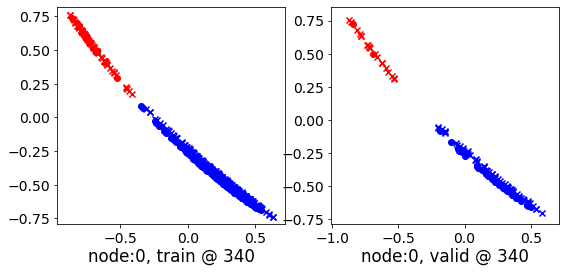

340 	 1 	 -0.11551391 	 -0.12954035 	 0.13182855 	 0.12470641 	 0.94852108 	 0.94739395


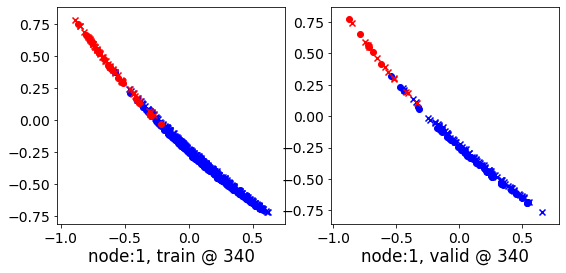

340 	 2 	 0.17111307 	 0.09341075 	 0.34035152 	 0.24955811 	 0.86389530 	 0.84929454


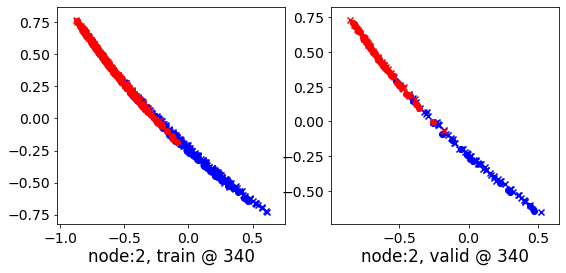

340 	 3 	 0.33768269 	 0.50224638 	 0.45548984 	 0.52815920 	 0.81107879 	 0.71906000


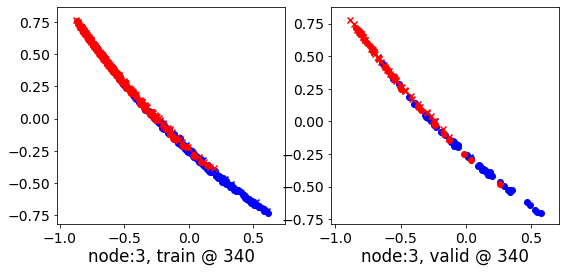

340 	 4 	 -0.01291484 	 0.53933871 	 0.09450334 	 0.69067264 	 0.80042434 	 0.84448111


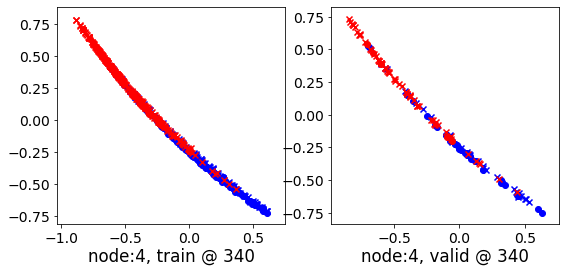

Aggregating on epoch: 342...
Aggregating on epoch: 344...
Aggregating on epoch: 346...
Aggregating on epoch: 348...
Aggregating on epoch: 350...
Aggregating on epoch: 352...
Aggregating on epoch: 354...
Aggregating on epoch: 356...
Aggregating on epoch: 358...
Aggregating on epoch: 360...
360 	 0 	 -0.16619894 	 -0.18143182 	 0.02161543 	 0.01434614 	 0.88350117 	 0.88892514


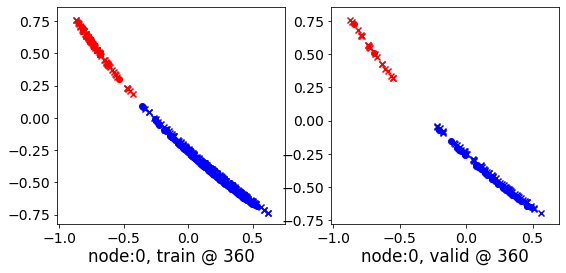

360 	 1 	 -0.06287731 	 -0.12986776 	 0.18074732 	 0.12480578 	 0.94813657 	 0.94782072


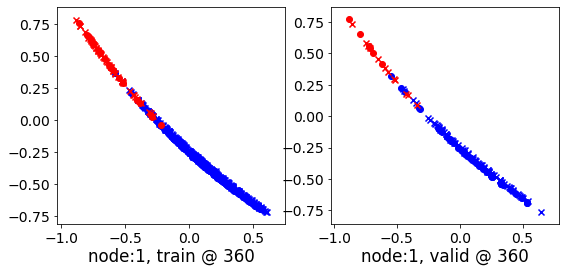

360 	 2 	 0.17273188 	 0.09367356 	 0.34892815 	 0.25052640 	 0.86852896 	 0.85000002


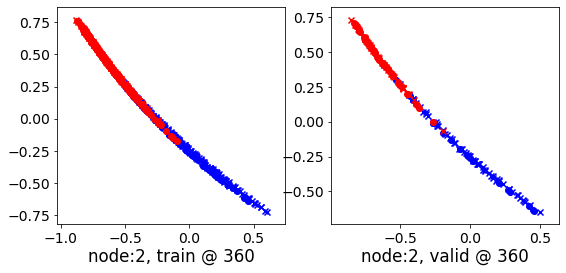

360 	 3 	 0.37357074 	 0.50087589 	 0.66266036 	 0.52875328 	 0.98315740 	 0.72102457


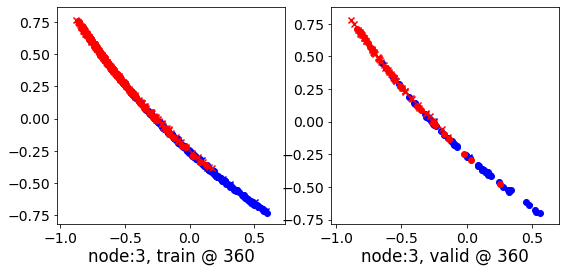

360 	 4 	 1.23369420 	 0.52869636 	 1.53516614 	 0.68604803 	 1.05367672 	 0.85049886


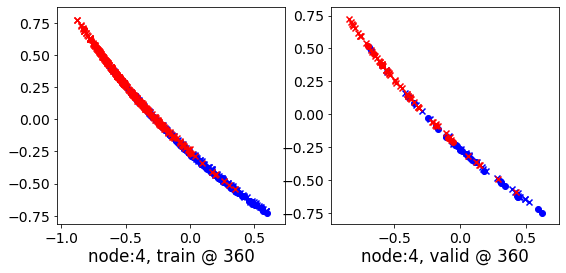

Aggregating on epoch: 362...
Aggregating on epoch: 364...
Aggregating on epoch: 366...
Aggregating on epoch: 368...
Aggregating on epoch: 370...
Aggregating on epoch: 372...
Aggregating on epoch: 374...
Aggregating on epoch: 376...
Aggregating on epoch: 378...
Aggregating on epoch: 380...
380 	 0 	 -0.17184220 	 -0.18445720 	 0.01944342 	 0.01236843 	 0.88597679 	 0.88997281


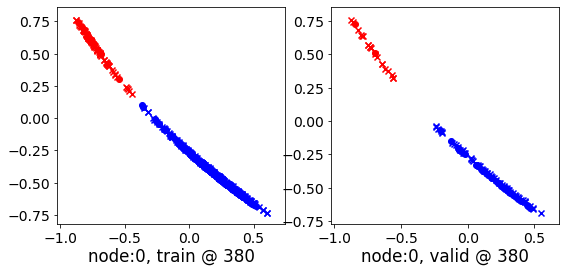

380 	 1 	 -0.06279731 	 -0.12869571 	 0.18036941 	 0.12629296 	 0.93279320 	 0.94813585


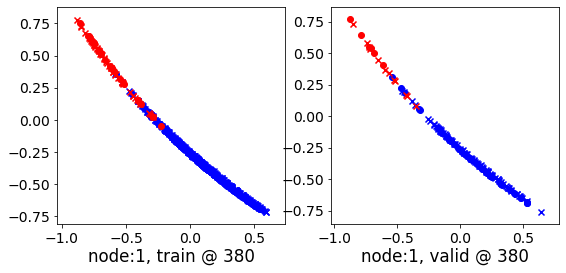

380 	 2 	 0.10383490 	 0.09237468 	 0.30428141 	 0.24910158 	 0.89881891 	 0.84987408


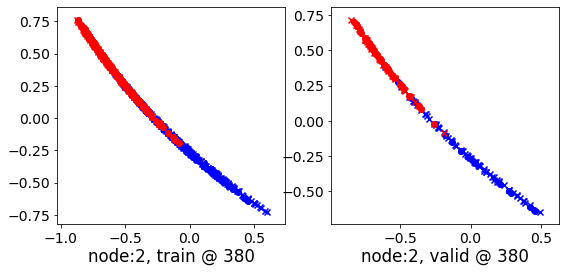

380 	 3 	 0.35680875 	 0.49069971 	 0.45862454 	 0.52579659 	 0.79512167 	 0.72824407


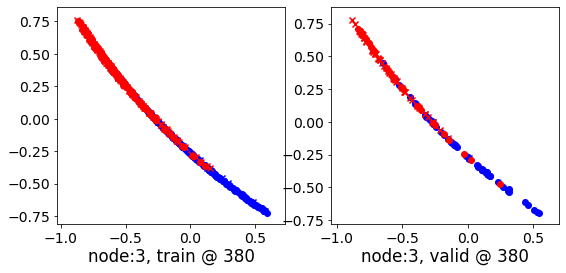

380 	 4 	 -0.63756442 	 0.51487702 	 0.31696051 	 0.67037469 	 1.65007532 	 0.84864485


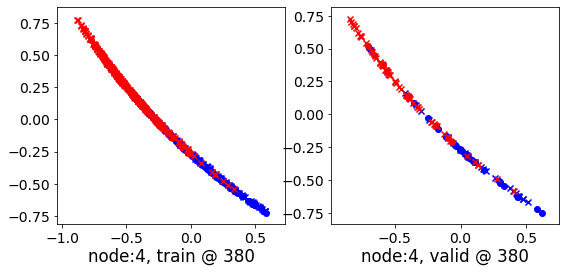

Aggregating on epoch: 382...
Aggregating on epoch: 384...
Aggregating on epoch: 386...
Aggregating on epoch: 388...
Aggregating on epoch: 390...
Aggregating on epoch: 392...
Aggregating on epoch: 394...
Aggregating on epoch: 396...
Aggregating on epoch: 398...
Aggregating on epoch: 400...
400 	 0 	 -0.17634842 	 -0.18796107 	 0.01730078 	 0.01033149 	 0.88787133 	 0.89143974


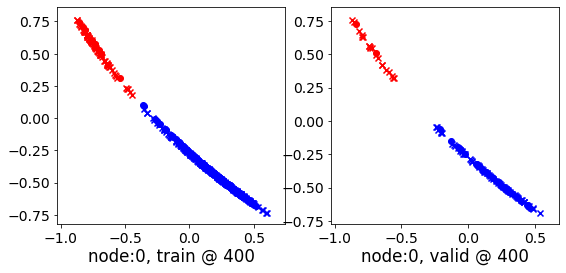

400 	 1 	 -0.16615698 	 -0.13179234 	 0.05473912 	 0.12226524 	 0.91311044 	 0.94720477


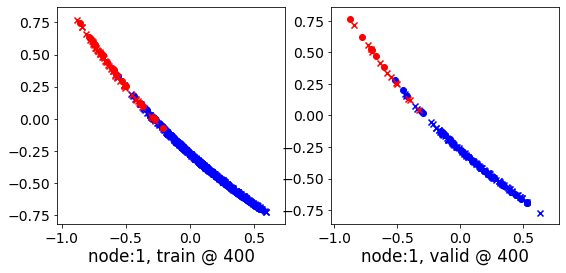

400 	 2 	 0.25311247 	 0.09147497 	 0.39165559 	 0.24817593 	 0.83465666 	 0.84984815


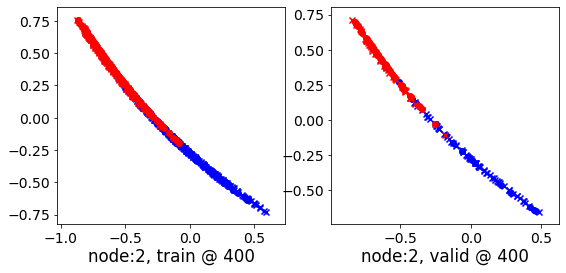

400 	 3 	 0.35176864 	 0.49426019 	 0.38199723 	 0.52733433 	 0.72417319 	 0.72622132


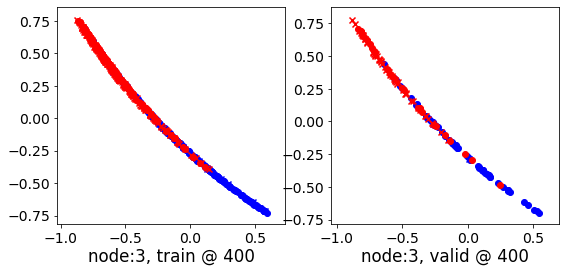

400 	 4 	 0.37966555 	 0.52403879 	 0.85846537 	 0.67870712 	 1.18934226 	 0.84781551


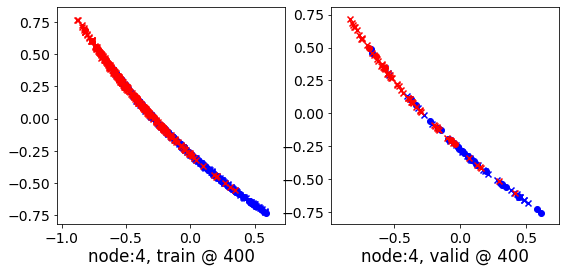

Aggregating on epoch: 402...
Aggregating on epoch: 404...
Aggregating on epoch: 406...
Aggregating on epoch: 408...
Aggregating on epoch: 410...
Aggregating on epoch: 412...
Aggregating on epoch: 414...
Aggregating on epoch: 416...
Aggregating on epoch: 418...
Aggregating on epoch: 420...
420 	 0 	 -0.17896104 	 -0.19027252 	 0.01604039 	 0.00881313 	 0.88905817 	 0.89223284


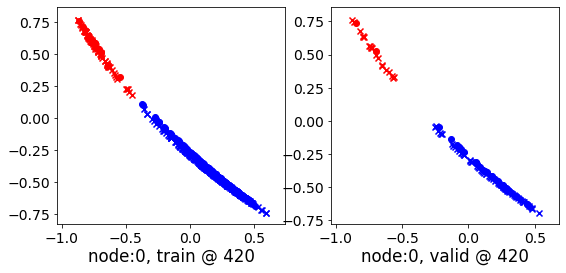

420 	 1 	 -0.12566875 	 -0.11691943 	 0.11968313 	 0.13674459 	 0.93512994 	 0.94681120


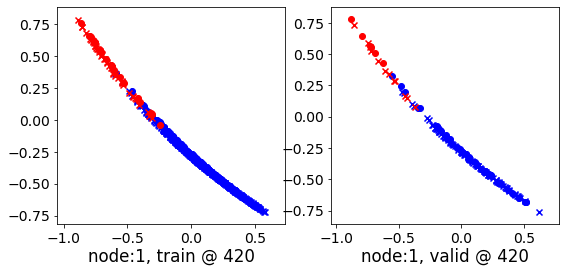

420 	 2 	 0.11727685 	 0.09251051 	 0.31570163 	 0.24751525 	 0.89172220 	 0.84815192


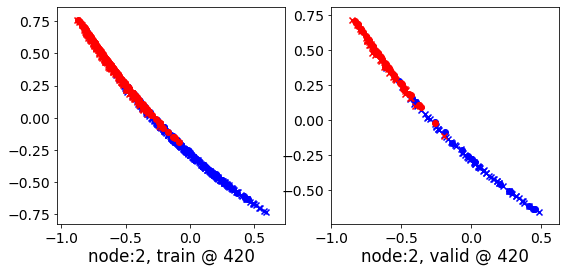

420 	 3 	 0.43058714 	 0.49861139 	 0.39709243 	 0.53377932 	 0.66005349 	 0.72831511


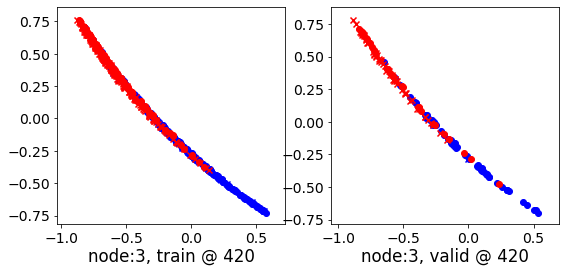

420 	 4 	 1.09414911 	 0.51649648 	 0.76933211 	 0.67246056 	 0.39703518 	 0.84911126


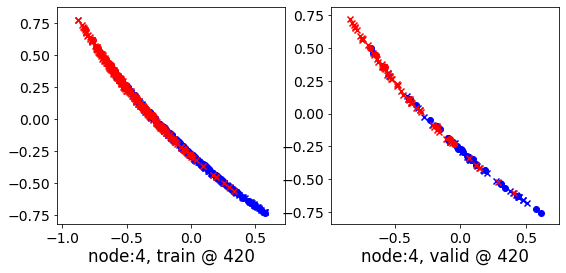

Aggregating on epoch: 422...
Aggregating on epoch: 424...
Aggregating on epoch: 426...
Aggregating on epoch: 428...
Aggregating on epoch: 430...
Aggregating on epoch: 432...
Aggregating on epoch: 434...
Aggregating on epoch: 436...
Aggregating on epoch: 438...
Aggregating on epoch: 440...
440 	 0 	 -0.18142328 	 -0.19241296 	 0.01515827 	 0.00786299 	 0.89058810 	 0.89342314


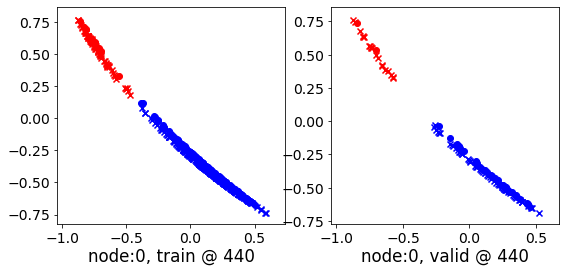

440 	 1 	 -0.06936912 	 -0.12431537 	 0.15274557 	 0.12926091 	 0.91392714 	 0.94672346


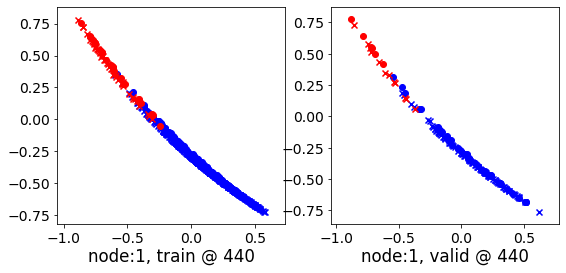

440 	 2 	 0.17008063 	 0.09635198 	 0.32411915 	 0.25242376 	 0.85075670 	 0.84921896


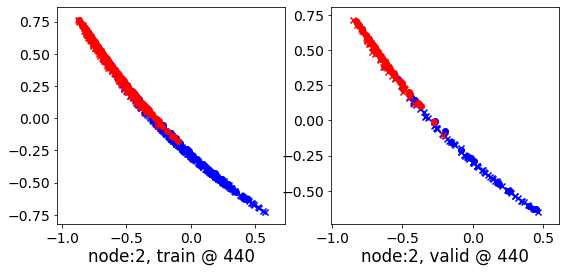

440 	 3 	 0.23803505 	 0.50485885 	 0.49257016 	 0.53374201 	 0.94828403 	 0.72203034


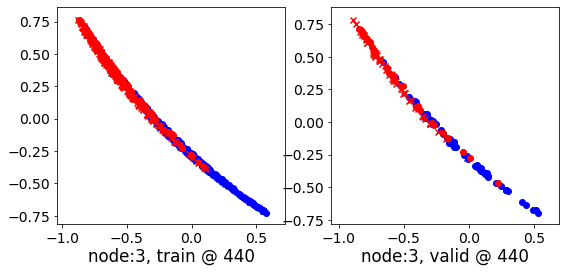

440 	 4 	 0.72942132 	 0.50557631 	 0.59849012 	 0.66499412 	 0.57893670 	 0.85256499


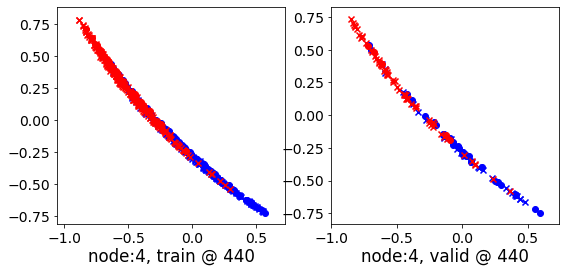

Aggregating on epoch: 442...
Aggregating on epoch: 444...
Aggregating on epoch: 446...
Aggregating on epoch: 448...
Aggregating on epoch: 450...
Aggregating on epoch: 452...
Aggregating on epoch: 454...
Aggregating on epoch: 456...
Aggregating on epoch: 458...
Aggregating on epoch: 460...
460 	 0 	 -0.18428724 	 -0.19447471 	 0.01309700 	 0.00613146 	 0.89118481 	 0.89375335


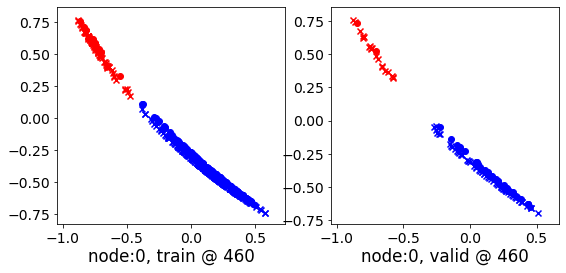

460 	 1 	 -0.23431686 	 -0.13075992 	 0.07046834 	 0.12380961 	 0.99571854 	 0.94771671


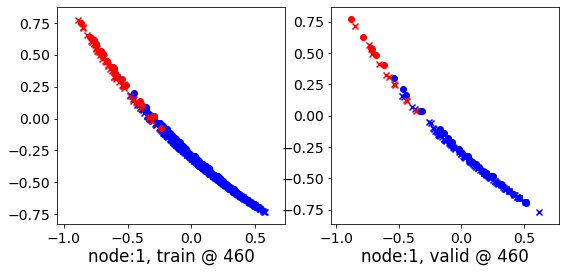

460 	 2 	 0.18998870 	 0.09307517 	 0.34700954 	 0.24911042 	 0.85604799 	 0.84918243


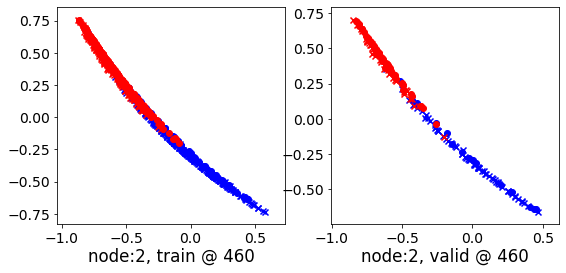

460 	 3 	 0.43013871 	 0.49742305 	 0.55287212 	 0.53100705 	 0.81955343 	 0.72673118


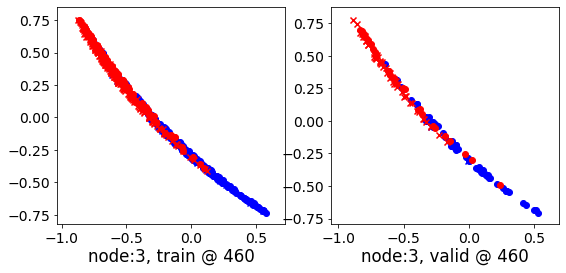

460 	 4 	 0.09397730 	 0.51376957 	 0.26993382 	 0.66867971 	 0.86979264 	 0.84805733


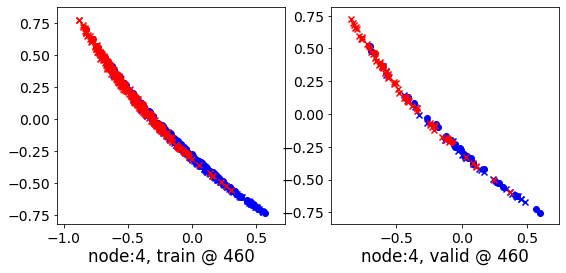

Aggregating on epoch: 462...
Aggregating on epoch: 464...
Aggregating on epoch: 466...
Aggregating on epoch: 468...
Aggregating on epoch: 470...
Aggregating on epoch: 472...
Aggregating on epoch: 474...
Aggregating on epoch: 476...
Aggregating on epoch: 478...
Aggregating on epoch: 480...
480 	 0 	 -0.18631133 	 -0.19647422 	 0.01081048 	 0.00431439 	 0.89091253 	 0.89393580


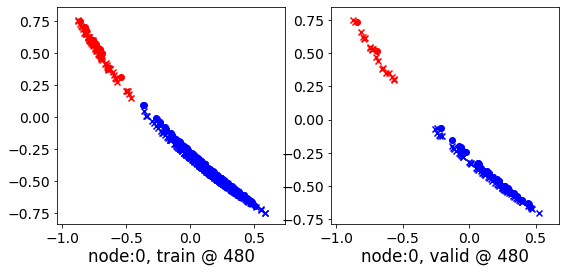

480 	 1 	 -0.10006532 	 -0.12696746 	 0.11121520 	 0.12685791 	 0.91242975 	 0.94697255


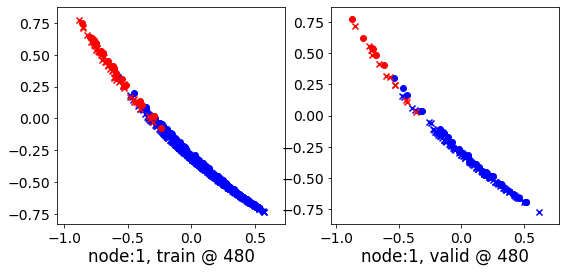

480 	 2 	 0.24199069 	 0.09164253 	 0.40089843 	 0.24518296 	 0.85417396 	 0.84668761


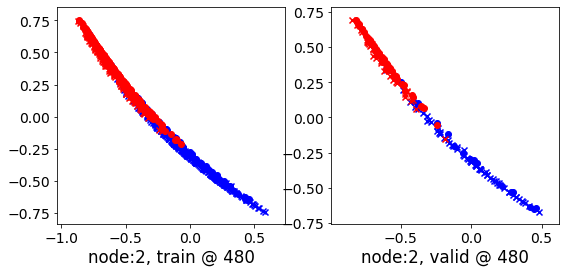

480 	 3 	 0.29590422 	 0.50430179 	 0.37046471 	 0.53599912 	 0.76766968 	 0.72484452


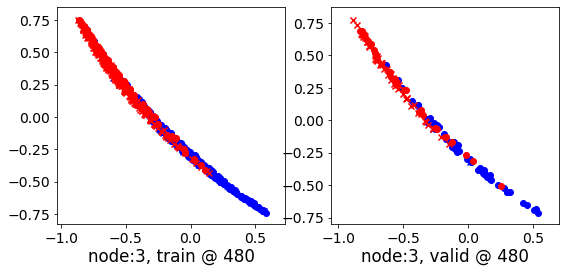

480 	 4 	 -0.49812186 	 0.52061975 	 0.37239033 	 0.67562962 	 1.56350648 	 0.84815705


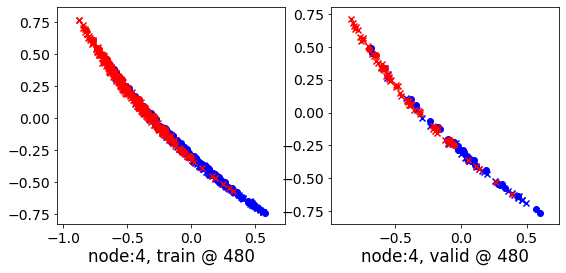

Aggregating on epoch: 482...
Aggregating on epoch: 484...
Aggregating on epoch: 486...
Aggregating on epoch: 488...
Aggregating on epoch: 490...
Aggregating on epoch: 492...
Aggregating on epoch: 494...
Aggregating on epoch: 496...
Aggregating on epoch: 498...
Aggregating on epoch: 500...
500 	 0 	 -0.18677531 	 -0.19800247 	 0.01000024 	 0.00340788 	 0.89042324 	 0.89455754


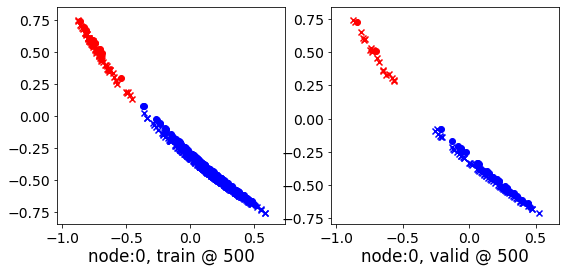

500 	 1 	 -0.07545416 	 -0.12726019 	 0.14057600 	 0.12635542 	 0.94593245 	 0.94676280


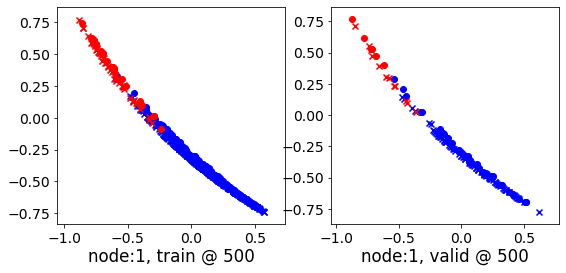

500 	 2 	 0.15883565 	 0.09359446 	 0.36093497 	 0.24613866 	 0.89433658 	 0.84569138


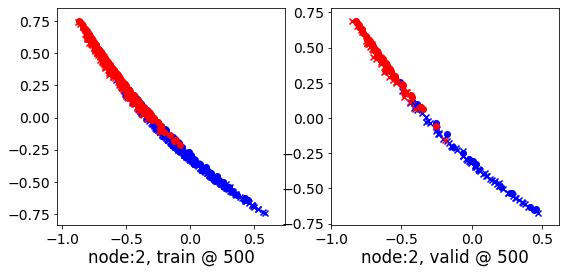

500 	 3 	 0.32650140 	 0.50707000 	 0.36401859 	 0.53554279 	 0.73064893 	 0.72161996


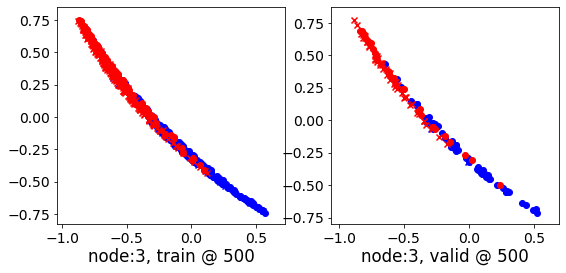

500 	 4 	 0.03062630 	 0.51402116 	 0.12841621 	 0.67156971 	 0.79100561 	 0.85069573


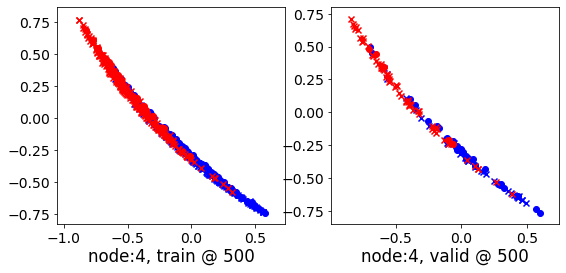

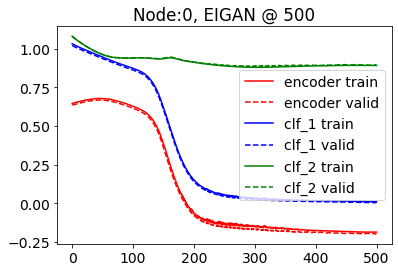

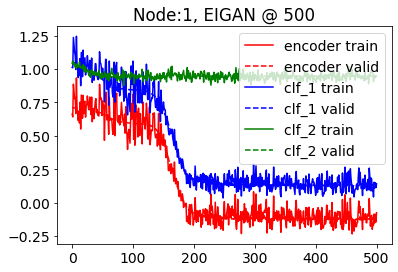

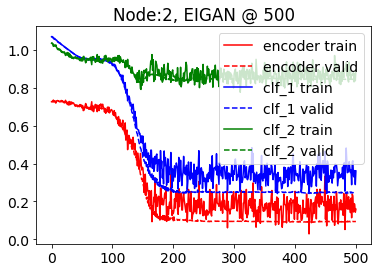

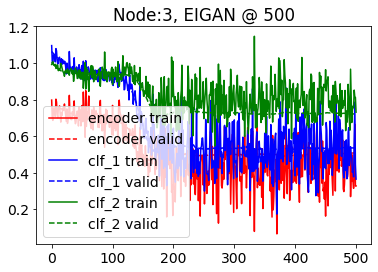

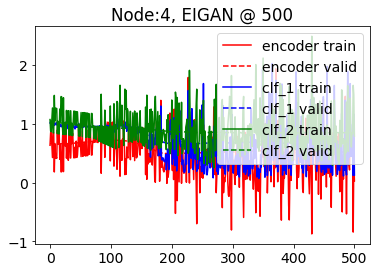

  0%|          | 0/501 [00:00<?, ?it/s]

epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.88303757 	 0.85677218 	 1.24468732 	 1.25008845 	 1.05508780 	 1.08646345


100%|██████████| 501/501 [01:05<00:00,  7.68it/s]


500 	 0.20384786 	 0.18147251 	 0.47089976 	 0.45716140 	 0.96164209 	 0.96883607


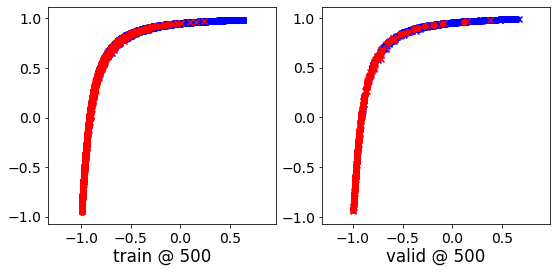

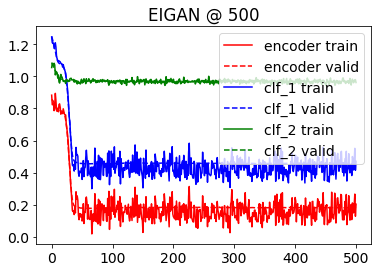

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.359044 	 1.358722 	 0.6166
200 	 0.850971 	 0.850776 	 0.7626
400 	 0.435081 	 0.455029 	 0.8904
600 	 0.427020 	 0.455270 	 0.8904
800 	 0.426904 	 0.455798 	 0.8890
1000 	 0.426847 	 0.455796 	 0.8890
Accuracy: 0.8890449438202247
Error Rate: 0.11095505617977527
F1 Score: 0.8611599297012302
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8567415730337079
Error Rate: 0.14325842696629212
F1 Score: 0.8333333333333334
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8792134831460674
Error Rate: 0.1

@node 3: tensor sizes => torch.Size([436, 2]) (110, 2) torch.Size([436, 2]) (110, 2) torch.Size([436, 2]) (110, 2)
@node 4: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(813, 2) (204, 2) (813, 1) (204, 1) (813, 1) (204, 1)
@node 4: class weights => w1, w2 [array([1.58024691, 2.72340426]), array([1.47659574, 3.09821429]), array([2.3655914 , 1.73228346]), array([3.22962963, 1.44850498]), array([1.59724951, 2.67434211])] [array([3.55555556, 1.39130435]), array([2.62878788, 1.61395349]), array([2.25255973, 1.79836512]), array([3.13669065, 1.46801347]), array([2.20923913, 1.82696629])]
@node 4: tensor sizes => torch.Size([813, 2]) (204, 2) torch.Size([813, 2]) (204, 2) torch.Size([813, 2]) (204, 2)
@node 5: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(437, 2) (110, 2) (437, 1) (110, 1) (437, 1) (110, 1)
@node 5: class weights => w1, w2 [array([1.58024691, 2.72340426]), array([1.47659574, 3.09821429]), array([2.3655914 , 1.73228346]), array([3.22962963, 1.448

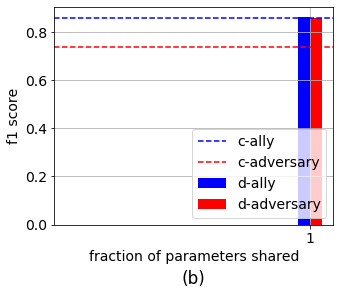

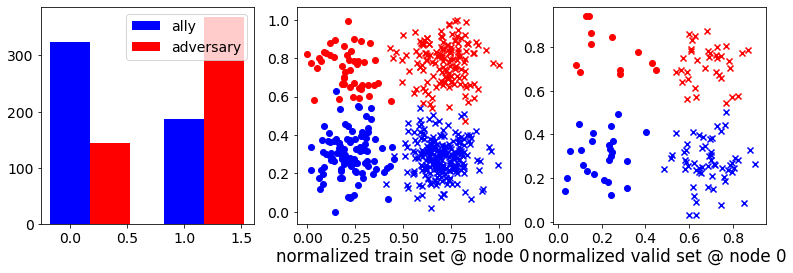

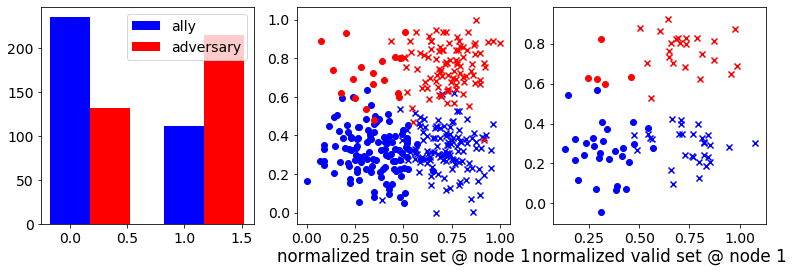

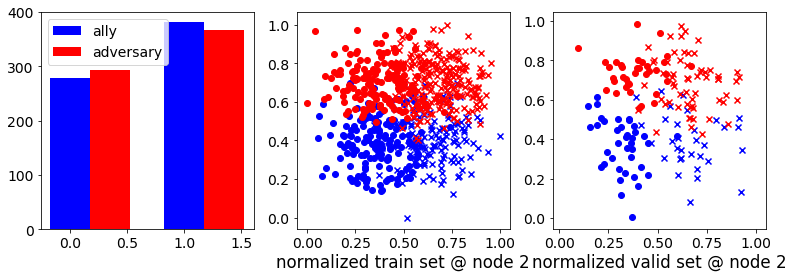

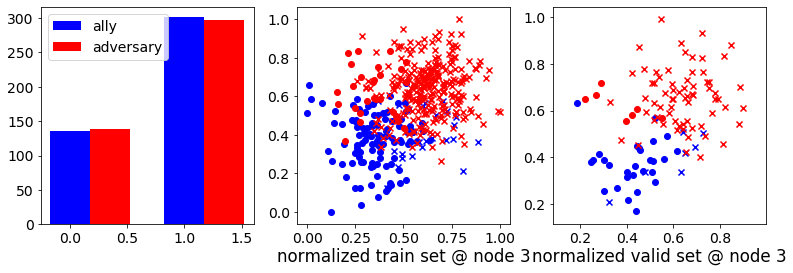

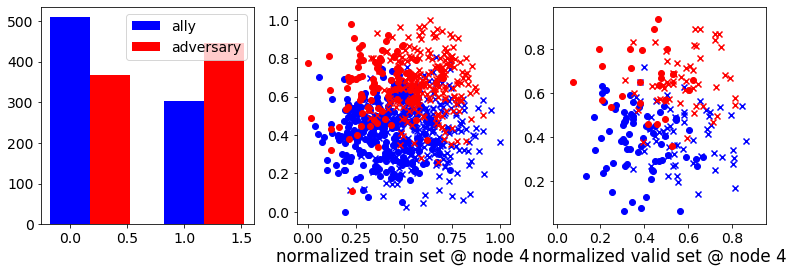

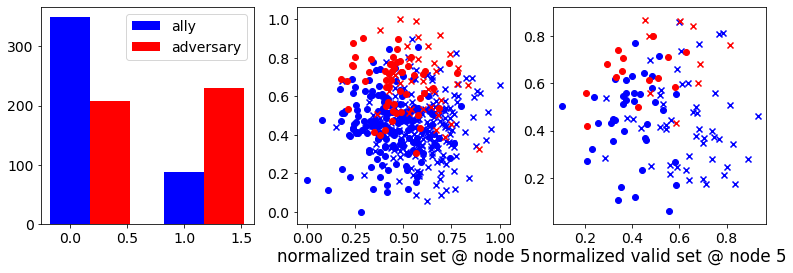

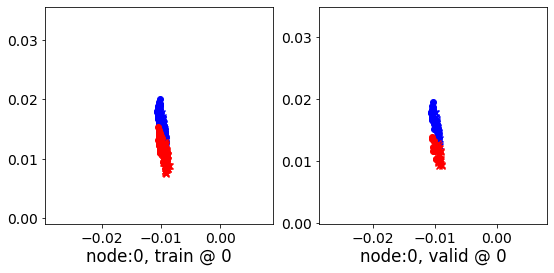

0 	 1 	 0.71256566 	 0.70918703 	 1.06138921 	 1.05769563 	 1.04203582 	 1.04165578


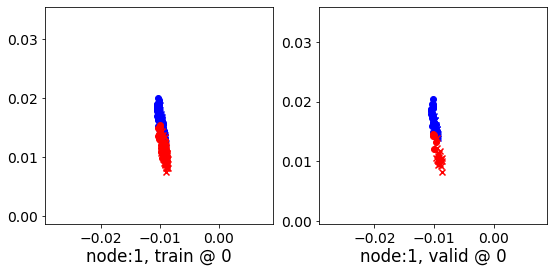

0 	 2 	 0.68259037 	 0.68303835 	 1.03465378 	 1.03206480 	 1.04530442 	 1.04217362


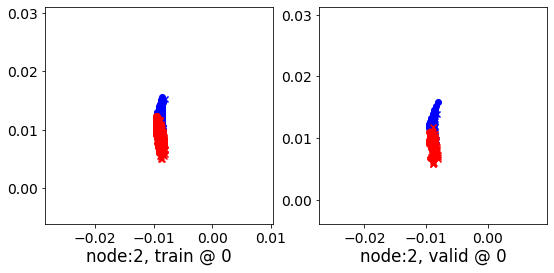

0 	 3 	 0.70592308 	 0.71309912 	 1.03292680 	 1.03866971 	 1.02019751 	 1.01871777


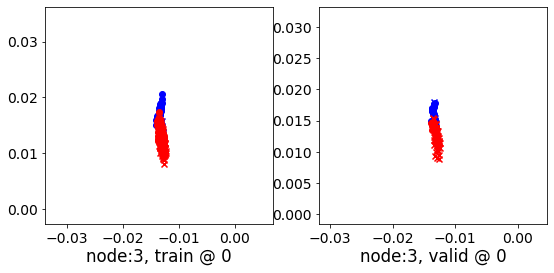

0 	 4 	 0.65773016 	 0.66119099 	 0.99975824 	 1.00171459 	 1.03522789 	 1.03367078


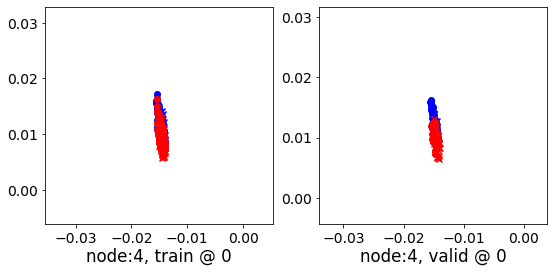

0 	 5 	 0.66682398 	 0.67792654 	 1.04039991 	 1.04999757 	 1.06681371 	 1.06521821


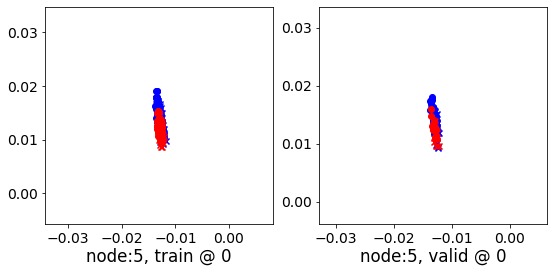

Aggregating on epoch: 2...
Aggregating on epoch: 4...
Aggregating on epoch: 6...
Aggregating on epoch: 8...
Aggregating on epoch: 10...
Aggregating on epoch: 12...
Aggregating on epoch: 14...
Aggregating on epoch: 16...
Aggregating on epoch: 18...
Aggregating on epoch: 20...
20 	 0 	 0.71876574 	 0.71909148 	 1.01684117 	 1.01532853 	 0.99130172 	 0.98938423


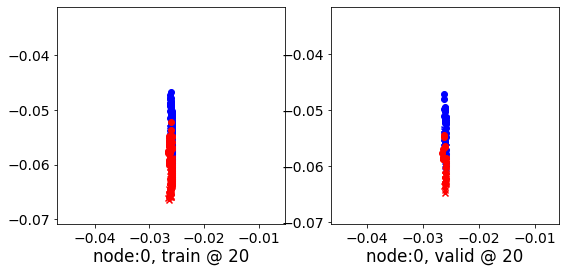

20 	 1 	 0.70264620 	 0.69911027 	 1.00882435 	 1.00589705 	 0.99940431 	 0.99993396


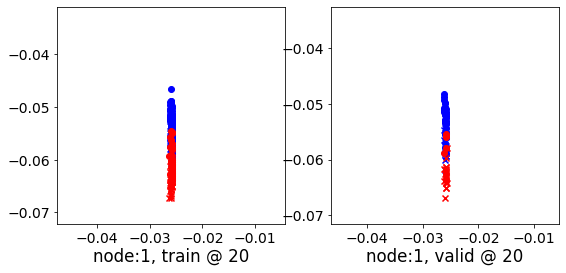

20 	 2 	 0.70675123 	 0.71429694 	 0.98606247 	 1.00277555 	 0.97252083 	 0.98162580


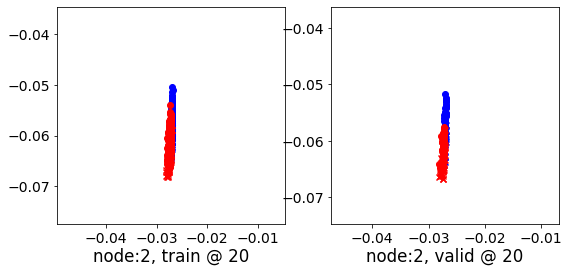

20 	 3 	 0.69205880 	 0.69929951 	 0.99844468 	 1.00433266 	 0.99958712 	 0.99818033


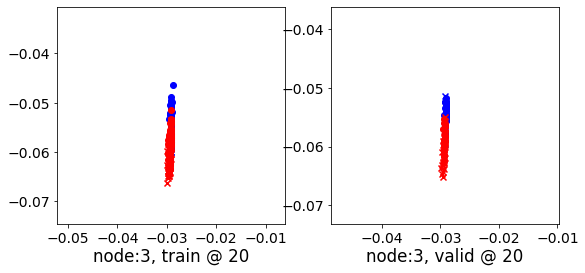

20 	 4 	 0.67205781 	 0.67149150 	 0.96367860 	 0.96240258 	 0.98486972 	 0.98405826


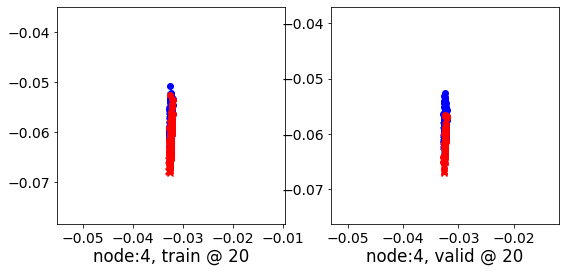

20 	 5 	 0.64991075 	 0.66035748 	 0.99680120 	 1.00602269 	 1.04014039 	 1.03881240


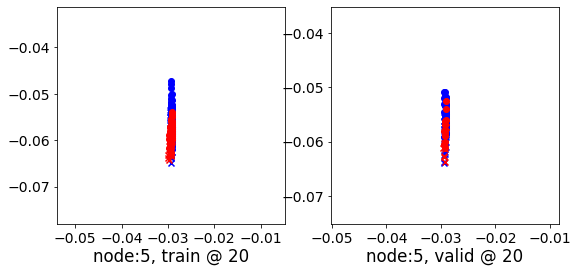

Aggregating on epoch: 22...
Aggregating on epoch: 24...
Aggregating on epoch: 26...
Aggregating on epoch: 28...
Aggregating on epoch: 30...
Aggregating on epoch: 32...
Aggregating on epoch: 34...
Aggregating on epoch: 36...
Aggregating on epoch: 38...
Aggregating on epoch: 40...
40 	 0 	 0.72311884 	 0.72320688 	 0.98848194 	 0.98725879 	 0.95866942 	 0.95719910


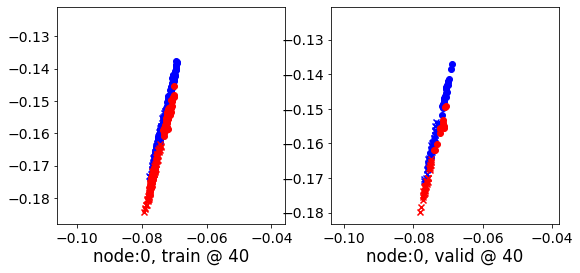

40 	 1 	 0.69080991 	 0.68672729 	 0.96634084 	 0.96388650 	 0.96883959 	 0.97030640


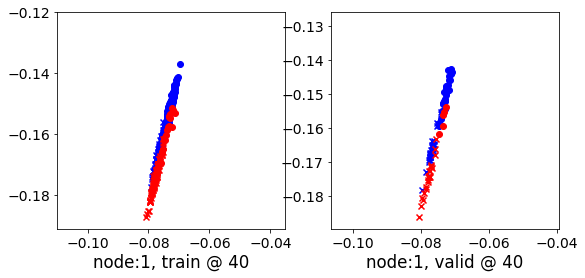

40 	 2 	 0.71395361 	 0.71010613 	 0.97018772 	 0.97318560 	 0.94944227 	 0.95622665


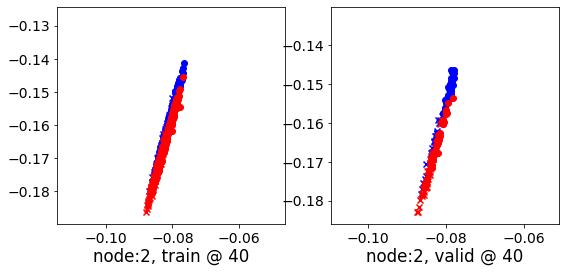

40 	 3 	 0.68286347 	 0.69039828 	 0.96857607 	 0.97472841 	 0.97893035 	 0.97747731


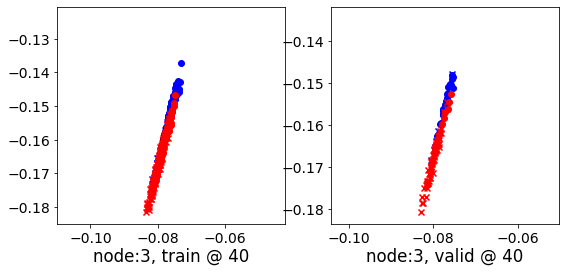

40 	 4 	 0.69331777 	 0.68232387 	 0.96059924 	 0.94634861 	 0.96046096 	 0.95717192


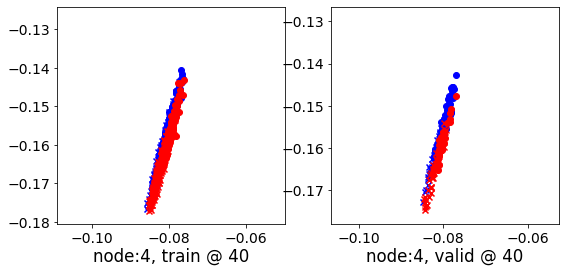

40 	 5 	 0.63271856 	 0.64262867 	 0.95511878 	 0.96391666 	 1.01575804 	 1.01443517


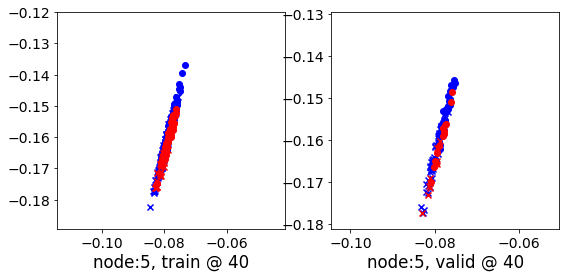

Aggregating on epoch: 42...
Aggregating on epoch: 44...
Aggregating on epoch: 46...
Aggregating on epoch: 48...
Aggregating on epoch: 50...
Aggregating on epoch: 52...
Aggregating on epoch: 54...
Aggregating on epoch: 56...
Aggregating on epoch: 58...
Aggregating on epoch: 60...
60 	 0 	 0.72178125 	 0.72151321 	 0.96326268 	 0.96230656 	 0.93479937 	 0.93394053


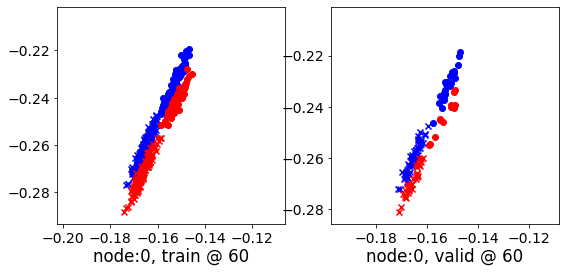

60 	 1 	 0.68112087 	 0.67674834 	 0.93935740 	 0.93805140 	 0.95143324 	 0.95445025


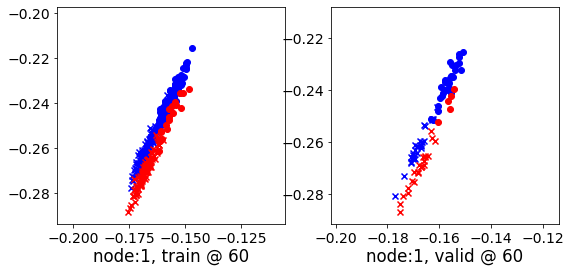

60 	 2 	 0.70740819 	 0.69250923 	 0.95340002 	 0.95239419 	 0.93914902 	 0.95303214


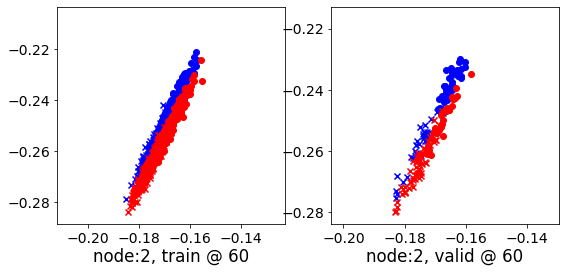

60 	 3 	 0.67974240 	 0.68756598 	 0.94450796 	 0.95103288 	 0.95796198 	 0.95661408


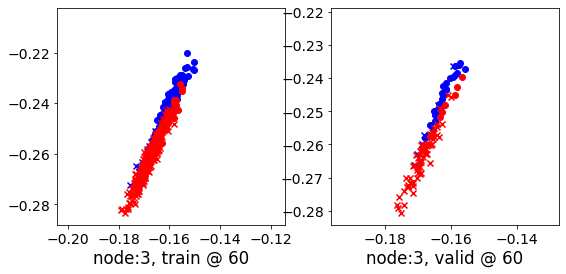

60 	 4 	 0.69716322 	 0.68645465 	 0.95475882 	 0.94621259 	 0.95078880 	 0.95290512


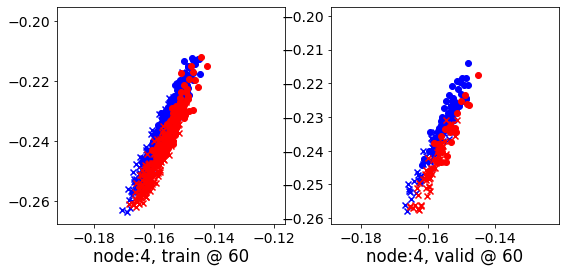

60 	 5 	 0.62421459 	 0.63437450 	 0.92254859 	 0.93170595 	 0.99174094 	 0.99047863


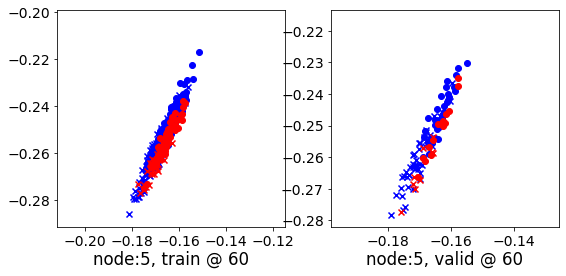

Aggregating on epoch: 62...
Aggregating on epoch: 64...
Aggregating on epoch: 66...
Aggregating on epoch: 68...
Aggregating on epoch: 70...
Aggregating on epoch: 72...
Aggregating on epoch: 74...
Aggregating on epoch: 76...
Aggregating on epoch: 78...
Aggregating on epoch: 80...
80 	 0 	 0.71765697 	 0.71745420 	 0.94745177 	 0.94706488 	 0.92303658 	 0.92275786


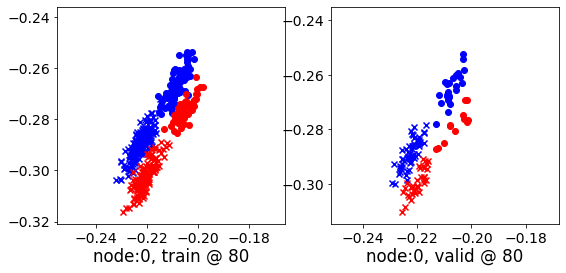

80 	 1 	 0.68129504 	 0.67558217 	 0.93317229 	 0.93236351 	 0.94504952 	 0.94992852


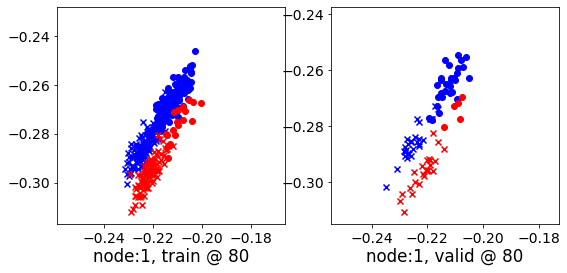

80 	 2 	 0.71872765 	 0.69063640 	 0.96728170 	 0.95014131 	 0.94173330 	 0.95265210


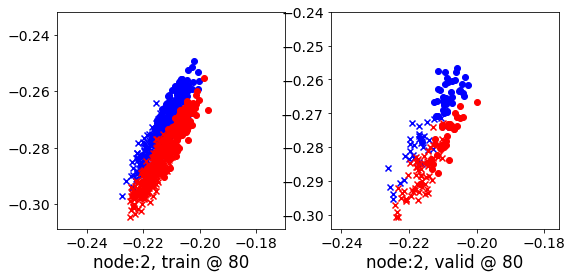

80 	 3 	 0.68334424 	 0.69151920 	 0.93188041 	 0.93907940 	 0.94168800 	 0.94070739


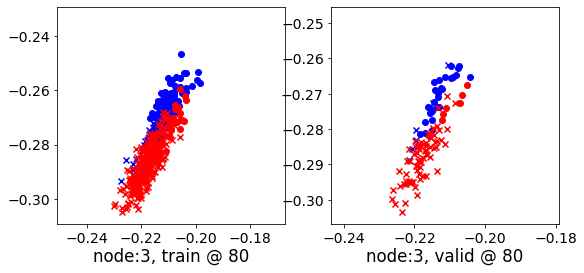

80 	 4 	 0.70046437 	 0.68654400 	 0.95671195 	 0.94612515 	 0.94941908 	 0.95272833


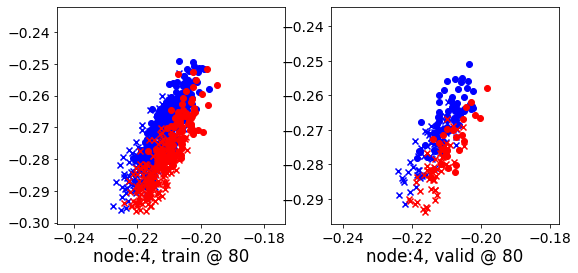

80 	 5 	 0.62333292 	 0.63544607 	 0.89944571 	 0.91065872 	 0.96940768 	 0.96835983


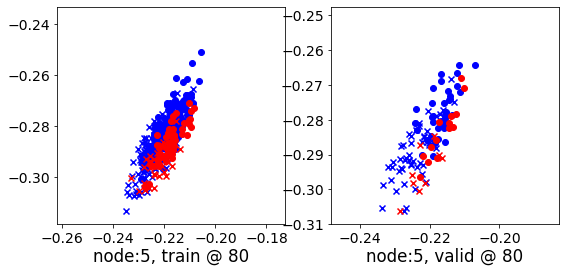

Aggregating on epoch: 82...
Aggregating on epoch: 84...
Aggregating on epoch: 86...
Aggregating on epoch: 88...
Aggregating on epoch: 90...
Aggregating on epoch: 92...
Aggregating on epoch: 94...
Aggregating on epoch: 96...
Aggregating on epoch: 98...
Aggregating on epoch: 100...
100 	 0 	 0.71533334 	 0.71528655 	 0.94325686 	 0.94320488 	 0.92109871 	 0.92106551


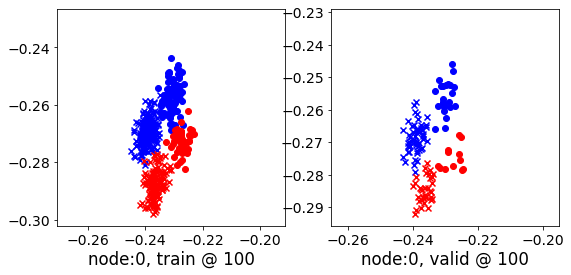

100 	 1 	 0.68135715 	 0.67486602 	 0.93255913 	 0.93171018 	 0.94439310 	 0.94999135


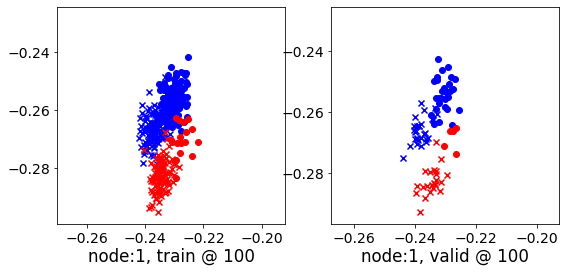

100 	 2 	 0.70605052 	 0.69025195 	 0.95373505 	 0.94970930 	 0.94091344 	 0.95260453


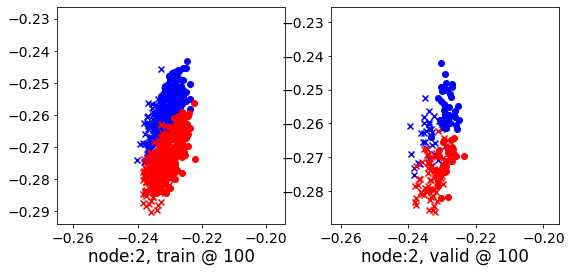

100 	 3 	 0.68899673 	 0.69726622 	 0.92949653 	 0.93712640 	 0.93368596 	 0.93300736


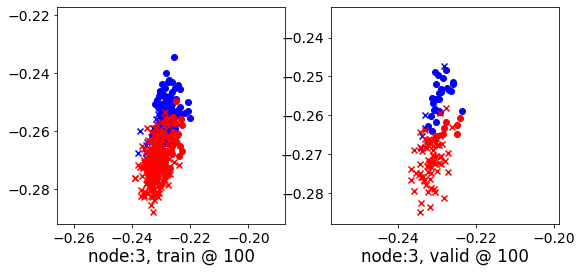

100 	 4 	 0.67852575 	 0.68621081 	 0.93552941 	 0.94582248 	 0.95016819 	 0.95275885


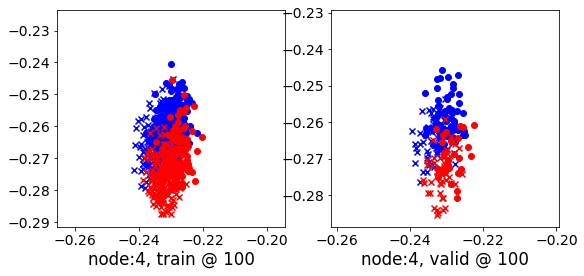

100 	 5 	 0.62678784 	 0.64070022 	 0.89041907 	 0.90390152 	 0.95682567 	 0.95634848


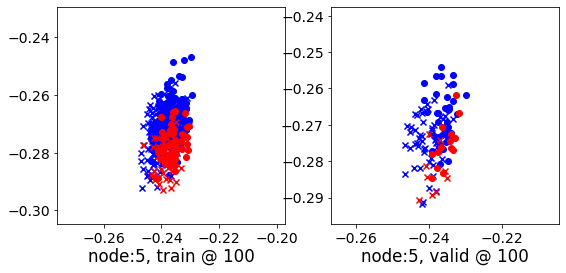

Aggregating on epoch: 102...
Aggregating on epoch: 104...
Aggregating on epoch: 106...
Aggregating on epoch: 108...
Aggregating on epoch: 110...
Aggregating on epoch: 112...
Aggregating on epoch: 114...
Aggregating on epoch: 116...
Aggregating on epoch: 118...
Aggregating on epoch: 120...
120 	 0 	 0.71438062 	 0.71441114 	 0.94250685 	 0.94251788 	 0.92130917 	 0.92125392


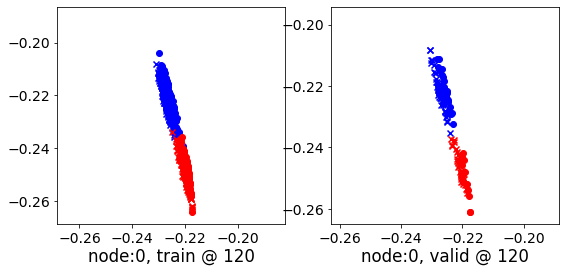

120 	 1 	 0.68047416 	 0.67389435 	 0.93194008 	 0.93102467 	 0.94467360 	 0.95027751


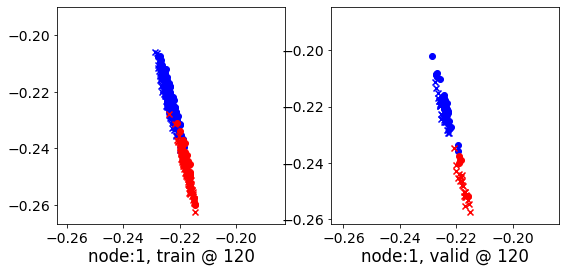

120 	 2 	 0.68296415 	 0.68949425 	 0.95264316 	 0.94928730 	 0.96289384 	 0.95294023


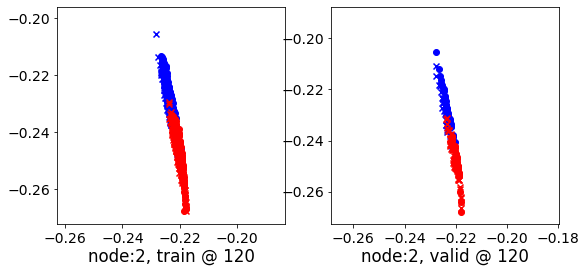

120 	 3 	 0.69072580 	 0.69913822 	 0.92936110 	 0.93719643 	 0.93180412 	 0.93120539


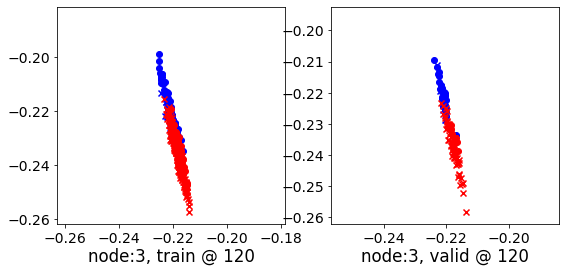

120 	 4 	 0.66747695 	 0.68575722 	 0.93679470 	 0.94542241 	 0.96248698 	 0.95281237


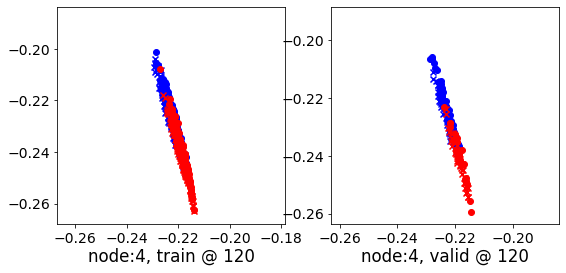

120 	 5 	 0.62799686 	 0.64224684 	 0.88932240 	 0.90331638 	 0.95447427 	 0.95421672


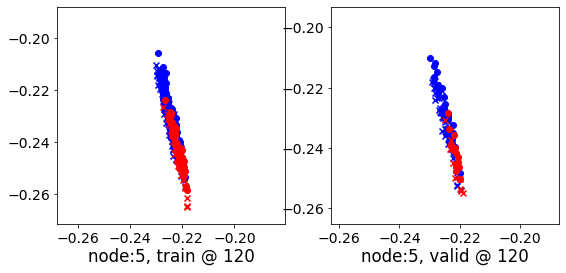

Aggregating on epoch: 122...
Aggregating on epoch: 124...
Aggregating on epoch: 126...
Aggregating on epoch: 128...
Aggregating on epoch: 130...
Aggregating on epoch: 132...
Aggregating on epoch: 134...
Aggregating on epoch: 136...
Aggregating on epoch: 138...
Aggregating on epoch: 140...
140 	 0 	 0.71350640 	 0.71362501 	 0.94174838 	 0.94180590 	 0.92146575 	 0.92132807


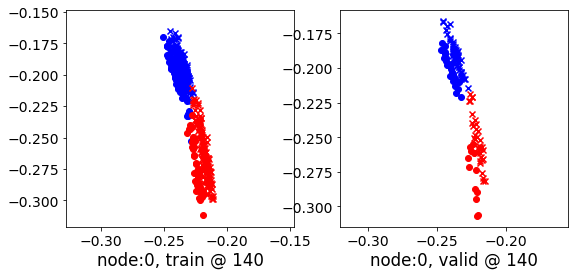

140 	 1 	 0.67763948 	 0.67079920 	 0.92887044 	 0.92766315 	 0.94457084 	 0.95001113


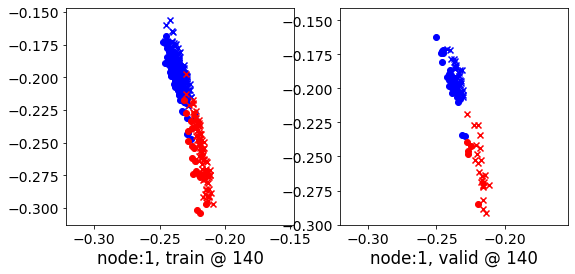

140 	 2 	 0.67196703 	 0.68435043 	 0.93179953 	 0.94465911 	 0.95337969 	 0.95345587


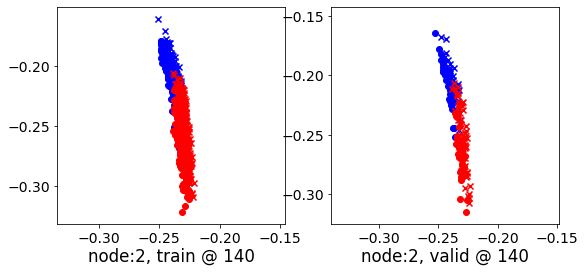

140 	 3 	 0.69071084 	 0.69932491 	 0.92891842 	 0.93678606 	 0.93137097 	 0.93060833


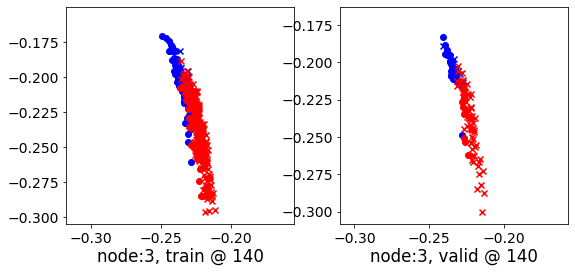

140 	 4 	 0.68424964 	 0.68321520 	 0.94203389 	 0.94285572 	 0.95109785 	 0.95278770


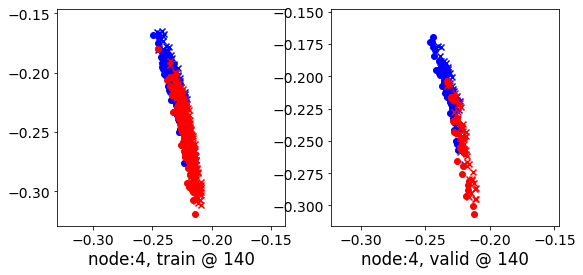

140 	 5 	 0.62773907 	 0.64215559 	 0.88906473 	 0.90316284 	 0.95448536 	 0.95415443


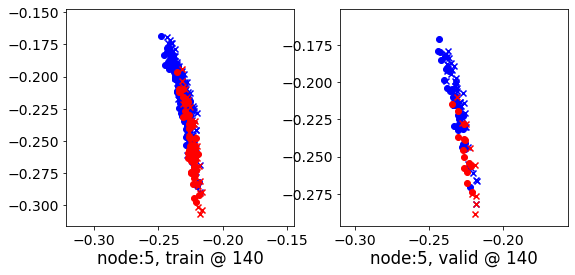

Aggregating on epoch: 142...
Aggregating on epoch: 144...
Aggregating on epoch: 146...
Aggregating on epoch: 148...
Aggregating on epoch: 150...
Aggregating on epoch: 152...
Aggregating on epoch: 154...
Aggregating on epoch: 156...
Aggregating on epoch: 158...
Aggregating on epoch: 160...
160 	 0 	 0.70880973 	 0.70911121 	 0.93691897 	 0.93707192 	 0.92151237 	 0.92110789


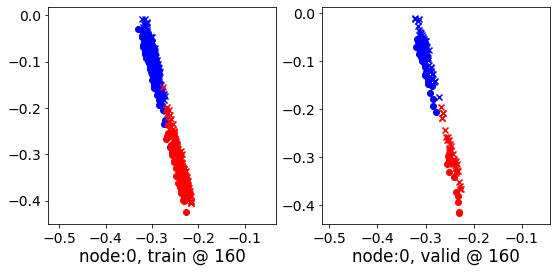

160 	 1 	 0.65679955 	 0.64639515 	 0.90529978 	 0.90078402 	 0.94262761 	 0.94753605


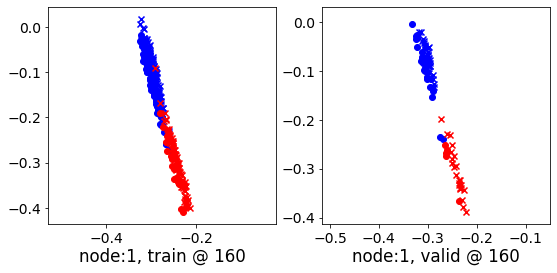

160 	 2 	 0.65898472 	 0.64549905 	 0.91589934 	 0.90596151 	 0.95224094 	 0.95360965


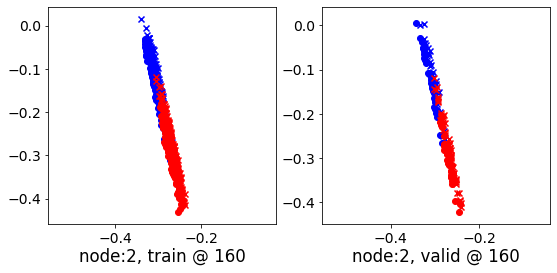

160 	 3 	 0.69023776 	 0.69887787 	 0.92590189 	 0.93309563 	 0.92893010 	 0.92736495


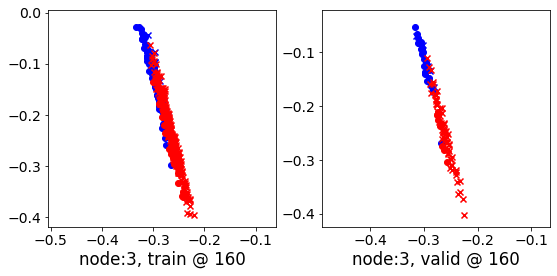

160 	 4 	 0.66403657 	 0.66038704 	 0.92373776 	 0.91944981 	 0.95391136 	 0.95220995


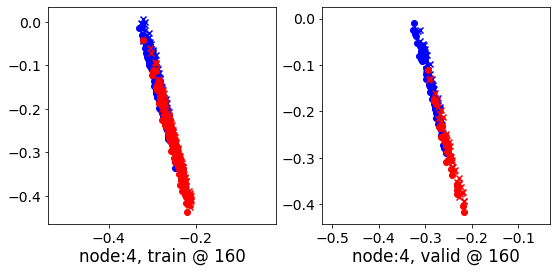

160 	 5 	 0.62541801 	 0.63938874 	 0.88677514 	 0.90048444 	 0.95455706 	 0.95424289


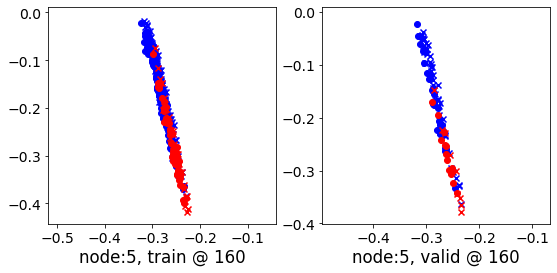

Aggregating on epoch: 162...
Aggregating on epoch: 164...
Aggregating on epoch: 166...
Aggregating on epoch: 168...
Aggregating on epoch: 170...
Aggregating on epoch: 172...
Aggregating on epoch: 174...
Aggregating on epoch: 176...
Aggregating on epoch: 178...
Aggregating on epoch: 180...
180 	 0 	 0.68142420 	 0.68214834 	 0.90814090 	 0.90843213 	 0.92100561 	 0.91943097


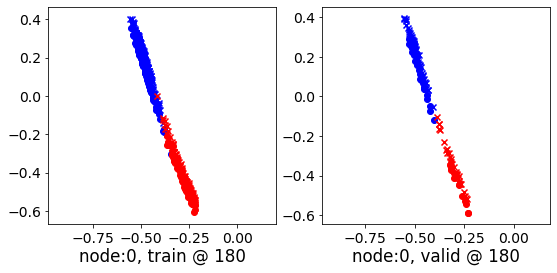

180 	 1 	 0.55869567 	 0.53192735 	 0.79722112 	 0.77679688 	 0.93458337 	 0.93801671


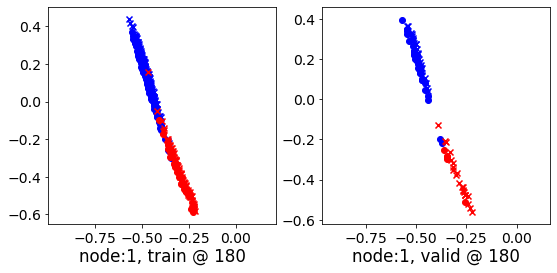

180 	 2 	 0.43205279 	 0.44378155 	 0.69142234 	 0.70426565 	 0.95870191 	 0.95363128


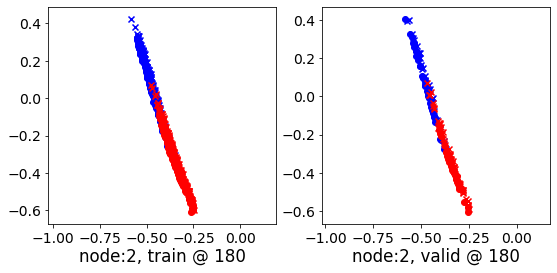

180 	 3 	 0.68442011 	 0.69221616 	 0.91102219 	 0.91506088 	 0.92018920 	 0.91599190


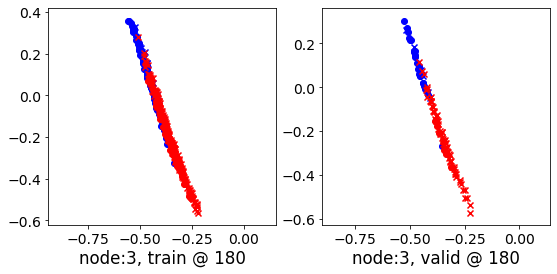

180 	 4 	 0.50516021 	 0.50557387 	 0.76037973 	 0.76317626 	 0.95161855 	 0.95074958


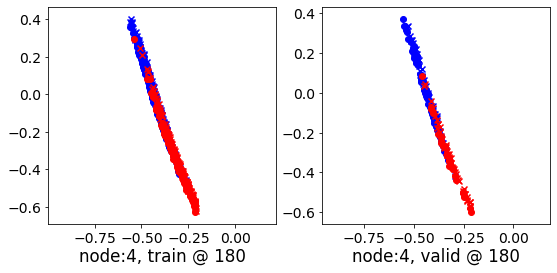

180 	 5 	 0.61034614 	 0.62093157 	 0.87045103 	 0.88118219 	 0.95390445 	 0.95339781


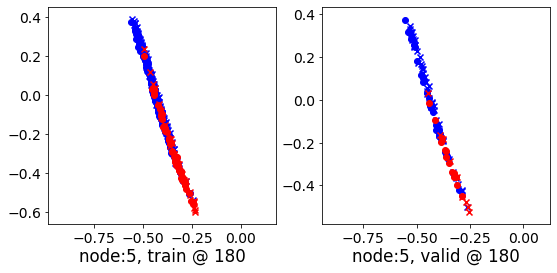

Aggregating on epoch: 182...
Aggregating on epoch: 184...
Aggregating on epoch: 186...
Aggregating on epoch: 188...
Aggregating on epoch: 190...
Aggregating on epoch: 192...
Aggregating on epoch: 194...
Aggregating on epoch: 196...
Aggregating on epoch: 198...
Aggregating on epoch: 200...
200 	 0 	 0.58557487 	 0.58428597 	 0.81191266 	 0.81098962 	 0.92208159 	 0.91985083


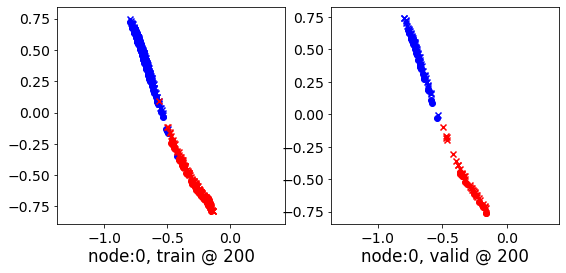

200 	 1 	 0.32100213 	 0.27180299 	 0.53478301 	 0.49116543 	 0.91111887 	 0.91250962


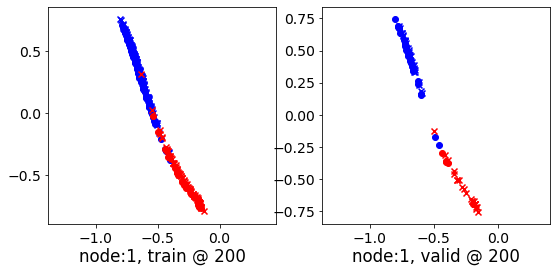

200 	 2 	 0.12789863 	 0.13021144 	 0.38824442 	 0.38977000 	 0.95767748 	 0.95270574


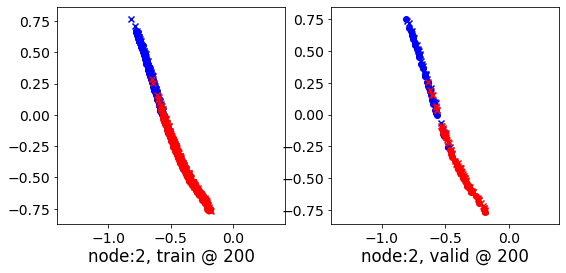

200 	 3 	 0.65409142 	 0.65637660 	 0.84761602 	 0.83776158 	 0.88754737 	 0.87453216


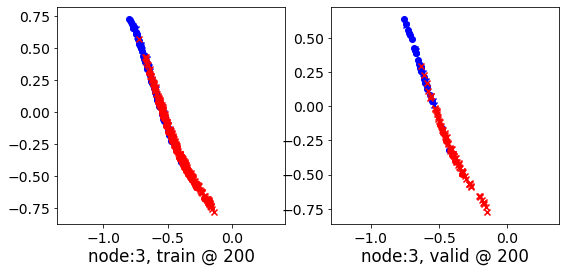

200 	 4 	 0.35628277 	 0.25965214 	 0.61751950 	 0.51193088 	 0.95604491 	 0.94542593


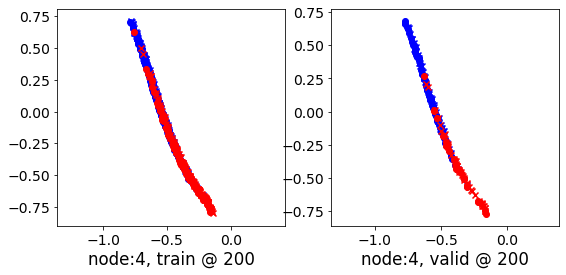

200 	 5 	 0.54006296 	 0.54229259 	 0.79521441 	 0.79717660 	 0.95077980 	 0.94803119


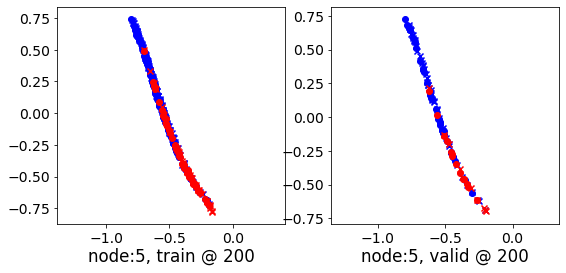

Aggregating on epoch: 202...
Aggregating on epoch: 204...
Aggregating on epoch: 206...
Aggregating on epoch: 208...
Aggregating on epoch: 210...
Aggregating on epoch: 212...
Aggregating on epoch: 214...
Aggregating on epoch: 216...
Aggregating on epoch: 218...
Aggregating on epoch: 220...
220 	 0 	 0.40589160 	 0.40057886 	 0.62915331 	 0.62775564 	 0.92085493 	 0.92032397


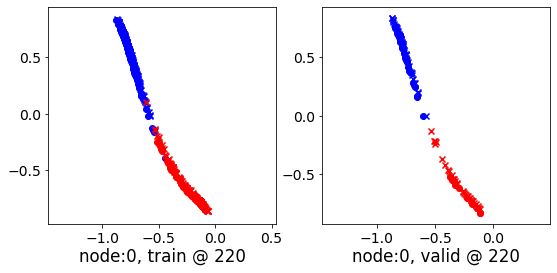

220 	 1 	 0.11618134 	 0.05737773 	 0.30234542 	 0.24744222 	 0.88338894 	 0.88321167


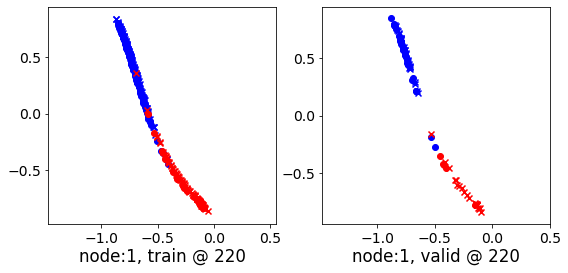

220 	 2 	 0.09280595 	 0.08159548 	 0.32302320 	 0.34064156 	 0.93856120 	 0.95219326


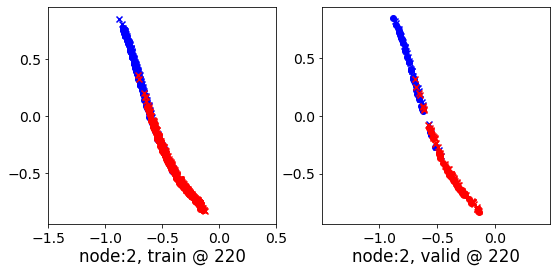

220 	 3 	 0.59574765 	 0.58458167 	 0.72638392 	 0.68592006 	 0.82544935 	 0.79448557


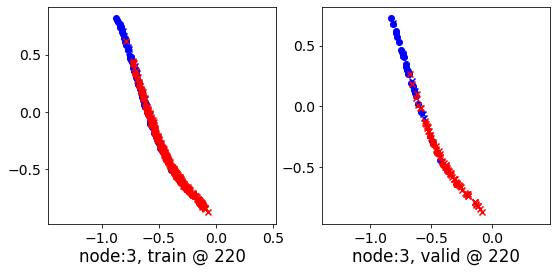

220 	 4 	 0.37818205 	 0.26044774 	 0.61212838 	 0.50218612 	 0.93210316 	 0.93488556


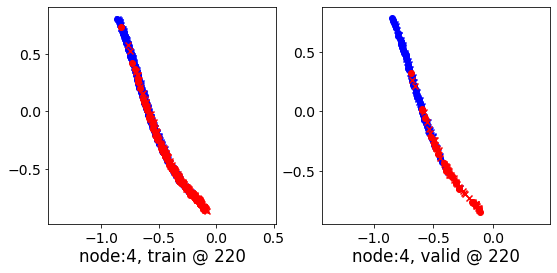

220 	 5 	 0.45272738 	 0.45012176 	 0.70450383 	 0.69888145 	 0.94887388 	 0.94190687


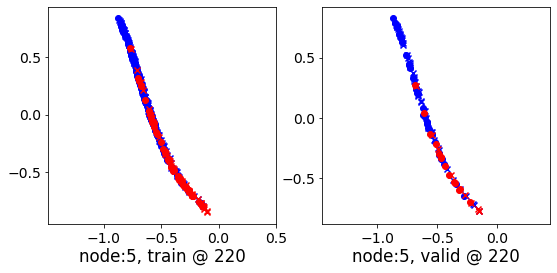

Aggregating on epoch: 222...
Aggregating on epoch: 224...
Aggregating on epoch: 226...
Aggregating on epoch: 228...
Aggregating on epoch: 230...
Aggregating on epoch: 232...
Aggregating on epoch: 234...
Aggregating on epoch: 236...
Aggregating on epoch: 238...
Aggregating on epoch: 240...
240 	 0 	 0.19093996 	 0.18436646 	 0.41169396 	 0.41110623 	 0.91804922 	 0.91988695


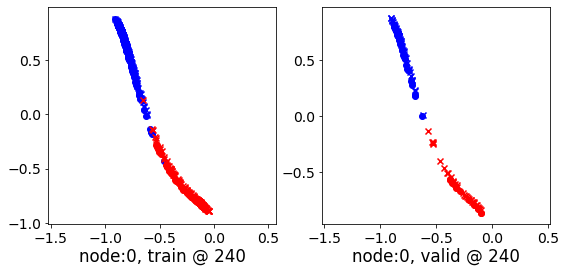

240 	 1 	 0.02181815 	 -0.04334743 	 0.19434556 	 0.13478504 	 0.87279373 	 0.87127966


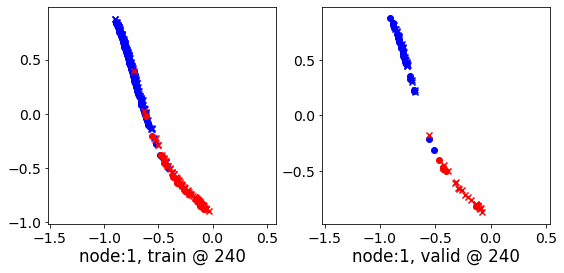

240 	 2 	 -0.01426111 	 0.08393565 	 0.24331830 	 0.34739813 	 0.94468647 	 0.95660967


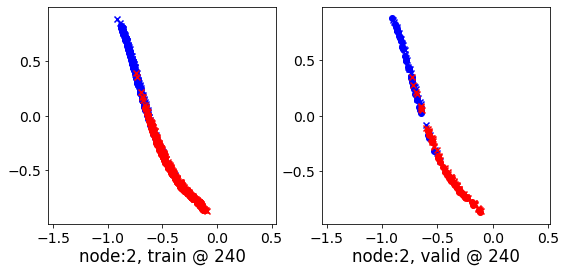

240 	 3 	 0.53881240 	 0.50718248 	 0.60707426 	 0.52052516 	 0.76560688 	 0.70648986


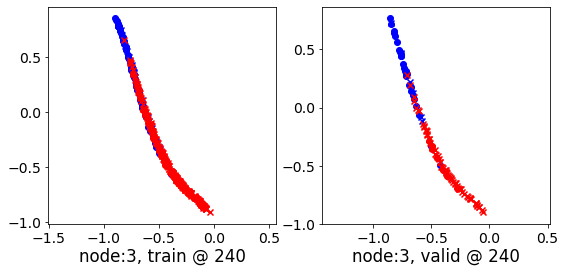

240 	 4 	 0.33908105 	 0.26579678 	 0.58687127 	 0.50632358 	 0.94265634 	 0.93367398


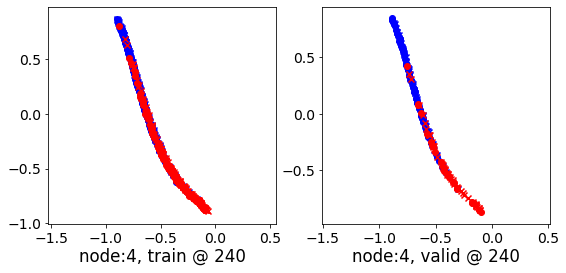

240 	 5 	 0.41000545 	 0.40355718 	 0.65880591 	 0.64811009 	 0.94724458 	 0.93770009


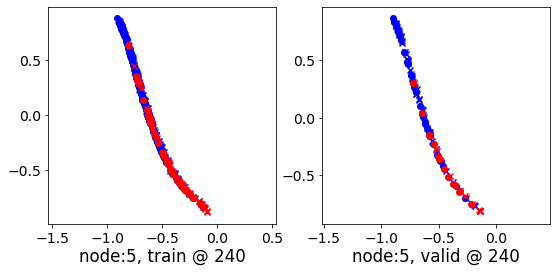

Aggregating on epoch: 242...
Aggregating on epoch: 244...
Aggregating on epoch: 246...
Aggregating on epoch: 248...
Aggregating on epoch: 250...
Aggregating on epoch: 252...
Aggregating on epoch: 254...
Aggregating on epoch: 256...
Aggregating on epoch: 258...
Aggregating on epoch: 260...
260 	 0 	 0.03281900 	 0.02440411 	 0.25250328 	 0.25133079 	 0.91554785 	 0.92007387


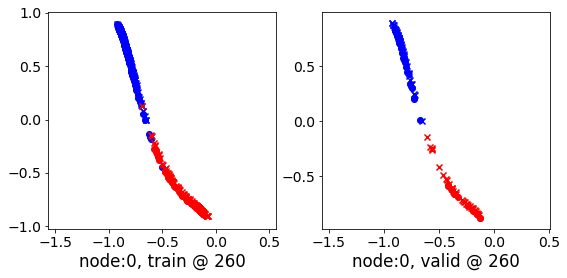

260 	 1 	 -0.00313205 	 -0.07413971 	 0.15977852 	 0.09647489 	 0.86799705 	 0.86376178


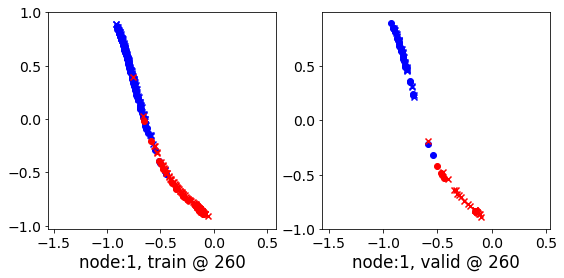

260 	 2 	 -0.06592168 	 0.07841408 	 0.17792971 	 0.34113681 	 0.93522149 	 0.95586991


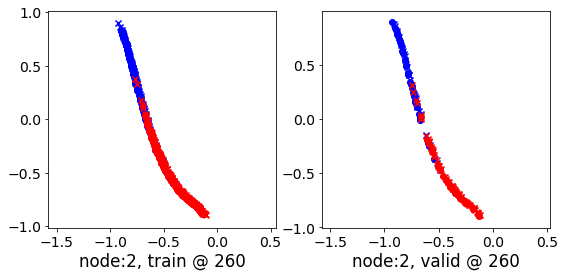

260 	 3 	 0.49739528 	 0.44105890 	 0.54480910 	 0.41586563 	 0.74687654 	 0.66795391


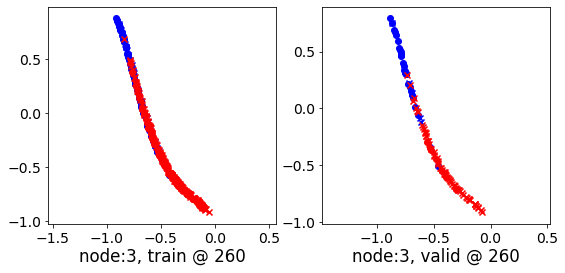

260 	 4 	 0.27160335 	 0.26200897 	 0.52494609 	 0.50160879 	 0.94674486 	 0.93274701


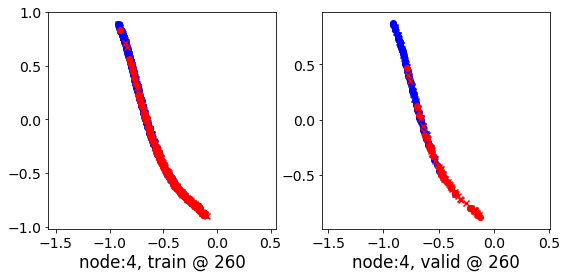

260 	 5 	 0.39448470 	 0.38885236 	 0.63996482 	 0.63217205 	 0.94699675 	 0.93646687


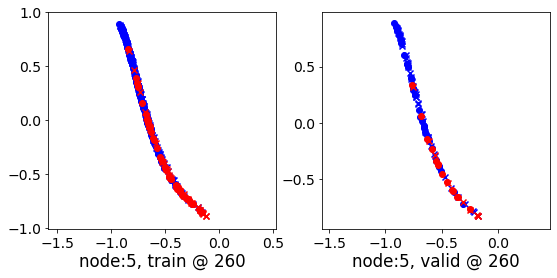

Aggregating on epoch: 262...
Aggregating on epoch: 264...
Aggregating on epoch: 266...
Aggregating on epoch: 268...
Aggregating on epoch: 270...
Aggregating on epoch: 272...
Aggregating on epoch: 274...
Aggregating on epoch: 276...
Aggregating on epoch: 278...
Aggregating on epoch: 280...
280 	 0 	 -0.05662909 	 -0.06940857 	 0.16181520 	 0.15840933 	 0.91346681 	 0.92096508


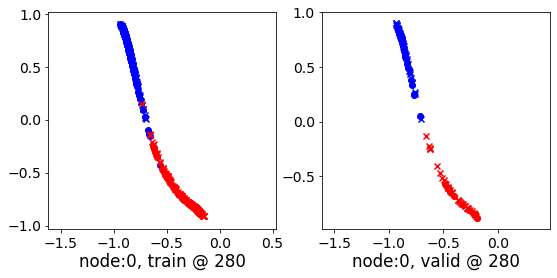

280 	 1 	 -0.01067413 	 -0.08271924 	 0.14905575 	 0.08193550 	 0.86549491 	 0.85780191


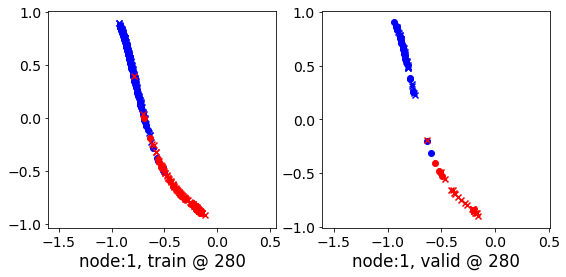

280 	 2 	 0.06242120 	 0.07729632 	 0.31148916 	 0.33804983 	 0.94496155 	 0.95390069


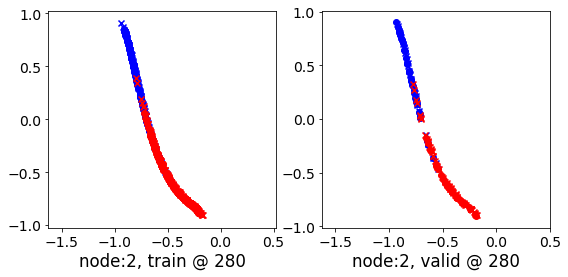

280 	 3 	 0.48278457 	 0.40908793 	 0.52399468 	 0.37674591 	 0.74090767 	 0.66080517


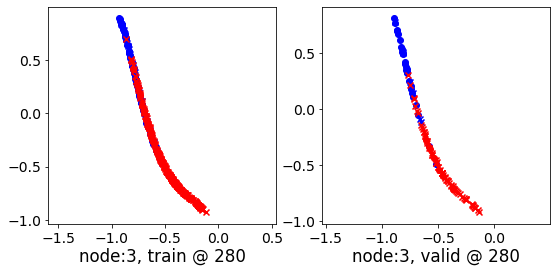

280 	 4 	 0.36221969 	 0.26096493 	 0.59843504 	 0.50086445 	 0.92878473 	 0.93304670


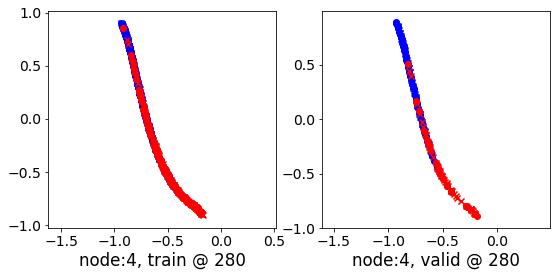

280 	 5 	 0.38474518 	 0.38673908 	 0.63196468 	 0.63030016 	 0.94713432 	 0.93670827


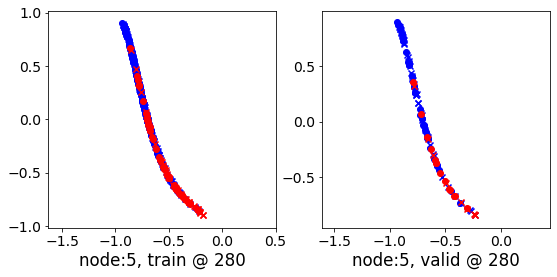

Aggregating on epoch: 282...
Aggregating on epoch: 284...
Aggregating on epoch: 286...
Aggregating on epoch: 288...
Aggregating on epoch: 290...
Aggregating on epoch: 292...
Aggregating on epoch: 294...
Aggregating on epoch: 296...
Aggregating on epoch: 298...
Aggregating on epoch: 300...
300 	 0 	 -0.10520872 	 -0.12373757 	 0.11183178 	 0.10593593 	 0.91193604 	 0.92282069


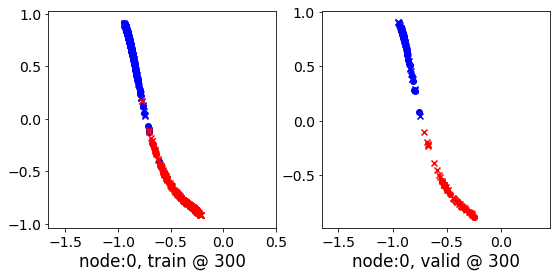

300 	 1 	 -0.01858479 	 -0.08637541 	 0.14424883 	 0.07400752 	 0.86498952 	 0.85353011


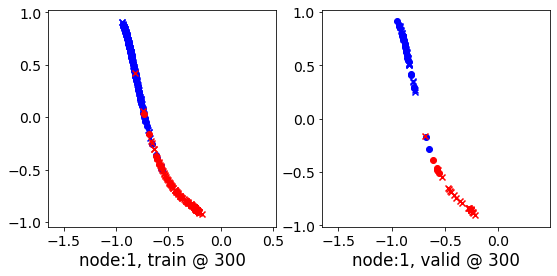

300 	 2 	 -0.01121184 	 0.07153258 	 0.25053898 	 0.33169165 	 0.95538992 	 0.95330626


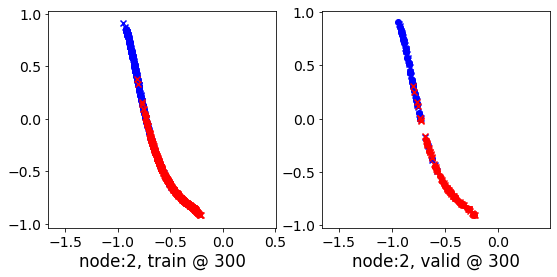

300 	 3 	 0.47848684 	 0.39978817 	 0.51644957 	 0.36794558 	 0.73792535 	 0.66130459


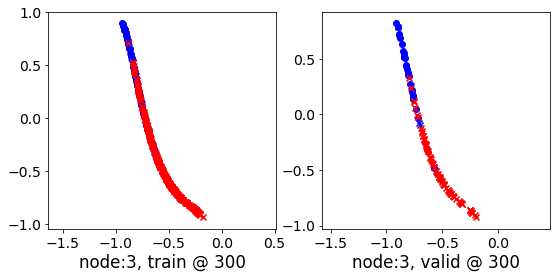

300 	 4 	 0.33121806 	 0.25842404 	 0.57529104 	 0.49721378 	 0.93771464 	 0.93193692


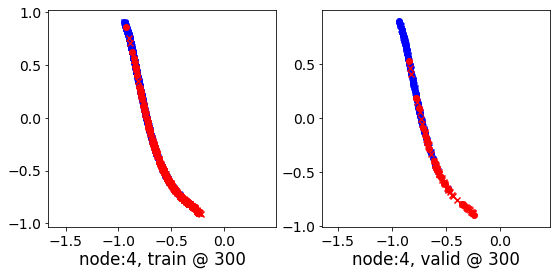

300 	 5 	 0.37872231 	 0.38923234 	 0.62901348 	 0.63266689 	 0.94719809 	 0.93658173


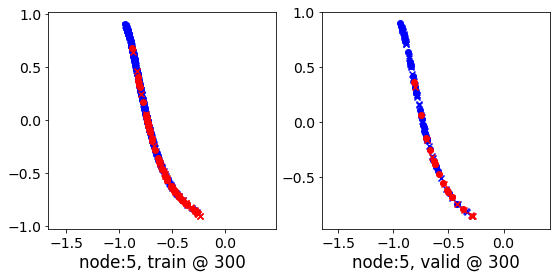

Aggregating on epoch: 302...
Aggregating on epoch: 304...
Aggregating on epoch: 306...
Aggregating on epoch: 308...
Aggregating on epoch: 310...
Aggregating on epoch: 312...
Aggregating on epoch: 314...
Aggregating on epoch: 316...
Aggregating on epoch: 318...
Aggregating on epoch: 320...
320 	 0 	 -0.13052420 	 -0.15401979 	 0.08543001 	 0.07790320 	 0.91106838 	 0.92507017


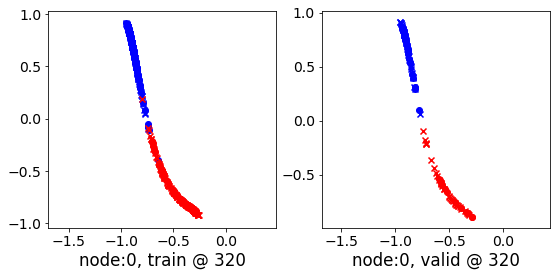

320 	 1 	 -0.02593774 	 -0.08940448 	 0.14145133 	 0.06935529 	 0.86535573 	 0.85190696


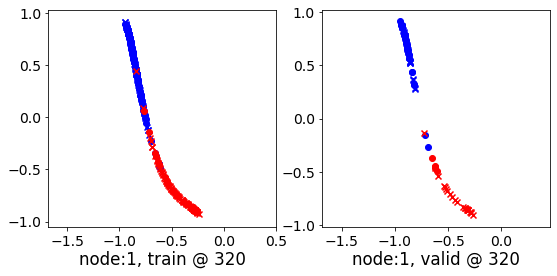

320 	 2 	 0.15661356 	 0.06973788 	 0.40328765 	 0.33155993 	 0.94022578 	 0.95496923


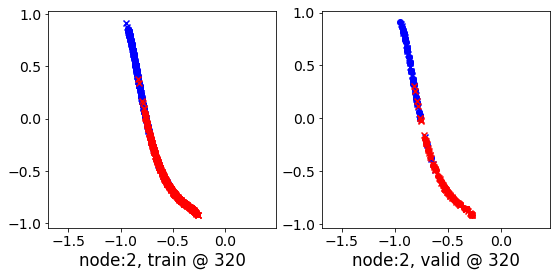

320 	 3 	 0.47376651 	 0.39801726 	 0.51157665 	 0.36625555 	 0.73626882 	 0.66138548


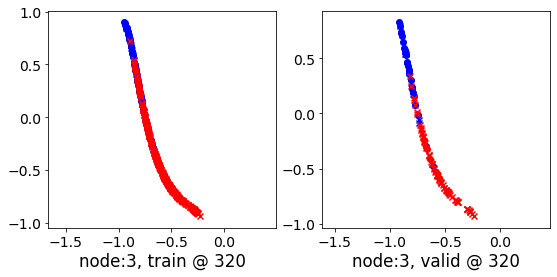

320 	 4 	 0.35254931 	 0.25990960 	 0.57905924 	 0.49925914 	 0.92131209 	 0.93249673


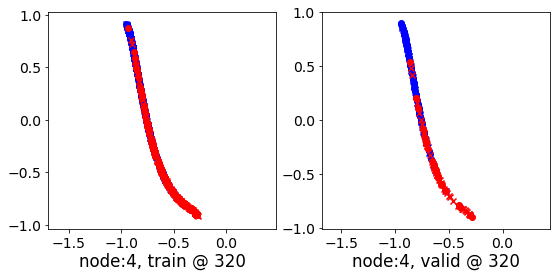

320 	 5 	 0.37625504 	 0.39160985 	 0.62782896 	 0.63490814 	 0.94707406 	 0.93644547


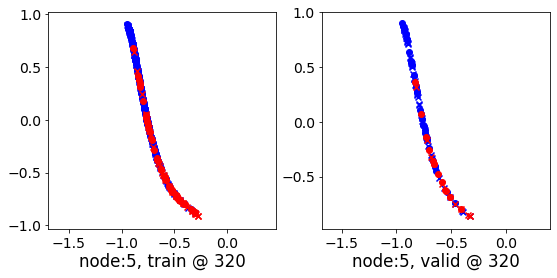

Aggregating on epoch: 322...
Aggregating on epoch: 324...
Aggregating on epoch: 326...
Aggregating on epoch: 328...
Aggregating on epoch: 330...
Aggregating on epoch: 332...
Aggregating on epoch: 334...
Aggregating on epoch: 336...
Aggregating on epoch: 338...
Aggregating on epoch: 340...
340 	 0 	 -0.14388785 	 -0.17347968 	 0.07134786 	 0.06172264 	 0.91069847 	 0.92834949


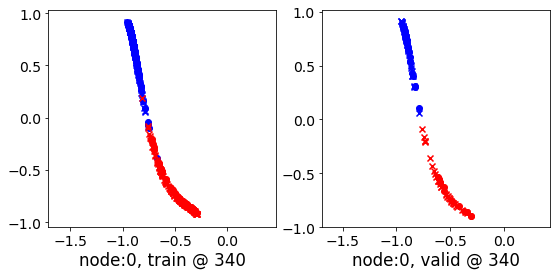

340 	 1 	 -0.03066497 	 -0.09336112 	 0.13989259 	 0.06610831 	 0.86598384 	 0.85261661


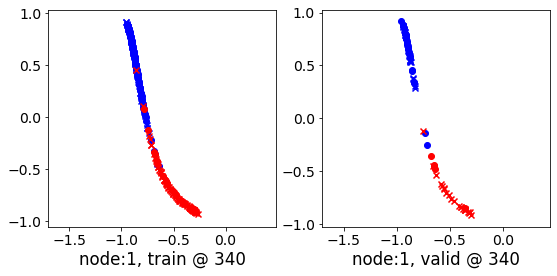

340 	 2 	 -0.01985760 	 0.06783792 	 0.23083527 	 0.32921484 	 0.94701451 	 0.95452410


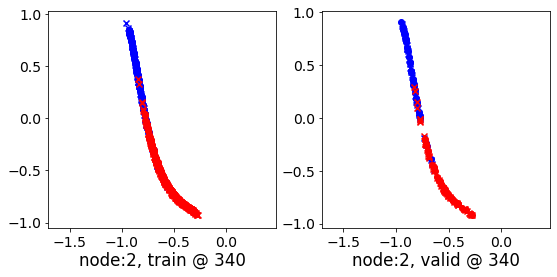

340 	 3 	 0.46877468 	 0.39767146 	 0.50828099 	 0.36655492 	 0.73604333 	 0.66203064


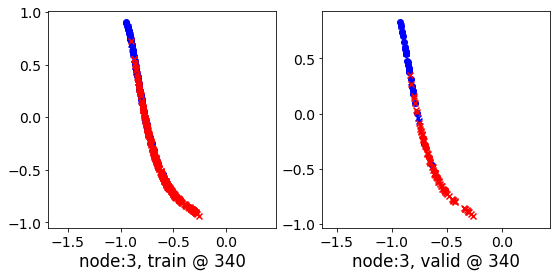

340 	 4 	 0.36480957 	 0.25880778 	 0.63329339 	 0.49847859 	 0.96164793 	 0.93281800


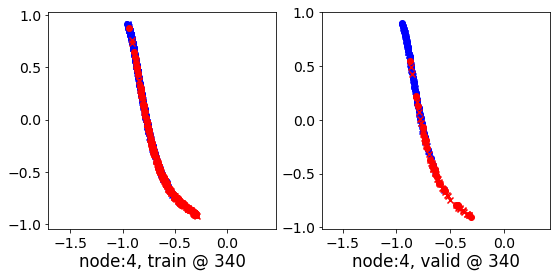

340 	 5 	 0.37556100 	 0.39375871 	 0.62745529 	 0.63671070 	 0.94683057 	 0.93609917


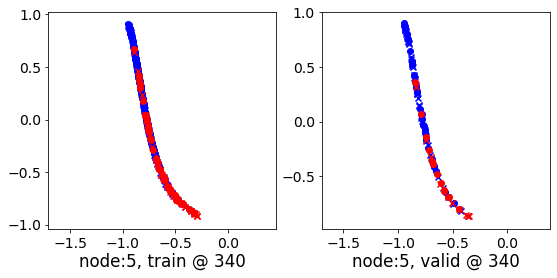

Aggregating on epoch: 342...
Aggregating on epoch: 344...
Aggregating on epoch: 346...
Aggregating on epoch: 348...
Aggregating on epoch: 350...
Aggregating on epoch: 352...
Aggregating on epoch: 354...
Aggregating on epoch: 356...
Aggregating on epoch: 358...
Aggregating on epoch: 360...
360 	 0 	 -0.15251544 	 -0.18684256 	 0.06303376 	 0.05222093 	 0.91067493 	 0.93221068


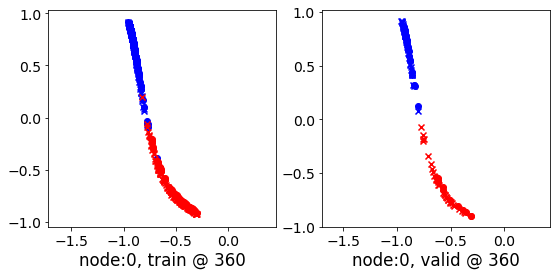

360 	 1 	 -0.03315969 	 -0.09461350 	 0.13965669 	 0.06565278 	 0.86716759 	 0.85341346


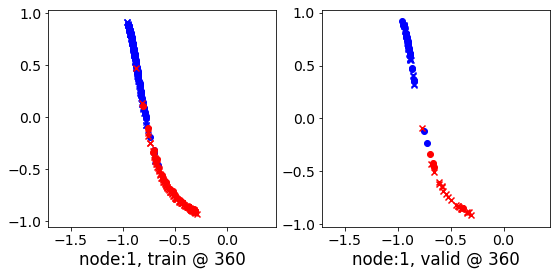

360 	 2 	 0.07914767 	 0.06735829 	 0.32845321 	 0.32962909 	 0.94221497 	 0.95541799


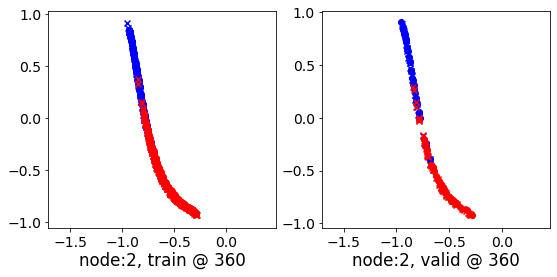

360 	 3 	 0.46620429 	 0.39768648 	 0.50827986 	 0.36893773 	 0.73748678 	 0.66439843


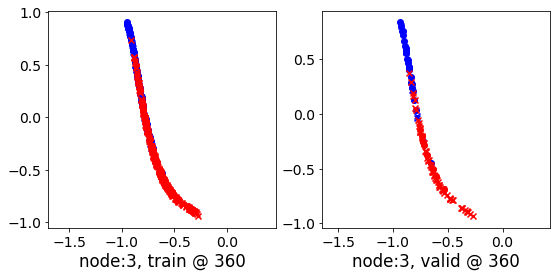

360 	 4 	 0.34153014 	 0.25978041 	 0.58428520 	 0.50014174 	 0.93597287 	 0.93350852


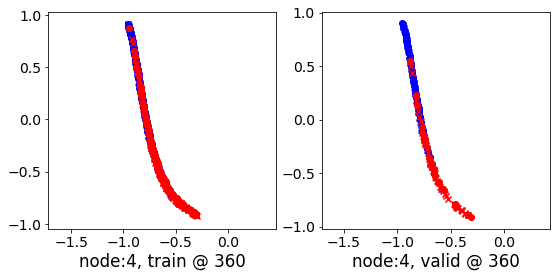

360 	 5 	 0.37499380 	 0.39599359 	 0.62707484 	 0.63803023 	 0.94622225 	 0.93518382


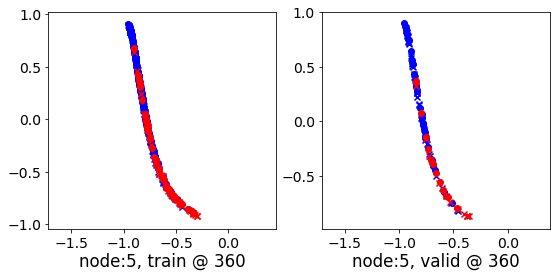

Aggregating on epoch: 362...
Aggregating on epoch: 364...
Aggregating on epoch: 366...
Aggregating on epoch: 368...
Aggregating on epoch: 370...
Aggregating on epoch: 372...
Aggregating on epoch: 374...
Aggregating on epoch: 376...
Aggregating on epoch: 378...
Aggregating on epoch: 380...
380 	 0 	 -0.15784588 	 -0.19670549 	 0.05795205 	 0.04526076 	 0.91116118 	 0.93511343


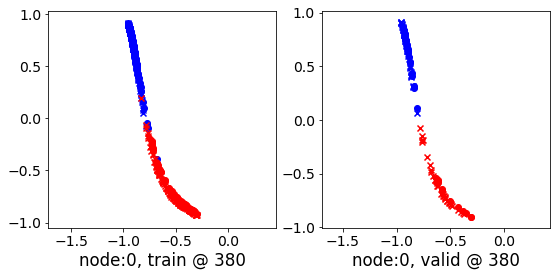

380 	 1 	 -0.03492036 	 -0.09711179 	 0.13936973 	 0.06458625 	 0.86773056 	 0.85484523


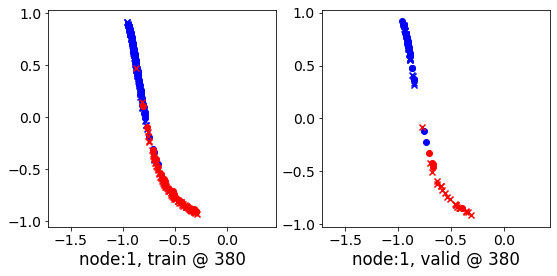

380 	 2 	 0.09179977 	 0.06686664 	 0.32386413 	 0.32842690 	 0.92118186 	 0.95470744


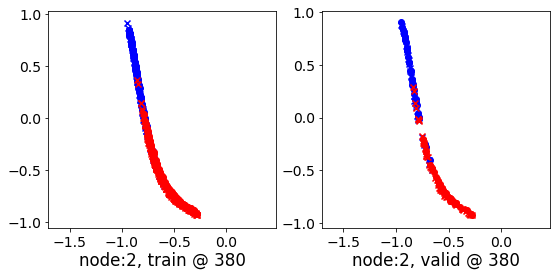

380 	 3 	 0.46377033 	 0.39788628 	 0.50740939 	 0.36983281 	 0.73791003 	 0.66509372


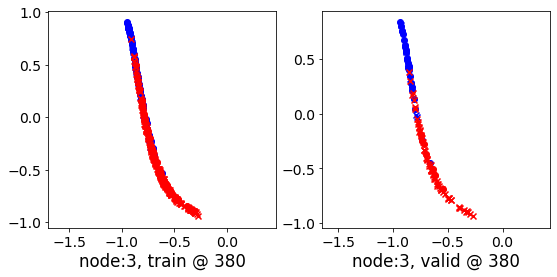

380 	 4 	 0.33062011 	 0.25727004 	 0.58524013 	 0.49815184 	 0.94744807 	 0.93402898


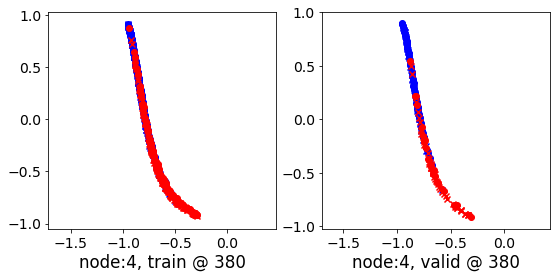

380 	 5 	 0.37508601 	 0.39730906 	 0.62712294 	 0.63824832 	 0.94582409 	 0.93408644


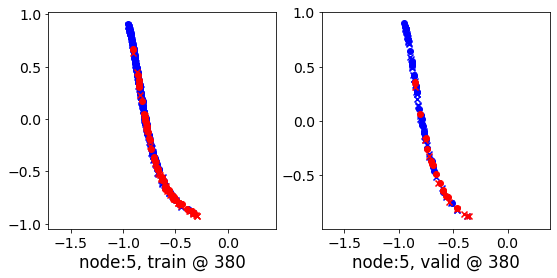

Aggregating on epoch: 382...
Aggregating on epoch: 384...
Aggregating on epoch: 386...
Aggregating on epoch: 388...
Aggregating on epoch: 390...
Aggregating on epoch: 392...
Aggregating on epoch: 394...
Aggregating on epoch: 396...
Aggregating on epoch: 398...
Aggregating on epoch: 400...
400 	 0 	 -0.16217236 	 -0.20282899 	 0.05438299 	 0.04095771 	 0.91169405 	 0.93693388


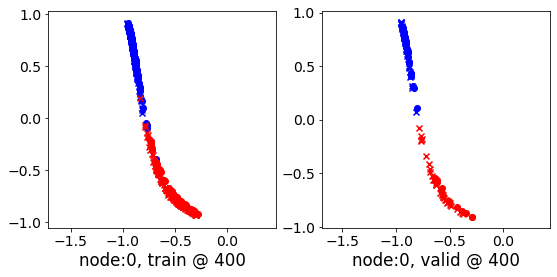

400 	 1 	 -0.03545716 	 -0.09868006 	 0.13913856 	 0.06427200 	 0.86792535 	 0.85609925


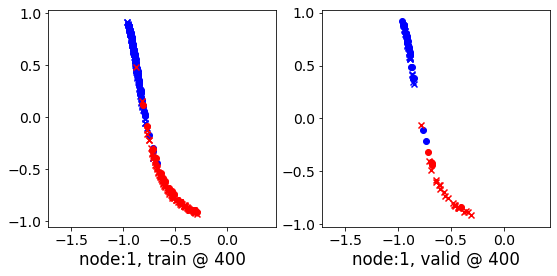

400 	 2 	 0.11610138 	 0.07001820 	 0.35957843 	 0.33159283 	 0.93826216 	 0.95472181


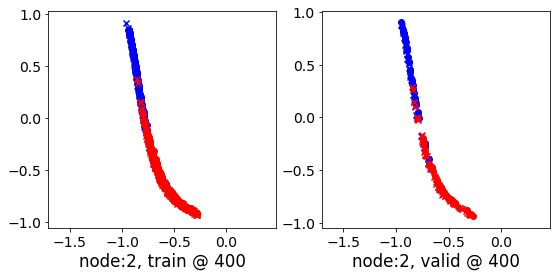

400 	 3 	 0.46291983 	 0.39909318 	 0.50706059 	 0.37143698 	 0.73822457 	 0.66549098


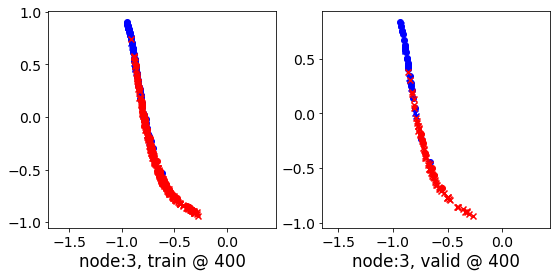

400 	 4 	 0.31849307 	 0.25850937 	 0.57596827 	 0.49968645 	 0.95074278 	 0.93432426


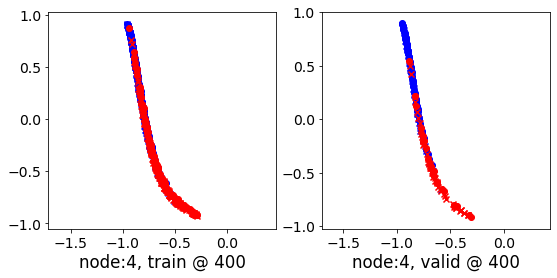

400 	 5 	 0.37487805 	 0.39774531 	 0.62676764 	 0.63845319 	 0.94529575 	 0.93385506


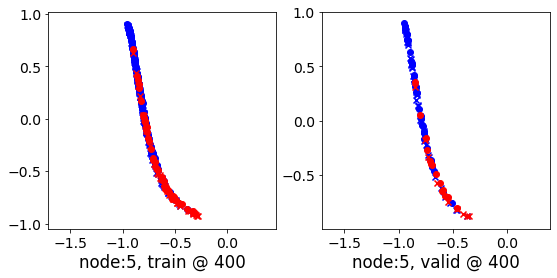

Aggregating on epoch: 402...
Aggregating on epoch: 404...
Aggregating on epoch: 406...
Aggregating on epoch: 408...
Aggregating on epoch: 410...
Aggregating on epoch: 412...
Aggregating on epoch: 414...
Aggregating on epoch: 416...
Aggregating on epoch: 418...
Aggregating on epoch: 420...
420 	 0 	 -0.16535395 	 -0.20725629 	 0.05168085 	 0.03740719 	 0.91208386 	 0.93781066


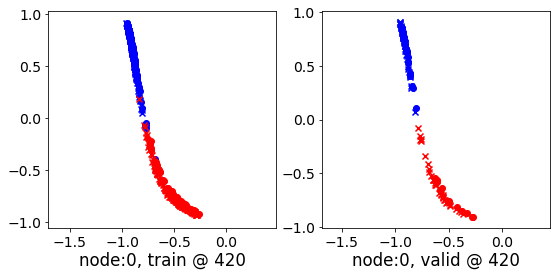

420 	 1 	 -0.03505522 	 -0.09969917 	 0.13883808 	 0.06366280 	 0.86733031 	 0.85650915


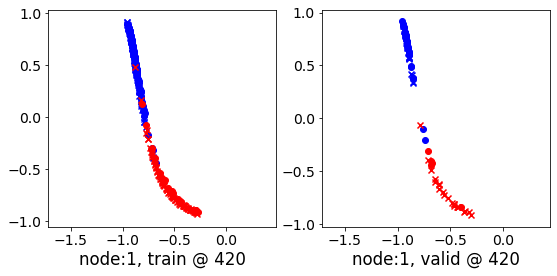

420 	 2 	 -0.04834831 	 0.07097682 	 0.22155190 	 0.33140060 	 0.96412146 	 0.95357096


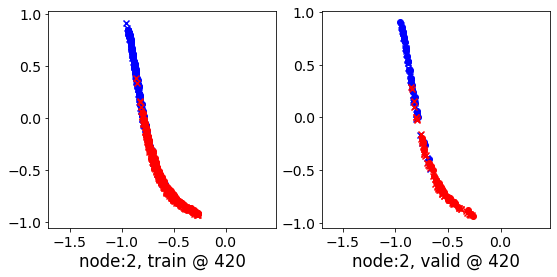

420 	 3 	 0.46227336 	 0.39966607 	 0.50577039 	 0.37144738 	 0.73746479 	 0.66492850


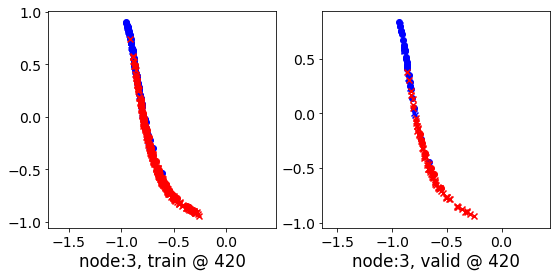

420 	 4 	 0.38118798 	 0.26046389 	 0.62446564 	 0.50250053 	 0.93595362 	 0.93518382


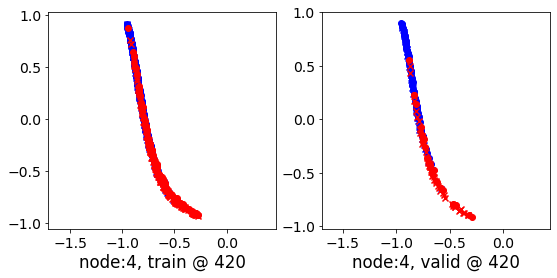

420 	 5 	 0.37504637 	 0.39864105 	 0.62649667 	 0.63868642 	 0.94496977 	 0.93319255


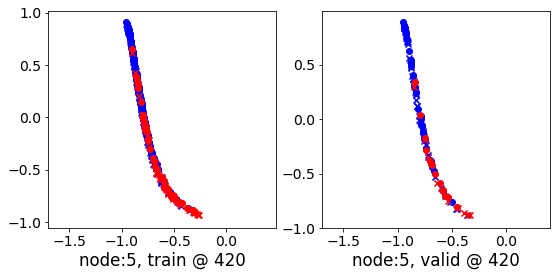

Aggregating on epoch: 422...
Aggregating on epoch: 424...
Aggregating on epoch: 426...
Aggregating on epoch: 428...
Aggregating on epoch: 430...
Aggregating on epoch: 432...
Aggregating on epoch: 434...
Aggregating on epoch: 436...
Aggregating on epoch: 438...
Aggregating on epoch: 440...
440 	 0 	 -0.16737524 	 -0.21116140 	 0.04982343 	 0.03417656 	 0.91244072 	 0.93848515


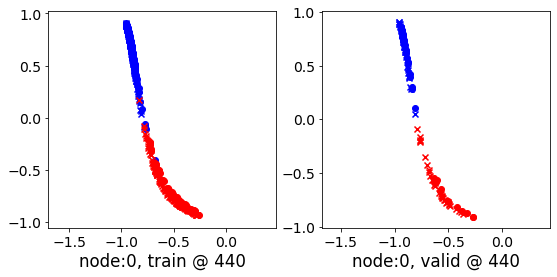

440 	 1 	 -0.03372903 	 -0.10108821 	 0.13870531 	 0.06272216 	 0.86650521 	 0.85695755


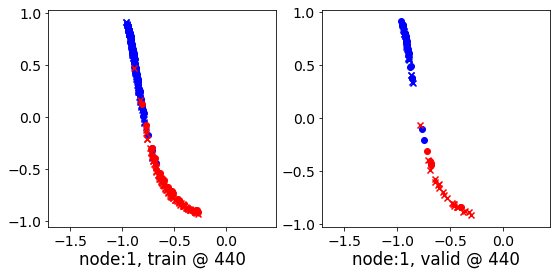

440 	 2 	 0.11114869 	 0.06809011 	 0.38208592 	 0.32832214 	 0.96211886 	 0.95337921


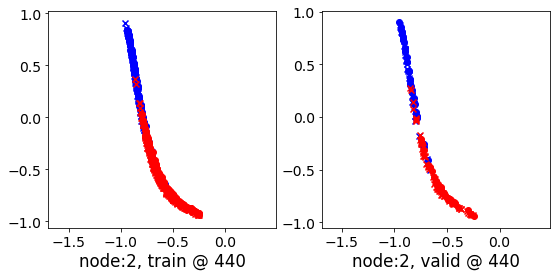

440 	 3 	 0.46141833 	 0.39955014 	 0.50396425 	 0.37072766 	 0.73625571 	 0.66432470


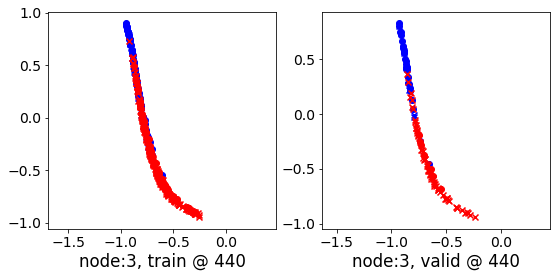

440 	 4 	 0.35544342 	 0.25725842 	 0.58900118 	 0.49902743 	 0.92744601 	 0.93491620


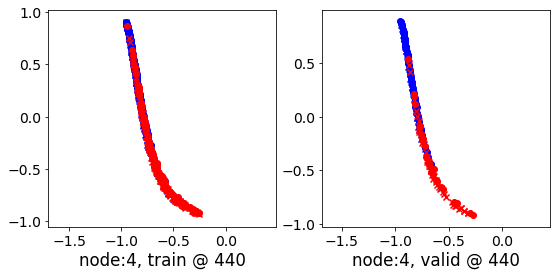

440 	 5 	 0.37555277 	 0.39900410 	 0.62625337 	 0.63869458 	 0.94477361 	 0.93283767


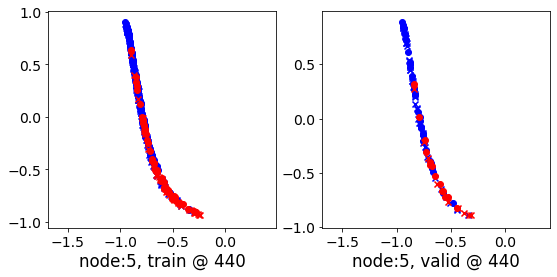

Aggregating on epoch: 442...
Aggregating on epoch: 444...
Aggregating on epoch: 446...
Aggregating on epoch: 448...
Aggregating on epoch: 450...
Aggregating on epoch: 452...
Aggregating on epoch: 454...
Aggregating on epoch: 456...
Aggregating on epoch: 458...
Aggregating on epoch: 460...
460 	 0 	 -0.16931310 	 -0.21376078 	 0.04821947 	 0.03186555 	 0.91251409 	 0.93877351


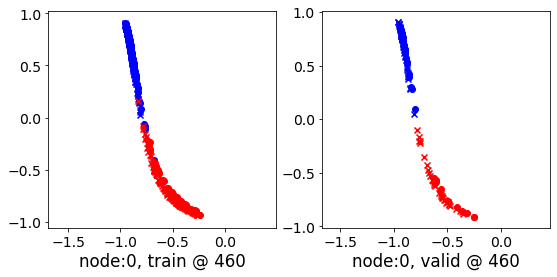

460 	 1 	 -0.03199278 	 -0.10119700 	 0.13845918 	 0.06217743 	 0.86546826 	 0.85652161


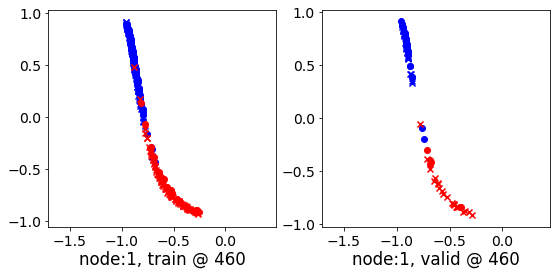

460 	 2 	 0.06237447 	 0.07039443 	 0.33142659 	 0.33032921 	 0.96106702 	 0.95308197


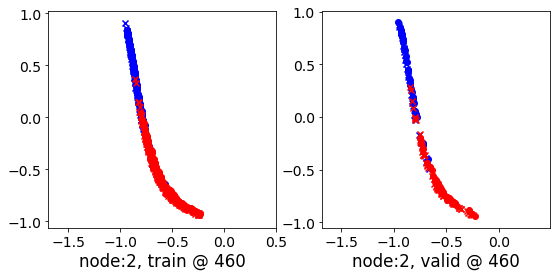

460 	 3 	 0.46093708 	 0.40045938 	 0.50258291 	 0.37087557 	 0.73539031 	 0.66356337


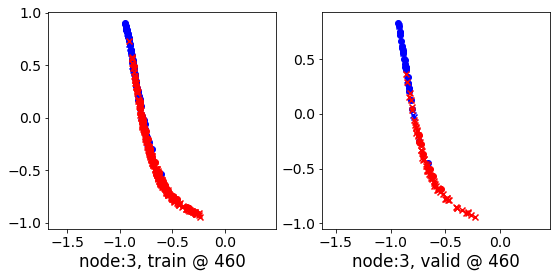

460 	 4 	 0.33853763 	 0.25707835 	 0.58897334 	 0.49932772 	 0.94317371 	 0.93539655


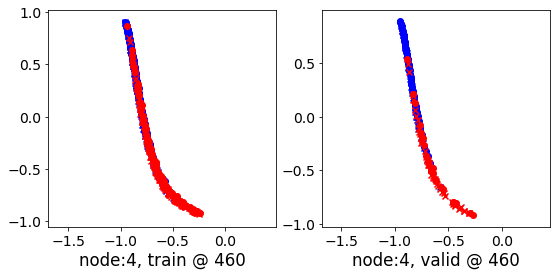

460 	 5 	 0.37666190 	 0.39906687 	 0.62611622 	 0.63938719 	 0.94455504 	 0.93346751


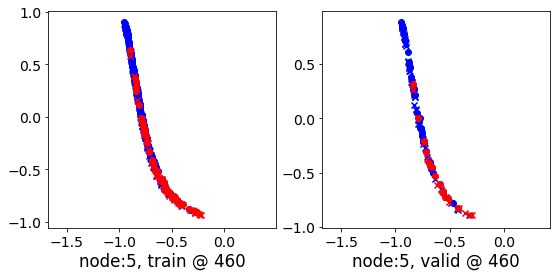

Aggregating on epoch: 462...
Aggregating on epoch: 464...
Aggregating on epoch: 466...
Aggregating on epoch: 468...
Aggregating on epoch: 470...
Aggregating on epoch: 472...
Aggregating on epoch: 474...
Aggregating on epoch: 476...
Aggregating on epoch: 478...
Aggregating on epoch: 480...
480 	 0 	 -0.17134741 	 -0.21519771 	 0.04677719 	 0.03059646 	 0.91248250 	 0.93894136


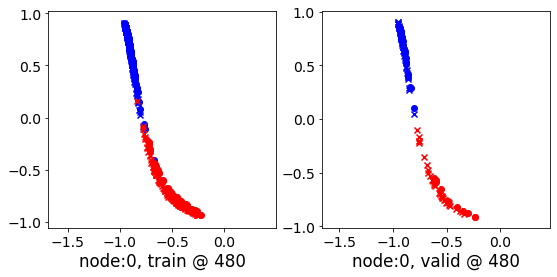

480 	 1 	 -0.03079252 	 -0.10112385 	 0.13808720 	 0.06191297 	 0.86456954 	 0.85618401


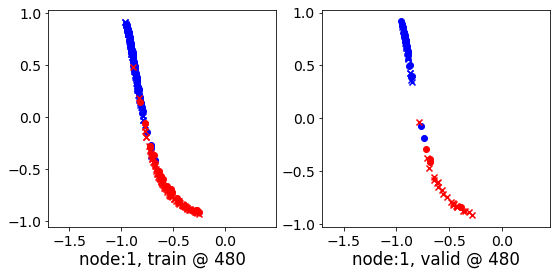

480 	 2 	 0.01170629 	 0.07023975 	 0.25968364 	 0.32960334 	 0.94897878 	 0.95251077


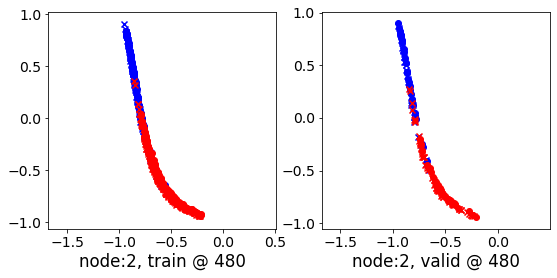

480 	 3 	 0.46096075 	 0.40105686 	 0.50167930 	 0.37095663 	 0.73484570 	 0.66304696


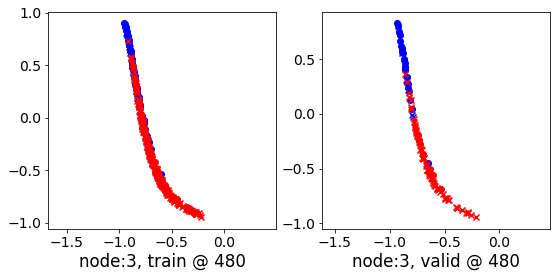

480 	 4 	 0.37621939 	 0.25853354 	 0.62340093 	 0.50064677 	 0.94213015 	 0.93526042


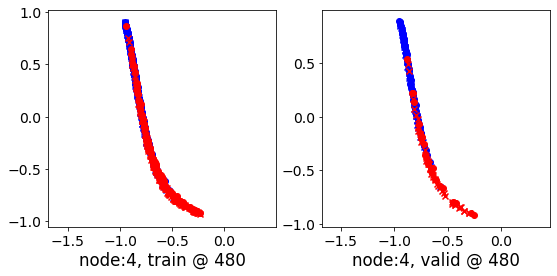

480 	 5 	 0.37858105 	 0.39980370 	 0.62635243 	 0.64052927 	 0.94435519 	 0.93387276


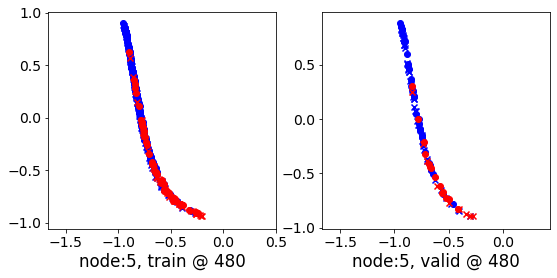

Aggregating on epoch: 482...
Aggregating on epoch: 484...
Aggregating on epoch: 486...
Aggregating on epoch: 488...
Aggregating on epoch: 490...
Aggregating on epoch: 492...
Aggregating on epoch: 494...
Aggregating on epoch: 496...
Aggregating on epoch: 498...
Aggregating on epoch: 500...
500 	 0 	 -0.17231146 	 -0.21749777 	 0.04585142 	 0.02845186 	 0.91246700 	 0.93909681


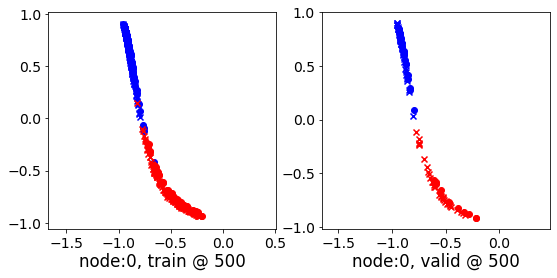

500 	 1 	 -0.02848829 	 -0.10256022 	 0.13817251 	 0.06108743 	 0.86378849 	 0.85679483


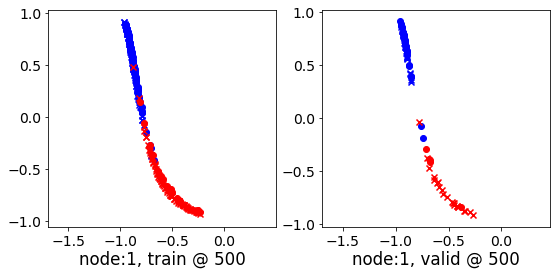

500 	 2 	 0.05202213 	 0.06730223 	 0.30456585 	 0.32619047 	 0.94729412 	 0.95203543


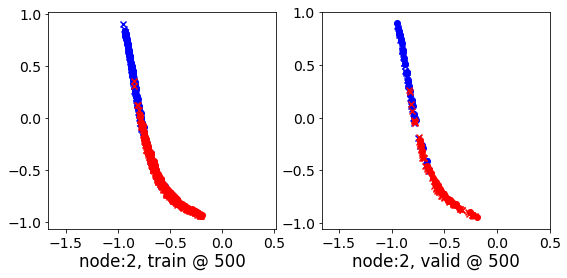

500 	 3 	 0.45992458 	 0.40115854 	 0.50018966 	 0.37078407 	 0.73398823 	 0.66277272


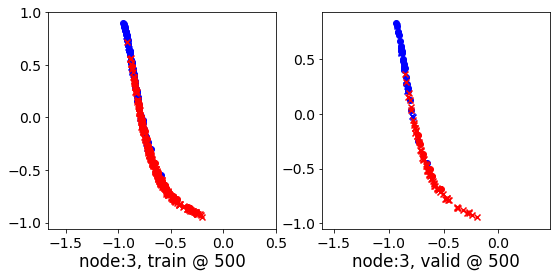

500 	 4 	 0.39353967 	 0.25871760 	 0.63123548 	 0.50040871 	 0.93119258 	 0.93483829


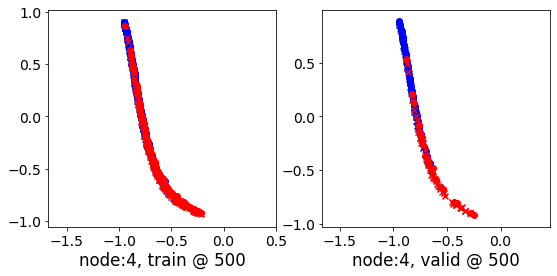

500 	 5 	 0.37838227 	 0.40015155 	 0.62592846 	 0.64067763 	 0.94417638 	 0.93367326


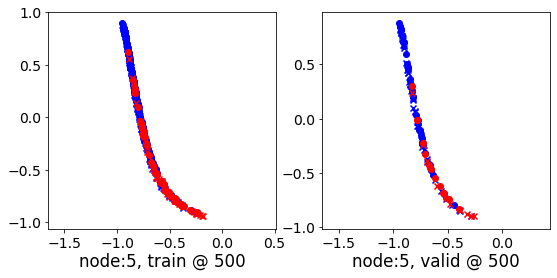

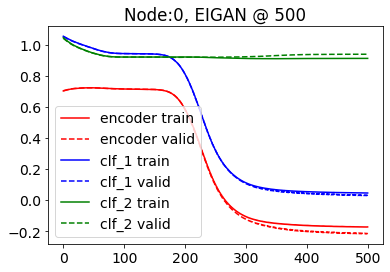

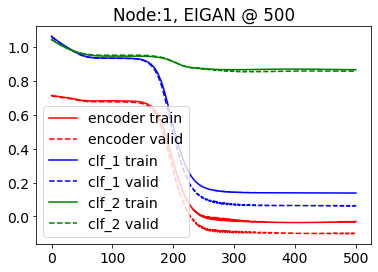

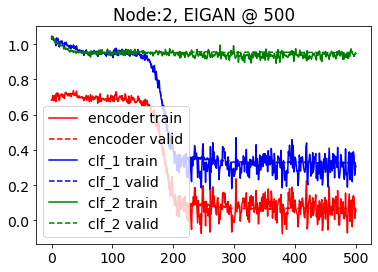

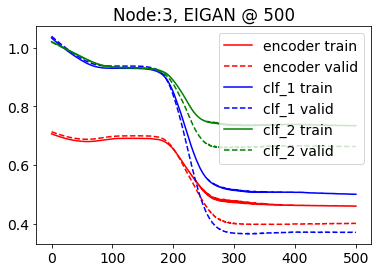

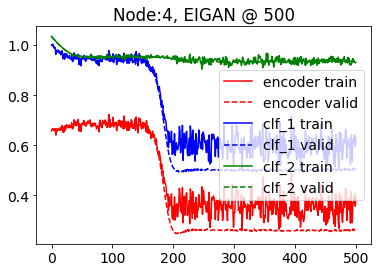

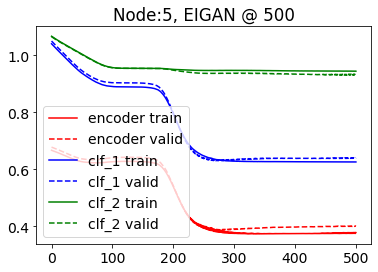

  0%|          | 1/501 [00:00<00:56,  8.88it/s]

epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.53838015 	 0.60776508 	 1.06359541 	 1.06187201 	 1.21857607 	 1.14725411


100%|██████████| 501/501 [01:14<00:00,  6.76it/s]


500 	 0.23411137 	 0.09628287 	 0.53083211 	 0.38754860 	 0.99100894 	 0.98441291


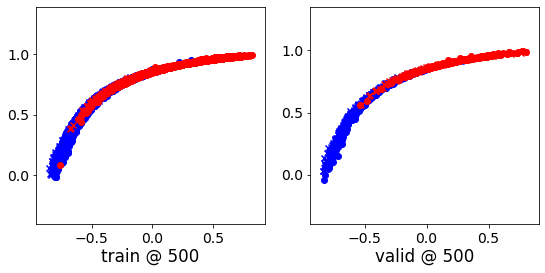

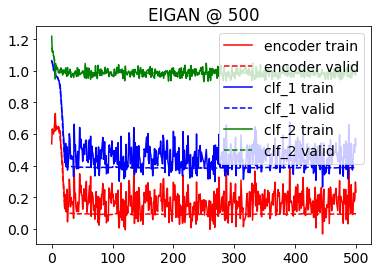

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.061340 	 1.062387 	 0.5702
200 	 0.599473 	 0.574636 	 0.8783
400 	 0.450441 	 0.385757 	 0.8944
600 	 0.449400 	 0.381987 	 0.8944
800 	 0.449233 	 0.381625 	 0.8944
1000 	 0.449177 	 0.381520 	 0.8944
Accuracy: 0.8944099378881988
Error Rate: 0.10559006211180125
F1 Score: 0.8790896159317213
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8894409937888199
Error Rate: 0.11055900621118013
F1 Score: 0.878581173260573
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8968944099378882
Error Rate: 0.10

@node 3: tensor sizes => torch.Size([437, 2]) (110, 2) torch.Size([437, 2]) (110, 2) torch.Size([437, 2]) (110, 2)
@node 4: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(536, 2) (135, 2) (536, 1) (135, 1) (536, 1) (135, 1)
@node 4: class weights => w1, w2 [array([1.47953216, 3.08536585]), array([1.96534653, 2.03589744]), array([1.34262948, 3.91860465]), array([1.66793893, 2.49714286]), array([2.04580153, 1.95620438])] [array([1.68106312, 2.46829268]), array([2.51265823, 1.66108787]), array([2.29251701, 1.77368421]), array([6.828125  , 1.17158177]), array([1.27619048, 4.62068966])]
@node 4: tensor sizes => torch.Size([536, 2]) (135, 2) torch.Size([536, 2]) (135, 2) torch.Size([536, 2]) (135, 2)
@node 5: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(396, 2) (100, 2) (396, 1) (100, 1) (396, 1) (100, 1)
@node 5: class weights => w1, w2 [array([1.47953216, 3.08536585]), array([1.96534653, 2.03589744]), array([1.34262948, 3.91860465]), array([1.66793893, 2.497

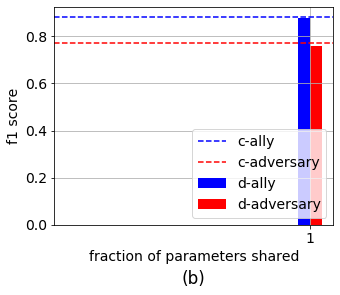

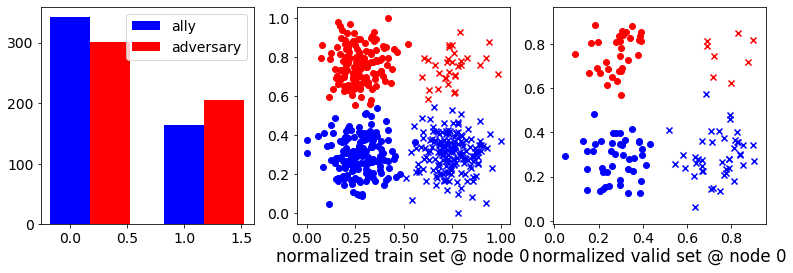

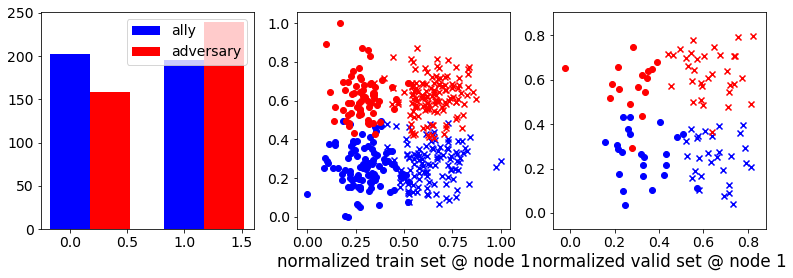

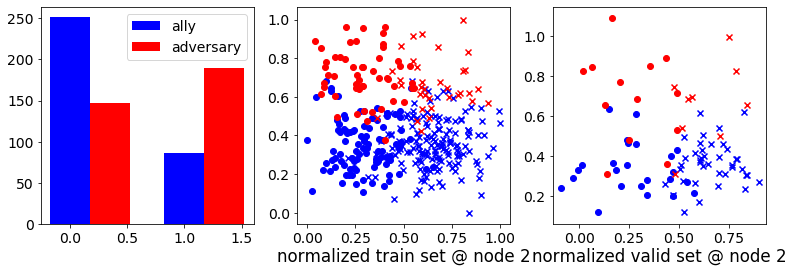

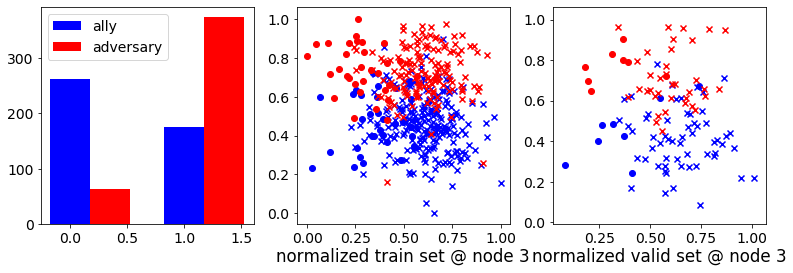

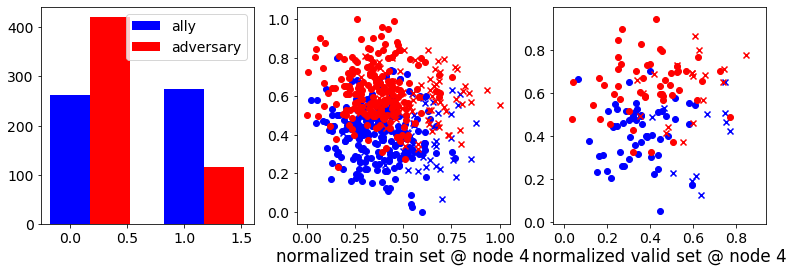

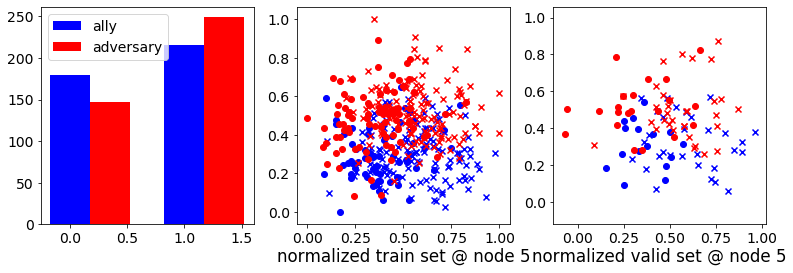

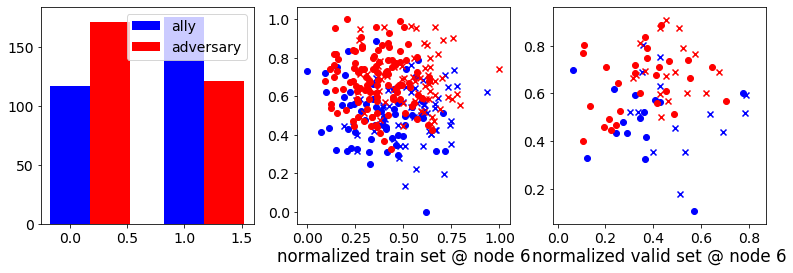

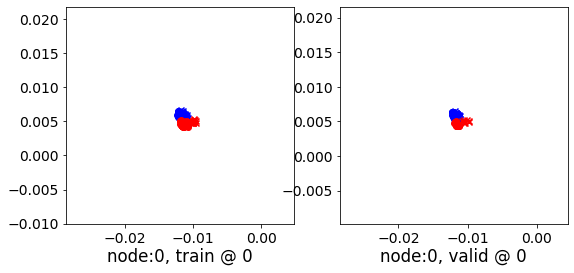

0 	 1 	 0.66434753 	 0.66715062 	 1.02814436 	 1.02673864 	 1.05708885 	 1.05273521


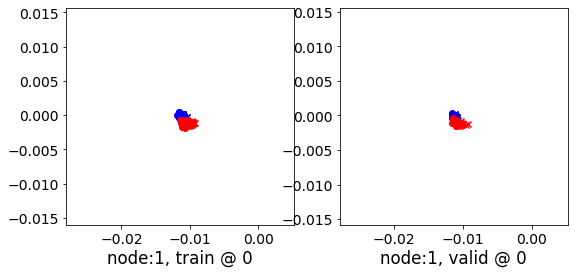

0 	 2 	 0.74361265 	 0.74638295 	 1.05820668 	 1.05947936 	 1.00783360 	 1.00624359


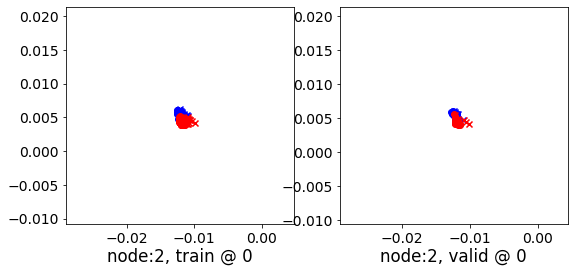

0 	 3 	 0.72022355 	 0.72192478 	 1.07283568 	 1.07062173 	 1.04586220 	 1.04184413


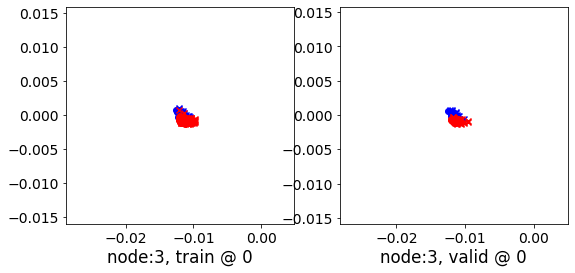

0 	 4 	 0.62575495 	 0.65730011 	 1.02668488 	 1.02359104 	 1.09420609 	 1.05943811


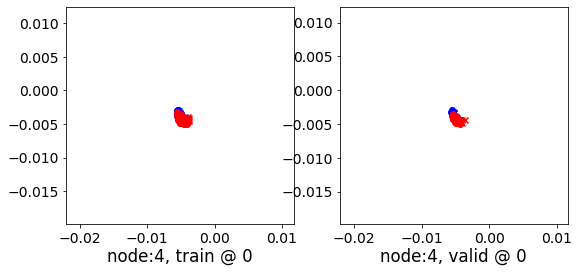

0 	 5 	 0.68129182 	 0.68321383 	 1.01639724 	 1.01610756 	 1.02828681 	 1.02604091


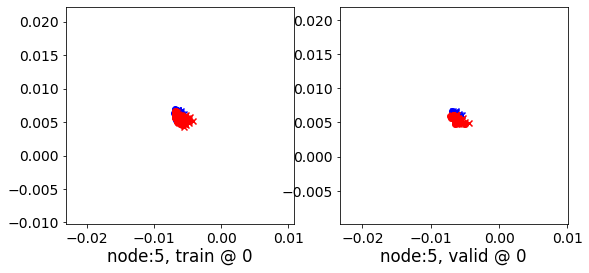

0 	 6 	 0.67827749 	 0.67581058 	 1.02147853 	 1.01808429 	 1.03641200 	 1.03542089


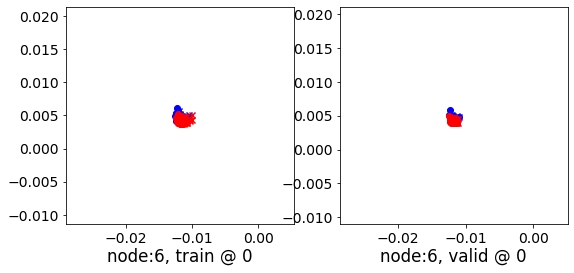

Aggregating on epoch: 2...
Aggregating on epoch: 4...
Aggregating on epoch: 6...
Aggregating on epoch: 8...
Aggregating on epoch: 10...
Aggregating on epoch: 12...
Aggregating on epoch: 14...
Aggregating on epoch: 16...
Aggregating on epoch: 18...
Aggregating on epoch: 20...
20 	 0 	 0.70109022 	 0.70075893 	 1.03058493 	 1.02792156 	 1.02268219 	 1.02030981


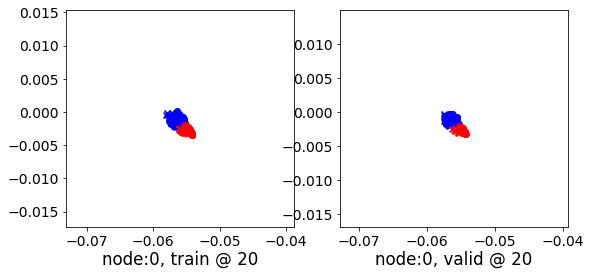

20 	 1 	 0.67982948 	 0.68224275 	 1.00009358 	 0.99880493 	 1.01353860 	 1.00970936


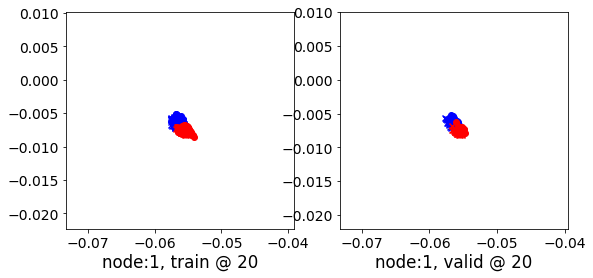

20 	 2 	 0.72923535 	 0.73148382 	 1.01995993 	 1.02111816 	 0.98398143 	 0.98278153


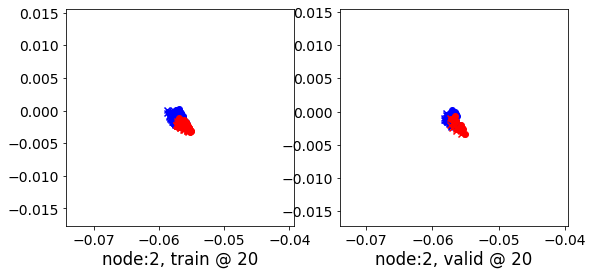

20 	 3 	 0.72092628 	 0.72290790 	 1.03507924 	 1.03339112 	 1.00742114 	 1.00363040


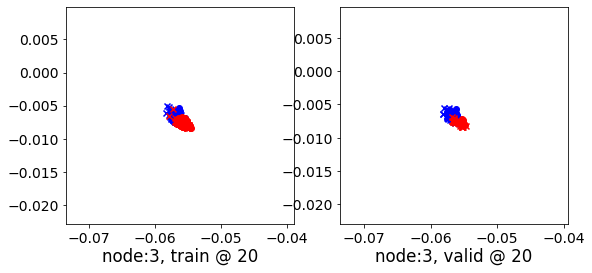

20 	 4 	 0.68625474 	 0.67999035 	 0.95382440 	 0.96145153 	 0.96072948 	 0.97460836


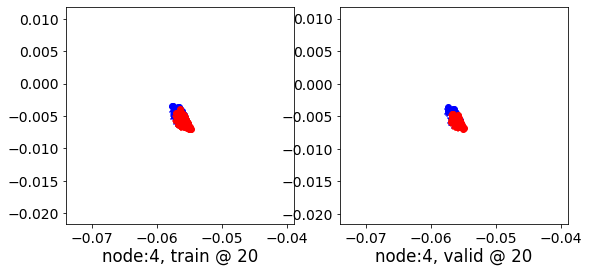

20 	 5 	 0.67674351 	 0.67851686 	 0.98061943 	 0.98049533 	 0.99710190 	 0.99512565


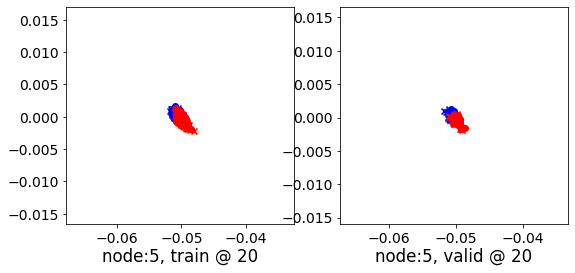

20 	 6 	 0.67936140 	 0.67690653 	 0.98935521 	 0.98656076 	 1.00315225 	 1.00280142


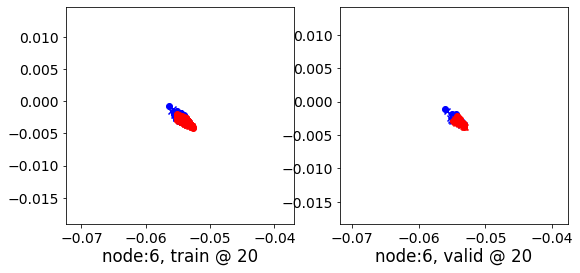

Aggregating on epoch: 22...
Aggregating on epoch: 24...
Aggregating on epoch: 26...
Aggregating on epoch: 28...
Aggregating on epoch: 30...
Aggregating on epoch: 32...
Aggregating on epoch: 34...
Aggregating on epoch: 36...
Aggregating on epoch: 38...
Aggregating on epoch: 40...
40 	 0 	 0.69046831 	 0.69082594 	 0.99482542 	 0.99296510 	 0.99752450 	 0.99528635


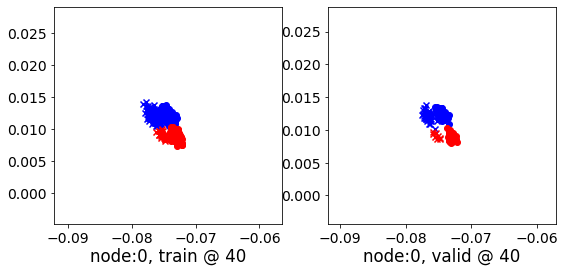

40 	 1 	 0.68754977 	 0.68970877 	 0.97638059 	 0.97530979 	 0.98210412 	 0.97874820


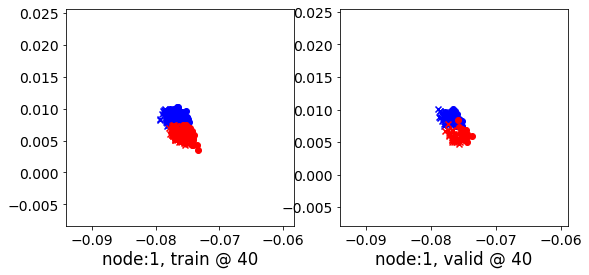

40 	 2 	 0.71029651 	 0.71213728 	 0.98440146 	 0.98546433 	 0.96738279 	 0.96647424


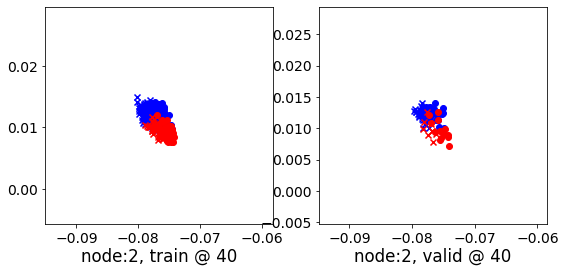

40 	 3 	 0.72963017 	 0.73183578 	 1.00630999 	 1.00492847 	 0.97002071 	 0.96623987


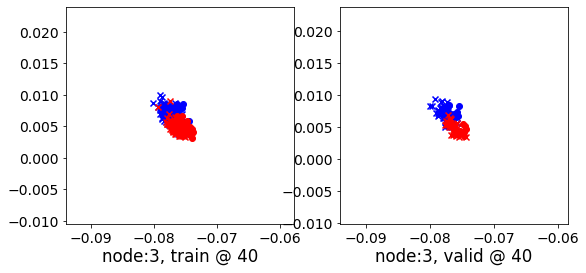

40 	 4 	 0.80386597 	 0.72707123 	 0.96259087 	 0.95477861 	 0.85201639 	 0.92085457


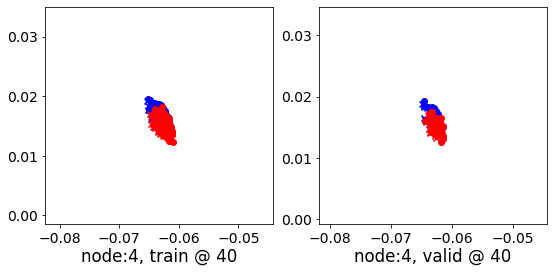

40 	 5 	 0.67908794 	 0.68121010 	 0.95849127 	 0.95903987 	 0.97263283 	 0.97097695


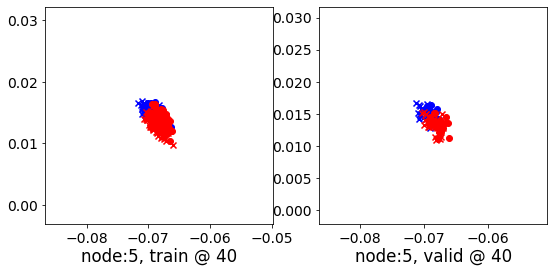

40 	 6 	 0.68551552 	 0.68286389 	 0.96913189 	 0.96649748 	 0.97680581 	 0.97678077


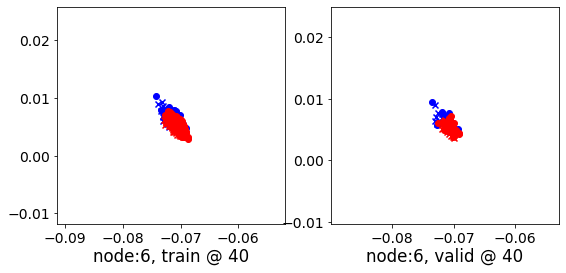

Aggregating on epoch: 42...
Aggregating on epoch: 44...
Aggregating on epoch: 46...
Aggregating on epoch: 48...
Aggregating on epoch: 50...
Aggregating on epoch: 52...
Aggregating on epoch: 54...
Aggregating on epoch: 56...
Aggregating on epoch: 58...
Aggregating on epoch: 60...
60 	 0 	 0.68773174 	 0.68822098 	 0.97026289 	 0.96877438 	 0.97570270 	 0.97370058


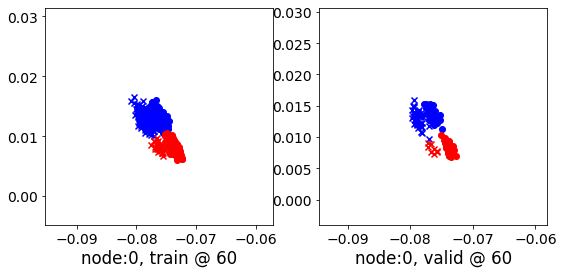

60 	 1 	 0.69181257 	 0.69407499 	 0.96039045 	 0.95981604 	 0.96180177 	 0.95888823


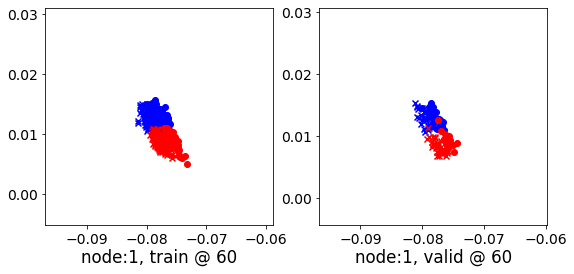

60 	 2 	 0.69096285 	 0.69284630 	 0.95451379 	 0.95594859 	 0.95684326 	 0.95624948


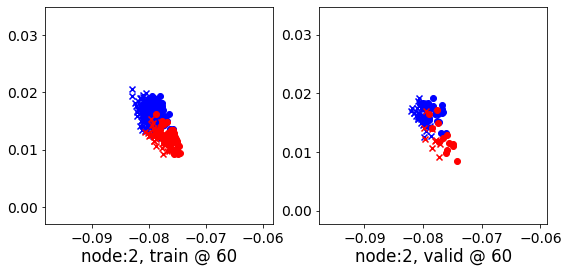

60 	 3 	 0.74297053 	 0.74545860 	 0.98207700 	 0.98097253 	 0.93244857 	 0.92866111


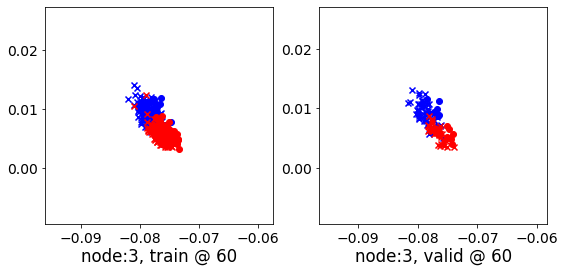

60 	 4 	 0.76131296 	 0.74152523 	 0.95316780 	 0.95472413 	 0.88501614 	 0.90634608


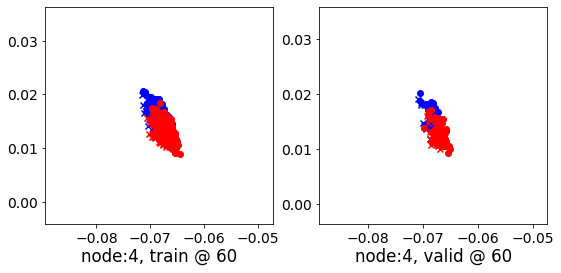

60 	 5 	 0.69227308 	 0.69465989 	 0.95332241 	 0.95443290 	 0.95424128 	 0.95292020


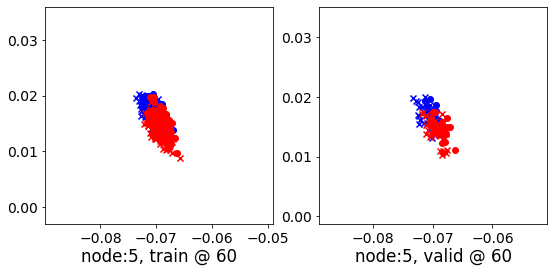

60 	 6 	 0.69123012 	 0.68787855 	 0.95605803 	 0.95332730 	 0.95802790 	 0.95859593


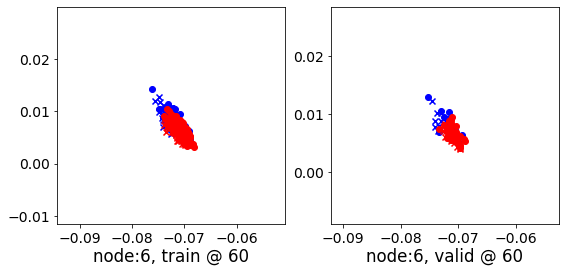

Aggregating on epoch: 62...
Aggregating on epoch: 64...
Aggregating on epoch: 66...
Aggregating on epoch: 68...
Aggregating on epoch: 70...
Aggregating on epoch: 72...
Aggregating on epoch: 74...
Aggregating on epoch: 76...
Aggregating on epoch: 78...
Aggregating on epoch: 80...
80 	 0 	 0.68545771 	 0.68563461 	 0.95174295 	 0.95036668 	 0.95948464 	 0.95787925


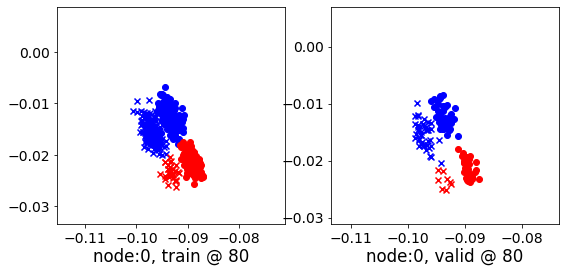

80 	 1 	 0.69615662 	 0.69874334 	 0.95491081 	 0.95479429 	 0.95191503 	 0.94919813


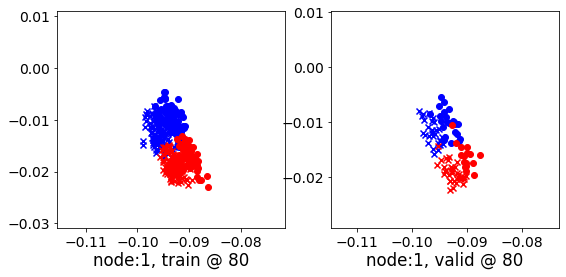

80 	 2 	 0.67093188 	 0.67355549 	 0.93033761 	 0.93280119 	 0.95270139 	 0.95239288


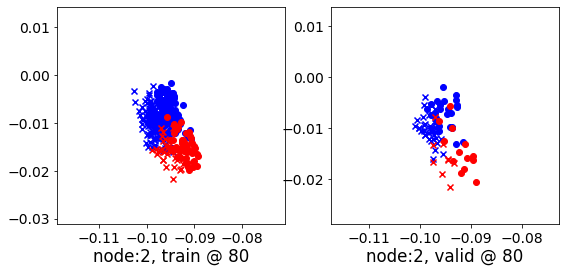

80 	 3 	 0.75799358 	 0.76072162 	 0.96418059 	 0.96343130 	 0.89949208 	 0.89585686


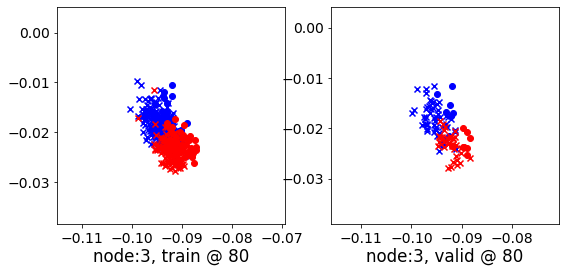

80 	 4 	 0.76210970 	 0.74154872 	 0.95476592 	 0.95485646 	 0.88581389 	 0.90645492


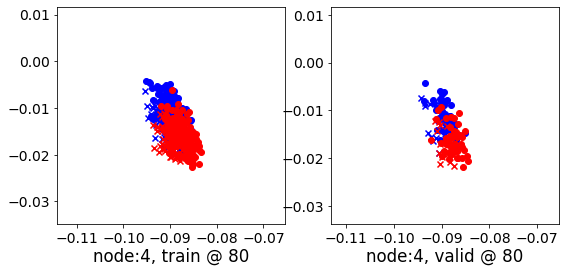

80 	 5 	 0.70164466 	 0.70351046 	 0.95331091 	 0.95437849 	 0.94483393 	 0.94401520


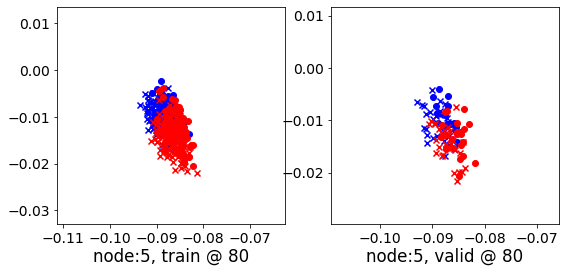

80 	 6 	 0.69221801 	 0.68780166 	 0.94986022 	 0.94669437 	 0.95082259 	 0.95203990


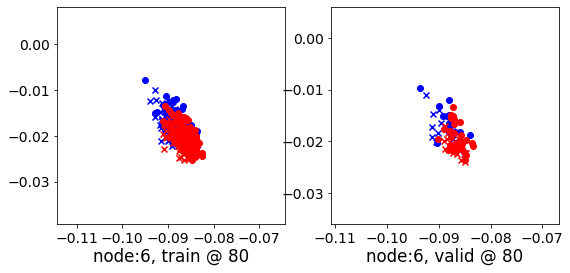

Aggregating on epoch: 82...
Aggregating on epoch: 84...
Aggregating on epoch: 86...
Aggregating on epoch: 88...
Aggregating on epoch: 90...
Aggregating on epoch: 92...
Aggregating on epoch: 94...
Aggregating on epoch: 96...
Aggregating on epoch: 98...
Aggregating on epoch: 100...
100 	 0 	 0.68095404 	 0.68096626 	 0.93931532 	 0.93809283 	 0.95155889 	 0.95027375


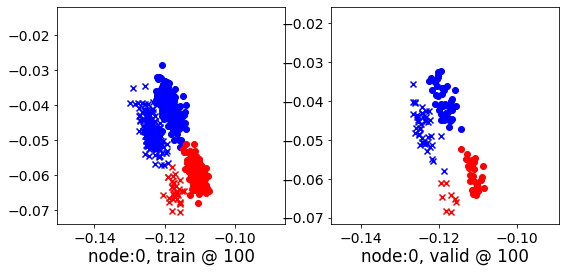

100 	 1 	 0.69914138 	 0.70203769 	 0.95467252 	 0.95462489 	 0.94868231 	 0.94573438


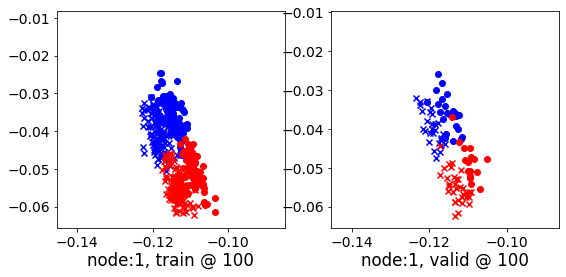

100 	 2 	 0.65682012 	 0.66077769 	 0.91572022 	 0.91955298 	 0.95215839 	 0.95192248


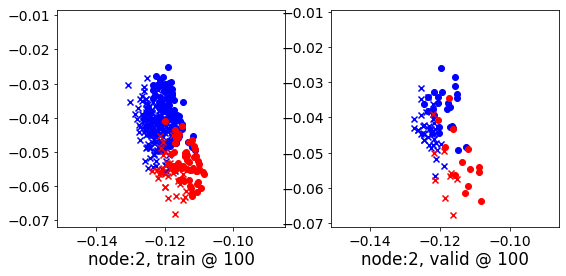

100 	 3 	 0.77088636 	 0.77359891 	 0.95358783 	 0.95312333 	 0.87592912 	 0.87267160


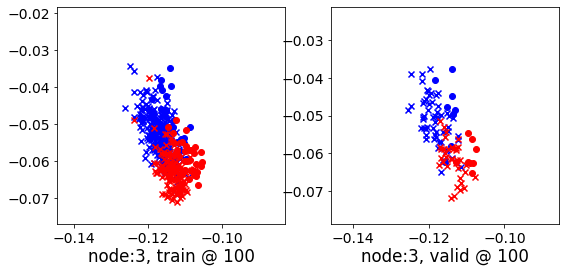

100 	 4 	 0.69996387 	 0.74099988 	 0.95516348 	 0.95421875 	 0.94836795 	 0.90636605


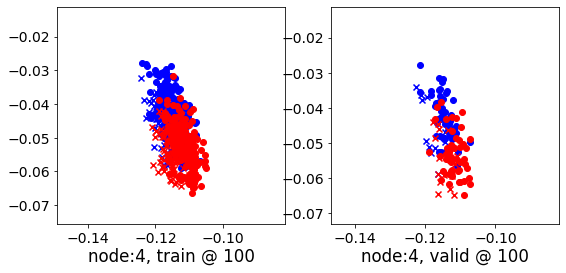

100 	 5 	 0.70270503 	 0.70448625 	 0.95305973 	 0.95416480 	 0.94351965 	 0.94282573


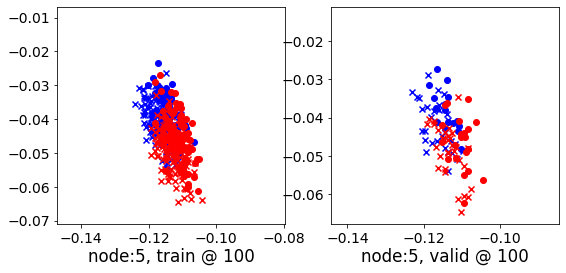

100 	 6 	 0.69153148 	 0.68628699 	 0.94815248 	 0.94445050 	 0.94979721 	 0.95131069


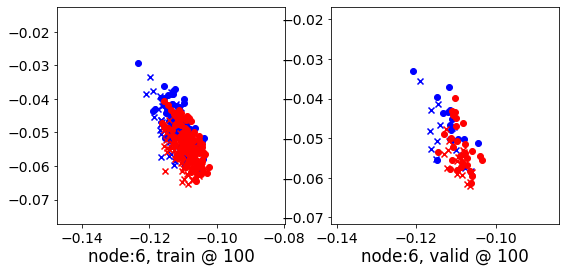

Aggregating on epoch: 102...
Aggregating on epoch: 104...
Aggregating on epoch: 106...
Aggregating on epoch: 108...
Aggregating on epoch: 110...
Aggregating on epoch: 112...
Aggregating on epoch: 114...
Aggregating on epoch: 116...
Aggregating on epoch: 118...
Aggregating on epoch: 120...
120 	 0 	 0.67740893 	 0.67747873 	 0.93343109 	 0.93230152 	 0.94925016 	 0.94796997


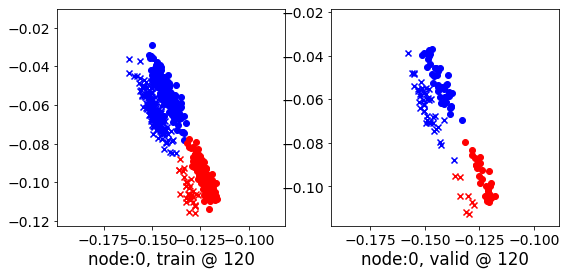

120 	 1 	 0.69977528 	 0.70306736 	 0.95433146 	 0.95428294 	 0.94772089 	 0.94436276


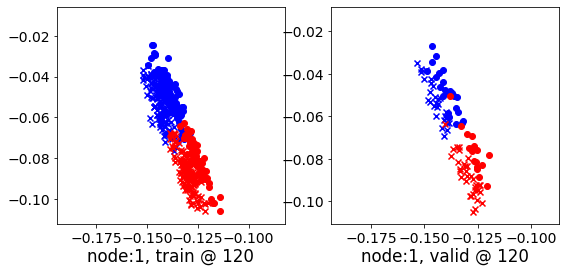

120 	 2 	 0.65216976 	 0.65702087 	 0.91109550 	 0.91579396 	 0.95215756 	 0.95192027


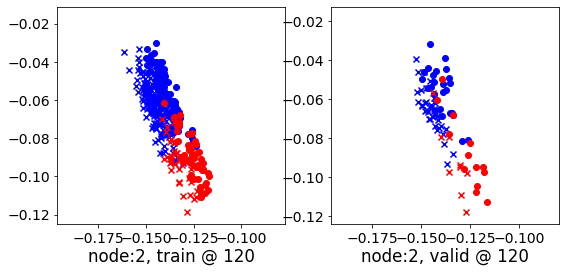

120 	 3 	 0.77857351 	 0.78118873 	 0.94890863 	 0.94862181 	 0.86352319 	 0.86058027


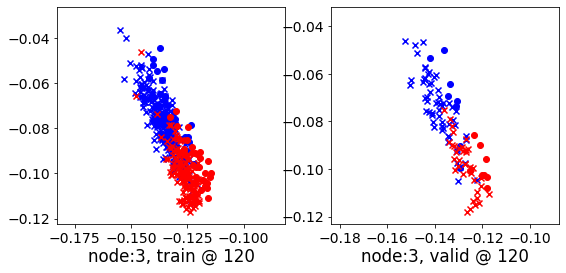

120 	 4 	 0.83764225 	 0.74031109 	 0.96387589 	 0.95319301 	 0.81958437 	 0.90602911


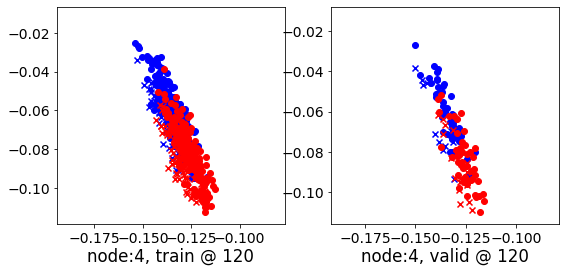

120 	 5 	 0.70207965 	 0.70391273 	 0.95236528 	 0.95353758 	 0.94349301 	 0.94277203


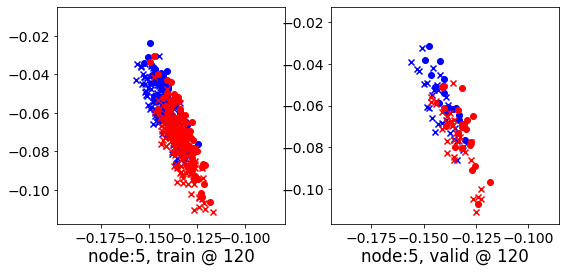

120 	 6 	 0.69108808 	 0.68574244 	 0.94763780 	 0.94374830 	 0.94977933 	 0.95115304


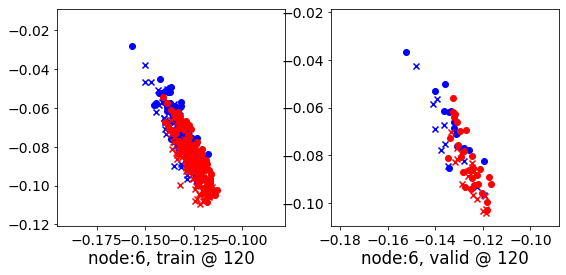

Aggregating on epoch: 122...
Aggregating on epoch: 124...
Aggregating on epoch: 126...
Aggregating on epoch: 128...
Aggregating on epoch: 130...
Aggregating on epoch: 132...
Aggregating on epoch: 134...
Aggregating on epoch: 136...
Aggregating on epoch: 138...
Aggregating on epoch: 140...
140 	 0 	 0.67227167 	 0.67181695 	 0.92736799 	 0.92590803 	 0.94865149 	 0.94723827


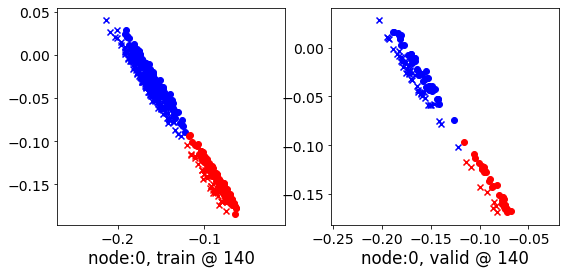

140 	 1 	 0.69874519 	 0.70217925 	 0.95296520 	 0.95284224 	 0.94745421 	 0.94381016


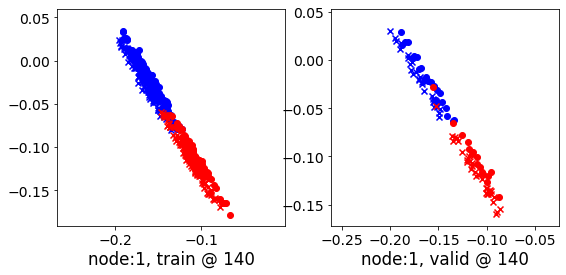

140 	 2 	 0.64805007 	 0.65299094 	 0.90663505 	 0.91168630 	 0.95206040 	 0.95184255


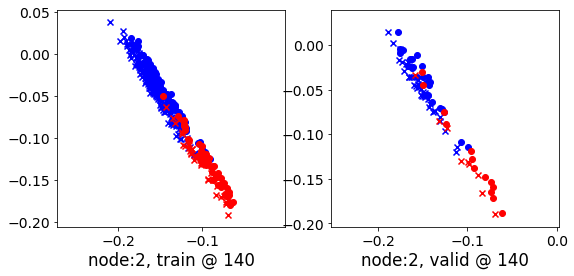

140 	 3 	 0.78119195 	 0.78375912 	 0.94717705 	 0.94684333 	 0.85920244 	 0.85623139


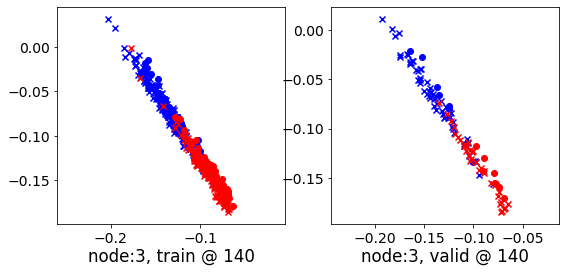

140 	 4 	 0.82625306 	 0.73436713 	 0.94843376 	 0.94721973 	 0.81568468 	 0.90599978


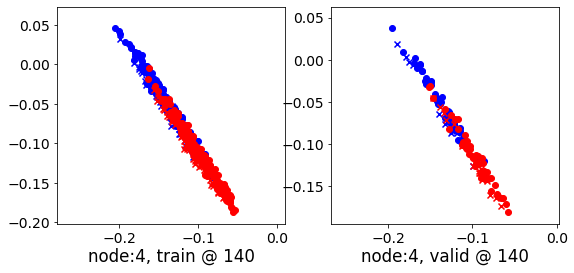

140 	 5 	 0.69870216 	 0.70049417 	 0.94872248 	 0.95012176 	 0.94345647 	 0.94277477


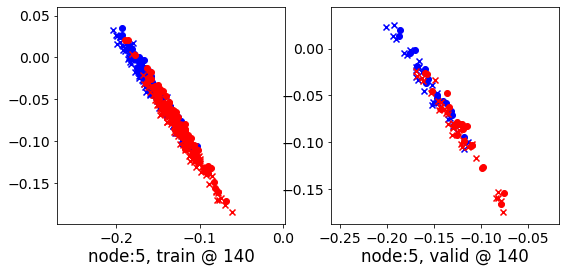

140 	 6 	 0.68797570 	 0.68317574 	 0.94467443 	 0.94086128 	 0.95017117 	 0.95083272


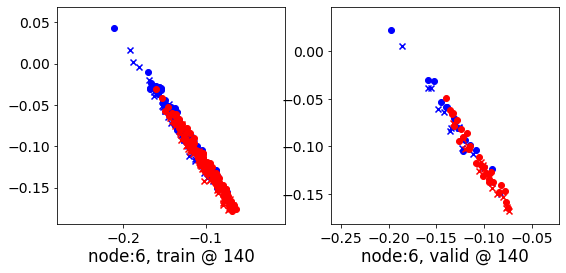

Aggregating on epoch: 142...
Aggregating on epoch: 144...
Aggregating on epoch: 146...
Aggregating on epoch: 148...
Aggregating on epoch: 150...
Aggregating on epoch: 152...
Aggregating on epoch: 154...
Aggregating on epoch: 156...
Aggregating on epoch: 158...
Aggregating on epoch: 160...
160 	 0 	 0.64278525 	 0.63827604 	 0.89243048 	 0.88810682 	 0.94467711 	 0.94297796


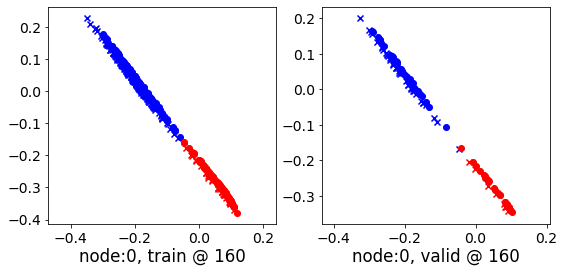

160 	 1 	 0.69106662 	 0.69332290 	 0.94437295 	 0.94348806 	 0.94694829 	 0.94331235


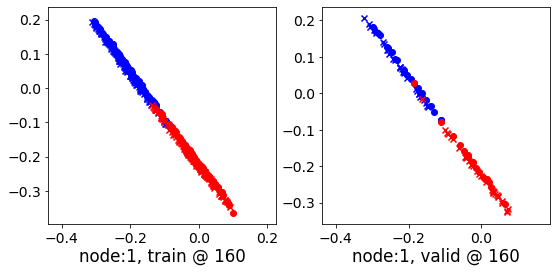

160 	 2 	 0.62609190 	 0.63119358 	 0.88199288 	 0.88856524 	 0.95042098 	 0.95051885


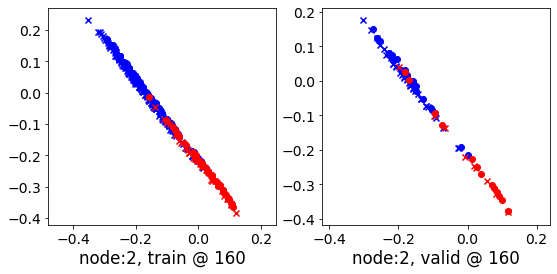

160 	 3 	 0.77730250 	 0.77956438 	 0.94163102 	 0.94040459 	 0.85772848 	 0.85398740


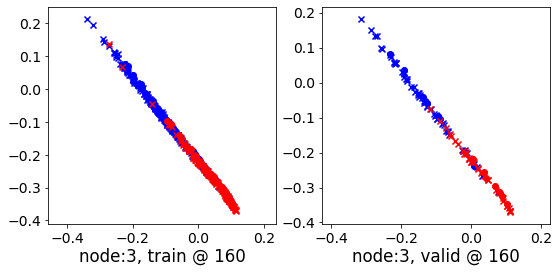

160 	 4 	 0.67540312 	 0.67147100 	 0.86186922 	 0.88453323 	 0.88311452 	 0.90620941


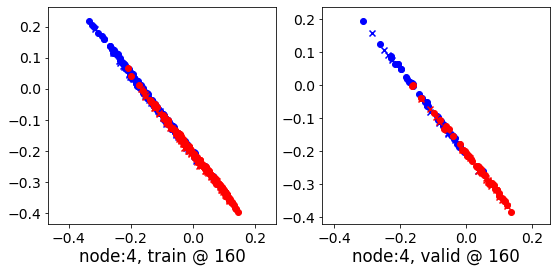

160 	 5 	 0.67938960 	 0.68120569 	 0.92774147 	 0.93095493 	 0.94339061 	 0.94289643


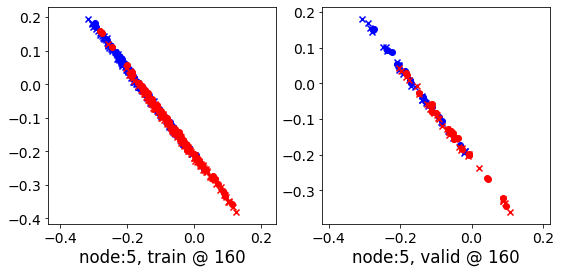

160 	 6 	 0.66829491 	 0.66412413 	 0.92516816 	 0.92125839 	 0.95119506 	 0.95028144


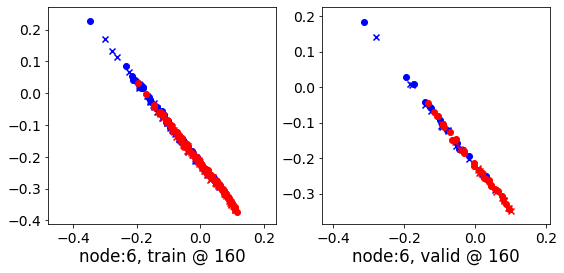

Aggregating on epoch: 162...
Aggregating on epoch: 164...
Aggregating on epoch: 166...
Aggregating on epoch: 168...
Aggregating on epoch: 170...
Aggregating on epoch: 172...
Aggregating on epoch: 174...
Aggregating on epoch: 176...
Aggregating on epoch: 178...
Aggregating on epoch: 180...
180 	 0 	 0.50421840 	 0.48794329 	 0.73538357 	 0.72212160 	 0.92909783 	 0.92732549


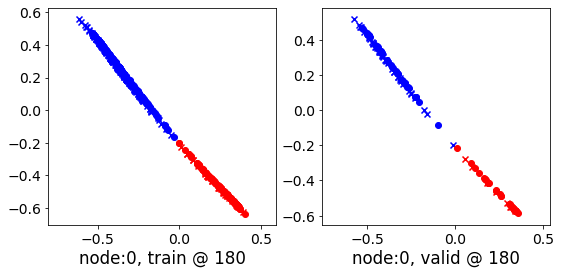

180 	 1 	 0.64606553 	 0.64297479 	 0.89539832 	 0.89117897 	 0.94475454 	 0.94135135


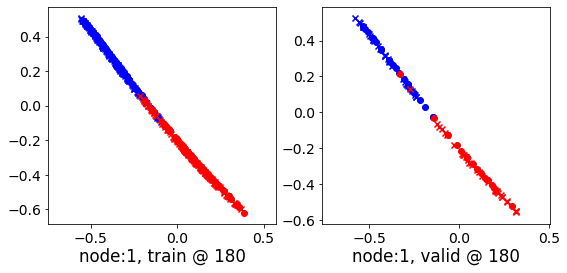

180 	 2 	 0.56077784 	 0.57034266 	 0.80504084 	 0.82185185 	 0.94317245 	 0.94465637


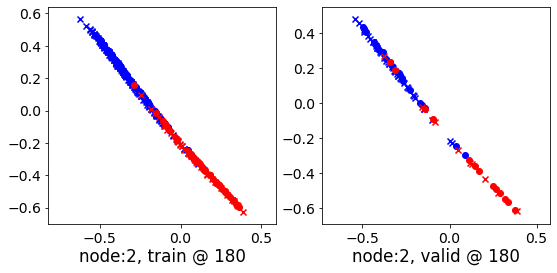

180 	 3 	 0.74557644 	 0.74513280 	 0.90457445 	 0.89790875 	 0.85375762 	 0.84592313


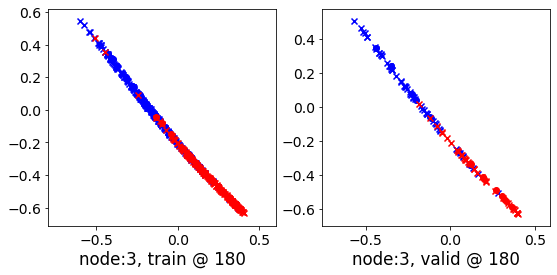

180 	 4 	 0.71110827 	 0.44347823 	 0.72710991 	 0.65805697 	 0.73460454 	 0.90772593


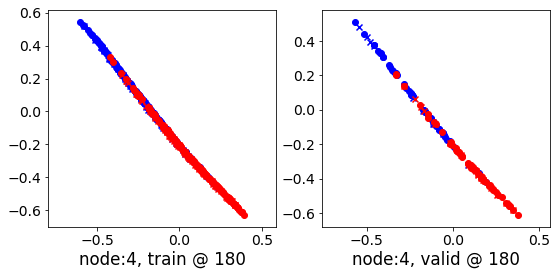

180 	 5 	 0.61897409 	 0.61869162 	 0.85833418 	 0.86885250 	 0.94319385 	 0.94330806


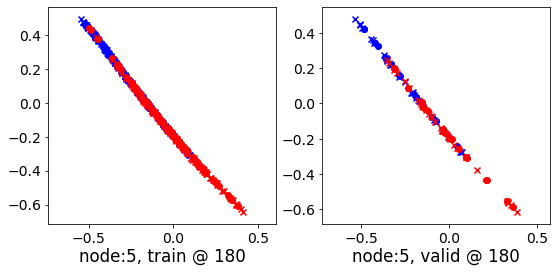

180 	 6 	 0.60431439 	 0.60140932 	 0.86092186 	 0.85845983 	 0.95211381 	 0.95019770


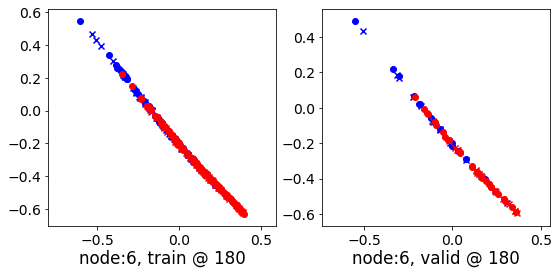

Aggregating on epoch: 182...
Aggregating on epoch: 184...
Aggregating on epoch: 186...
Aggregating on epoch: 188...
Aggregating on epoch: 190...
Aggregating on epoch: 192...
Aggregating on epoch: 194...
Aggregating on epoch: 196...
Aggregating on epoch: 198...
Aggregating on epoch: 200...
200 	 0 	 0.22524396 	 0.19809780 	 0.42942700 	 0.40888742 	 0.90489990 	 0.90393680


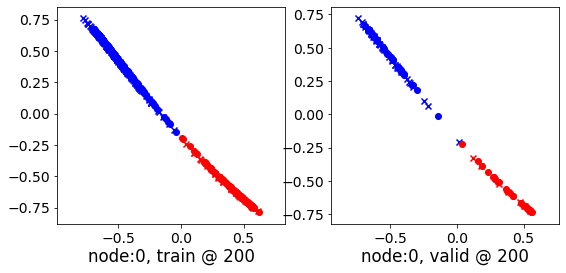

200 	 1 	 0.53205651 	 0.52201498 	 0.77402198 	 0.76612788 	 0.94080418 	 0.93726009


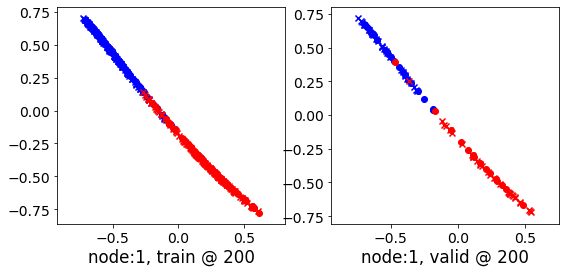

200 	 2 	 0.43956339 	 0.46864474 	 0.66797489 	 0.71192819 	 0.93080008 	 0.93643063


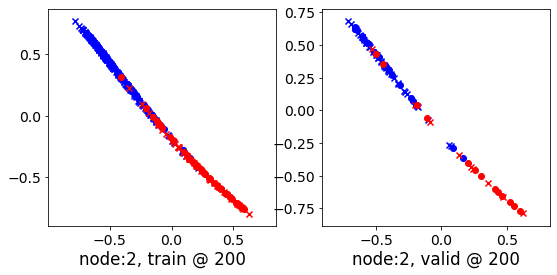

200 	 3 	 0.66329777 	 0.66071242 	 0.81393939 	 0.79864651 	 0.84845936 	 0.83108127


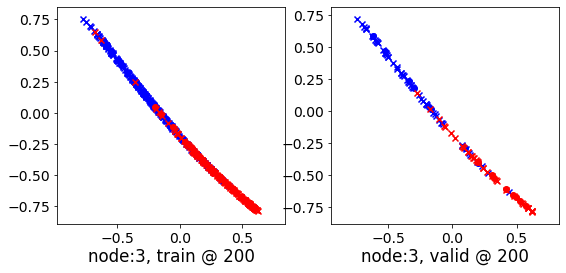

200 	 4 	 0.76771915 	 0.43547612 	 0.79201782 	 0.65011096 	 0.73590153 	 0.90778202


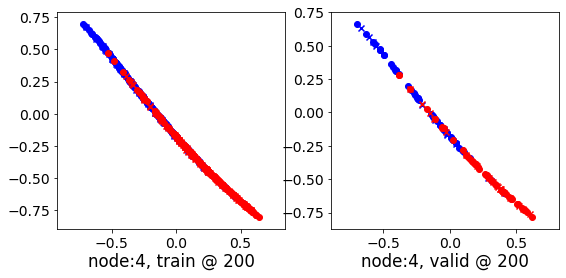

200 	 5 	 0.53329813 	 0.53861588 	 0.75705832 	 0.78907037 	 0.94280958 	 0.94360167


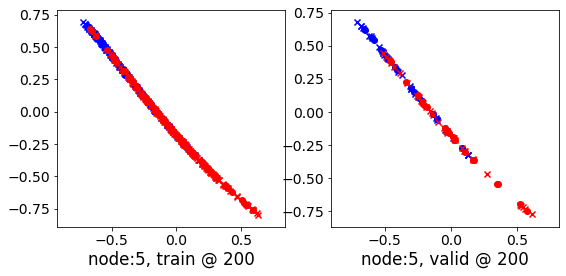

200 	 6 	 0.52774811 	 0.51995611 	 0.77593762 	 0.77836335 	 0.95009339 	 0.95155442


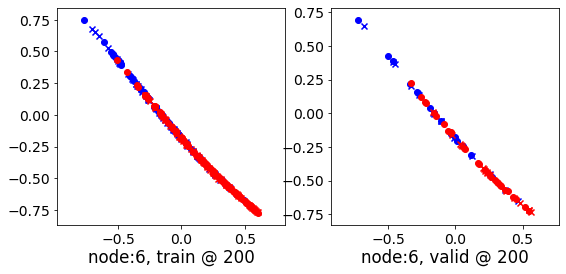

Aggregating on epoch: 202...
Aggregating on epoch: 204...
Aggregating on epoch: 206...
Aggregating on epoch: 208...
Aggregating on epoch: 210...
Aggregating on epoch: 212...
Aggregating on epoch: 214...
Aggregating on epoch: 216...
Aggregating on epoch: 218...
Aggregating on epoch: 220...
220 	 0 	 -0.00352763 	 -0.02065195 	 0.19063264 	 0.18021558 	 0.89198351 	 0.89401472


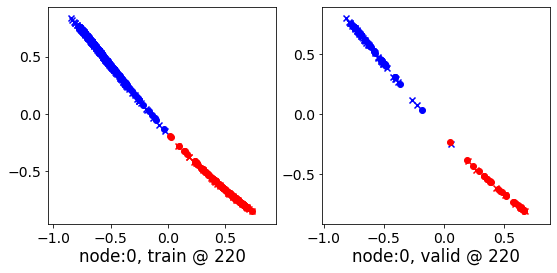

220 	 1 	 0.36385053 	 0.34204292 	 0.59211183 	 0.58265871 	 0.93625641 	 0.93376297


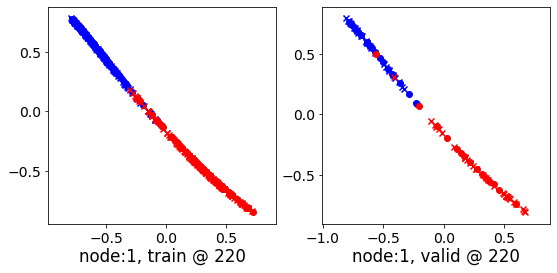

220 	 2 	 0.28899378 	 0.36521626 	 0.51077950 	 0.60735118 	 0.92245656 	 0.93528211


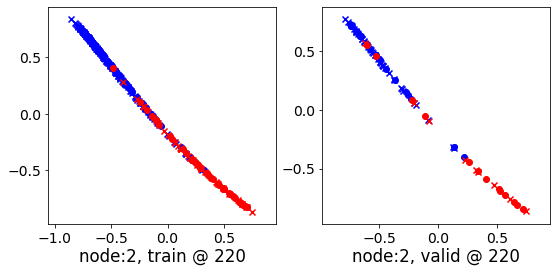

220 	 3 	 0.54536724 	 0.53254521 	 0.68830752 	 0.66654116 	 0.84855682 	 0.82714313


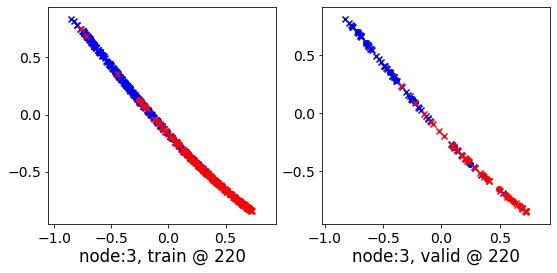

220 	 4 	 0.14217961 	 0.42091489 	 0.41507924 	 0.63600415 	 0.95284176 	 0.90823644


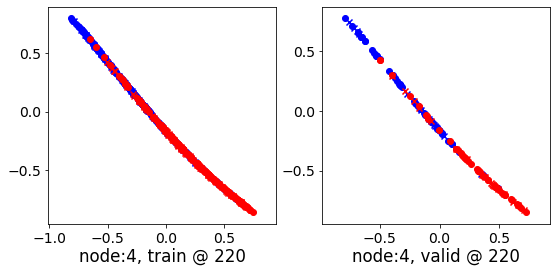

220 	 5 	 0.48581839 	 0.50948364 	 0.70194280 	 0.75995100 	 0.94215655 	 0.94361454


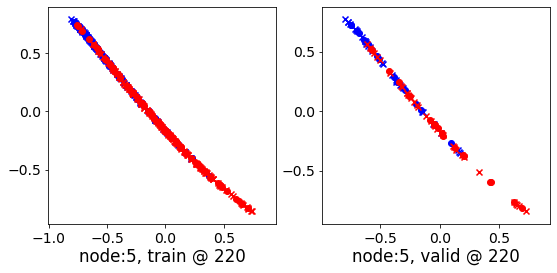

220 	 6 	 0.50680739 	 0.48826426 	 0.74407834 	 0.75085074 	 0.94733614 	 0.95573366


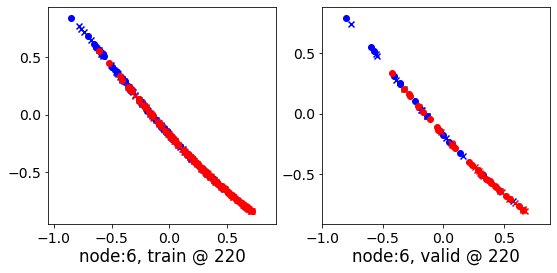

Aggregating on epoch: 222...
Aggregating on epoch: 224...
Aggregating on epoch: 226...
Aggregating on epoch: 228...
Aggregating on epoch: 230...
Aggregating on epoch: 232...
Aggregating on epoch: 234...
Aggregating on epoch: 236...
Aggregating on epoch: 238...
Aggregating on epoch: 240...
240 	 0 	 -0.10946057 	 -0.11625285 	 0.09185430 	 0.09062241 	 0.89706749 	 0.90002245


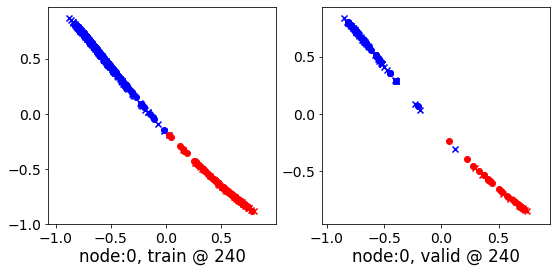

240 	 1 	 0.17254883 	 0.14896080 	 0.39095730 	 0.38546583 	 0.93134159 	 0.92965221


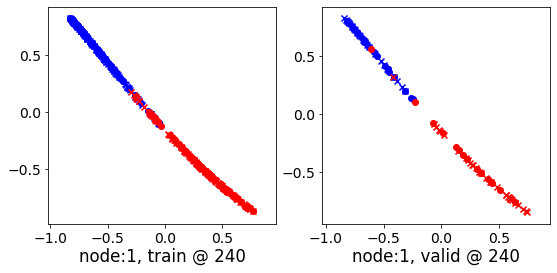

240 	 2 	 0.17125458 	 0.31000757 	 0.39766008 	 0.56087762 	 0.92803019 	 0.94401723


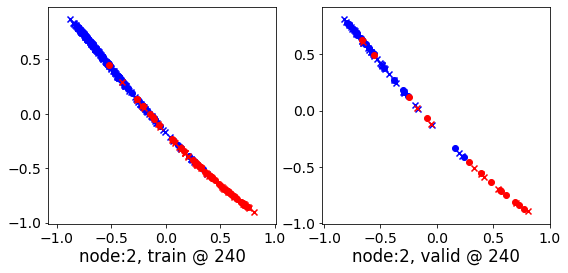

240 	 3 	 0.45237708 	 0.40817589 	 0.57922024 	 0.54806215 	 0.85033137 	 0.83303344


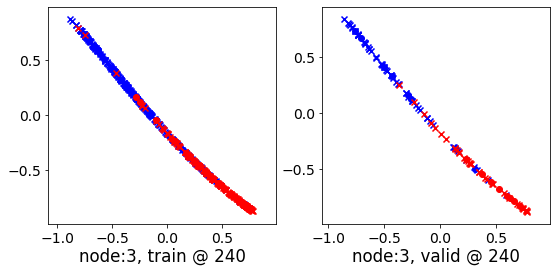

240 	 4 	 0.16362059 	 0.42501169 	 0.52067155 	 0.63996172 	 1.04782629 	 0.90809721


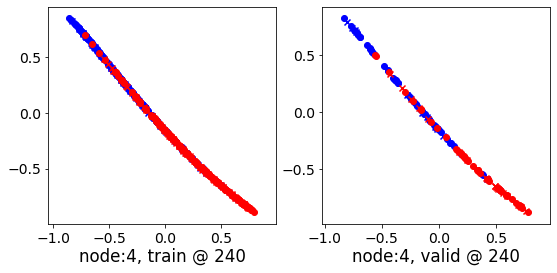

240 	 5 	 0.45650357 	 0.50957400 	 0.68608427 	 0.75996411 	 0.94102556 	 0.94353729


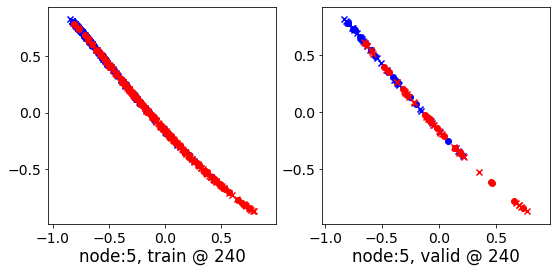

240 	 6 	 0.50556326 	 0.48611689 	 0.74521476 	 0.75445652 	 0.94694746 	 0.96148682


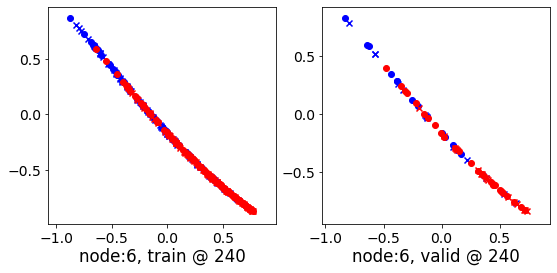

Aggregating on epoch: 242...
Aggregating on epoch: 244...
Aggregating on epoch: 246...
Aggregating on epoch: 248...
Aggregating on epoch: 250...
Aggregating on epoch: 252...
Aggregating on epoch: 254...
Aggregating on epoch: 256...
Aggregating on epoch: 258...
Aggregating on epoch: 260...
260 	 0 	 -0.14824815 	 -0.14830512 	 0.05482435 	 0.05870080 	 0.89701295 	 0.90015310


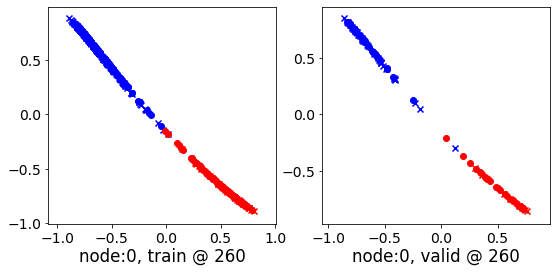

260 	 1 	 0.06094816 	 0.03691378 	 0.26778382 	 0.27065590 	 0.92883861 	 0.92688930


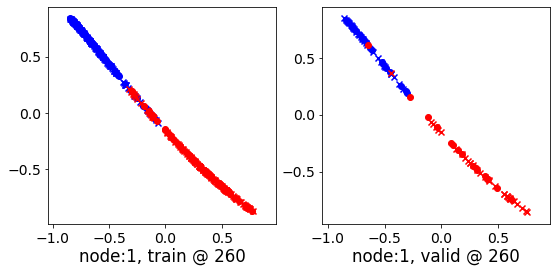

260 	 2 	 0.12096468 	 0.32661283 	 0.34701324 	 0.57498115 	 0.92852330 	 0.94151551


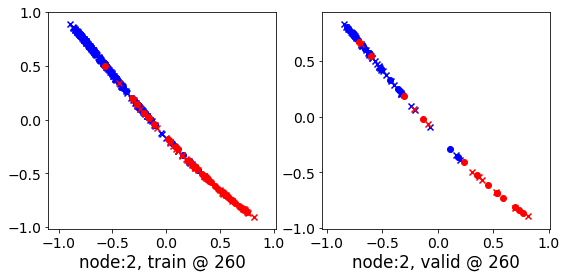

260 	 3 	 0.39343119 	 0.34493905 	 0.51721925 	 0.48843652 	 0.85004914 	 0.83664465


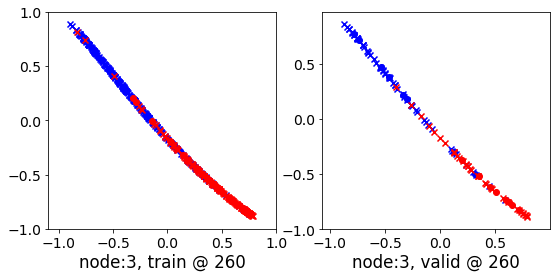

260 	 4 	 0.53929532 	 0.41112632 	 0.79440725 	 0.62354296 	 0.94807625 	 0.90556383


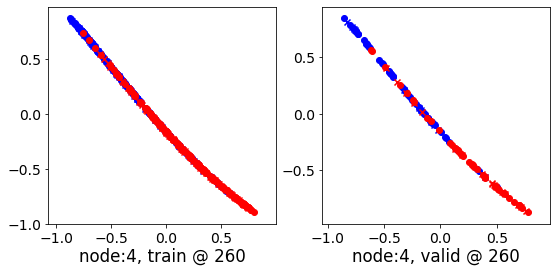

260 	 5 	 0.45133585 	 0.51084739 	 0.68609571 	 0.76171690 	 0.94022447 	 0.94401670


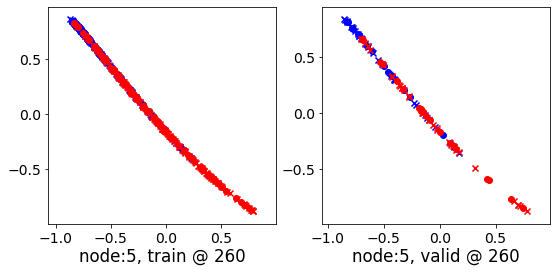

260 	 6 	 0.49317223 	 0.48254794 	 0.74159932 	 0.75330549 	 0.94719875 	 0.96390474


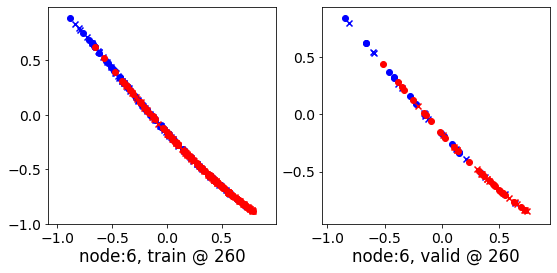

Aggregating on epoch: 262...
Aggregating on epoch: 264...
Aggregating on epoch: 266...
Aggregating on epoch: 268...
Aggregating on epoch: 270...
Aggregating on epoch: 272...
Aggregating on epoch: 274...
Aggregating on epoch: 276...
Aggregating on epoch: 278...
Aggregating on epoch: 280...
280 	 0 	 -0.16372114 	 -0.16036749 	 0.03955483 	 0.04686361 	 0.89681023 	 0.90037829


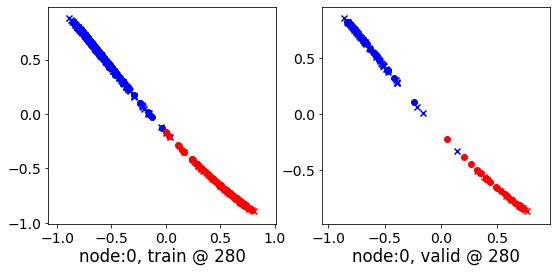

280 	 1 	 -0.00450605 	 -0.02127497 	 0.20323372 	 0.21080460 	 0.92676544 	 0.92522675


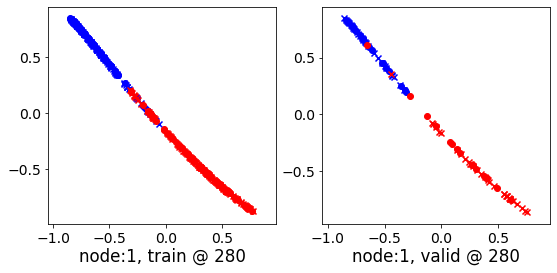

280 	 2 	 0.12352848 	 0.33606911 	 0.33685336 	 0.58410347 	 0.92940187 	 0.94118154


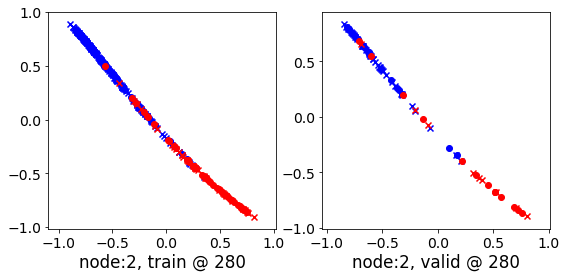

280 	 3 	 0.37889081 	 0.32652199 	 0.50348228 	 0.47286236 	 0.84952551 	 0.83948755


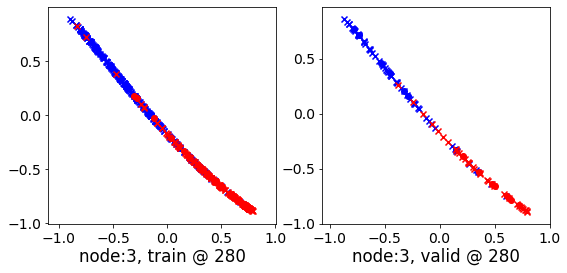

280 	 4 	 0.36655137 	 0.42826605 	 0.48728937 	 0.64036679 	 0.80483168 	 0.90524793


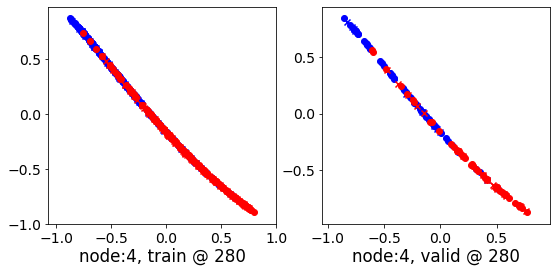

280 	 5 	 0.44063604 	 0.50749928 	 0.67992383 	 0.75869566 	 0.93966722 	 0.94434357


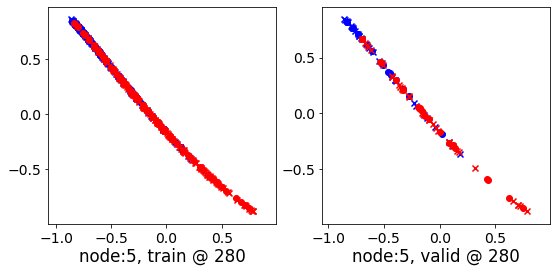

280 	 6 	 0.49000382 	 0.48232794 	 0.74075168 	 0.75315356 	 0.94772202 	 0.96397281


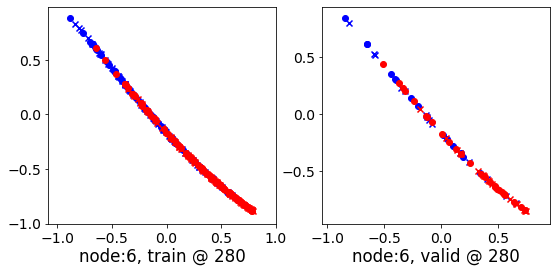

Aggregating on epoch: 282...
Aggregating on epoch: 284...
Aggregating on epoch: 286...
Aggregating on epoch: 288...
Aggregating on epoch: 290...
Aggregating on epoch: 292...
Aggregating on epoch: 294...
Aggregating on epoch: 296...
Aggregating on epoch: 298...
Aggregating on epoch: 300...
300 	 0 	 -0.16988273 	 -0.16519062 	 0.03115983 	 0.04031510 	 0.89443707 	 0.89865291


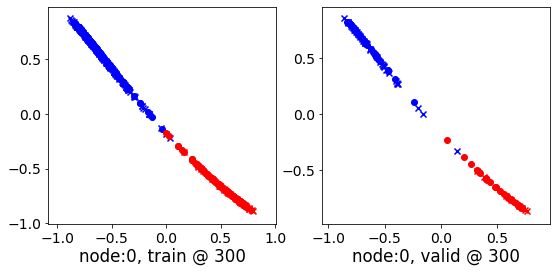

300 	 1 	 -0.03620270 	 -0.04426393 	 0.17446522 	 0.18719336 	 0.92637265 	 0.92460448


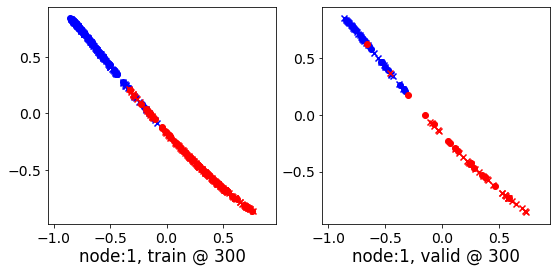

300 	 2 	 0.12584874 	 0.33986646 	 0.33445442 	 0.58778375 	 0.92918092 	 0.94106448


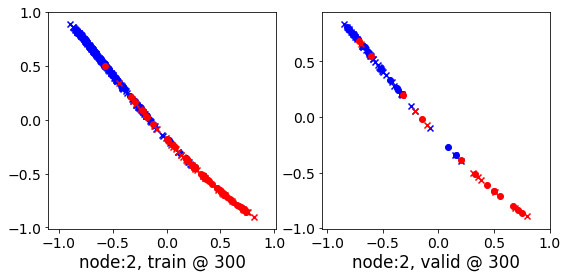

300 	 3 	 0.36277503 	 0.32603407 	 0.49781919 	 0.47131014 	 0.84815788 	 0.83842325


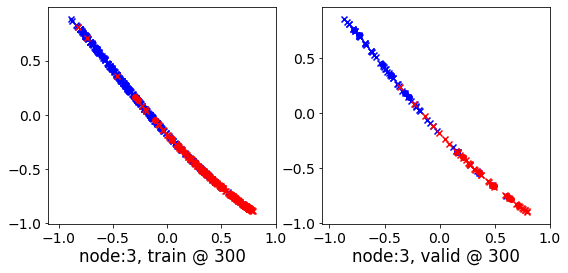

300 	 4 	 0.26061404 	 0.43334061 	 0.70702350 	 0.64401096 	 1.14748561 	 0.90381753


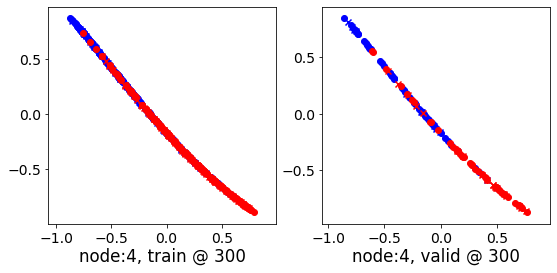

300 	 5 	 0.43343502 	 0.50263840 	 0.67548257 	 0.75407058 	 0.93956959 	 0.94457936


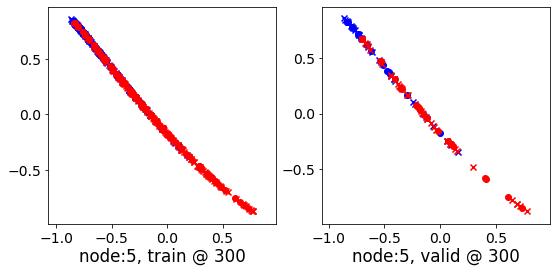

300 	 6 	 0.48714387 	 0.48084152 	 0.73843485 	 0.75070047 	 0.94763917 	 0.96300614


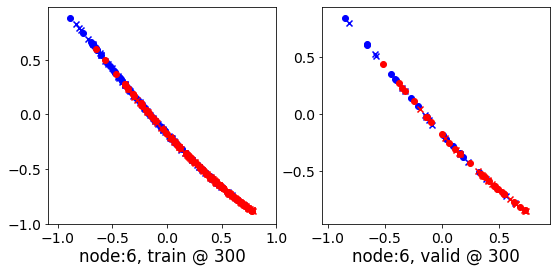

Aggregating on epoch: 302...
Aggregating on epoch: 304...
Aggregating on epoch: 306...
Aggregating on epoch: 308...
Aggregating on epoch: 310...
Aggregating on epoch: 312...
Aggregating on epoch: 314...
Aggregating on epoch: 316...
Aggregating on epoch: 318...
Aggregating on epoch: 320...
320 	 0 	 -0.17232421 	 -0.16711178 	 0.02544437 	 0.03578886 	 0.89101022 	 0.89604783


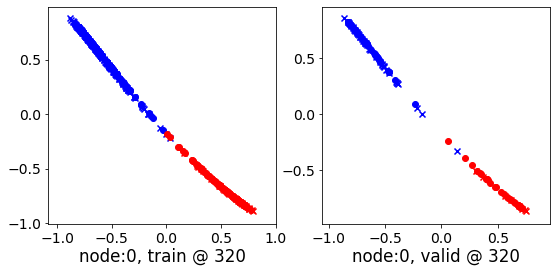

320 	 1 	 -0.05777617 	 -0.05740601 	 0.15854049 	 0.17447066 	 0.92693895 	 0.92502385


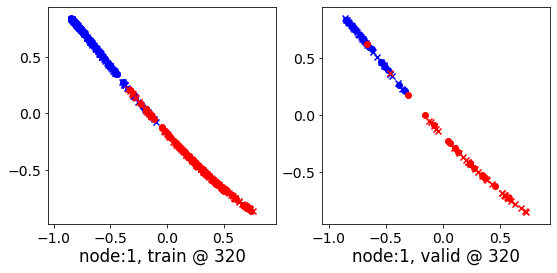

320 	 2 	 0.12062934 	 0.34511948 	 0.33246729 	 0.59309334 	 0.92849940 	 0.94112104


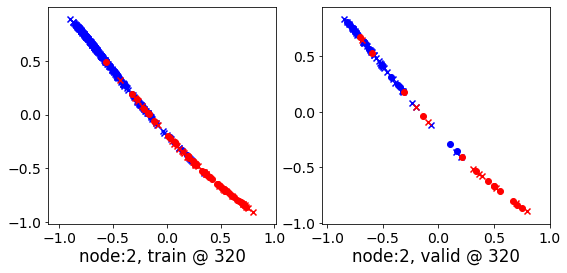

320 	 3 	 0.35680550 	 0.32724515 	 0.49613795 	 0.47015545 	 0.84635913 	 0.83605748


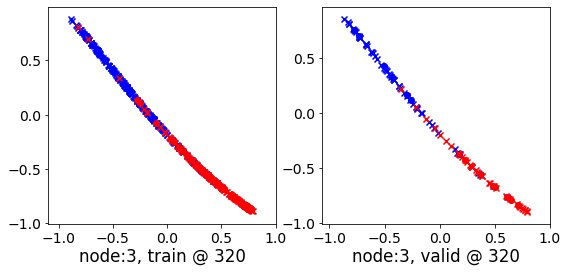

320 	 4 	 0.78925991 	 0.43912870 	 0.78368282 	 0.64948165 	 0.68949497 	 0.90350014


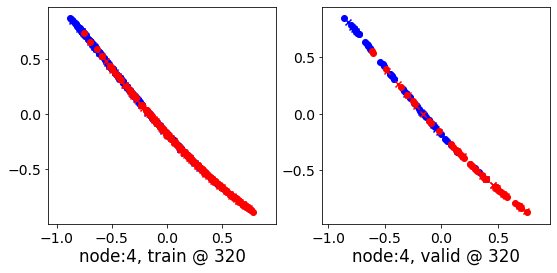

320 	 5 	 0.42791486 	 0.50031477 	 0.67200190 	 0.75184363 	 0.93971771 	 0.94467604


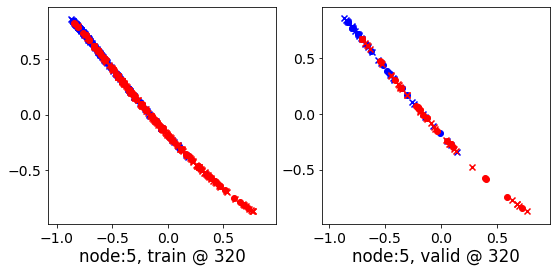

320 	 6 	 0.48587859 	 0.47817326 	 0.73609096 	 0.74764472 	 0.94739449 	 0.96261865


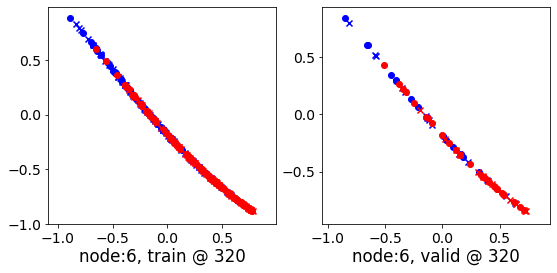

Aggregating on epoch: 322...
Aggregating on epoch: 324...
Aggregating on epoch: 326...
Aggregating on epoch: 328...
Aggregating on epoch: 330...
Aggregating on epoch: 332...
Aggregating on epoch: 334...
Aggregating on epoch: 336...
Aggregating on epoch: 338...
Aggregating on epoch: 340...
340 	 0 	 -0.17314844 	 -0.16808328 	 0.02116647 	 0.03238526 	 0.88757491 	 0.89361572


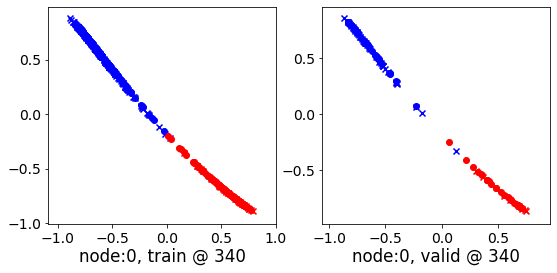

340 	 1 	 -0.06833655 	 -0.06402570 	 0.15029947 	 0.16905403 	 0.92815453 	 0.92622691


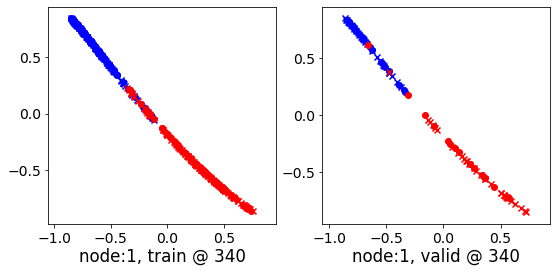

340 	 2 	 0.10777771 	 0.35252744 	 0.32832783 	 0.59966099 	 0.92705500 	 0.94028074


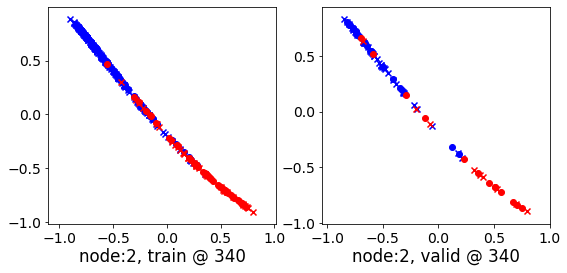

340 	 3 	 0.35019654 	 0.32946789 	 0.49373800 	 0.47021490 	 0.84422052 	 0.83389419


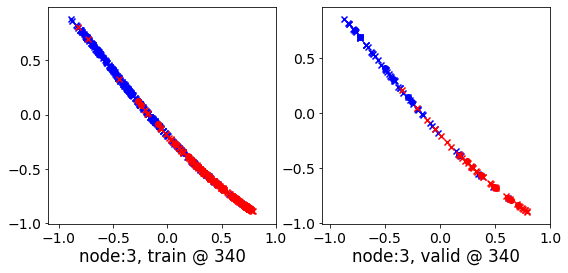

340 	 4 	 0.60013127 	 0.43681550 	 0.77145183 	 0.64896142 	 0.87777156 	 0.90529311


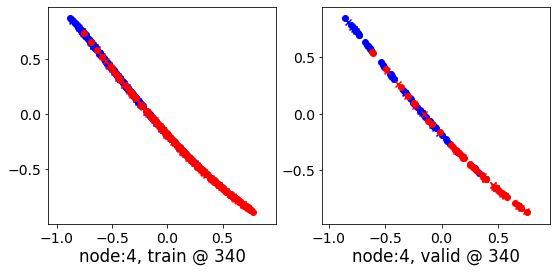

340 	 5 	 0.42419088 	 0.49781418 	 0.66937578 	 0.74938321 	 0.93997711 	 0.94471622


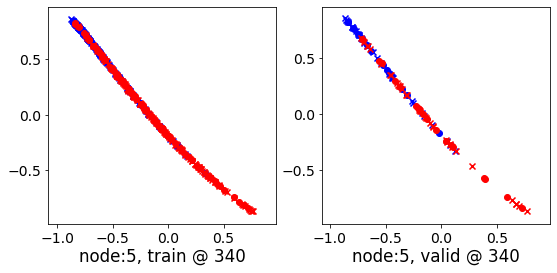

340 	 6 	 0.48262137 	 0.47439778 	 0.73339880 	 0.74425107 	 0.94703567 	 0.96300048


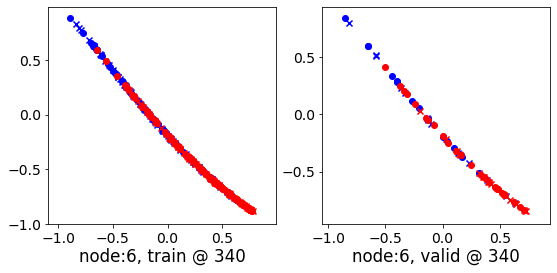

Aggregating on epoch: 342...
Aggregating on epoch: 344...
Aggregating on epoch: 346...
Aggregating on epoch: 348...
Aggregating on epoch: 350...
Aggregating on epoch: 352...
Aggregating on epoch: 354...
Aggregating on epoch: 356...
Aggregating on epoch: 358...
Aggregating on epoch: 360...
360 	 0 	 -0.17377527 	 -0.16977556 	 0.01766881 	 0.02852588 	 0.88481426 	 0.89144862


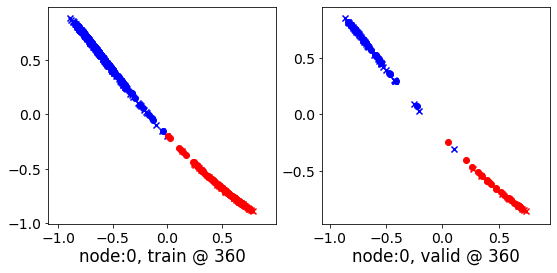

360 	 1 	 -0.07605818 	 -0.06616777 	 0.14638351 	 0.16843510 	 0.92968571 	 0.92775005


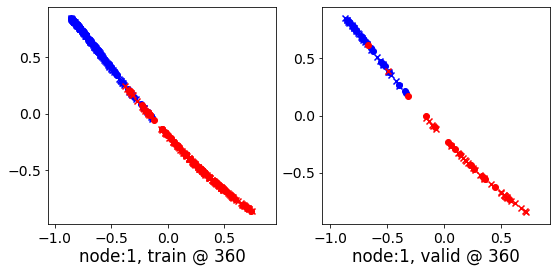

360 	 2 	 0.09922582 	 0.36259669 	 0.32376271 	 0.60790175 	 0.92488366 	 0.93845224


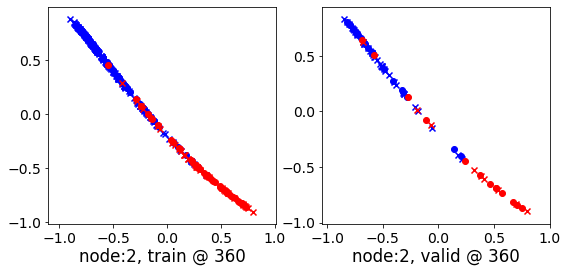

360 	 3 	 0.34722927 	 0.33497152 	 0.49153626 	 0.47145507 	 0.84215152 	 0.82963073


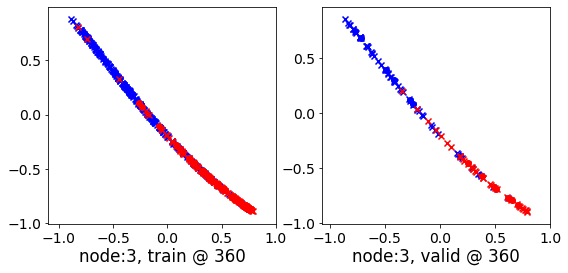

360 	 4 	 0.67981768 	 0.44027185 	 0.72603106 	 0.65107918 	 0.74631190 	 0.90395451


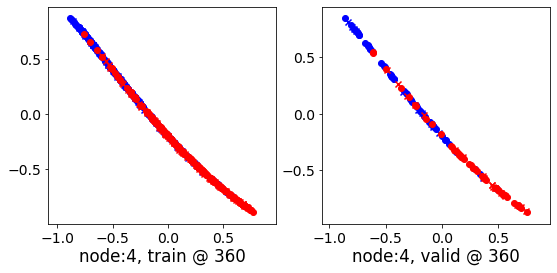

360 	 5 	 0.42148834 	 0.49556768 	 0.66715944 	 0.74697673 	 0.94020587 	 0.94455624


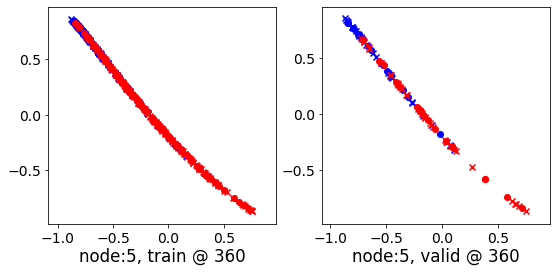

360 	 6 	 0.47959095 	 0.47117800 	 0.73054701 	 0.74151677 	 0.94656473 	 0.96348596


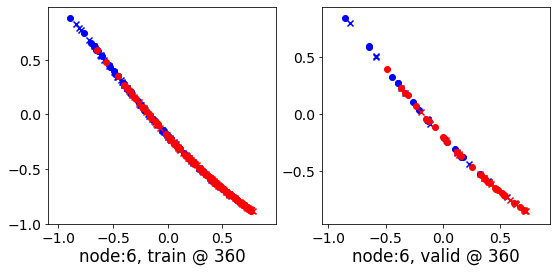

Aggregating on epoch: 362...
Aggregating on epoch: 364...
Aggregating on epoch: 366...
Aggregating on epoch: 368...
Aggregating on epoch: 370...
Aggregating on epoch: 372...
Aggregating on epoch: 374...
Aggregating on epoch: 376...
Aggregating on epoch: 378...
Aggregating on epoch: 380...
380 	 0 	 -0.17484322 	 -0.17187485 	 0.01493422 	 0.02531228 	 0.88327044 	 0.89033431


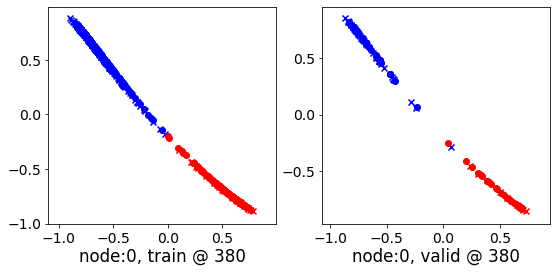

380 	 1 	 -0.08222543 	 -0.06791952 	 0.14410865 	 0.16838607 	 0.93157876 	 0.92945278


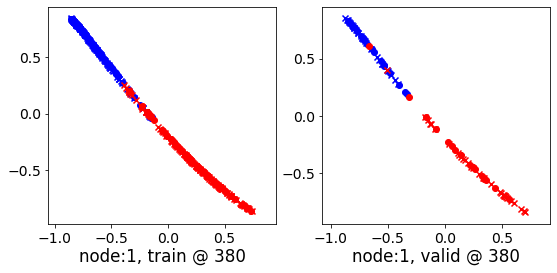

380 	 2 	 0.09450835 	 0.36605215 	 0.32048807 	 0.60945356 	 0.92229551 	 0.93654859


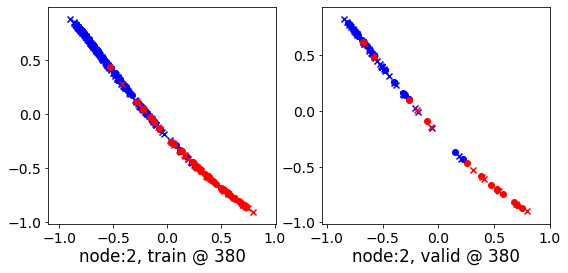

380 	 3 	 0.34612942 	 0.33941266 	 0.48997733 	 0.47099224 	 0.84018463 	 0.82472676


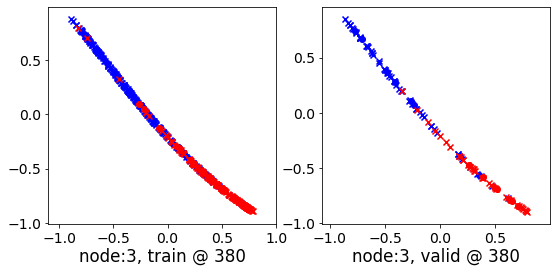

380 	 4 	 0.44676495 	 0.42913795 	 0.62322015 	 0.64021617 	 0.87161160 	 0.90422541


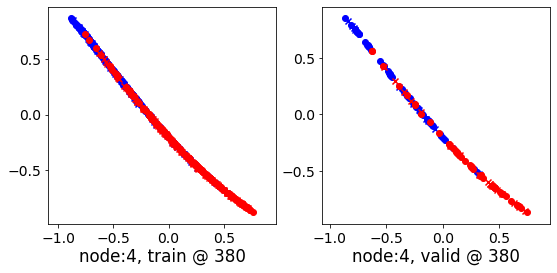

380 	 5 	 0.41897136 	 0.49295068 	 0.66530848 	 0.74411970 	 0.94043881 	 0.94431621


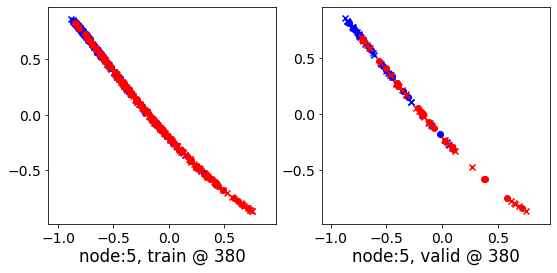

380 	 6 	 0.47804624 	 0.46650910 	 0.72827631 	 0.73820466 	 0.94584614 	 0.96484274


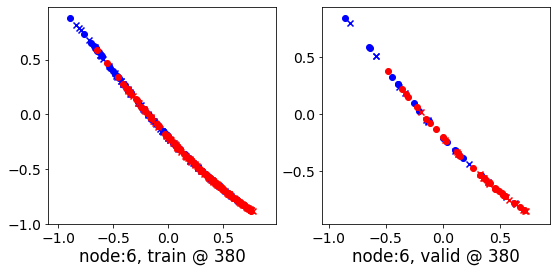

Aggregating on epoch: 382...
Aggregating on epoch: 384...
Aggregating on epoch: 386...
Aggregating on epoch: 388...
Aggregating on epoch: 390...
Aggregating on epoch: 392...
Aggregating on epoch: 394...
Aggregating on epoch: 396...
Aggregating on epoch: 398...
Aggregating on epoch: 400...
400 	 0 	 -0.17637579 	 -0.17395622 	 0.01275934 	 0.02310383 	 0.88266009 	 0.89020723


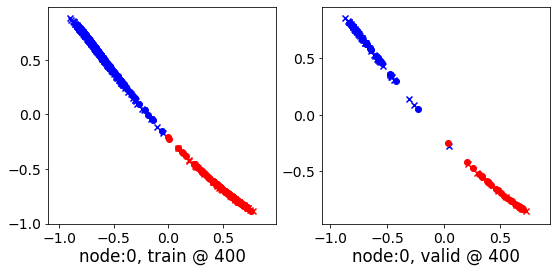

400 	 1 	 -0.08514129 	 -0.06852548 	 0.14331044 	 0.16952409 	 0.93342954 	 0.93119675


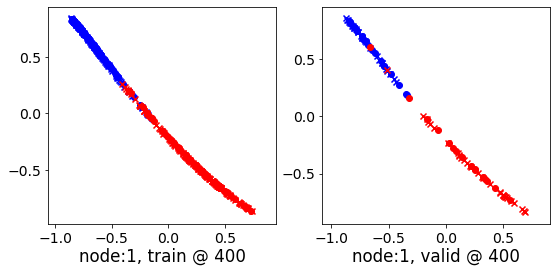

400 	 2 	 0.09206295 	 0.36998808 	 0.31753621 	 0.61196434 	 0.91952217 	 0.93512344


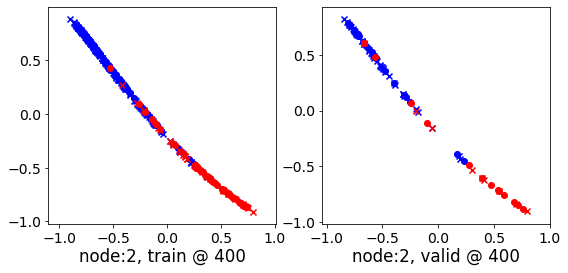

400 	 3 	 0.34475711 	 0.34138498 	 0.48846471 	 0.47022399 	 0.83861428 	 0.82198620


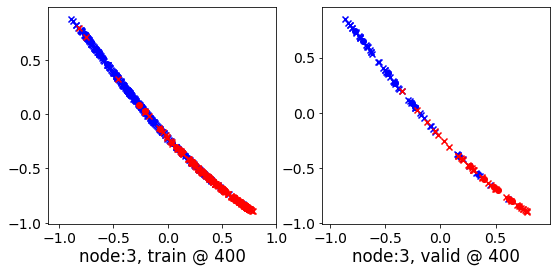

400 	 4 	 0.56612051 	 0.44181973 	 0.68083942 	 0.65313631 	 0.80887926 	 0.90446377


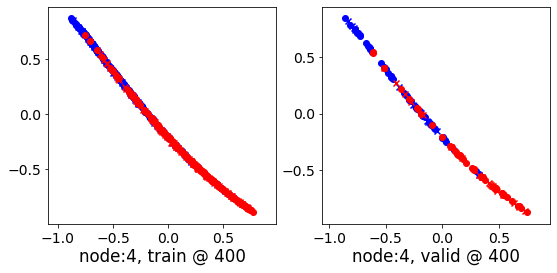

400 	 5 	 0.41732651 	 0.49131966 	 0.66378975 	 0.74197072 	 0.94052893 	 0.94379824


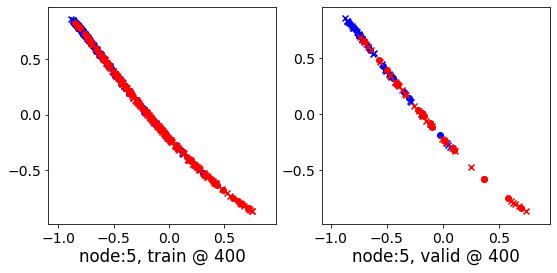

400 	 6 	 0.47639447 	 0.46083701 	 0.72632432 	 0.73460156 	 0.94500875 	 0.96691173


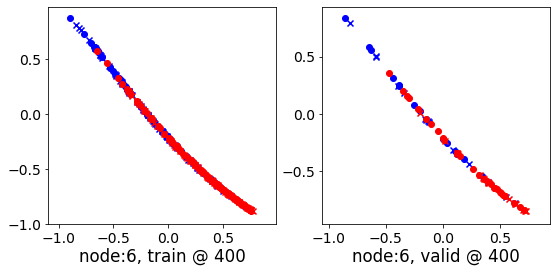

Aggregating on epoch: 402...
Aggregating on epoch: 404...
Aggregating on epoch: 406...
Aggregating on epoch: 408...
Aggregating on epoch: 410...
Aggregating on epoch: 412...
Aggregating on epoch: 414...
Aggregating on epoch: 416...
Aggregating on epoch: 418...
Aggregating on epoch: 420...
420 	 0 	 -0.17669308 	 -0.17447269 	 0.01158127 	 0.02271992 	 0.88249242 	 0.89033979


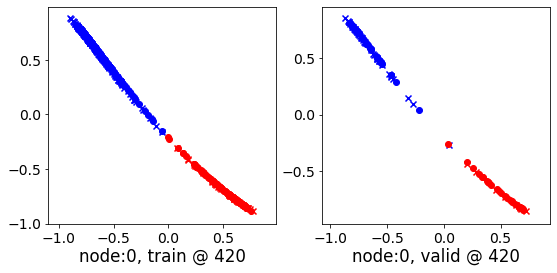

420 	 1 	 -0.09281960 	 -0.07244077 	 0.14100495 	 0.16620752 	 0.93400943 	 0.93179548


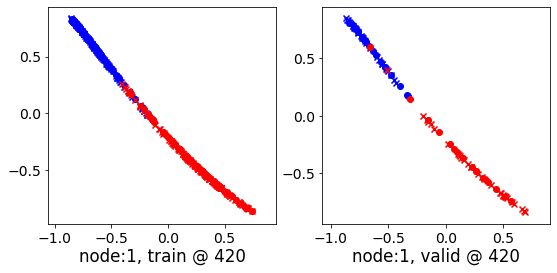

420 	 2 	 0.09223178 	 0.36573583 	 0.31687081 	 0.60773540 	 0.91843647 	 0.93514675


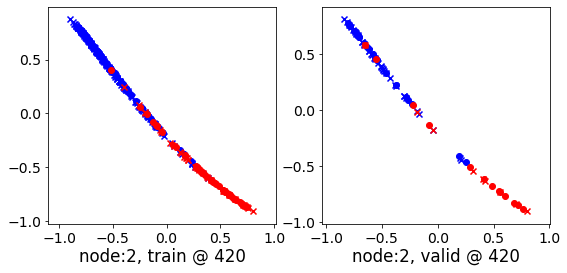

420 	 3 	 0.34657216 	 0.33854485 	 0.48900646 	 0.46627039 	 0.83799171 	 0.82087272


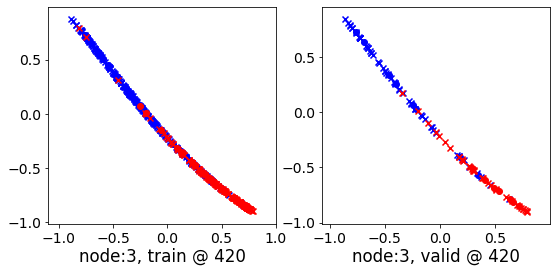

420 	 4 	 0.22783467 	 0.44946808 	 0.36818612 	 0.66163570 	 0.83762395 	 0.90531480


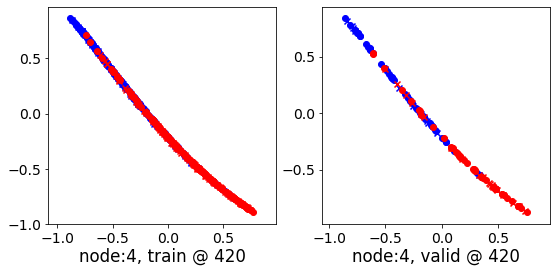

420 	 5 	 0.41552901 	 0.49171239 	 0.66268659 	 0.74184459 	 0.94042689 	 0.94327939


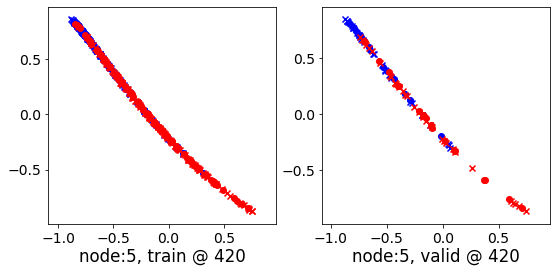

420 	 6 	 0.47742492 	 0.45703530 	 0.72595704 	 0.73283488 	 0.94459218 	 0.96894675


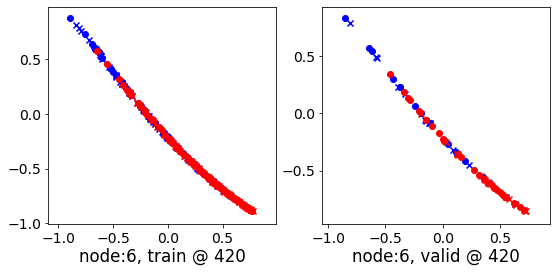

Aggregating on epoch: 422...
Aggregating on epoch: 424...
Aggregating on epoch: 426...
Aggregating on epoch: 428...
Aggregating on epoch: 430...
Aggregating on epoch: 432...
Aggregating on epoch: 434...
Aggregating on epoch: 436...
Aggregating on epoch: 438...
Aggregating on epoch: 440...
440 	 0 	 -0.17738923 	 -0.17510545 	 0.01076236 	 0.02118181 	 0.88237357 	 0.88943446


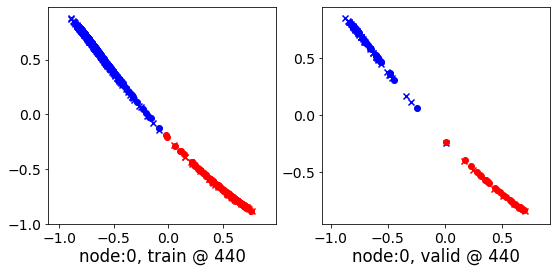

440 	 1 	 -0.09178893 	 -0.06873064 	 0.14119157 	 0.17002745 	 0.93429291 	 0.93190527


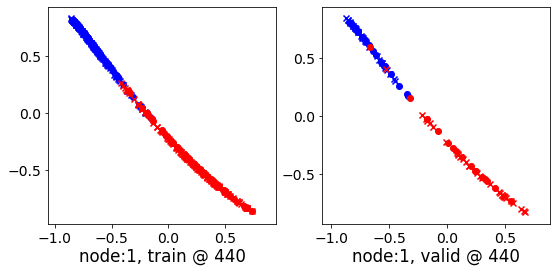

440 	 2 	 0.09093881 	 0.37221748 	 0.31464607 	 0.61296988 	 0.91709512 	 0.93389958


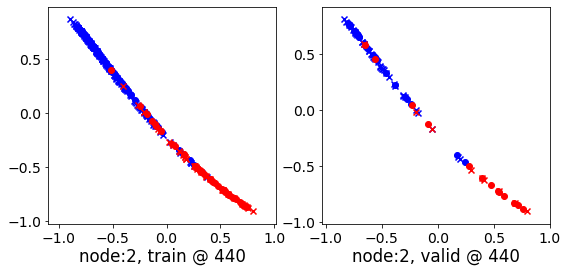

440 	 3 	 0.34474561 	 0.34694374 	 0.48690510 	 0.46916652 	 0.83739197 	 0.81536996


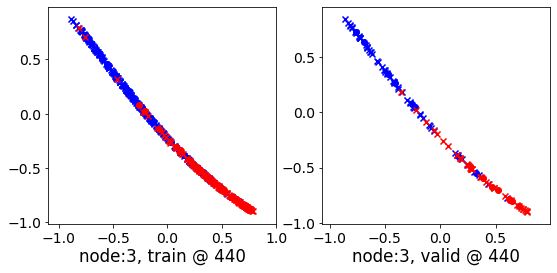

440 	 4 	 0.41198575 	 0.43457896 	 0.60433042 	 0.64610910 	 0.88554478 	 0.90467733


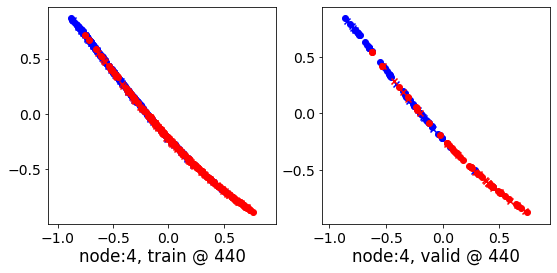

440 	 5 	 0.41508406 	 0.48981977 	 0.66172898 	 0.73949605 	 0.94023162 	 0.94282347


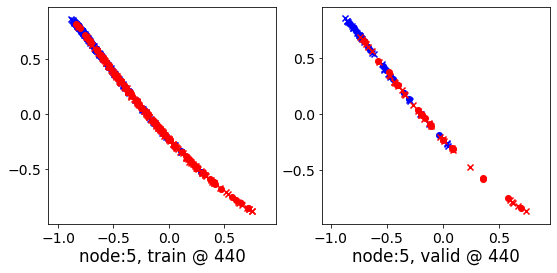

440 	 6 	 0.47514307 	 0.45482564 	 0.72378737 	 0.73150486 	 0.94413733 	 0.96982640


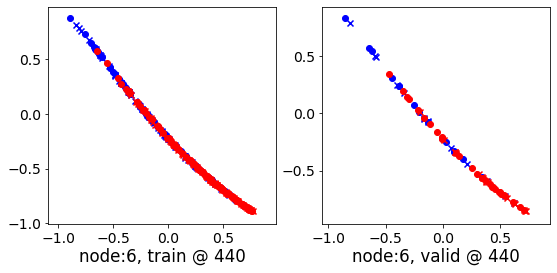

Aggregating on epoch: 442...
Aggregating on epoch: 444...
Aggregating on epoch: 446...
Aggregating on epoch: 448...
Aggregating on epoch: 450...
Aggregating on epoch: 452...
Aggregating on epoch: 454...
Aggregating on epoch: 456...
Aggregating on epoch: 458...
Aggregating on epoch: 460...
460 	 0 	 -0.17825559 	 -0.17533123 	 0.01028509 	 0.02051311 	 0.88223082 	 0.88899153


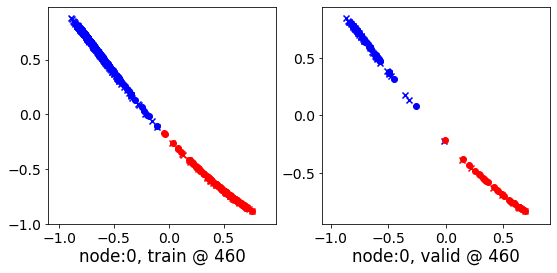

460 	 1 	 -0.08711231 	 -0.06408022 	 0.14234640 	 0.17460723 	 0.93437940 	 0.93183464


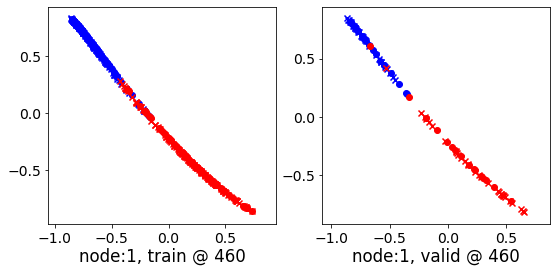

460 	 2 	 0.09203649 	 0.37900972 	 0.31392223 	 0.61910170 	 0.91630876 	 0.93323916


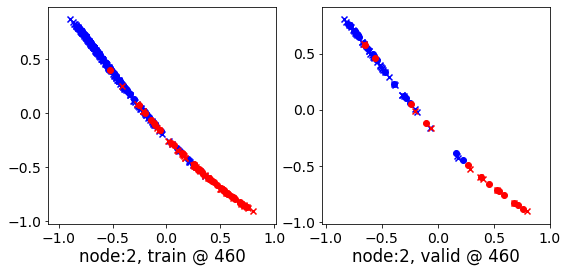

460 	 3 	 0.34332138 	 0.35516834 	 0.48590890 	 0.47175485 	 0.83676207 	 0.80973369


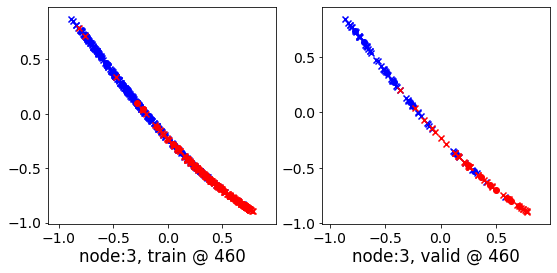

460 	 4 	 0.52454418 	 0.42013693 	 0.63430136 	 0.63220584 	 0.80842465 	 0.90521610


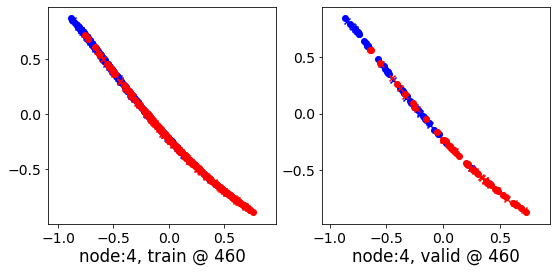

460 	 5 	 0.41584790 	 0.48877233 	 0.66145694 	 0.73818952 	 0.94006068 	 0.94256437


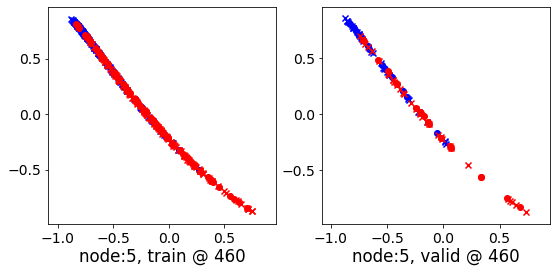

460 	 6 	 0.47308803 	 0.45523721 	 0.72245920 	 0.73214465 	 0.94379914 	 0.97005463


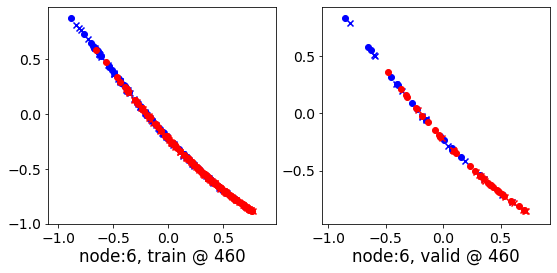

Aggregating on epoch: 462...
Aggregating on epoch: 464...
Aggregating on epoch: 466...
Aggregating on epoch: 468...
Aggregating on epoch: 470...
Aggregating on epoch: 472...
Aggregating on epoch: 474...
Aggregating on epoch: 476...
Aggregating on epoch: 478...
Aggregating on epoch: 480...
480 	 0 	 -0.17780232 	 -0.17461559 	 0.00987684 	 0.02143750 	 0.88210112 	 0.88920027


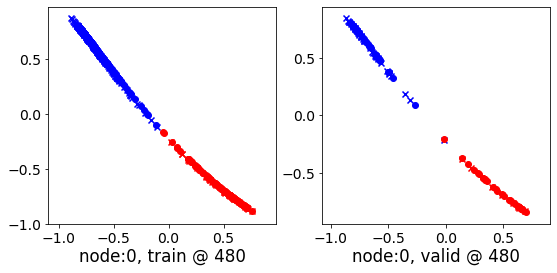

480 	 1 	 -0.09063616 	 -0.06577225 	 0.14017355 	 0.17253105 	 0.93386030 	 0.93145049


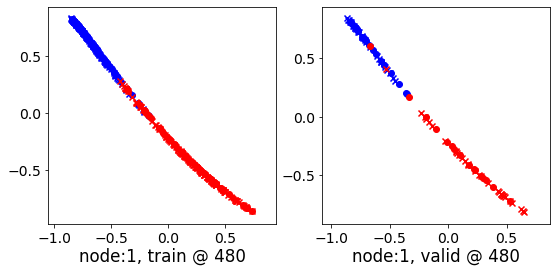

480 	 2 	 0.09233007 	 0.37782454 	 0.31346935 	 0.61867416 	 0.91668332 	 0.93399680


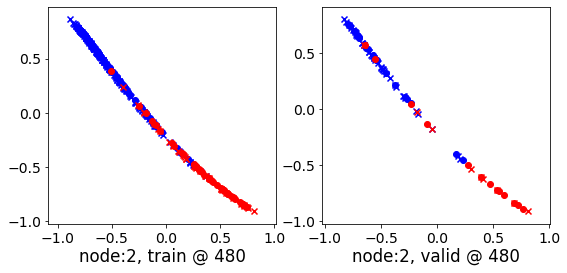

480 	 3 	 0.34336594 	 0.35384291 	 0.48578024 	 0.47025949 	 0.83694309 	 0.80956376


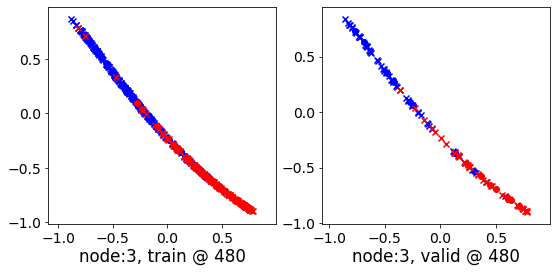

480 	 4 	 0.32182503 	 0.42930609 	 0.50843239 	 0.64043677 	 0.88126481 	 0.90427786


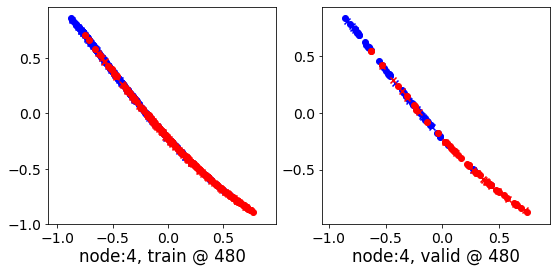

480 	 5 	 0.41488194 	 0.48904353 	 0.66035384 	 0.73810410 	 0.93982512 	 0.94220775


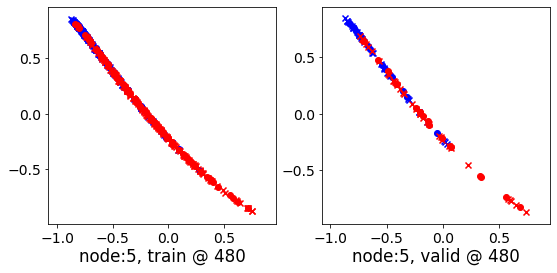

480 	 6 	 0.47273356 	 0.45431519 	 0.72215670 	 0.73177487 	 0.94388169 	 0.97060686


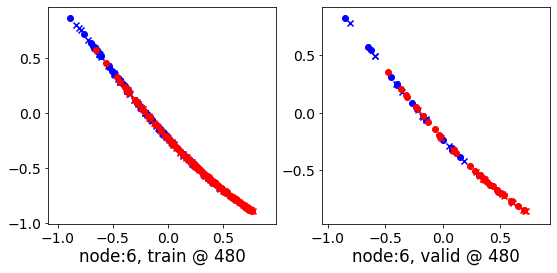

Aggregating on epoch: 482...
Aggregating on epoch: 484...
Aggregating on epoch: 486...
Aggregating on epoch: 488...
Aggregating on epoch: 490...
Aggregating on epoch: 492...
Aggregating on epoch: 494...
Aggregating on epoch: 496...
Aggregating on epoch: 498...
Aggregating on epoch: 500...
500 	 0 	 -0.17830160 	 -0.17483725 	 0.00981991 	 0.02028124 	 0.88203311 	 0.88826567


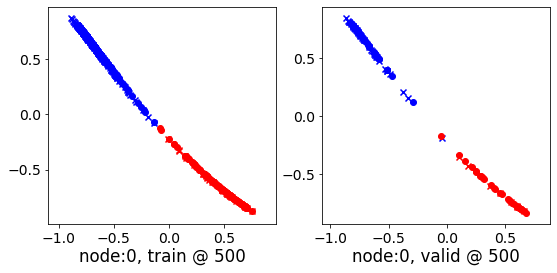

500 	 1 	 -0.08315316 	 -0.05829239 	 0.14300212 	 0.17971778 	 0.93381387 	 0.93115735


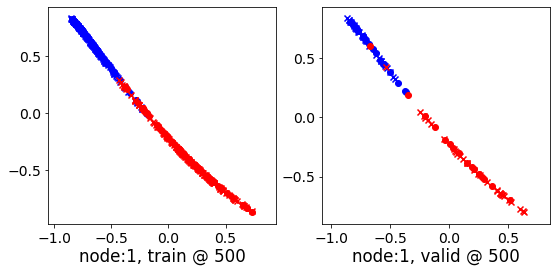

500 	 2 	 0.09872121 	 0.38944238 	 0.31512555 	 0.62945586 	 0.91646802 	 0.93316066


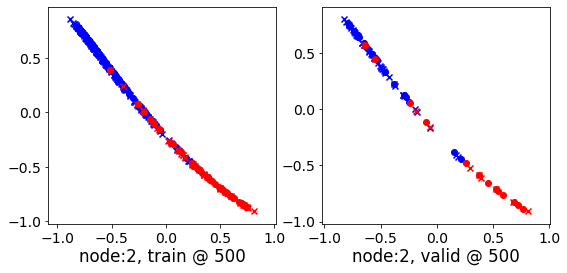

500 	 3 	 0.34166765 	 0.36187005 	 0.48576894 	 0.47565466 	 0.83740711 	 0.80693179


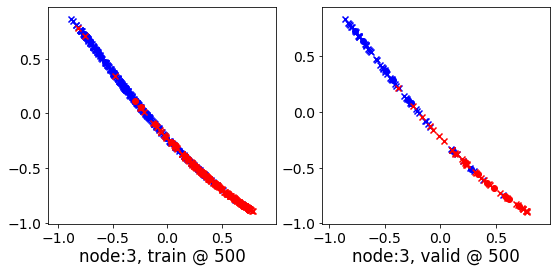

500 	 4 	 0.37108815 	 0.41410726 	 0.80370903 	 0.62539369 	 1.12473679 	 0.90443361


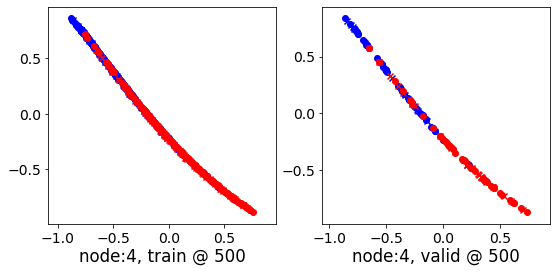

500 	 5 	 0.41624939 	 0.48799241 	 0.66062701 	 0.73677886 	 0.93966383 	 0.94193363


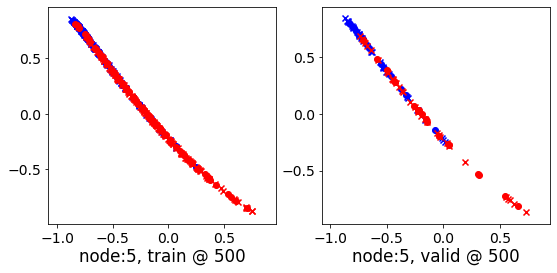

500 	 6 	 0.47115231 	 0.45634496 	 0.72130793 	 0.73308069 	 0.94374472 	 0.96988291


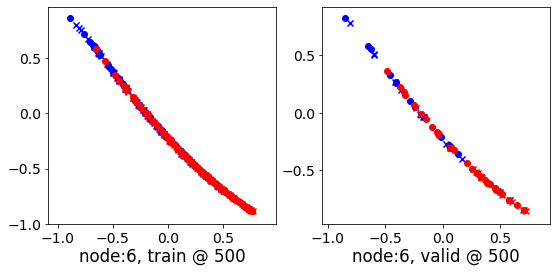

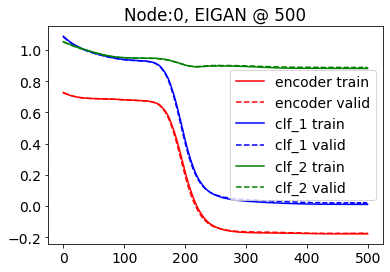

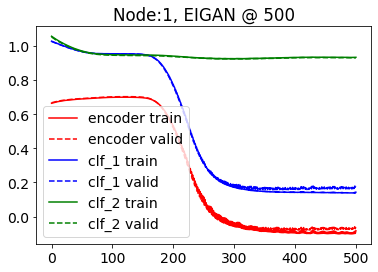

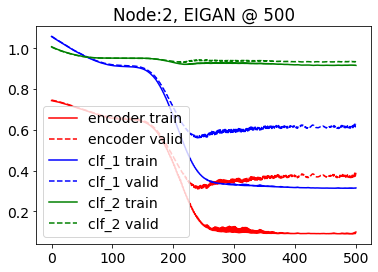

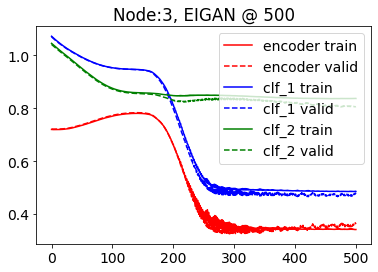

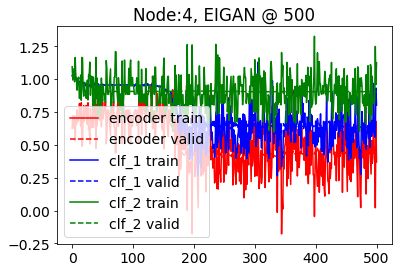

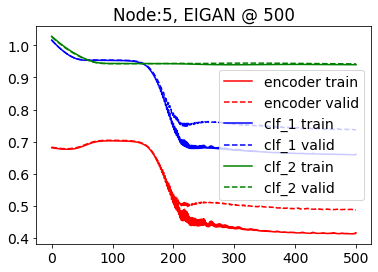

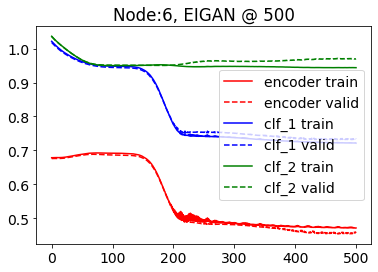

  0%|          | 1/501 [00:00<01:15,  6.64it/s]

epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.71633410 	 0.74207222 	 1.06104684 	 1.07669914 	 1.03794706 	 1.02777410


100%|██████████| 501/501 [01:03<00:00,  7.86it/s]


500 	 0.30750823 	 0.28799266 	 0.57029772 	 0.55364817 	 0.95590472 	 0.95880270


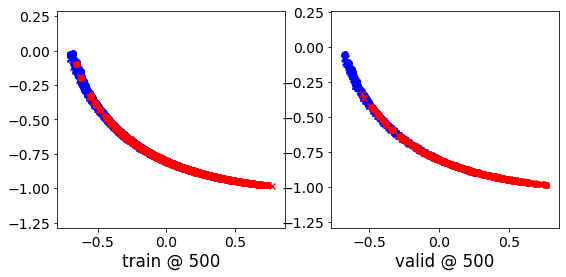

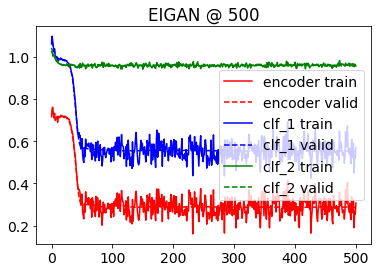

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.071709 	 1.071824 	 0.5568
200 	 0.585946 	 0.577431 	 0.8208
400 	 0.552429 	 0.547541 	 0.8222
600 	 0.552211 	 0.547506 	 0.8222
800 	 0.552089 	 0.547466 	 0.8222
1000 	 0.551996 	 0.547491 	 0.8222
Accuracy: 0.8221614227086184
Error Rate: 0.17783857729138167
F1 Score: 0.8076923076923077
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.813953488372093
Error Rate: 0.18604651162790697
F1 Score: 0.807909604519774
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8207934336525308
Error Rate: 0.179

@node 2: tensor sizes => torch.Size([494, 2]) (124, 2) torch.Size([494, 2]) (124, 2) torch.Size([494, 2]) (124, 2)
@node 3: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(523, 2) (131, 2) (523, 1) (131, 1) (523, 1) (131, 1)
@node 3: class weights => w1, w2 [array([1.30946292, 4.23140496]), array([3.234375  , 1.44755245]), array([1.44444444, 3.25      ]), array([2.93820225, 1.51594203])] [array([1.79649123, 2.25550661]), array([1.44755245, 3.234375  ]), array([1.45722714, 3.18709677]), array([1.52923977, 2.88950276])]
@node 3: tensor sizes => torch.Size([523, 2]) (131, 2) torch.Size([523, 2]) (131, 2) torch.Size([523, 2]) (131, 2)
@node 4: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(480, 2) (120, 2) (480, 1) (120, 1) (480, 1) (120, 1)
@node 4: class weights => w1, w2 [array([1.30946292, 4.23140496]), array([3.234375  , 1.44755245]), array([1.44444444, 3.25      ]), array([2.93820225, 1.51594203]), array([2.06008584, 1.94331984])] [array([1.79649123, 2.25

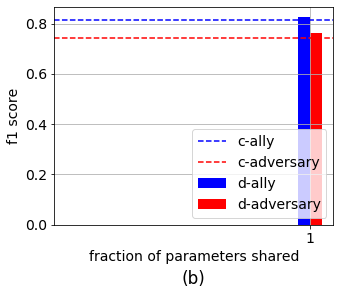

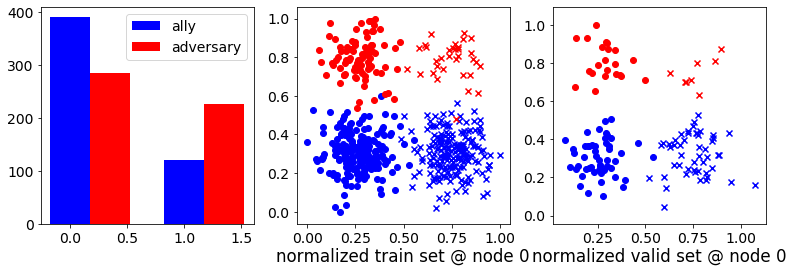

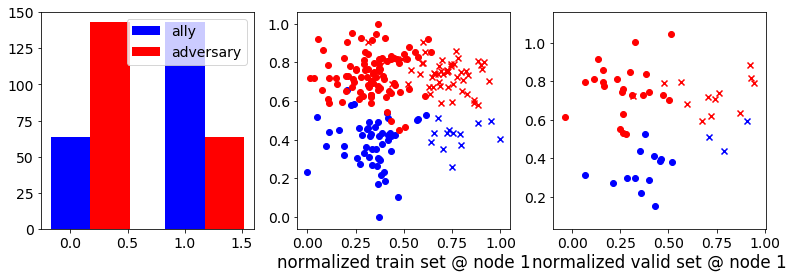

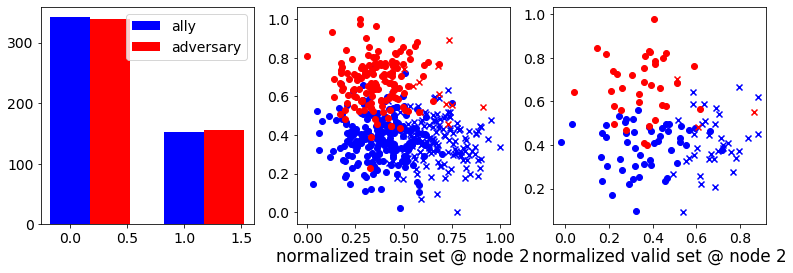

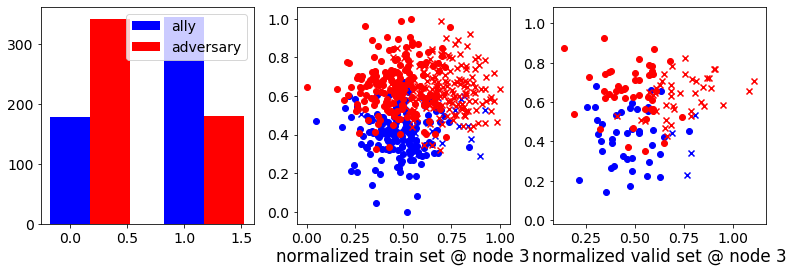

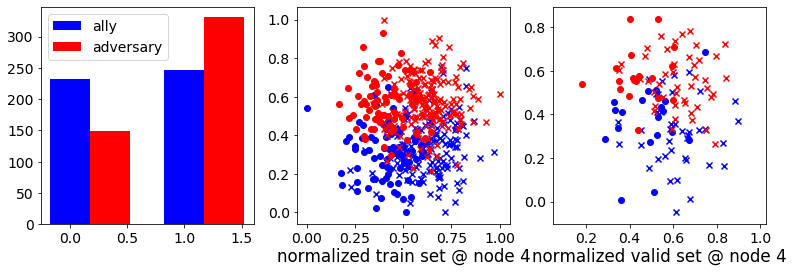

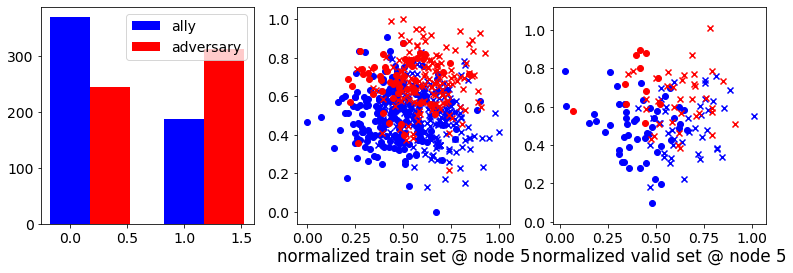

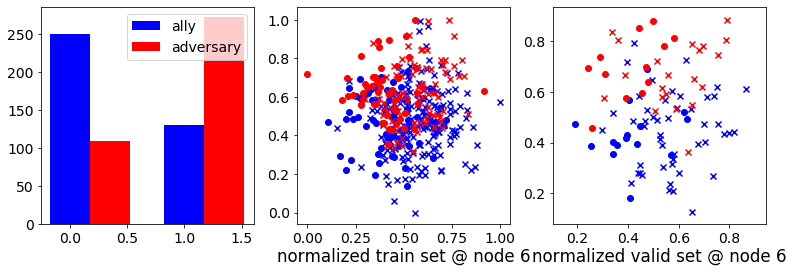

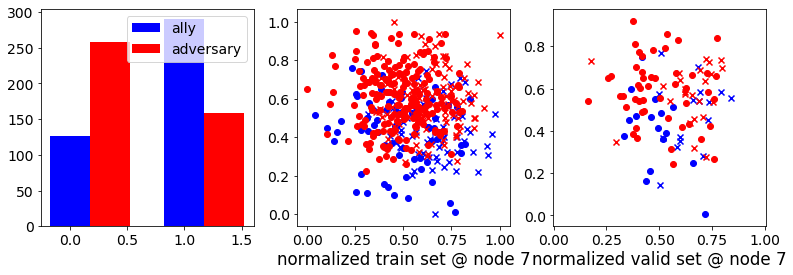

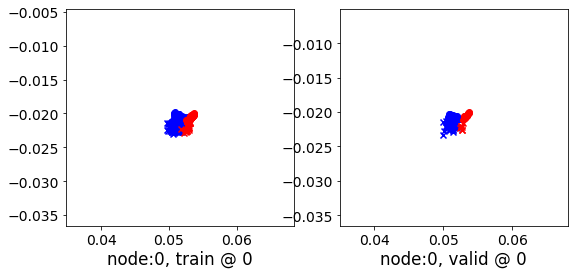

0 	 1 	 0.68661964 	 0.68583250 	 1.05581653 	 1.05224550 	 1.06241059 	 1.05956018


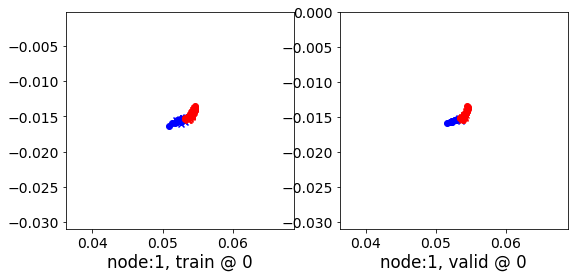

0 	 2 	 0.72804093 	 0.72668302 	 1.04516280 	 1.04273140 	 1.01030350 	 1.00919557


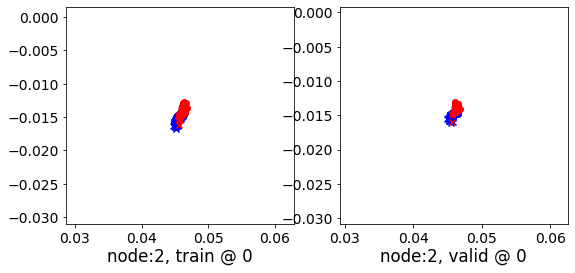

0 	 3 	 0.60507625 	 0.63239884 	 0.95993364 	 1.02728570 	 1.04813612 	 1.08803403


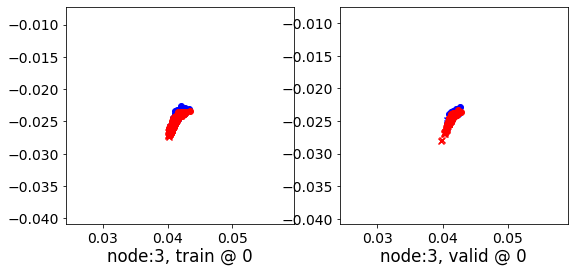

0 	 4 	 0.65253258 	 0.65399802 	 1.03089130 	 1.02880538 	 1.07172239 	 1.06795454


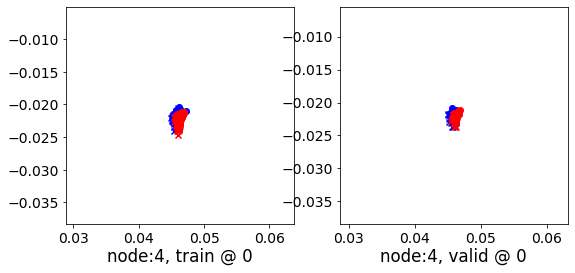

0 	 5 	 0.59785396 	 0.70716405 	 0.95529264 	 1.06649363 	 1.05071163 	 1.05247676


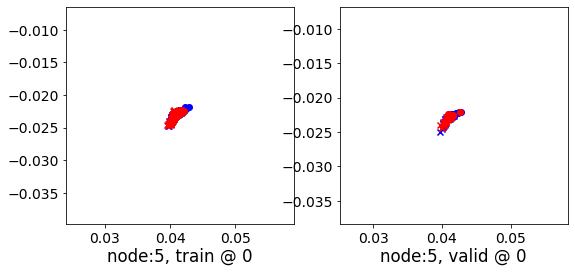

0 	 6 	 0.71360123 	 0.71651804 	 1.04785800 	 1.04574502 	 1.02750444 	 1.02237415


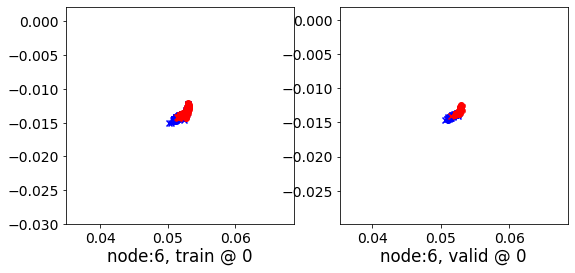

0 	 7 	 0.67662477 	 0.67680609 	 1.02701390 	 1.02559519 	 1.04358935 	 1.04193628


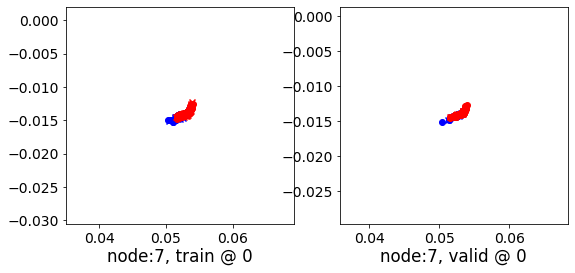

Aggregating on epoch: 2...
Aggregating on epoch: 4...
Aggregating on epoch: 6...
Aggregating on epoch: 8...
Aggregating on epoch: 10...
Aggregating on epoch: 12...
Aggregating on epoch: 14...
Aggregating on epoch: 16...
Aggregating on epoch: 18...
Aggregating on epoch: 20...
20 	 0 	 0.65926868 	 0.65598094 	 0.97157061 	 0.96639860 	 1.00551510 	 1.00356483


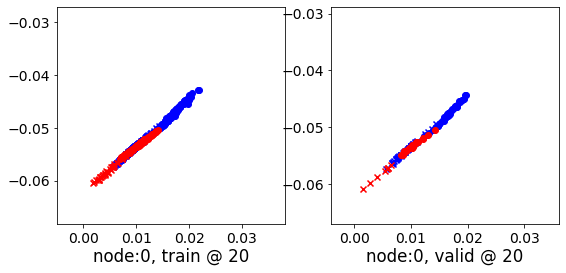

20 	 1 	 0.67789936 	 0.67722249 	 1.01339972 	 1.01032829 	 1.02877569 	 1.02625299


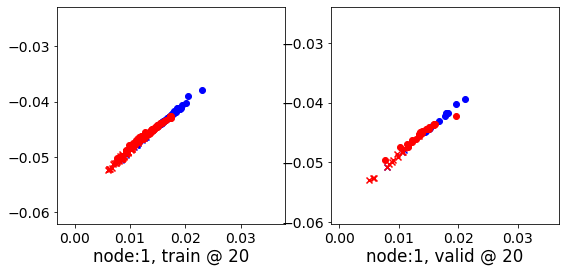

20 	 2 	 0.72146845 	 0.72006178 	 1.00815892 	 1.00593734 	 0.97992265 	 0.97902274


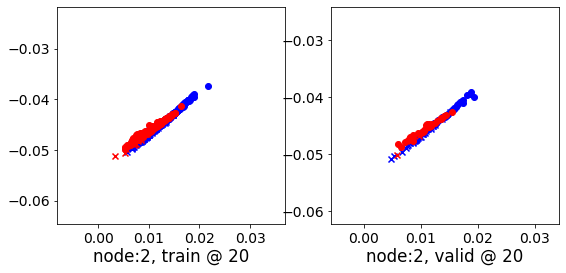

20 	 3 	 0.80465996 	 0.68123889 	 1.08268964 	 0.99522305 	 0.97118795 	 1.00713134


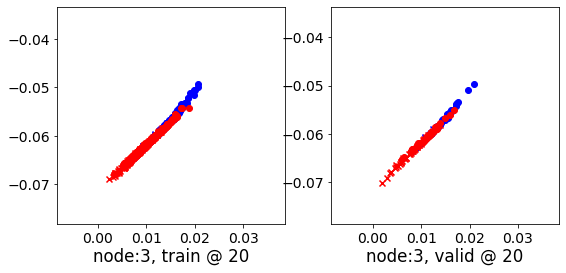

20 	 4 	 0.65806234 	 0.65944660 	 0.99284720 	 0.99114358 	 1.02808666 	 1.02484417


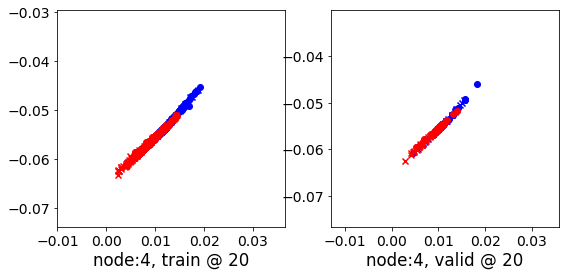

20 	 5 	 0.74506336 	 0.69286257 	 1.03084648 	 0.98263276 	 0.97925603 	 0.98291737


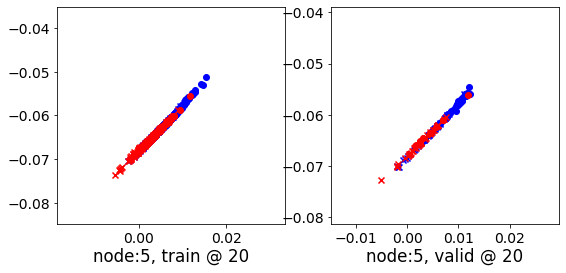

20 	 6 	 0.71010375 	 0.71337312 	 1.01104915 	 1.00922811 	 0.99424601 	 0.98900217


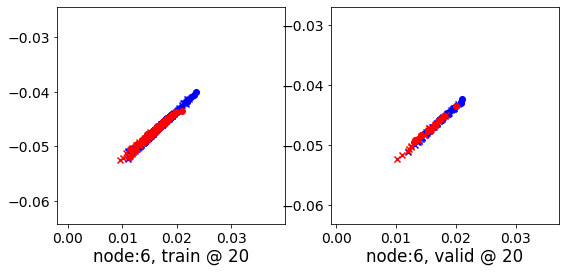

20 	 7 	 0.67141163 	 0.67127049 	 0.99731427 	 0.99611425 	 1.01908541 	 1.01799095


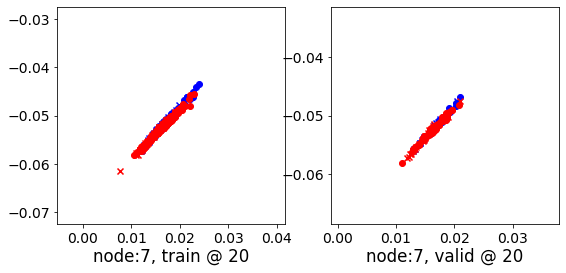

Aggregating on epoch: 22...
Aggregating on epoch: 24...
Aggregating on epoch: 26...
Aggregating on epoch: 28...
Aggregating on epoch: 30...
Aggregating on epoch: 32...
Aggregating on epoch: 34...
Aggregating on epoch: 36...
Aggregating on epoch: 38...
Aggregating on epoch: 40...
40 	 0 	 0.66206110 	 0.65872771 	 0.94545829 	 0.94056082 	 0.97662532 	 0.97498029


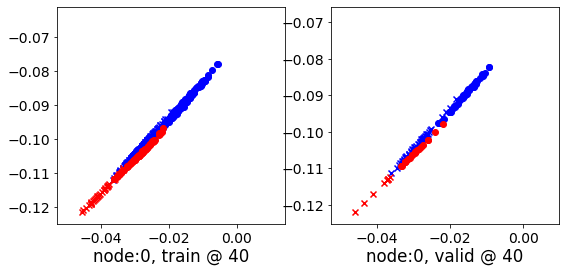

40 	 1 	 0.67417729 	 0.67375255 	 0.97973734 	 0.97714853 	 0.99894106 	 0.99654317


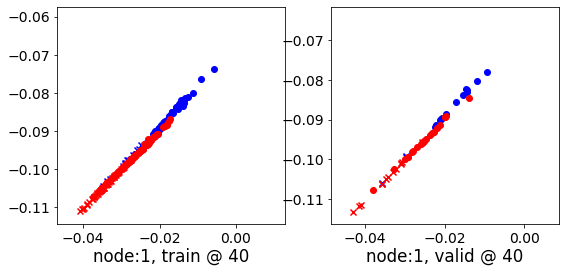

40 	 2 	 0.71260691 	 0.71090901 	 0.97648823 	 0.97443926 	 0.95715255 	 0.95667744


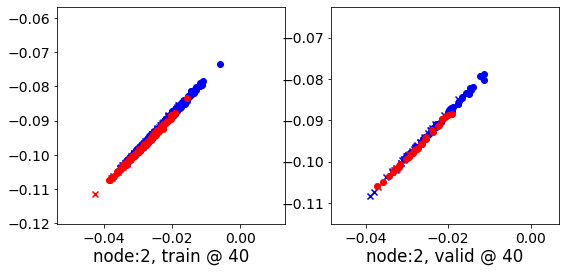

40 	 3 	 0.87432981 	 0.70845985 	 0.97821134 	 0.96866411 	 0.79715228 	 0.95335144


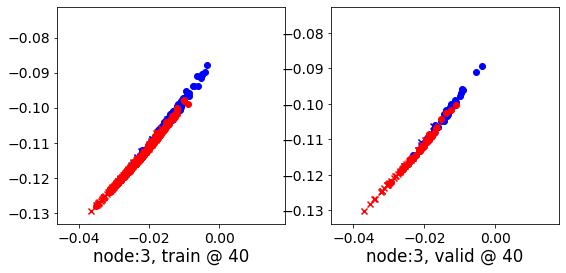

40 	 4 	 0.66410816 	 0.66587144 	 0.96434826 	 0.96322519 	 0.99352843 	 0.99050093


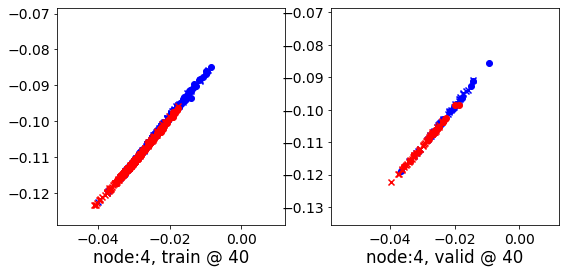

40 	 5 	 0.58811820 	 0.68144149 	 0.86272621 	 0.94077975 	 0.96780002 	 0.95248544


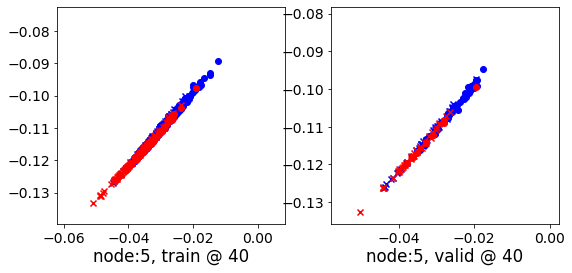

40 	 6 	 0.70735800 	 0.71082801 	 0.97799063 	 0.97630727 	 0.96401674 	 0.95862645


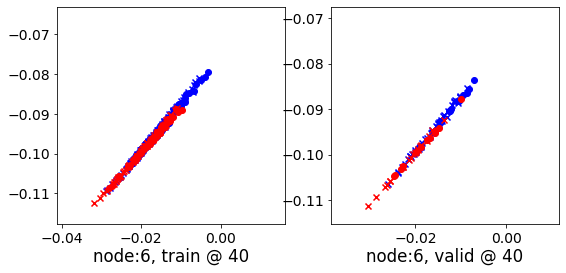

40 	 7 	 0.66471559 	 0.66481364 	 0.97116876 	 0.97018290 	 0.99965268 	 0.99851644


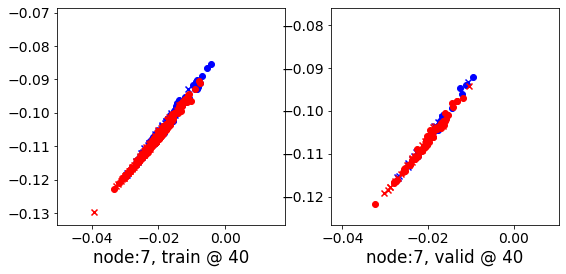

Aggregating on epoch: 42...
Aggregating on epoch: 44...
Aggregating on epoch: 46...
Aggregating on epoch: 48...
Aggregating on epoch: 50...
Aggregating on epoch: 52...
Aggregating on epoch: 54...
Aggregating on epoch: 56...
Aggregating on epoch: 58...
Aggregating on epoch: 60...
60 	 0 	 0.66202009 	 0.65803516 	 0.92713434 	 0.92220038 	 0.95835233 	 0.95731241


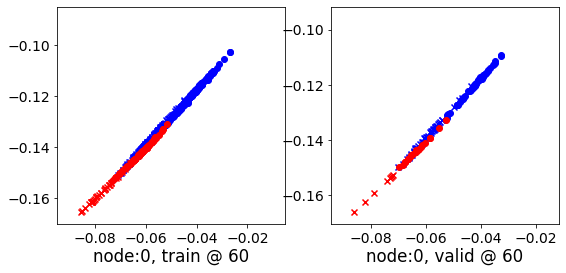

60 	 1 	 0.67652434 	 0.67634583 	 0.95425177 	 0.95217884 	 0.97113359 	 0.96898019


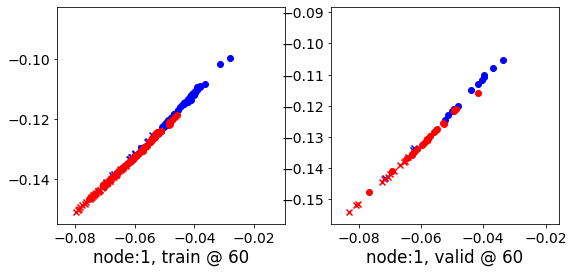

60 	 2 	 0.70140922 	 0.69970989 	 0.95083112 	 0.94909096 	 0.94264907 	 0.94252825


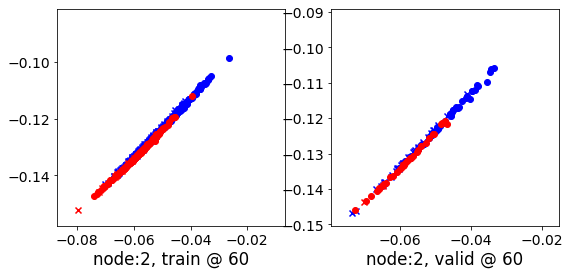

60 	 3 	 0.61773598 	 0.70528579 	 0.87619734 	 0.94921279 	 0.95174801 	 0.93707418


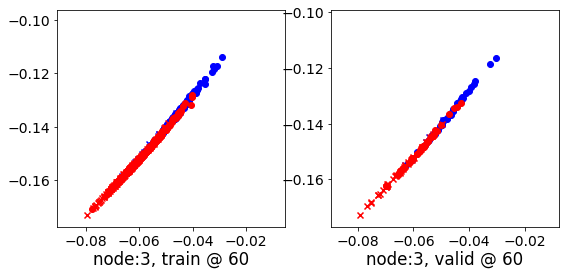

60 	 4 	 0.68566066 	 0.68794000 	 0.95426923 	 0.95403230 	 0.96185225 	 0.95923948


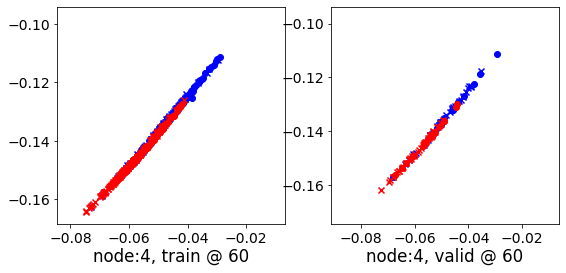

60 	 5 	 0.78596622 	 0.67719150 	 1.01862621 	 0.93527973 	 0.92581147 	 0.95123541


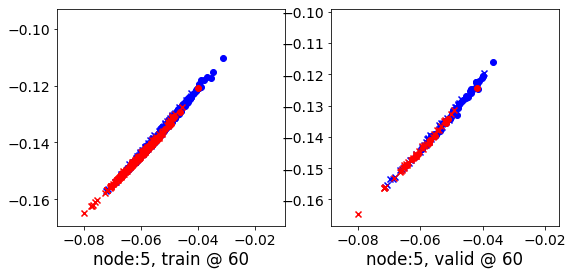

60 	 6 	 0.70507401 	 0.70894957 	 0.95165271 	 0.95051306 	 0.93995428 	 0.93471068


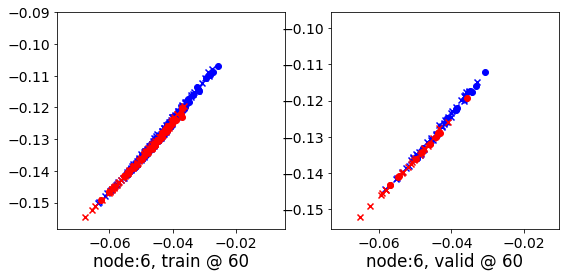

60 	 7 	 0.66403788 	 0.66450268 	 0.95021570 	 0.94955456 	 0.97938859 	 0.97819906


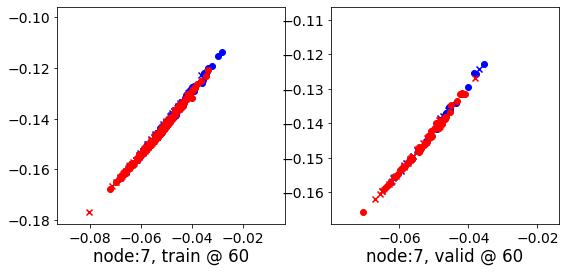

Aggregating on epoch: 62...
Aggregating on epoch: 64...
Aggregating on epoch: 66...
Aggregating on epoch: 68...
Aggregating on epoch: 70...
Aggregating on epoch: 72...
Aggregating on epoch: 74...
Aggregating on epoch: 76...
Aggregating on epoch: 78...
Aggregating on epoch: 80...
80 	 0 	 0.65533358 	 0.65063417 	 0.91477907 	 0.90963614 	 0.95267719 	 0.95214915


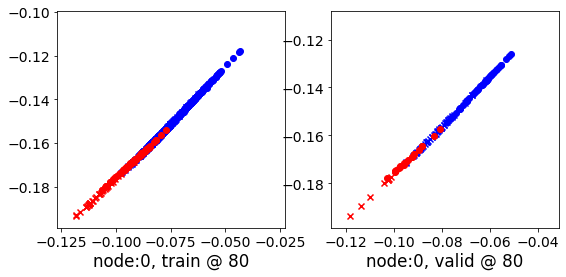

80 	 1 	 0.68207502 	 0.68203902 	 0.93882883 	 0.93725663 	 0.95006669 	 0.94836479


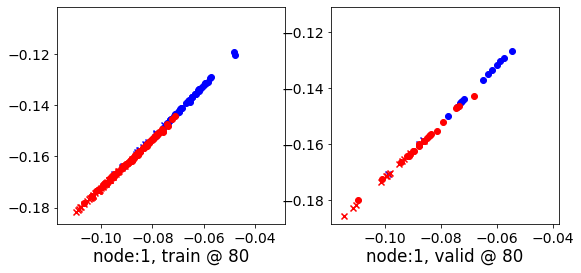

80 	 2 	 0.69428396 	 0.69250792 	 0.93509668 	 0.93366426 	 0.93400437 	 0.93430352


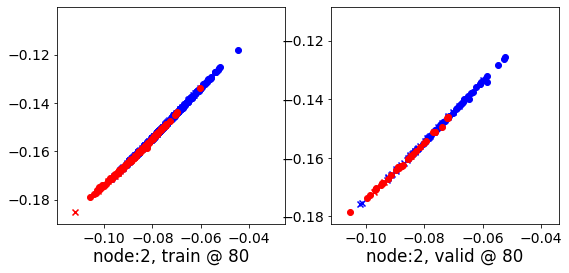

80 	 3 	 0.70822066 	 0.69633597 	 0.89753222 	 0.93993622 	 0.88265091 	 0.93674743


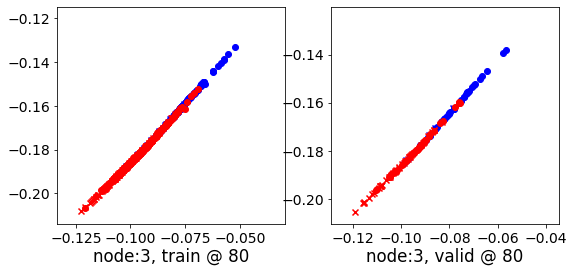

80 	 4 	 0.70714390 	 0.70888007 	 0.95377558 	 0.95366824 	 0.93983525 	 0.93793535


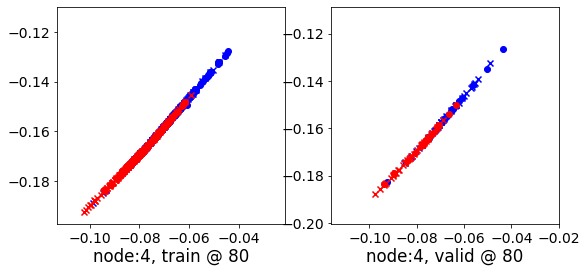

80 	 5 	 0.67764175 	 0.67682081 	 0.93337864 	 0.93524128 	 0.94891596 	 0.95156765


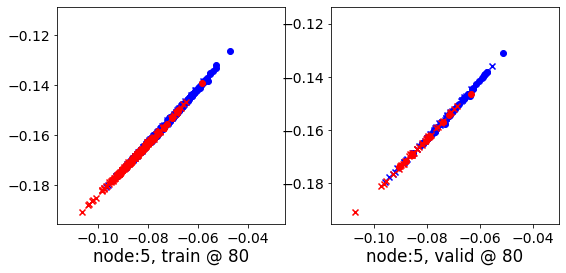

80 	 6 	 0.70666152 	 0.71099073 	 0.93961835 	 0.93915576 	 0.92626625 	 0.92131221


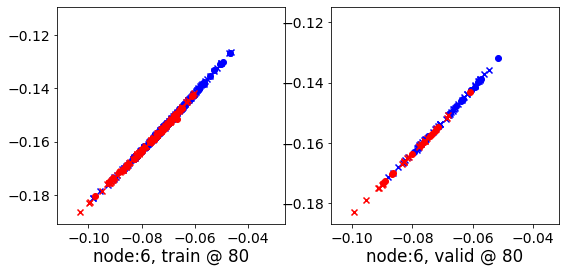

80 	 7 	 0.67080998 	 0.67150205 	 0.93731678 	 0.93704474 	 0.95970172 	 0.95868987


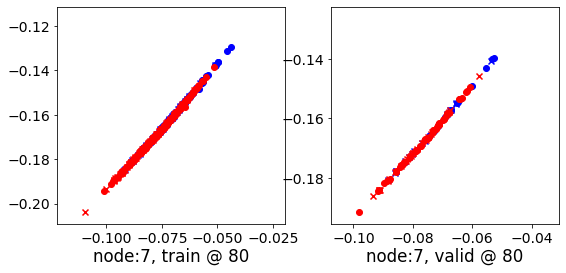

Aggregating on epoch: 82...
Aggregating on epoch: 84...
Aggregating on epoch: 86...
Aggregating on epoch: 88...
Aggregating on epoch: 90...
Aggregating on epoch: 92...
Aggregating on epoch: 94...
Aggregating on epoch: 96...
Aggregating on epoch: 98...
Aggregating on epoch: 100...
100 	 0 	 0.64876568 	 0.64383328 	 0.90787989 	 0.90264487 	 0.95235378 	 0.95195878


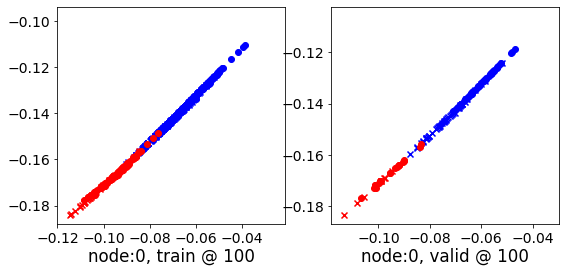

100 	 1 	 0.68732446 	 0.68734092 	 0.93218315 	 0.93083471 	 0.93806750 	 0.93664098


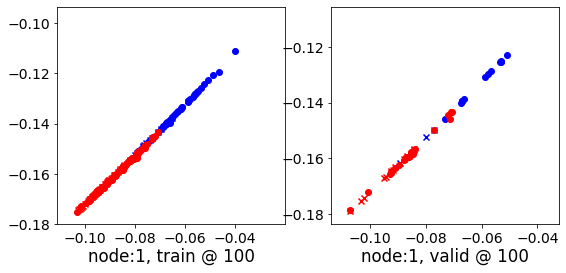

100 	 2 	 0.69180906 	 0.68999529 	 0.92979825 	 0.92861891 	 0.93115079 	 0.93177080


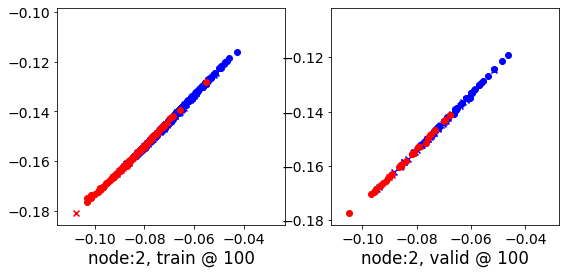

100 	 3 	 0.51194638 	 0.69578713 	 0.83919919 	 0.93925011 	 1.02049375 	 0.93661016


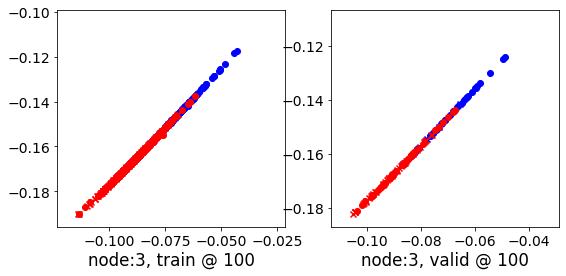

100 	 4 	 0.71549809 	 0.71684128 	 0.95322245 	 0.95315850 	 0.93092299 	 0.92946440


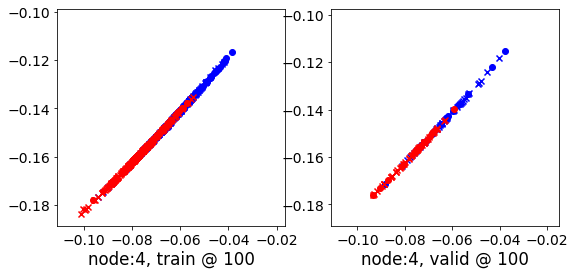

100 	 5 	 0.70599663 	 0.67697704 	 0.94998884 	 0.93503988 	 0.93717068 	 0.95121002


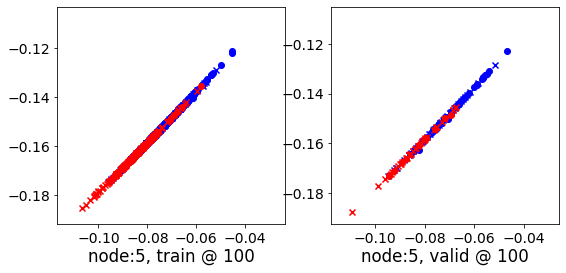

100 	 6 	 0.70812964 	 0.71268988 	 0.93782002 	 0.93747228 	 0.92290956 	 0.91792959


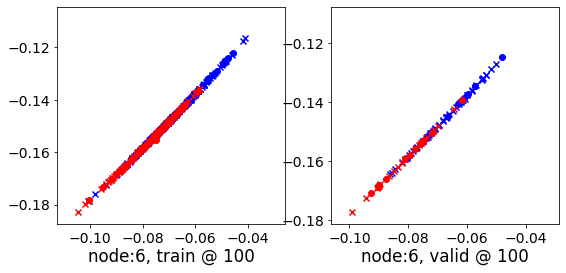

100 	 7 	 0.67606652 	 0.67656267 	 0.93113416 	 0.93112552 	 0.94825494 	 0.94771004


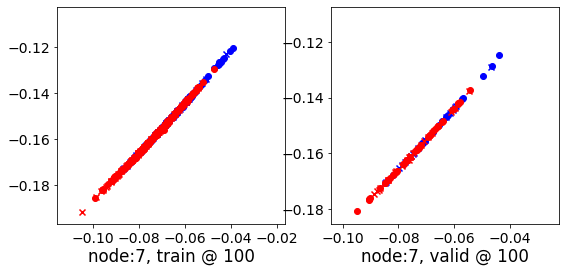

Aggregating on epoch: 102...
Aggregating on epoch: 104...
Aggregating on epoch: 106...
Aggregating on epoch: 108...
Aggregating on epoch: 110...
Aggregating on epoch: 112...
Aggregating on epoch: 114...
Aggregating on epoch: 116...
Aggregating on epoch: 118...
Aggregating on epoch: 120...
120 	 0 	 0.64438480 	 0.63919705 	 0.90408504 	 0.89871860 	 0.95307100 	 0.95266873


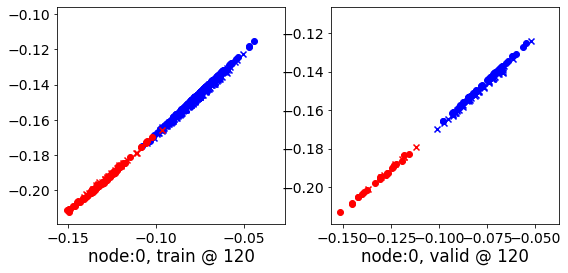

120 	 1 	 0.69114441 	 0.69111747 	 0.93000108 	 0.92866153 	 0.93202984 	 0.93069124


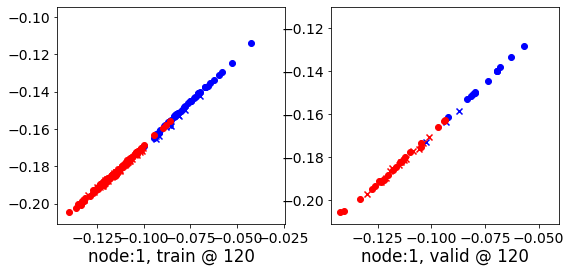

120 	 2 	 0.69137239 	 0.68946123 	 0.92891961 	 0.92776984 	 0.93072116 	 0.93145579


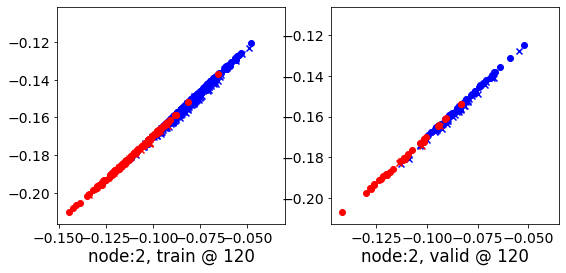

120 	 3 	 0.89011282 	 0.69434959 	 1.01550543 	 0.93773282 	 0.81850123 	 0.93653041


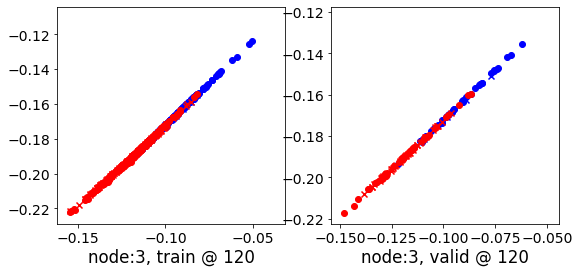

120 	 4 	 0.71567959 	 0.71675873 	 0.95191365 	 0.95186299 	 0.92953855 	 0.92825145


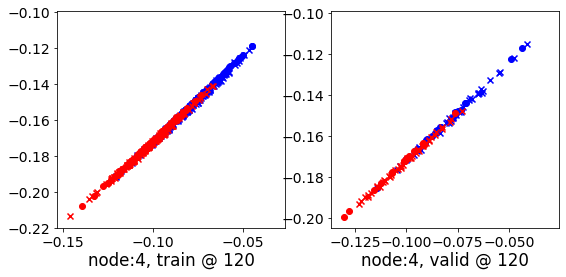

120 	 5 	 0.78366905 	 0.67620075 	 1.01952326 	 0.93478656 	 0.92905521 	 0.95173299


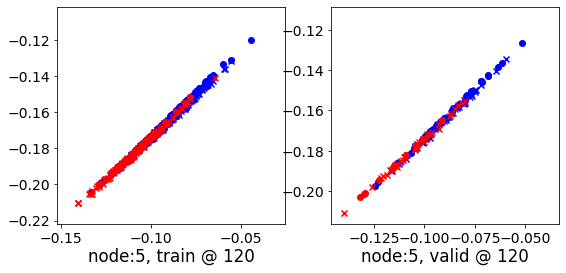

120 	 6 	 0.70730519 	 0.71158975 	 0.93718684 	 0.93631881 	 0.92310899 	 0.91787624


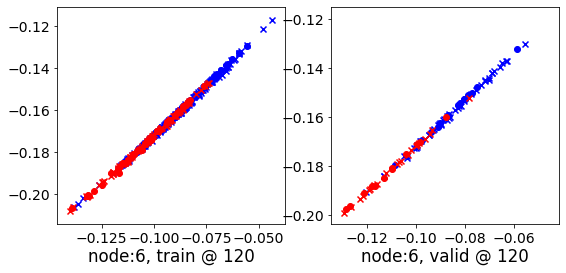

120 	 7 	 0.67580682 	 0.67624056 	 0.92817187 	 0.92838627 	 0.94558638 	 0.94529289


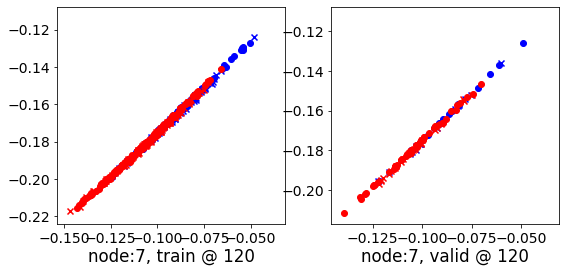

Aggregating on epoch: 122...
Aggregating on epoch: 124...
Aggregating on epoch: 126...
Aggregating on epoch: 128...
Aggregating on epoch: 130...
Aggregating on epoch: 132...
Aggregating on epoch: 134...
Aggregating on epoch: 136...
Aggregating on epoch: 138...
Aggregating on epoch: 140...
140 	 0 	 0.63651276 	 0.63103575 	 0.89575064 	 0.89023441 	 0.95288396 	 0.95234585


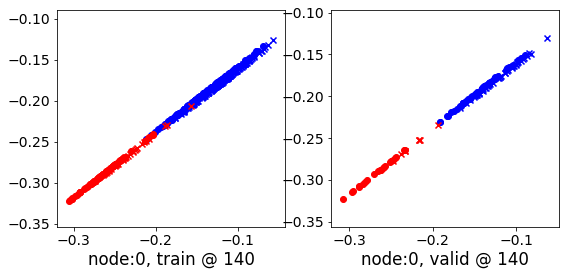

140 	 1 	 0.69283694 	 0.69258231 	 0.92929071 	 0.92784888 	 0.92965508 	 0.92841375


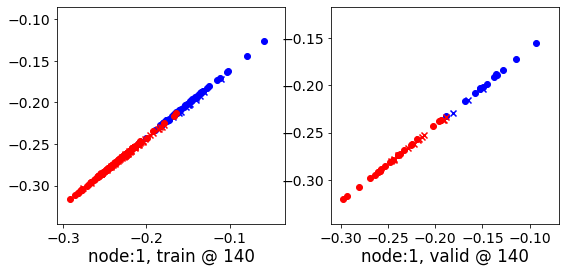

140 	 2 	 0.69015265 	 0.68810415 	 0.92679369 	 0.92573845 	 0.92990625 	 0.93078148


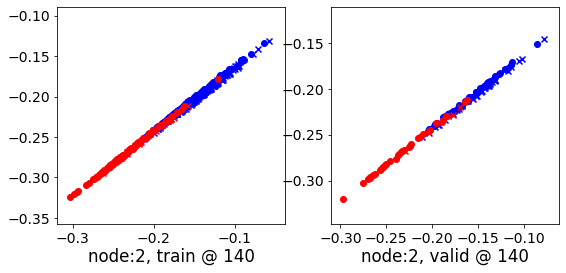

140 	 3 	 0.69580352 	 0.69160748 	 1.02972376 	 0.93553150 	 1.02716196 	 0.93707120


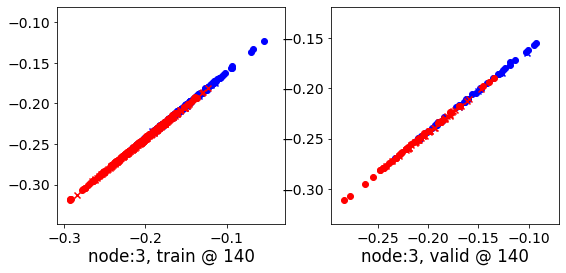

140 	 4 	 0.70962560 	 0.71015787 	 0.94646305 	 0.94651151 	 0.93041080 	 0.92950082


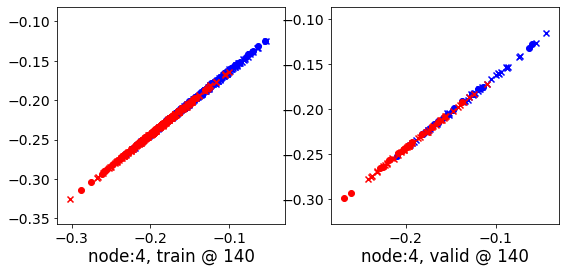

140 	 5 	 0.58401877 	 0.67417705 	 0.87186432 	 0.93314713 	 0.98112220 	 0.95211726


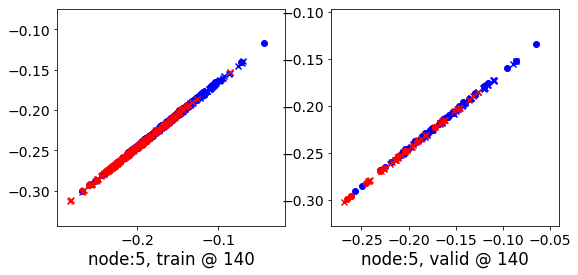

140 	 6 	 0.70339209 	 0.70607644 	 0.93442470 	 0.93217820 	 0.92442447 	 0.91924894


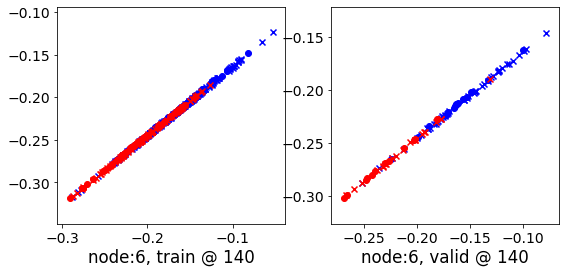

140 	 7 	 0.67400849 	 0.67473775 	 0.92625201 	 0.92682463 	 0.94550192 	 0.94523406


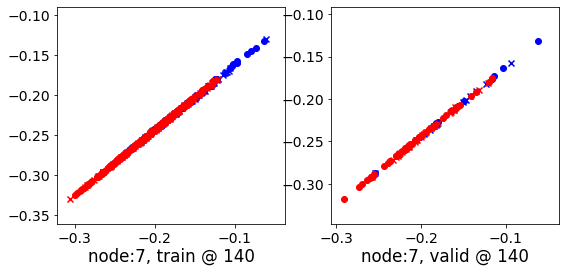

Aggregating on epoch: 142...
Aggregating on epoch: 144...
Aggregating on epoch: 146...
Aggregating on epoch: 148...
Aggregating on epoch: 150...
Aggregating on epoch: 152...
Aggregating on epoch: 154...
Aggregating on epoch: 156...
Aggregating on epoch: 158...
Aggregating on epoch: 160...
160 	 0 	 0.61180848 	 0.60525531 	 0.86175370 	 0.85605067 	 0.94465292 	 0.94394255


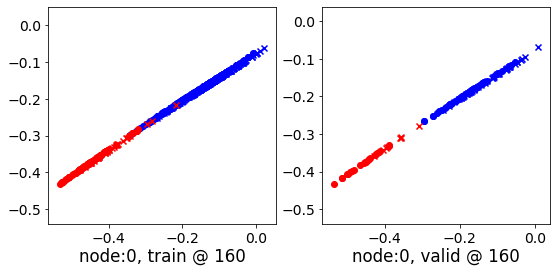

160 	 1 	 0.68965638 	 0.68808073 	 0.92569804 	 0.92357051 	 0.92967480 	 0.92863697


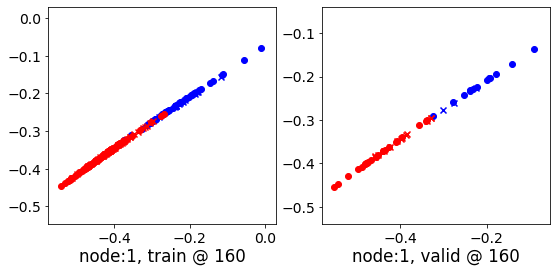

160 	 2 	 0.68030071 	 0.67828709 	 0.91339397 	 0.91336906 	 0.92675674 	 0.92822915


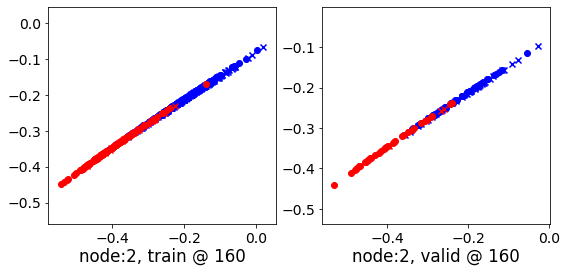

160 	 3 	 0.52558243 	 0.68416667 	 0.85432231 	 0.92768246 	 1.02320194 	 0.93666297


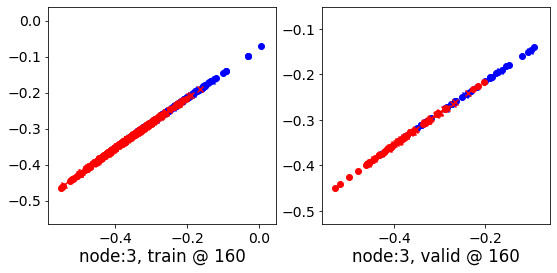

160 	 4 	 0.68987101 	 0.68906546 	 0.92621505 	 0.92672783 	 0.93084264 	 0.93080956


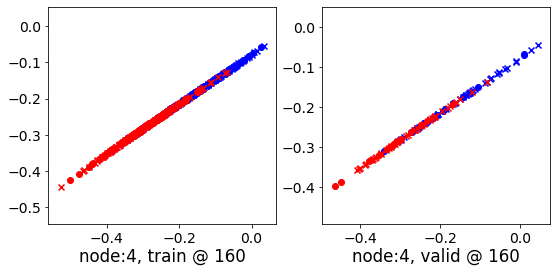

160 	 5 	 0.67668670 	 0.66339231 	 0.95084232 	 0.92261612 	 0.96816391 	 0.95237100


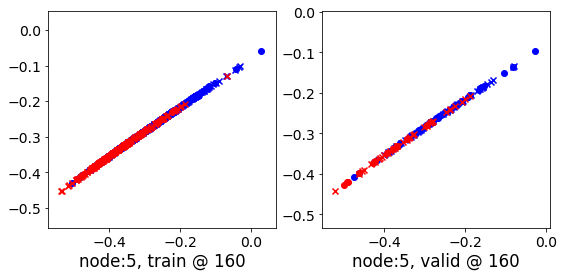

160 	 6 	 0.69412488 	 0.69035625 	 0.92471868 	 0.91650295 	 0.92431200 	 0.91929388


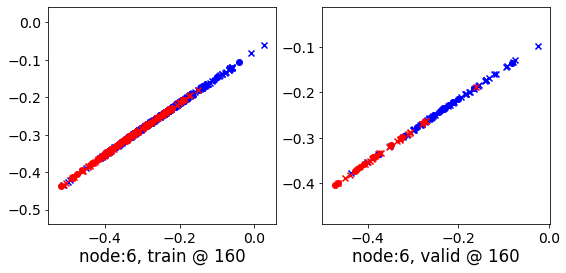

160 	 7 	 0.67290211 	 0.67324018 	 0.92261869 	 0.92403972 	 0.94301456 	 0.94394672


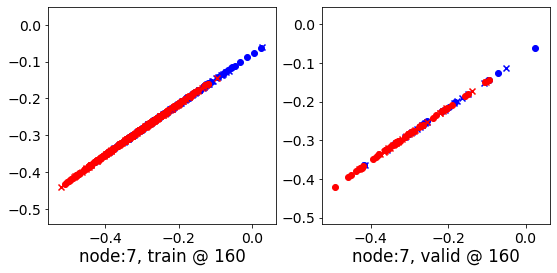

Aggregating on epoch: 162...
Aggregating on epoch: 164...
Aggregating on epoch: 166...
Aggregating on epoch: 168...
Aggregating on epoch: 170...
Aggregating on epoch: 172...
Aggregating on epoch: 174...
Aggregating on epoch: 176...
Aggregating on epoch: 178...
Aggregating on epoch: 180...
180 	 0 	 0.52580279 	 0.51437992 	 0.75014395 	 0.74309117 	 0.92162699 	 0.92185843


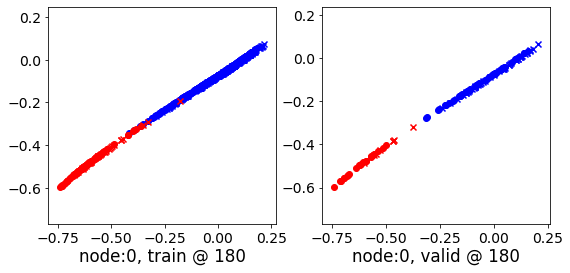

180 	 1 	 0.67623526 	 0.67261779 	 0.91171861 	 0.90731257 	 0.92931271 	 0.92784196


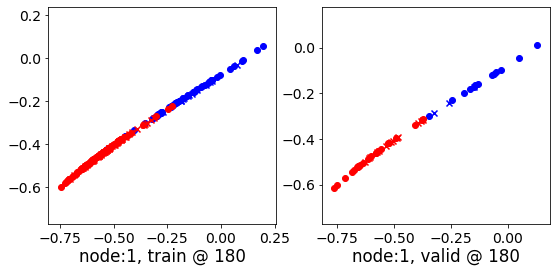

180 	 2 	 0.64455974 	 0.64312917 	 0.86644834 	 0.86990750 	 0.91658634 	 0.91992551


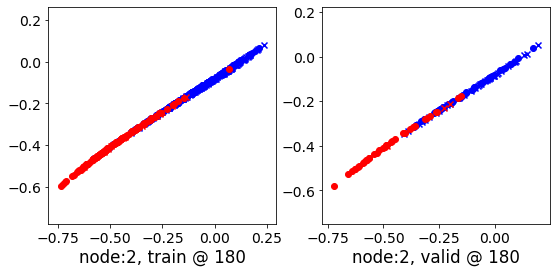

180 	 3 	 0.71760583 	 0.64642501 	 0.97179782 	 0.88865978 	 0.94916934 	 0.93538195


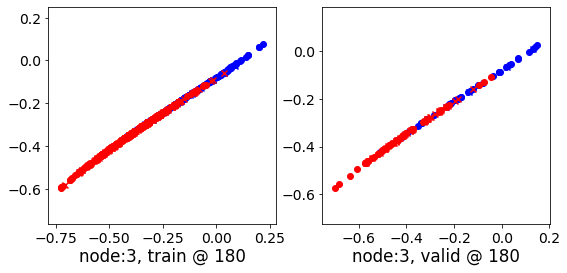

180 	 4 	 0.61164480 	 0.61182570 	 0.84571677 	 0.85084790 	 0.93078631 	 0.93216938


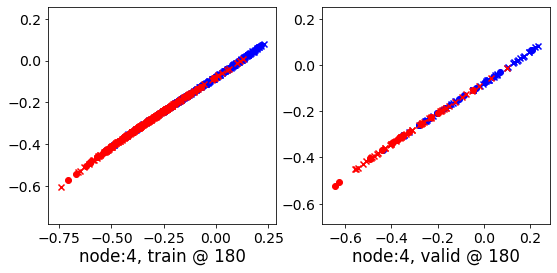

180 	 5 	 0.60271144 	 0.60858858 	 0.86400402 	 0.86858362 	 0.95426589 	 0.95314223


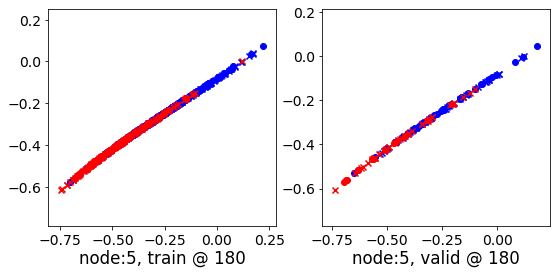

180 	 6 	 0.66642565 	 0.64025426 	 0.89525372 	 0.86536026 	 0.92302275 	 0.91825318


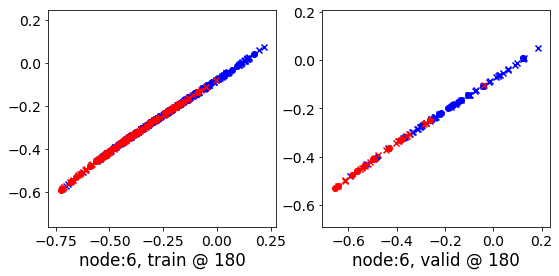

180 	 7 	 0.66739678 	 0.66652393 	 0.91165406 	 0.91532654 	 0.93791467 	 0.94194978


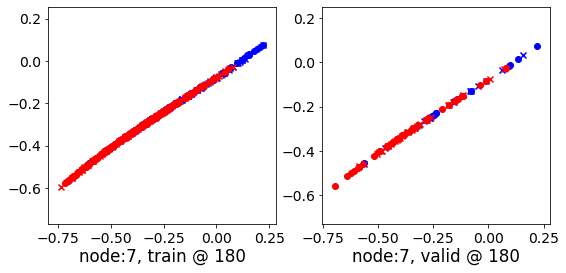

Aggregating on epoch: 182...
Aggregating on epoch: 184...
Aggregating on epoch: 186...
Aggregating on epoch: 188...
Aggregating on epoch: 190...
Aggregating on epoch: 192...
Aggregating on epoch: 194...
Aggregating on epoch: 196...
Aggregating on epoch: 198...
Aggregating on epoch: 200...
200 	 0 	 0.31758505 	 0.29676557 	 0.52716231 	 0.51607126 	 0.90932155 	 0.91245288


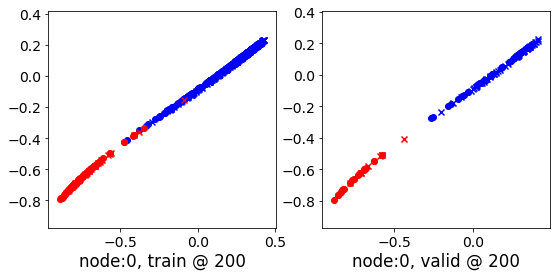

200 	 1 	 0.62095189 	 0.61004561 	 0.85531718 	 0.84369582 	 0.92919332 	 0.92679739


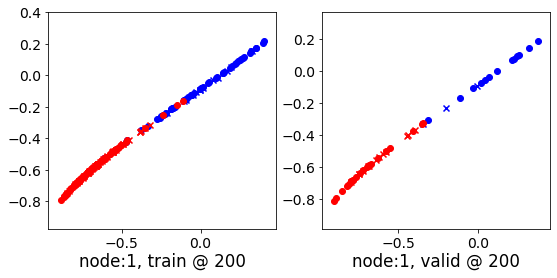

200 	 2 	 0.54856509 	 0.54937828 	 0.73986077 	 0.75518292 	 0.88806874 	 0.89895183


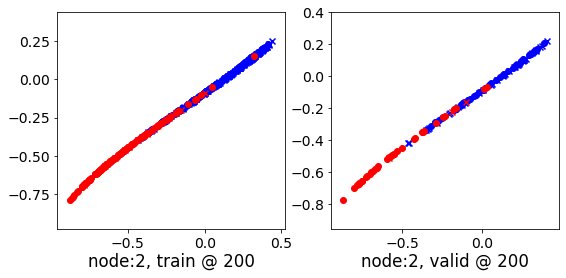

200 	 3 	 0.58374822 	 0.53482664 	 0.77881962 	 0.77357239 	 0.89077121 	 0.93189293


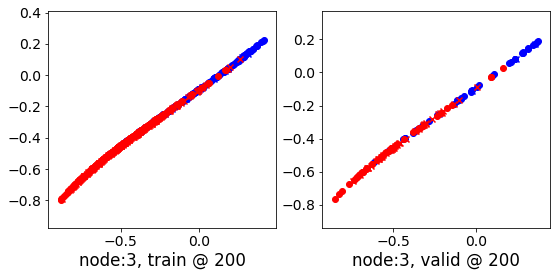

200 	 4 	 0.45352829 	 0.47045094 	 0.68538427 	 0.70969135 	 0.92989743 	 0.93238759


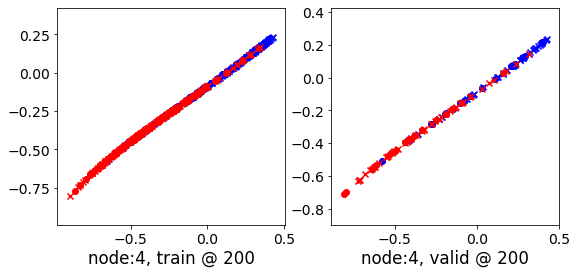

200 	 5 	 0.54393065 	 0.53572971 	 0.81399184 	 0.79454327 	 0.96166587 	 0.95196074


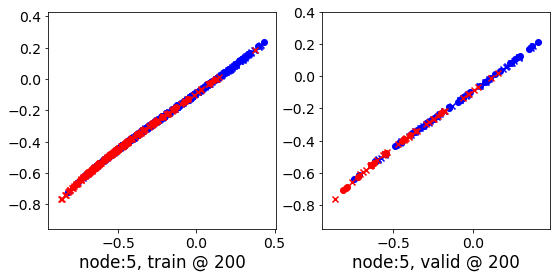

200 	 6 	 0.61857599 	 0.53102320 	 0.84277058 	 0.75247163 	 0.91892767 	 0.91459560


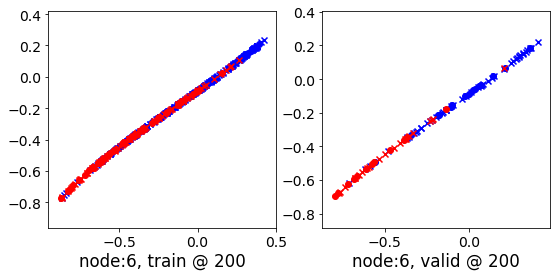

200 	 7 	 0.64480573 	 0.64293879 	 0.88481438 	 0.89413357 	 0.93427896 	 0.94434196


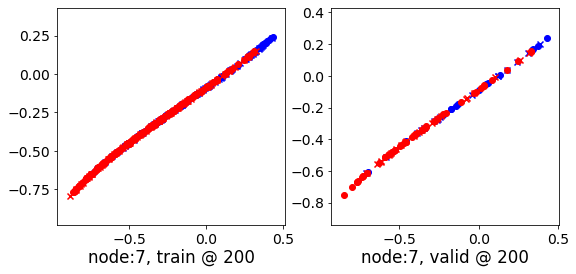

Aggregating on epoch: 202...
Aggregating on epoch: 204...
Aggregating on epoch: 206...
Aggregating on epoch: 208...
Aggregating on epoch: 210...
Aggregating on epoch: 212...
Aggregating on epoch: 214...
Aggregating on epoch: 216...
Aggregating on epoch: 218...
Aggregating on epoch: 220...
220 	 0 	 0.06736699 	 0.04123557 	 0.29242277 	 0.27478695 	 0.92371577 	 0.92669857


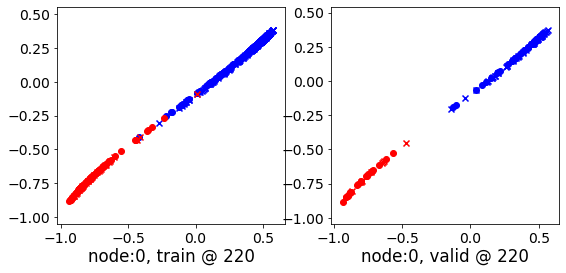

220 	 1 	 0.48609734 	 0.46980190 	 0.71628529 	 0.69741243 	 0.92665827 	 0.92075771


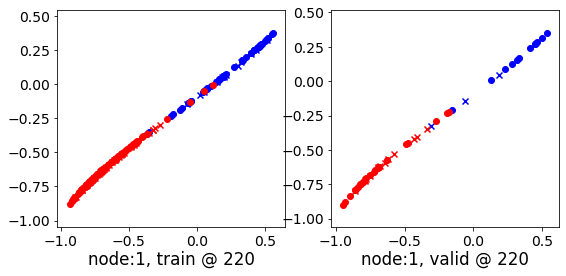

220 	 2 	 0.39983642 	 0.40699321 	 0.55789667 	 0.60188514 	 0.85528338 	 0.88803911


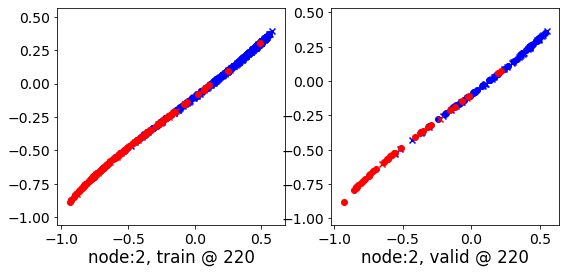

220 	 3 	 0.30983913 	 0.43014121 	 0.60414481 	 0.65787023 	 0.99500996 	 0.92087620


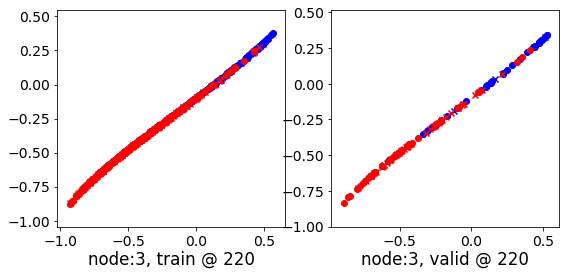

220 	 4 	 0.40413105 	 0.40849245 	 0.61002427 	 0.64930832 	 0.92830336 	 0.93396306


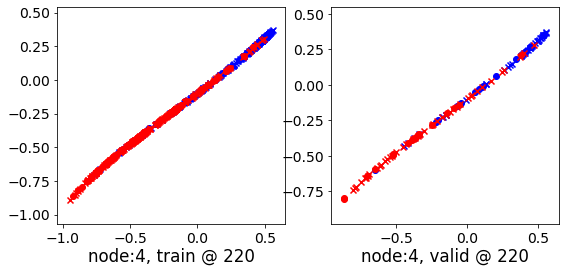

220 	 5 	 0.63345098 	 0.53214020 	 0.91134906 	 0.78795129 	 0.97857541 	 0.94895828


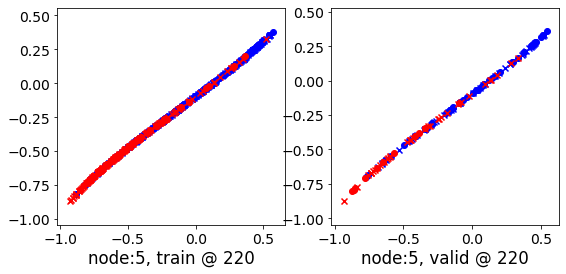

220 	 6 	 0.59299123 	 0.42799836 	 0.81479257 	 0.64712811 	 0.91661209 	 0.91227692


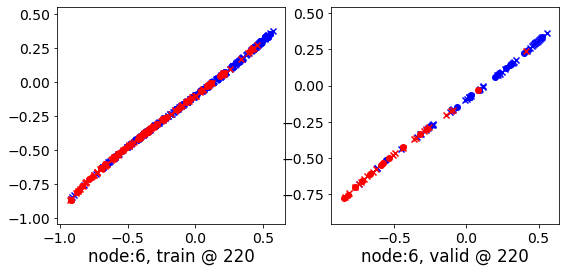

220 	 7 	 0.60080886 	 0.60595363 	 0.84065485 	 0.85893458 	 0.93442994 	 0.94612813


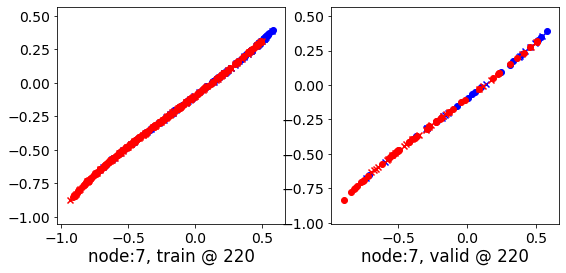

Aggregating on epoch: 222...
Aggregating on epoch: 224...
Aggregating on epoch: 226...
Aggregating on epoch: 228...
Aggregating on epoch: 230...
Aggregating on epoch: 232...
Aggregating on epoch: 234...
Aggregating on epoch: 236...
Aggregating on epoch: 238...
Aggregating on epoch: 240...
240 	 0 	 -0.08126545 	 -0.10542314 	 0.15452796 	 0.13619967 	 0.93112499 	 0.93476999


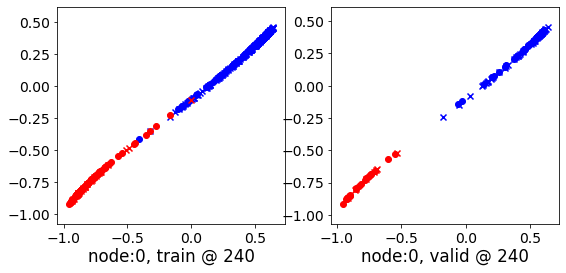

240 	 1 	 0.30629992 	 0.29713225 	 0.52430791 	 0.51317078 	 0.91961271 	 0.90918571


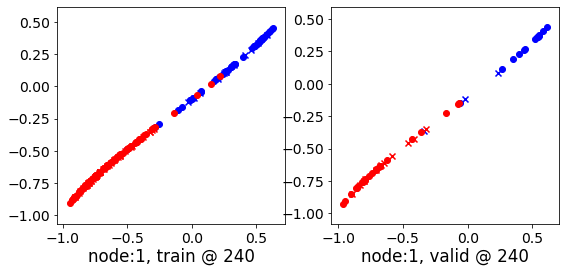

240 	 2 	 0.28906816 	 0.30346859 	 0.43480521 	 0.51730585 	 0.85049826 	 0.90698445


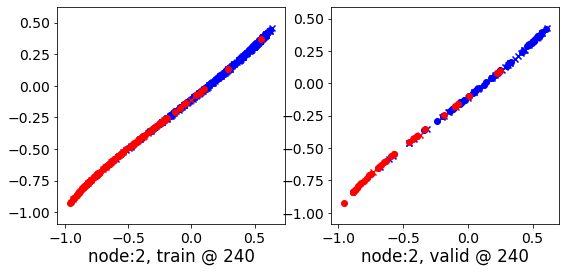

240 	 3 	 0.53452277 	 0.41691184 	 0.79157484 	 0.62906212 	 0.96724772 	 0.90529746


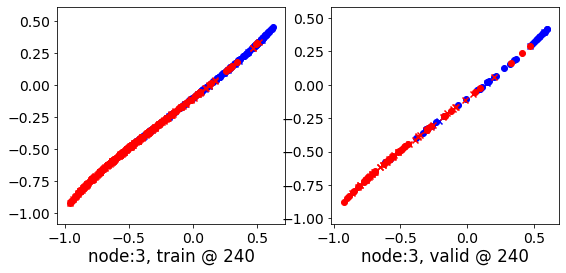

240 	 4 	 0.40687549 	 0.40035462 	 0.60474581 	 0.64597970 	 0.92528236 	 0.93877226


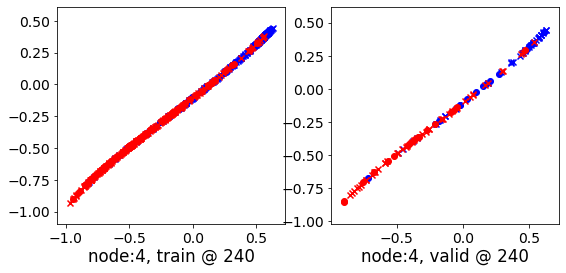

240 	 5 	 0.37753713 	 0.53136152 	 0.61705863 	 0.78133166 	 0.93616116 	 0.94311732


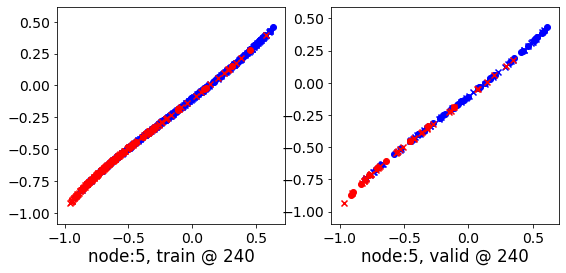

240 	 6 	 0.59157312 	 0.40708780 	 0.81433636 	 0.63012093 	 0.91875494 	 0.91618031


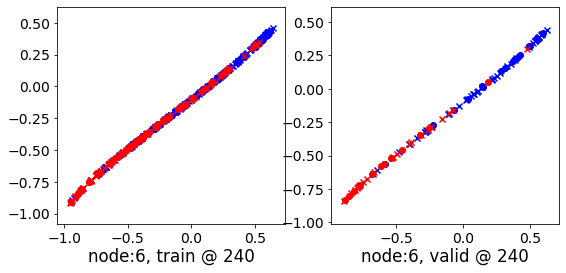

240 	 7 	 0.55596203 	 0.56991494 	 0.79603738 	 0.82909214 	 0.93625855 	 0.95232439


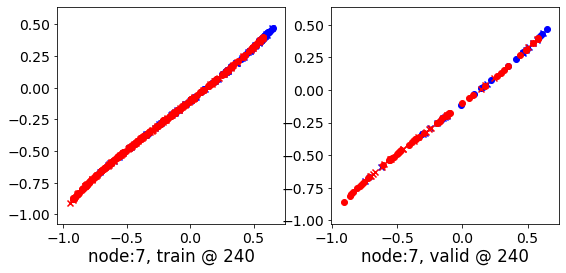

Aggregating on epoch: 242...
Aggregating on epoch: 244...
Aggregating on epoch: 246...
Aggregating on epoch: 248...
Aggregating on epoch: 250...
Aggregating on epoch: 252...
Aggregating on epoch: 254...
Aggregating on epoch: 256...
Aggregating on epoch: 258...
Aggregating on epoch: 260...
260 	 0 	 -0.14108106 	 -0.16328493 	 0.09784397 	 0.07988837 	 0.93350744 	 0.93632048


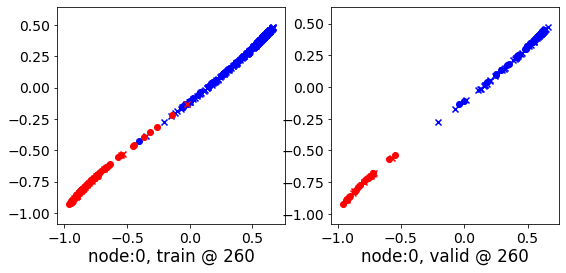

260 	 1 	 0.17330846 	 0.17483649 	 0.36679599 	 0.37420413 	 0.91006899 	 0.89251482


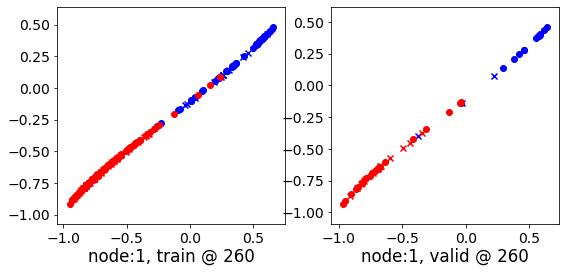

260 	 2 	 0.24000204 	 0.27065536 	 0.38418183 	 0.49662188 	 0.85772479 	 0.91911370


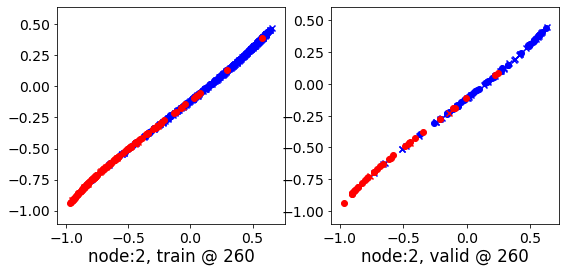

260 	 3 	 0.10950188 	 0.43462652 	 0.23153469 	 0.62652987 	 0.83400172 	 0.88505054


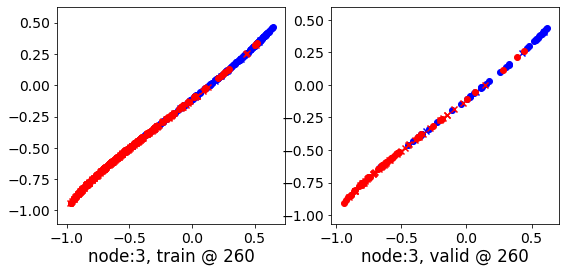

260 	 4 	 0.38798130 	 0.38924718 	 0.59764701 	 0.63969743 	 0.92337841 	 0.94359744


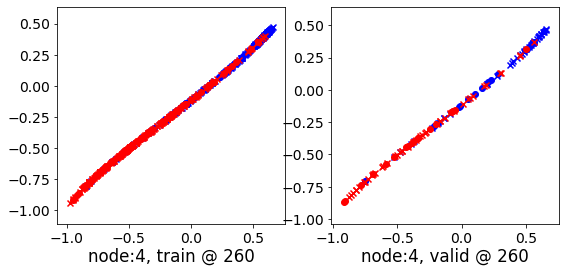

260 	 5 	 0.52797389 	 0.53081733 	 0.76475543 	 0.77716392 	 0.93333405 	 0.93949378


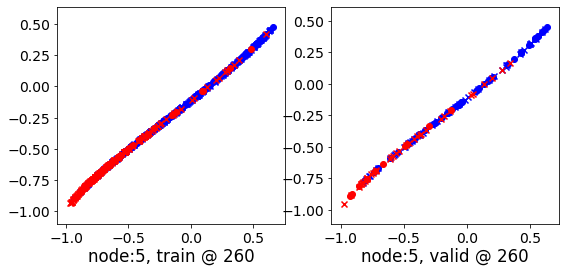

260 	 6 	 0.58929092 	 0.41832900 	 0.81237811 	 0.64328694 	 0.91857892 	 0.91810513


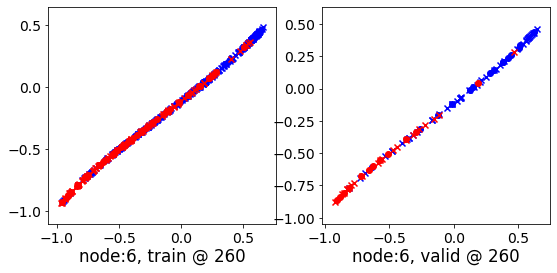

260 	 7 	 0.53840512 	 0.56323141 	 0.77625120 	 0.82647306 	 0.93705231 	 0.95638883


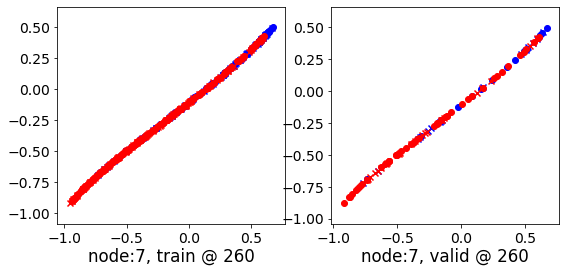

Aggregating on epoch: 262...
Aggregating on epoch: 264...
Aggregating on epoch: 266...
Aggregating on epoch: 268...
Aggregating on epoch: 270...
Aggregating on epoch: 272...
Aggregating on epoch: 274...
Aggregating on epoch: 276...
Aggregating on epoch: 278...
Aggregating on epoch: 280...
280 	 0 	 -0.16549712 	 -0.18774568 	 0.07386426 	 0.05425235 	 0.93340254 	 0.93514520


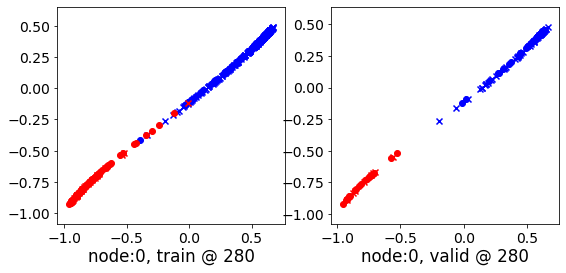

280 	 1 	 0.08549464 	 0.11112836 	 0.26517946 	 0.29184577 	 0.90096235 	 0.87386459


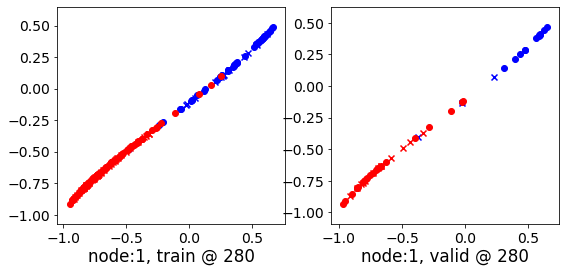

280 	 2 	 0.23909131 	 0.27260667 	 0.37074077 	 0.49799222 	 0.85726237 	 0.91853273


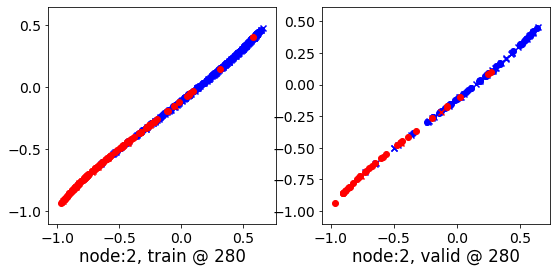

280 	 3 	 0.31714848 	 0.41237408 	 0.38174751 	 0.59336412 	 0.77513039 	 0.87413722


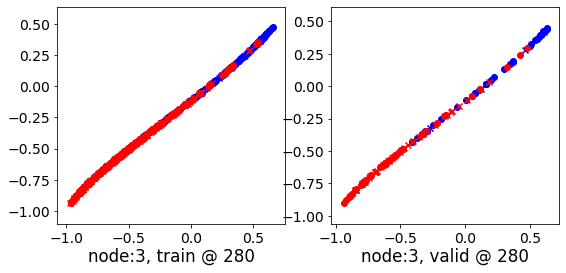

280 	 4 	 0.37800753 	 0.38485414 	 0.59491706 	 0.63583654 	 0.92300856 	 0.94412959


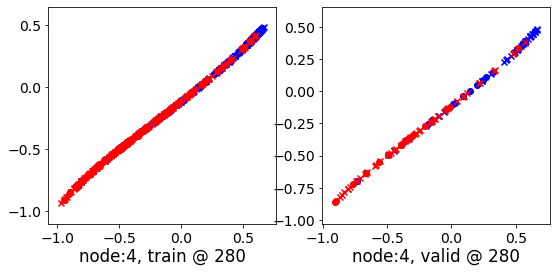

280 	 5 	 0.50407094 	 0.53559035 	 0.74717265 	 0.78119856 	 0.93747371 	 0.93875539


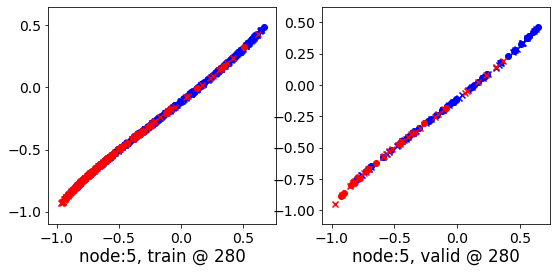

280 	 6 	 0.58524472 	 0.41522020 	 0.80931294 	 0.64174551 	 0.91761506 	 0.91967249


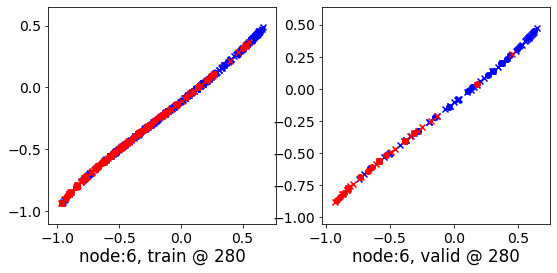

280 	 7 	 0.53604686 	 0.56638485 	 0.77476114 	 0.83003622 	 0.93704677 	 0.95679855


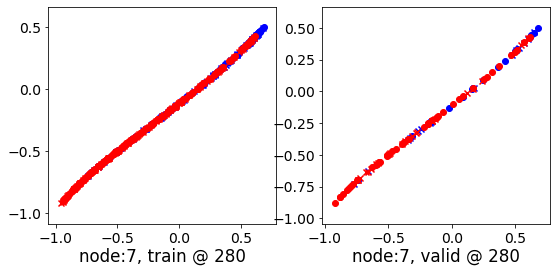

Aggregating on epoch: 282...
Aggregating on epoch: 284...
Aggregating on epoch: 286...
Aggregating on epoch: 288...
Aggregating on epoch: 290...
Aggregating on epoch: 292...
Aggregating on epoch: 294...
Aggregating on epoch: 296...
Aggregating on epoch: 298...
Aggregating on epoch: 300...
300 	 0 	 -0.17607379 	 -0.19877392 	 0.06239909 	 0.04206754 	 0.93313891 	 0.93398863


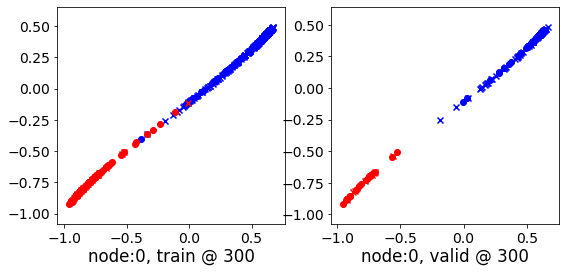

300 	 1 	 0.03994095 	 0.09024417 	 0.20958728 	 0.25313359 	 0.89452422 	 0.85603660


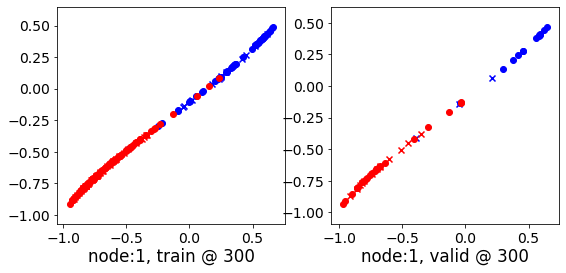

300 	 2 	 0.22712842 	 0.27314234 	 0.36517680 	 0.49873185 	 0.85635406 	 0.91873670


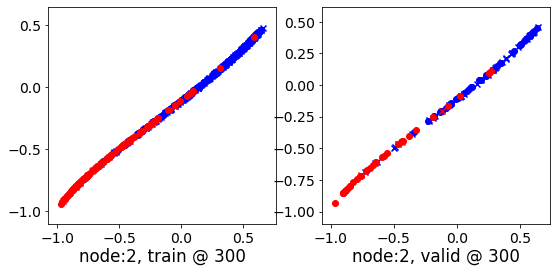

300 	 3 	 0.49592316 	 0.39296097 	 0.82767487 	 0.57331234 	 1.02976191 	 0.87349856


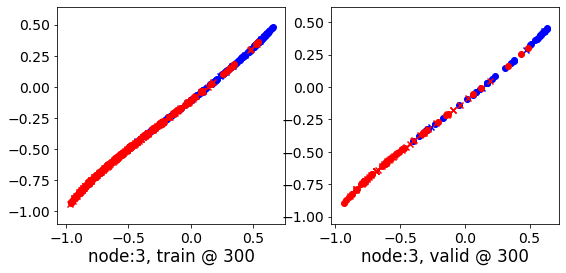

300 	 4 	 0.36601865 	 0.38208663 	 0.59091532 	 0.63238692 	 0.92286521 	 0.94344747


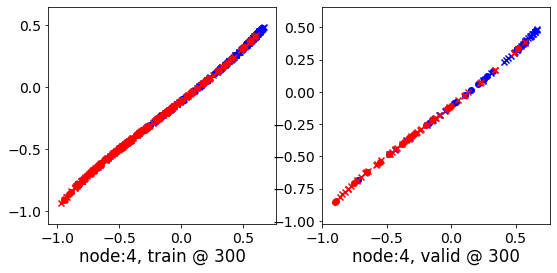

300 	 5 	 0.39349788 	 0.53172117 	 0.62880760 	 0.77765995 	 0.93058974 	 0.93908596


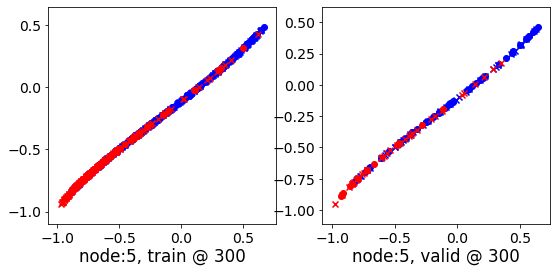

300 	 6 	 0.58275247 	 0.41388947 	 0.80639714 	 0.64175564 	 0.91704142 	 0.92101336


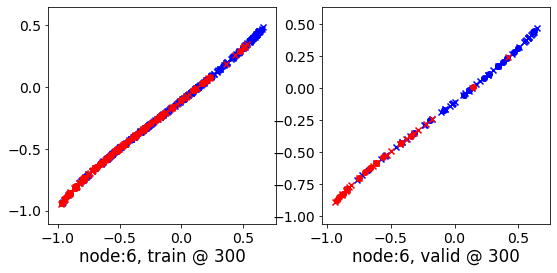

300 	 7 	 0.53427601 	 0.56317961 	 0.77409309 	 0.82807976 	 0.93726015 	 0.95804733


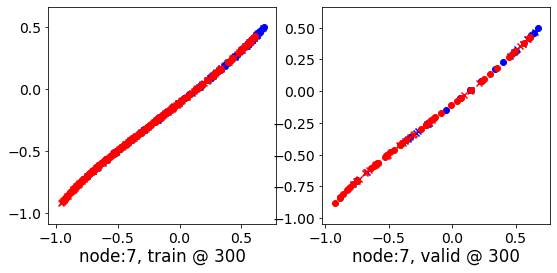

Aggregating on epoch: 302...
Aggregating on epoch: 304...
Aggregating on epoch: 306...
Aggregating on epoch: 308...
Aggregating on epoch: 310...
Aggregating on epoch: 312...
Aggregating on epoch: 314...
Aggregating on epoch: 316...
Aggregating on epoch: 318...
Aggregating on epoch: 320...
320 	 0 	 -0.18123846 	 -0.20455244 	 0.05560063 	 0.03461972 	 0.93236148 	 0.93231934


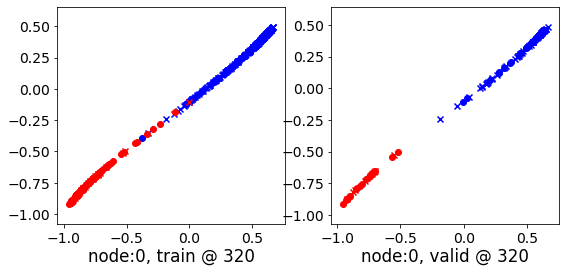

320 	 1 	 0.01009183 	 0.07878891 	 0.18080960 	 0.23494831 	 0.89221722 	 0.84930658


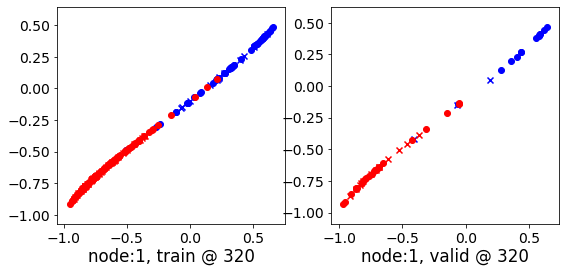

320 	 2 	 0.21656314 	 0.27104264 	 0.36142418 	 0.49601364 	 0.85452265 	 0.91811818


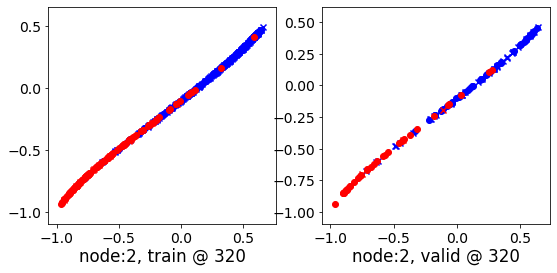

320 	 3 	 0.73428416 	 0.39850903 	 0.66546822 	 0.57799613 	 0.65712214 	 0.87263429


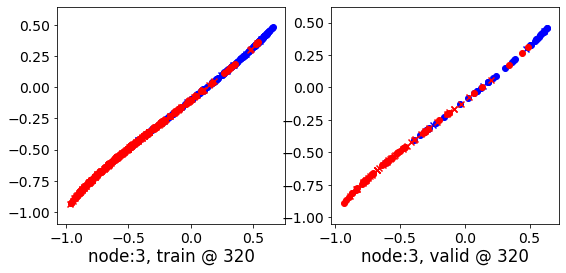

320 	 4 	 0.36094230 	 0.37965679 	 0.58845532 	 0.63031596 	 0.92296773 	 0.94380635


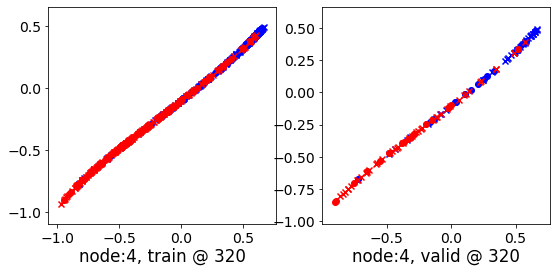

320 	 5 	 0.37948519 	 0.52957469 	 0.65981883 	 0.77577710 	 0.97359145 	 0.93934959


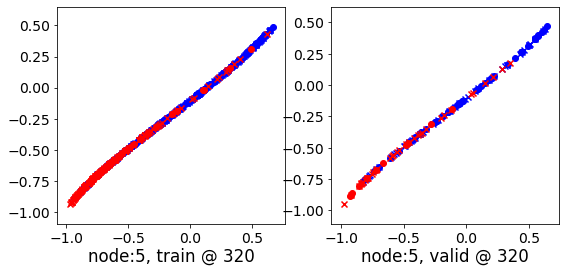

320 	 6 	 0.58251071 	 0.41617227 	 0.80469215 	 0.64424366 	 0.91663235 	 0.92121857


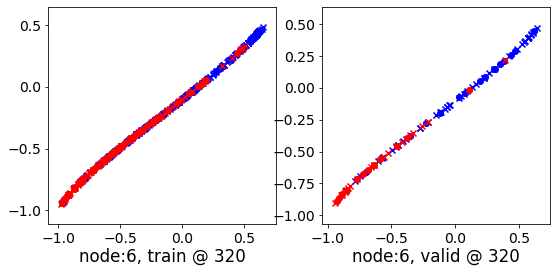

320 	 7 	 0.53144956 	 0.56132543 	 0.77296156 	 0.82660919 	 0.93705446 	 0.95843095


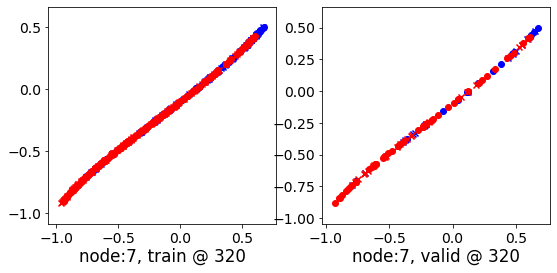

Aggregating on epoch: 322...
Aggregating on epoch: 324...
Aggregating on epoch: 326...
Aggregating on epoch: 328...
Aggregating on epoch: 330...
Aggregating on epoch: 332...
Aggregating on epoch: 334...
Aggregating on epoch: 336...
Aggregating on epoch: 338...
Aggregating on epoch: 340...
340 	 0 	 -0.18537897 	 -0.20857362 	 0.05103426 	 0.02863349 	 0.93147886 	 0.93035430


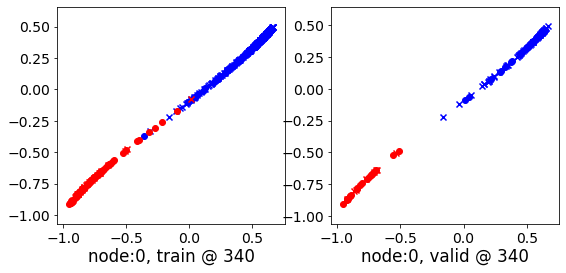

340 	 1 	 -0.01706965 	 0.07151549 	 0.16385937 	 0.22611068 	 0.89132231 	 0.84774238


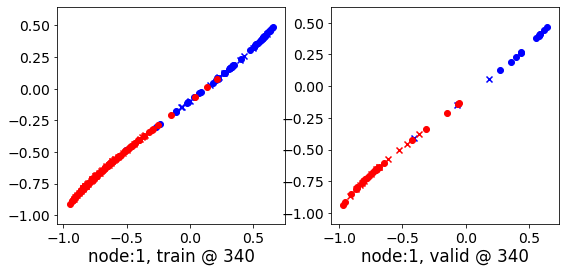

340 	 2 	 0.21412626 	 0.26984581 	 0.36032283 	 0.49315420 	 0.85278052 	 0.91645557


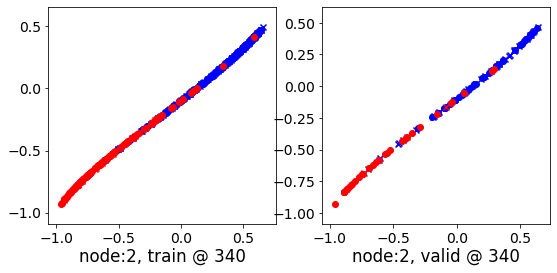

340 	 3 	 0.59644753 	 0.39504832 	 0.86427724 	 0.57597220 	 0.99057859 	 0.87407106


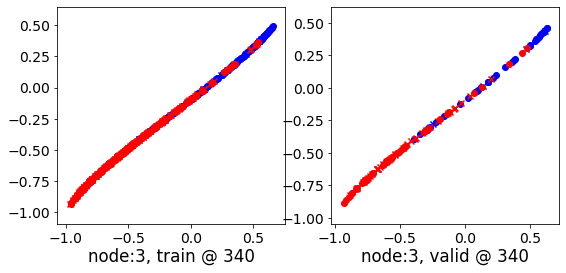

340 	 4 	 0.35999143 	 0.37890869 	 0.58766490 	 0.62946856 	 0.92314893 	 0.94370705


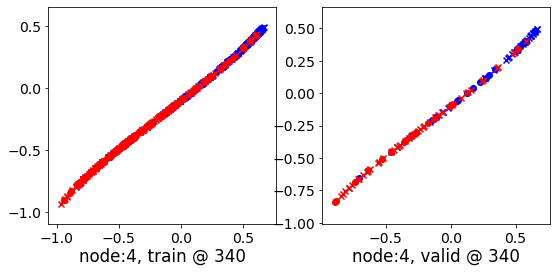

340 	 5 	 0.27448317 	 0.53252620 	 0.48602721 	 0.77970570 	 0.90800917 	 0.94032669


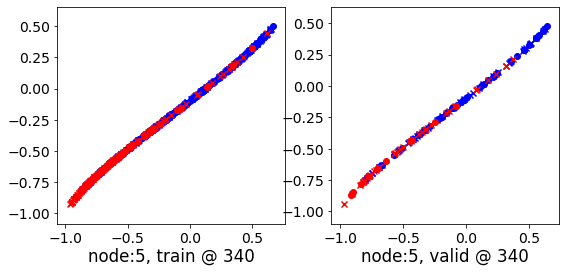

340 	 6 	 0.58505696 	 0.41583884 	 0.80413938 	 0.64433873 	 0.91619784 	 0.92164707


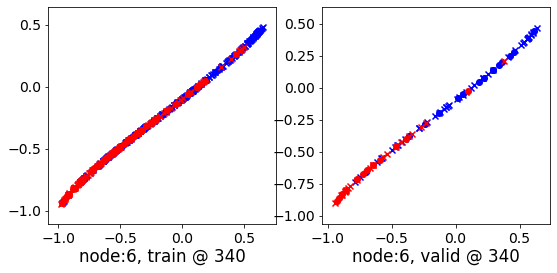

340 	 7 	 0.52898479 	 0.56043786 	 0.77180171 	 0.82546812 	 0.93669051 	 0.95817745


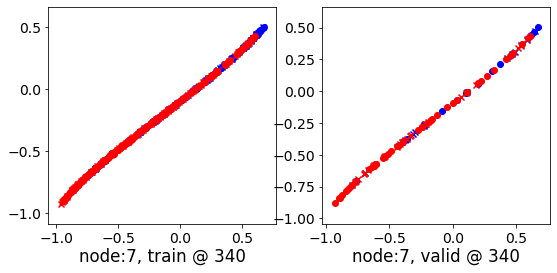

Aggregating on epoch: 342...
Aggregating on epoch: 344...
Aggregating on epoch: 346...
Aggregating on epoch: 348...
Aggregating on epoch: 350...
Aggregating on epoch: 352...
Aggregating on epoch: 354...
Aggregating on epoch: 356...
Aggregating on epoch: 358...
Aggregating on epoch: 360...
360 	 0 	 -0.18303367 	 -0.20817402 	 0.04891973 	 0.02841214 	 0.93135422 	 0.92973334


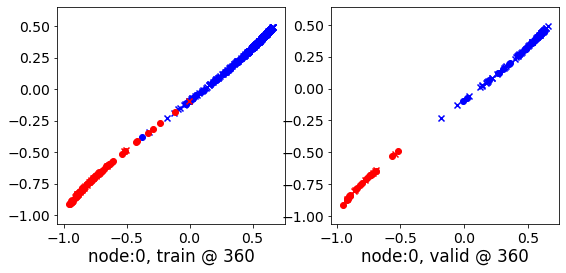

360 	 1 	 -0.01588131 	 0.07642341 	 0.16100344 	 0.22807515 	 0.88941121 	 0.84479892


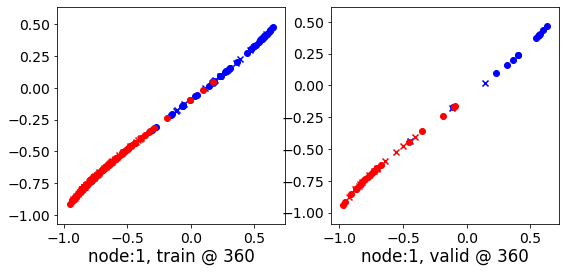

360 	 2 	 0.20120227 	 0.26422584 	 0.35634473 	 0.49106789 	 0.85239512 	 0.91998923


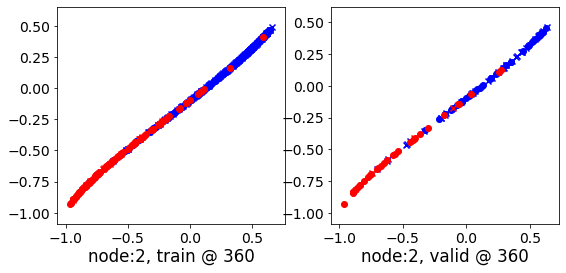

360 	 3 	 0.38234365 	 0.41470087 	 0.43284538 	 0.59368700 	 0.74345452 	 0.87213331


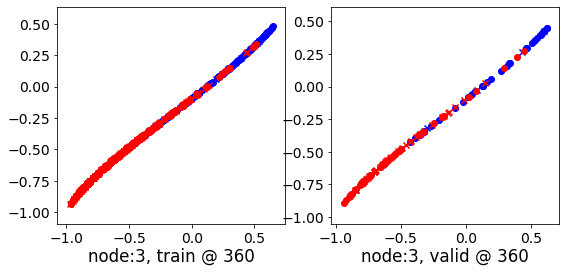

360 	 4 	 0.35572290 	 0.37757522 	 0.58498484 	 0.62858343 	 0.92296833 	 0.94415540


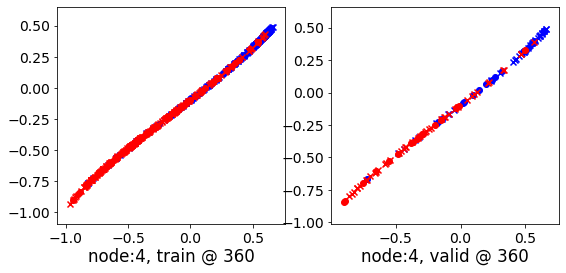

360 	 5 	 0.33310753 	 0.52508712 	 0.62700266 	 0.77218598 	 0.98902369 	 0.94024605


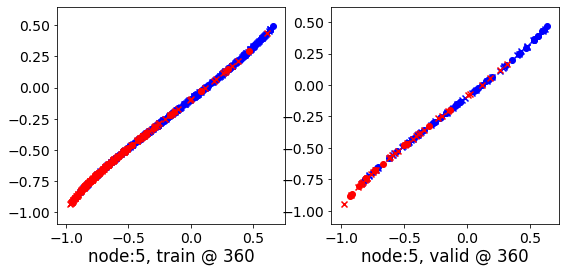

360 	 6 	 0.58315015 	 0.41675973 	 0.80264235 	 0.64555639 	 0.91601175 	 0.92194384


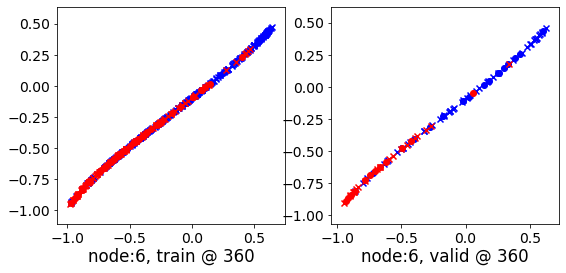

360 	 7 	 0.52867478 	 0.55970091 	 0.77146626 	 0.82615680 	 0.93683314 	 0.95960307


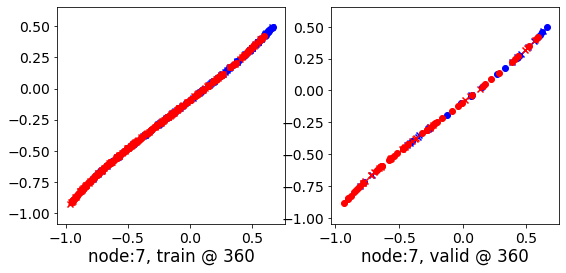

Aggregating on epoch: 362...
Aggregating on epoch: 364...
Aggregating on epoch: 366...
Aggregating on epoch: 368...
Aggregating on epoch: 370...
Aggregating on epoch: 372...
Aggregating on epoch: 374...
Aggregating on epoch: 376...
Aggregating on epoch: 378...
Aggregating on epoch: 380...
380 	 0 	 -0.18556789 	 -0.20869711 	 0.04701696 	 0.02664599 	 0.93081152 	 0.92849028


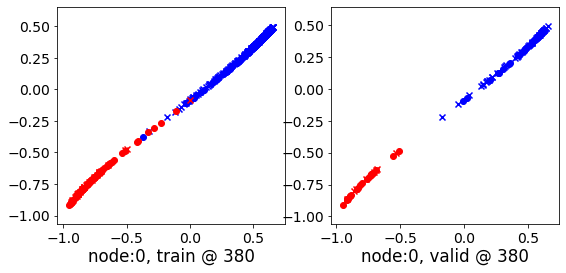

380 	 1 	 -0.02754937 	 0.07609081 	 0.15691862 	 0.22679651 	 0.88898438 	 0.84385288


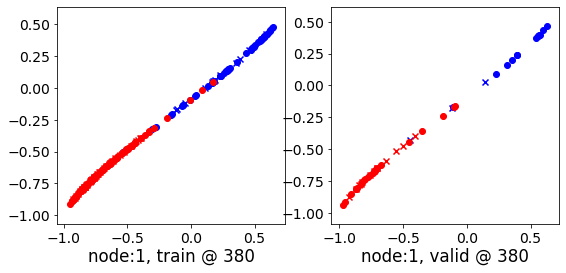

380 	 2 	 0.20036364 	 0.26127380 	 0.35511434 	 0.48952377 	 0.85117882 	 0.92139715


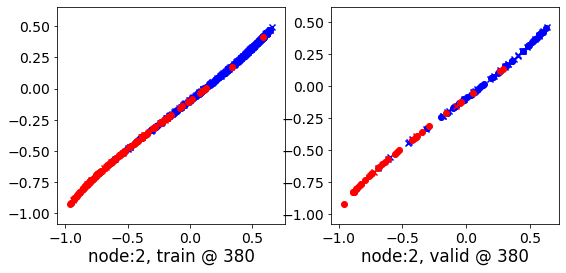

380 	 3 	 0.68790162 	 0.38334543 	 0.76610774 	 0.56369418 	 0.79008549 	 0.87349594


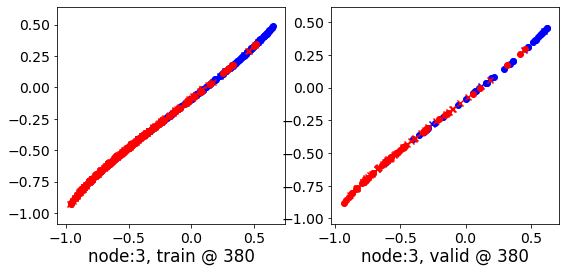

380 	 4 	 0.35512251 	 0.37772560 	 0.58470827 	 0.62856954 	 0.92309475 	 0.94399112


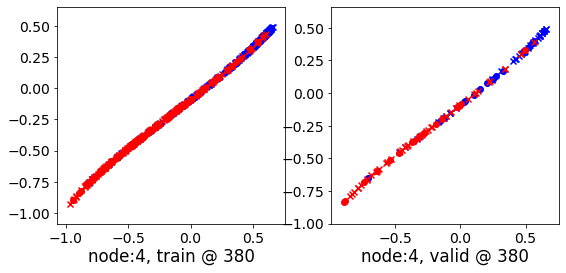

380 	 5 	 0.63721555 	 0.52709192 	 0.89101821 	 0.77434444 	 0.95133680 	 0.94039971


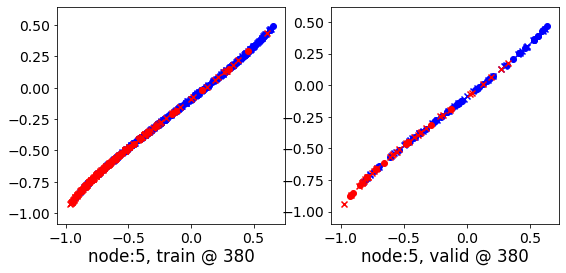

380 	 6 	 0.58280504 	 0.41224074 	 0.80156034 	 0.64183974 	 0.91550201 	 0.92274618


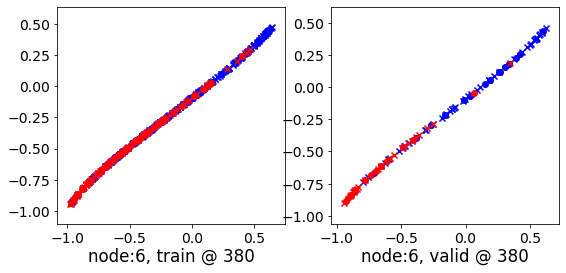

380 	 7 	 0.52735710 	 0.55874968 	 0.77047569 	 0.82589042 	 0.93662870 	 0.96028793


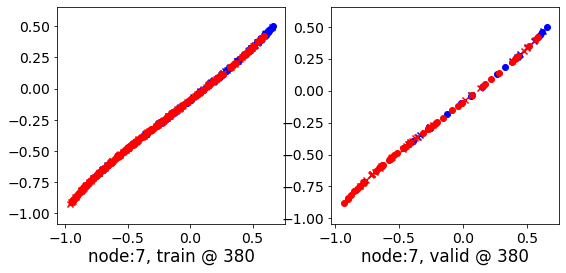

Aggregating on epoch: 382...
Aggregating on epoch: 384...
Aggregating on epoch: 386...
Aggregating on epoch: 388...
Aggregating on epoch: 390...
Aggregating on epoch: 392...
Aggregating on epoch: 394...
Aggregating on epoch: 396...
Aggregating on epoch: 398...
Aggregating on epoch: 400...
400 	 0 	 -0.18715015 	 -0.21070920 	 0.04486337 	 0.02315803 	 0.93010569 	 0.92701441


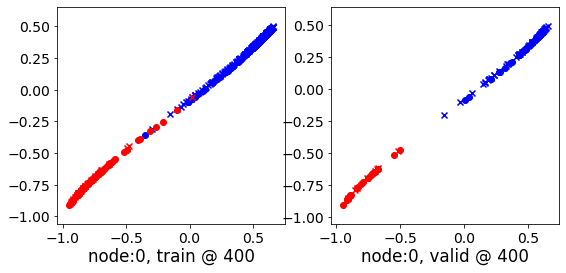

400 	 1 	 -0.03563726 	 0.07409137 	 0.15209162 	 0.22421443 	 0.88815629 	 0.84327024


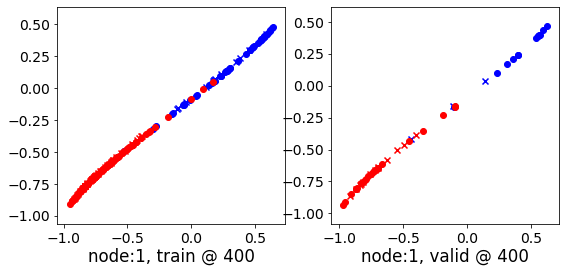

400 	 2 	 0.20128626 	 0.26267499 	 0.35485432 	 0.48712820 	 0.85016513 	 0.91760039


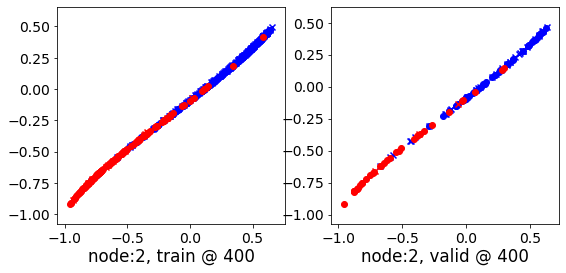

400 	 3 	 0.76721025 	 0.37849182 	 0.76467550 	 0.56209677 	 0.69564384 	 0.87675214


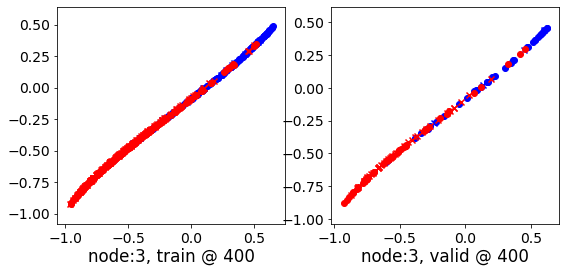

400 	 4 	 0.35517269 	 0.37688297 	 0.58411276 	 0.62792253 	 0.92323864 	 0.94418675


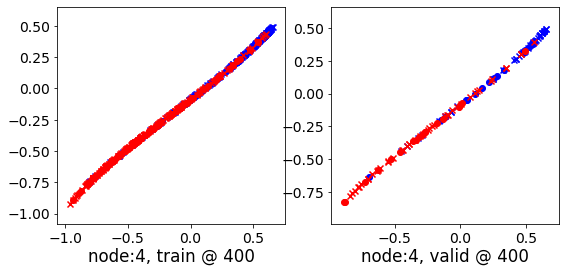

400 	 5 	 0.50507253 	 0.52524668 	 0.73164862 	 0.77281374 	 0.91986787 	 0.94071424


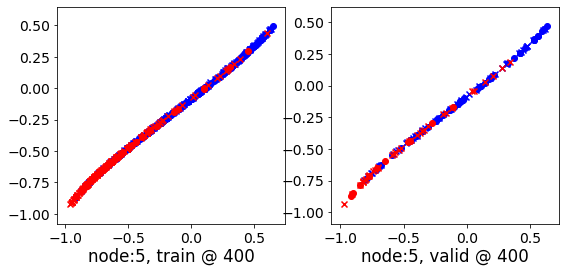

400 	 6 	 0.58333951 	 0.41006351 	 0.80097276 	 0.63981432 	 0.91499484 	 0.92289799


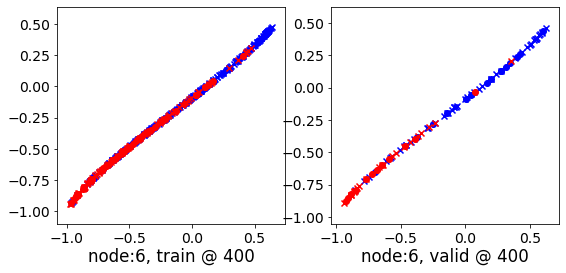

400 	 7 	 0.52584308 	 0.55738884 	 0.76879585 	 0.82395619 	 0.93622714 	 0.95971453


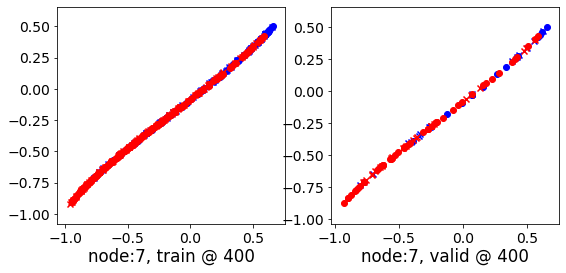

Aggregating on epoch: 402...
Aggregating on epoch: 404...
Aggregating on epoch: 406...
Aggregating on epoch: 408...
Aggregating on epoch: 410...
Aggregating on epoch: 412...
Aggregating on epoch: 414...
Aggregating on epoch: 416...
Aggregating on epoch: 418...
Aggregating on epoch: 420...
420 	 0 	 -0.18587118 	 -0.21138772 	 0.04356915 	 0.02140847 	 0.92950970 	 0.92594337


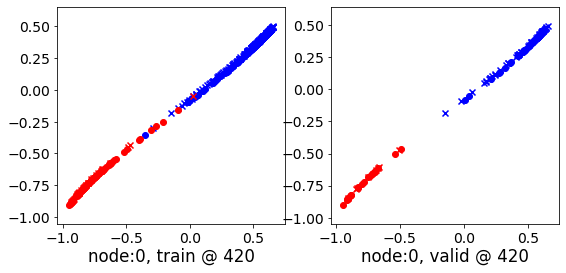

420 	 1 	 -0.03689478 	 0.07349457 	 0.15066184 	 0.22213145 	 0.88731259 	 0.84178406


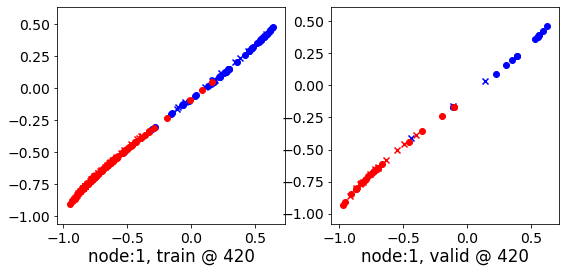

420 	 2 	 0.20008466 	 0.26320758 	 0.35431147 	 0.48536351 	 0.84941286 	 0.91530311


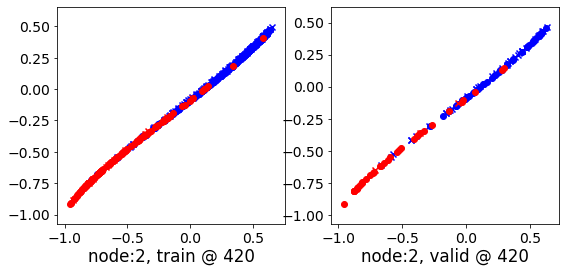

420 	 3 	 0.29333854 	 0.39714545 	 0.52553189 	 0.57866615 	 0.92841846 	 0.87466788


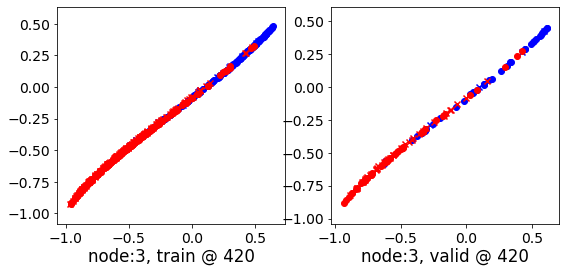

420 	 4 	 0.35409653 	 0.37666303 	 0.58368903 	 0.62783450 	 0.92339069 	 0.94431865


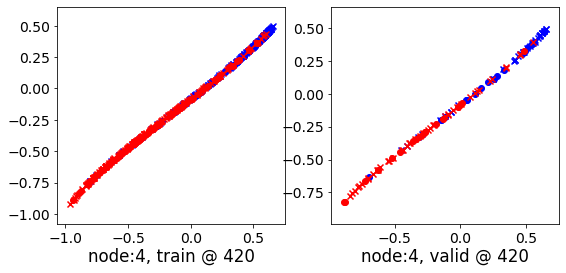

420 	 5 	 0.44410437 	 0.52501607 	 0.69587767 	 0.77238786 	 0.94589412 	 0.94051898


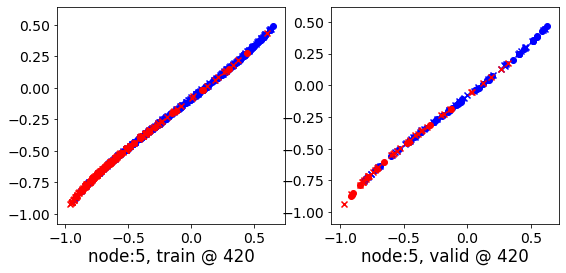

420 	 6 	 0.58289742 	 0.41132939 	 0.80056500 	 0.64105588 	 0.91474026 	 0.92287368


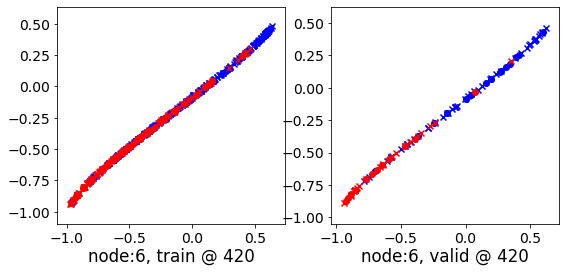

420 	 7 	 0.52484989 	 0.55687511 	 0.76755983 	 0.82319337 	 0.93598968 	 0.95946544


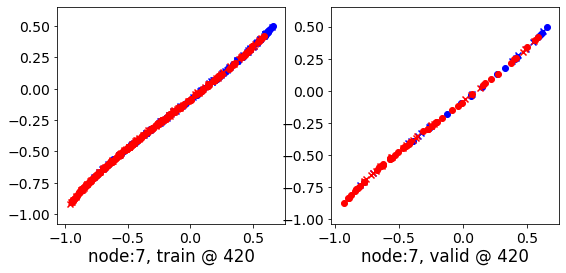

Aggregating on epoch: 422...
Aggregating on epoch: 424...
Aggregating on epoch: 426...
Aggregating on epoch: 428...
Aggregating on epoch: 430...
Aggregating on epoch: 432...
Aggregating on epoch: 434...
Aggregating on epoch: 436...
Aggregating on epoch: 438...
Aggregating on epoch: 440...
440 	 0 	 -0.18636891 	 -0.20986311 	 0.04347215 	 0.02254243 	 0.92930728 	 0.92555273


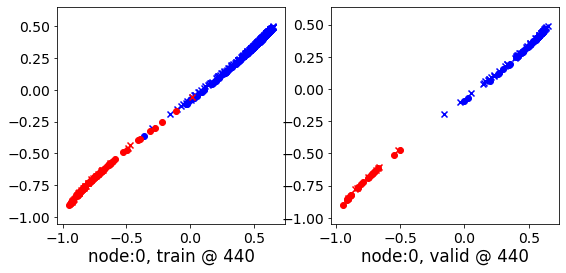

440 	 1 	 -0.03808022 	 0.07238933 	 0.15092409 	 0.22047946 	 0.88661939 	 0.84123731


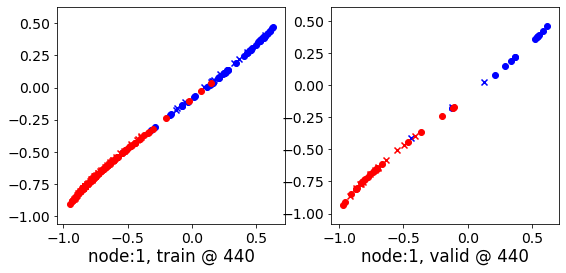

440 	 2 	 0.19886288 	 0.25821999 	 0.35265446 	 0.48394898 	 0.84866852 	 0.91887617


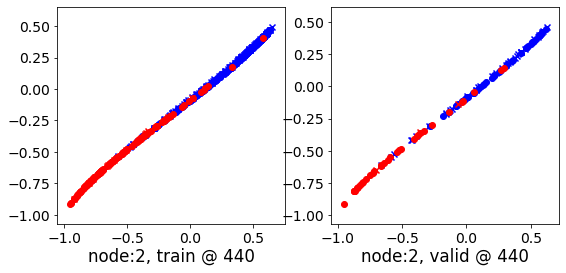

440 	 3 	 0.24368998 	 0.39351511 	 0.42265806 	 0.57759738 	 0.87292403 	 0.87722945


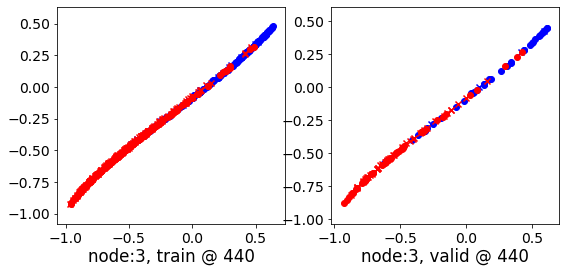

440 	 4 	 0.35288161 	 0.37698412 	 0.58256674 	 0.62733608 	 0.92327553 	 0.94349915


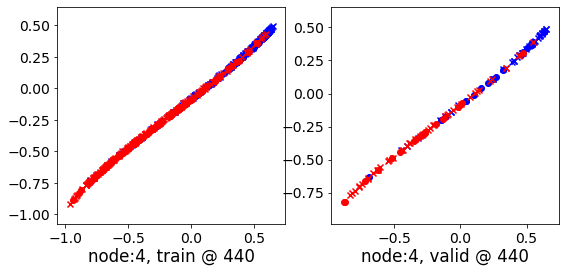

440 	 5 	 0.43985742 	 0.52700794 	 0.63500404 	 0.77446353 	 0.88659400 	 0.94060278


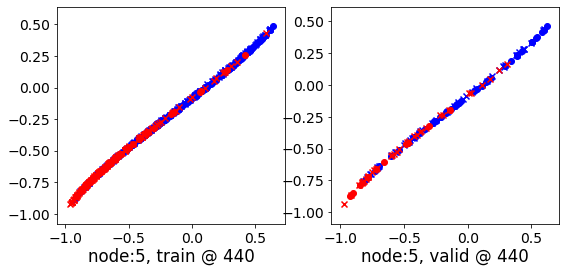

440 	 6 	 0.58070052 	 0.40744388 	 0.79886216 	 0.63927221 	 0.91430682 	 0.92497551


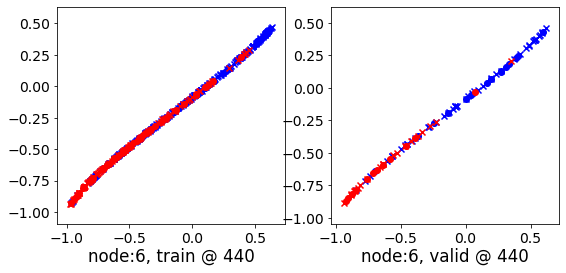

440 	 7 	 0.52400100 	 0.55545217 	 0.76647013 	 0.82321084 	 0.93575311 	 0.96090585


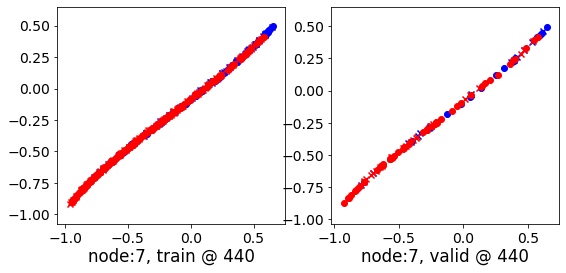

Aggregating on epoch: 442...
Aggregating on epoch: 444...
Aggregating on epoch: 446...
Aggregating on epoch: 448...
Aggregating on epoch: 450...
Aggregating on epoch: 452...
Aggregating on epoch: 454...
Aggregating on epoch: 456...
Aggregating on epoch: 458...
Aggregating on epoch: 460...
460 	 0 	 -0.18615542 	 -0.21013361 	 0.04273798 	 0.02157116 	 0.92884004 	 0.92485195


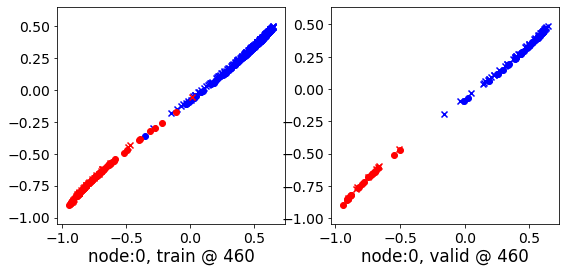

460 	 1 	 -0.03802964 	 0.07103384 	 0.14996268 	 0.21816218 	 0.88504308 	 0.84027553


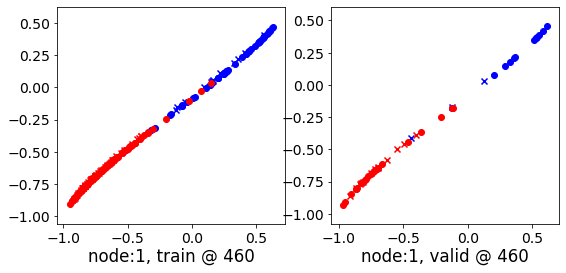

460 	 2 	 0.19886327 	 0.25859481 	 0.35190120 	 0.48246807 	 0.84790289 	 0.91702044


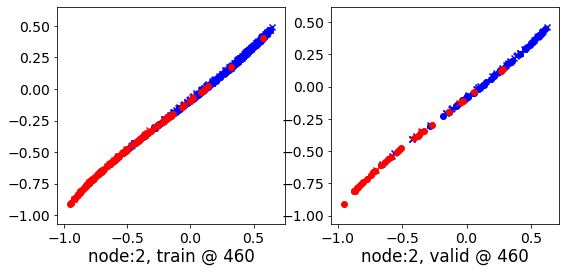

460 	 3 	 0.24772853 	 0.39104718 	 0.23269294 	 0.57364804 	 0.67914569 	 0.87574804


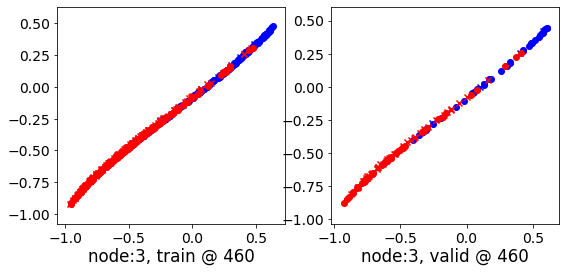

460 	 4 	 0.35216385 	 0.37668771 	 0.58175474 	 0.62677252 	 0.92323059 	 0.94323200


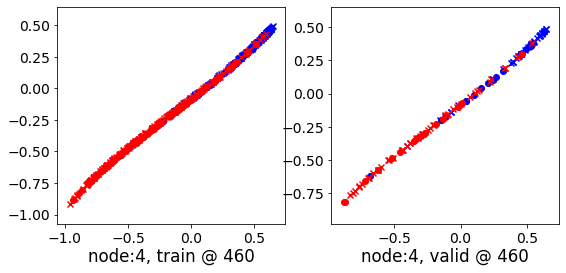

460 	 5 	 0.45270020 	 0.52590150 	 0.72741812 	 0.77387106 	 0.96718025 	 0.94111675


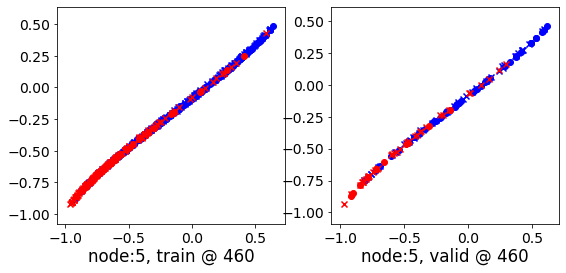

460 	 6 	 0.57984704 	 0.40538287 	 0.79799223 	 0.63798183 	 0.91403347 	 0.92574614


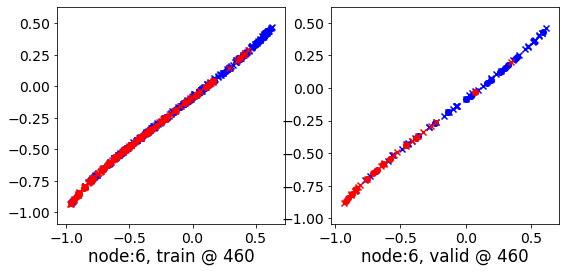

460 	 7 	 0.52313322 	 0.55489755 	 0.76522470 	 0.82262778 	 0.93536615 	 0.96087742


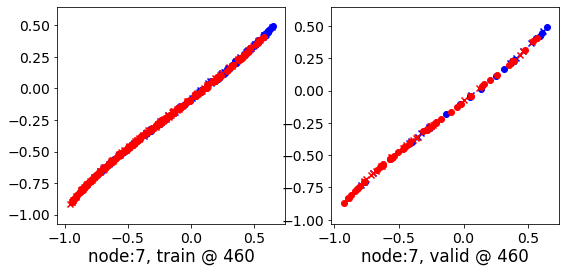

Aggregating on epoch: 462...
Aggregating on epoch: 464...
Aggregating on epoch: 466...
Aggregating on epoch: 468...
Aggregating on epoch: 470...
Aggregating on epoch: 472...
Aggregating on epoch: 474...
Aggregating on epoch: 476...
Aggregating on epoch: 478...
Aggregating on epoch: 480...
480 	 0 	 -0.18460394 	 -0.20912540 	 0.04288732 	 0.02227706 	 0.92860299 	 0.92454964


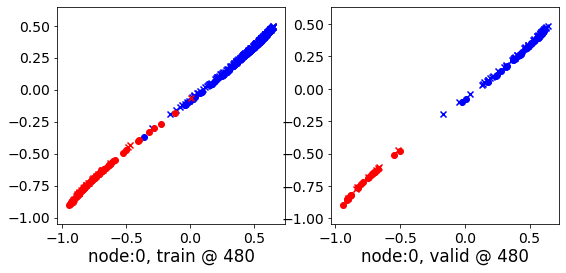

480 	 1 	 -0.03522721 	 0.07127975 	 0.15058409 	 0.21689801 	 0.88355744 	 0.83876544


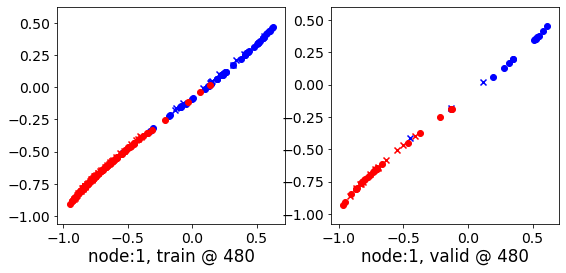

480 	 2 	 0.19768596 	 0.25838909 	 0.35146922 	 0.48260322 	 0.84762329 	 0.91736132


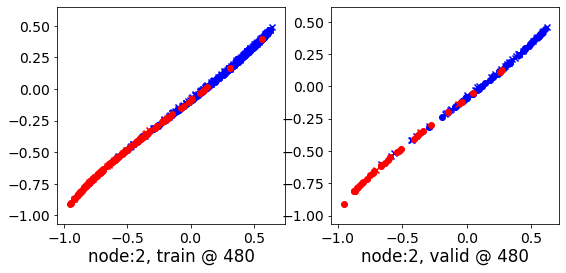

480 	 3 	 -0.18745941 	 0.39299423 	 0.14324543 	 0.57635754 	 1.02667737 	 0.87651050


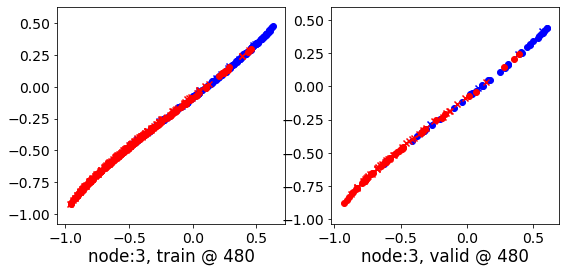

480 	 4 	 0.35153157 	 0.37670124 	 0.58133483 	 0.62651485 	 0.92308420 	 0.94296080


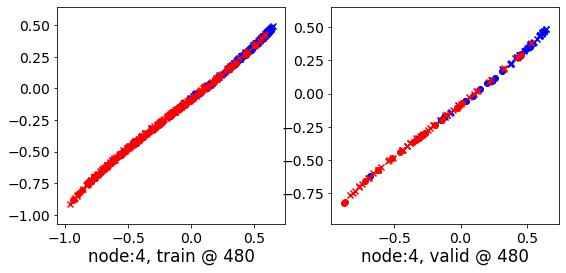

480 	 5 	 0.64471978 	 0.52997804 	 0.85878122 	 0.77830327 	 0.90949363 	 0.94147241


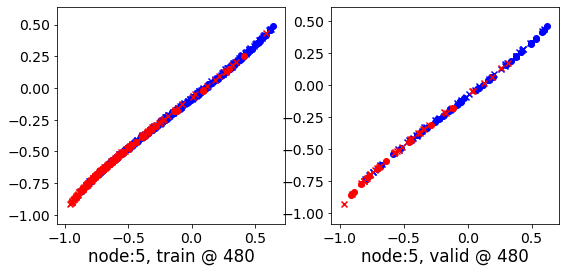

480 	 6 	 0.57817012 	 0.40653366 	 0.79712152 	 0.63971388 	 0.91381210 	 0.92632741


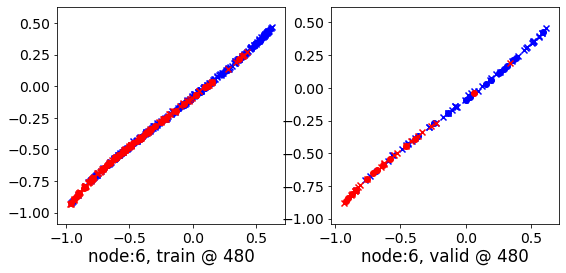

480 	 7 	 0.52248031 	 0.55466282 	 0.76440096 	 0.82273495 	 0.93518001 	 0.96121931


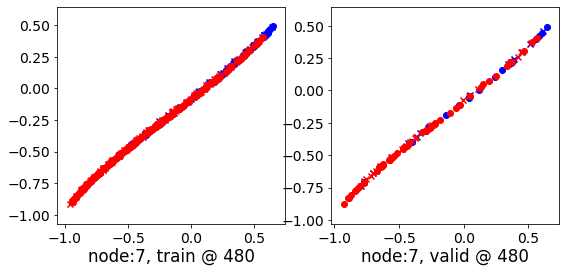

Aggregating on epoch: 482...
Aggregating on epoch: 484...
Aggregating on epoch: 486...
Aggregating on epoch: 488...
Aggregating on epoch: 490...
Aggregating on epoch: 492...
Aggregating on epoch: 494...
Aggregating on epoch: 496...
Aggregating on epoch: 498...
Aggregating on epoch: 500...
500 	 0 	 -0.18843496 	 -0.21186781 	 0.04101336 	 0.01846987 	 0.92774951 	 0.92348486


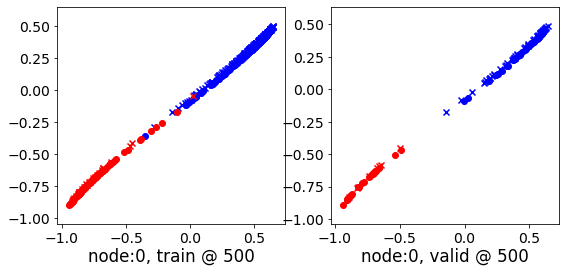

500 	 1 	 -0.03891310 	 0.07101585 	 0.14839649 	 0.21587963 	 0.88253134 	 0.83801097


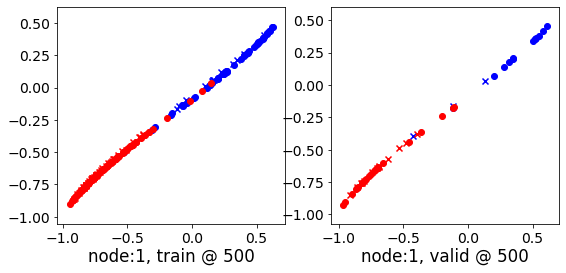

500 	 2 	 0.20102230 	 0.26009253 	 0.35161954 	 0.47997287 	 0.84661657 	 0.91302752


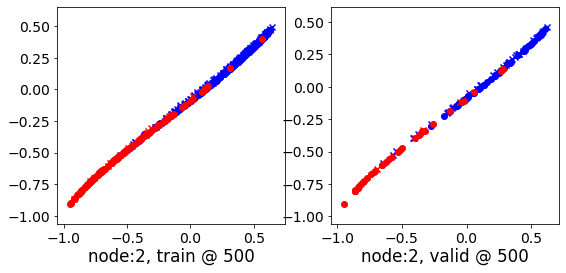

500 	 3 	 0.06110387 	 0.39437979 	 0.24384083 	 0.58033049 	 0.87585628 	 0.87909788


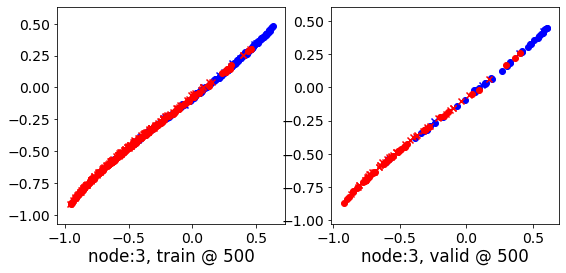

500 	 4 	 0.35162294 	 0.37555057 	 0.58110392 	 0.62562960 	 0.92305189 	 0.94322622


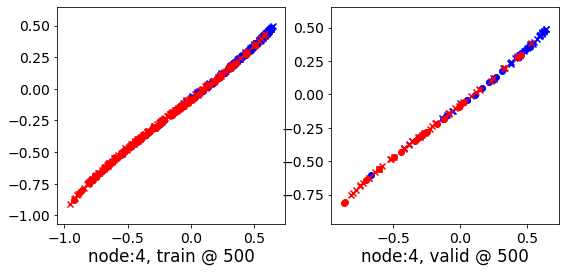

500 	 5 	 0.42226452 	 0.53064066 	 0.69088930 	 0.77949768 	 0.96218187 	 0.94200420


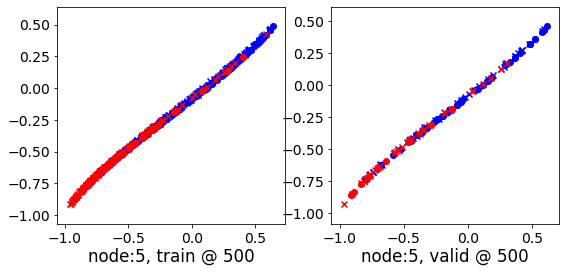

500 	 6 	 0.57964200 	 0.40682292 	 0.79709810 	 0.63828719 	 0.91361201 	 0.92461145


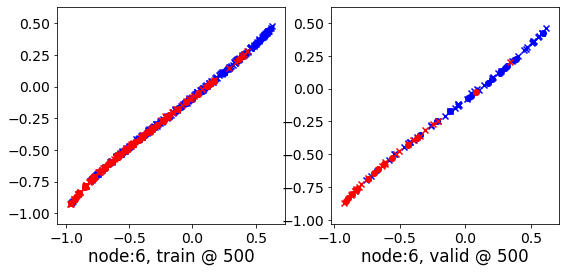

500 	 7 	 0.52194858 	 0.55466175 	 0.76339114 	 0.82174295 	 0.93471038 	 0.96022838


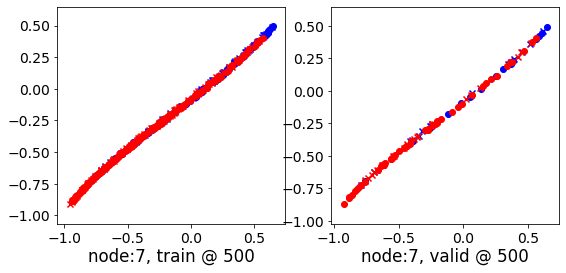

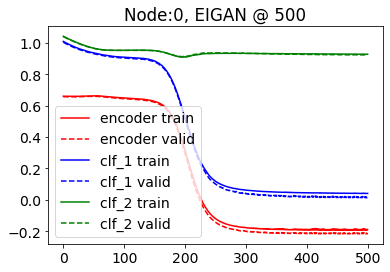

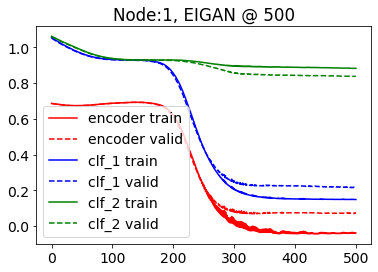

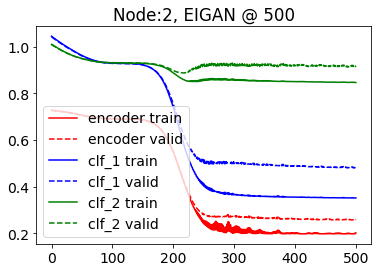

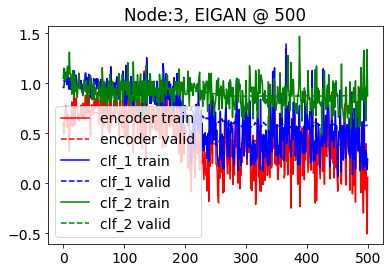

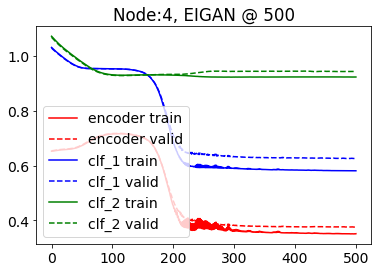

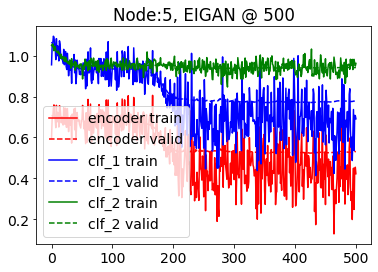

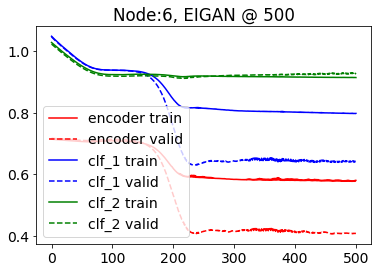

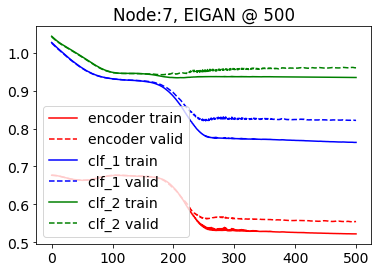

  0%|          | 1/501 [00:00<01:01,  8.12it/s]

epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.96050775 	 0.90624571 	 1.30658638 	 1.24983513 	 1.04030585 	 1.03673661


100%|██████████| 501/501 [01:12<00:00,  6.87it/s]


500 	 0.44073671 	 0.39994955 	 0.70251137 	 0.66461790 	 0.95514661 	 0.95781553


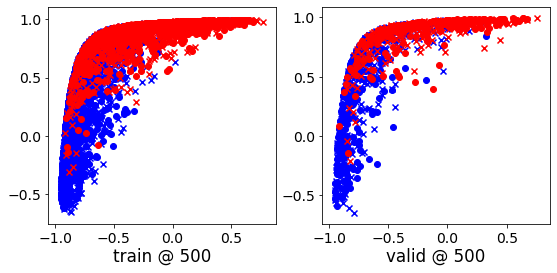

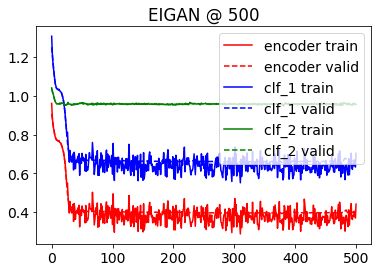

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.301335 	 1.299561 	 0.5485
200 	 0.873871 	 0.878504 	 0.6076
400 	 0.661373 	 0.668119 	 0.7826
600 	 0.654576 	 0.662332 	 0.7848
800 	 0.653822 	 0.661935 	 0.7848
1000 	 0.653569 	 0.661748 	 0.7848
Accuracy: 0.7848383500557413
Error Rate: 0.21516164994425863
F1 Score: 0.7838745800671892
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.738015607580825
Error Rate: 0.26198439241917504
F1 Score: 0.7619047619047619
SVM
--------------------------------------------------------------------------------
Accuracy: 0.770345596432553
Error Rate: 0.229

@node 2: tensor sizes => torch.Size([339, 2]) (85, 2) torch.Size([339, 2]) (85, 2) torch.Size([339, 2]) (85, 2)
@node 3: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(221, 2) (56, 2) (221, 1) (56, 1) (221, 1) (56, 1)
@node 3: class weights => w1, w2 [array([2.92424242, 1.51968504]), array([4.17647059, 1.31481481]), array([1.71212121, 2.40425532]), array([2.00909091, 1.99099099])] [array([2.20571429, 1.82938389]), array([2.75728155, 1.56906077]), array([2.58778626, 1.62980769]), array([1.32335329, 4.09259259])]
@node 3: tensor sizes => torch.Size([221, 2]) (56, 2) torch.Size([221, 2]) (56, 2) torch.Size([221, 2]) (56, 2)
@node 4: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(247, 2) (62, 2) (247, 1) (62, 1) (247, 1) (62, 1)
@node 4: class weights => w1, w2 [array([2.92424242, 1.51968504]), array([4.17647059, 1.31481481]), array([1.71212121, 2.40425532]), array([2.00909091, 1.99099099]), array([1.12272727, 9.14814815])] [array([2.20571429, 1.82938389]), ar

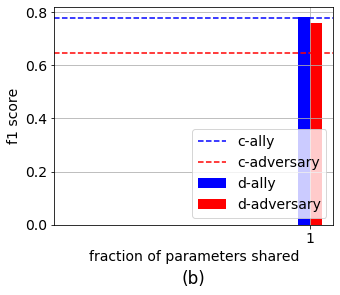

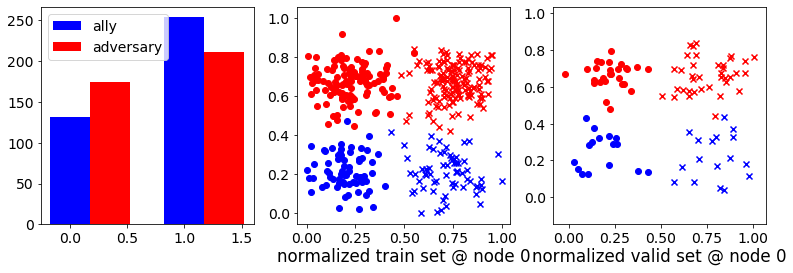

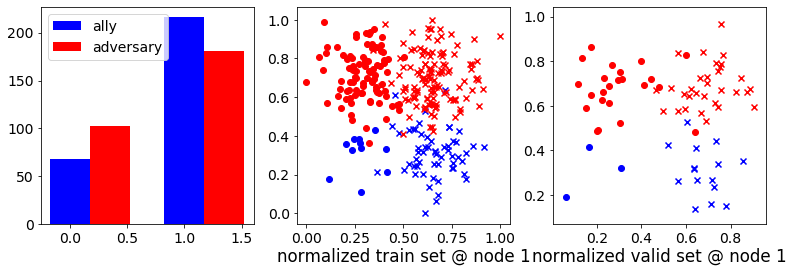

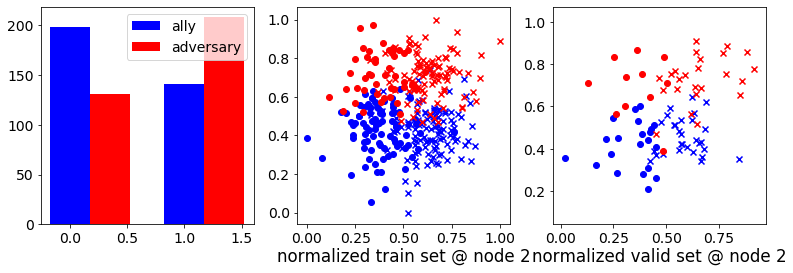

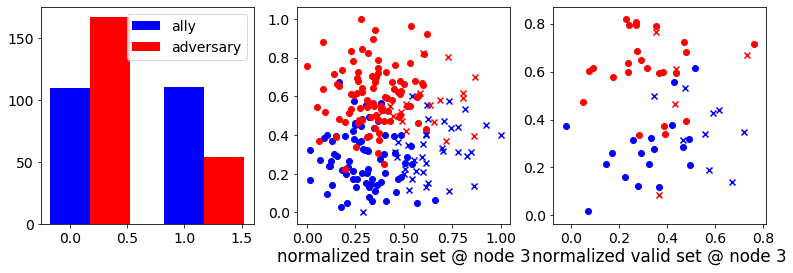

...

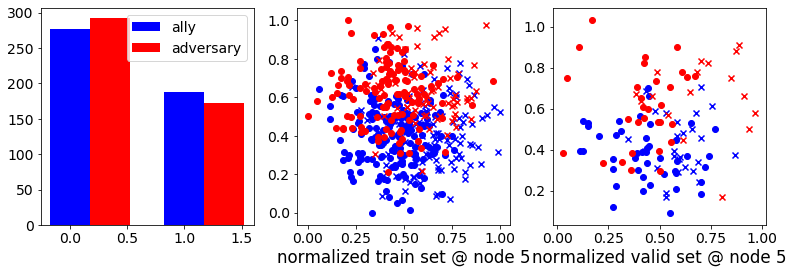

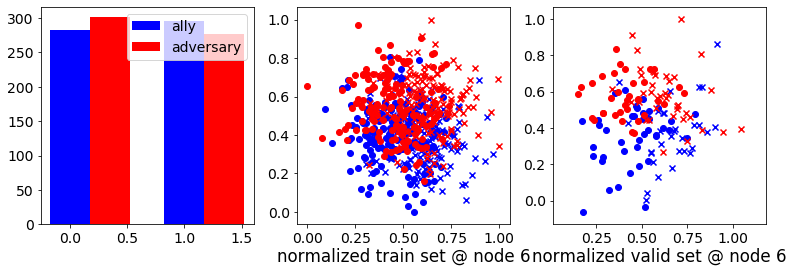

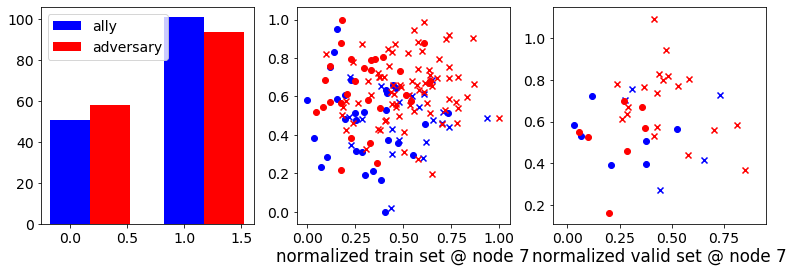

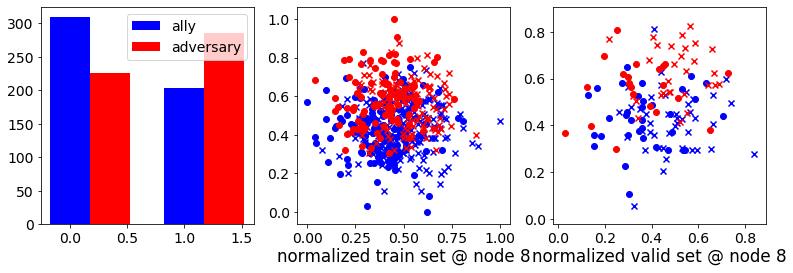

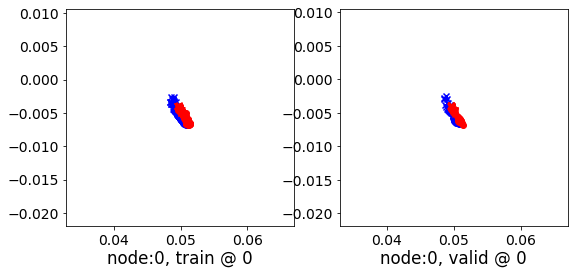

0 	 1 	 0.67308676 	 0.68358994 	 1.01909435 	 1.02726758 	 1.03917551 	 1.03682482


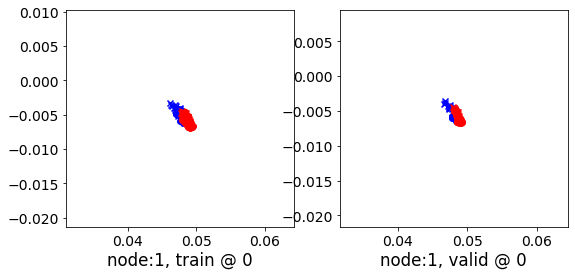

0 	 2 	 0.64881122 	 0.64872754 	 1.00244045 	 0.99936223 	 1.04684746 	 1.04378188


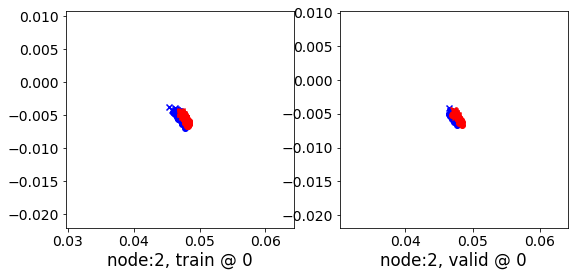

0 	 3 	 0.70340955 	 0.69616175 	 1.03990746 	 1.03524053 	 1.02973080 	 1.03222597


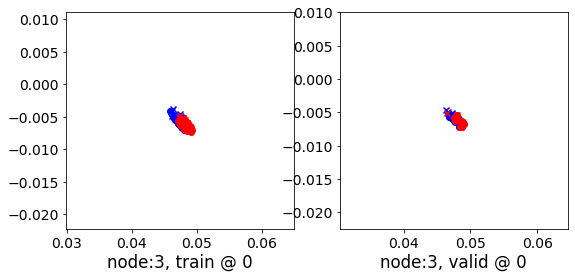

0 	 4 	 0.69713771 	 0.65799308 	 1.07185256 	 1.02960050 	 1.06803894 	 1.06475461


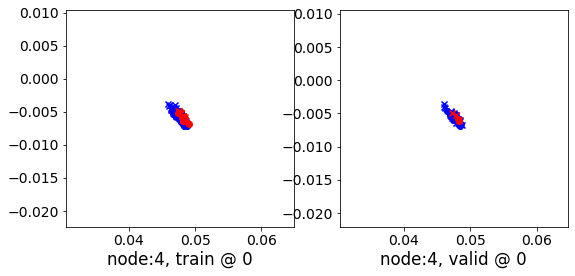

0 	 5 	 0.69535232 	 0.69664872 	 1.04171968 	 1.03950775 	 1.03956854 	 1.03600621


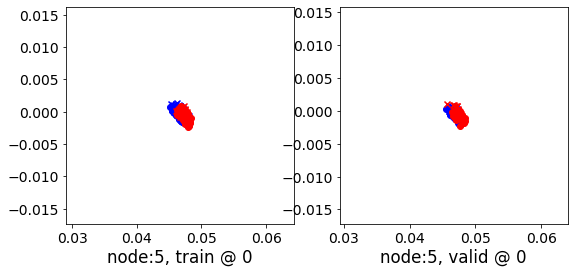

0 	 6 	 0.61703193 	 0.61936522 	 1.01510441 	 1.01522839 	 1.09126198 	 1.08901036


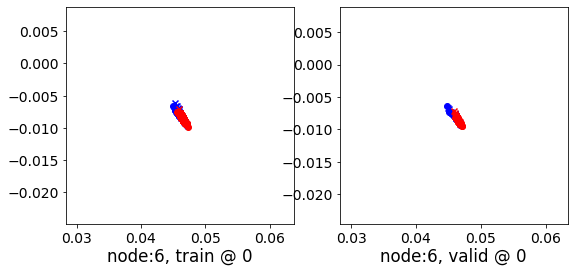

0 	 7 	 0.70182300 	 0.69582880 	 1.06648588 	 1.05387926 	 1.05785954 	 1.05119765


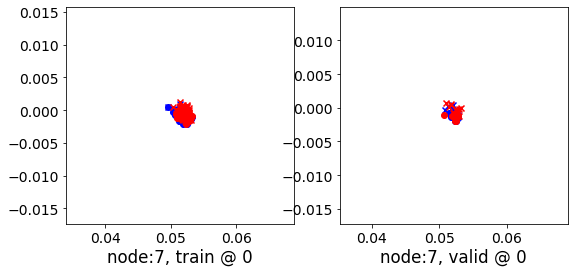

0 	 8 	 0.71576869 	 0.71735477 	 1.05327308 	 1.05168390 	 1.03072143 	 1.02747631


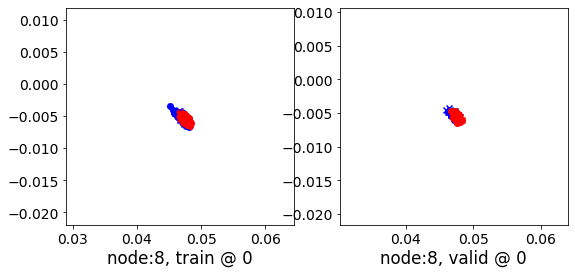

Aggregating on epoch: 2...
Aggregating on epoch: 4...
Aggregating on epoch: 6...
Aggregating on epoch: 8...
Aggregating on epoch: 10...
Aggregating on epoch: 12...
Aggregating on epoch: 14...
Aggregating on epoch: 16...
Aggregating on epoch: 18...
Aggregating on epoch: 20...
20 	 0 	 0.68916202 	 0.69013309 	 1.01575208 	 1.01365161 	 1.01982915 	 1.01666570


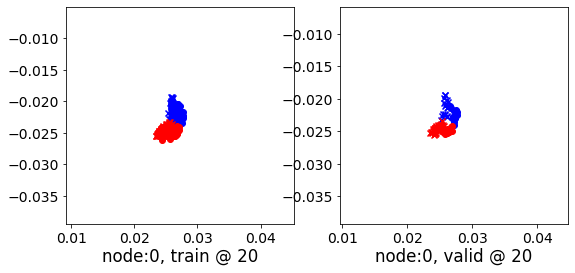

20 	 1 	 0.66356432 	 0.67439395 	 0.97298330 	 0.98198742 	 1.00259840 	 1.00074065


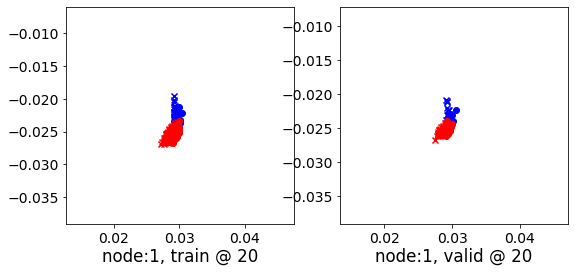

20 	 2 	 0.65854877 	 0.65816116 	 0.97826034 	 0.97545743 	 1.01292121 	 1.01044345


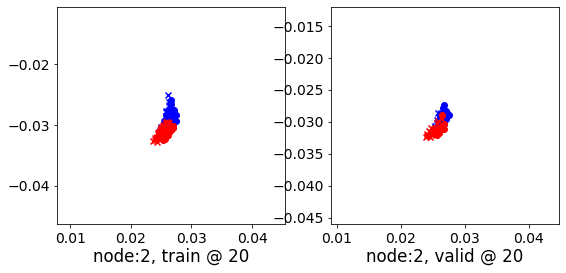

20 	 3 	 0.69576490 	 0.68937969 	 1.00235546 	 0.99871862 	 0.99979085 	 1.00248611


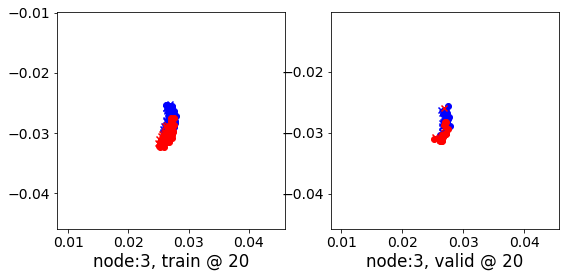

20 	 4 	 0.69446576 	 0.65739393 	 1.02455115 	 0.98509789 	 1.02327526 	 1.02085114


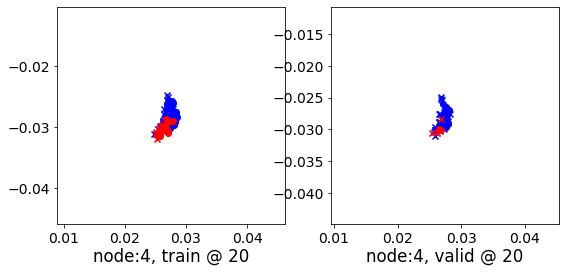

20 	 5 	 0.69307804 	 0.69451678 	 1.01039255 	 1.00847673 	 1.01048863 	 1.00710714


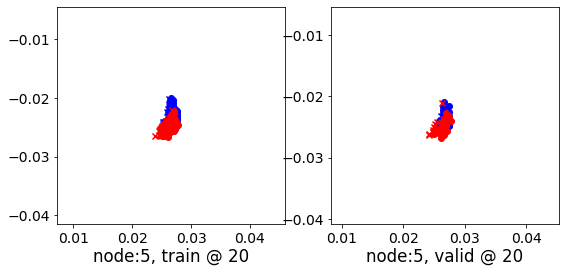

20 	 6 	 0.65254968 	 0.65673512 	 0.97399139 	 0.97684854 	 1.01459897 	 1.01326060


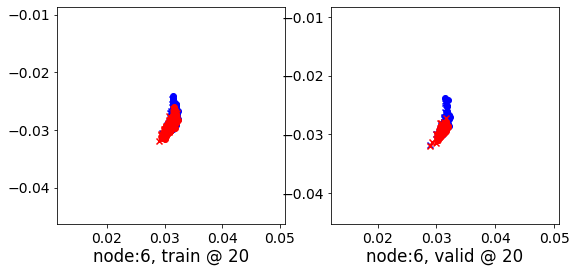

20 	 7 	 0.68015015 	 0.67456841 	 1.02957165 	 1.01735532 	 1.04259956 	 1.03593409


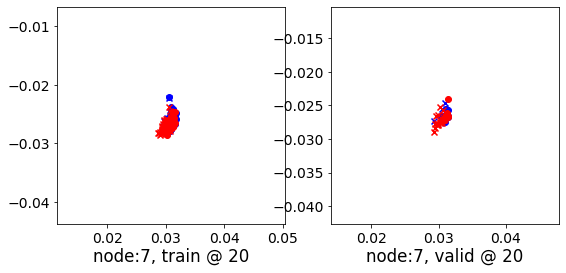

20 	 8 	 0.72904956 	 0.73024583 	 1.02210474 	 1.02096009 	 0.98625863 	 0.98386145


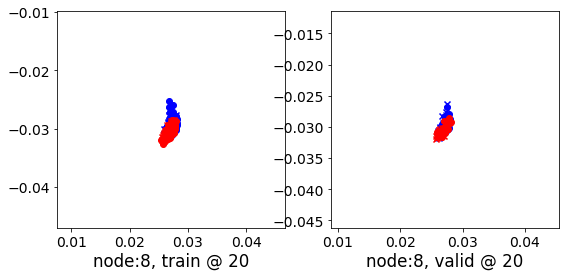

Aggregating on epoch: 22...
Aggregating on epoch: 24...
Aggregating on epoch: 26...
Aggregating on epoch: 28...
Aggregating on epoch: 30...
Aggregating on epoch: 32...
Aggregating on epoch: 34...
Aggregating on epoch: 36...
Aggregating on epoch: 38...
Aggregating on epoch: 40...
40 	 0 	 0.69116914 	 0.69222009 	 0.99075961 	 0.98878098 	 0.99292129 	 0.98970807


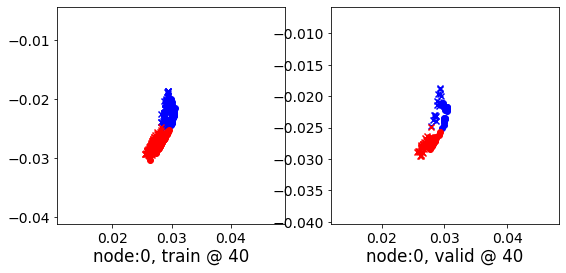

40 	 1 	 0.65644407 	 0.66769022 	 0.93943548 	 0.94927722 	 0.97619468 	 0.97473419


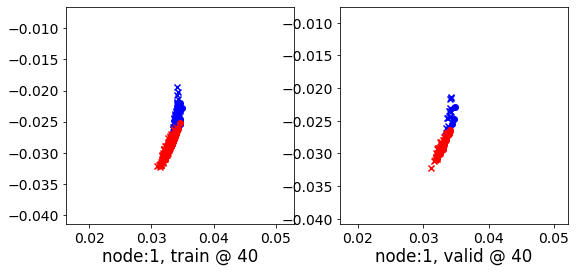

40 	 2 	 0.66473508 	 0.66434675 	 0.95844966 	 0.95613629 	 0.98692054 	 0.98493671


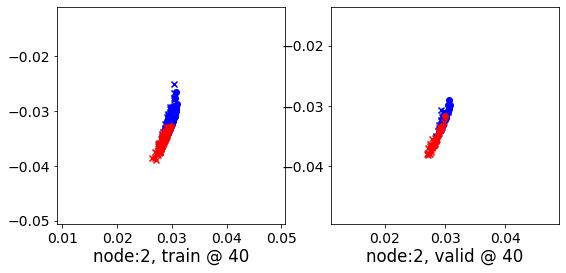

40 	 3 	 0.69708592 	 0.69072193 	 0.97662503 	 0.97355664 	 0.97271335 	 0.97598189


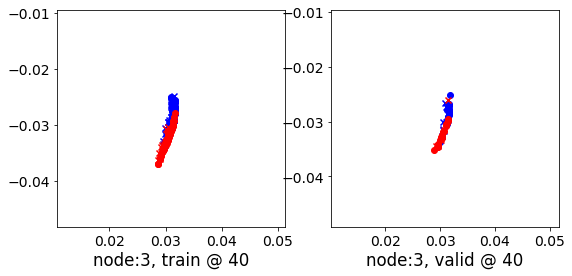

40 	 4 	 0.68854195 	 0.65282768 	 0.98572451 	 0.94792712 	 0.99035591 	 0.98824662


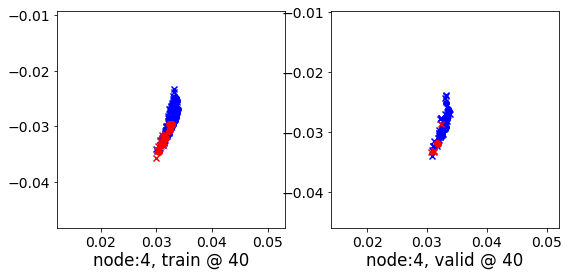

40 	 5 	 0.69157916 	 0.69300568 	 0.98434252 	 0.98248887 	 0.98592627 	 0.98263037


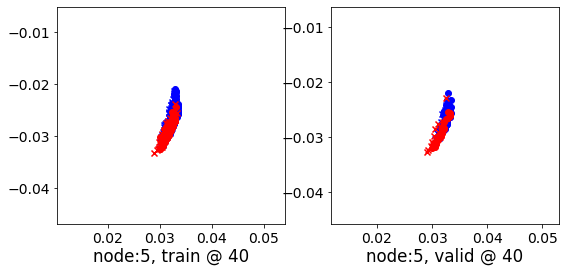

40 	 6 	 0.68290603 	 0.68537414 	 0.95390046 	 0.95591569 	 0.96414697 	 0.96368873


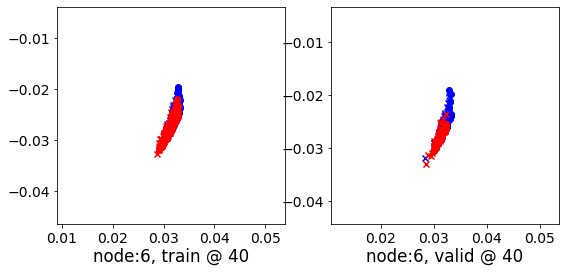

40 	 7 	 0.66196388 	 0.65594184 	 0.99579483 	 0.98306549 	 1.02704918 	 1.02027082


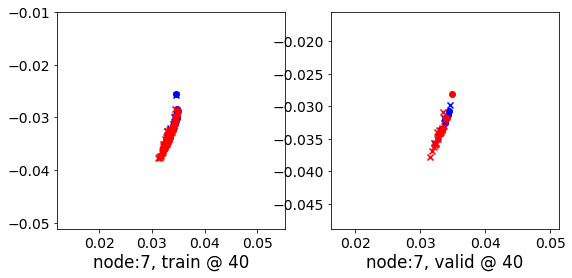

40 	 8 	 0.72727394 	 0.72794759 	 0.99648005 	 0.99555981 	 0.96243358 	 0.96075940


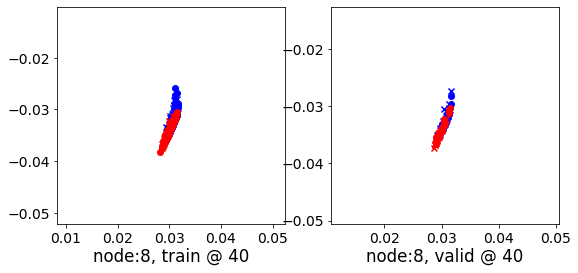

Aggregating on epoch: 42...
Aggregating on epoch: 44...
Aggregating on epoch: 46...
Aggregating on epoch: 48...
Aggregating on epoch: 50...
Aggregating on epoch: 52...
Aggregating on epoch: 54...
Aggregating on epoch: 56...
Aggregating on epoch: 58...
Aggregating on epoch: 60...
60 	 0 	 0.69264483 	 0.69367385 	 0.96891397 	 0.96718508 	 0.96965957 	 0.96665841


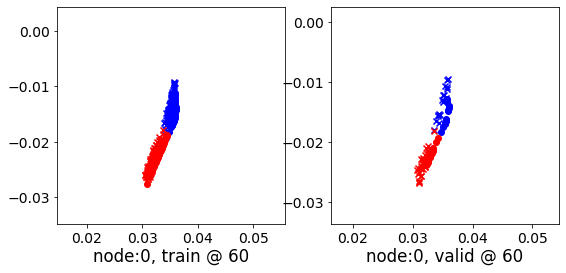

60 	 1 	 0.65329939 	 0.66607183 	 0.91822737 	 0.92985791 	 0.95813704 	 0.95693326


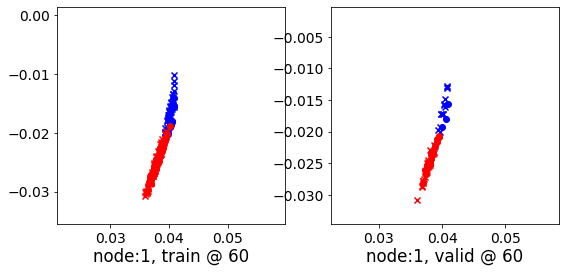

60 	 2 	 0.67495996 	 0.67548770 	 0.95017111 	 0.94856262 	 0.96841109 	 0.96622211


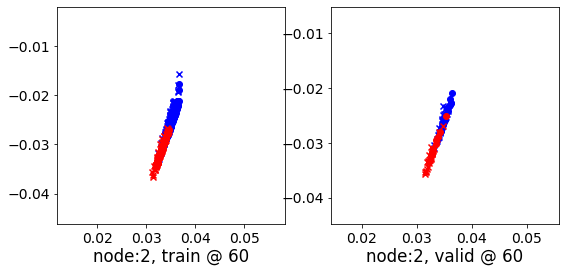

60 	 3 	 0.70649302 	 0.70007831 	 0.96048462 	 0.95831519 	 0.94715315 	 0.95138407


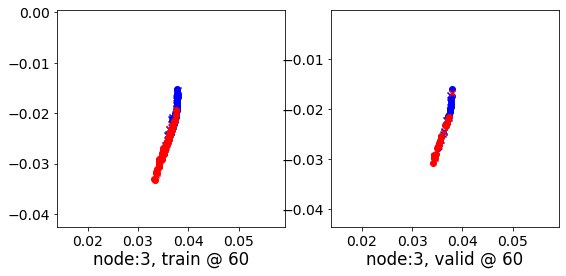

60 	 4 	 0.68142110 	 0.64649171 	 0.95087993 	 0.91404080 	 0.96267217 	 0.96069628


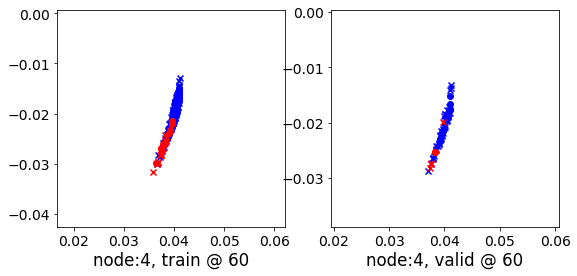

60 	 5 	 0.69193012 	 0.69347972 	 0.96359909 	 0.96200883 	 0.96486700 	 0.96167630


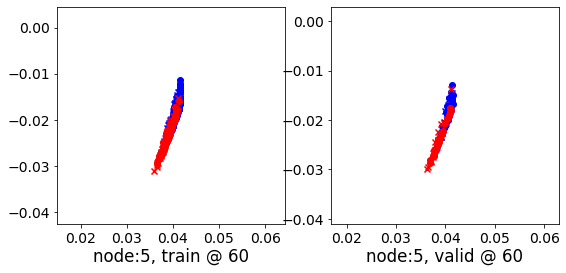

60 	 6 	 0.69005024 	 0.69317698 	 0.95117265 	 0.95456839 	 0.95429176 	 0.95453858


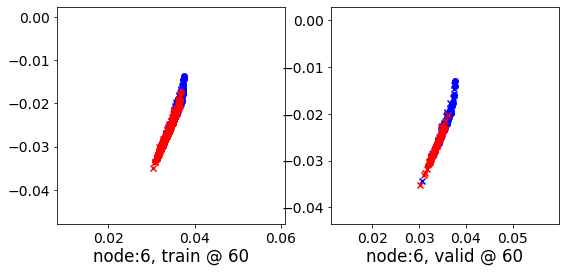

60 	 7 	 0.64856958 	 0.64235044 	 0.96479368 	 0.95183575 	 1.00947654 	 1.00263250


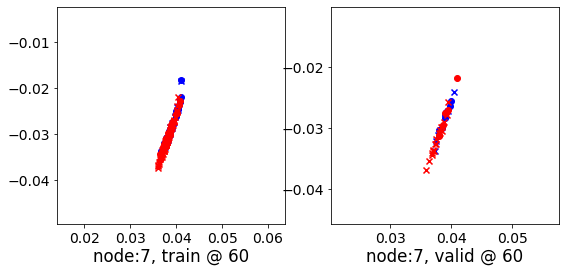

60 	 8 	 0.71467227 	 0.71502876 	 0.97478116 	 0.97415370 	 0.95335960 	 0.95227212


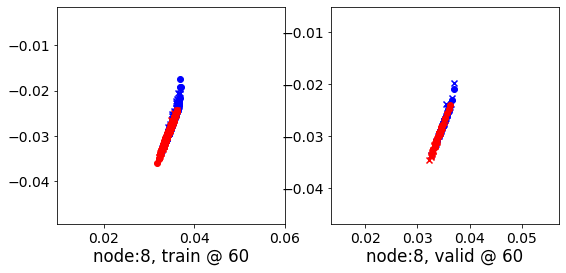

Aggregating on epoch: 62...
Aggregating on epoch: 64...
Aggregating on epoch: 66...
Aggregating on epoch: 68...
Aggregating on epoch: 70...
Aggregating on epoch: 72...
Aggregating on epoch: 74...
Aggregating on epoch: 76...
Aggregating on epoch: 78...
Aggregating on epoch: 80...
80 	 0 	 0.69005513 	 0.69090241 	 0.95292825 	 0.95151532 	 0.95620298 	 0.95376009


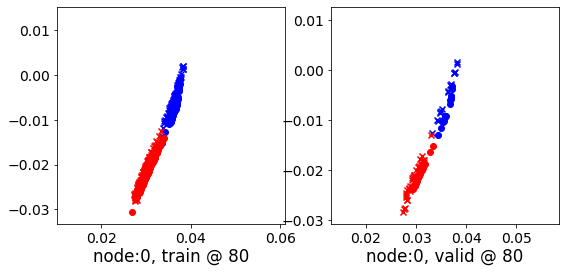

80 	 1 	 0.65412426 	 0.66893208 	 0.90810788 	 0.92196548 	 0.94724327 	 0.94618058


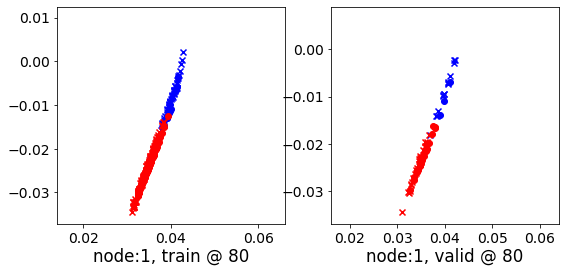

80 	 2 	 0.68754041 	 0.68900442 	 0.94982535 	 0.94830990 	 0.95550501 	 0.95245266


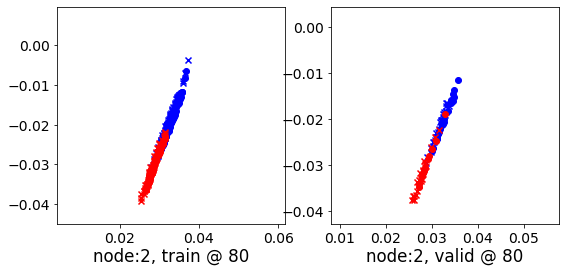

80 	 3 	 0.72156084 	 0.71527261 	 0.95504862 	 0.95414400 	 0.92667544 	 0.93201858


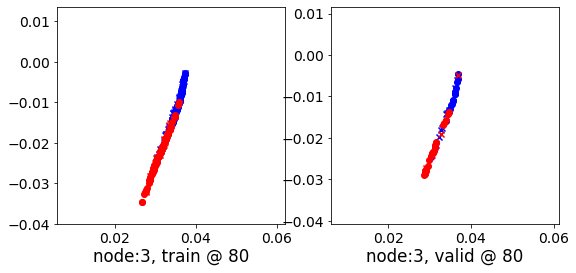

80 	 4 	 0.67151260 	 0.63615257 	 0.91831088 	 0.88132483 	 0.94012910 	 0.93831944


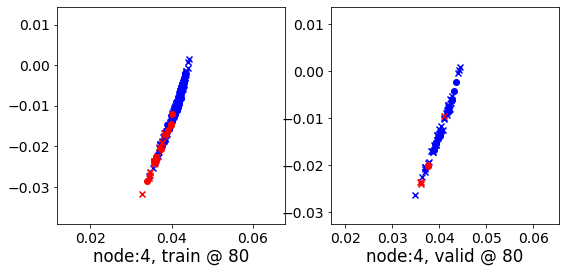

80 	 5 	 0.69477719 	 0.69639891 	 0.95206624 	 0.95086014 	 0.95049226 	 0.94760841


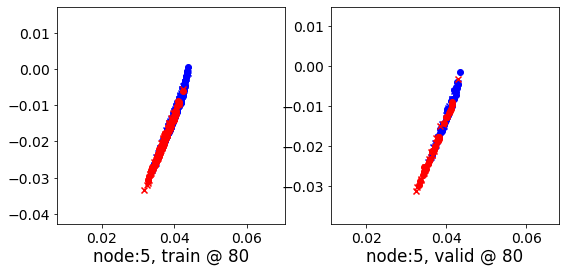

80 	 6 	 0.69054663 	 0.69337493 	 0.95810413 	 0.95441180 	 0.96070731 	 0.95418406


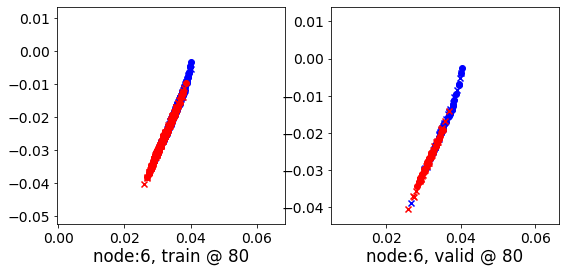

80 	 7 	 0.64676201 	 0.64058387 	 0.94393140 	 0.93105257 	 0.99041629 	 0.98361588


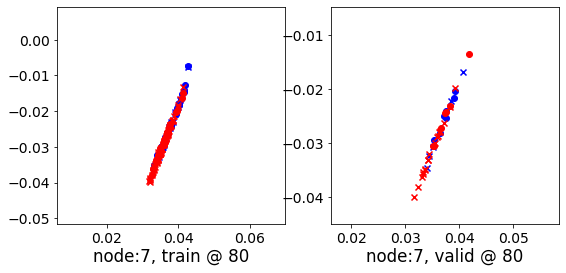

80 	 8 	 0.70030606 	 0.70100331 	 0.95955729 	 0.95941925 	 0.95251715 	 0.95156312


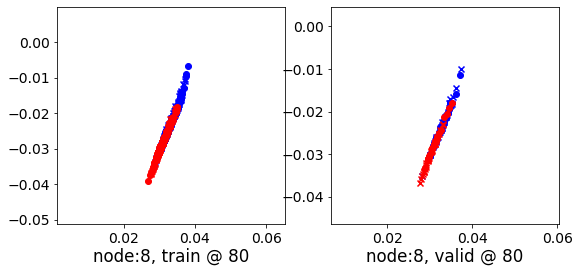

Aggregating on epoch: 82...
Aggregating on epoch: 84...
Aggregating on epoch: 86...
Aggregating on epoch: 88...
Aggregating on epoch: 90...
Aggregating on epoch: 92...
Aggregating on epoch: 94...
Aggregating on epoch: 96...
Aggregating on epoch: 98...
Aggregating on epoch: 100...
100 	 0 	 0.68337154 	 0.68414658 	 0.94352019 	 0.94227898 	 0.95336950 	 0.95127958


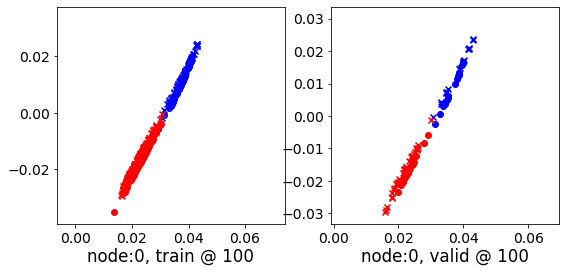

100 	 1 	 0.65492660 	 0.67071337 	 0.90476751 	 0.91975868 	 0.94318783 	 0.94219249


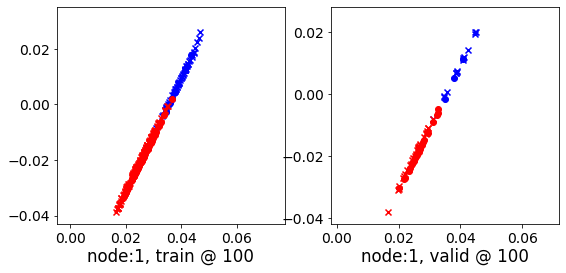

100 	 2 	 0.69401151 	 0.69639534 	 0.94930482 	 0.94778210 	 0.94851917 	 0.94453394


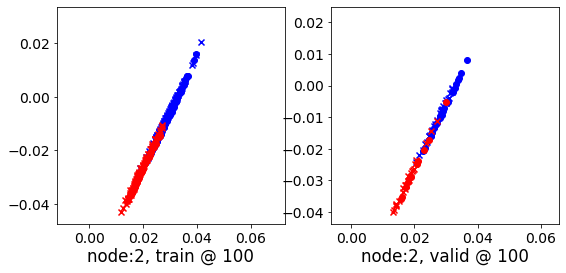

100 	 3 	 0.73311770 	 0.72643900 	 0.95422089 	 0.95411348 	 0.91431689 	 0.92082167


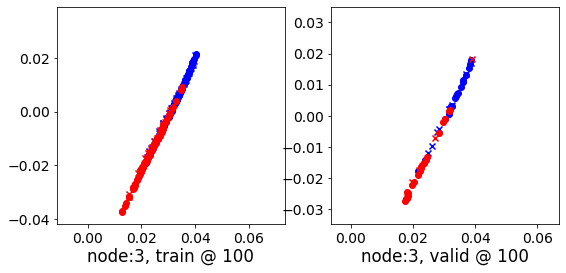

100 	 4 	 0.65593964 	 0.61857057 	 0.88868648 	 0.85014671 	 0.92625457 	 0.92472333


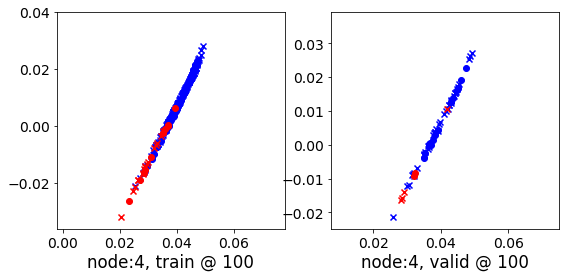

100 	 5 	 0.69724786 	 0.69878316 	 0.94872576 	 0.94766790 	 0.94465089 	 0.94203192


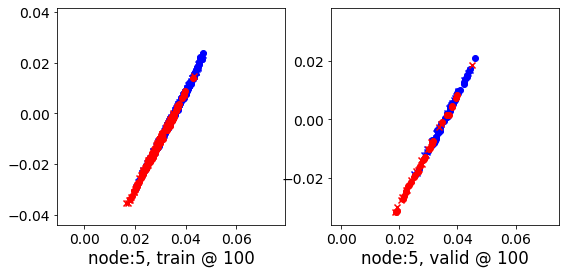

100 	 6 	 0.69631422 	 0.69263667 	 0.95163554 	 0.95390970 	 0.94860286 	 0.95442021


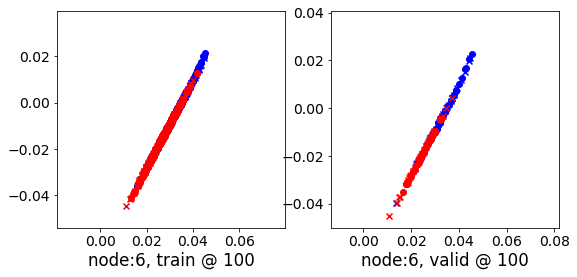

100 	 7 	 0.65811282 	 0.65082997 	 0.93718982 	 0.92334449 	 0.97228253 	 0.96566170


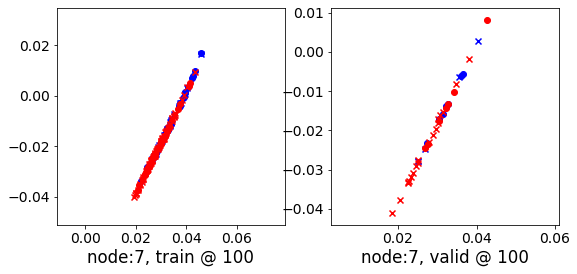

100 	 8 	 0.69245273 	 0.69370598 	 0.95172334 	 0.95209903 	 0.95250100 	 0.95154023


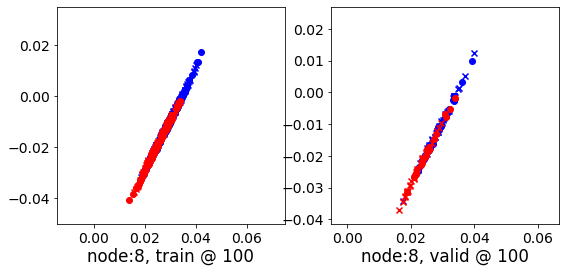

Aggregating on epoch: 102...
Aggregating on epoch: 104...
Aggregating on epoch: 106...
Aggregating on epoch: 108...
Aggregating on epoch: 110...
Aggregating on epoch: 112...
Aggregating on epoch: 114...
Aggregating on epoch: 116...
Aggregating on epoch: 118...
Aggregating on epoch: 120...
120 	 0 	 0.67855000 	 0.67930818 	 0.93871433 	 0.93750459 	 0.95338714 	 0.95134360


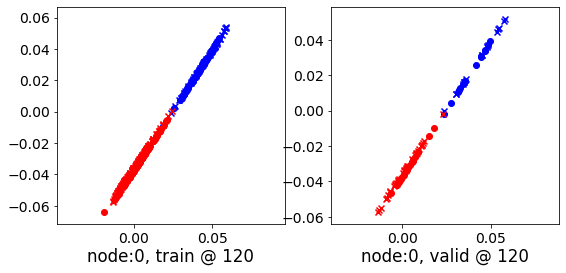

120 	 1 	 0.65244466 	 0.66854942 	 0.90144306 	 0.91695386 	 0.94258618 	 0.94155163


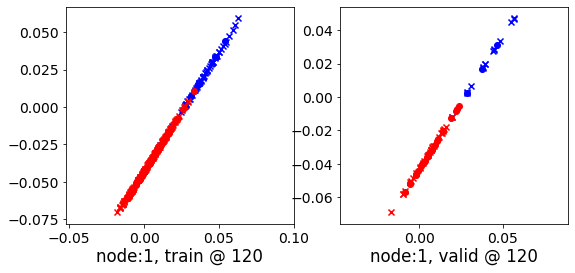

120 	 2 	 0.69465059 	 0.69757456 	 0.94774932 	 0.94623703 	 0.94639564 	 0.94180965


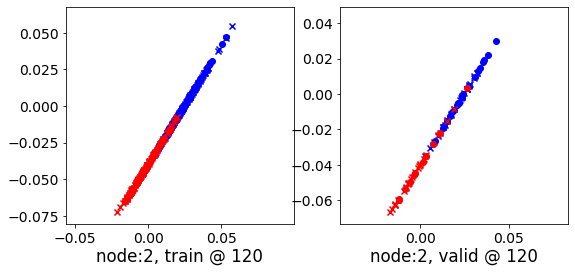

120 	 3 	 0.73703980 	 0.72953939 	 0.95297909 	 0.95295066 	 0.90920085 	 0.91655844


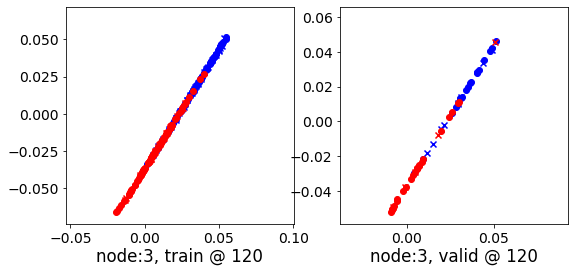

120 	 4 	 0.63704485 	 0.59757197 	 0.86395043 	 0.82366610 	 0.92053545 	 0.91924131


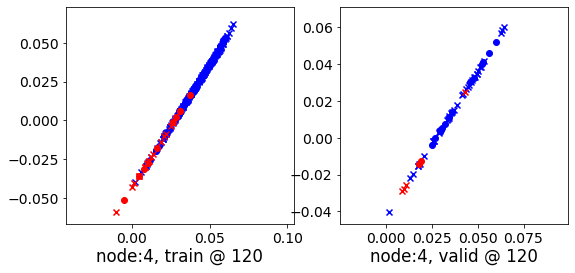

120 	 5 	 0.69727826 	 0.69866759 	 0.94777572 	 0.94663912 	 0.94369316 	 0.94111872


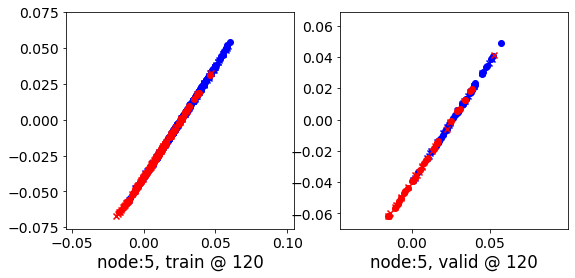

120 	 6 	 0.67249918 	 0.69106561 	 0.95245761 	 0.95214403 	 0.97338301 	 0.95422560


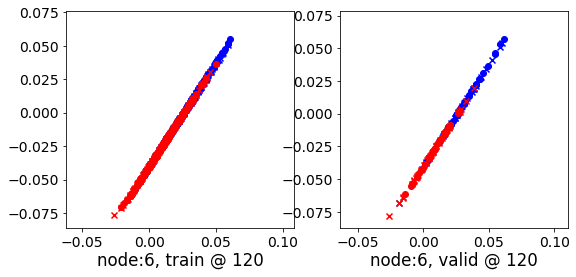

120 	 7 	 0.67150521 	 0.66248077 	 0.93638217 	 0.92102355 	 0.95807046 	 0.95168996


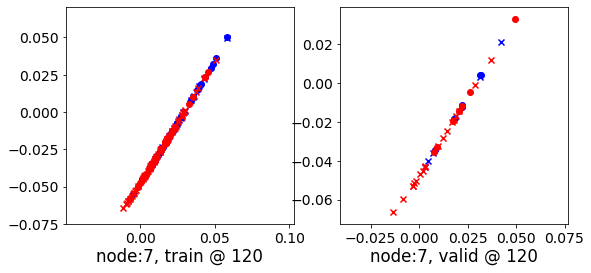

120 	 8 	 0.68967593 	 0.69135296 	 0.94895077 	 0.94979048 	 0.95247948 	 0.95158470


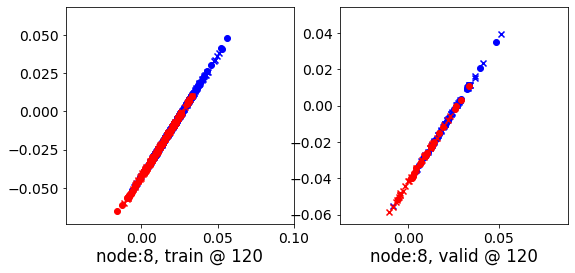

Aggregating on epoch: 122...
Aggregating on epoch: 124...
Aggregating on epoch: 126...
Aggregating on epoch: 128...
Aggregating on epoch: 130...
Aggregating on epoch: 132...
Aggregating on epoch: 134...
Aggregating on epoch: 136...
Aggregating on epoch: 138...
Aggregating on epoch: 140...
140 	 0 	 0.67480850 	 0.67546153 	 0.93493086 	 0.93375158 	 0.95347041 	 0.95143723


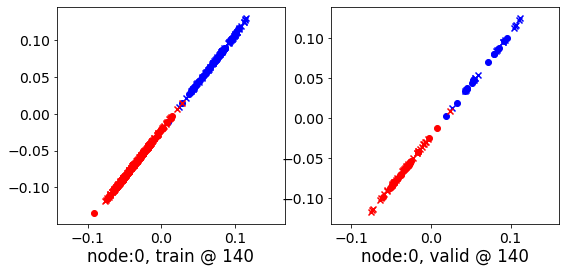

140 	 1 	 0.63825649 	 0.65333837 	 0.88654840 	 0.90185261 	 0.94280970 	 0.94166142


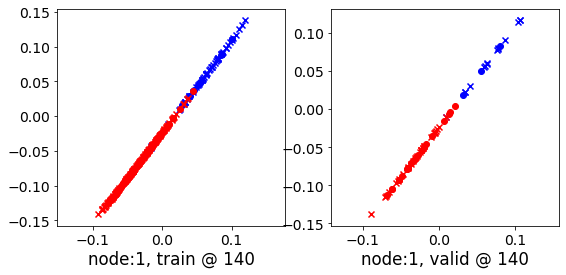

140 	 2 	 0.68782765 	 0.69042075 	 0.94030410 	 0.93881512 	 0.94619948 	 0.94154155


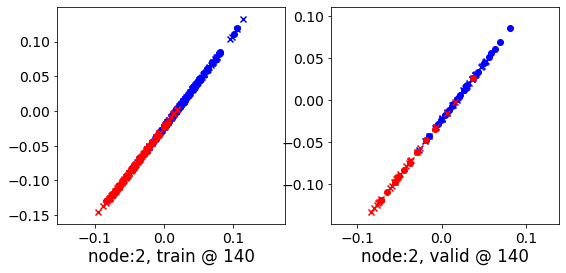

140 	 3 	 0.73245865 	 0.72419238 	 0.94635546 	 0.94644153 	 0.90754157 	 0.91539633


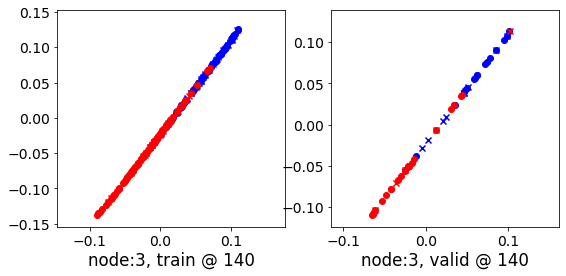

140 	 4 	 0.61642206 	 0.57595885 	 0.84194964 	 0.80097753 	 0.91928953 	 0.91816586


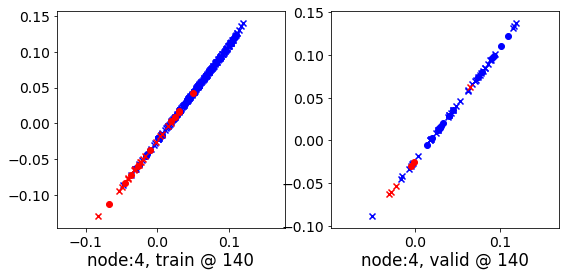

140 	 5 	 0.69422668 	 0.69520140 	 0.94454849 	 0.94315022 	 0.94369709 	 0.94109601


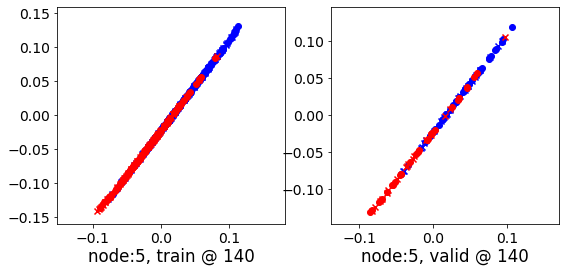

140 	 6 	 0.68909371 	 0.68214101 	 0.94891179 	 0.94326079 	 0.95334804 	 0.95426697


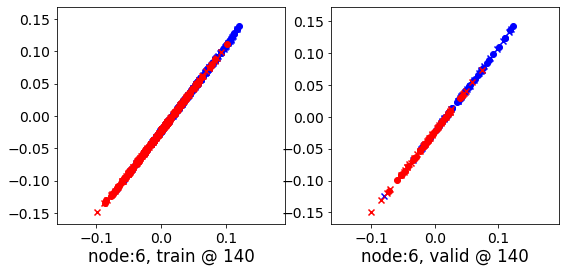

140 	 7 	 0.67963570 	 0.67032152 	 0.93607861 	 0.92047679 	 0.94965255 	 0.94330245


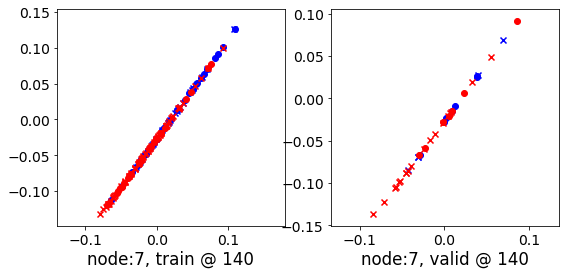

140 	 8 	 0.68980253 	 0.69164979 	 0.94902551 	 0.95016778 	 0.95243573 	 0.95166516


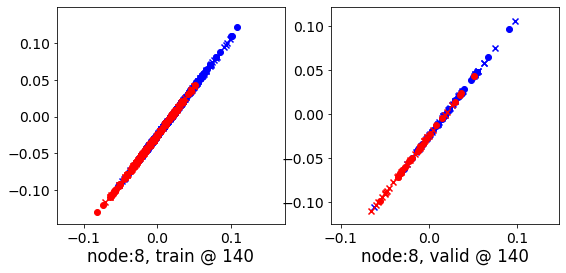

Aggregating on epoch: 142...
Aggregating on epoch: 144...
Aggregating on epoch: 146...
Aggregating on epoch: 148...
Aggregating on epoch: 150...
Aggregating on epoch: 152...
Aggregating on epoch: 154...
Aggregating on epoch: 156...
Aggregating on epoch: 158...
Aggregating on epoch: 160...
160 	 0 	 0.66071868 	 0.66058820 	 0.92038095 	 0.91933113 	 0.95395631 	 0.95189011


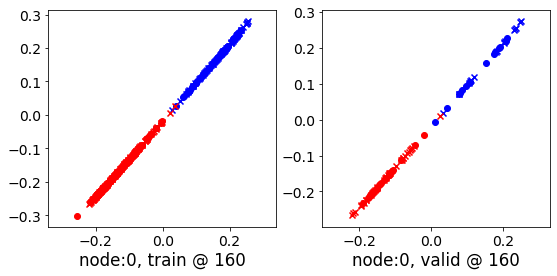

160 	 1 	 0.58410382 	 0.59656268 	 0.82607484 	 0.84073263 	 0.93816429 	 0.93731713


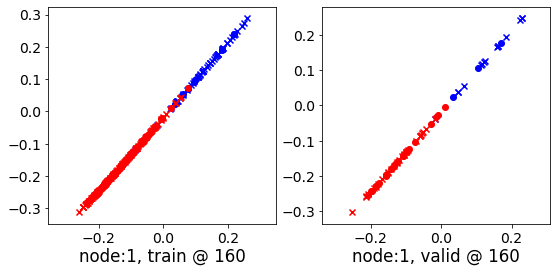

160 	 2 	 0.65078545 	 0.65110528 	 0.90097290 	 0.89993703 	 0.94634742 	 0.94197893


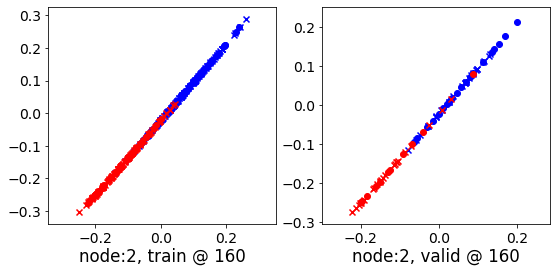

160 	 3 	 0.70504785 	 0.69402373 	 0.91512430 	 0.91450655 	 0.90525681 	 0.91363001


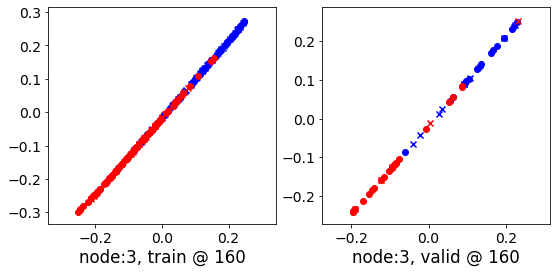

160 	 4 	 0.58333617 	 0.54419547 	 0.80752063 	 0.76935422 	 0.91862619 	 0.91830593


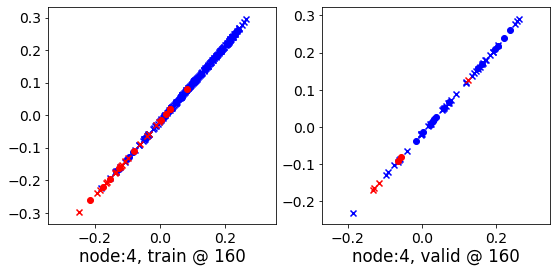

160 	 5 	 0.68063569 	 0.67997515 	 0.93041968 	 0.92811787 	 0.94374269 	 0.94128990


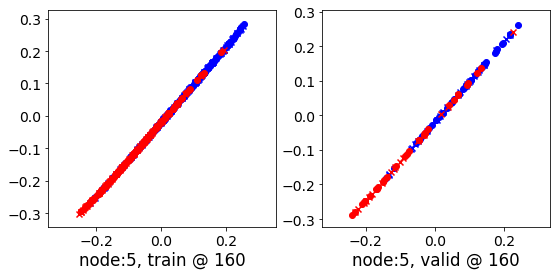

160 	 6 	 0.63641834 	 0.62877762 	 0.89803094 	 0.88976884 	 0.95823431 	 0.95413840


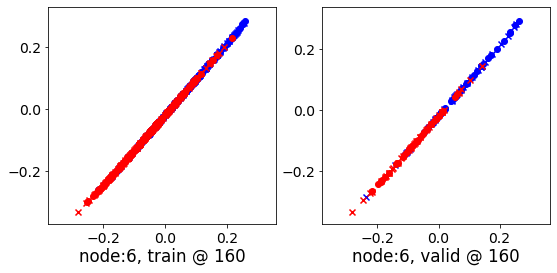

160 	 7 	 0.67997682 	 0.67247522 	 0.93280494 	 0.91763496 	 0.94614333 	 0.93830693


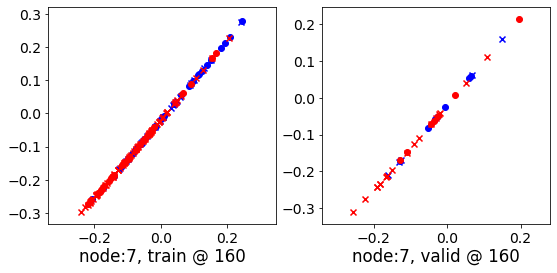

160 	 8 	 0.68835384 	 0.68924946 	 0.94737124 	 0.94795990 	 0.95232880 	 0.95185763


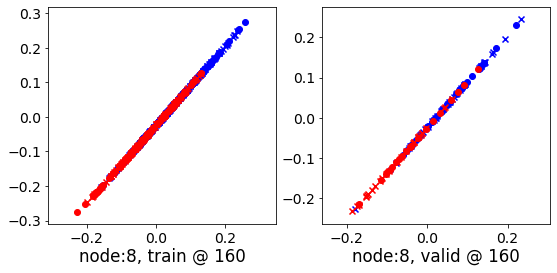

Aggregating on epoch: 162...
Aggregating on epoch: 164...
Aggregating on epoch: 166...
Aggregating on epoch: 168...
Aggregating on epoch: 170...
Aggregating on epoch: 172...
Aggregating on epoch: 174...
Aggregating on epoch: 176...
Aggregating on epoch: 178...
Aggregating on epoch: 180...
180 	 0 	 0.60061961 	 0.59855056 	 0.85791653 	 0.85759175 	 0.95429444 	 0.95218837


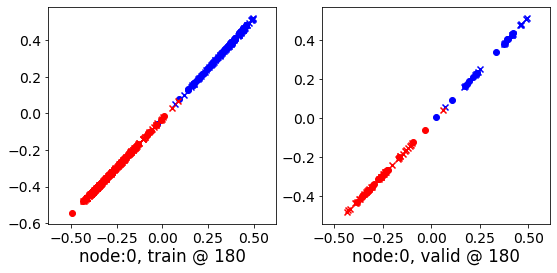

180 	 1 	 0.42837799 	 0.42733300 	 0.65426648 	 0.66017139 	 0.92535627 	 0.92598557


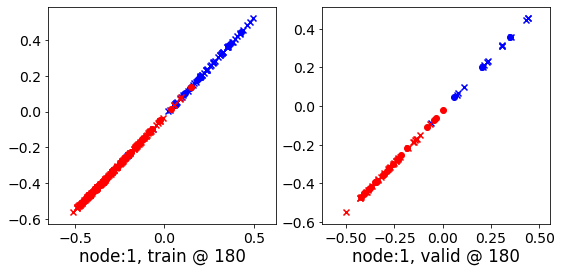

180 	 2 	 0.52183992 	 0.51375049 	 0.76244181 	 0.76296782 	 0.94628429 	 0.94236451


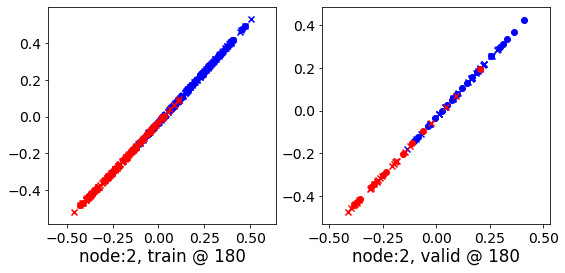

180 	 3 	 0.59838557 	 0.58075684 	 0.79753065 	 0.79642481 	 0.89860117 	 0.90881515


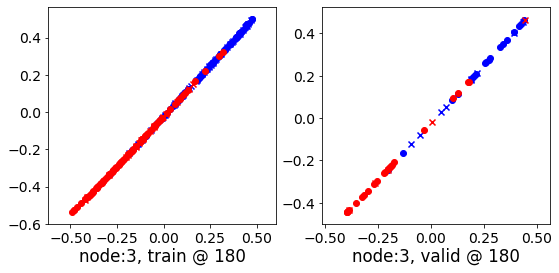

180 	 4 	 0.51166195 	 0.48163950 	 0.73188925 	 0.70786327 	 0.91655576 	 0.91937095


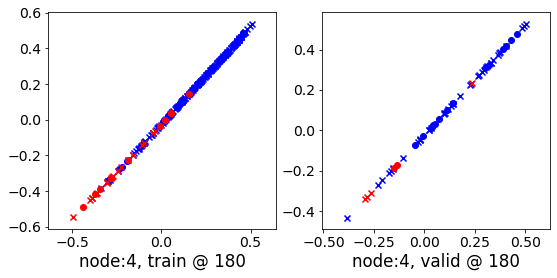

180 	 5 	 0.64075279 	 0.63912821 	 0.88975042 	 0.88785201 	 0.94377261 	 0.94187099


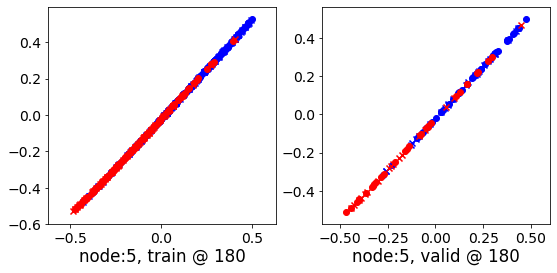

180 	 6 	 0.53283769 	 0.47124654 	 0.78943646 	 0.73232067 	 0.95093185 	 0.95422131


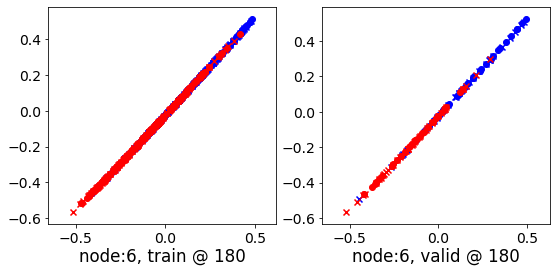

180 	 7 	 0.66251248 	 0.66615891 	 0.91206580 	 0.90333837 	 0.94348907 	 0.93032664


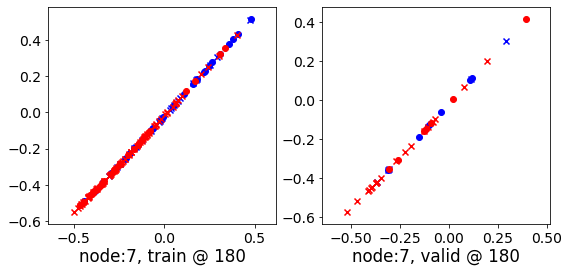

180 	 8 	 0.67485756 	 0.66659915 	 0.93177927 	 0.92719615 	 0.95130432 	 0.95374417


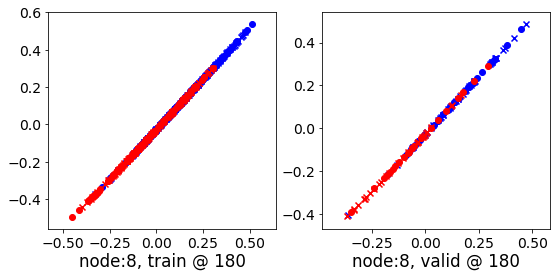

Aggregating on epoch: 182...
Aggregating on epoch: 184...
Aggregating on epoch: 186...
Aggregating on epoch: 188...
Aggregating on epoch: 190...
Aggregating on epoch: 192...
Aggregating on epoch: 194...
Aggregating on epoch: 196...
Aggregating on epoch: 198...
Aggregating on epoch: 200...
200 	 0 	 0.45274115 	 0.44500035 	 0.70227176 	 0.70287251 	 0.95302266 	 0.95101935


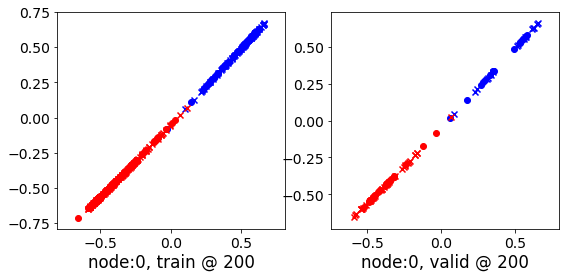

200 	 1 	 0.21228364 	 0.19300479 	 0.42366627 	 0.41495222 	 0.90977156 	 0.91509461


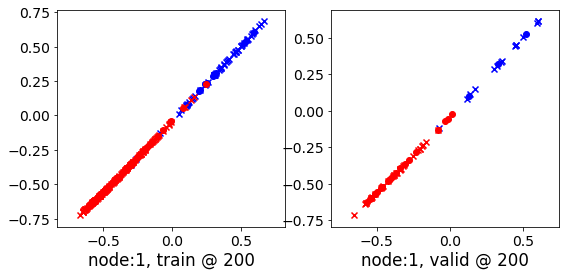

200 	 2 	 0.32989329 	 0.31534553 	 0.55145919 	 0.56449795 	 0.94585443 	 0.94229960


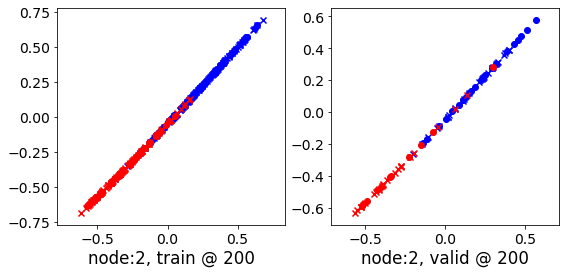

200 	 3 	 0.45014572 	 0.43068743 	 0.63351649 	 0.64131325 	 0.89160162 	 0.90377301


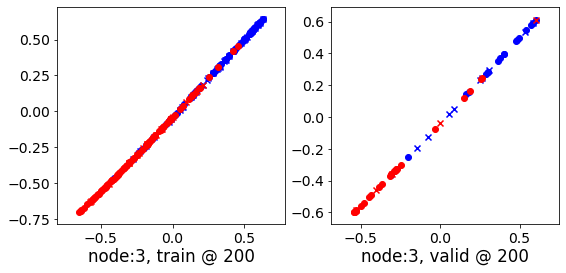

200 	 4 	 0.41197127 	 0.40313250 	 0.63008249 	 0.63074750 	 0.91526353 	 0.92076218


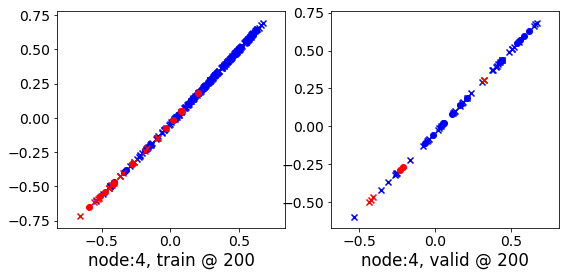

200 	 5 	 0.57598901 	 0.57503647 	 0.82406038 	 0.82369739 	 0.94355112 	 0.94180810


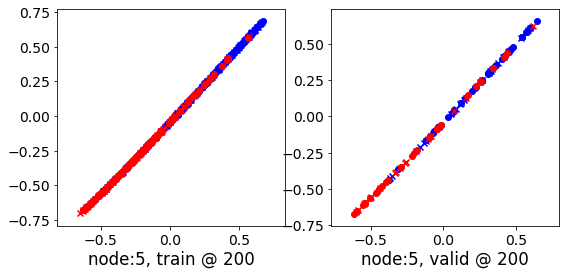

200 	 6 	 0.55462807 	 0.41559035 	 0.81905949 	 0.67704183 	 0.95295727 	 0.95459867


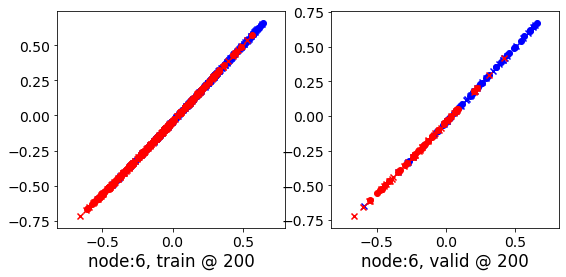

200 	 7 	 0.62454313 	 0.65208977 	 0.86959821 	 0.88153297 	 0.94000417 	 0.92259037


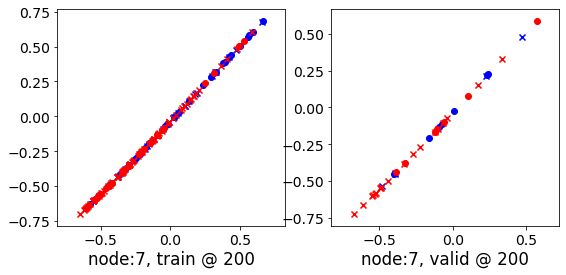

200 	 8 	 0.64061689 	 0.61137462 	 0.89531338 	 0.87744558 	 0.94986975 	 0.95921814


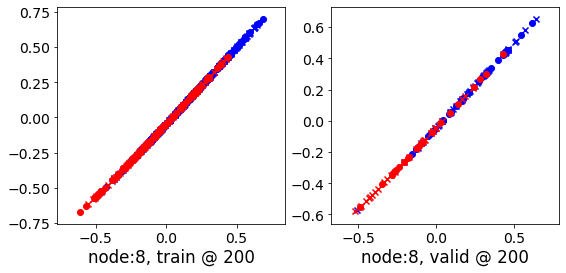

Aggregating on epoch: 202...
Aggregating on epoch: 204...
Aggregating on epoch: 206...
Aggregating on epoch: 208...
Aggregating on epoch: 210...
Aggregating on epoch: 212...
Aggregating on epoch: 214...
Aggregating on epoch: 216...
Aggregating on epoch: 218...
Aggregating on epoch: 220...
220 	 0 	 0.20235077 	 0.19140479 	 0.44556713 	 0.44769958 	 0.95088685 	 0.94944197


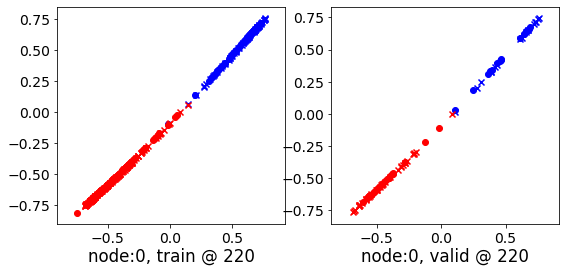

220 	 1 	 0.06833944 	 0.02604172 	 0.27785701 	 0.24921057 	 0.90517199 	 0.91631603


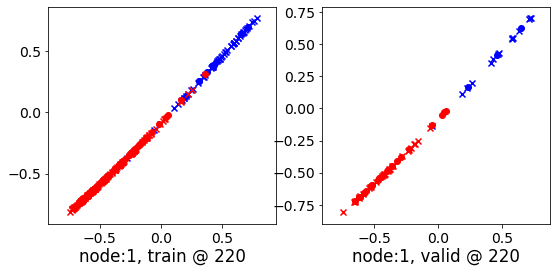

220 	 2 	 0.22382280 	 0.21793008 	 0.42276275 	 0.46597660 	 0.94557536 	 0.94119370


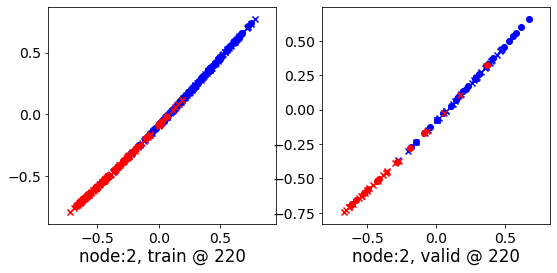

220 	 3 	 0.35505509 	 0.36585367 	 0.52776515 	 0.57504904 	 0.88880777 	 0.90234256


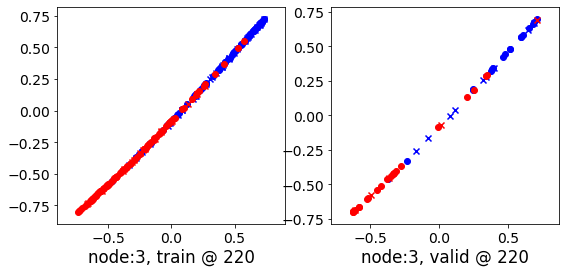

220 	 4 	 0.33099258 	 0.35875440 	 0.54716814 	 0.58622211 	 0.91461730 	 0.92061490


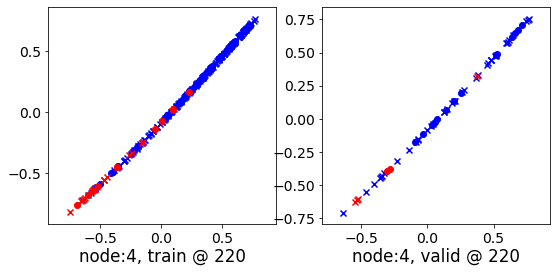

220 	 5 	 0.49331766 	 0.50145972 	 0.74163127 	 0.74909180 	 0.94308668 	 0.94077927


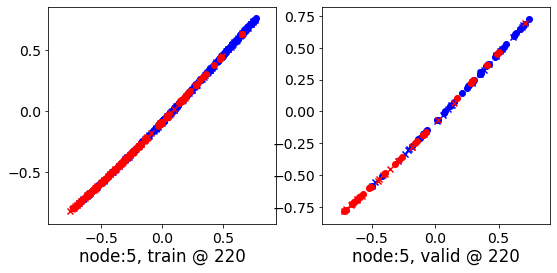

220 	 6 	 0.57532436 	 0.43830615 	 0.80590641 	 0.69966233 	 0.94347203 	 0.95450336


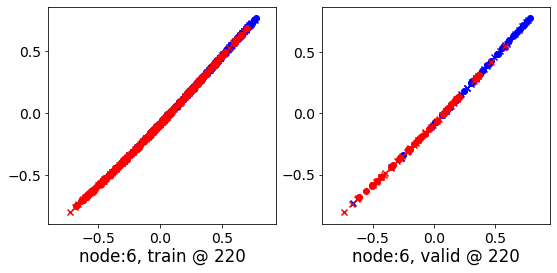

220 	 7 	 0.58810061 	 0.64600170 	 0.82237786 	 0.87309474 	 0.93424946 	 0.92024022


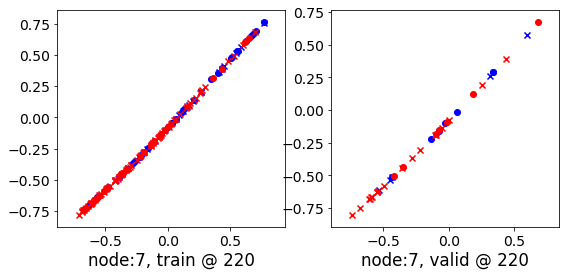

220 	 8 	 0.59064937 	 0.53289598 	 0.84488046 	 0.80319494 	 0.94902229 	 0.96344614


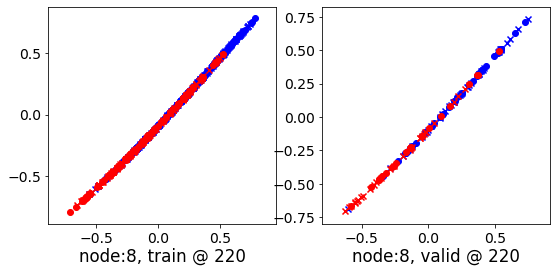

Aggregating on epoch: 222...
Aggregating on epoch: 224...
Aggregating on epoch: 226...
Aggregating on epoch: 228...
Aggregating on epoch: 230...
Aggregating on epoch: 232...
Aggregating on epoch: 234...
Aggregating on epoch: 236...
Aggregating on epoch: 238...
Aggregating on epoch: 240...
240 	 0 	 -0.00300226 	 -0.01243697 	 0.23863664 	 0.24273421 	 0.94897538 	 0.94831836


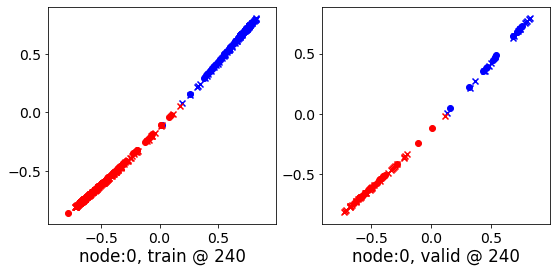

240 	 1 	 0.00649942 	 -0.05368246 	 0.21663842 	 0.17129634 	 0.90537852 	 0.91812599


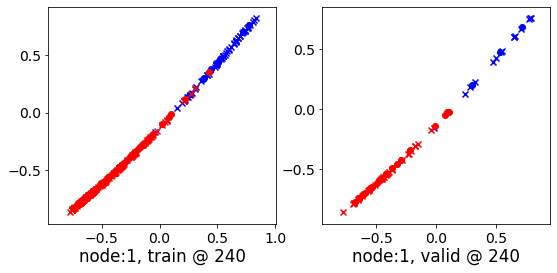

240 	 2 	 0.18355176 	 0.20159814 	 0.38127214 	 0.44758651 	 0.94503695 	 0.93913555


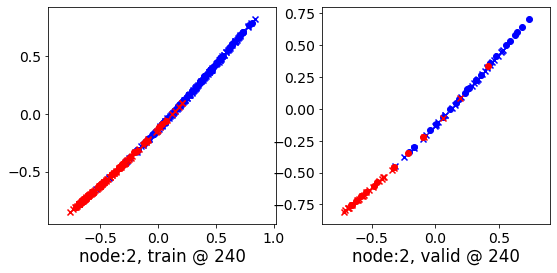

240 	 3 	 0.33124733 	 0.38761204 	 0.50237578 	 0.58958459 	 0.88600278 	 0.89511973


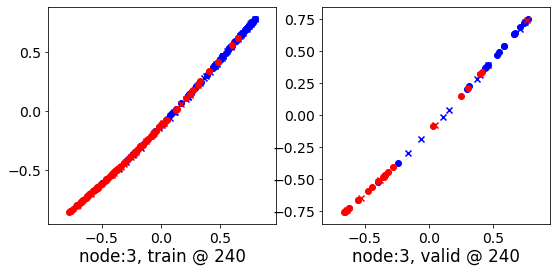

240 	 4 	 0.28466433 	 0.35211414 	 0.49606836 	 0.57648677 	 0.91338015 	 0.91751981


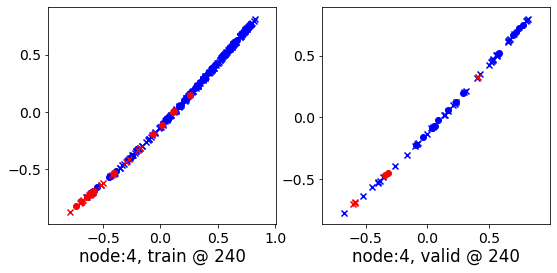

240 	 5 	 0.45035183 	 0.47039449 	 0.69904417 	 0.71652728 	 0.94242102 	 0.93927997


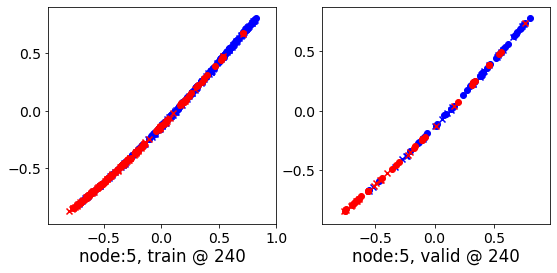

240 	 6 	 0.52629507 	 0.43192101 	 0.79462075 	 0.69319826 	 0.96157950 	 0.95442444


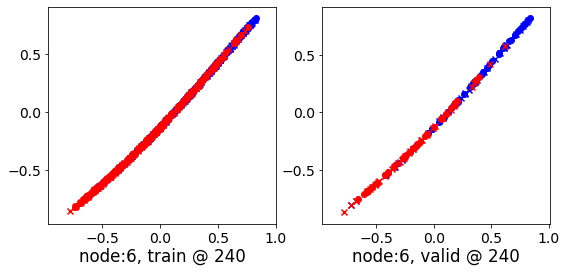

240 	 7 	 0.58060414 	 0.66062331 	 0.80682433 	 0.88728315 	 0.92624944 	 0.91980702


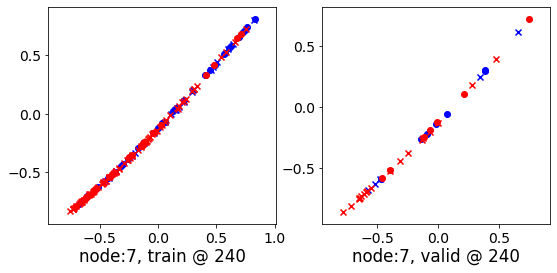

240 	 8 	 0.55608356 	 0.46374780 	 0.80735481 	 0.73602659 	 0.94653928 	 0.96542597


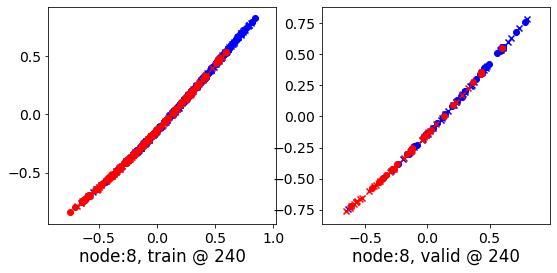

Aggregating on epoch: 242...
Aggregating on epoch: 244...
Aggregating on epoch: 246...
Aggregating on epoch: 248...
Aggregating on epoch: 250...
Aggregating on epoch: 252...
Aggregating on epoch: 254...
Aggregating on epoch: 256...
Aggregating on epoch: 258...
Aggregating on epoch: 260...
260 	 0 	 -0.10279661 	 -0.11303018 	 0.13690194 	 0.14193572 	 0.94794041 	 0.94811308


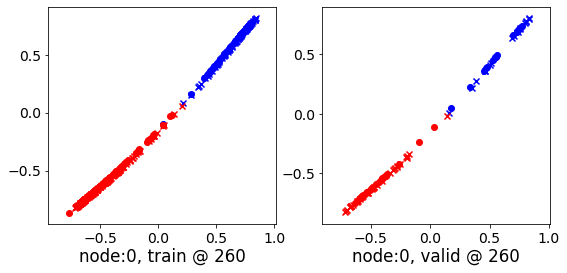

260 	 1 	 -0.01496579 	 -0.08135262 	 0.19533740 	 0.14254114 	 0.90507990 	 0.91704094


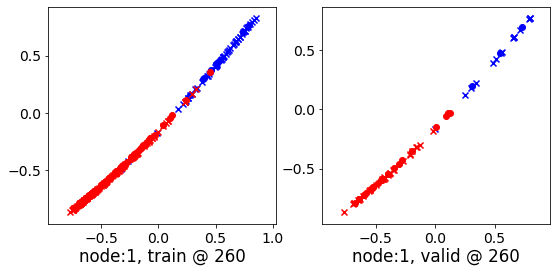

260 	 2 	 0.15047732 	 0.19354567 	 0.36619386 	 0.43705890 	 0.94441056 	 0.93666041


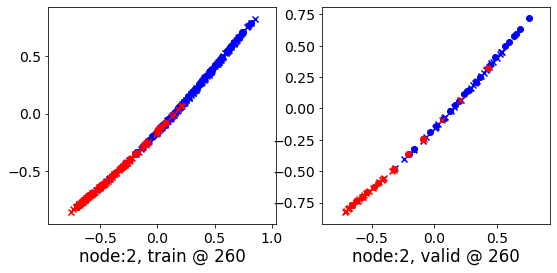

260 	 3 	 0.31881642 	 0.38872385 	 0.49605489 	 0.58703548 	 0.88268119 	 0.89145881


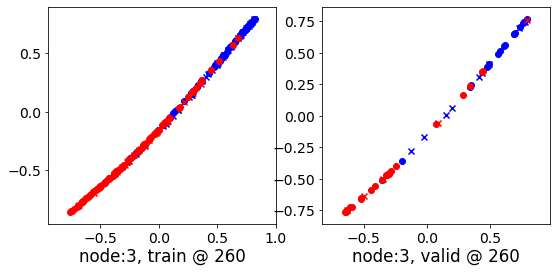

260 	 4 	 0.26785550 	 0.36075085 	 0.47313854 	 0.58168596 	 0.91170382 	 0.91408229


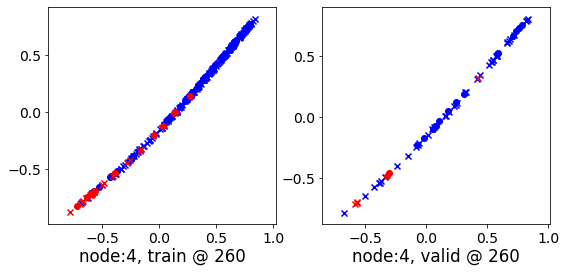

260 	 5 	 0.44726270 	 0.46889412 	 0.69377565 	 0.71338886 	 0.94178569 	 0.93764192


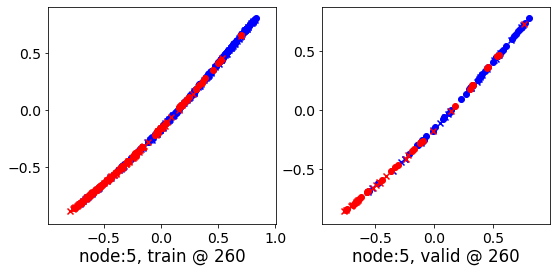

260 	 6 	 0.50409597 	 0.43243271 	 0.76642257 	 0.69236767 	 0.95527434 	 0.95308214


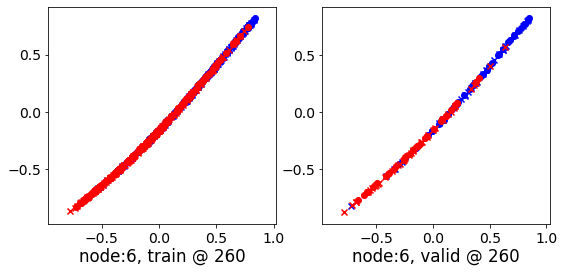

260 	 7 	 0.58107537 	 0.65815759 	 0.80474049 	 0.88785684 	 0.92096889 	 0.92284644


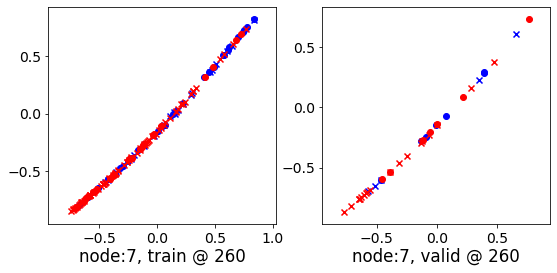

260 	 8 	 0.55892825 	 0.43289685 	 0.79719651 	 0.71236187 	 0.94488466 	 0.97261220


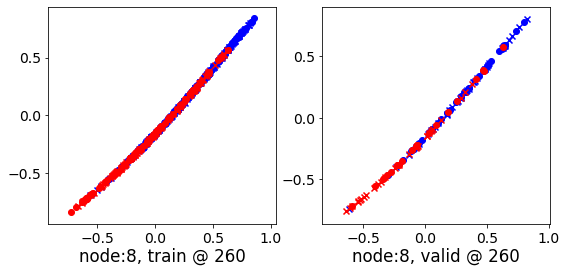

Aggregating on epoch: 262...
Aggregating on epoch: 264...
Aggregating on epoch: 266...
Aggregating on epoch: 268...
Aggregating on epoch: 270...
Aggregating on epoch: 272...
Aggregating on epoch: 274...
Aggregating on epoch: 276...
Aggregating on epoch: 278...
Aggregating on epoch: 280...
280 	 0 	 -0.15390377 	 -0.15761748 	 0.08850732 	 0.09592686 	 0.94595462 	 0.94669151


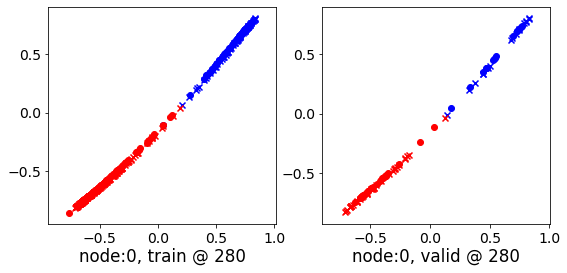

280 	 1 	 -0.02017091 	 -0.09277497 	 0.18661931 	 0.13171048 	 0.90567285 	 0.91763264


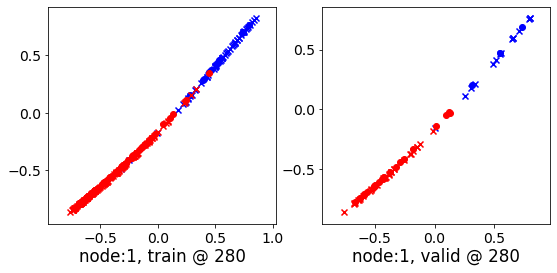

280 	 2 	 0.14471141 	 0.19646060 	 0.36263564 	 0.43668008 	 0.94346184 	 0.93336666


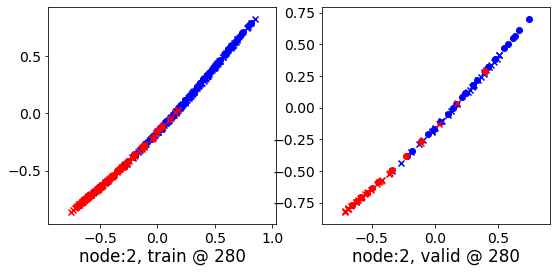

280 	 3 	 0.30740860 	 0.38509703 	 0.49277598 	 0.58203137 	 0.88161105 	 0.89008152


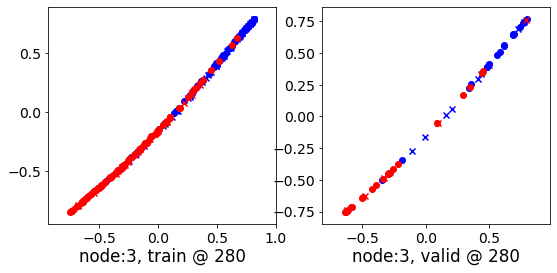

280 	 4 	 0.25227630 	 0.36965996 	 0.46171948 	 0.58824790 	 0.91104066 	 0.91173512


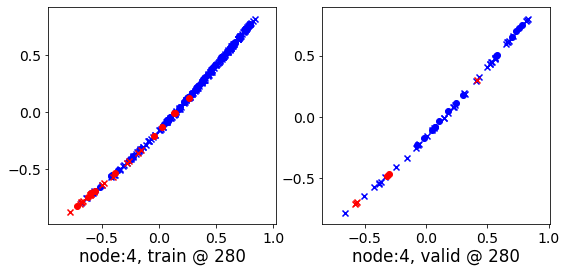

280 	 5 	 0.45367754 	 0.47267151 	 0.69394302 	 0.71563804 	 0.94117492 	 0.93611372


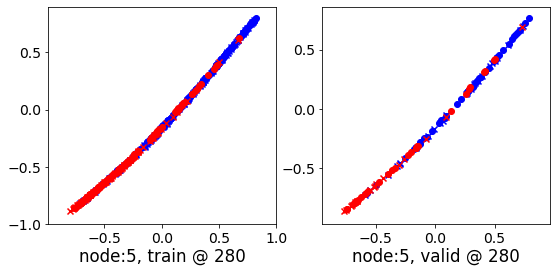

280 	 6 	 0.45039076 	 0.43039215 	 0.70351630 	 0.69053495 	 0.94600278 	 0.95328999


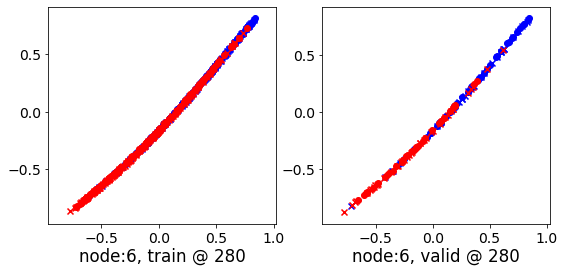

280 	 7 	 0.58178806 	 0.65055072 	 0.80311030 	 0.88391644 	 0.91790229 	 0.92651290


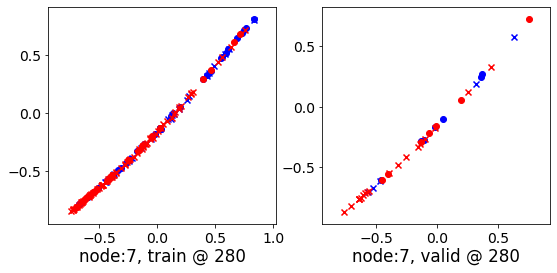

280 	 8 	 0.56187725 	 0.42098308 	 0.79693067 	 0.70752358 	 0.94494569 	 0.97968769


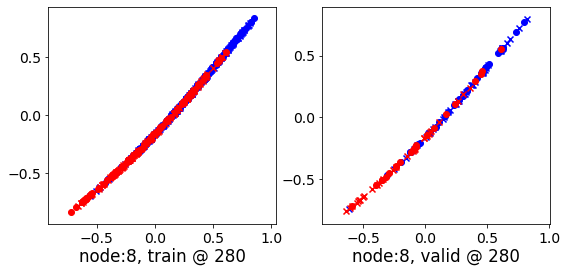

Aggregating on epoch: 282...
Aggregating on epoch: 284...
Aggregating on epoch: 286...
Aggregating on epoch: 288...
Aggregating on epoch: 290...
Aggregating on epoch: 292...
Aggregating on epoch: 294...
Aggregating on epoch: 296...
Aggregating on epoch: 298...
Aggregating on epoch: 300...
300 	 0 	 -0.17672935 	 -0.17970240 	 0.06649019 	 0.07328766 	 0.94470859 	 0.94613725


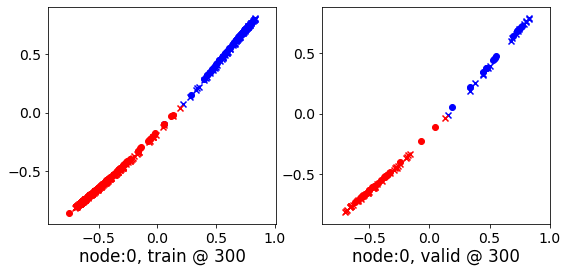

300 	 1 	 -0.01818171 	 -0.09711701 	 0.18213512 	 0.12722445 	 0.90554917 	 0.91748863


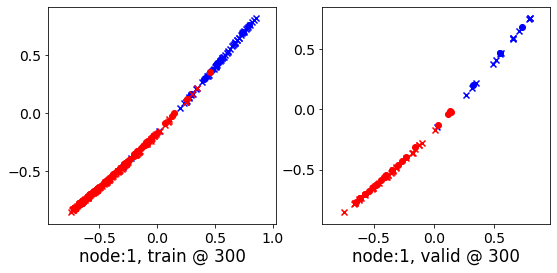

300 	 2 	 0.12520510 	 0.19101015 	 0.35339883 	 0.42922410 	 0.94267178 	 0.93136114


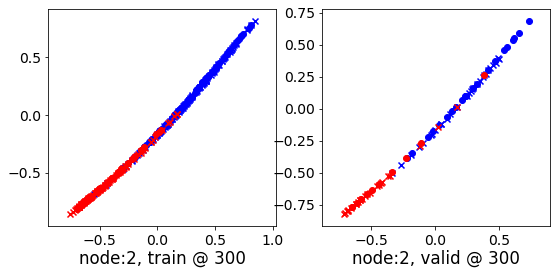

300 	 3 	 0.30534419 	 0.38436288 	 0.49121273 	 0.58015907 	 0.88047200 	 0.88894337


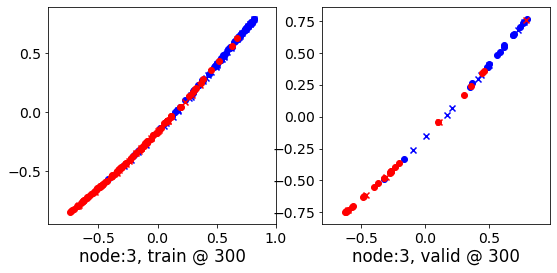

300 	 4 	 0.24578974 	 0.37685120 	 0.45556271 	 0.59338832 	 0.91063046 	 0.90968430


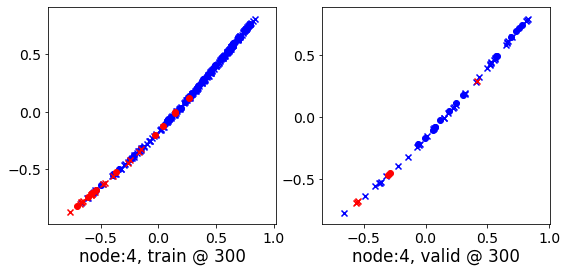

300 	 5 	 0.46126646 	 0.47216821 	 0.69432628 	 0.71334869 	 0.94054675 	 0.93432766


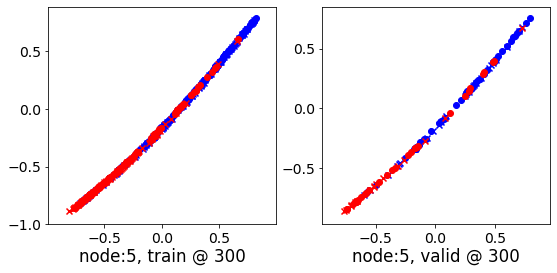

300 	 6 	 0.45348275 	 0.43583173 	 0.71278441 	 0.69493568 	 0.95422059 	 0.95225114


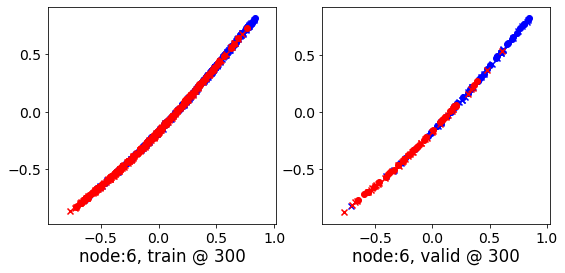

300 	 7 	 0.58014953 	 0.64476120 	 0.80121845 	 0.88243407 	 0.91625446 	 0.93082005


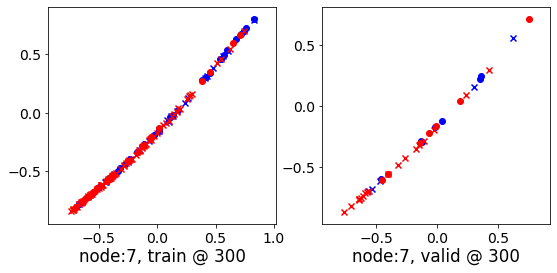

300 	 8 	 0.54976523 	 0.41714144 	 0.79265845 	 0.70398605 	 0.94421804 	 0.97999179


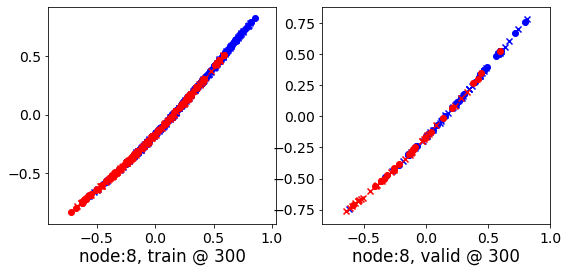

Aggregating on epoch: 302...
Aggregating on epoch: 304...
Aggregating on epoch: 306...
Aggregating on epoch: 308...
Aggregating on epoch: 310...
Aggregating on epoch: 312...
Aggregating on epoch: 314...
Aggregating on epoch: 316...
Aggregating on epoch: 318...
Aggregating on epoch: 320...
320 	 0 	 -0.18906739 	 -0.19225273 	 0.05501345 	 0.06078174 	 0.94431424 	 0.94618165


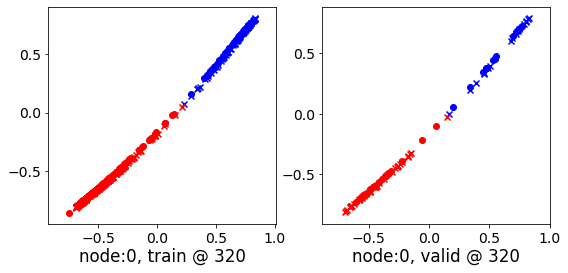

320 	 1 	 -0.01239732 	 -0.09778208 	 0.17961474 	 0.12610310 	 0.90502065 	 0.91703236


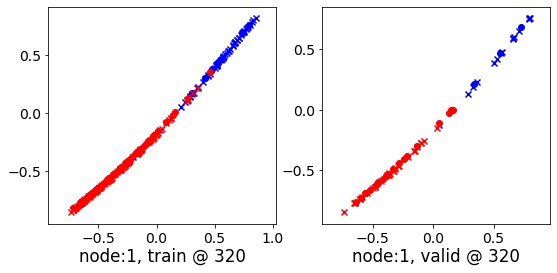

320 	 2 	 0.11148819 	 0.18823844 	 0.34715113 	 0.42481178 	 0.94195294 	 0.92972052


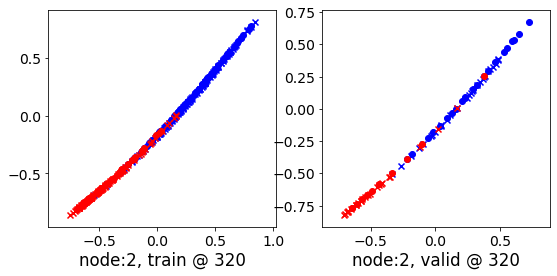

320 	 3 	 0.30398479 	 0.38454729 	 0.48938054 	 0.57866275 	 0.87942171 	 0.88726264


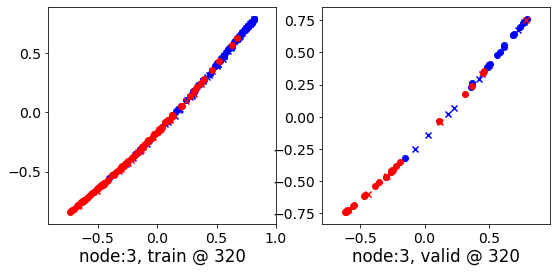

320 	 4 	 0.24309546 	 0.38327086 	 0.45109266 	 0.59839272 	 0.91034639 	 0.90826905


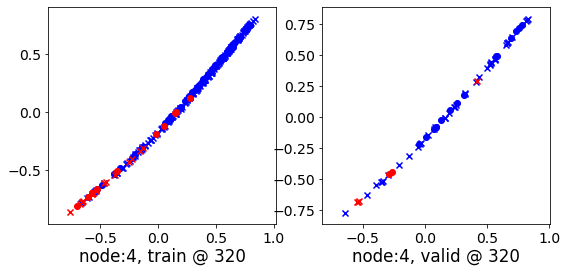

320 	 5 	 0.46184307 	 0.46972042 	 0.69491613 	 0.70979339 	 0.94009000 	 0.93322015


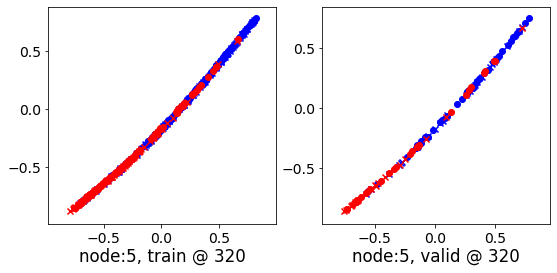

320 	 6 	 0.52723420 	 0.43400747 	 0.78683680 	 0.69183326 	 0.95559919 	 0.95097297


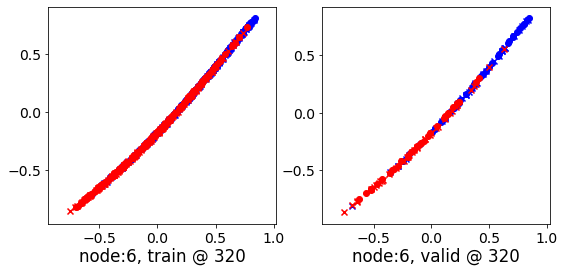

320 	 7 	 0.57832235 	 0.63760853 	 0.79955184 	 0.87964040 	 0.91527629 	 0.93517905


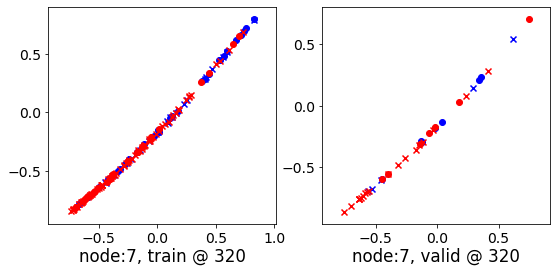

320 	 8 	 0.54133362 	 0.41423637 	 0.78930688 	 0.70134699 	 0.94382691 	 0.98025781


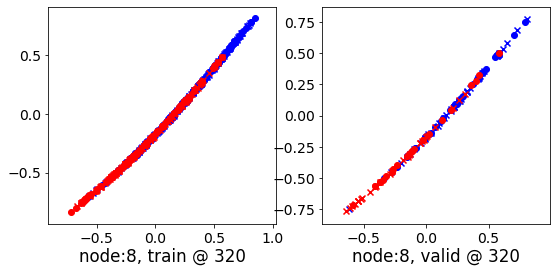

Aggregating on epoch: 322...
Aggregating on epoch: 324...
Aggregating on epoch: 326...
Aggregating on epoch: 328...
Aggregating on epoch: 330...
Aggregating on epoch: 332...
Aggregating on epoch: 334...
Aggregating on epoch: 336...
Aggregating on epoch: 338...
Aggregating on epoch: 340...
340 	 0 	 -0.19761810 	 -0.19862536 	 0.04735376 	 0.05356100 	 0.94389427 	 0.94533354


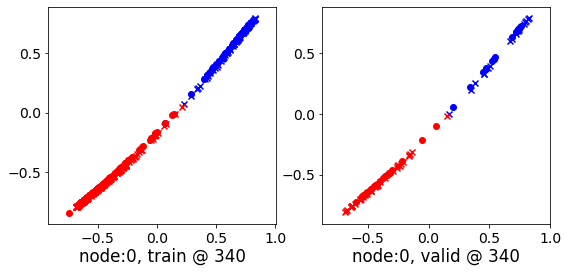

340 	 1 	 -0.00676854 	 -0.09517679 	 0.17898546 	 0.12813893 	 0.90481693 	 0.91646290


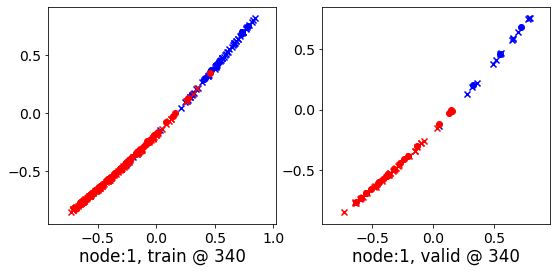

340 	 2 	 0.10642943 	 0.18878388 	 0.34424439 	 0.42387068 	 0.94128346 	 0.92823398


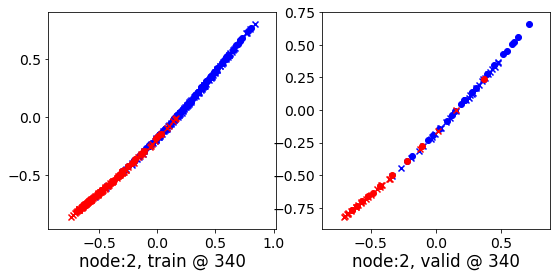

340 	 3 	 0.30223101 	 0.38346124 	 0.48728713 	 0.57753181 	 0.87851548 	 0.88721776


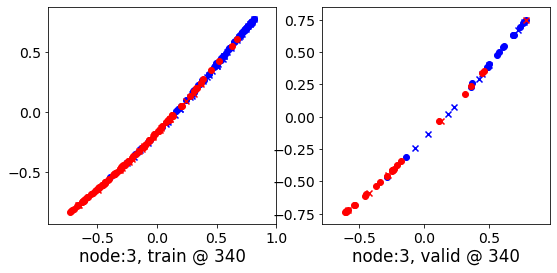

340 	 4 	 0.23919496 	 0.38599789 	 0.44619107 	 0.60078919 	 0.91007274 	 0.90793848


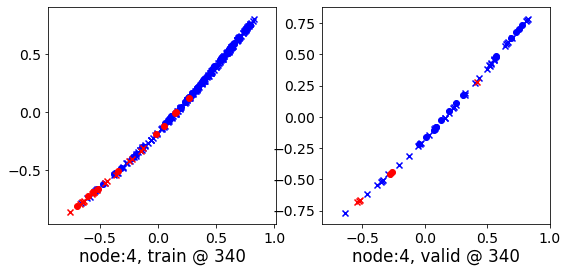

340 	 5 	 0.45672572 	 0.46572322 	 0.69392031 	 0.70524377 	 0.93980491 	 0.93266773


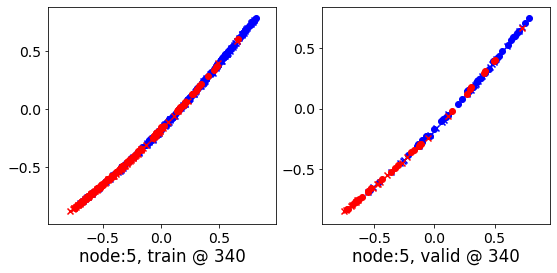

340 	 6 	 0.52010953 	 0.43100834 	 0.78124195 	 0.68965077 	 0.95449394 	 0.95178962


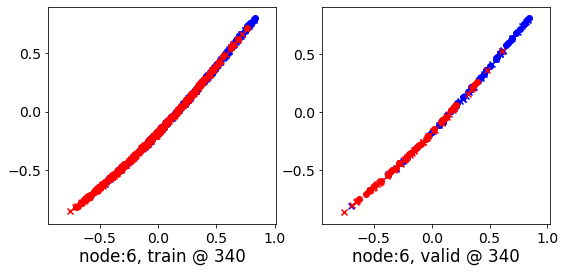

340 	 7 	 0.57737023 	 0.63228452 	 0.79836708 	 0.87879032 	 0.91460341 	 0.93965298


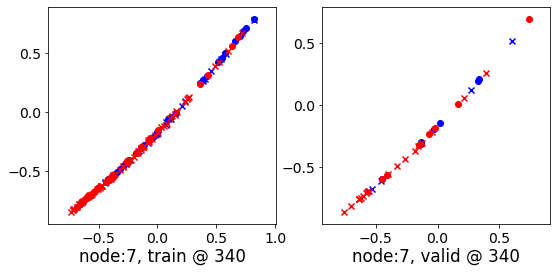

340 	 8 	 0.53769135 	 0.41213185 	 0.78744745 	 0.69966340 	 0.94363981 	 0.98067874


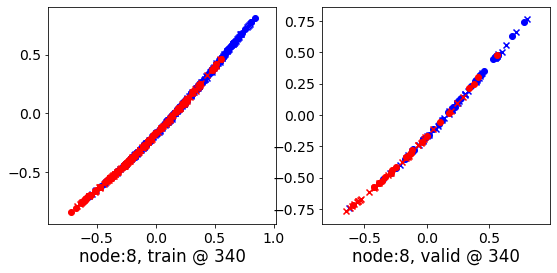

Aggregating on epoch: 342...
Aggregating on epoch: 344...
Aggregating on epoch: 346...
Aggregating on epoch: 348...
Aggregating on epoch: 350...
Aggregating on epoch: 352...
Aggregating on epoch: 354...
Aggregating on epoch: 356...
Aggregating on epoch: 358...
Aggregating on epoch: 360...
360 	 0 	 -0.20614935 	 -0.20109126 	 0.04072402 	 0.04969332 	 0.94347590 	 0.94393176


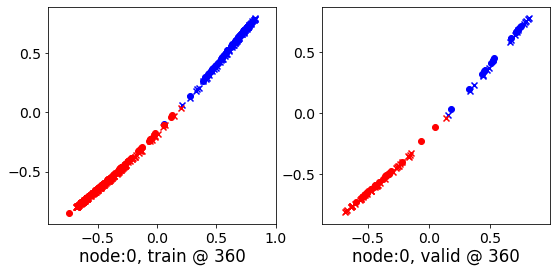

360 	 1 	 0.00032544 	 -0.08866833 	 0.18152937 	 0.13389261 	 0.90497297 	 0.91570812


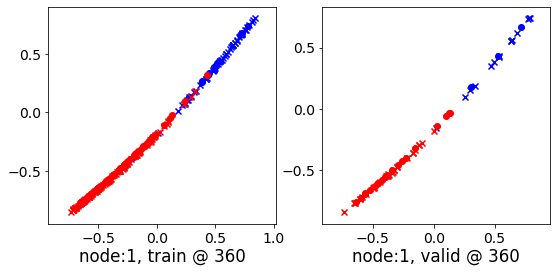

360 	 2 	 0.10999835 	 0.19520324 	 0.34512469 	 0.42926198 	 0.94071233 	 0.92720592


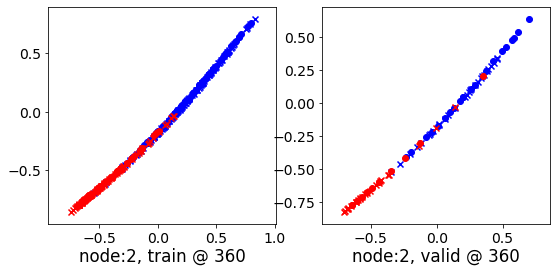

360 	 3 	 0.30134431 	 0.37931406 	 0.48604435 	 0.57587177 	 0.87788141 	 0.88970488


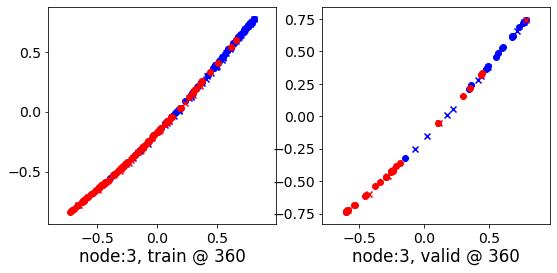

360 	 4 	 0.23210096 	 0.38890547 	 0.44128147 	 0.60472912 	 0.90974098 	 0.90897083


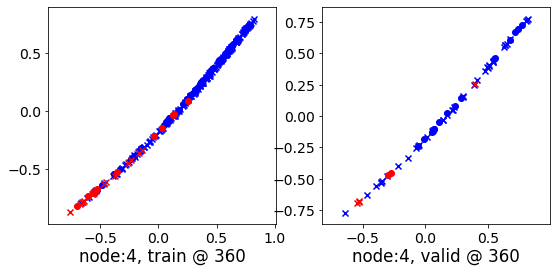

360 	 5 	 0.45046830 	 0.46319550 	 0.69184977 	 0.70263439 	 0.93942255 	 0.93258607


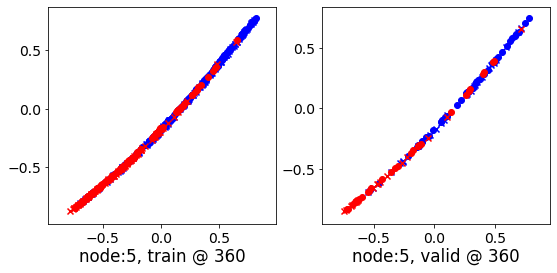

360 	 6 	 0.55123073 	 0.43403476 	 0.81241643 	 0.69226170 	 0.95799249 	 0.95137411


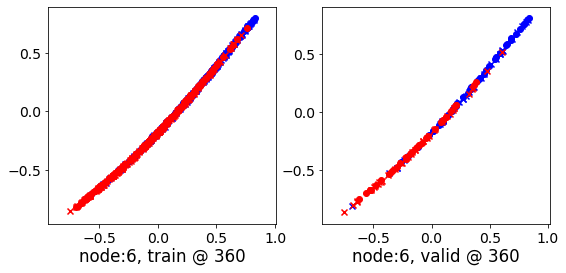

360 	 7 	 0.57721877 	 0.63179249 	 0.79772854 	 0.88175434 	 0.91431767 	 0.94310904


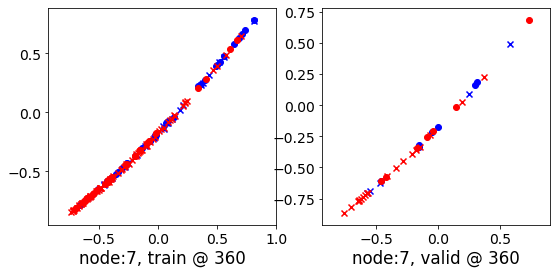

360 	 8 	 0.53593040 	 0.41125053 	 0.78627586 	 0.69987285 	 0.94387275 	 0.98176950


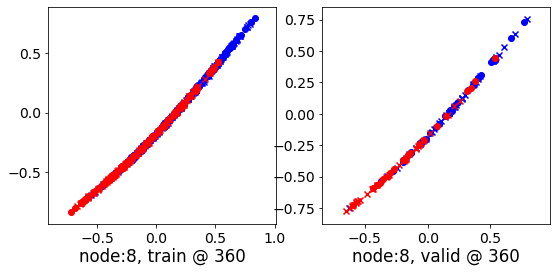

Aggregating on epoch: 362...
Aggregating on epoch: 364...
Aggregating on epoch: 366...
Aggregating on epoch: 368...
Aggregating on epoch: 370...
Aggregating on epoch: 372...
Aggregating on epoch: 374...
Aggregating on epoch: 376...
Aggregating on epoch: 378...
Aggregating on epoch: 380...
380 	 0 	 -0.21015069 	 -0.20531586 	 0.03766153 	 0.04576371 	 0.94345939 	 0.94422674


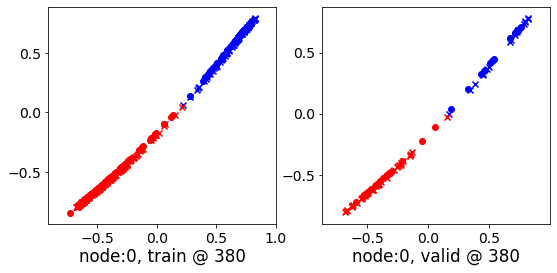

380 	 1 	 -0.00876848 	 -0.09138379 	 0.17853339 	 0.13052759 	 0.90470380 	 0.91505855


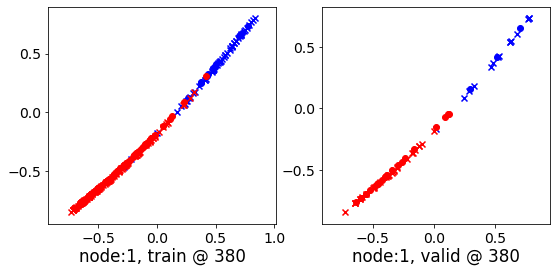

380 	 2 	 0.10304236 	 0.19267592 	 0.34114155 	 0.42655215 	 0.94028151 	 0.92702341


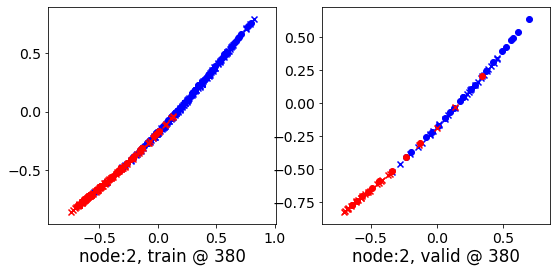

380 	 3 	 0.30101737 	 0.38173211 	 0.48446780 	 0.57634211 	 0.87681466 	 0.88775718


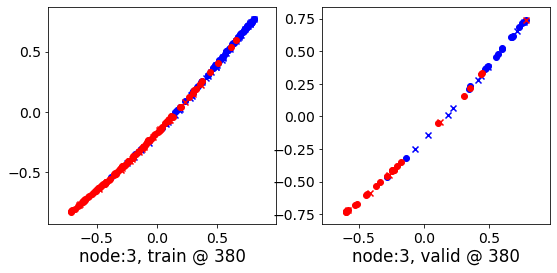

380 	 4 	 0.23219374 	 0.40056133 	 0.43823034 	 0.61626160 	 0.90949315 	 0.90884745


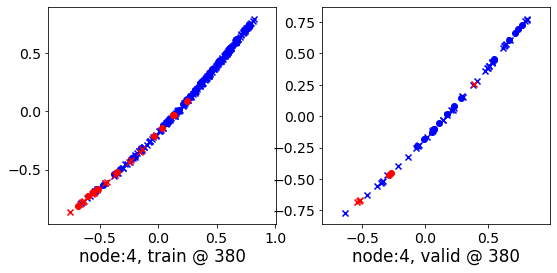

380 	 5 	 0.45038193 	 0.46417254 	 0.69194049 	 0.70378762 	 0.93900597 	 0.93276227


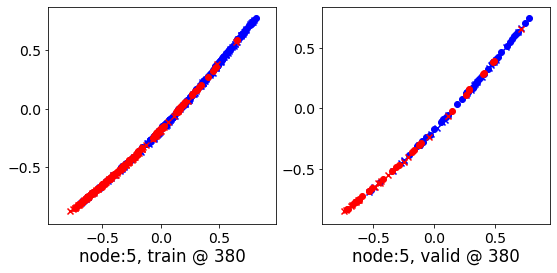

380 	 6 	 0.53637457 	 0.43247980 	 0.79349369 	 0.69030064 	 0.95178223 	 0.95096803


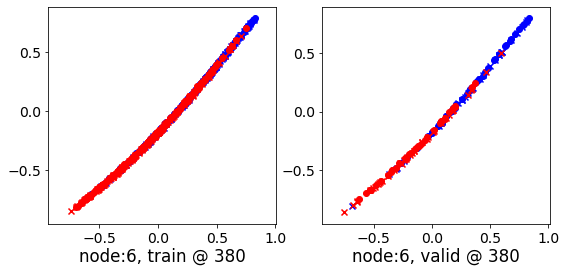

380 	 7 	 0.57664299 	 0.62993962 	 0.79673648 	 0.87977940 	 0.91375369 	 0.94298697


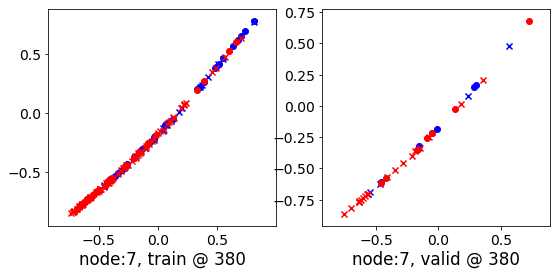

380 	 8 	 0.53413212 	 0.40953022 	 0.78439045 	 0.69780344 	 0.94345498 	 0.98142040


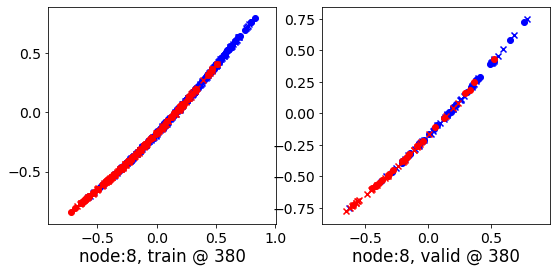

Aggregating on epoch: 382...
Aggregating on epoch: 384...
Aggregating on epoch: 386...
Aggregating on epoch: 388...
Aggregating on epoch: 390...
Aggregating on epoch: 392...
Aggregating on epoch: 394...
Aggregating on epoch: 396...
Aggregating on epoch: 398...
Aggregating on epoch: 400...
400 	 0 	 -0.21368761 	 -0.20657611 	 0.03456743 	 0.04389166 	 0.94321632 	 0.94361496


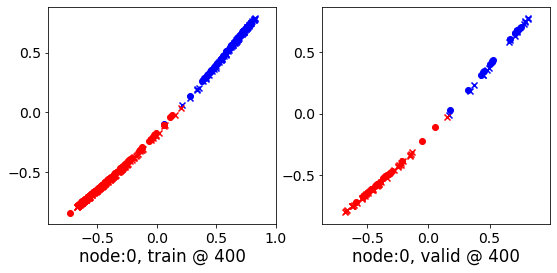

400 	 1 	 -0.01268663 	 -0.08878613 	 0.17913985 	 0.13271910 	 0.90520573 	 0.91465241


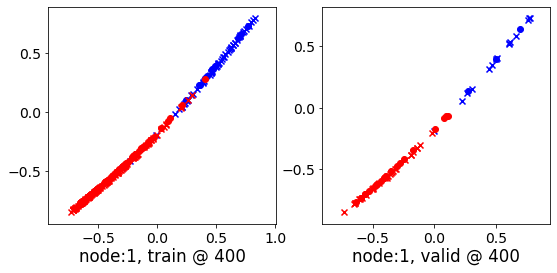

400 	 2 	 0.10313696 	 0.19403303 	 0.34043479 	 0.42777401 	 0.93980891 	 0.92688817


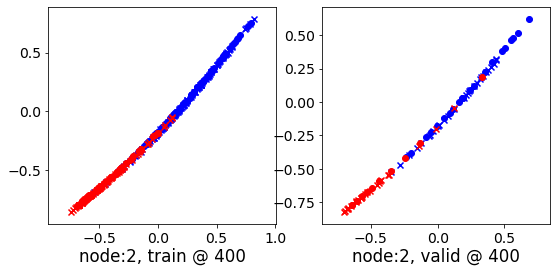

400 	 3 	 0.30156627 	 0.38009757 	 0.48384875 	 0.57542610 	 0.87631238 	 0.88847572


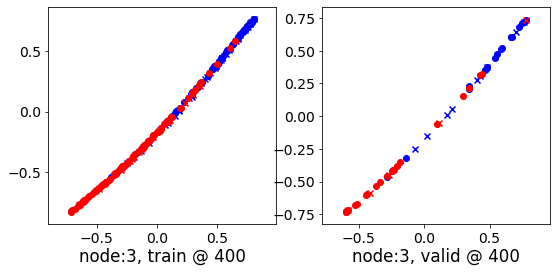

400 	 4 	 0.23045465 	 0.40836650 	 0.43517247 	 0.62442923 	 0.90940446 	 0.90920991


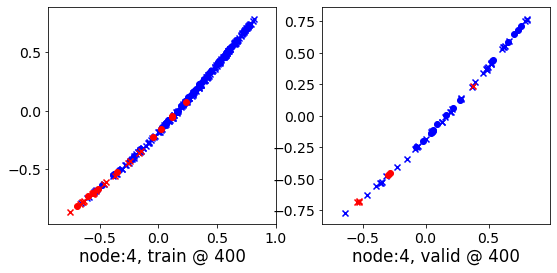

400 	 5 	 0.44908923 	 0.46420836 	 0.69115239 	 0.70387357 	 0.93840134 	 0.93281239


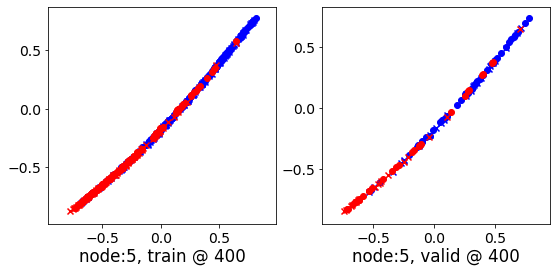

400 	 6 	 0.54746842 	 0.43785393 	 0.80021715 	 0.69594115 	 0.94887197 	 0.95123440


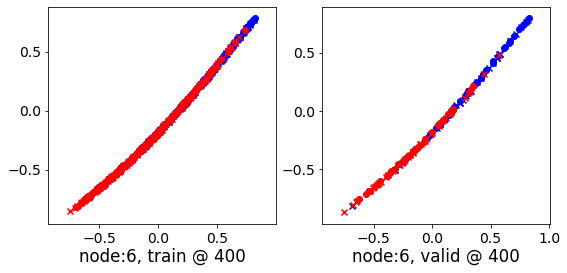

400 	 7 	 0.57651472 	 0.62868130 	 0.79598808 	 0.88130832 	 0.91322255 	 0.94577420


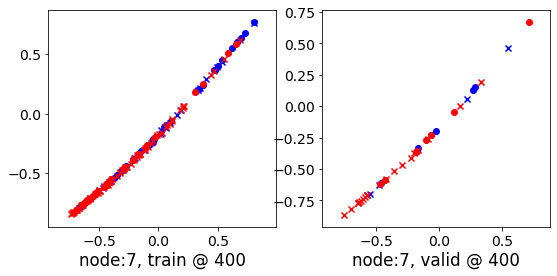

400 	 8 	 0.53318256 	 0.40860224 	 0.78298801 	 0.69757307 	 0.94327837 	 0.98211801


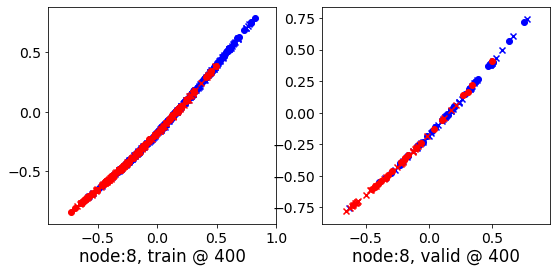

Aggregating on epoch: 402...
Aggregating on epoch: 404...
Aggregating on epoch: 406...
Aggregating on epoch: 408...
Aggregating on epoch: 410...
Aggregating on epoch: 412...
Aggregating on epoch: 414...
Aggregating on epoch: 416...
Aggregating on epoch: 418...
Aggregating on epoch: 420...
420 	 0 	 -0.21703503 	 -0.20866096 	 0.03216209 	 0.04237343 	 0.94384527 	 0.94418156


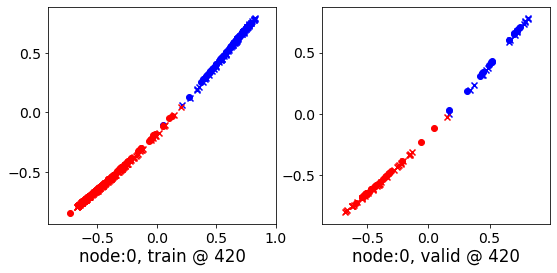

420 	 1 	 -0.01486452 	 -0.08922702 	 0.17830099 	 0.13140613 	 0.90508580 	 0.91378033


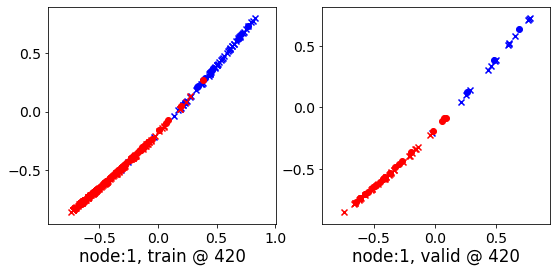

420 	 2 	 0.10570580 	 0.19653749 	 0.34053525 	 0.43039083 	 0.93949759 	 0.92700052


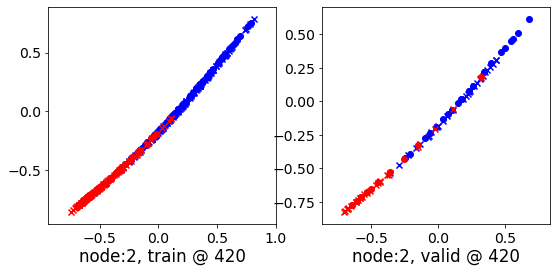

420 	 3 	 0.30287892 	 0.38165498 	 0.48316258 	 0.57657957 	 0.87551445 	 0.88807178


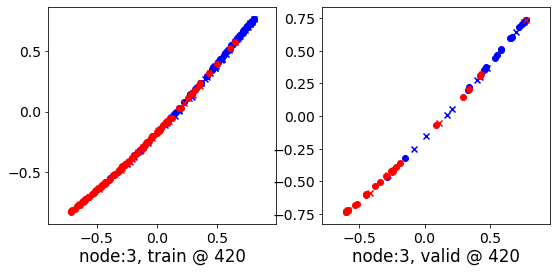

420 	 4 	 0.22878161 	 0.42186856 	 0.43331656 	 0.63786131 	 0.90909755 	 0.90913993


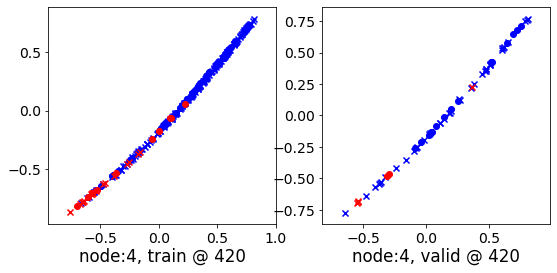

420 	 5 	 0.44792086 	 0.46541923 	 0.69053090 	 0.70547682 	 0.93789423 	 0.93320477


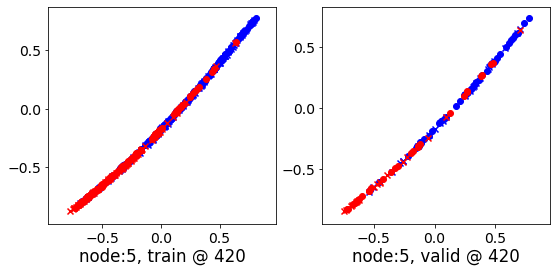

420 	 6 	 0.55470920 	 0.42909884 	 0.81208313 	 0.68646795 	 0.95126700 	 0.95051628


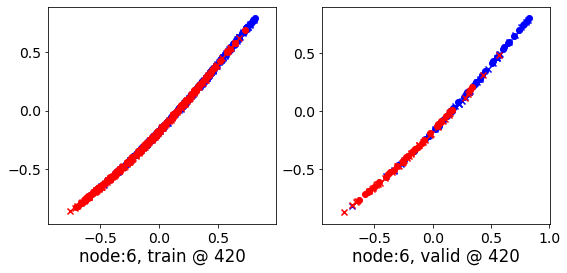

420 	 7 	 0.57675159 	 0.62510341 	 0.79573053 	 0.87985212 	 0.91278857 	 0.94789588


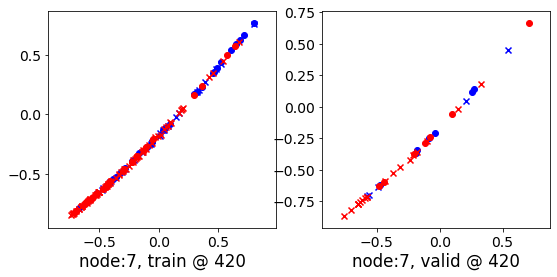

420 	 8 	 0.53235680 	 0.40818036 	 0.78186667 	 0.69638312 	 0.94331807 	 0.98134995


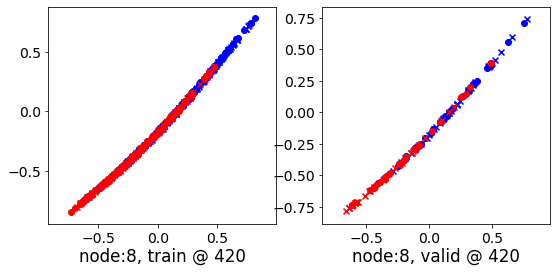

Aggregating on epoch: 422...
Aggregating on epoch: 424...
Aggregating on epoch: 426...
Aggregating on epoch: 428...
Aggregating on epoch: 430...
Aggregating on epoch: 432...
Aggregating on epoch: 434...
Aggregating on epoch: 436...
Aggregating on epoch: 438...
Aggregating on epoch: 440...
440 	 0 	 -0.21889482 	 -0.21090092 	 0.03089684 	 0.04012481 	 0.94443971 	 0.94417292


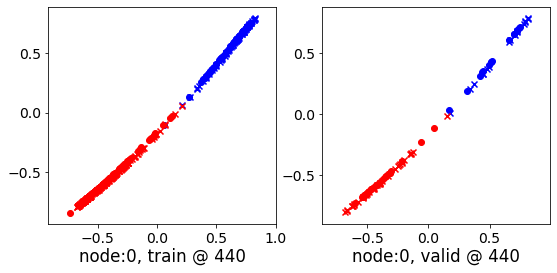

440 	 1 	 -0.02229033 	 -0.09218900 	 0.17643176 	 0.12807675 	 0.90485281 	 0.91341293


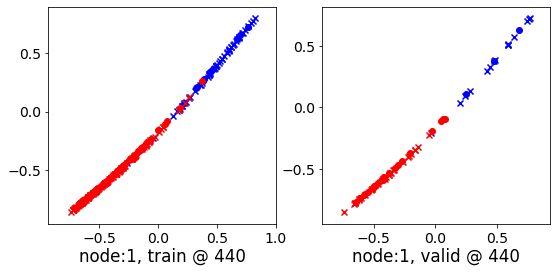

440 	 2 	 0.10012311 	 0.19586977 	 0.33861655 	 0.43003336 	 0.93911374 	 0.92731076


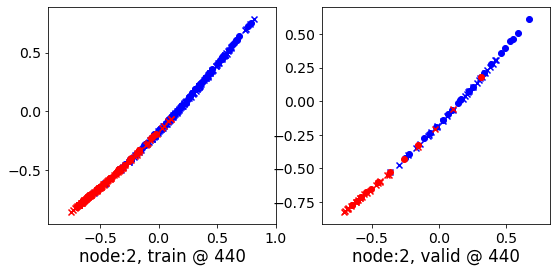

440 	 3 	 0.30279550 	 0.37967223 	 0.48219982 	 0.57413238 	 0.87480867 	 0.88760734


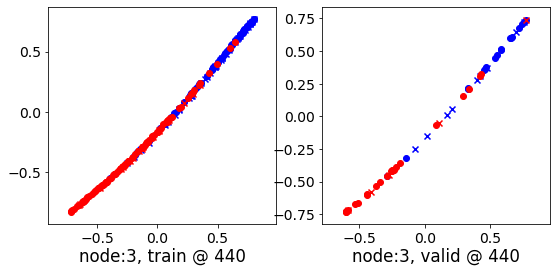

440 	 4 	 0.23205459 	 0.43522149 	 0.43285275 	 0.65047687 	 0.90889865 	 0.90840256


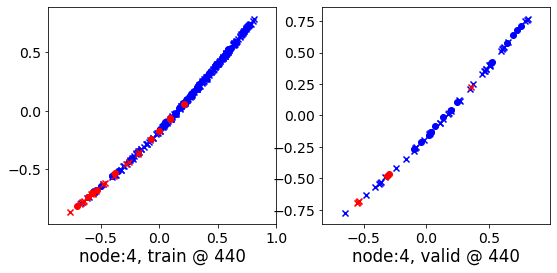

440 	 5 	 0.44883019 	 0.46624637 	 0.69078344 	 0.70673692 	 0.93739450 	 0.93363774


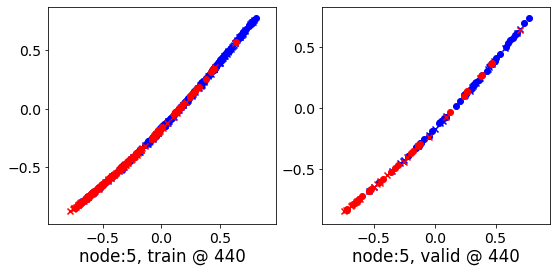

440 	 6 	 0.51779580 	 0.42999917 	 0.77884817 	 0.68748695 	 0.95451903 	 0.95063496


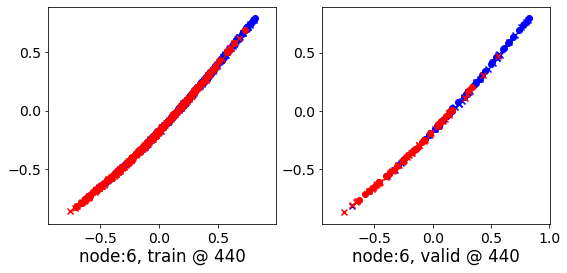

440 	 7 	 0.57715881 	 0.62510395 	 0.79541618 	 0.87972492 	 0.91225034 	 0.94776815


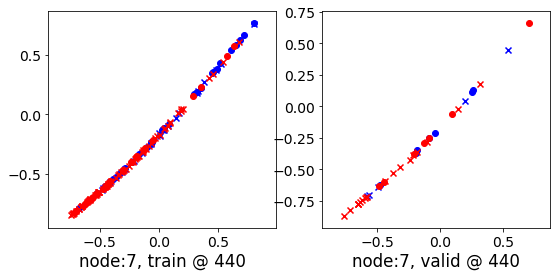

440 	 8 	 0.53378046 	 0.40986896 	 0.78113824 	 0.69653481 	 0.94336903 	 0.97981304


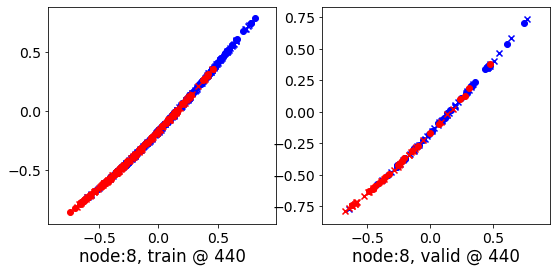

Aggregating on epoch: 442...
Aggregating on epoch: 444...
Aggregating on epoch: 446...
Aggregating on epoch: 448...
Aggregating on epoch: 450...
Aggregating on epoch: 452...
Aggregating on epoch: 454...
Aggregating on epoch: 456...
Aggregating on epoch: 458...
Aggregating on epoch: 460...
460 	 0 	 -0.21910435 	 -0.20901114 	 0.02899895 	 0.04108446 	 0.94384265 	 0.94324279


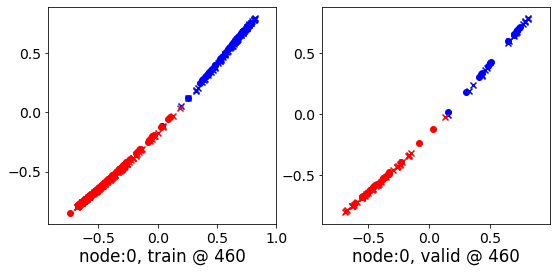

460 	 1 	 -0.01951693 	 -0.08854251 	 0.17846408 	 0.13171370 	 0.90554827 	 0.91340339


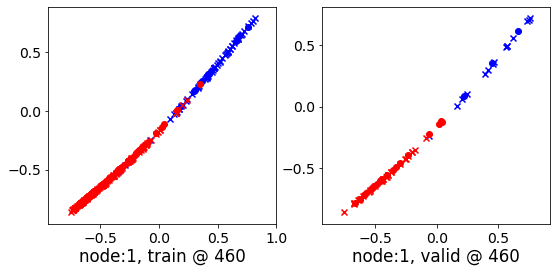

460 	 2 	 0.10387400 	 0.20122135 	 0.33966810 	 0.43520665 	 0.93869871 	 0.92713249


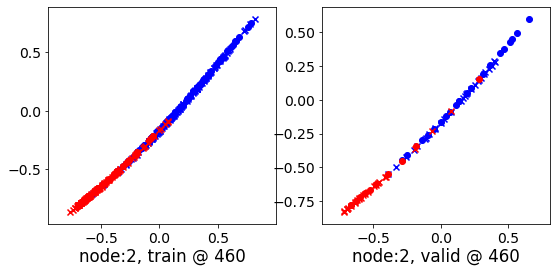

460 	 3 	 0.30555603 	 0.38020480 	 0.48310703 	 0.57666129 	 0.87504107 	 0.88960367


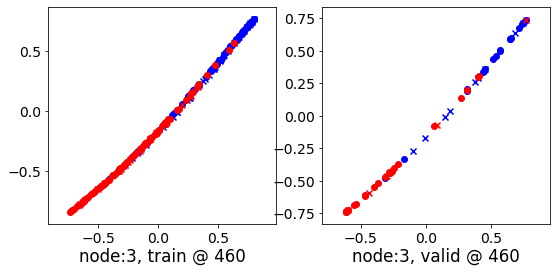

460 	 4 	 0.22614834 	 0.44078654 	 0.43081063 	 0.65649039 	 0.90881550 	 0.90885103


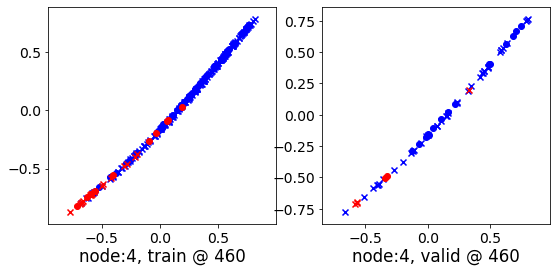

460 	 5 	 0.44752449 	 0.46705854 	 0.68999708 	 0.70704901 	 0.93678075 	 0.93313766


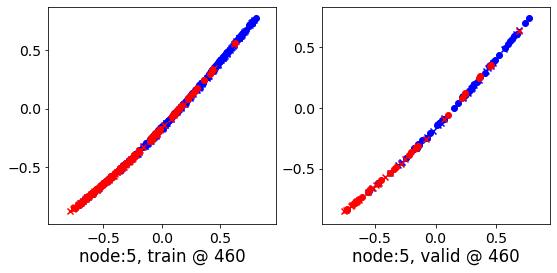

460 	 6 	 0.44880813 	 0.42980295 	 0.70937902 	 0.68722421 	 0.95489609 	 0.95056844


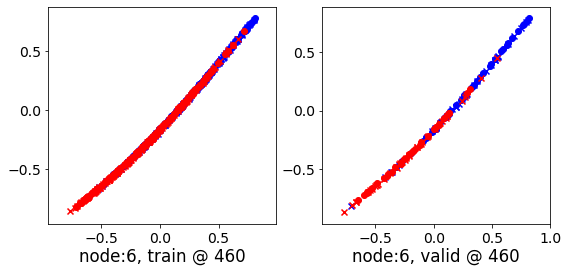

460 	 7 	 0.57711291 	 0.63015348 	 0.79508549 	 0.88264465 	 0.91188633 	 0.94563836


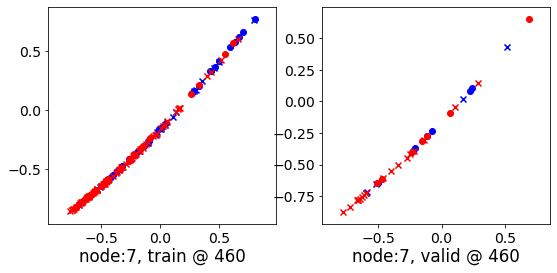

460 	 8 	 0.53370076 	 0.41055530 	 0.77980971 	 0.69680244 	 0.94356996 	 0.97939432


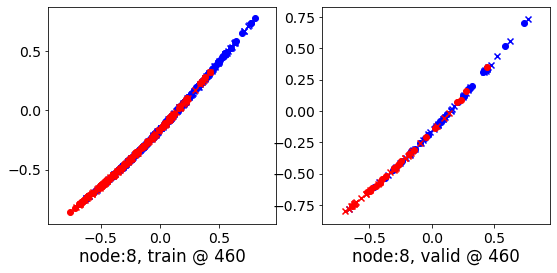

Aggregating on epoch: 462...
Aggregating on epoch: 464...
Aggregating on epoch: 466...
Aggregating on epoch: 468...
Aggregating on epoch: 470...
Aggregating on epoch: 472...
Aggregating on epoch: 474...
Aggregating on epoch: 476...
Aggregating on epoch: 478...
Aggregating on epoch: 480...
480 	 0 	 -0.21916062 	 -0.20893504 	 0.02800358 	 0.04061179 	 0.94377345 	 0.94269401


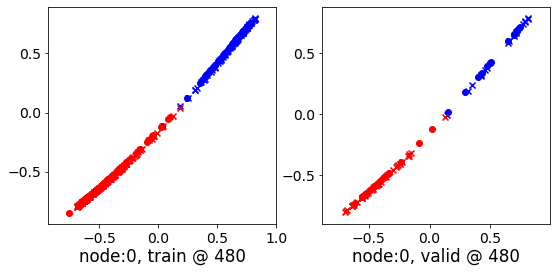

480 	 1 	 -0.02252303 	 -0.08971760 	 0.17800511 	 0.13062385 	 0.90574217 	 0.91348863


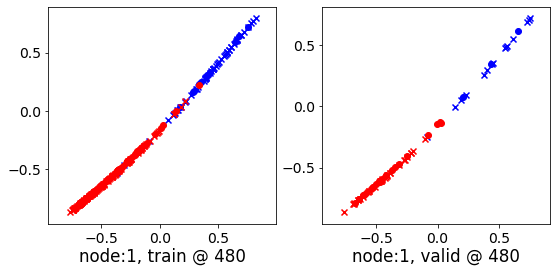

480 	 2 	 0.10378754 	 0.20422319 	 0.33891481 	 0.43839660 	 0.93840545 	 0.92732060


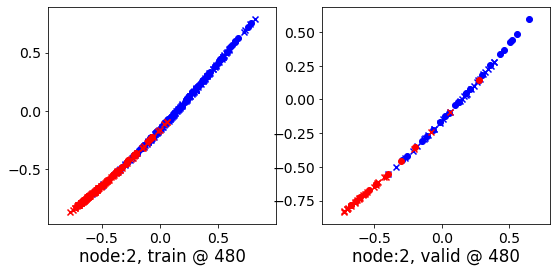

480 	 3 	 0.30674821 	 0.37940621 	 0.48324075 	 0.57597220 	 0.87476492 	 0.88971317


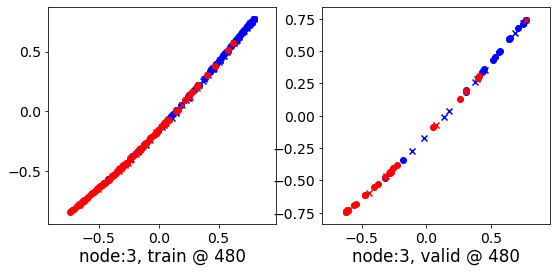

480 	 4 	 0.22524378 	 0.45033365 	 0.42965403 	 0.66468740 	 0.90870440 	 0.90750092


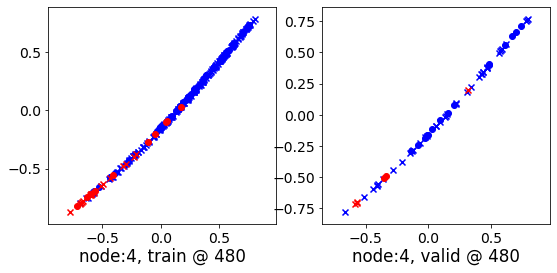

480 	 5 	 0.44728506 	 0.46601212 	 0.68981159 	 0.70641440 	 0.93629968 	 0.93354946


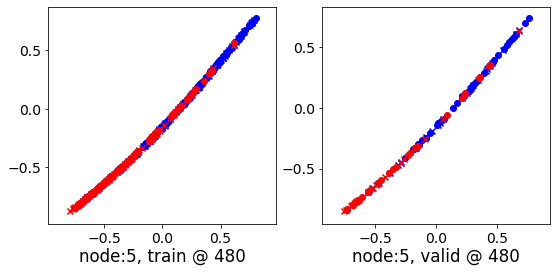

480 	 6 	 0.45222688 	 0.43365306 	 0.72752482 	 0.69015461 	 0.96840590 	 0.94964874


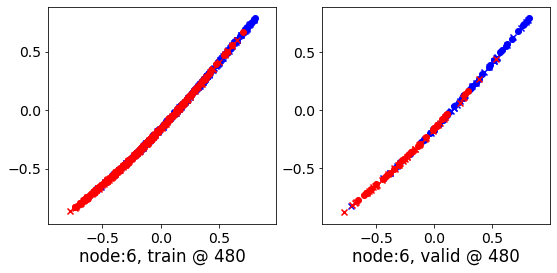

480 	 7 	 0.57751024 	 0.62847477 	 0.79456067 	 0.88143790 	 0.91117930 	 0.94611031


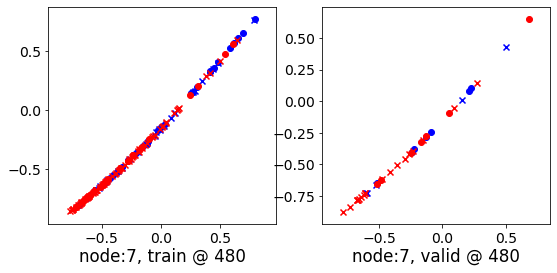

480 	 8 	 0.53446448 	 0.41145915 	 0.77901626 	 0.69697171 	 0.94346106 	 0.97865975


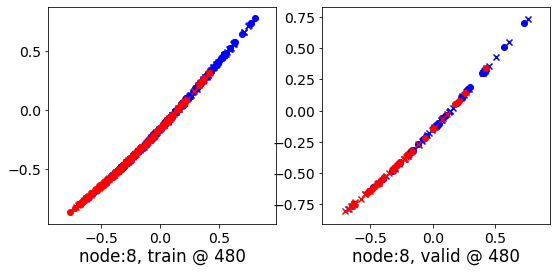

Aggregating on epoch: 482...
Aggregating on epoch: 484...
Aggregating on epoch: 486...
Aggregating on epoch: 488...
Aggregating on epoch: 490...
Aggregating on epoch: 492...
Aggregating on epoch: 494...
Aggregating on epoch: 496...
Aggregating on epoch: 498...
Aggregating on epoch: 500...
500 	 0 	 -0.21695113 	 -0.20518067 	 0.02754473 	 0.04354379 	 0.94319475 	 0.94187164


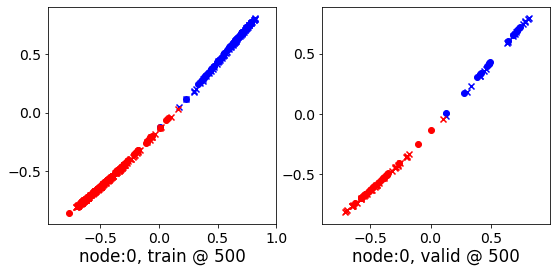

500 	 1 	 -0.01927879 	 -0.08602825 	 0.18059696 	 0.13440546 	 0.90626889 	 0.91358089


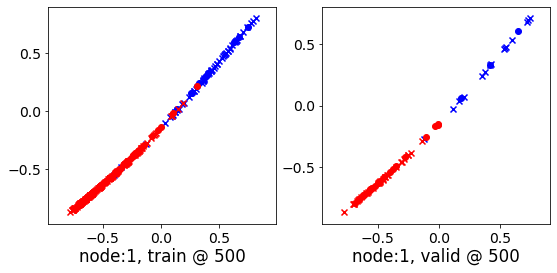

500 	 2 	 0.11149317 	 0.21092728 	 0.34226581 	 0.44494084 	 0.93823332 	 0.92716074


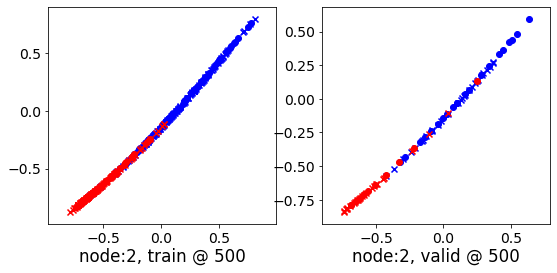

500 	 3 	 0.31040946 	 0.37665379 	 0.48560253 	 0.57737142 	 0.87502337 	 0.89386481


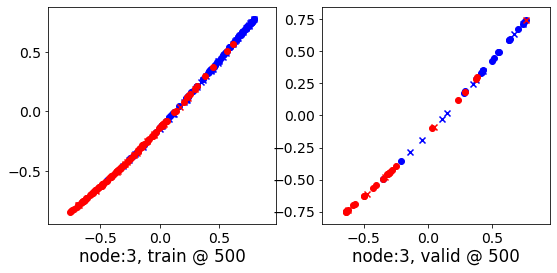

500 	 4 	 0.21891356 	 0.45258939 	 0.42800313 	 0.66677529 	 0.90851939 	 0.90733308


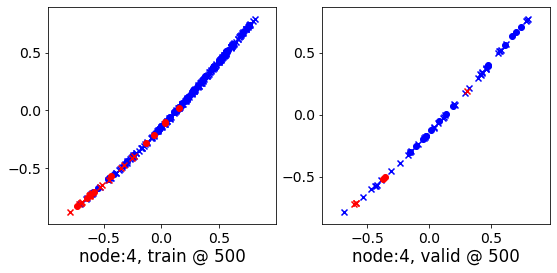

500 	 5 	 0.44707429 	 0.46583891 	 0.68975466 	 0.70603907 	 0.93576270 	 0.93334734


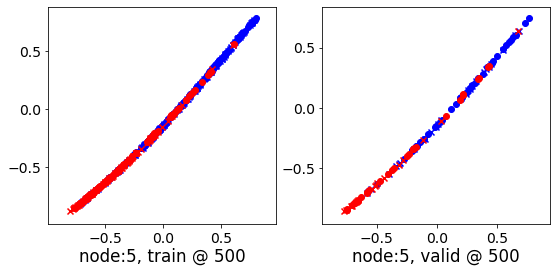

500 	 6 	 0.65107322 	 0.42439282 	 0.91302150 	 0.68068898 	 0.95677811 	 0.94944334


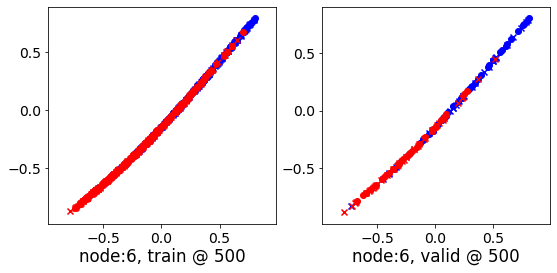

500 	 7 	 0.57779706 	 0.63277942 	 0.79430008 	 0.88356942 	 0.91056341 	 0.94393718


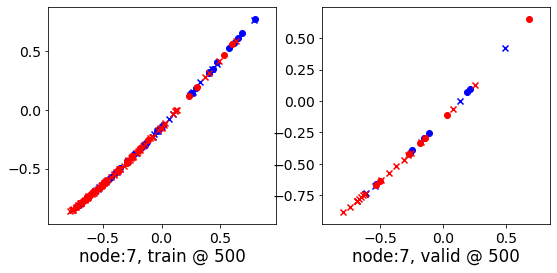

500 	 8 	 0.53205019 	 0.41059667 	 0.77777386 	 0.69681180 	 0.94339776 	 0.97936231


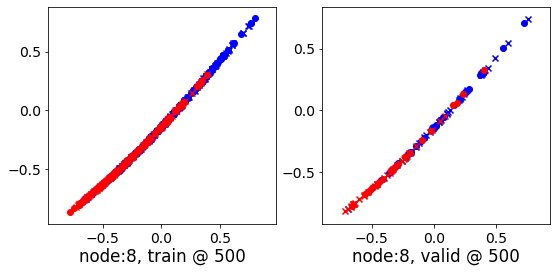

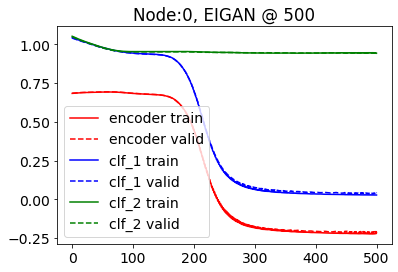

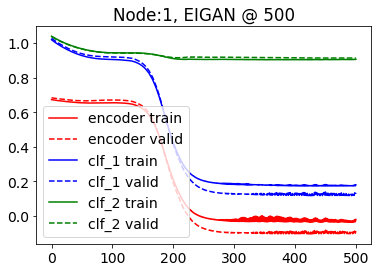

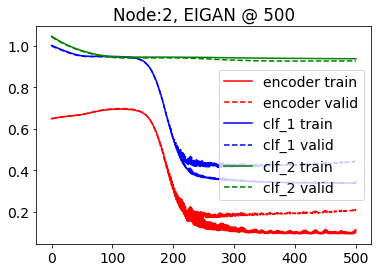

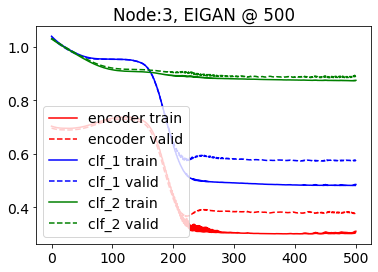

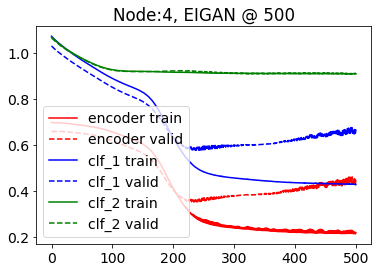

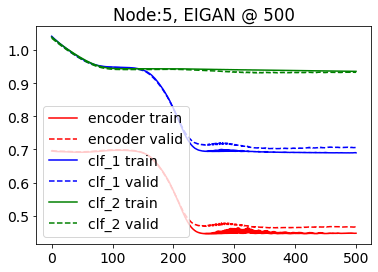

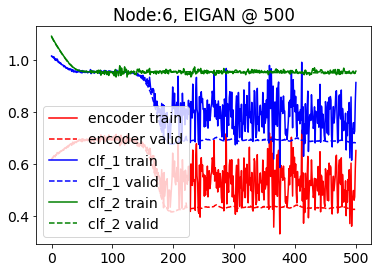

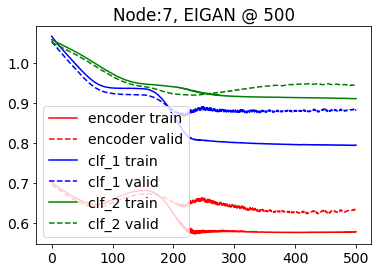

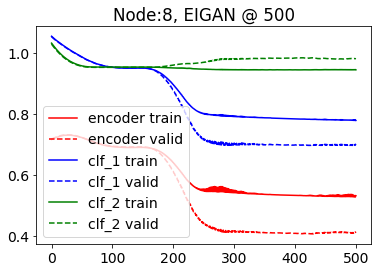

  0%|          | 1/501 [00:00<00:57,  8.77it/s]

epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.77709168 	 0.78201699 	 1.07968044 	 1.07651126 	 0.99582839 	 0.98764145


100%|██████████| 501/501 [01:14<00:00,  6.74it/s]


500 	 0.46809655 	 0.33725661 	 0.73067749 	 0.59751874 	 0.95781088 	 0.95340931


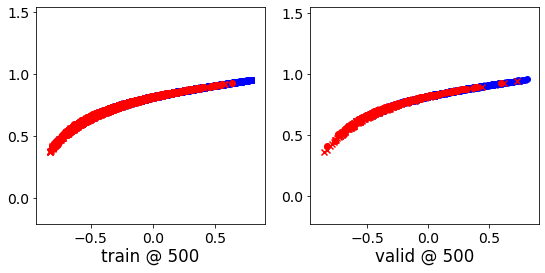

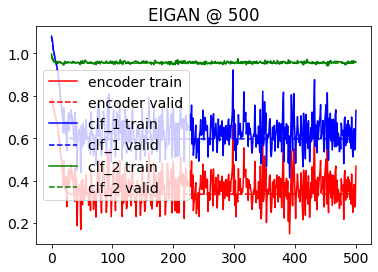

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.137609 	 1.137518 	 0.4963
200 	 0.775271 	 0.769475 	 0.7725
400 	 0.628659 	 0.605287 	 0.8237
600 	 0.627972 	 0.605583 	 0.8225
800 	 0.627853 	 0.606361 	 0.8225
1000 	 0.627788 	 0.607042 	 0.8225
Accuracy: 0.8225
Error Rate: 0.1775
F1 Score: 0.8065395095367848
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7975
Error Rate: 0.2025
F1 Score: 0.7638483965014577
SVM
--------------------------------------------------------------------------------
Accuracy: 0.805
Error Rate: 0.195
F1 Score: 0.7802816901408451
-------------------------------

@node 3: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(270, 2) (68, 2) (270, 1) (68, 1) (270, 1) (68, 1)
@node 3: class weights => w1, w2 [array([2.44776119, 1.69072165]), array([2.51075269, 1.66192171]), array([1.91623037, 2.09142857]), array([9.31034483, 1.12033195])] [array([1.47085202, 3.12380952]), array([1.54635762, 2.83030303]), array([2.79389313, 1.55744681]), array([2.28813559, 1.77631579])]
@node 3: tensor sizes => torch.Size([270, 2]) (68, 2) torch.Size([270, 2]) (68, 2) torch.Size([270, 2]) (68, 2)
@node 4: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(246, 2) (62, 2) (246, 1) (62, 1) (246, 1) (62, 1)
@node 4: class weights => w1, w2 [array([2.44776119, 1.69072165]), array([2.51075269, 1.66192171]), array([1.91623037, 2.09142857]), array([9.31034483, 1.12033195]), array([2.29906542, 1.76978417])] [array([1.47085202, 3.12380952]), array([1.54635762, 2.83030303]), array([2.79389313, 1.55744681]), array([2.28813559, 1.77631579]), array([1.217821

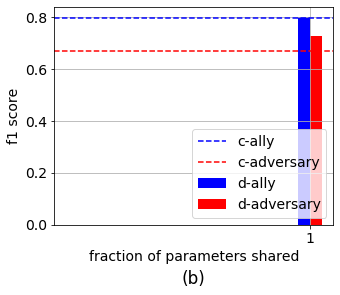

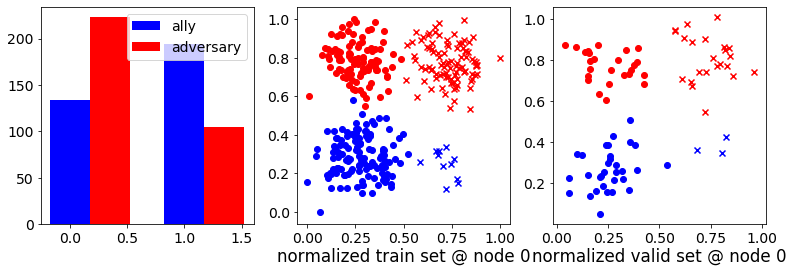

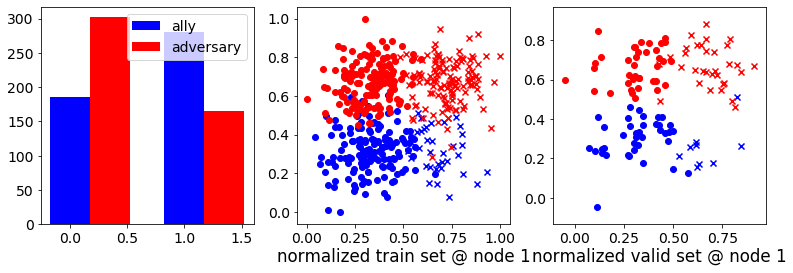

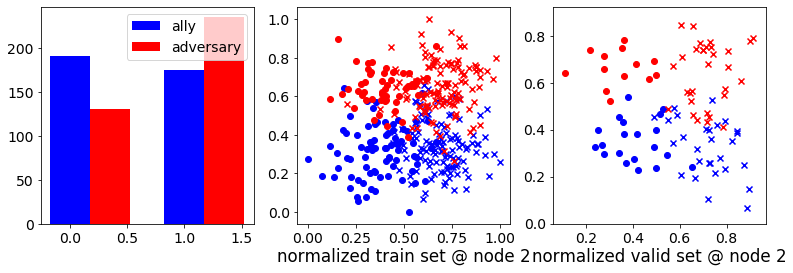

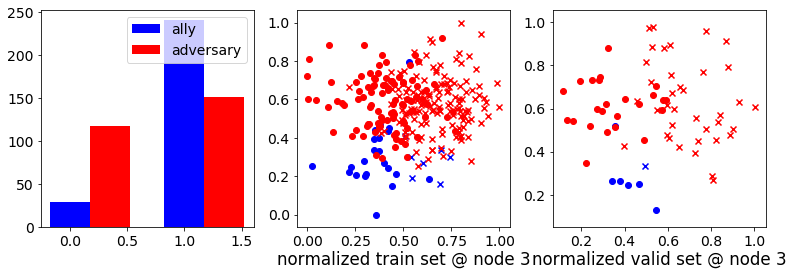

...

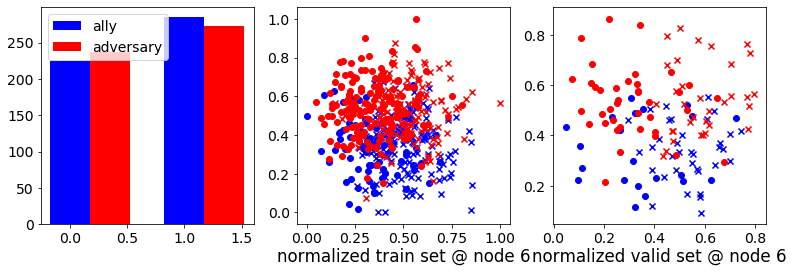

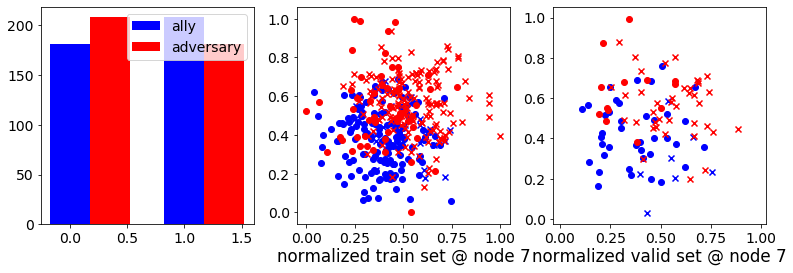

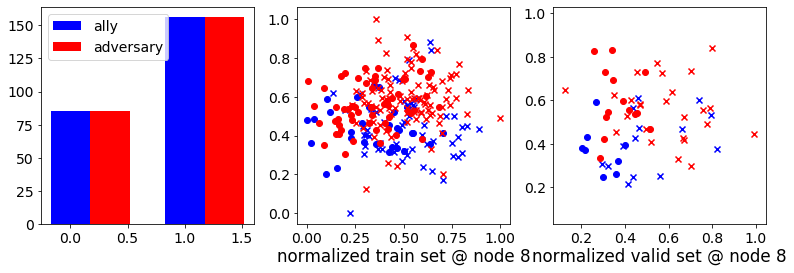

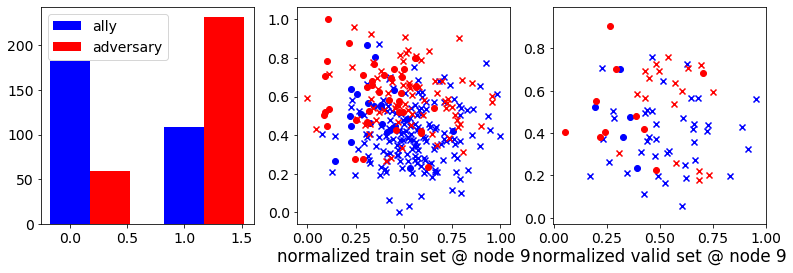

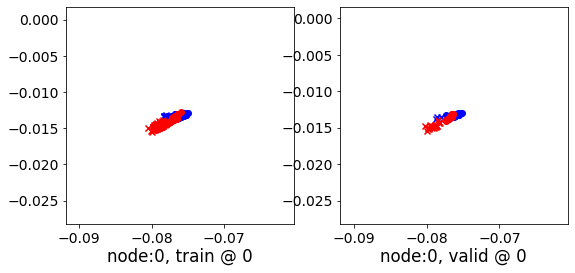

0 	 1 	 0.74339044 	 0.74420321 	 1.08004785 	 1.07835197 	 1.02989745 	 1.02729595


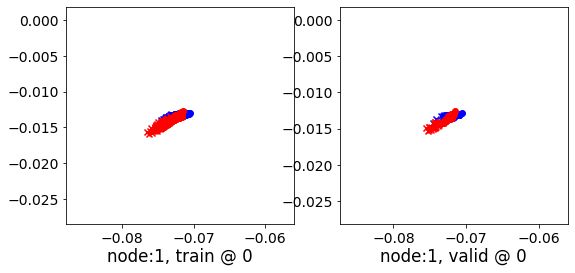

0 	 2 	 0.67628980 	 0.67599213 	 1.01205897 	 1.01061511 	 1.02898502 	 1.02777016


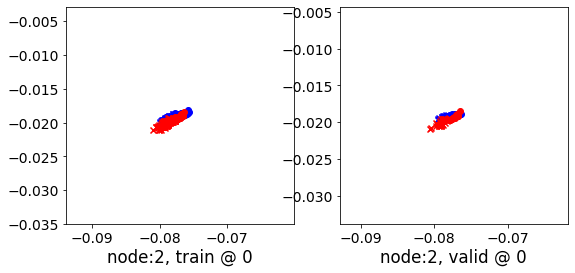

0 	 3 	 0.62698448 	 0.61283505 	 1.00358140 	 0.98928452 	 1.06980383 	 1.06959665


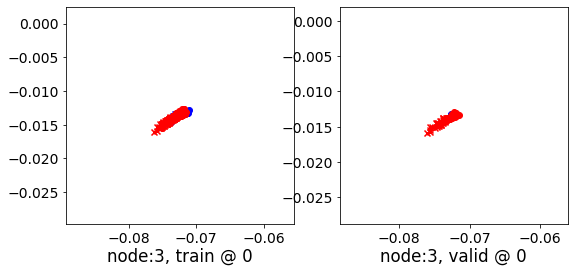

0 	 4 	 0.64233196 	 0.64477336 	 1.04717422 	 1.04490232 	 1.09810138 	 1.09327614


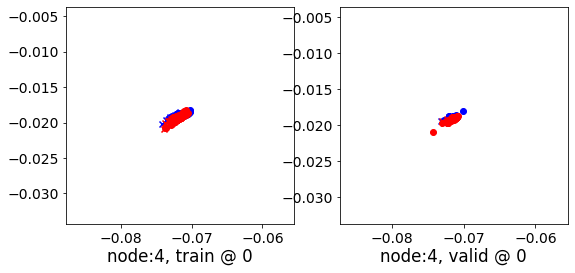

0 	 5 	 0.71521521 	 0.71504897 	 1.02106273 	 1.01930618 	 0.99910587 	 0.99740440


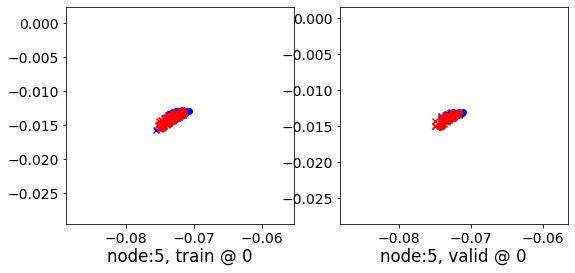

0 	 6 	 0.61262488 	 0.61307943 	 1.02040696 	 1.01814914 	 1.10112786 	 1.09821689


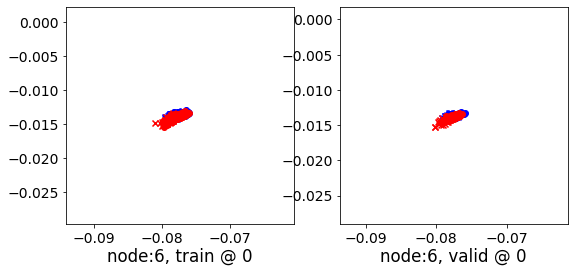

0 	 7 	 0.66203713 	 0.66328585 	 1.02086699 	 1.01998055 	 1.05198300 	 1.04984188


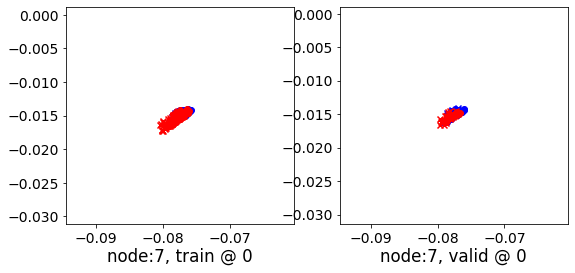

0 	 8 	 0.66335416 	 0.66588485 	 1.04343855 	 1.04685700 	 1.07326198 	 1.07411933


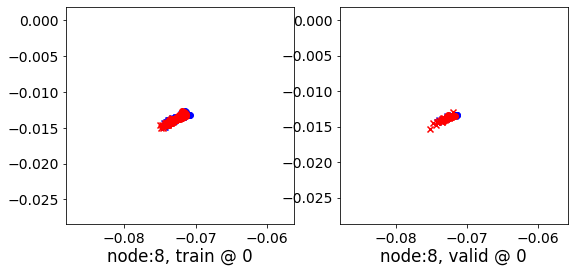

0 	 9 	 0.66184926 	 0.66609359 	 1.00466096 	 1.00639653 	 1.03602147 	 1.03345013


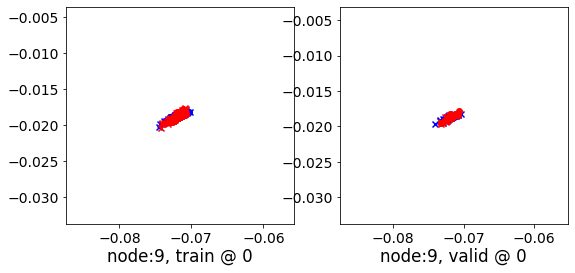

Aggregating on epoch: 2...
Aggregating on epoch: 4...
Aggregating on epoch: 6...
Aggregating on epoch: 8...
Aggregating on epoch: 10...
Aggregating on epoch: 12...
Aggregating on epoch: 14...
Aggregating on epoch: 16...
Aggregating on epoch: 18...
Aggregating on epoch: 20...
20 	 0 	 0.70502377 	 0.70933938 	 1.04554498 	 1.04616630 	 1.03369403 	 1.02997410


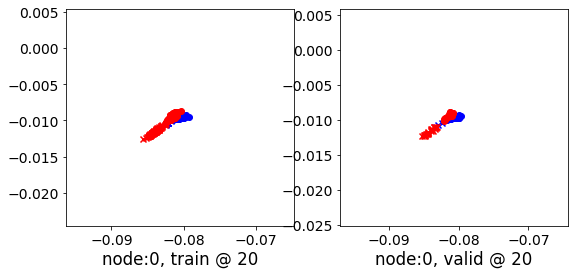

20 	 1 	 0.73816496 	 0.73883116 	 1.04301345 	 1.04181492 	 0.99813038 	 0.99613094


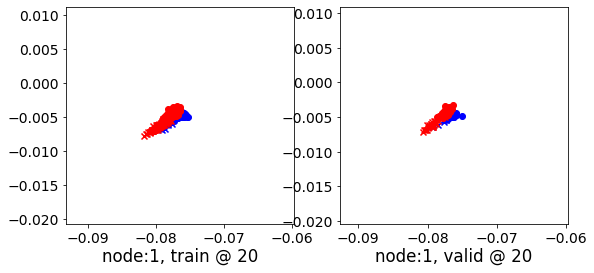

20 	 2 	 0.68226141 	 0.68192899 	 0.98671263 	 0.98561138 	 0.99776751 	 0.99682957


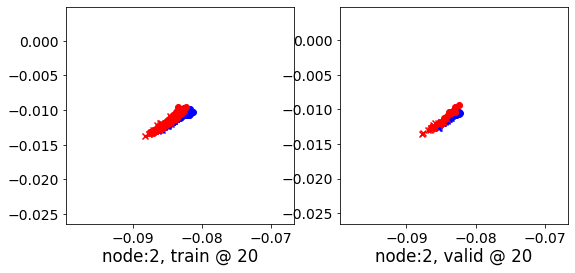

20 	 3 	 0.61855304 	 0.60400009 	 0.95978481 	 0.94538105 	 1.03443134 	 1.03452814


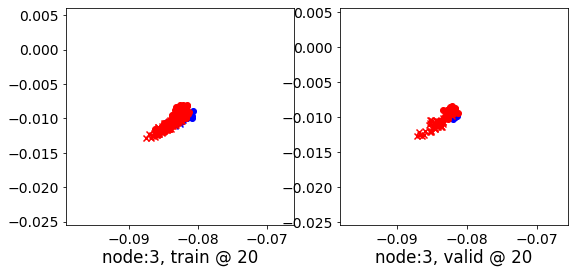

20 	 4 	 0.64918065 	 0.65189493 	 1.01232398 	 1.01090717 	 1.05634630 	 1.05215943


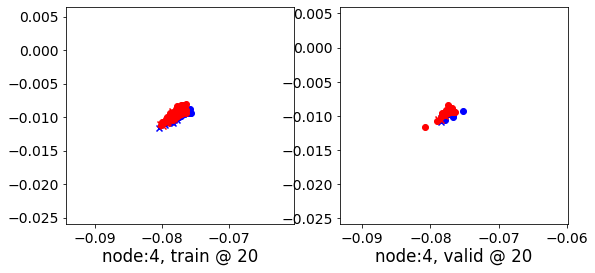

20 	 5 	 0.72065294 	 0.72029257 	 0.99651659 	 0.99517530 	 0.96904105 	 0.96802992


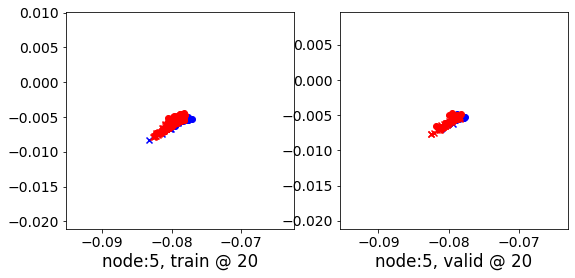

20 	 6 	 0.63115036 	 0.63087654 	 0.99862599 	 0.99661732 	 1.06072116 	 1.05888796


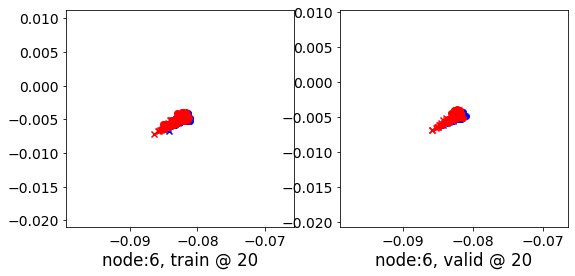

20 	 7 	 0.67904526 	 0.67968267 	 0.99577487 	 0.99500352 	 1.00991714 	 1.00846803


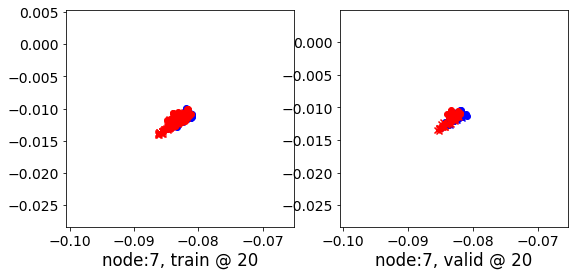

20 	 8 	 0.65001231 	 0.65200996 	 0.99970919 	 1.00316167 	 1.04292560 	 1.04429889


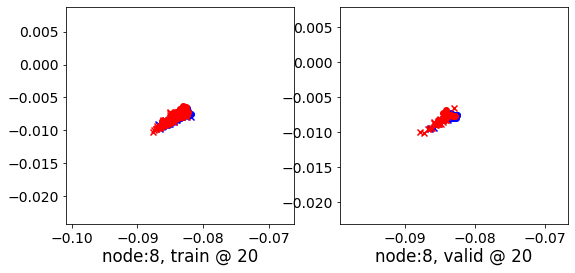

20 	 9 	 0.67315930 	 0.67759746 	 0.98304653 	 0.98513478 	 1.00306249 	 1.00068450


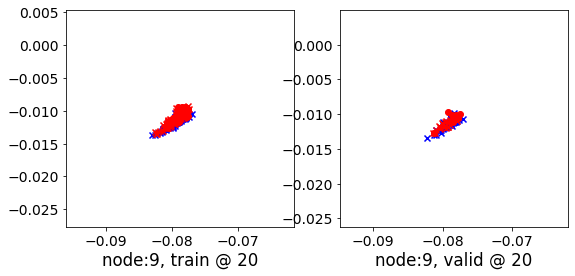

Aggregating on epoch: 22...
Aggregating on epoch: 24...
Aggregating on epoch: 26...
Aggregating on epoch: 28...
Aggregating on epoch: 30...
Aggregating on epoch: 32...
Aggregating on epoch: 34...
Aggregating on epoch: 36...
Aggregating on epoch: 38...
Aggregating on epoch: 40...
40 	 0 	 0.70042992 	 0.70468038 	 1.00815034 	 1.00918436 	 1.00097156 	 0.99765116


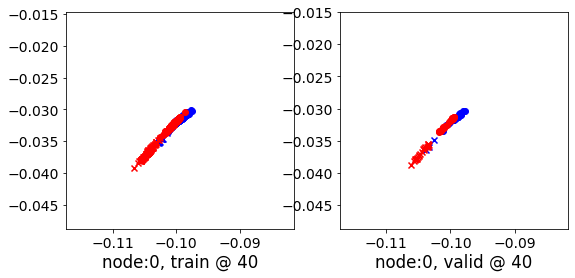

40 	 1 	 0.73689604 	 0.73774701 	 1.01699769 	 1.01617563 	 0.97342616 	 0.97157580


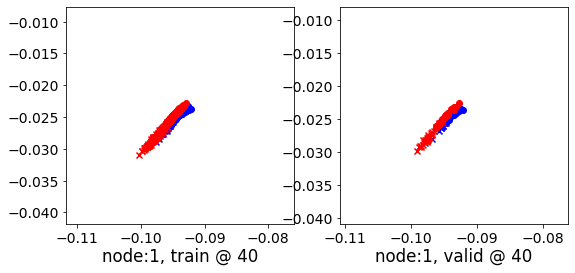

40 	 2 	 0.68781722 	 0.68754107 	 0.96751225 	 0.96676552 	 0.97310156 	 0.97237164


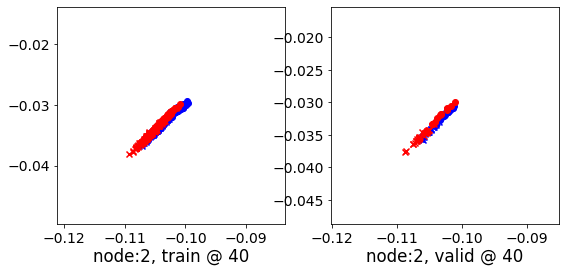

40 	 3 	 0.60578912 	 0.59045738 	 0.92015278 	 0.90526873 	 1.00768089 	 1.00795853


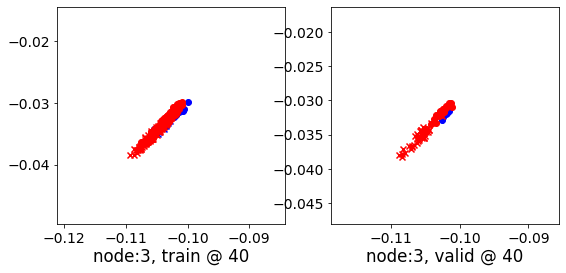

40 	 4 	 0.65920198 	 0.66181231 	 0.98990870 	 0.98891199 	 1.02386594 	 1.02024686


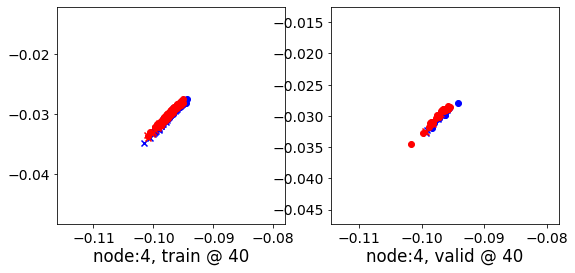

40 	 5 	 0.71328729 	 0.71209675 	 0.97603583 	 0.97475231 	 0.95591366 	 0.95580274


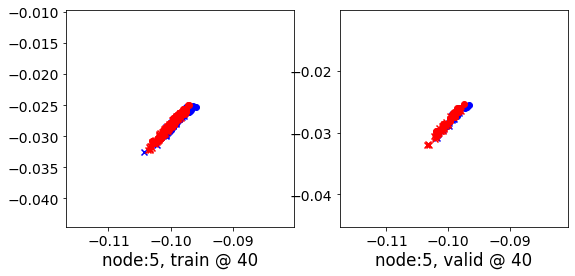

40 	 6 	 0.64045745 	 0.64009333 	 0.97950184 	 0.97768736 	 1.03223503 	 1.03074121


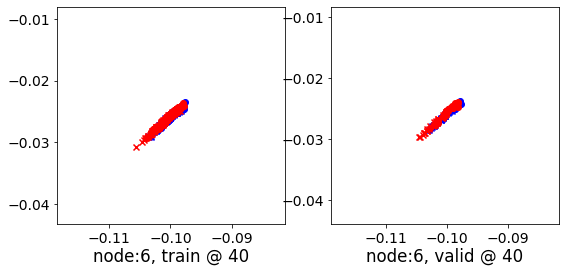

40 	 7 	 0.68600661 	 0.68651348 	 0.97341079 	 0.97289413 	 0.98061174 	 0.97952783


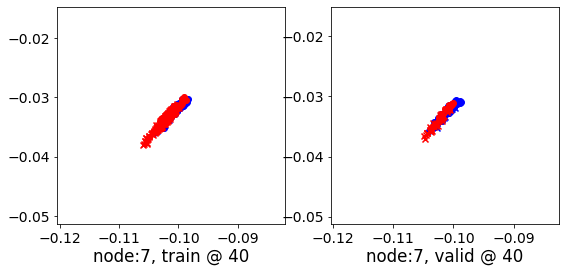

40 	 8 	 0.64272815 	 0.64453232 	 0.96751219 	 0.97098637 	 1.01809430 	 1.01960123


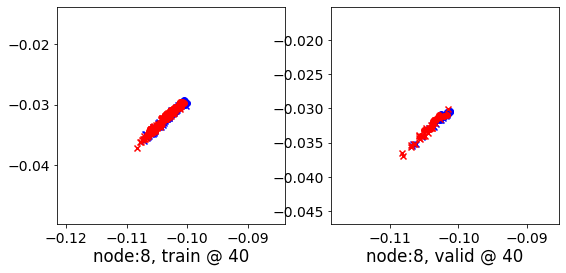

40 	 9 	 0.68472159 	 0.68917269 	 0.96502769 	 0.96740556 	 0.97354275 	 0.97138005


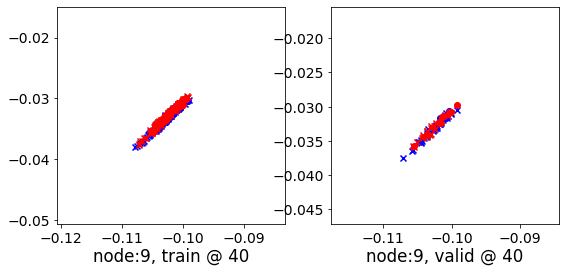

Aggregating on epoch: 42...
Aggregating on epoch: 44...
Aggregating on epoch: 46...
Aggregating on epoch: 48...
Aggregating on epoch: 50...
Aggregating on epoch: 52...
Aggregating on epoch: 54...
Aggregating on epoch: 56...
Aggregating on epoch: 58...
Aggregating on epoch: 60...
60 	 0 	 0.69452888 	 0.69904375 	 0.97538215 	 0.97701418 	 0.97418398 	 0.97111762


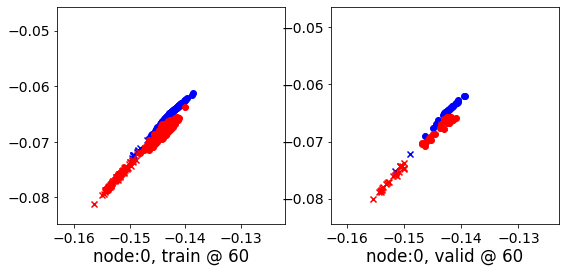

60 	 1 	 0.73574919 	 0.73678213 	 0.99581629 	 0.99516302 	 0.95345110 	 0.95152807


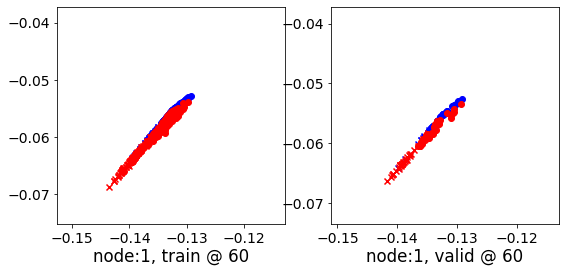

60 	 2 	 0.69550163 	 0.69532686 	 0.95667428 	 0.95640767 	 0.95460165 	 0.95422798


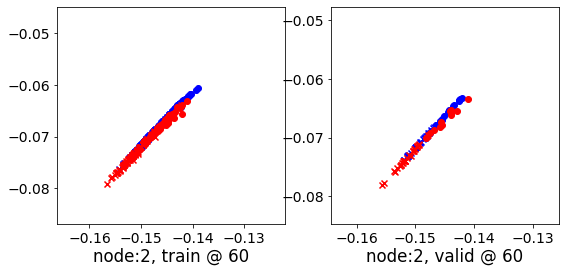

60 	 3 	 0.59077305 	 0.57469356 	 0.88343030 	 0.86807925 	 0.98613203 	 0.98653287


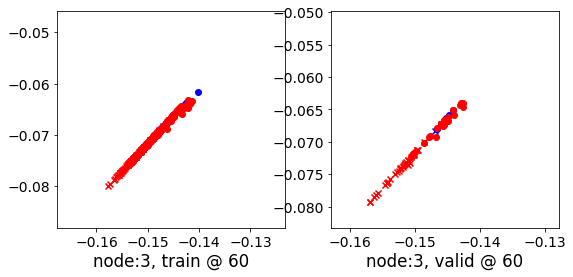

60 	 4 	 0.67111611 	 0.67373407 	 0.97384167 	 0.97314757 	 0.99588513 	 0.99256068


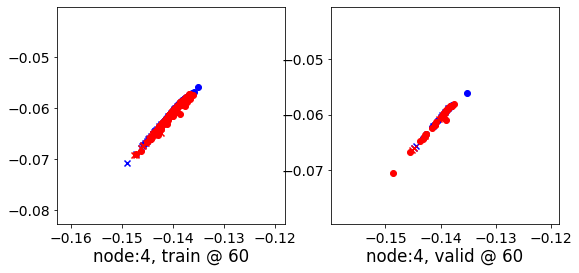

60 	 5 	 0.69695169 	 0.69591010 	 0.95852488 	 0.95751739 	 0.95478624 	 0.95475447


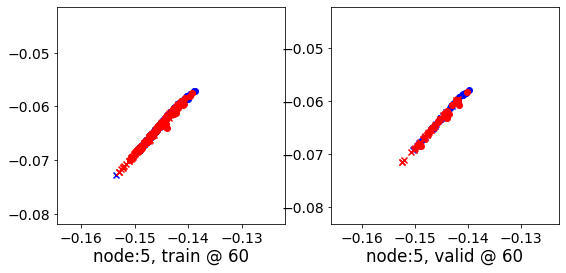

60 	 6 	 0.64784765 	 0.64772999 	 0.96430022 	 0.96278918 	 1.00961745 	 1.00820637


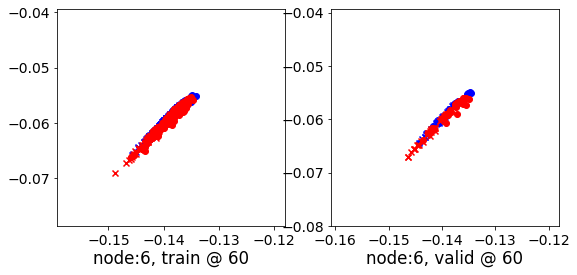

60 	 7 	 0.68875331 	 0.68925762 	 0.95742726 	 0.95752823 	 0.96190518 	 0.96141779


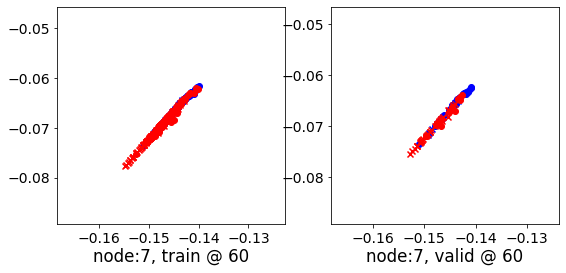

60 	 8 	 0.64592433 	 0.64827925 	 0.94663864 	 0.95062190 	 0.99399900 	 0.99548984


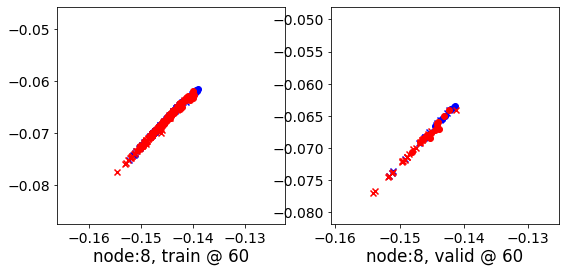

60 	 9 	 0.69684851 	 0.70172793 	 0.95168597 	 0.95468503 	 0.94817436 	 0.94610429


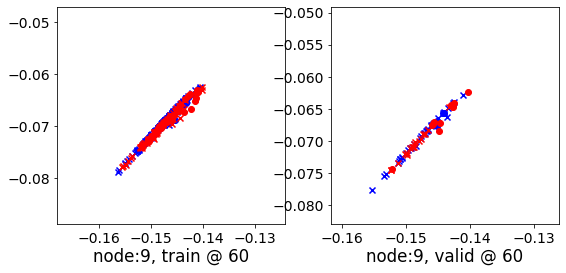

Aggregating on epoch: 62...
Aggregating on epoch: 64...
Aggregating on epoch: 66...
Aggregating on epoch: 68...
Aggregating on epoch: 70...
Aggregating on epoch: 72...
Aggregating on epoch: 74...
Aggregating on epoch: 76...
Aggregating on epoch: 78...
Aggregating on epoch: 80...
80 	 0 	 0.69347465 	 0.69853240 	 0.95377904 	 0.95626122 	 0.95363206 	 0.95087600


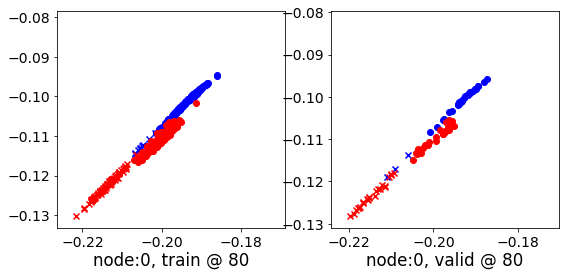

80 	 1 	 0.72819144 	 0.72951370 	 0.97739148 	 0.97697204 	 0.94254190 	 0.94060552


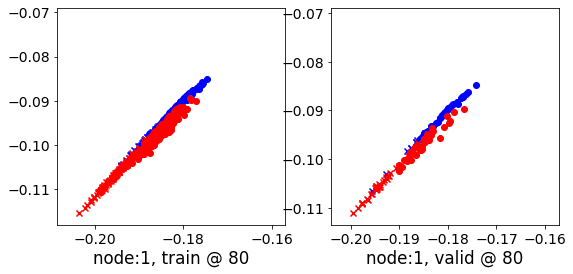

80 	 2 	 0.70315409 	 0.70293242 	 0.95457047 	 0.95456600 	 0.94467843 	 0.94478077


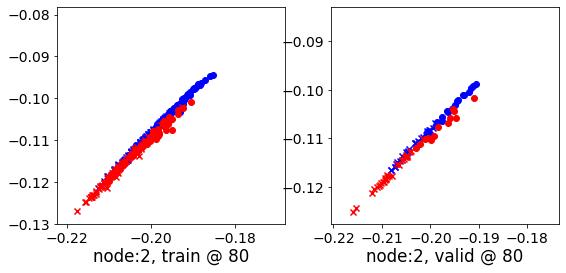

80 	 3 	 0.57884938 	 0.56209415 	 0.85457456 	 0.83888602 	 0.96937549 	 0.96993905


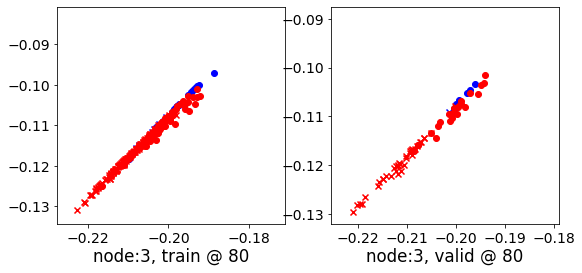

80 	 4 	 0.68653673 	 0.68921560 	 0.96250790 	 0.96205455 	 0.96917623 	 0.96598613


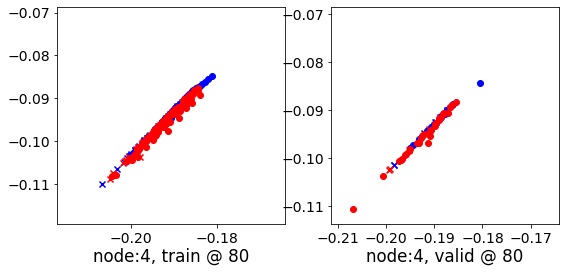

80 	 5 	 0.68820810 	 0.68767124 	 0.94967401 	 0.94915050 	 0.95466918 	 0.95462644


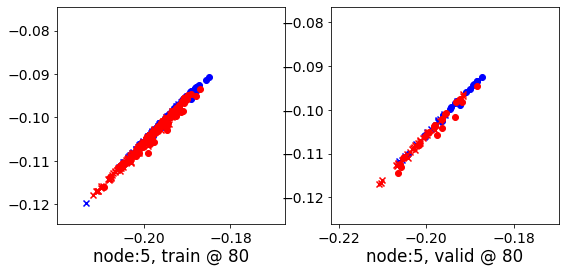

80 	 6 	 0.65774500 	 0.65792108 	 0.95532590 	 0.95417428 	 0.99075180 	 0.98940039


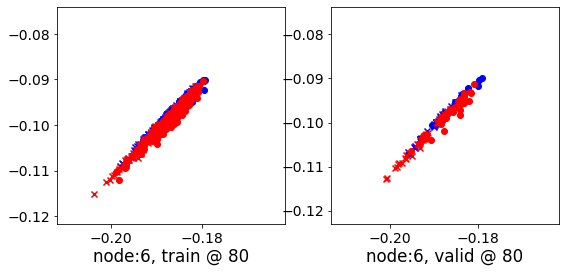

80 	 7 	 0.69184732 	 0.69234395 	 0.95373046 	 0.95437139 	 0.95504469 	 0.95517462


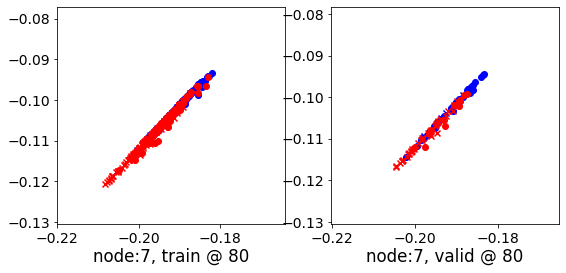

80 	 8 	 0.66228974 	 0.66527677 	 0.94069541 	 0.94538862 	 0.97154844 	 0.97325903


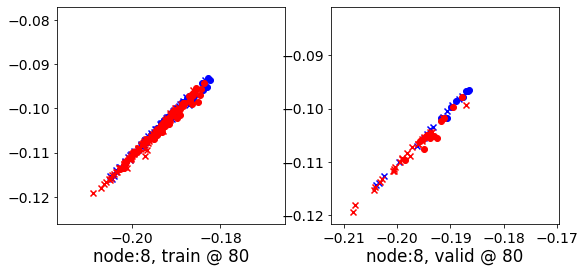

80 	 9 	 0.71239781 	 0.71835887 	 0.94527662 	 0.94943446 	 0.92620808 	 0.92422277


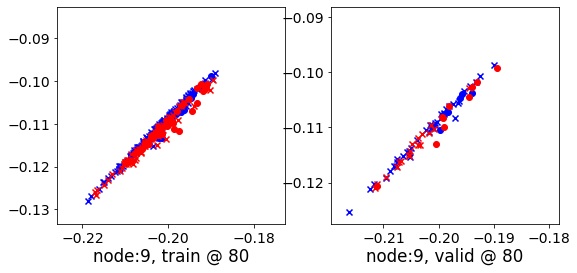

Aggregating on epoch: 82...
Aggregating on epoch: 84...
Aggregating on epoch: 86...
Aggregating on epoch: 88...
Aggregating on epoch: 90...
Aggregating on epoch: 92...
Aggregating on epoch: 94...
Aggregating on epoch: 96...
Aggregating on epoch: 98...
Aggregating on epoch: 100...
100 	 0 	 0.70109957 	 0.70626247 	 0.94870329 	 0.95147449 	 0.94082648 	 0.93835920


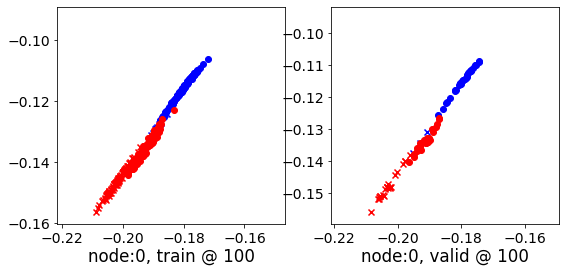

100 	 1 	 0.71530783 	 0.71718371 	 0.96262324 	 0.96265125 	 0.94059354 	 0.93861473


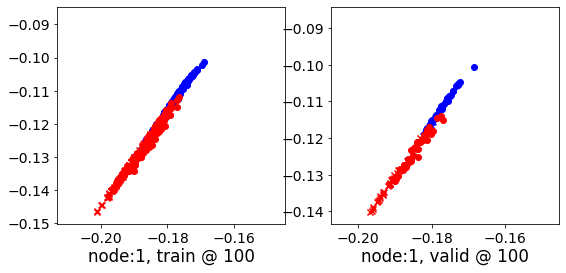

100 	 2 	 0.70622468 	 0.70582455 	 0.95446306 	 0.95446122 	 0.94138652 	 0.94178385


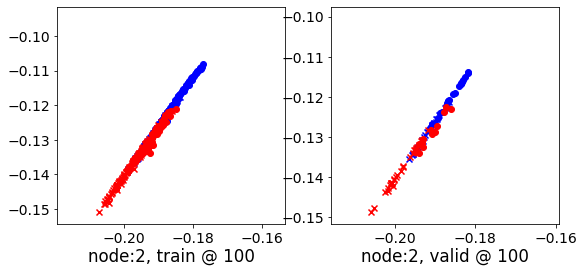

100 	 3 	 0.57360959 	 0.55623913 	 0.83789569 	 0.82182062 	 0.95791650 	 0.95872867


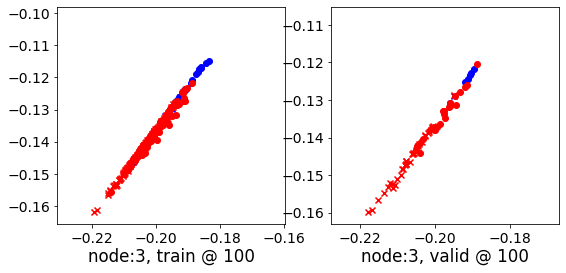

100 	 4 	 0.70656580 	 0.70955431 	 0.95514160 	 0.95494050 	 0.94182694 	 0.93853337


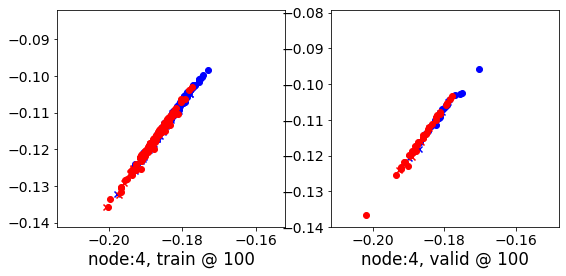

100 	 5 	 0.68676931 	 0.68638653 	 0.94815677 	 0.94784874 	 0.95458740 	 0.95460939


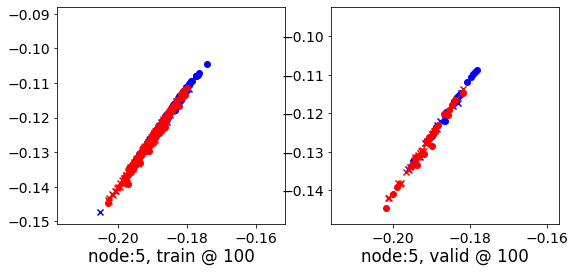

100 	 6 	 0.67169178 	 0.67179948 	 0.95261753 	 0.95167226 	 0.97418612 	 0.97301996


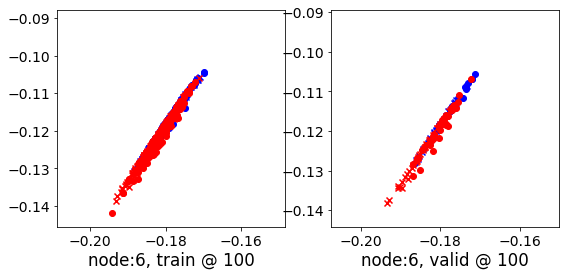

100 	 7 	 0.69266796 	 0.69279522 	 0.95348966 	 0.95413625 	 0.95400214 	 0.95448822


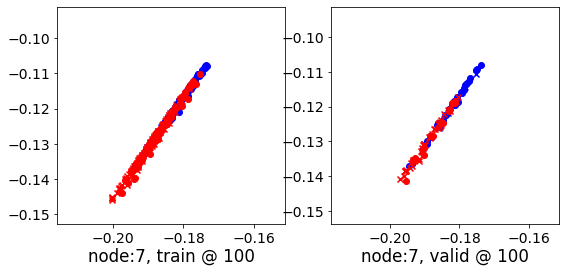

100 	 8 	 0.67871135 	 0.68140632 	 0.94004530 	 0.94530284 	 0.95457011 	 0.95704371


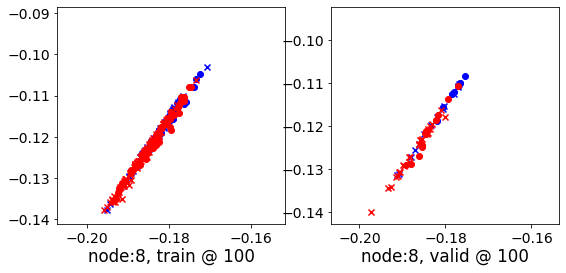

100 	 9 	 0.72898656 	 0.73572749 	 0.94421411 	 0.94921541 	 0.90845168 	 0.90663511


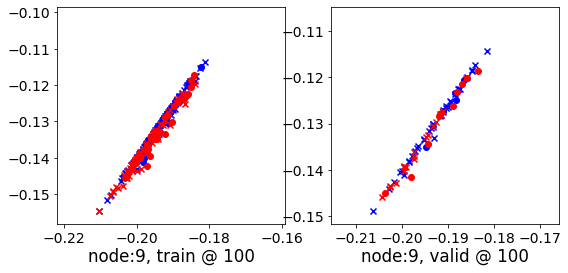

Aggregating on epoch: 102...
Aggregating on epoch: 104...
Aggregating on epoch: 106...
Aggregating on epoch: 108...
Aggregating on epoch: 110...
Aggregating on epoch: 112...
Aggregating on epoch: 114...
Aggregating on epoch: 116...
Aggregating on epoch: 118...
Aggregating on epoch: 120...
120 	 0 	 0.70608473 	 0.71089709 	 0.94791931 	 0.95045692 	 0.93508840 	 0.93270701


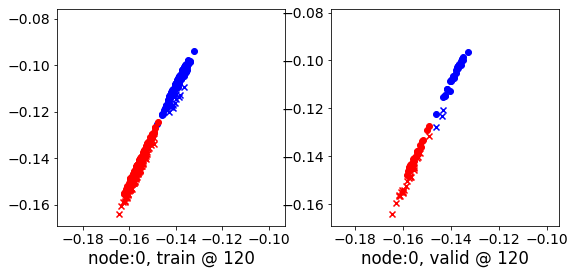

120 	 1 	 0.70648050 	 0.70899063 	 0.95350909 	 0.95406967 	 0.94018984 	 0.93822622


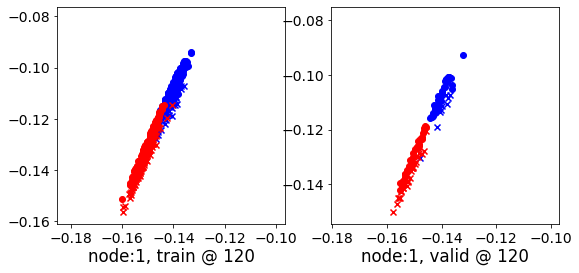

120 	 2 	 0.70625043 	 0.70570451 	 0.95403218 	 0.95403093 	 0.94095844 	 0.94147360


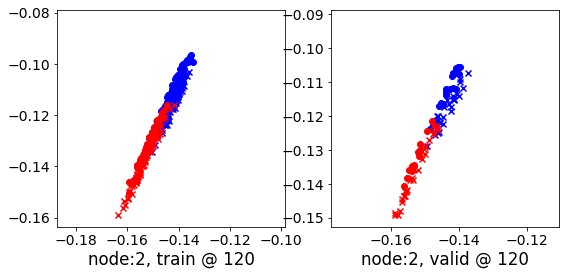

120 	 3 	 0.57110822 	 0.55288649 	 0.83044958 	 0.81372792 	 0.95293093 	 0.95398861


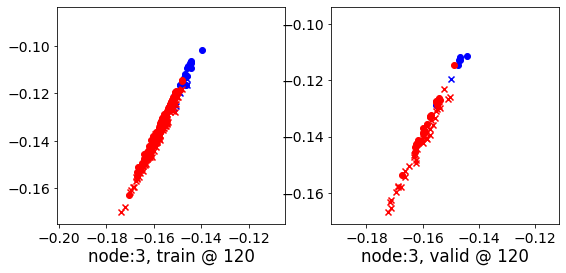

120 	 4 	 0.72972286 	 0.73303580 	 0.95212233 	 0.95220906 	 0.91573608 	 0.91232044


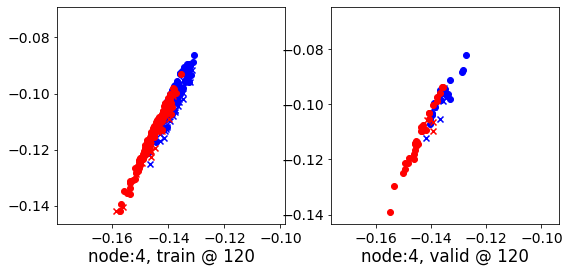

120 	 5 	 0.68626052 	 0.68583196 	 0.94764358 	 0.94737911 	 0.95462370 	 0.95469433


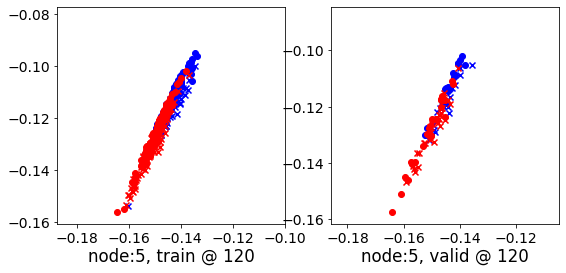

120 	 6 	 0.68383503 	 0.68341905 	 0.95225620 	 0.95130956 	 0.96168166 	 0.96103770


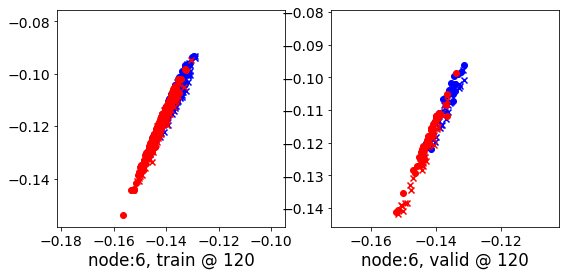

120 	 7 	 0.69230199 	 0.69219989 	 0.95297915 	 0.95360392 	 0.95390922 	 0.95455122


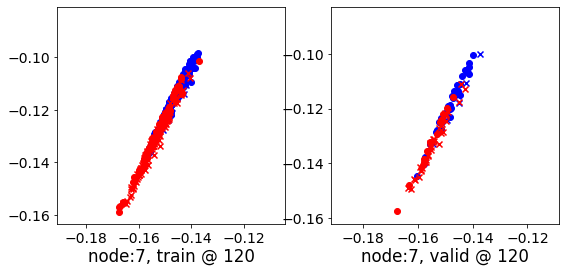

120 	 8 	 0.68826830 	 0.68997037 	 0.94001830 	 0.94548386 	 0.94497597 	 0.94866067


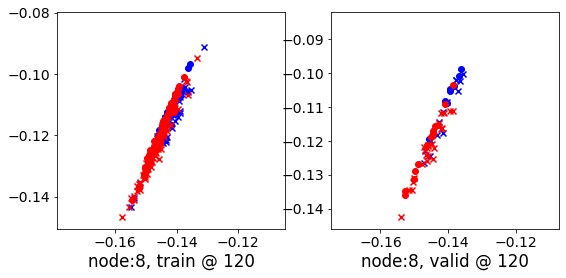

120 	 9 	 0.73990589 	 0.74643409 	 0.94423044 	 0.94924861 	 0.89750564 	 0.89596170


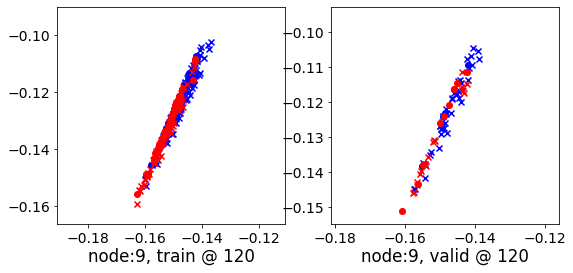

Aggregating on epoch: 122...
Aggregating on epoch: 124...
Aggregating on epoch: 126...
Aggregating on epoch: 128...
Aggregating on epoch: 130...
Aggregating on epoch: 132...
Aggregating on epoch: 134...
Aggregating on epoch: 136...
Aggregating on epoch: 138...
Aggregating on epoch: 140...
140 	 0 	 0.70614117 	 0.71069199 	 0.94579184 	 0.94817424 	 0.93307632 	 0.93062943


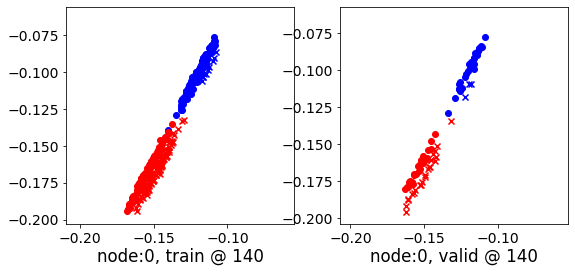

140 	 1 	 0.70230603 	 0.70525515 	 0.94917065 	 0.95020282 	 0.94003552 	 0.93809485


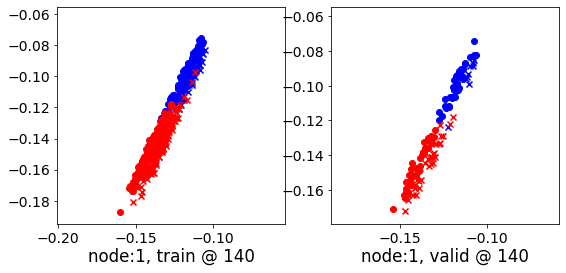

140 	 2 	 0.70471847 	 0.70385426 	 0.95239073 	 0.95233142 	 0.94097239 	 0.94162434


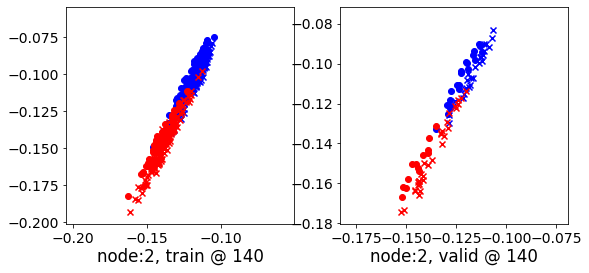

140 	 3 	 0.56581885 	 0.54579151 	 0.82411563 	 0.80589485 	 0.95214456 	 0.95325053


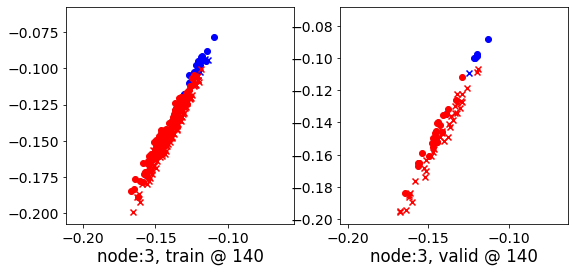

140 	 4 	 0.74949479 	 0.75265920 	 0.95162499 	 0.95177662 	 0.89551985 	 0.89226460


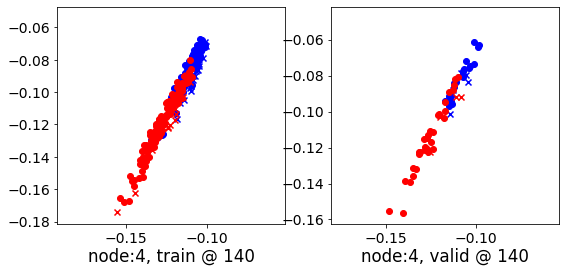

140 	 5 	 0.68457484 	 0.68401521 	 0.94587219 	 0.94577509 	 0.95467991 	 0.95490706


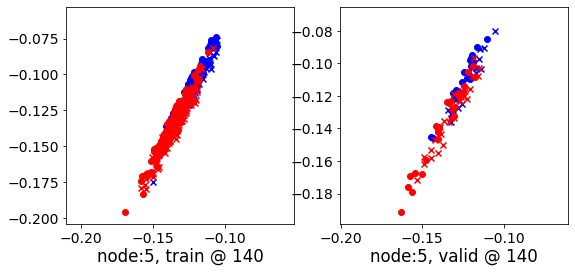

140 	 6 	 0.68922156 	 0.68801409 	 0.95159167 	 0.95054430 	 0.95560485 	 0.95567739


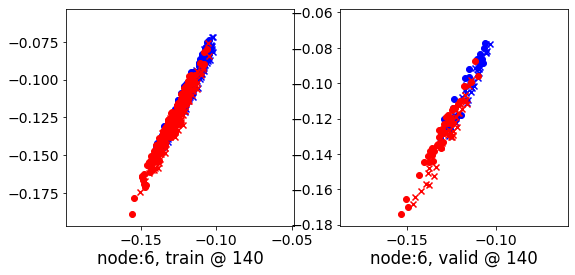

140 	 7 	 0.69079560 	 0.69044930 	 0.95127290 	 0.95185429 	 0.95383936 	 0.95455217


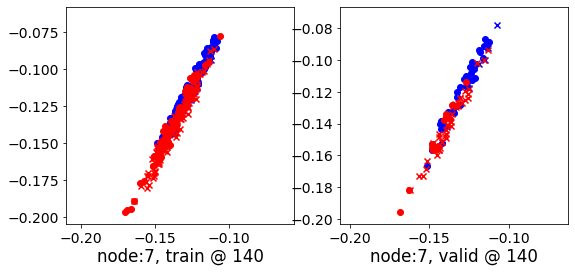

140 	 8 	 0.69203192 	 0.69258177 	 0.93983698 	 0.94526392 	 0.94101161 	 0.94582933


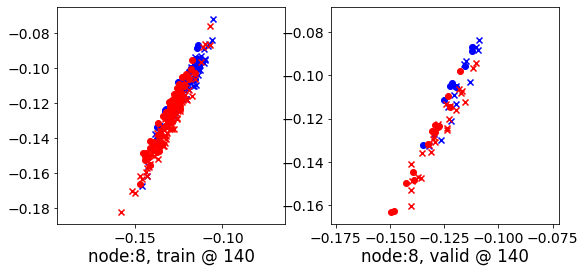

140 	 9 	 0.74458849 	 0.75080281 	 0.94427943 	 0.94922167 	 0.89287448 	 0.89156604


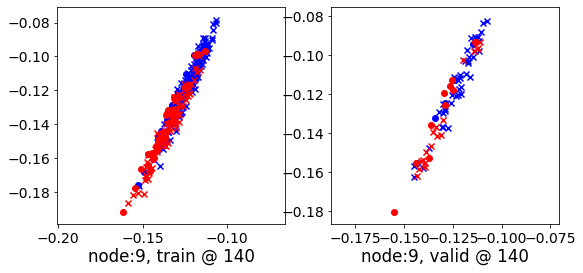

Aggregating on epoch: 142...
Aggregating on epoch: 144...
Aggregating on epoch: 146...
Aggregating on epoch: 148...
Aggregating on epoch: 150...
Aggregating on epoch: 152...
Aggregating on epoch: 154...
Aggregating on epoch: 156...
Aggregating on epoch: 158...
Aggregating on epoch: 160...
160 	 0 	 0.69892347 	 0.70263165 	 0.93740702 	 0.93939549 	 0.93247980 	 0.92991102


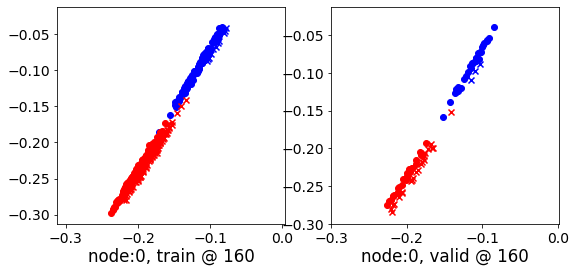

160 	 1 	 0.70014274 	 0.70329726 	 0.94689703 	 0.94815040 	 0.93998522 	 0.93800032


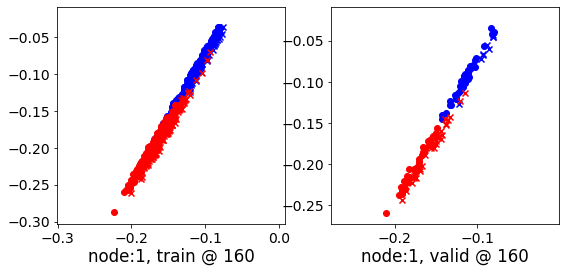

160 	 2 	 0.69692332 	 0.69473594 	 0.94424868 	 0.94370937 	 0.94120753 	 0.94212061


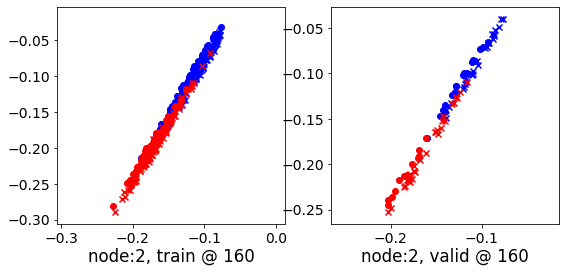

160 	 3 	 0.55126935 	 0.52589703 	 0.80868489 	 0.78602970 	 0.95219916 	 0.95327985


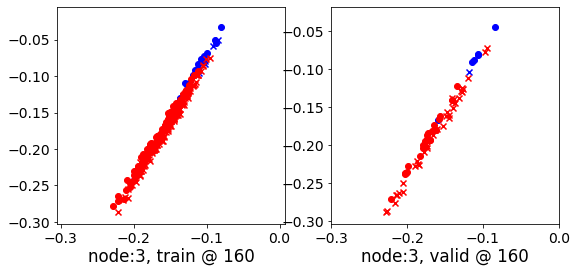

160 	 4 	 0.75973129 	 0.76262909 	 0.94960666 	 0.94977051 	 0.88325340 	 0.88028860


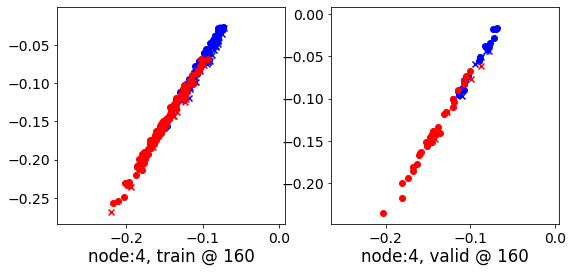

160 	 5 	 0.67820358 	 0.67756337 	 0.93921030 	 0.93990093 	 0.95484048 	 0.95548475


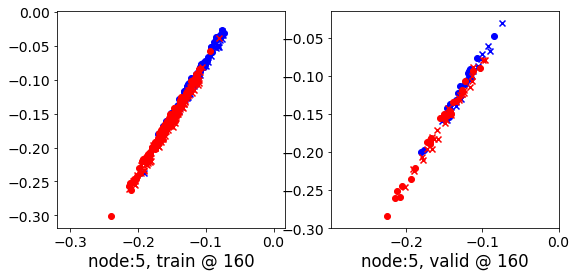

160 	 6 	 0.68797690 	 0.68587351 	 0.94869941 	 0.94727337 	 0.95407468 	 0.95454705


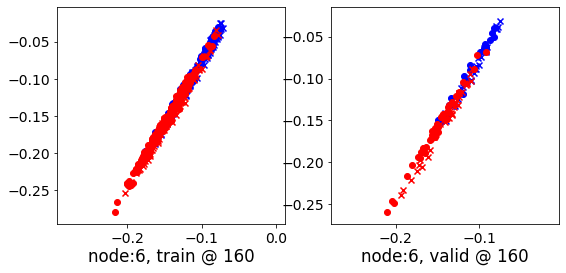

160 	 7 	 0.68527085 	 0.68412262 	 0.94494945 	 0.94551414 	 0.95356721 	 0.95453870


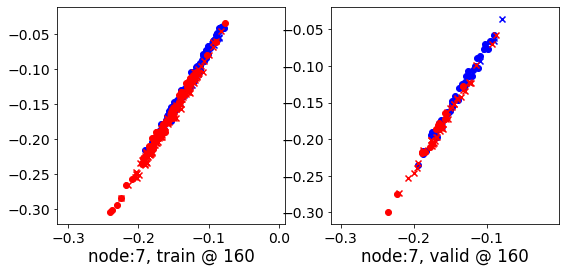

160 	 8 	 0.69205576 	 0.69168299 	 0.93913215 	 0.94450772 	 0.94030261 	 0.94597191


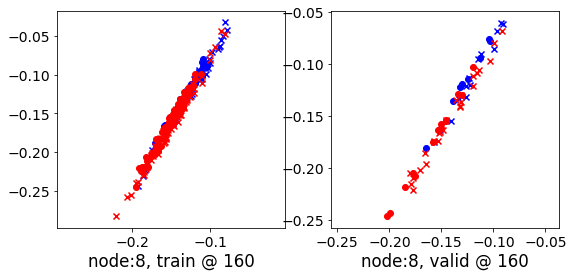

160 	 9 	 0.74671948 	 0.75259477 	 0.94427931 	 0.94917786 	 0.89082289 	 0.88973027


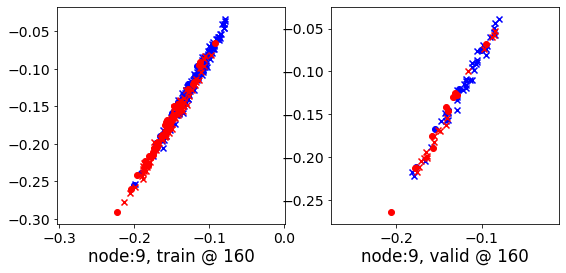

Aggregating on epoch: 162...
Aggregating on epoch: 164...
Aggregating on epoch: 166...
Aggregating on epoch: 168...
Aggregating on epoch: 170...
Aggregating on epoch: 172...
Aggregating on epoch: 174...
Aggregating on epoch: 176...
Aggregating on epoch: 178...
Aggregating on epoch: 180...
180 	 0 	 0.66687608 	 0.66665125 	 0.90303463 	 0.90262538 	 0.93195212 	 0.92912132


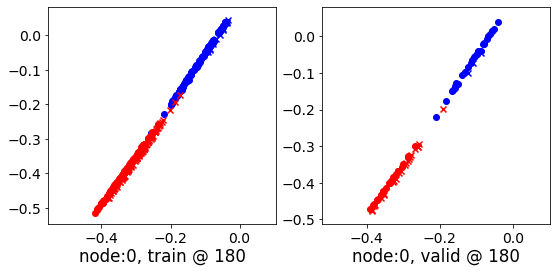

180 	 1 	 0.69542414 	 0.69799352 	 0.94160557 	 0.94242030 	 0.93959546 	 0.93757397


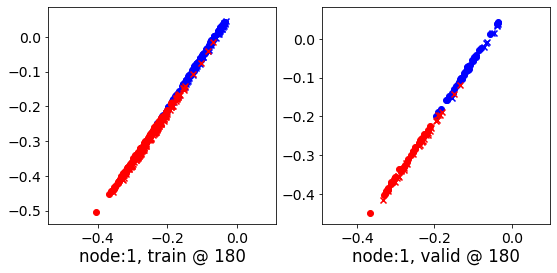

180 	 2 	 0.65977436 	 0.65367573 	 0.90584958 	 0.90344596 	 0.94160569 	 0.94291741


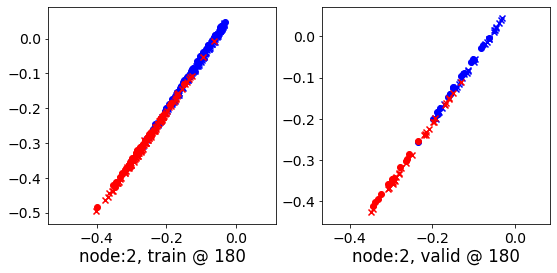

180 	 3 	 0.50078440 	 0.45916635 	 0.75580317 	 0.71929699 	 0.95228404 	 0.95327783


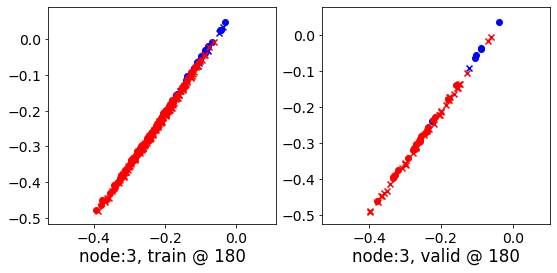

180 	 4 	 0.75243306 	 0.75485522 	 0.93527901 	 0.93554354 	 0.87674212 	 0.87383550


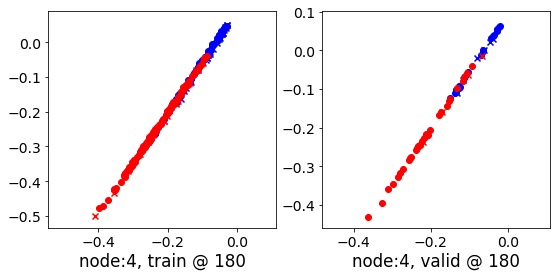

180 	 5 	 0.65332371 	 0.65365428 	 0.91332591 	 0.91660321 	 0.95490330 	 0.95609611


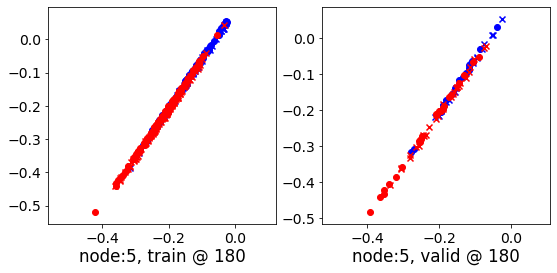

180 	 6 	 0.67782724 	 0.67346954 	 0.93712747 	 0.93389070 	 0.95317864 	 0.95356834


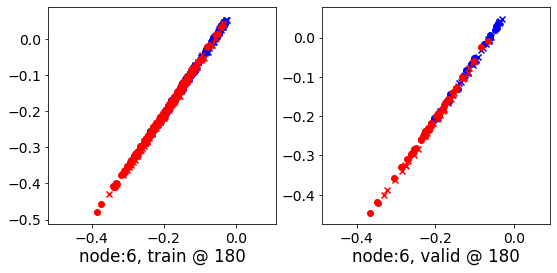

180 	 7 	 0.66141993 	 0.65827668 	 0.91885853 	 0.91956156 	 0.95241863 	 0.95443207


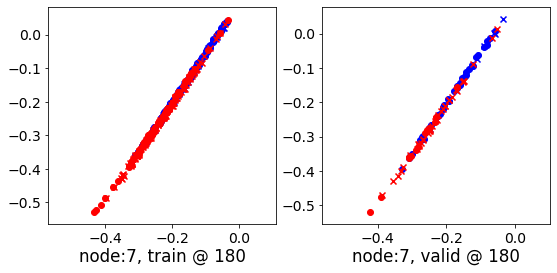

180 	 8 	 0.68802869 	 0.68632662 	 0.93541044 	 0.94016784 	 0.94080096 	 0.94698840


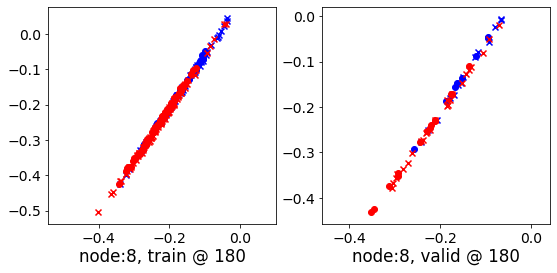

180 	 9 	 0.75185055 	 0.75610638 	 0.94325471 	 0.94829422 	 0.88503557 	 0.88533503


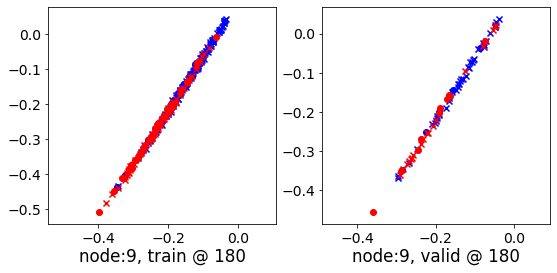

Aggregating on epoch: 182...
Aggregating on epoch: 184...
Aggregating on epoch: 186...
Aggregating on epoch: 188...
Aggregating on epoch: 190...
Aggregating on epoch: 192...
Aggregating on epoch: 194...
Aggregating on epoch: 196...
Aggregating on epoch: 198...
Aggregating on epoch: 200...
200 	 0 	 0.55792987 	 0.54667747 	 0.78859186 	 0.77817470 	 0.92802572 	 0.92464441


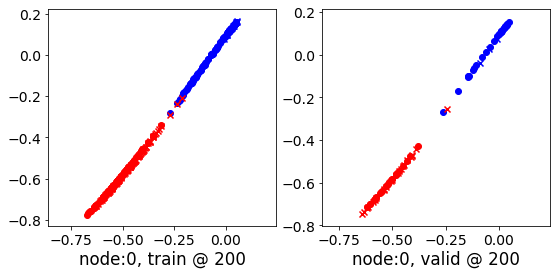

200 	 1 	 0.66850001 	 0.66623551 	 0.91047370 	 0.90713078 	 0.93631059 	 0.93404245


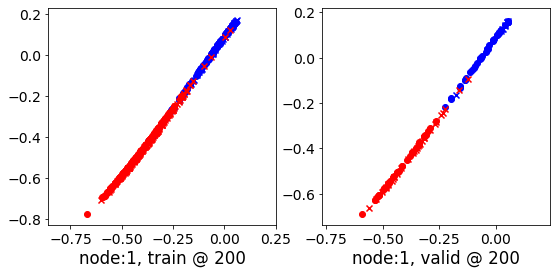

200 	 2 	 0.53481221 	 0.51953393 	 0.77822775 	 0.76931715 	 0.94112575 	 0.94293040


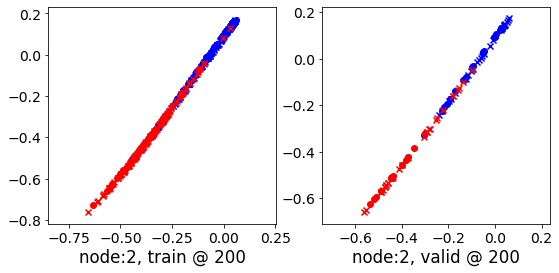

200 	 3 	 0.37867063 	 0.30195349 	 0.62723172 	 0.56200480 	 0.95206308 	 0.95319849


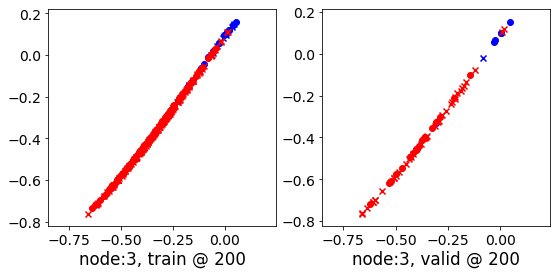

200 	 4 	 0.69802910 	 0.69947994 	 0.87356591 	 0.87369347 	 0.87183619 	 0.86736071


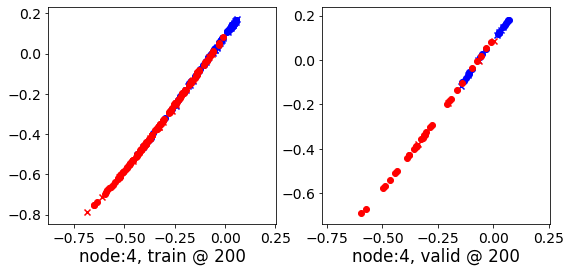

200 	 5 	 0.58860868 	 0.59429312 	 0.84645605 	 0.85711920 	 0.95454919 	 0.95597327


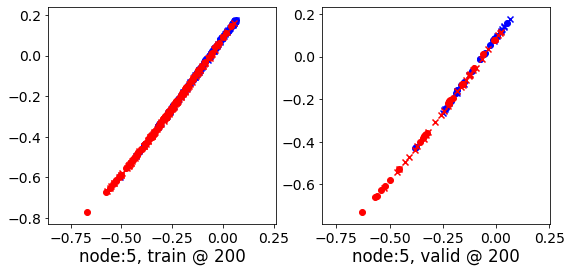

200 	 6 	 0.64601046 	 0.63576895 	 0.90104890 	 0.89207405 	 0.94942743 	 0.94945228


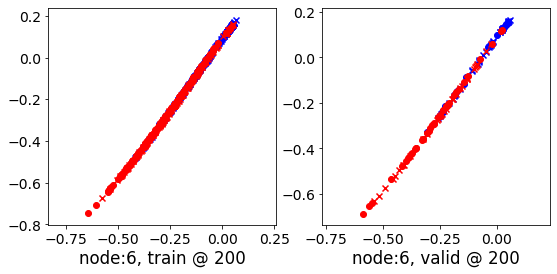

200 	 7 	 0.60486054 	 0.60190791 	 0.85688776 	 0.86174899 	 0.94765490 	 0.95298827


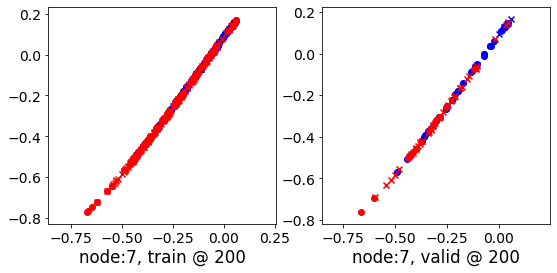

200 	 8 	 0.67140967 	 0.66396284 	 0.91801071 	 0.91849744 	 0.94070679 	 0.94768178


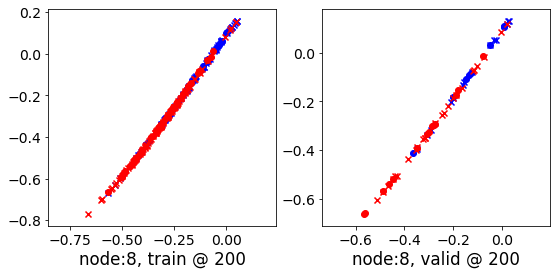

200 	 9 	 0.76592320 	 0.76257515 	 0.93579417 	 0.94242918 	 0.86460149 	 0.87300122


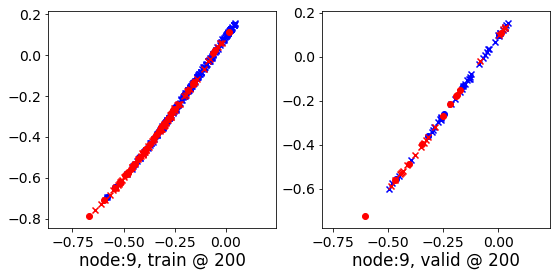

Aggregating on epoch: 202...
Aggregating on epoch: 204...
Aggregating on epoch: 206...
Aggregating on epoch: 208...
Aggregating on epoch: 210...
Aggregating on epoch: 212...
Aggregating on epoch: 214...
Aggregating on epoch: 216...
Aggregating on epoch: 218...
Aggregating on epoch: 220...
220 	 0 	 0.34510827 	 0.32748520 	 0.56155688 	 0.54288089 	 0.91396731 	 0.90854287


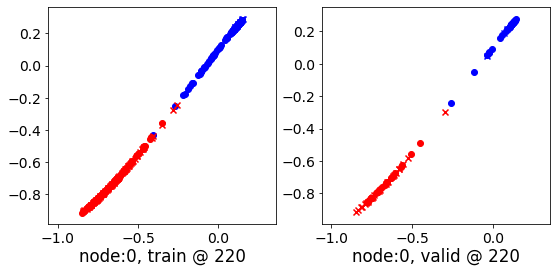

220 	 1 	 0.58223456 	 0.56865853 	 0.80791032 	 0.79364747 	 0.92198569 	 0.91813612


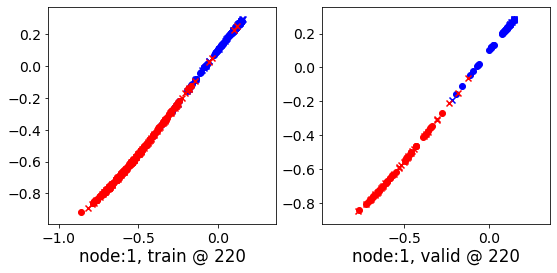

220 	 2 	 0.33436269 	 0.30000299 	 0.57533956 	 0.54960442 	 0.93743616 	 0.94274861


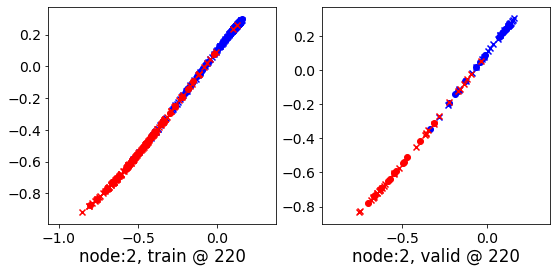

220 	 3 	 0.27682835 	 0.17486688 	 0.51069403 	 0.43518665 	 0.95168996 	 0.95346695


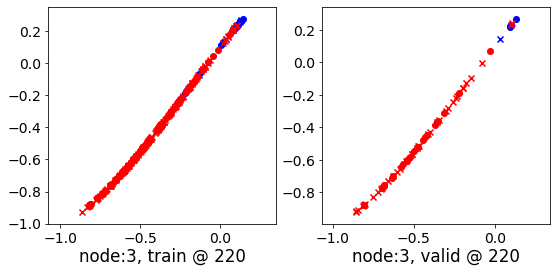

220 	 4 	 0.59250796 	 0.58637291 	 0.75981188 	 0.75190890 	 0.86744761 	 0.85868317


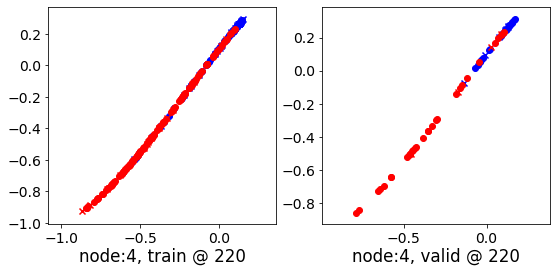

220 	 5 	 0.52214235 	 0.54161274 	 0.77839053 	 0.80514795 	 0.95232028 	 0.95668238


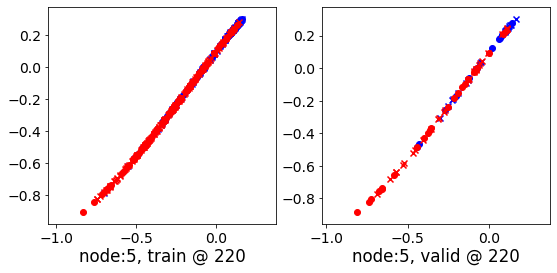

220 	 6 	 0.58292735 	 0.56810391 	 0.83519185 	 0.82047367 	 0.94714677 	 0.94551694


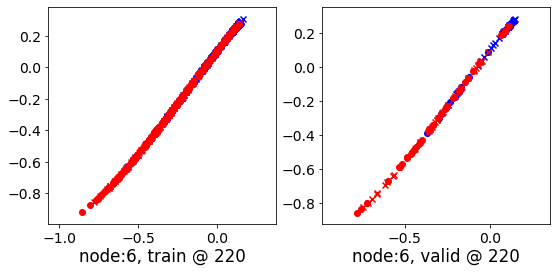

220 	 7 	 0.56490463 	 0.57546568 	 0.79955363 	 0.82942355 	 0.93471396 	 0.94710505


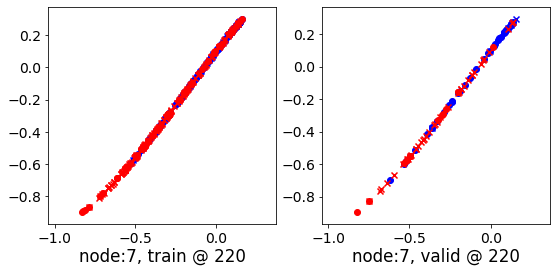

220 	 8 	 0.63079292 	 0.60709649 	 0.87562078 	 0.86266214 	 0.93919206 	 0.94871283


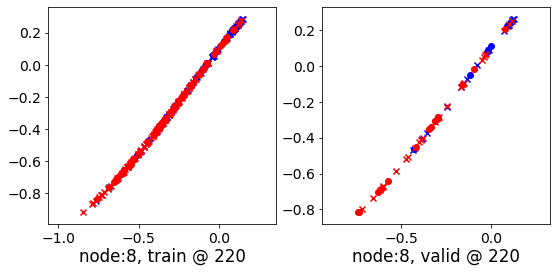

220 	 9 	 0.76905704 	 0.72887367 	 0.90673494 	 0.92092246 	 0.83300173 	 0.88519597


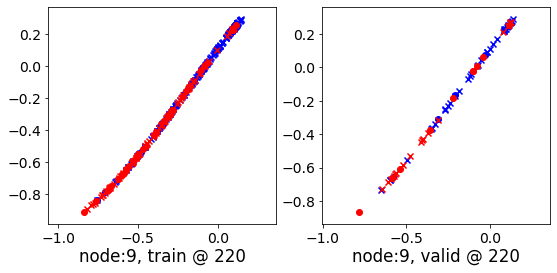

Aggregating on epoch: 222...
Aggregating on epoch: 224...
Aggregating on epoch: 226...
Aggregating on epoch: 228...
Aggregating on epoch: 230...
Aggregating on epoch: 232...
Aggregating on epoch: 234...
Aggregating on epoch: 236...
Aggregating on epoch: 238...
Aggregating on epoch: 240...
240 	 0 	 0.13064310 	 0.11990669 	 0.32286033 	 0.30741528 	 0.88734293 	 0.88065577


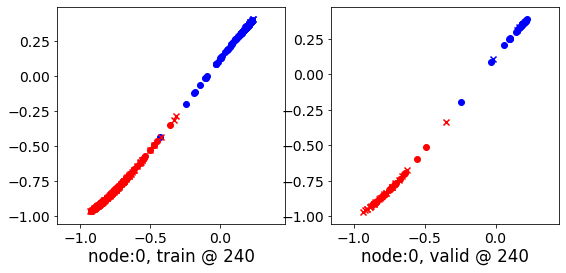

240 	 1 	 0.42471927 	 0.39226317 	 0.62697911 	 0.59445953 	 0.90091348 	 0.89534354


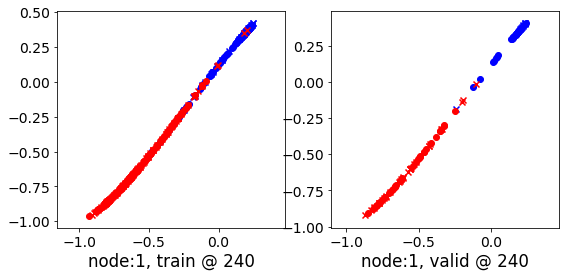

240 	 2 	 0.19999486 	 0.14392820 	 0.43726540 	 0.39364079 	 0.93165118 	 0.94285977


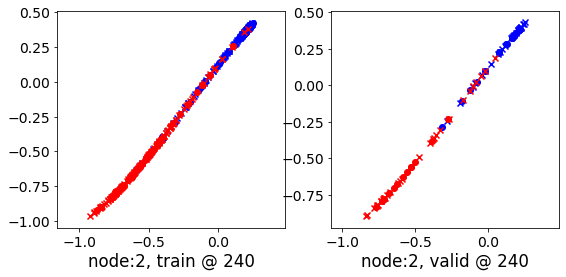

240 	 3 	 0.24460489 	 0.13143328 	 0.46622151 	 0.39065400 	 0.95047253 	 0.95236790


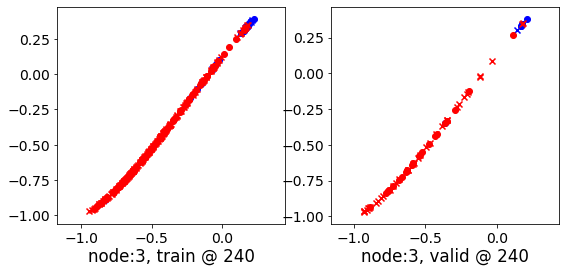

240 	 4 	 0.51174122 	 0.48988867 	 0.67361611 	 0.64587694 	 0.86378342 	 0.84913546


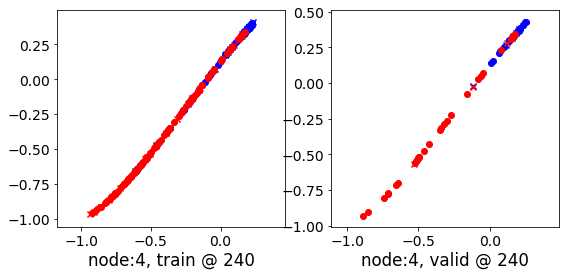

240 	 5 	 0.50523543 	 0.53226656 	 0.75599182 	 0.79762673 	 0.94755399 	 0.95850736


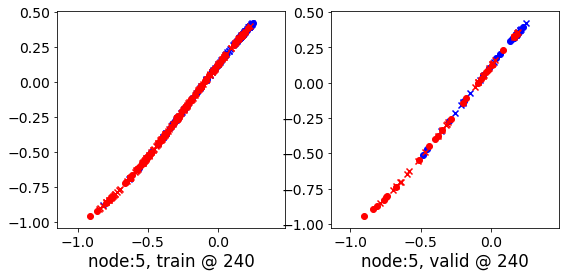

240 	 6 	 0.51318991 	 0.48327488 	 0.76316589 	 0.74063629 	 0.94732422 	 0.95050859


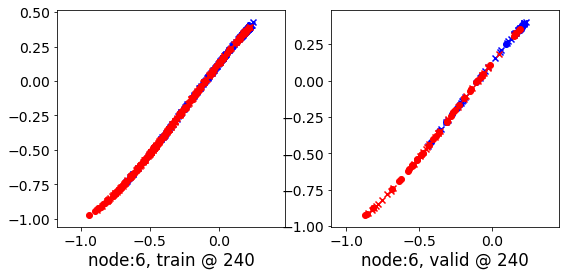

240 	 7 	 0.57754791 	 0.59317690 	 0.78496951 	 0.83590931 	 0.90819323 	 0.93587959


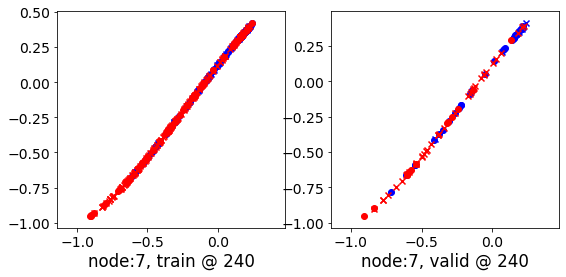

240 	 8 	 0.59526426 	 0.55082619 	 0.83584589 	 0.80950391 	 0.93568063 	 0.95182490


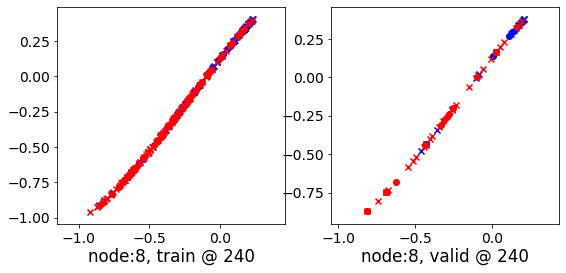

240 	 9 	 0.70693064 	 0.63468617 	 0.84519643 	 0.88178325 	 0.83539051 	 0.94024426


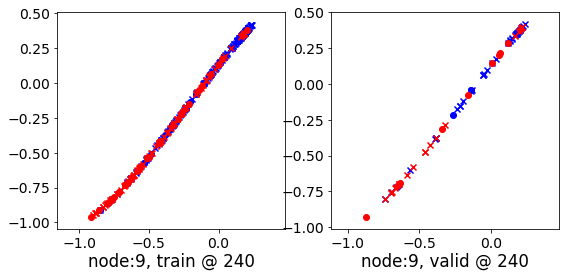

Aggregating on epoch: 242...
Aggregating on epoch: 244...
Aggregating on epoch: 246...
Aggregating on epoch: 248...
Aggregating on epoch: 250...
Aggregating on epoch: 252...
Aggregating on epoch: 254...
Aggregating on epoch: 256...
Aggregating on epoch: 258...
Aggregating on epoch: 260...
260 	 0 	 0.01819757 	 0.01371437 	 0.17554955 	 0.16430801 	 0.85217571 	 0.84374082


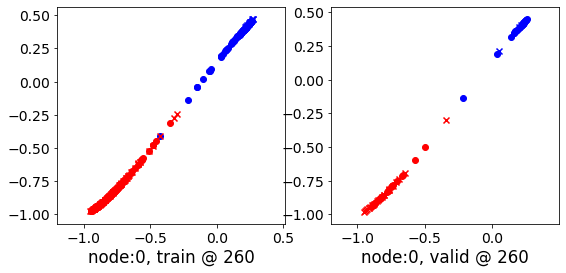

260 	 1 	 0.24506935 	 0.19341105 	 0.43954104 	 0.38876116 	 0.89491129 	 0.88849729


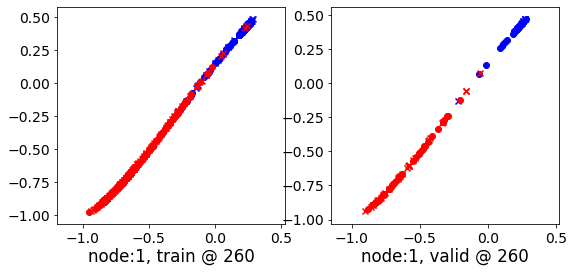

260 	 2 	 0.16544667 	 0.09446982 	 0.39997241 	 0.34524736 	 0.92950445 	 0.94392473


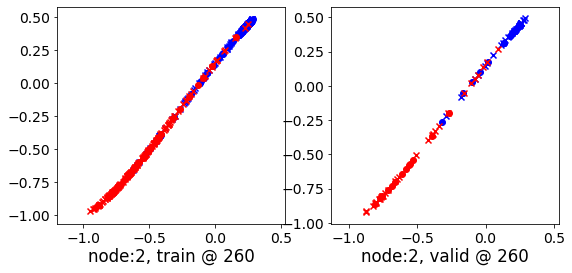

260 	 3 	 0.24179512 	 0.12585422 	 0.45787781 	 0.38279679 	 0.94775766 	 0.95008975


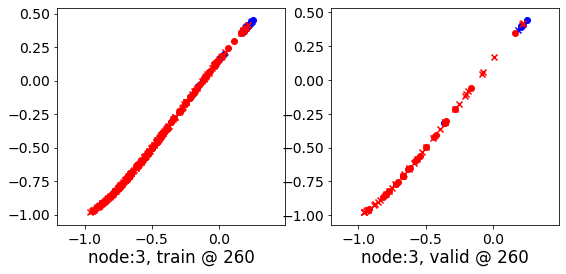

260 	 4 	 0.48919243 	 0.46439022 	 0.64328521 	 0.61113852 	 0.86012006 	 0.83989549


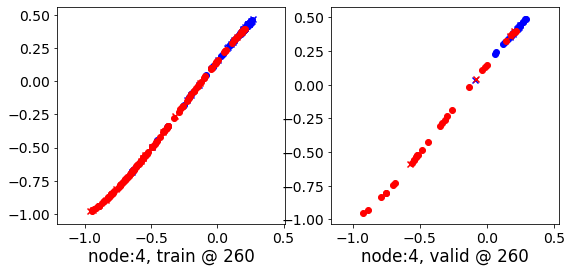

260 	 5 	 0.49251318 	 0.52354074 	 0.74347788 	 0.79335982 	 0.94436300 	 0.96296626


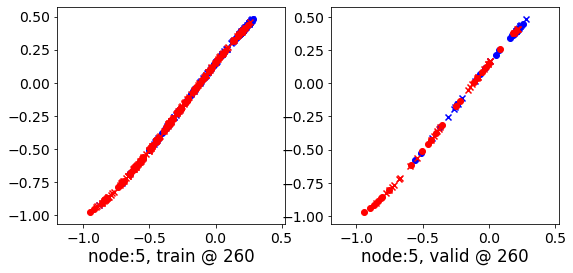

260 	 6 	 0.49950093 	 0.44725609 	 0.73656088 	 0.70646131 	 0.94713837 	 0.95235240


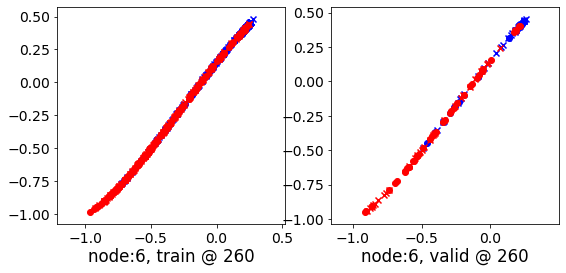

260 	 7 	 0.59205240 	 0.58382851 	 0.78181100 	 0.82549971 	 0.88530773 	 0.93481839


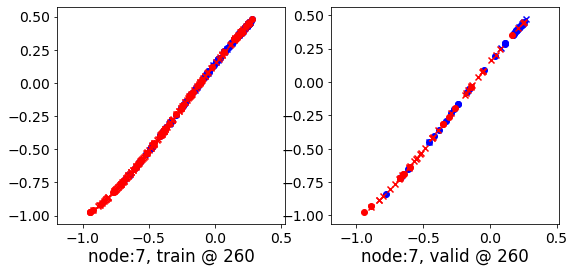

260 	 8 	 0.57365358 	 0.51953477 	 0.81279069 	 0.78126419 	 0.93408662 	 0.95487660


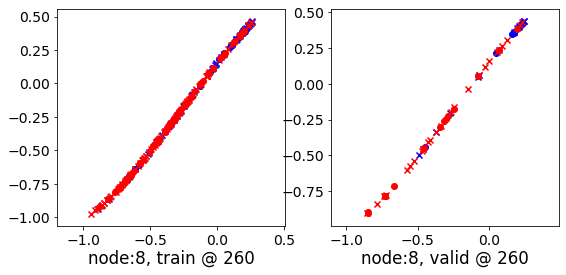

260 	 9 	 0.65151000 	 0.62840873 	 0.78866476 	 0.86079854 	 0.83446395 	 0.92553699


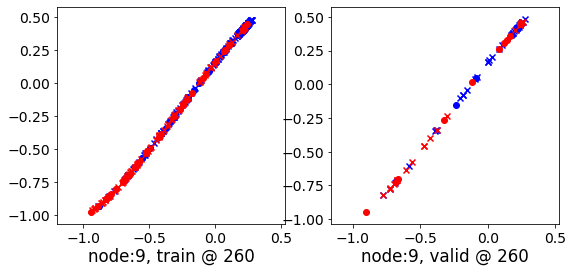

Aggregating on epoch: 262...
Aggregating on epoch: 264...
Aggregating on epoch: 266...
Aggregating on epoch: 268...
Aggregating on epoch: 270...
Aggregating on epoch: 272...
Aggregating on epoch: 274...
Aggregating on epoch: 276...
Aggregating on epoch: 278...
Aggregating on epoch: 280...
280 	 0 	 -0.01679496 	 -0.02122966 	 0.10386731 	 0.09404948 	 0.81816757 	 0.80842632


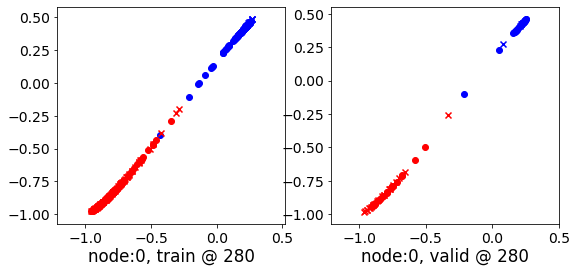

280 	 1 	 0.13135040 	 0.05840465 	 0.32101387 	 0.25450674 	 0.89571232 	 0.88924927


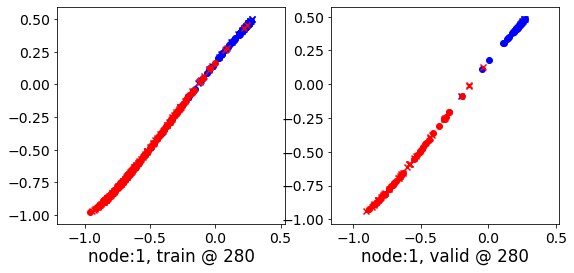

280 	 2 	 0.15871206 	 0.08293954 	 0.39334112 	 0.33362046 	 0.92917979 	 0.94382811


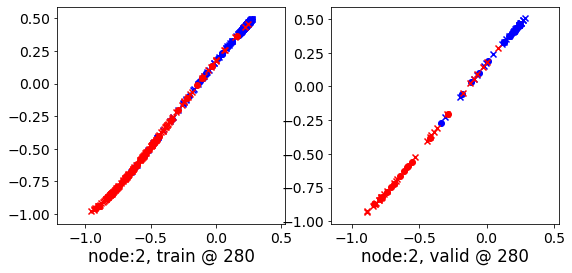

280 	 3 	 0.22861144 	 0.12602523 	 0.45154777 	 0.38169077 	 0.94423664 	 0.94881272


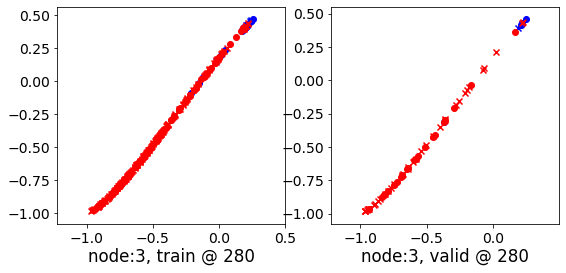

280 	 4 	 0.47381139 	 0.45576435 	 0.62157643 	 0.59639567 	 0.85737675 	 0.83377850


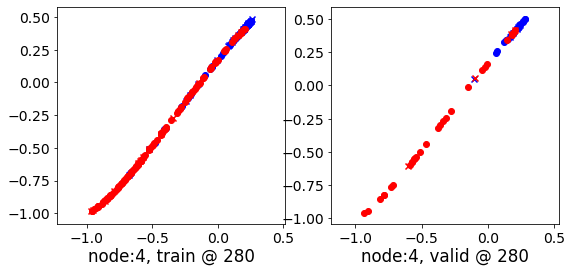

280 	 5 	 0.49037308 	 0.51623487 	 0.73169929 	 0.78701466 	 0.94322777 	 0.96392697


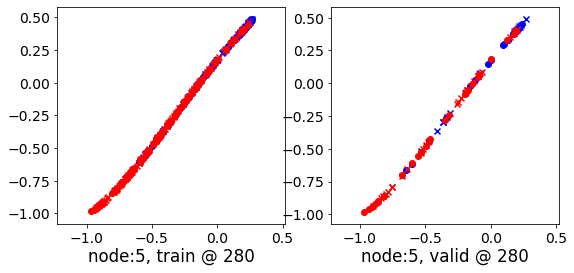

280 	 6 	 0.50214839 	 0.44057310 	 0.73643059 	 0.70128071 	 0.94647568 	 0.95385480


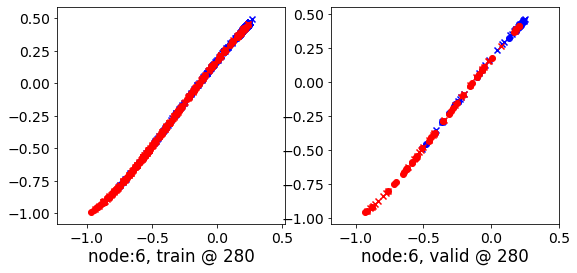

280 	 7 	 0.59686655 	 0.55833441 	 0.78145027 	 0.81461364 	 0.87855732 	 0.94942641


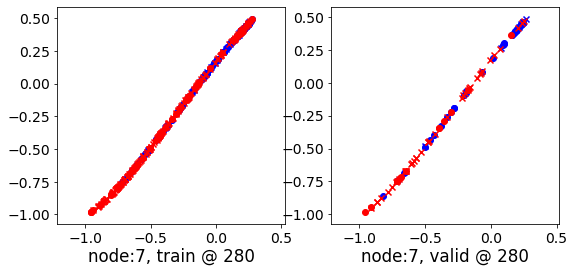

280 	 8 	 0.55819213 	 0.50331211 	 0.79772091 	 0.76494944 	 0.93343157 	 0.95478451


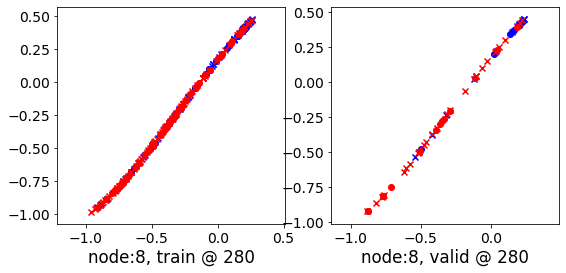

280 	 9 	 0.63530320 	 0.64615291 	 0.76718497 	 0.86990386 	 0.83155912 	 0.91689813


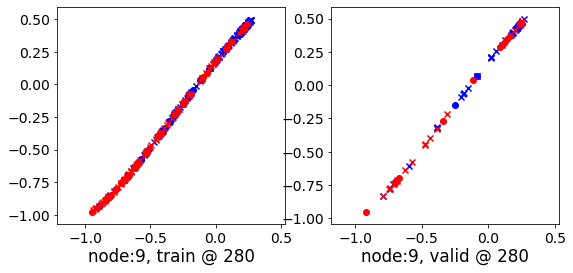

Aggregating on epoch: 282...
Aggregating on epoch: 284...
Aggregating on epoch: 286...
Aggregating on epoch: 288...
Aggregating on epoch: 290...
Aggregating on epoch: 292...
Aggregating on epoch: 294...
Aggregating on epoch: 296...
Aggregating on epoch: 298...
Aggregating on epoch: 300...
300 	 0 	 -0.02852704 	 -0.03493014 	 0.07136532 	 0.06169936 	 0.79954433 	 0.78977668


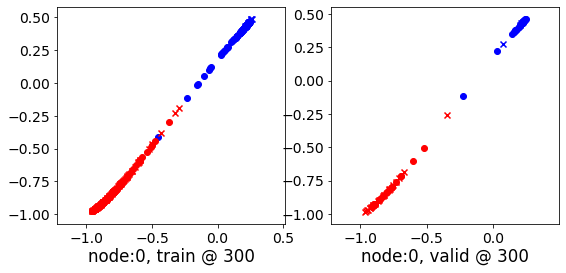

300 	 1 	 0.08369505 	 -0.01585020 	 0.26236641 	 0.18085597 	 0.89636630 	 0.88985336


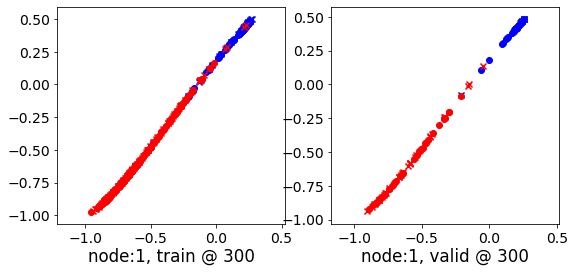

300 	 2 	 0.14956152 	 0.07100734 	 0.38445935 	 0.32018927 	 0.92856497 	 0.94232911


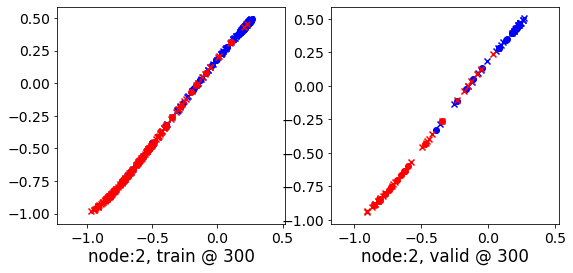

300 	 3 	 0.21568727 	 0.12255919 	 0.44541353 	 0.37879658 	 0.94161683 	 0.94938457


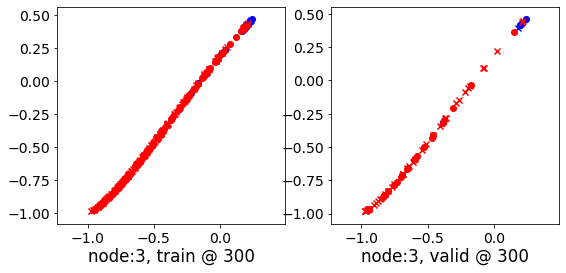

300 	 4 	 0.46420562 	 0.45288724 	 0.60797226 	 0.59063721 	 0.85577655 	 0.83089715


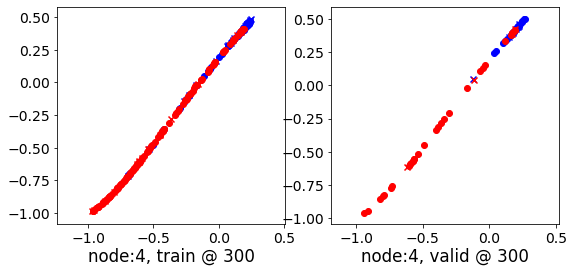

300 	 5 	 0.49269354 	 0.51732135 	 0.72704697 	 0.78868157 	 0.94323987 	 0.96450740


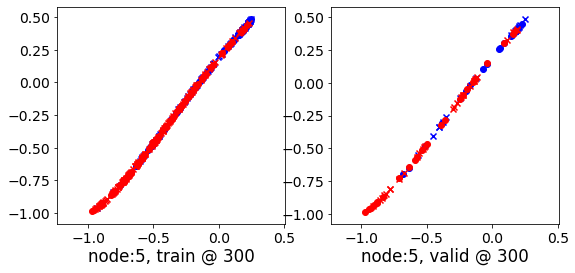

300 	 6 	 0.48973483 	 0.43385869 	 0.73239964 	 0.69494146 	 0.94547927 	 0.95422995


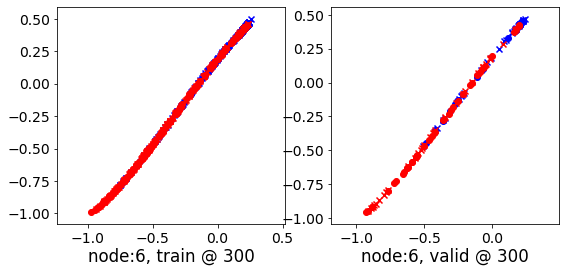

300 	 7 	 0.59669846 	 0.54519820 	 0.78248453 	 0.80924898 	 0.87947053 	 0.95719796


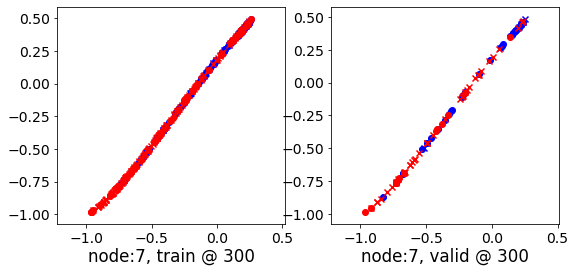

300 	 8 	 0.54790199 	 0.49335593 	 0.78693289 	 0.75463593 	 0.93262029 	 0.95442718


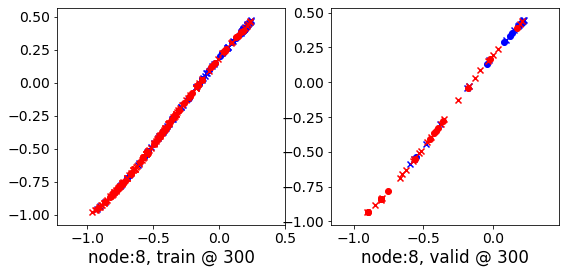

300 	 9 	 0.63255548 	 0.65334374 	 0.76040733 	 0.87454313 	 0.82730526 	 0.91434658


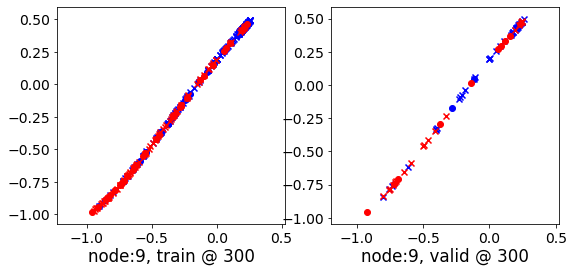

Aggregating on epoch: 302...
Aggregating on epoch: 304...
Aggregating on epoch: 306...
Aggregating on epoch: 308...
Aggregating on epoch: 310...
Aggregating on epoch: 312...
Aggregating on epoch: 314...
Aggregating on epoch: 316...
Aggregating on epoch: 318...
Aggregating on epoch: 320...
320 	 0 	 -0.03690774 	 -0.04629318 	 0.05610729 	 0.04591973 	 0.79491311 	 0.78536010


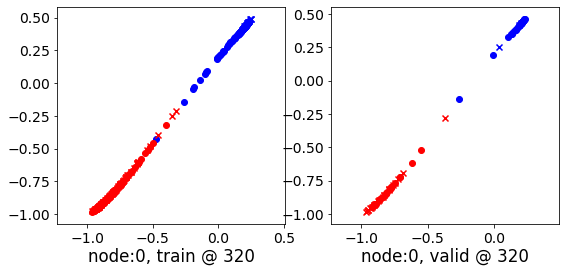

320 	 1 	 0.07116362 	 -0.05485508 	 0.23691933 	 0.14203671 	 0.89625859 	 0.89003897


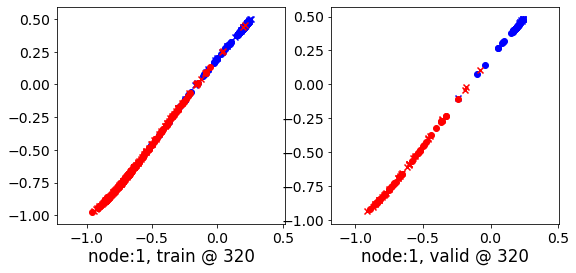

320 	 2 	 0.14477080 	 0.06760770 	 0.37662727 	 0.31535298 	 0.92778349 	 0.94089246


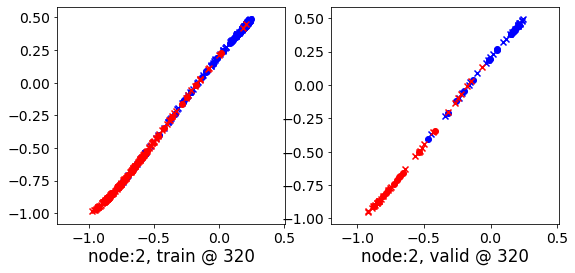

320 	 3 	 0.20304081 	 0.11534852 	 0.43881565 	 0.37296784 	 0.94041884 	 0.95076650


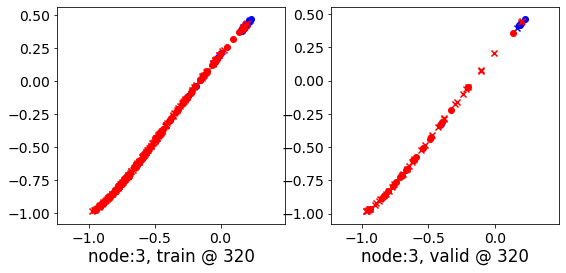

320 	 4 	 0.45297617 	 0.44831485 	 0.59740722 	 0.58474827 	 0.85457081 	 0.82958061


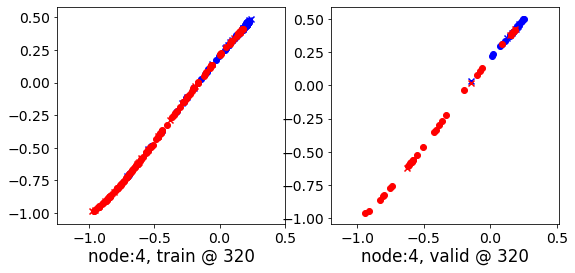

320 	 5 	 0.48714834 	 0.51758337 	 0.72308731 	 0.78925687 	 0.94340777 	 0.96482068


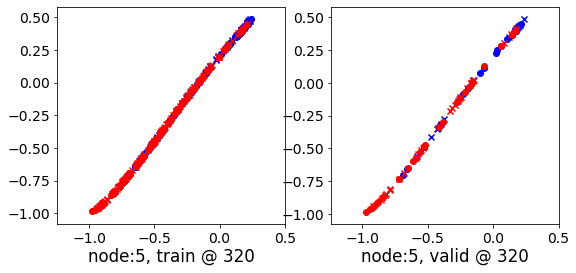

320 	 6 	 0.48239028 	 0.42780614 	 0.72973633 	 0.68909550 	 0.94457811 	 0.95443654


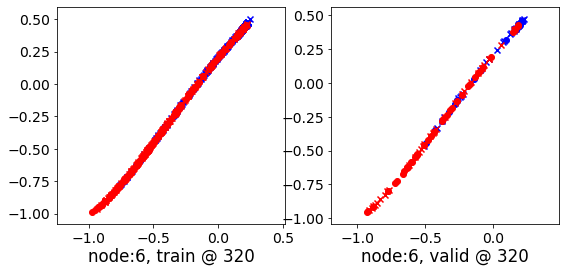

320 	 7 	 0.59715652 	 0.54116219 	 0.78284067 	 0.80402303 	 0.87979627 	 0.95600802


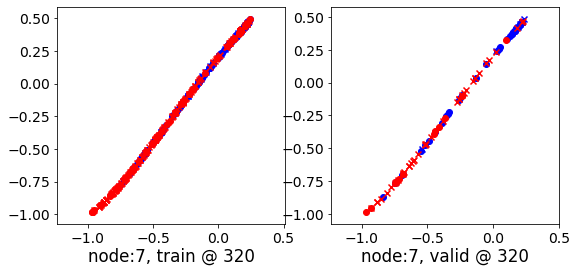

320 	 8 	 0.54343981 	 0.48760796 	 0.78034174 	 0.74850523 	 0.93132776 	 0.95404446


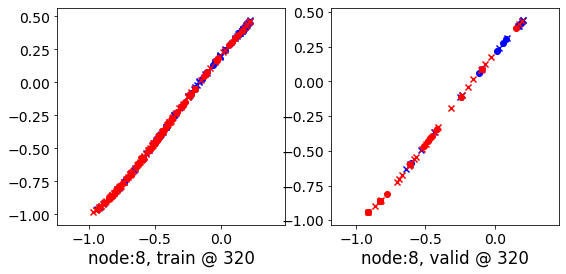

320 	 9 	 0.62968129 	 0.66557908 	 0.75568783 	 0.88288516 	 0.82247788 	 0.91045326


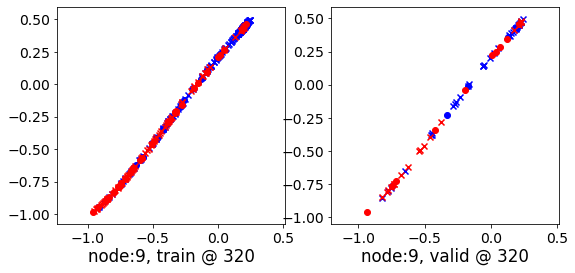

Aggregating on epoch: 322...
Aggregating on epoch: 324...
Aggregating on epoch: 326...
Aggregating on epoch: 328...
Aggregating on epoch: 330...
Aggregating on epoch: 332...
Aggregating on epoch: 334...
Aggregating on epoch: 336...
Aggregating on epoch: 338...
Aggregating on epoch: 340...
340 	 0 	 -0.04281818 	 -0.05376164 	 0.04861561 	 0.03785916 	 0.79481018 	 0.78476799


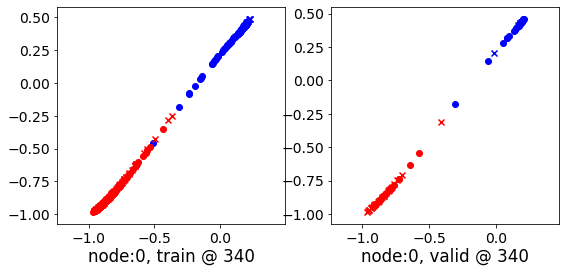

340 	 1 	 0.06619021 	 -0.07632870 	 0.22533531 	 0.12078827 	 0.89554363 	 0.89026415


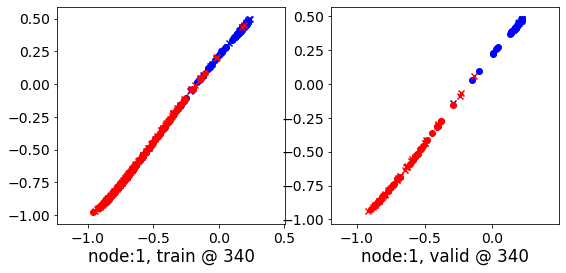

340 	 2 	 0.15170375 	 0.06881705 	 0.37467605 	 0.31548193 	 0.92740184 	 0.93981206


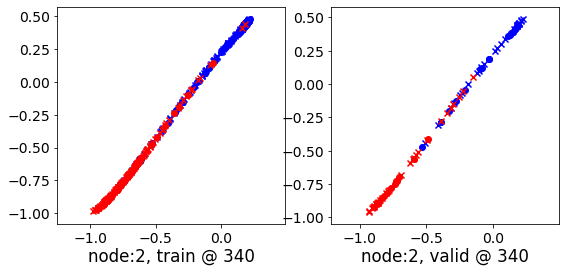

340 	 3 	 0.19327578 	 0.10875508 	 0.43314743 	 0.36753711 	 0.93945259 	 0.95192921


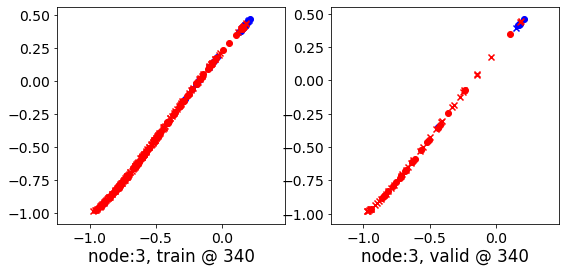

340 	 4 	 0.44072747 	 0.44185966 	 0.58734143 	 0.57799381 	 0.85356349 	 0.82928133


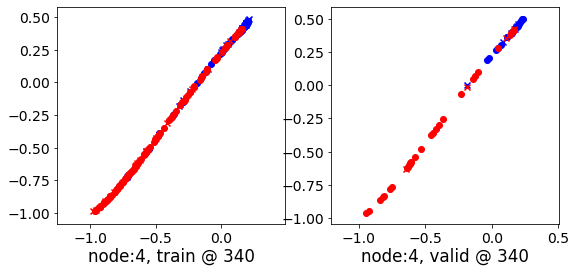

340 	 5 	 0.47984117 	 0.51656353 	 0.71967047 	 0.78818554 	 0.94341415 	 0.96476918


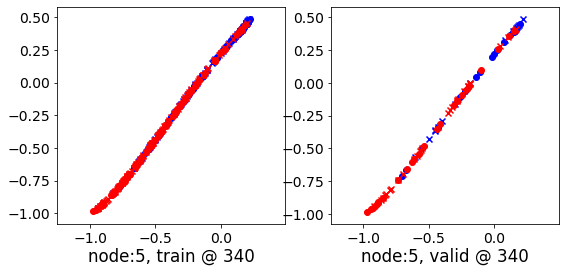

340 	 6 	 0.47837818 	 0.42144501 	 0.72707313 	 0.68309569 	 0.94410169 	 0.95479786


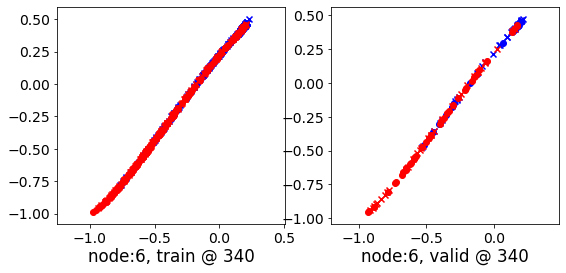

340 	 7 	 0.59931576 	 0.53842330 	 0.78344858 	 0.80124772 	 0.87971586 	 0.95597160


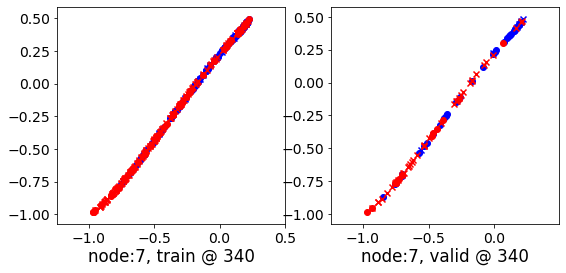

340 	 8 	 0.54319310 	 0.48475456 	 0.77672786 	 0.74510479 	 0.92911011 	 0.95349741


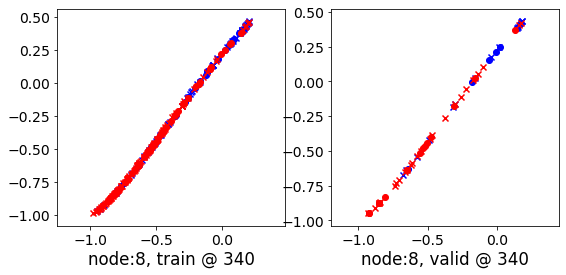

340 	 9 	 0.62824196 	 0.68531293 	 0.75367904 	 0.89523375 	 0.82060939 	 0.90306801


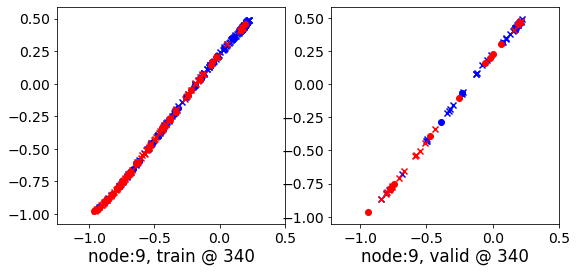

Aggregating on epoch: 342...
Aggregating on epoch: 344...
Aggregating on epoch: 346...
Aggregating on epoch: 348...
Aggregating on epoch: 350...
Aggregating on epoch: 352...
Aggregating on epoch: 354...
Aggregating on epoch: 356...
Aggregating on epoch: 358...
Aggregating on epoch: 360...
360 	 0 	 -0.04685698 	 -0.05700903 	 0.04502262 	 0.03387894 	 0.79553640 	 0.78403515


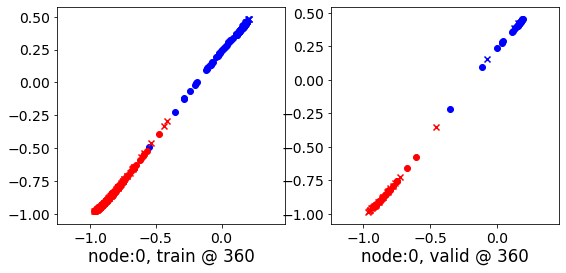

360 	 1 	 0.05462870 	 -0.08795305 	 0.21795309 	 0.10980688 	 0.89450538 	 0.89090711


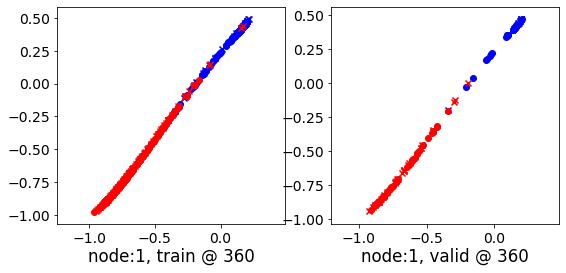

360 	 2 	 0.15440235 	 0.06696290 	 0.37353343 	 0.31285793 	 0.92719406 	 0.93904221


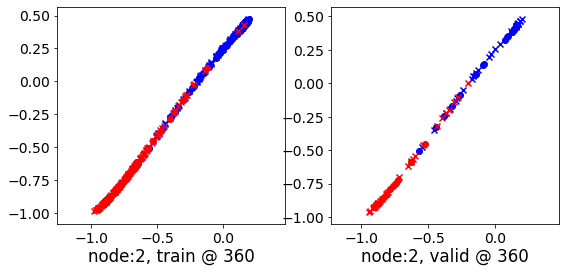

360 	 3 	 0.18639582 	 0.10328135 	 0.42807519 	 0.36308709 	 0.93848550 	 0.95295292


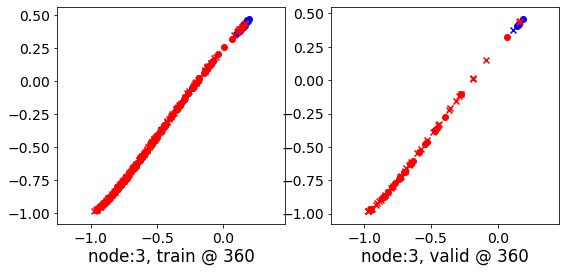

360 	 4 	 0.43055815 	 0.44068128 	 0.57795215 	 0.57639885 	 0.85280281 	 0.82886475


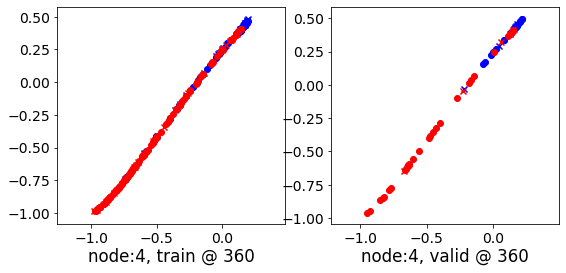

360 	 5 	 0.47293794 	 0.51330358 	 0.71692687 	 0.78493482 	 0.94337958 	 0.96477842


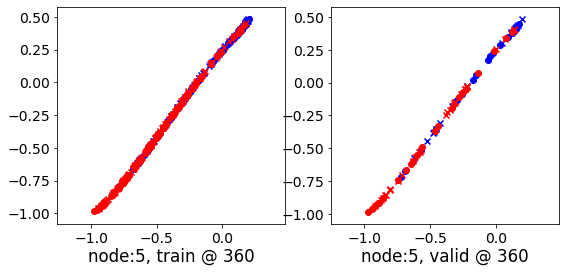

360 	 6 	 0.47614312 	 0.41521120 	 0.72499794 	 0.67718720 	 0.94378209 	 0.95512319


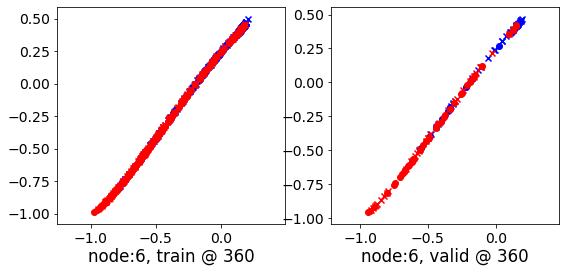

360 	 7 	 0.60212934 	 0.53470850 	 0.78397417 	 0.79889804 	 0.87926608 	 0.95733672


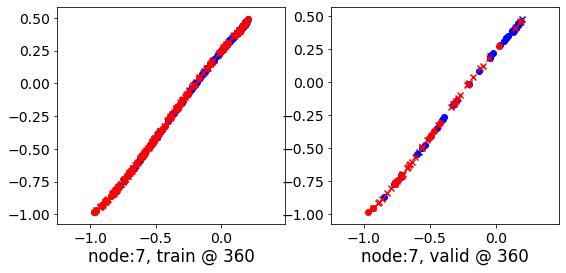

360 	 8 	 0.54492503 	 0.48162776 	 0.77482939 	 0.74223804 	 0.92610747 	 0.95375746


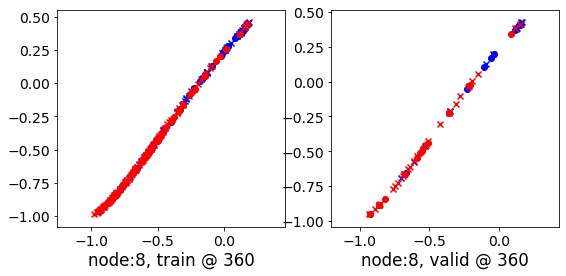

360 	 9 	 0.62585092 	 0.71246481 	 0.75423801 	 0.91216570 	 0.82210654 	 0.89284807


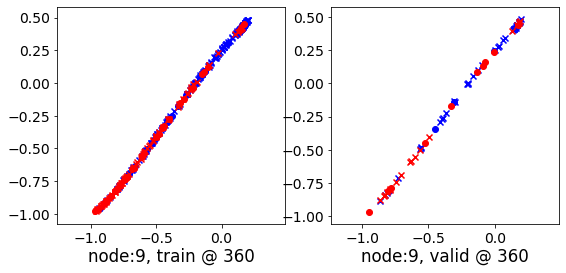

Aggregating on epoch: 362...
Aggregating on epoch: 364...
Aggregating on epoch: 366...
Aggregating on epoch: 368...
Aggregating on epoch: 370...
Aggregating on epoch: 372...
Aggregating on epoch: 374...
Aggregating on epoch: 376...
Aggregating on epoch: 378...
Aggregating on epoch: 380...
380 	 0 	 -0.04879685 	 -0.05609760 	 0.04339571 	 0.03228876 	 0.79592669 	 0.78153354


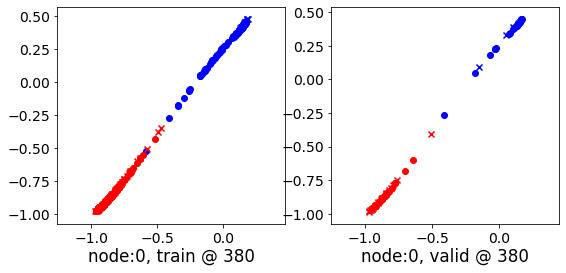

380 	 1 	 0.04664125 	 -0.09245376 	 0.21531026 	 0.10632177 	 0.89306200 	 0.89192271


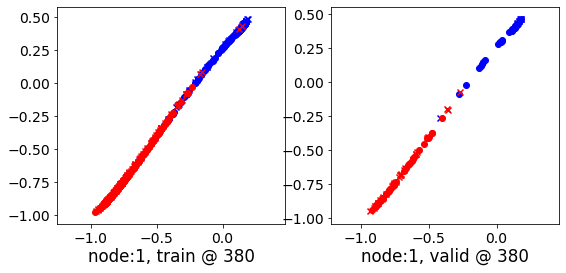

380 	 2 	 0.15016243 	 0.06574348 	 0.37246975 	 0.31066754 	 0.92668492 	 0.93807125


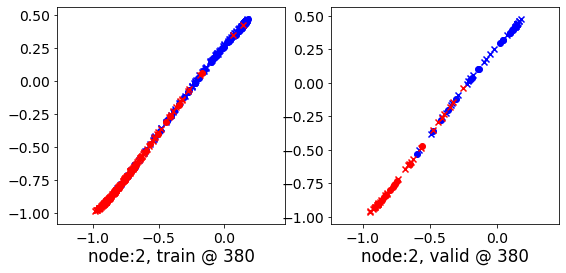

380 	 3 	 0.17977118 	 0.09802705 	 0.42194101 	 0.35839826 	 0.93724167 	 0.95351839


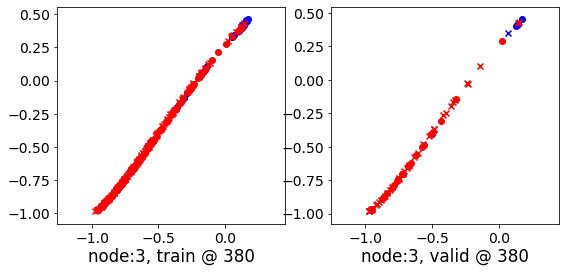

380 	 4 	 0.41967362 	 0.44075358 	 0.56811696 	 0.57724786 	 0.85293573 	 0.82964146


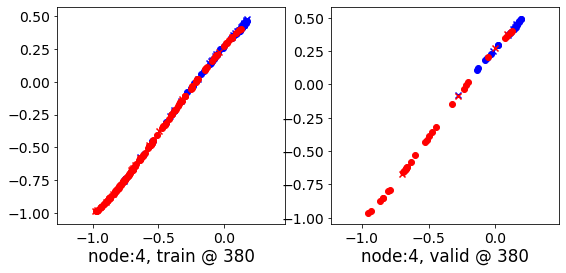

380 	 5 	 0.46721232 	 0.50756329 	 0.71457428 	 0.77879763 	 0.94295371 	 0.96438152


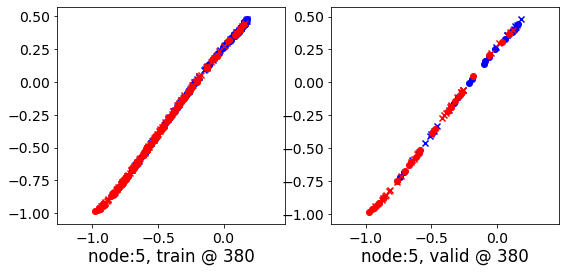

380 	 6 	 0.47366196 	 0.40830159 	 0.72319365 	 0.67102778 	 0.94340408 	 0.95587337


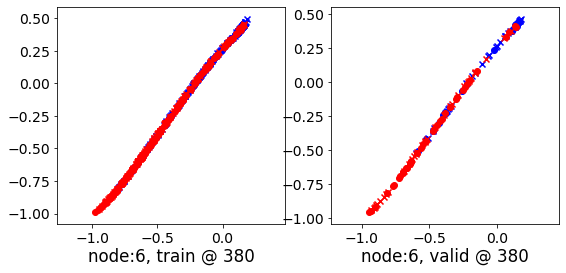

380 	 7 	 0.60296154 	 0.52560127 	 0.78339940 	 0.79189509 	 0.87698358 	 0.95944101


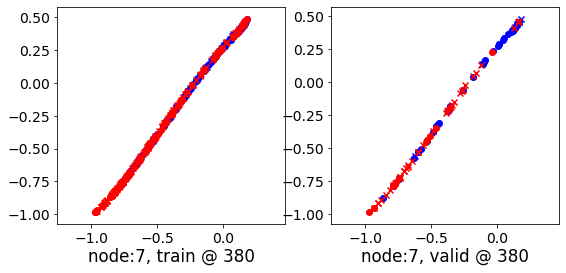

380 	 8 	 0.54493845 	 0.47677612 	 0.77396041 	 0.73991650 	 0.92324269 	 0.95628756


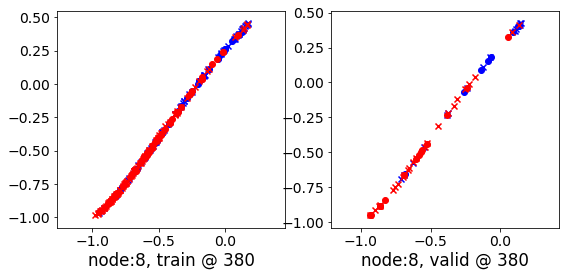

380 	 9 	 0.62352824 	 0.74913418 	 0.75799644 	 0.93858838 	 0.83274394 	 0.88260138


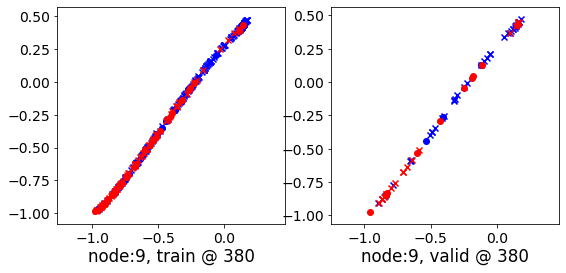

Aggregating on epoch: 382...
Aggregating on epoch: 384...
Aggregating on epoch: 386...
Aggregating on epoch: 388...
Aggregating on epoch: 390...
Aggregating on epoch: 392...
Aggregating on epoch: 394...
Aggregating on epoch: 396...
Aggregating on epoch: 398...
Aggregating on epoch: 400...
400 	 0 	 -0.05429203 	 -0.05828285 	 0.04020904 	 0.02955830 	 0.79520339 	 0.78098834


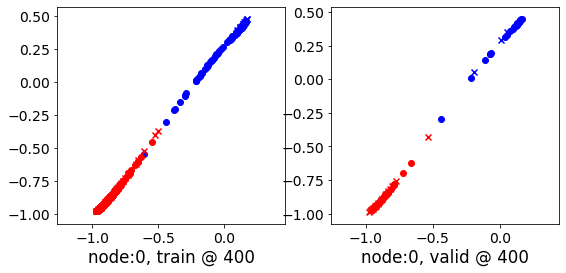

400 	 1 	 0.02944599 	 -0.09595014 	 0.20964395 	 0.10433833 	 0.89272863 	 0.89343566


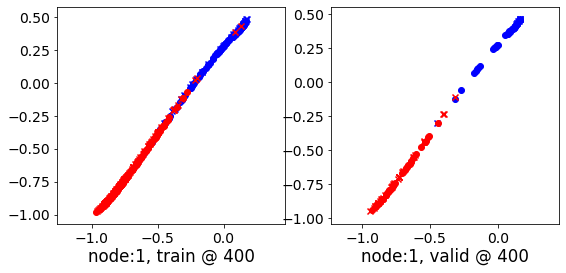

400 	 2 	 0.14796489 	 0.06423420 	 0.37170863 	 0.30911636 	 0.92656159 	 0.93802935


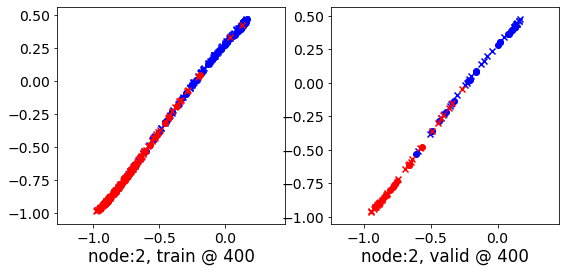

400 	 3 	 0.17725173 	 0.09425902 	 0.41877666 	 0.35581928 	 0.93629551 	 0.95470744


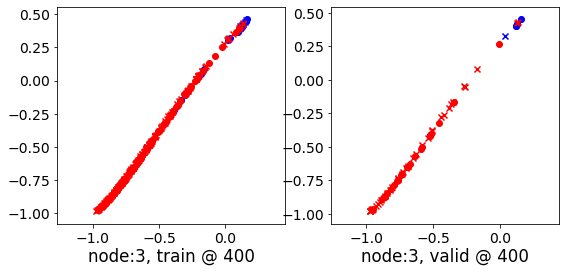

400 	 4 	 0.41452950 	 0.44449258 	 0.56153518 	 0.58187759 	 0.85261029 	 0.83053219


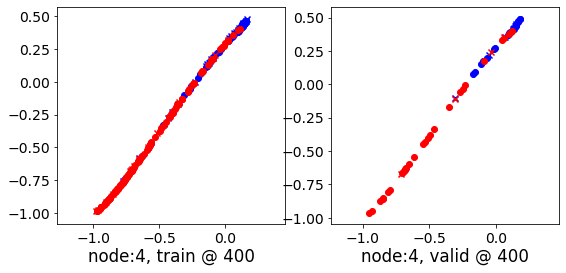

400 	 5 	 0.46470201 	 0.50492609 	 0.71336365 	 0.77670068 	 0.94316137 	 0.96492177


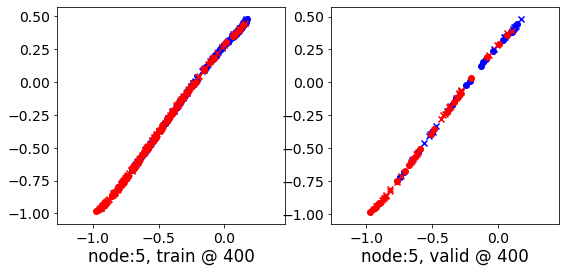

400 	 6 	 0.47290444 	 0.40298605 	 0.72205639 	 0.66646302 	 0.94255430 	 0.95662415


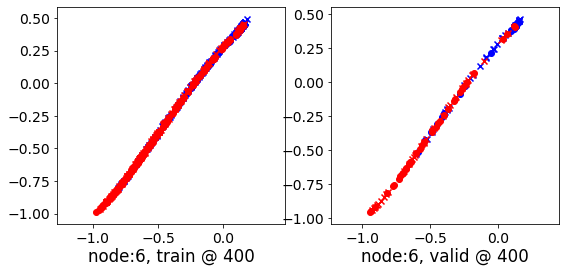

400 	 7 	 0.60278016 	 0.51926249 	 0.78283250 	 0.78864288 	 0.87581557 	 0.96252757


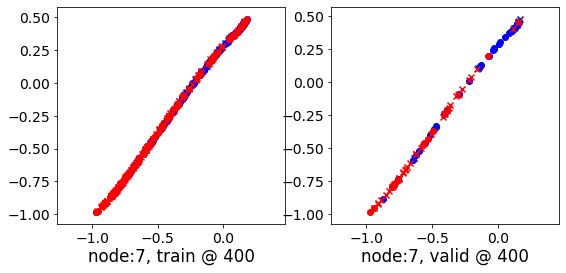

400 	 8 	 0.54669797 	 0.47045183 	 0.77383447 	 0.73783034 	 0.92270404 	 0.96052569


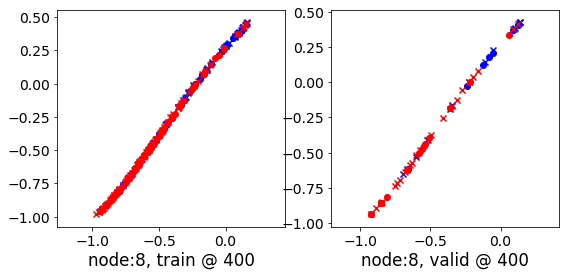

400 	 9 	 0.62756437 	 0.76404405 	 0.76004362 	 0.95578694 	 0.83567202 	 0.88489008


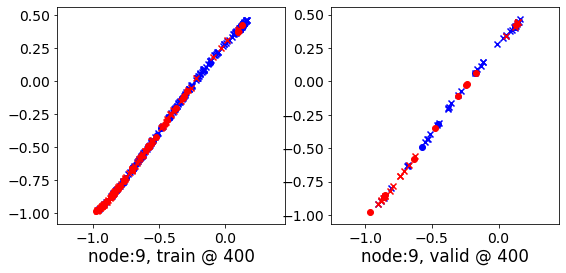

Aggregating on epoch: 402...
Aggregating on epoch: 404...
Aggregating on epoch: 406...
Aggregating on epoch: 408...
Aggregating on epoch: 410...
Aggregating on epoch: 412...
Aggregating on epoch: 414...
Aggregating on epoch: 416...
Aggregating on epoch: 418...
Aggregating on epoch: 420...
420 	 0 	 -0.05967643 	 -0.06267379 	 0.03672274 	 0.02652521 	 0.79347301 	 0.78234619


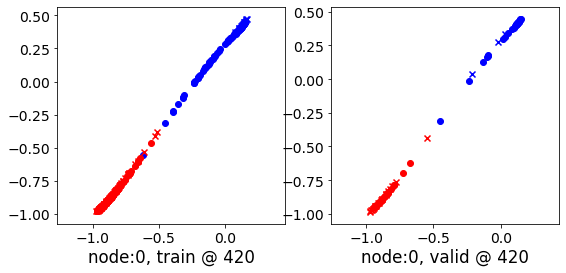

420 	 1 	 0.01663610 	 -0.10109206 	 0.20467533 	 0.09969531 	 0.89290929 	 0.89393455


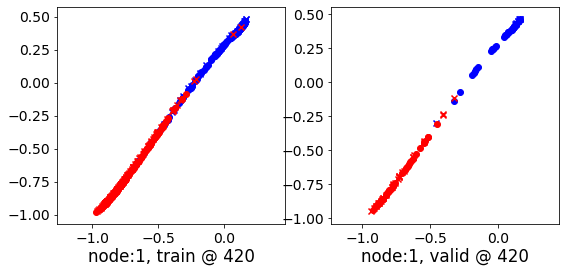

420 	 2 	 0.14884201 	 0.06369117 	 0.37087369 	 0.30836061 	 0.92647296 	 0.93781662


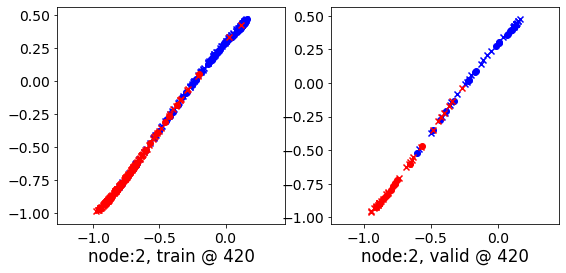

420 	 3 	 0.17753714 	 0.08913663 	 0.41776523 	 0.35310730 	 0.93546730 	 0.95711786


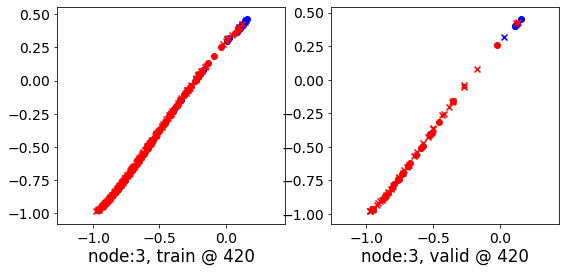

420 	 4 	 0.41284466 	 0.44781101 	 0.55825406 	 0.58503467 	 0.85197890 	 0.83037084


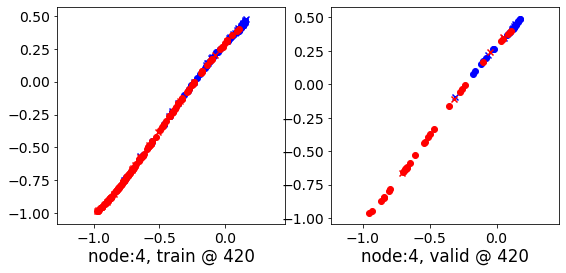

420 	 5 	 0.46376175 	 0.50459826 	 0.71286017 	 0.77671301 	 0.94352221 	 0.96526194


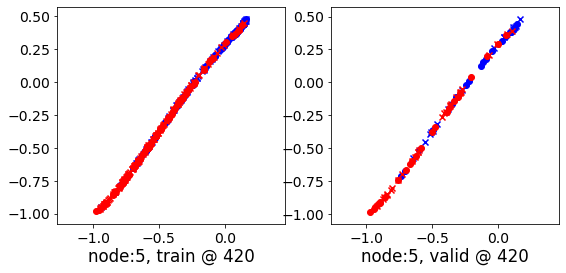

420 	 6 	 0.47295225 	 0.39972848 	 0.72118884 	 0.66444016 	 0.94167465 	 0.95785886


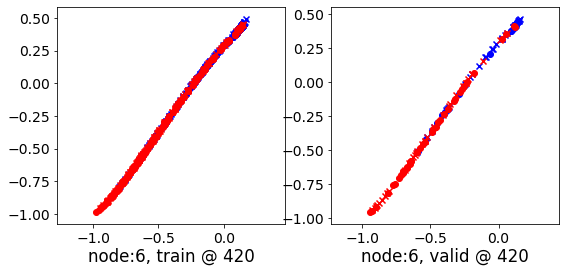

420 	 7 	 0.60216266 	 0.51868021 	 0.78248304 	 0.78965557 	 0.87563074 	 0.96412253


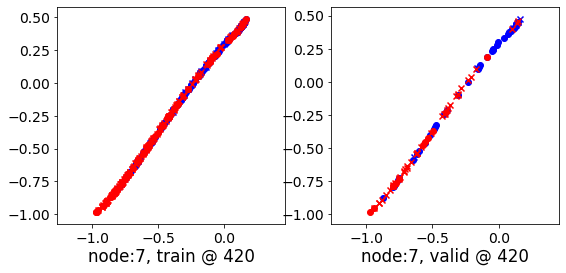

420 	 8 	 0.55565405 	 0.46751153 	 0.77507800 	 0.73546195 	 0.92341024 	 0.96109760


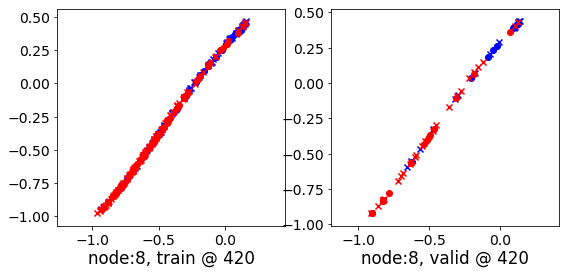

420 	 9 	 0.62763727 	 0.75478548 	 0.75853127 	 0.95163488 	 0.83229476 	 0.88999659


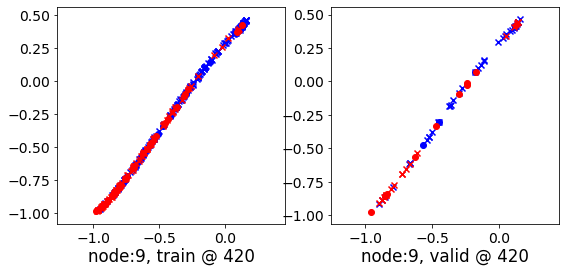

Aggregating on epoch: 422...
Aggregating on epoch: 424...
Aggregating on epoch: 426...
Aggregating on epoch: 428...
Aggregating on epoch: 430...
Aggregating on epoch: 432...
Aggregating on epoch: 434...
Aggregating on epoch: 436...
Aggregating on epoch: 438...
Aggregating on epoch: 440...
440 	 0 	 -0.06164890 	 -0.06568004 	 0.03401033 	 0.02425824 	 0.79120708 	 0.78308547


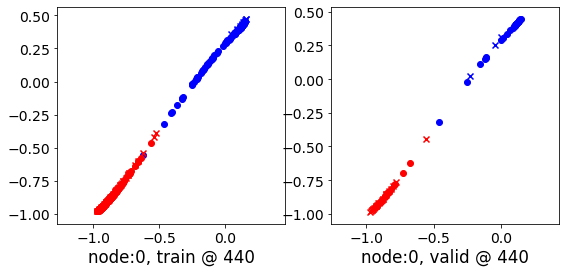

440 	 1 	 0.01220150 	 -0.10552897 	 0.20157887 	 0.09497951 	 0.89225632 	 0.89365566


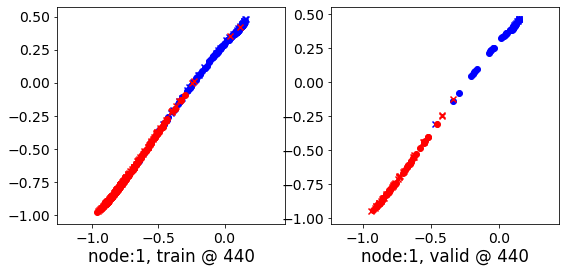

440 	 2 	 0.14780545 	 0.06334046 	 0.36966142 	 0.30712488 	 0.92586011 	 0.93693161


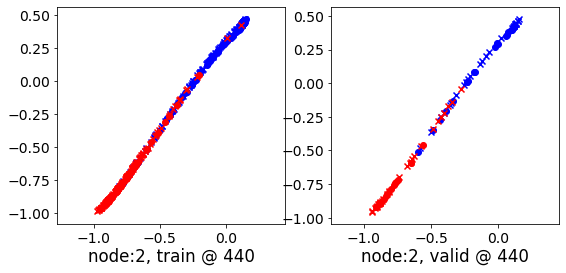

440 	 3 	 0.17624977 	 0.08490151 	 0.41518560 	 0.35058677 	 0.93431121 	 0.95883244


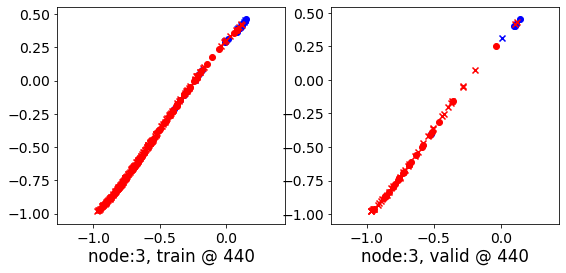

440 	 4 	 0.40870500 	 0.44803137 	 0.55521238 	 0.58562529 	 0.85210997 	 0.83074111


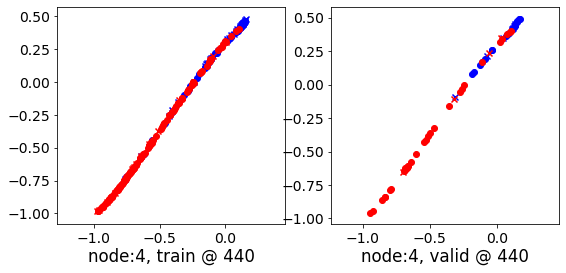

440 	 5 	 0.46295202 	 0.50200069 	 0.71211791 	 0.77399576 	 0.94325387 	 0.96514225


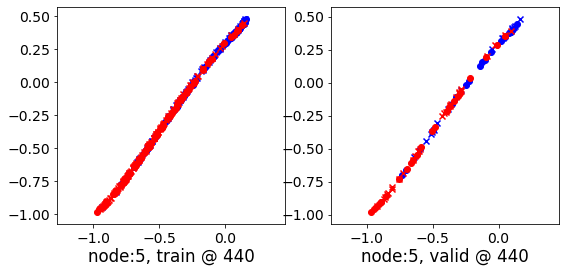

440 	 6 	 0.47274041 	 0.39642555 	 0.72045928 	 0.66291827 	 0.94114637 	 0.95963991


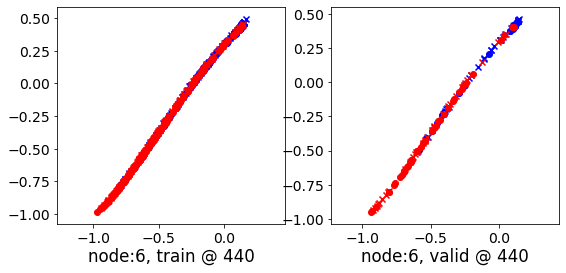

440 	 7 	 0.60099572 	 0.51621217 	 0.78077734 	 0.78870779 	 0.87445623 	 0.96564281


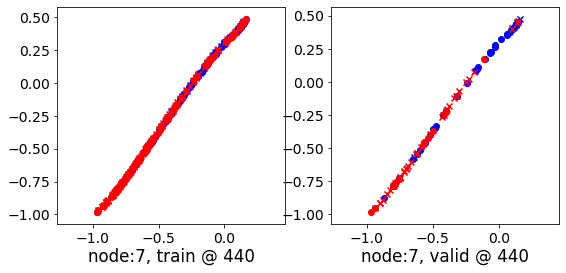

440 	 8 	 0.56087011 	 0.47049862 	 0.77612090 	 0.73506856 	 0.92183441 	 0.95771712


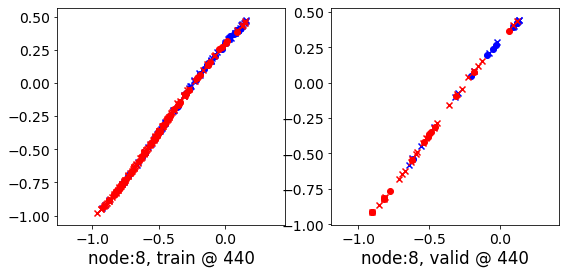

440 	 9 	 0.62521398 	 0.74280328 	 0.75742155 	 0.94332010 	 0.83098656 	 0.89366400


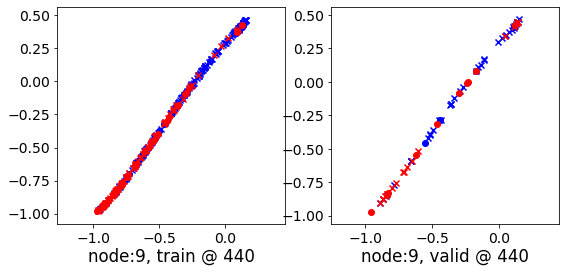

Aggregating on epoch: 442...
Aggregating on epoch: 444...
Aggregating on epoch: 446...
Aggregating on epoch: 448...
Aggregating on epoch: 450...
Aggregating on epoch: 452...
Aggregating on epoch: 454...
Aggregating on epoch: 456...
Aggregating on epoch: 458...
Aggregating on epoch: 460...
460 	 0 	 -0.06242350 	 -0.06838196 	 0.03170365 	 0.02239258 	 0.78910983 	 0.78392172


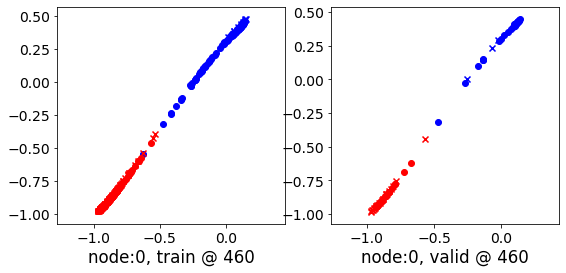

460 	 1 	 0.00926112 	 -0.10774148 	 0.19923106 	 0.09243172 	 0.89137769 	 0.89332038


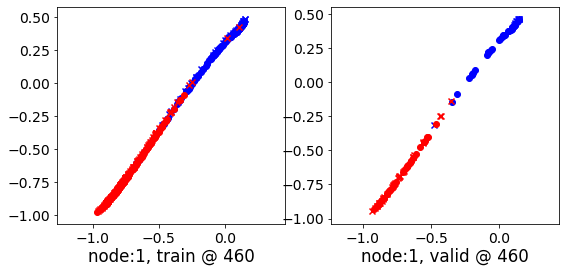

460 	 2 	 0.14601359 	 0.06275332 	 0.36864921 	 0.30558789 	 0.92506754 	 0.93598175


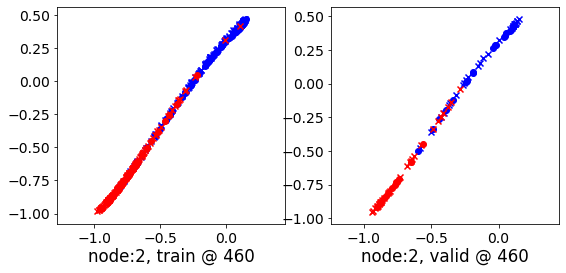

460 	 3 	 0.17420247 	 0.08126998 	 0.41195512 	 0.34763271 	 0.93307108 	 0.95950991


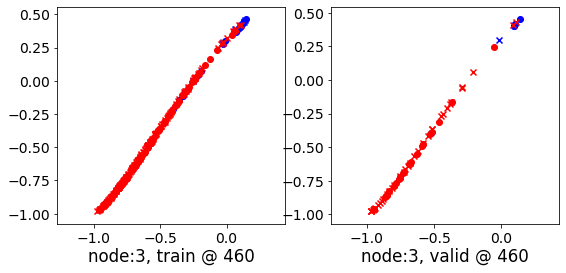

460 	 4 	 0.40458834 	 0.44878727 	 0.55233461 	 0.58713847 	 0.85250574 	 0.83149838


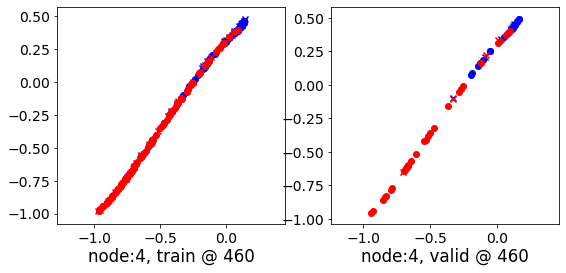

460 	 5 	 0.46215743 	 0.49877256 	 0.71138483 	 0.77120799 	 0.94287843 	 0.96558261


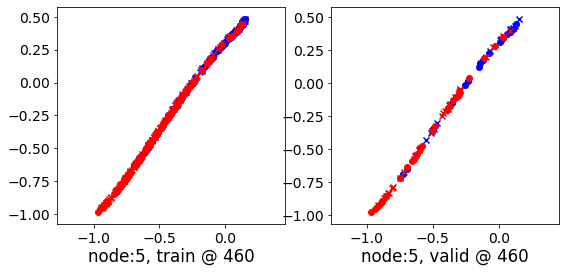

460 	 6 	 0.47205168 	 0.39203739 	 0.71928322 	 0.66071117 	 0.94070309 	 0.96182096


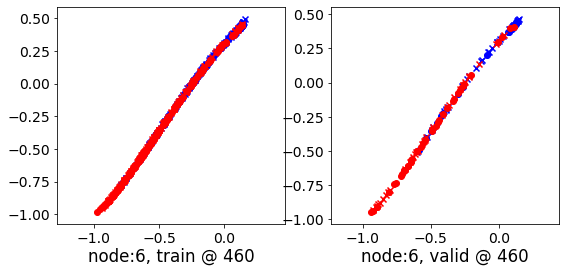

460 	 7 	 0.60053825 	 0.51491845 	 0.77870834 	 0.78877145 	 0.87322932 	 0.96700019


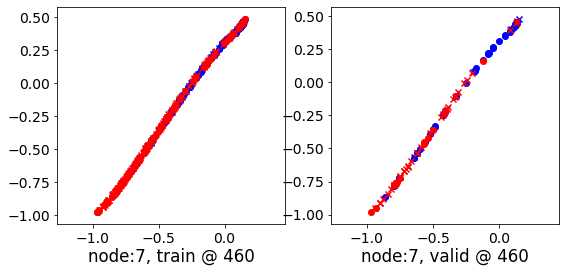

460 	 8 	 0.55891407 	 0.47263831 	 0.77548105 	 0.73387480 	 0.91948807 	 0.95438367


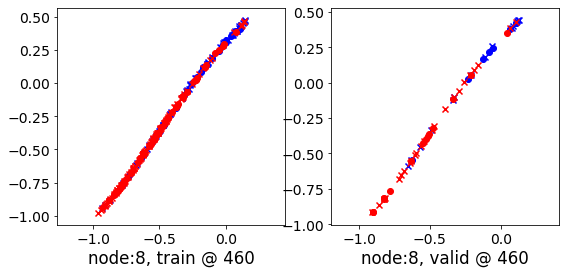

460 	 9 	 0.62311476 	 0.73710179 	 0.75680679 	 0.93828321 	 0.83069038 	 0.89432859


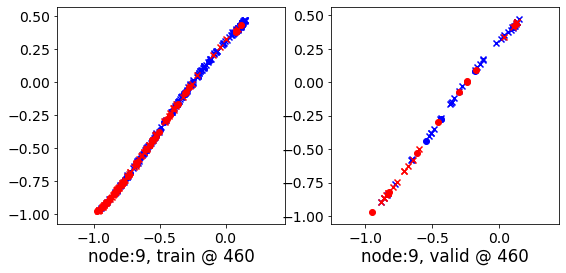

Aggregating on epoch: 462...
Aggregating on epoch: 464...
Aggregating on epoch: 466...
Aggregating on epoch: 468...
Aggregating on epoch: 470...
Aggregating on epoch: 472...
Aggregating on epoch: 474...
Aggregating on epoch: 476...
Aggregating on epoch: 478...
Aggregating on epoch: 480...
480 	 0 	 -0.06239303 	 -0.07228984 	 0.02988982 	 0.02085637 	 0.78702700 	 0.78629339


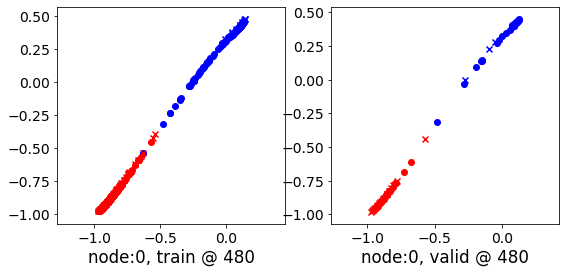

480 	 1 	 0.00673214 	 -0.10912827 	 0.19752088 	 0.09079954 	 0.89076424 	 0.89307499


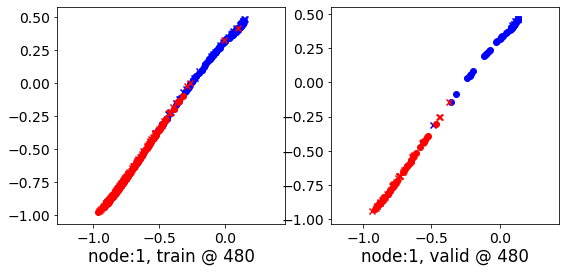

480 	 2 	 0.14472488 	 0.06304353 	 0.36791378 	 0.30509472 	 0.92442125 	 0.93519837


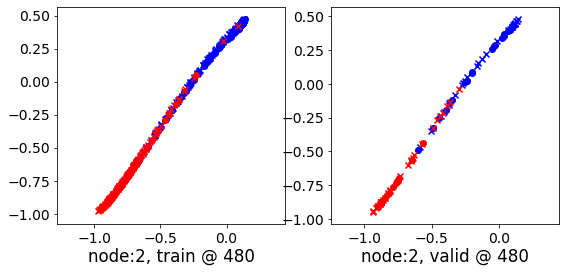

480 	 3 	 0.17265651 	 0.07829922 	 0.40935794 	 0.34501022 	 0.93190253 	 0.95985818


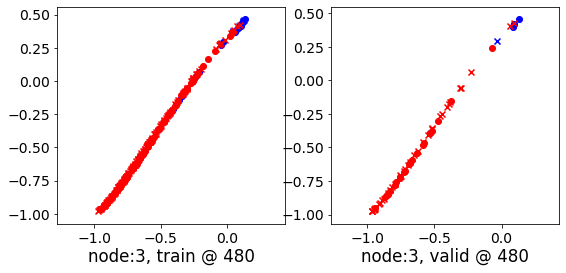

480 	 4 	 0.40095210 	 0.44752085 	 0.54988897 	 0.58655685 	 0.85265839 	 0.83218318


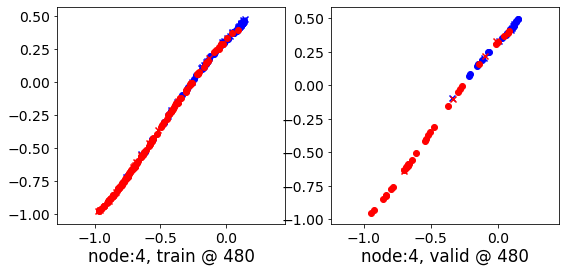

480 	 5 	 0.46159106 	 0.49635774 	 0.71089661 	 0.76927888 	 0.94270939 	 0.96606833


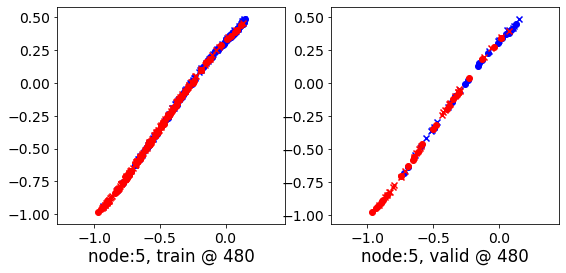

480 	 6 	 0.47140211 	 0.38677335 	 0.71808451 	 0.65776312 	 0.94016635 	 0.96413696


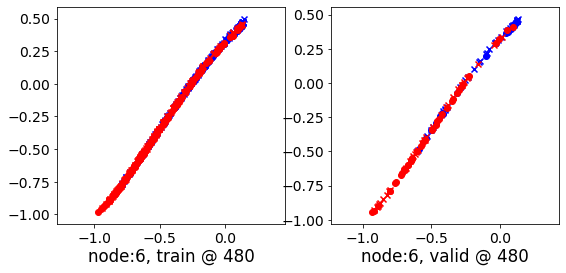

480 	 7 	 0.59996986 	 0.51416641 	 0.77721673 	 0.78924900 	 0.87242520 	 0.96822977


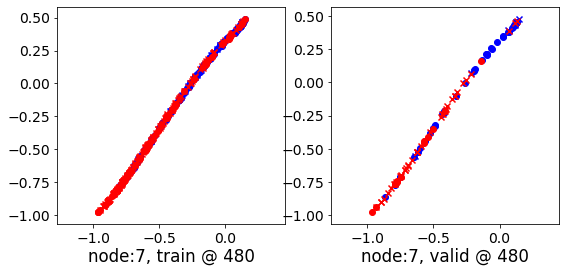

480 	 8 	 0.55716509 	 0.47312045 	 0.77475142 	 0.73332220 	 0.91716731 	 0.95334893


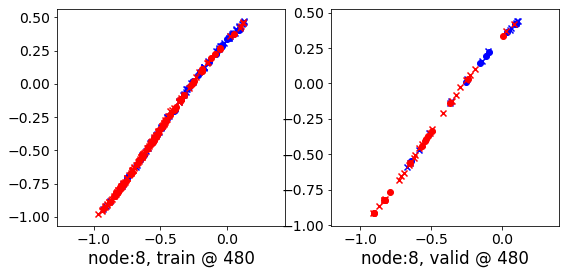

480 	 9 	 0.62212151 	 0.73331386 	 0.75640428 	 0.93720686 	 0.83069527 	 0.89704019


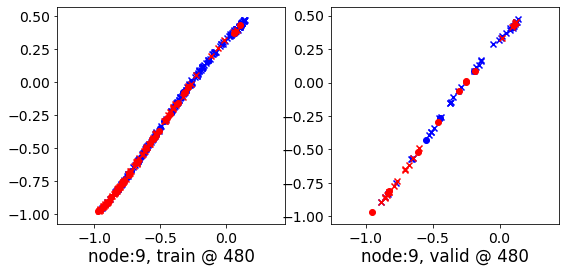

Aggregating on epoch: 482...
Aggregating on epoch: 484...
Aggregating on epoch: 486...
Aggregating on epoch: 488...
Aggregating on epoch: 490...
Aggregating on epoch: 492...
Aggregating on epoch: 494...
Aggregating on epoch: 496...
Aggregating on epoch: 498...
Aggregating on epoch: 500...
500 	 0 	 -0.06207987 	 -0.07676395 	 0.02847176 	 0.01955382 	 0.78494149 	 0.78946495


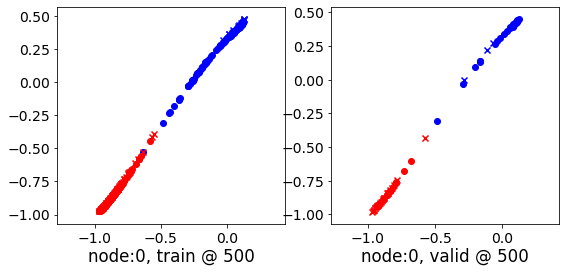

500 	 1 	 0.00452898 	 -0.11023510 	 0.19623666 	 0.08943248 	 0.89041513 	 0.89281476


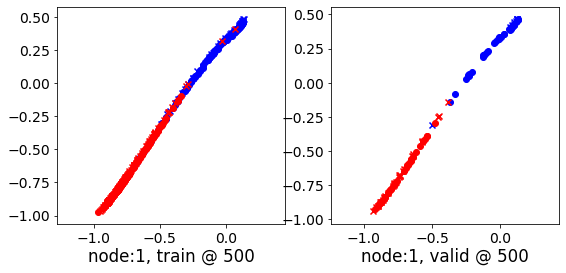

500 	 2 	 0.14310101 	 0.06236753 	 0.36692095 	 0.30350474 	 0.92389613 	 0.93428439


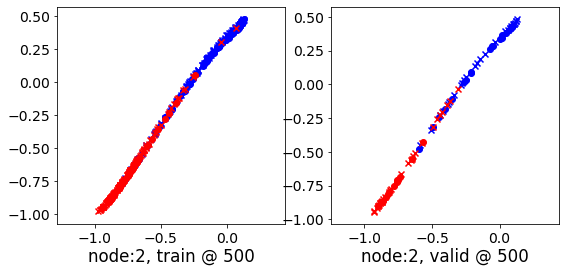

500 	 3 	 0.17142507 	 0.07557803 	 0.40698603 	 0.34245247 	 0.93068409 	 0.96002162


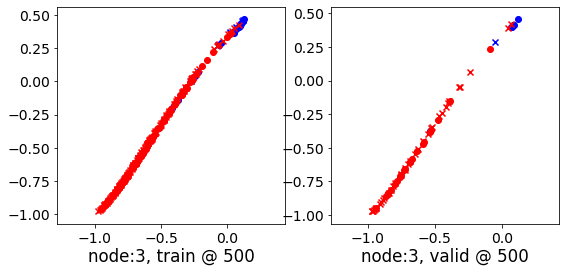

500 	 4 	 0.39767587 	 0.44618303 	 0.54745430 	 0.58546811 	 0.85263884 	 0.83243227


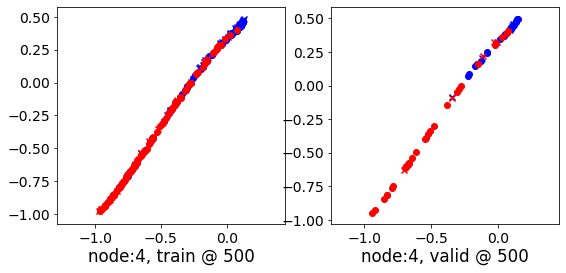

500 	 5 	 0.46116966 	 0.49390304 	 0.71038455 	 0.76700920 	 0.94259220 	 0.96625334


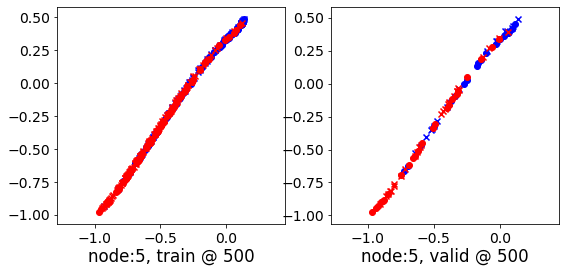

500 	 6 	 0.47082686 	 0.38227826 	 0.71691304 	 0.65591627 	 0.93962795 	 0.96678519


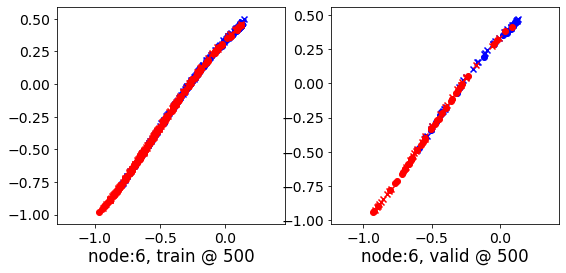

500 	 7 	 0.59934127 	 0.51386052 	 0.77612400 	 0.79006207 	 0.87190896 	 0.96934873


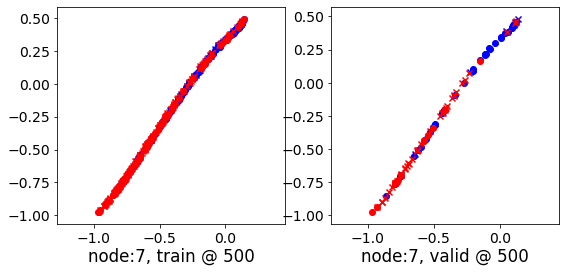

500 	 8 	 0.55733752 	 0.47041017 	 0.77424932 	 0.73290288 	 0.91508919 	 0.95563990


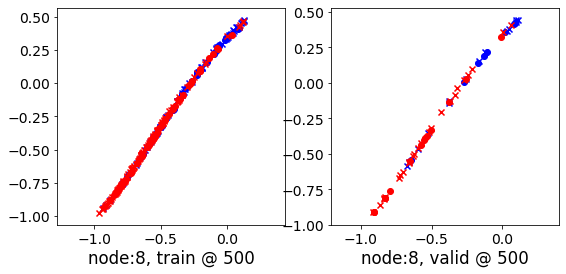

500 	 9 	 0.62147439 	 0.73115414 	 0.75571591 	 0.93668002 	 0.83040994 	 0.89867306


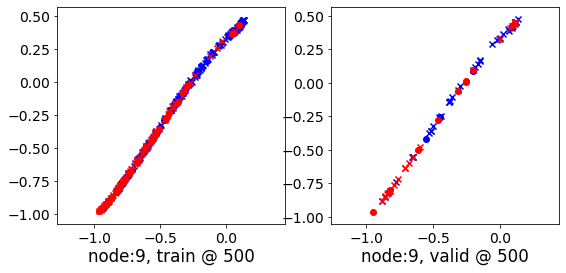

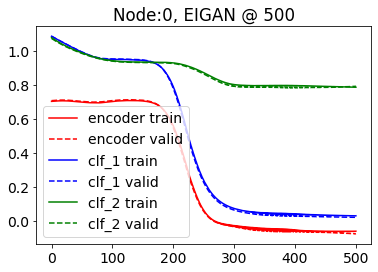

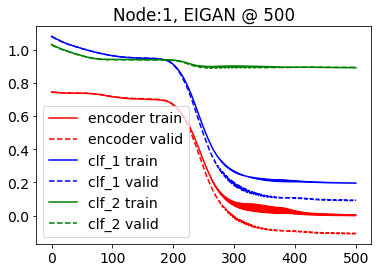

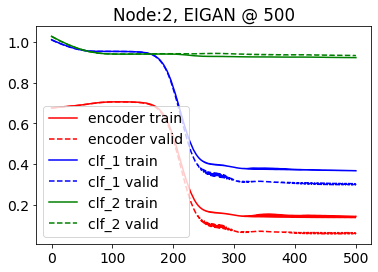

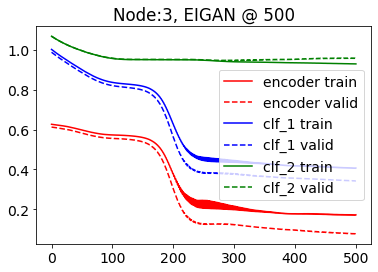

...

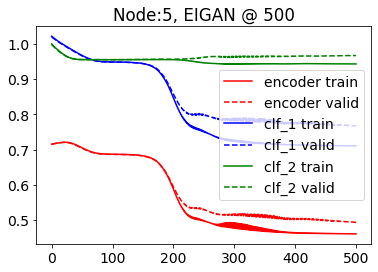

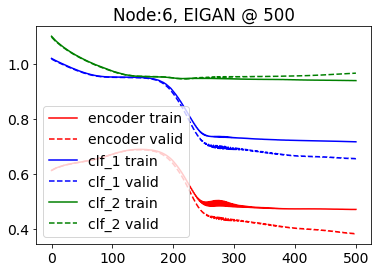

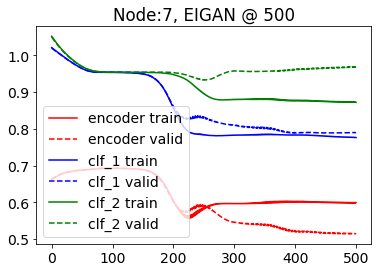

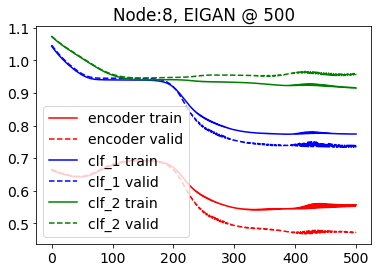

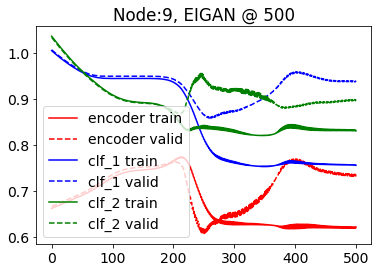

  0%|          | 1/501 [00:00<01:14,  6.69it/s]

epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.60548460 	 0.61023009 	 1.06328034 	 1.05531704 	 1.15116835 	 1.13823414


100%|██████████| 501/501 [01:13<00:00,  6.78it/s]


500 	 0.27537990 	 0.28897655 	 0.56232715 	 0.58403641 	 0.98176432 	 0.98820704


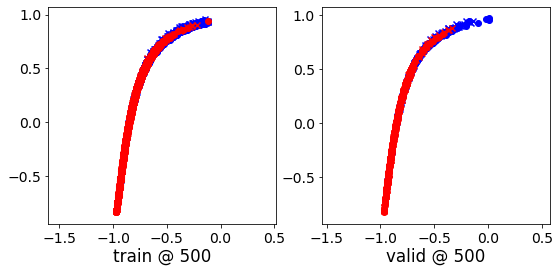

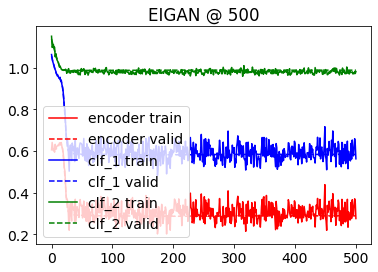

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.028456 	 1.028509 	 0.3724
200 	 0.672944 	 0.665094 	 0.7966
400 	 0.589989 	 0.577798 	 0.8138
600 	 0.589443 	 0.577510 	 0.8138
800 	 0.589026 	 0.577229 	 0.8126
1000 	 0.588747 	 0.577332 	 0.8126
Accuracy: 0.8126436781609195
Error Rate: 0.18735632183908046
F1 Score: 0.8338430173292559
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7977011494252874
Error Rate: 0.20229885057471264
F1 Score: 0.813953488372093
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8091954022988506
Error Rate: 0.19

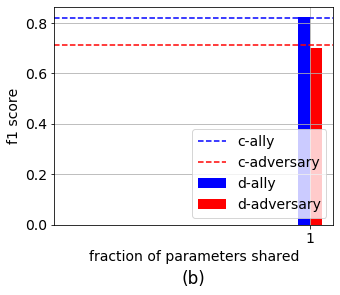

In [8]:
for NUM_NODES in range(2, 11):
    VAR_ADD = 1
    X, y_1, y_2 = [], [], []
    for _ in range(NUM_NODES):
        data = generate_gaussian((VAR1+VAR_ADD)/10, (VAR2+VAR_ADD)/10, MAX//NUM_NODES, 1)
        X.append(data[0])
        y_1.append(data[1])
        y_2.append(data[2])
        VAR_ADD += 1

    print('='*80)
    print('{} NODE DATA'.format(NUM_NODES))
    print('='*80)
    for _ in range(NUM_NODES):
        print('@node {}, X: {}, y_1: {}, y2: {}'.format(_, X[_].shape, y_1[_].shape, y_2[_].shape))
    
    w_1 = []
    w_2 = []
    train_loaders = []
    X_valids = []
    X_trains = []
    y_1_valids = []
    y_1_trains = []
    y_2_valids = []
    y_2_trains = []
    for node_idx in range(NUM_NODES):
        X_local = X[node_idx]
        y_1_local = y_1[node_idx]
        y_2_local = y_2[node_idx]

        X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid = train_test_split(
            X_local, y_1_local, y_2_local, test_size=0.2, stratify=pd.DataFrame(
                np.concatenate((y_1_local, y_2_local), axis=1)
            ))
        print('@node {}: X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid'.format(node_idx))
        print(X_train.shape, X_valid.shape, y_1_train.shape, y_1_valid.shape, y_2_train.shape, y_2_valid.shape)

        w = np.bincount(y_1_train.flatten())
        w_1.append(sum(w)/w)
        w = np.bincount(y_2_train.flatten())
        w_2.append(sum(w)/w)
        print('@node {}: class weights => w1, w2'.format(node_idx), w_1, w_2)

        scaler = MinMaxScaler()
        X_train = scaler.fit_transform(X_train)
        X_valid = scaler.transform(X_valid)

        width = 0.35
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(13, 4))
        ax1.bar(np.unique(y_1_train.flatten()), np.bincount(y_1_train.flatten()), width, color='b')
        ax1.bar(np.unique(y_2_train.flatten())+width, np.bincount(y_2_train.flatten()), width, color='r')
        ax1.legend(['ally', 'adversary'])

        y_1_train = to_categorical(y_1_train)
        y_2_train = to_categorical(y_2_train)
        y_1_valid = to_categorical(y_1_valid)
        y_2_valid = to_categorical(y_2_valid)

        X_train = torch.Tensor(X_train)
        y_1_train = torch.Tensor(y_1_train)
        y_2_train = torch.Tensor(y_2_train)

        X_valids.append(torch.Tensor(X_valid))
        y_1_valids.append(torch.Tensor(y_1_valid))
        y_2_valids.append(torch.Tensor(y_2_valid))

        X_trains.append(X_train)
        y_1_trains.append(y_1_train)
        y_2_trains.append(y_2_train)

        class_plot(X_train, np.argmax(y_1_train, axis=1), np.argmax(y_2_train, axis=1), 
                   'normalized train set @ node {}'.format(node_idx), ax2)
        class_plot(X_valid, np.argmax(y_1_valid, axis=1), np.argmax(y_2_valid, axis=1), 
                   'normalized valid set @ node {}'.format(node_idx), ax3)

        print('@node {}: tensor sizes =>'.format(node_idx), X_train.shape, X_valid.shape, y_1_train.shape, y_1_valid.shape, y_2_train.shape, y_2_valid.shape)

        train_loaders.append(DataLoader(TensorDataset(X_train, y_1_train, y_2_train), batch_size=BATCHSIZE, shuffle=True))
        
    alpha = 1
    lr_encd = 0.001
    lr_1 = 0.001
    lr_2 = 0.001
    n_iter_gan = 501

    input_size = X_train.shape[1]
    hidden_size = input_size*8
    output_size = 2

    global_params = {}
    encoders = {}

    print("-"*80)
    print('EIGAN Training w/ phi={} and delta={}'.format(phi, delta))
    print("-"*80)
    encoders['{}_{}'.format(phi, delta)] = distributed(NUM_NODES, phi, delta, 
                           X_trains, X_valids, 
                           y_1_trains, y_1_valids,
                           y_2_trains, y_2_valids,
                           input_size, hidden_size, output_size, 
                           alpha, lr_encd, lr_1, lr_2, w_1, w_2,
                           train_loaders, n_iter_gan, device, global_params)

    pkl.dump(encoders, open(
        'encoders_num_nodes{}_phi{}_delta{}.pkl'.format(NUM_NODES, phi, delta), 'wb'))

    X_train = torch.cat(X_trains, dim=0).to(device)
    X_valid = torch.cat(X_valids, dim=0).to(device)
    y_1_train = torch.cat(y_1_trains, dim=0).to(device)
    y_1_valid = torch.cat(y_1_valids, dim=0).to(device)
    y_2_train = torch.cat(y_2_trains, dim=0).to(device)
    y_2_valid = torch.cat(y_2_valids, dim=0).to(device)

    X_trains = [_.to(device) for _ in X_trains]
    X_valids = [_.to(device) for _ in X_valids]
    y_1_trains = [_.to(device) for _ in y_1_trains]
    y_1_valids = [_.to(device) for _ in y_1_valids]
    y_2_trains = [_.to(device) for _ in y_2_trains]
    y_2_valids = [_.to(device) for _ in y_2_valids]

    train_loader = DataLoader(TensorDataset(X_train, y_1_train, y_2_train), batch_size=BATCHSIZE, shuffle=True)

    encoder = centralized(X_train, X_valid,
                          y_1_train, y_1_valid,
                          y_2_train, y_2_valid,
                          input_size, hidden_size, output_size,
                          alpha, lr_encd, lr_1, lr_2, w_1[0], w_2[0],
                          train_loader, n_iter_gan, device)

    pkl.dump(encoder, open('encoder_num_nodes{}_central_compare.pkl'.format(NUM_NODES), 'wb'))

    print("-"*80)
    print('ALLY: BASELINE')
    print("-"*80)
    history['baseline_ally_{}'.format(NUM_NODES)] = metrics.centralized(None, 
                                                 input_size, hidden_size, output_size, 
                                                 X_train, X_valid, y_1_train, y_1_valid, 
                                                 w_1[0], device)

    print("-"*80)
    print('ADVERSARY: BASELINE')
    print("-"*80)
    history['baseline_advr_{}'.format(NUM_NODES)] = metrics.centralized(None, 
                                                 input_size, hidden_size, output_size, 
                                                 X_train, X_valid, y_2_train, y_2_valid, 
                                                 w_2[0], device)

    print("-"*80)
    print('ALLY: CENTRALIZED')
    print("-"*80)
    history['centralized_ally_{}'.format(NUM_NODES)] = metrics.centralized(encoder, 
                                                 input_size, hidden_size, output_size, 
                                                 X_train, X_valid, y_1_train, y_1_valid, 
                                                 w_1[0], device)

    print("-"*80)
    print('ADVERSARY: CENTRALIZED')
    print("-"*80)
    history['centralized_advr_{}'.format(NUM_NODES)] = metrics.centralized(encoder, 
                                                 input_size, hidden_size, output_size, 
                                                 X_train, X_valid, y_2_train, y_2_valid, 
                                                 w_2[0], device)

    for key, encd in encoders.items():
        print("-"*80)
        print('ALLY: {}'.format(key))
        print("-"*80)
        history['decentralize_ally_{}'.format(NUM_NODES)] = metrics.distributed(encd, NUM_NODES,
                                                             input_size, hidden_size, output_size, 
                                                             X_trains, X_valids, y_1_trains, y_1_valids, 
                                                             w_1[0], device)
        print("-"*80)
        print('ADVERSARY: {}'.format(key))
        print("-"*80)
        history['decentralized_advr_{}'.format(NUM_NODES)] = metrics.distributed(encd, NUM_NODES,
                                                                     input_size, hidden_size, output_size, 
                                                                     X_trains, X_valids, y_2_trains, y_2_valids, 
                                                                     w_2[0], device)
        
    baseline_ally = []
    baseline_advr = []
    eigan_ally = []
    eigan_advr = []
    dist_x = []
    dist_ally = []
    dist_advr = []

    tmp = history['baseline_ally_{}'.format(NUM_NODES)][3]
    baseline_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
    tmp = history['baseline_advr_{}'.format(NUM_NODES)][3]
    baseline_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
    tmp = history['centralized_ally_{}'.format(NUM_NODES)][3]
    eigan_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
    tmp = history['centralized_advr_{}'.format(NUM_NODES)][3]
    eigan_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

    fig, (ax1) = plt.subplots(1, 1, figsize=(5, 4))

    dist_x.append(phi)
    tmp = history['decentralize_ally_{}'.format(NUM_NODES)][3]
    dist_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
    tmp = history['decentralized_advr_{}'.format(NUM_NODES)][3]
    dist_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

    ax1.hlines(y=eigan_ally[0], xmin=-0.1, xmax=1.1, color='b', linestyle='dashed')
    ax1.hlines(y=eigan_advr[0], xmin=-0.1, xmax=1.1, color='r', linestyle='dashed')
    ax1.bar(np.array(dist_x)-0.025, dist_ally, width=0.05, color='b')
    ax1.bar(np.array(dist_x)+0.025, dist_advr, width=0.05, color='r')
    ax1.set_xticks(dist_x)
    ax1.set_xlim(left=-0.1, right=1.1)
    ax1.legend(['c-ally', 'c-adversary', 'd-ally', 'd-adversary'], loc='lower right')
    ax1.set_xlabel('fraction of parameters shared')
    ax1.set_ylabel('f1 score')
    ax1.set_title('(b)', y=-0.3)
    ax1.grid()

    plt.rcParams.update({'font.size': 14})
    fig.subplots_adjust(wspace=0.3)
    plt.savefig('distributed_eigan_comparison.png', bbox_inches='tight', dpi=300)

In [9]:
import pickle as pkl
pkl.dump(encoder, open('history_gaussian_num_nodes_expt.pkl', 'wb'))

In [14]:
num_nodes = []
baseline_ally = []
baseline_advr = []
eigan_ally = []
eigan_advr = []
dist_ally = []
dist_advr = []

for _ in range(2, 11):
    num_nodes.append(_)
    tmp = history['baseline_ally_{}'.format(_)][3]
    baseline_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
    tmp = history['baseline_advr_{}'.format(_)][3]
    baseline_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
    tmp = history['centralized_ally_{}'.format(_)][3]
    eigan_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
    tmp = history['centralized_advr_{}'.format(_)][3]
    eigan_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
    tmp = history['decentralize_ally_{}'.format(_)][3]
    dist_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
    tmp = history['decentralized_advr_{}'.format(_)][3]
    dist_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

In [19]:
eigan_advr

[0.5717415115005475,
 0.5339105339105339,
 0.5818610129564192,
 0.7387068201948627,
 0.7735263702171666,
 0.742216687422167,
 0.6460377358490565,
 0.6711409395973155,
 0.7141268075639601]

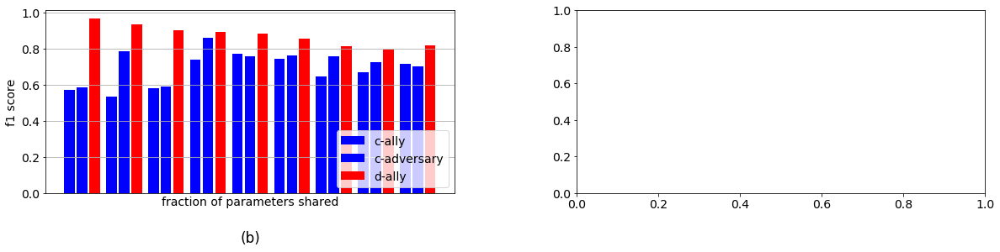

In [27]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 4))

ax1.bar(np.array(num_nodes)-0.3, eigan_advr, width=0.25, color='b', hatch='x')
ax1.bar(np.array(num_nodes), dist_advr, width=0.25, color='b')
ax1.bar(np.array(num_nodes)+0.3, baseline_advr, width=0.25, color='b', hatch='-')
ax1.set_xticks(dist_x)
# ax1.set_xlim(left=-0.1, right=1.1)
ax1.legend(['c-ally', 'c-adversary', 'd-ally', 'd-adversary'], loc='lower right')
ax1.set_xlabel('fraction of parameters shared')
ax1.set_ylabel('f1 score')
ax1.set_title('(b)', y=-0.3)
ax1.grid()

plt.rcParams.update({'font.size': 14})
fig.subplots_adjust(wspace=0.3)
plt.savefig('num_nodes_comparison.png', bbox_inches='tight', dpi=300)